# Final Project Submission

Please fill out:
* Student name: Marco Giuseppe Nasuto
* Student pace: self paced 
* Scheduled project review date/time: 
* Instructor name: Jeff Herman
* Blog post URL: https://readymag.com/kosmonauts/realestimate/


You'll clean, explore, and model this dataset with a multivariate linear regression to predict the sale price of houses as accurately as possible.

# Import libraries and load data

In [4]:
import os
import pandas as pd
import pickle
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import statsmodels.api as sm
from statsmodels.formula.api import ols
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from statsmodels.sandbox.regression.predstd import wls_prediction_std
from statsmodels.stats.outliers_influence import summary_table
from statsmodels.regression.linear_model import OLSResults
from scipy import stats
from statsmodels.graphics.regressionplots import abline_plot
from sklearn.preprocessing import PolynomialFeatures
from pygam import LinearGAM, s, f
from collections import Counter
from sklearn.metrics import median_absolute_error
%matplotlib inline

In [2]:
def logtransform(df):
    '''The function returns a log-transformation of float columns without NaN values
\nParameters
----------
\nx : numerical value'''
    for col in df.select_dtypes('float').columns:
        if (df[col].isna().any() | (df[col] < 0).any()) :
            continue
        elif df[col].isin([0]).any(): #case there are 0 in the column, add constant (1)
            df[col].replace(0,1, inplace=True)
            df['log-{}'.format(col)] = np.log(df[col])
        else:
            df['log-{}'.format(col)] = np.log(df[col])
    return df

In [3]:
def pickle_regression_results(description, results, dfs_coeffs, summaries, models, X_train_models, X_test_models, y_train_models, y_test_models, columns_models):
    '''This function exports results from regression using pickle.'''
    #results
    save_pickle(results, '{}'.format(description))
    #coeffs
    save_pickle(dfs_coeffs, '{}-coeff'.format(description))
    #summaries
    save_pickle(summaries, '{}-summaries'.format(description))
    #models
    save_pickle(models, '{}-models'.format(description))
    #X train models
    save_pickle(X_train_models,'{}-xtrains'.format(description))
    #X test models
    save_pickle(X_test_models, '{}-xtests'.format(description))
    #y train
    save_pickle(y_train_models, '{}-ytrains'.format(description))
    #y test
    save_pickle(y_test_models, '{}-ytests'.format(description))

In [4]:
def save_pickle(obj, namefile):
    '''This function saves an object using pickle. 
    \nParameters
    \n--------------
    \nobj: obj
    \nnamefile: str'''
    with open(namefile, 'wb') as f:
        pickle.dump(obj, f)

In [5]:
def open_pickle(namefile):
    '''This function opens a pickle object. 
\nParameters
\n--------------
\nobj: obj
\nnamefile: str'''
    with open(namefile, 'rb') as f:
        return pickle.load(f)

In [6]:
def regression(df, target, sklearn=True, sm_model=True, select_features=False):
    # run stepwise_selection to determine relevant features
    # is set to True
    relevant_columns = []
    if select_features:
        relevant_columns = stepwise_selection(df,target)
    # split data into X and y
        df = df[relevant_columns]
        X_train, X_test, y_train, y_test = train_test_split(df, target, shuffle=True,test_size=0.2, random_state=42)
        if sklearn:
            model_sklearn = LinearRegression()
            model_sklearn.fit(X_train, y_train)
        if sm_model:
            model_ols = sm.OLS(y_train, sm.add_constant(X_train))
            sm_model = model_ols.fit()
        model = [model_sklearn, sm_model]
    else:
        # split data into X and y
        X_train, X_test, y_train, y_test = train_test_split(df, target, shuffle=True,test_size=0.2, random_state=42)
        if sklearn:
            model_sklearn = LinearRegression()
            model_sklearn.fit(X_train, y_train)
        if sm_model:
            model_ols = sm.OLS(y_train, sm.add_constant(X_train))
            sm_model = model_ols.fit()
        model = [model_sklearn, sm_model]
    return X_train, X_test, y_train, y_test, model, relevant_columns

In [7]:
def stepwise_selection(X, y, 
                       initial_list=[], 
                       threshold_in=0.01, 
                       threshold_out = 0.05, 
                       verbose=False):
    """ Perform a forward-backward feature selection 
    based on p-value from statsmodels.api.OLS
    Arguments:
        X - pandas.DataFrame with candidate features
        y - list-like with the target
        initial_list - list of features to start with (column names of X)
        threshold_in - include a feature if its p-value < threshold_in
        threshold_out - exclude a feature if its p-value > threshold_out
        verbose - whether to print the sequence of inclusions and exclusions
    Returns: list of selected features 
    Always set threshold_in < threshold_out to avoid infinite looping.
    See https://en.wikipedia.org/wiki/Stepwise_regression for the details
    """
    included = list(initial_list)
    while True:
        changed=False
        # forward step
        excluded = list(set(X.columns)-set(included))
        new_pval = pd.Series(index=excluded)
        for new_column in excluded:
            model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included+[new_column]]))).fit()
            new_pval[new_column] = model.pvalues[new_column]
        best_pval = new_pval.min()
        if best_pval < threshold_in:
            best_feature = new_pval.idxmin()
            included.append(best_feature)
            changed=True
            if verbose:
                print('Add  {:30} with p-value {:.6}'.format(best_feature, best_pval))

        # backward step
        model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included]))).fit()
        # use all coefs except intercept
        pvalues = model.pvalues.iloc[1:]
        worst_pval = pvalues.max() # null if pvalues is empty
        if worst_pval > threshold_out:
            changed=True
            worst_feature = pvalues.argmax()
            included.remove(worst_feature)
            if verbose:
                print('Drop {:30} with p-value {:.6}'.format(worst_feature, worst_pval))
        if not changed:
            break
    return included

In [8]:
def assess_model(model, X_train, X_test, y_train, y_test):
    '''This function returns the model assessment:
    
    #from .summary()
        -Train R-squared
        -t-statistic
        -P-values
    #Extra scores:
    \n       -y_train_hat
    \n       -y_test_hat
    \n       -train R-squared
    \n       -test R-squared
    \n       -train R-squared-adjusted
    \n       -test R-squared-adjusted'''
    if len(model) > 1:
        model_sklearn = model[0]
        sm_model = model[1]
    
    summary = sm_model.summary()
    coeff = model_sklearn.coef_

    #Root mean squared error
    y_train_hat = model_sklearn.predict(X_train)
    y_test_hat = model_sklearn.predict(X_test)
    train_rmse = np.sqrt(mean_squared_error(y_train, y_train_hat))
    test_rmse = np.sqrt(mean_squared_error(y_test, y_test_hat)) 
    
    #Train R-squared
    train_r_squared = r2_score(y_train, y_train_hat)
    #Test R-squared
    test_r_squared = r2_score(y_test, y_test_hat)
    #Train R-squared-adjusted
    train_r_squared_adj = adj_r2(train_r_squared, y_train, coeff)
    #Test R-squared-adjusted
    test_r_squared_adj = adj_r2(test_r_squared, y_test, coeff)
    
    
    return y_train_hat, y_test_hat, train_rmse, test_rmse, train_r_squared, test_r_squared, train_r_squared_adj, test_r_squared_adj, summary, coeff

In [9]:
def cross_val(model, X_train, y_train, cv=10):
    '''This function does cross validation on given model and returns mean R-squared score and standard deviation of the R-squared'''
    scores = cross_val_score(model, X_train, y_train, cv=cv)
    cross_val_r_squared = scores.mean()
    std_dev_cross_val = np.std(scores)
    return cross_val_r_squared, std_dev_cross_val

In [10]:
def adj_r2(r_squared, y, coeff):
    """This function calculates the Adjusted R-Squared value.
    \nParameters:
    \n------------
    """
    num_observations = len(y)
    num_parameters = len(coeff)

    adj_r_squared = r_squared - (num_parameters - 1) / (num_observations-num_parameters) * (1 - r_squared)
    return adj_r_squared

In [11]:
def get_model_results(description, models, train_rmse, test_rmse, train_r_squared, test_r_squared, train_r_squared_adj, test_r_squared_adj, cv, cross_val_r_squared, std_dev_cross_val, dfcoeff, columns):
    '''This function returns a dictionary of results per model:
        \n-RMSE: Root-mean-squared-error, it measures the standard deviation of the prediction errors (residuals)
        \n-R-squared:  how much of the observed data is explained by the model.
        \n-Adjusted R-squared: a variation of R-squared adjusted to the number of variables in the model
        '''  # create a result with all the information
    result = {'Description': description,
              'RMSE training': format(train_rmse, '.3f'),
              'RMSE test': format(test_rmse, '.3f'),
              'R-squared training': format(train_r_squared, '.3f'),
              'R-squared test': format(test_r_squared, '.3f'),
              'Adjusted R-squared training': format(train_r_squared_adj, '.3f'),
              'Adjusted R-squared test': format(test_r_squared_adj, '.3f'),
              'Average R-squared {}-Fold Cross Validation'.format(cv): format(cross_val_r_squared, '.3f'),
              'Standard deviation of average R-squared Cross Validation': format(std_dev_cross_val, '.3f')}
    
    dfcoeff = pd.DataFrame.from_dict(models[1].params)
    dfcoeff.columns = [description]

    # turn result into a DataFrame
    return result, dfcoeff

In [12]:
def run_model(df, target, description, cv, plots=False, feature_selection=False):
    '''This function runs a linear/multilinear model, given a dataframe of variables, a target variable, a description and number of K-folds for cross validation.
    Returns: result, df_coeff, summary, models.
    \n- Train-test split initial features dataframe
    \n- Runs linear/multilinear regression: - y_train_hat: 
    \n                                      - y_test_hat
    \n                                      - Train RMSE:
    \n                                      - Test RMSE:
    \n                                      - Train R-squared:
    \n                                      - Test R-squared:
    \n                                      - Summary: - Coefficients per feature
    \n                                                 - T-static per feature
    \n                                                 - P-values per feature
    \n- Cross validation: - Mean R-squared 
    \n                    - Variance of the R-squared
    \n- Plots confidence and prediction intervals
    \n- Regression diagnostics:
    \n                         - Influence plot
    \n                         - Normality residuals
    \n                         - Heteroskedacity
    \n                         - Partial residuals plots
    \nParameters:
    \n------------
    \ndf : pandas.dataframe obj, dataframe with variables/features (X)
    \target: pandas.series obj, series with target variable (y)
    \description: str, a description for the model to be stored in the final result (dictionary)
    \cv: int, number of K-folds to use for cross validation
    \nReturns:
    \nresults: dictionary obj, {'Description':,
    \n                          'RMSE training':,
    \n                          'RMSE test':,
    \n                          'R-squared training':,
    \n                          'R-squared test':,
    \n                          'R-squared-Adjusted training':,
    \n                          'R-squared-Adjusted test':',
    \n                          'Average R-squared {cv}-Fold Cross Validation':,
    \n                          'Standard deviation of average R-squared Cross Validation':}
    \n\ndf_coeff: pandas.dataframe obj, dataframe with coefficients from regression'''
    
    # regression
    X_train, X_test, y_train, y_test, model, features = regression(df, target, select_features=feature_selection)
    
    if feature_selection:
        columns = features
    else:
        columns = df.columns
    model_sklearn = model[0]
    sm_model = model[1]
    predictions = model_sklearn.predict(X_test)
    
    # assess model
    y_train_hat, y_test_hat, train_rmse, test_rmse, train_r_squared, test_r_squared, train_r_squared_adj, test_r_squared_adj, summary, coeff = assess_model(
        model, X_train, X_test, y_train, y_test)

    # cross validation
    cross_val_r_squared, std_dev_cross_val = cross_val(
        model_sklearn, X_train, y_train, cv=cv)

    # model assessment results printing and storage
    result, df_coeff = get_model_results(description, model, train_rmse, test_rmse, train_r_squared, test_r_squared,
                                         train_r_squared_adj, test_r_squared_adj, cv, cross_val_r_squared, std_dev_cross_val, coeff, columns)
    

    train_predict = model_sklearn.predict(X_train)
    train_residuals = (y_train - train_predict)
    
    test_predict = model_sklearn.predict(X_test)
    test_residuals = (y_test - test_predict)
    
    
    #------------------------------------#
    #---------------Plots----------------#
    #------------------------------------#
    #----------Assessing model-----------#
    
    st, data, ss2 = summary_table(sm_model, alpha=0.05)
    fittedvalues = data[:, 2]
    predict_mean_se  = data[:, 3]
    predict_mean_ci_low, predict_mean_ci_upp = data[:, 4:6].T
    predict_ci_low, predict_ci_upp = data[:, 6:8].T
    
    if len(X_train.columns) == 1:
        fig = plt.figure(figsize=(19,19)) 
        plt.plot(X_train, y_train, 'o')
        plt.plot(X_train, fittedvalues, '-b', lw=2)
        plt.plot(X_train, predict_ci_low, 'g--', lw=2)
        plt.plot(X_train, predict_ci_upp, 'g--', lw=2)
        plt.plot(X_train, predict_mean_ci_low, 'r:', lw=2)
        plt.plot(X_train, predict_mean_ci_upp, 'r:', lw=2)
        plt.title(description)
        plt.xlabel('sqft_living')
        plt.ylabel('price')
        plt.show()
    
    #-------Regression diagnostics-------#
    if plots:
        # Influence plot
        fig1, ax = plt.subplots(figsize=(19,10));
        sm.graphics.influence_plot(sm_model, ax=ax, size=48);
        plt.show()
        # Normality residuals
        fig2, ax = plt.subplots(figsize=(10,10));
        sm.qqplot(sm_model.resid, ax=ax, fit=True, line='45');
        plt.show()
        # Heteroskedasticity
        #Train
        fig3 = plt.figure(figsize=(10,10));
        plt.scatter(train_predict, train_residuals);
        plt.plot(train_predict, [0 for i in range(len(X_train))], c='red');
        plt.title(description +' '+ 'Train residuals - Heteroskedasticity')
        plt.xlabel('train predictions')
        plt.ylabel('residuals')
        plt.show()
        #Test
        fig5 = plt.figure(figsize=(10,10));
        plt.scatter(test_predict, test_residuals);
        plt.plot(test_predict, [0 for i in range(len(X_test))], c='red');
        plt.title(description +' '+ 'Test residuals - Heteroskedasticity')
        plt.xlabel('test predictions')
        plt.ylabel('residuals')
        plt.show()
        plt.show()

        # Partial residuals plots
        for col in columns:
            print('{} - Plotted'.format(col))
            if col != 'waterfront':
                fig4 = plt.figure(figsize=(12,12))
                fig4 = sm.graphics.plot_regress_exog(sm_model, col, fig=fig4)
                plt.show()
            else:
                fig4, ax4 = plt.subplots(figsize=(12,12))
                sm.graphics.plot_fit(sm_model, col, ax=ax4)
                plt.show()

    return result, df_coeff, summary, model, X_train, X_test, y_train, y_test, columns

In [13]:
def run_multi_models(models, targets, descriptions, featureSelection=False, cv=10):
    '''This function runs regression models given lists of models, targets and descriptions and returns dataframe of results, coefficients, summaries, list of trained models.
    '''
    results = {}
    dfs_coeff = {}
    summaries = {}
    models_dict = {}
    X_train_models = {}
    X_test_models = {}
    y_train_models = {}
    y_test_models = {}
    columns_models = {}
    
    #store in dictionraies results, coefficients and summaries
    for title, MODEL in zip(descriptions, enumerate(models)):
        #result, df_coeff, summary, model_reg, X_train, X_test, y_train, y_test, columns = run_model(multi_models[model[0]], multi_targets[model[0]], title, 10, feature_selection=featureSelection)
        X_train, X_test, y_train, y_test, model, features = regression(MODEL[1], targets[MODEL[0]], select_features=featureSelection)

        if featureSelection:
            columns = features
        else:
            columns = MODEL[1].columns
        model_sklearn = model[0]
        sm_model = model[1]
        predictions = model_sklearn.predict(X_test)

        # assess model
        y_train_hat, y_test_hat, train_rmse, test_rmse, train_r_squared, test_r_squared, train_r_squared_adj, test_r_squared_adj, summary, coeff = assess_model(
            model, X_train, X_test, y_train, y_test)

        # cross validation
        cross_val_r_squared, std_dev_cross_val = cross_val(
            model_sklearn, X_train, y_train, cv=cv)

        # model assessment results printing and storage
        result, df_coeff = get_model_results(title, model, train_rmse, test_rmse, train_r_squared, test_r_squared,
                                             train_r_squared_adj, test_r_squared_adj, cv, cross_val_r_squared, std_dev_cross_val, coeff, columns)

        train_predict = model_sklearn.predict(X_train)
        train_residuals = (y_train - train_predict)

        test_predict = model_sklearn.predict(X_test)
        test_residuals = (y_test - test_predict)
        results[title] = result
        dfs_coeff[title] = df_coeff
        summaries[title] = summary
        models_dict[title] = model
        X_train_models[title] = X_train
        X_test_models[title] = X_test
        y_train_models[title] = y_train
        y_test_models[title] = y_test
        columns_models[title] = columns

    #wrap into a list values of results dictionary for each key
    for key, value in results.items():
        for k, v in results[key].items():
            results[key][k] = [results[key][k]]

    #store results and coefficients in dataframes
    dfresults = pd.DataFrame()
    for key, value in results.items():
        tempdf = pd.DataFrame.from_dict(data=results[key], orient='index')
        dfresults = dfresults.append(tempdf.transpose())


    for key in dfs_coeff.keys():
        print('\n{} --- Adj.R^2: {}\n'.format(key, results[key]['Adjusted R-squared training']))
        print('\nTop 10 coefficients by absolute value\n', abs(dfs_coeff[key]).sort_values(by=key, ascending=False).head(10), '\n\nTop 10 coefficients (actual values)\n', dfs_coeff[key].sort_values(by=key, ascending=False).head(10))
    
    return dfresults, dfs_coeff, summaries, models_dict, X_train_models, X_test_models, y_train_models, y_test_models, columns_models    

In [14]:
def gam_residual_standard_deviation(X_test, y_test, gam, X_train):
    '''Returns dataframe with residuals, residuals squared and Residual Standard Error value'''
    residuals_gam = pd.DataFrame(gam.deviance_residuals(X_test, y_test))
    residuals_gam.columns = ['residuals']
    residuals_gam['residuals2'] = residuals_gam['residuals'].apply(lambda x: x**2)
    rse = np.sqrt(residuals_gam['residuals2'].sum() / (len(X_train) - 2))
    return residuals_gam, rse


In [15]:
def get_prediction_interval(y_test, test_predictions, X_train, pi=.95):
    '''This function returns prediction intervals (lowers, uppers), residuals, residual standard error.
    '''
    predicted =  pd.DataFrame(test_predictions).reset_index().drop('index', axis=1)
    predicted.columns = ['predicted-price']
    residuals = pd.DataFrame()
    residuals['predicted-price'] = predicted['predicted-price']
    y_test = y_test.reset_index().drop('index', axis=1)
    residuals['price'] = y_test['price']
    residuals['residuals'] = y_test['price'] - predicted['predicted-price']
    residuals['residuals2'] = residuals['residuals'].apply(lambda x: x**2)
    rse = np.sqrt(residuals['residuals2'].sum() / (len(X_train) - 2))
    #get standard deviation of y_test
    sum_errs =  residuals['residuals2'].sum()
    stdev = np.sqrt(1 / (len(y_test) - 2) * sum_errs)
#get interval from standard deviation
    one_minus_pi = 1 - pi
    ppf_lookup = 1 - (one_minus_pi / 2)
    z_score = stats.norm.ppf(ppf_lookup)
    interval = z_score * stdev
#generate prediction interval lower and upper bound
    lowers = []
    uppers = []
    for i in range(0,len(predicted)):
        lower, upper = predicted.loc[i, 'predicted-price'] - interval, predicted.loc[i,'predicted-price'] + interval
        lowers.append(lower)
        uppers.append(upper)
    
    return lowers, uppers, residuals, rse

In [5]:
#modifying the default directory
os.chdir("../data/processed/")

In [6]:
ls

KC_MHI_census.csv
KC_housing_processed.csv
baseline-beforeoutliers.csv
baseline.csv
baseline6_processed.csv
baseline6_processed_multicol.csv
baseline6_processed_multicol_vif.csv
baseline6_processed_nooutliers.csv
baseline6_processed_nooutliers_multicol.csv
baseline6_processed_nooutliers_multicol_vif.csv
baseline_cleaned_noout_not_processed.csv
baseline_cleaned_not_processed.csv
baseline_cleaned_not_processed_cartoDB.csv
baseline_noout_raw.csv
baseline_processed.csv
baseline_processed_multicol.csv
baseline_processed_multicol_vif.csv
baseline_processed_nooutliers.csv
baseline_processed_nooutliers_multicol.csv
baseline_processed_nooutliers_multicol_vif.csv
baseline_raw.csv
baselinebackup.csv
baselinebackup_nooutliers.csv
census_with_classes.csv
dfModel_1.csv
dfModel_1_nooutliers.csv
dfModel_1_processed.csv
geodataframe_cleaned_not_processed.csv
income-class.csv
linear-coeff.csv
linear-models-results.csv
linear.csv
logtransformed.csv
logtransformed6.csv
logtransformed6_nooutliers.csv
logtr

In [7]:
#target
target = pd.read_csv('target.csv')
#target nooutliers
target_pro_noout = pd.read_csv('target_noout.csv')

#---------------------------------------------------------------------------------
#Linear Regression
#---------------------------------------------------------------------------------
#Before removing outliers
#---------------------------------------------------------------------------------
#sqft_living
xb_pro = pd.read_csv('dfModel_1.csv')

#sqft_living logtransformed
xb_log = pd.read_csv('sqft_living_logtransformed.csv')

#sqft_living logtransformed normalised minmax
xb_logminmax = pd.read_csv('sqft_living_logtransformed_minmax.csv')

#sqft_living logtransformed normalised robust scale
xb_logrobscal = pd.read_csv('sqft_living_logtransformed_robscal.csv')

#sqft_living logtransformed standardised
xb_logstd = pd.read_csv('sqft_living_logtransformed_std.csv')

#---------------------------------------------------------------------------------
#After removing outliers
#---------------------------------------------------------------------------------
#sqft_living nooutliers
xb_pro_out = pd.read_csv('dfModel_1_nooutliers.csv')

#sqft_living nooutliers logtransformed
xb_log_out = pd.read_csv('sqft_living_logtransformed_nooutliers.csv')

#sqft_living nooutliers logtransformed normalised minmax
xb_logminmax_out = pd.read_csv('sqft_living_logtransformed_minmax_nooutliers.csv')

#sqft_living nooutliers logtransformed normalised robust scale
xb_logrobscal_out = pd.read_csv('sqft_living_logtransformed_robscal_nooutliers.csv')

#sqft_living nooutliers logtransformed standardised
xb_logstd_out = pd.read_csv('sqft_living_logtransformed_std_nooutliers.csv')

#---------------------------------------------------------------------------------
#---------------------------------------------------------------------------------
#Multilinear regression
#---------------------------------------------------------------------------------
#---------------------------------------------------------------------------------
#Before removing outliers
#---------------------------------------------------------------------------------

#baseline
b_pro = pd.read_csv('baseline_processed.csv')
#baseline logtransformed
logtr = pd.read_csv('logtransformed_processed.csv')
#baseline logtransformed normalised minmax
minmax = pd.read_csv('logtransformed_minmax_processed.csv')
#baseline logtransformed normalised robust scale
robscal = pd.read_csv('logtransformed_robscal_processed.csv')
#baseline logtransformed standardised
logstd = pd.read_csv('logtransformed_std_processed.csv')

#with cat 6 levels
#---------------------------------------------------------------------------------
#baseline 
b6_pro = pd.read_csv('baseline6_processed.csv')
#baseline logtransformed
logtr6 = pd.read_csv('logtransformed6_processed.csv')
#baseline logtransformed normalised minmax
minmax6 = pd.read_csv('logtransformed_minmax6_processed.csv')
#baseline logtransformed normalised robust scale
robscal6 = pd.read_csv('logtransformed_robscal6_processed.csv')
#baseline logtransformed standardised
logstd6 = pd.read_csv('logtransformed_std6_processed.csv')

#---------------------------------------------------------------------------------
#with multicolinearity filter - .corr()
#---------------------------------------------------------------------------------

#baseline
b_pro_mul = pd.read_csv('baseline_processed_multicol.csv')
#baseline logtransformed
logtr_mul = pd.read_csv('logtransformed_processed_multicol.csv')
#baseline logtransformed normalised minmax
minmax_mul = pd.read_csv('logtransformed_minmax_processed_multicol.csv')
#baseline logtransformed normalised robust scale
robscal_mul = pd.read_csv('logtransformed_robscal_processed_multicol.csv')
#baseline logtransformed standardised
logstd_mul = pd.read_csv('logtransformed_std_processed_multicol.csv')

#with cat 6 levels
#---------------------------------------------------------------------------------
#baseline
b6_pro_mul = pd.read_csv('baseline6_processed_multicol.csv')
#baseline logtransformed
logtr6_mul = pd.read_csv('logtransformed6_processed_multicol.csv')
#baseline logtransformed normalised minmax
minmax6_mul = pd.read_csv('logtransformed_minmax6_processed_multicol.csv')
#baseline logtransformed normalised robust scale
robscal6_mul = pd.read_csv('logtransformed_robscal6_processed_multicol.csv')
#baseline logtransformed standardised
logstd6_mul = pd.read_csv('logtransformed_std6_processed_multicol.csv')

#---------------------------------------------------------------------------------
#with multicolinearity filter - VIF < 5
#---------------------------------------------------------------------------------
#baseline
b_pro_mul_vif = pd.read_csv('baseline_processed_multicol_vif.csv')
#baseline logtransformed
logtr_mul_vif = pd.read_csv('logtransformed_processed_multicol_vif.csv')
#baseline logtransformed normalised minmax
minmax_mul_vif = pd.read_csv('logtransformed_minmax_processed_multicol_vif.csv')
#baseline logtransformed normalised robust scale
robscal_mul_vif = pd.read_csv('logtransformed_robscal_processed_multicol_vif.csv')
#baseline logtransformed standardised
logstd_mul_vif = pd.read_csv('logtransformed_std_processed_multicol_vif.csv')

#with cat 6 levels
#---------------------------------------------------------------------------------
#baseline
b6_pro_mul_vif = pd.read_csv('baseline6_processed_multicol_vif.csv')
#baseline logtransformed
logtr6_mul_vif = pd.read_csv('logtransformed6_processed_multicol_vif.csv')
#baseline logtransformed normalised minmax
minmax6_mul_vif = pd.read_csv('logtransformed_minmax6_processed_multicol_vif.csv')
#baseline logtransformed normalised robust scale
robscal6_mul_vif = pd.read_csv('logtransformed_robscal6_processed_multicol_vif.csv')
#baseline logtransformed standardised
logstd6_mul_vif = pd.read_csv('logtransformed_std6_processed_multicol_vif.csv')


#---------------------------------------------------------------------------------
#---------------------------------------------------------------------------------
#After removing outliers
#---------------------------------------------------------------------------------
#---------------------------------------------------------------------------------

#baseline nooutliers
b_pro_out = pd.read_csv('baseline_processed_nooutliers.csv')
#baseline nooutliers logtransformed
b_pro_log_out = pd.read_csv('logtransformed_processed_nouutliers.csv')
#baseline nooutliers logtransformed normalised minmax
b_pro_minmax_out = pd.read_csv('logtransformed_minmax_processed_nooutliers.csv')
#baseline nooutliers logtransformed normalised robust scale
b_pro_robscal_out = pd.read_csv('logtransformed_robscal_processed_nooutliers.csv')
#baseline nooutliers logtransformed standardised
b_pro_std_out = pd.read_csv('logtransformed_std_processed_nooutliers.csv')

#with cat 6 levels
#---------------------------------------------------------------------------------
#baseline nooutliers
b6_pro_out = pd.read_csv('baseline6_processed_nooutliers.csv')
#baseline nooutliers logtransformed
b6_pro_log_out = pd.read_csv('logtransformed6_processed_nooutliers.csv')
#baseline nooutliers logtransformed normalised minmax
b6_pro_minmax_out = pd.read_csv('logtransformed_minmax6_processed_nooutliers.csv')
#baseline nooutliers logtransformed normalised robust scale
b6_pro_robscal_out = pd.read_csv('logtransformed_robscal6_processed_nouutliers.csv')
#baseline nooutliers logtransformed standardised
b6_pro_std_out = pd.read_csv('logtransformed_std6_processed_nooutliers.csv')

#---------------------------------------------------------------------------------
#with multicolinearity filter
#---------------------------------------------------------------------------------
#baseline nooutliers
b_pro_out_mul = pd.read_csv('baseline_processed_nooutliers_multicol.csv')
#baseline nooutliers logtransformed
b_pro_log_out_mul = pd.read_csv('logtransformed_processed_nooutliers_multicol.csv')
#baseline nooutliers logtransformed normalised minmax
b_pro_minmax_out_mul = pd.read_csv('minmax_processed_nooutliers_multicol.csv')
#baseline nooutliers logtransformed normalised robust scale
b_pro_robscal_out_mul = pd.read_csv('robscal_processed_nooutliers_multicol.csv')
#baseline nooutliers logtransformed standardised
b_pro_std_out_mul = pd.read_csv('logtransformed_std_processed_nooutliers_multicol.csv')

#with cat 6 levels
#with multicolinearity filter
#---------------------------------------------------------------------------------
#baseline nooutliers
b6_pro_out_mul = pd.read_csv('baseline6_processed_nooutliers_multicol.csv')
#baseline nooutliers logtransformed
b6_pro_log_out_mul = pd.read_csv('logtransformed6_processed_nooutliers_multicol.csv')
#baseline nooutliers logtransformed normalised minmax
b6_pro_minmax_out_mul = pd.read_csv('minmax6_processed_nooutliers_multicol.csv')
#baseline nooutliers logtransformed normalised robust scale
b6_pro_robscal_out_mul = pd.read_csv('robscal6_processed_nooutliers_multicol.csv')
#baseline nooutliers logtransformed standardised
b6_pro_std_out_mul = pd.read_csv('logtransformed_std6_processed_nooutliers_multicol.csv')

#---------------------------------------------------------------------------------
#with multicolinearity filter - VIF < 5
#---------------------------------------------------------------------------------
#baseline
b_pro_out_mul_vif = pd.read_csv('baseline_processed_nooutliers_multicol_vif.csv')
#baseline logtransformed
logtr_out_mul_vif = pd.read_csv('logtransformed_processed_nooutliers_multicol_vif.csv')
#baseline logtransformed normalised minmax
minmax_out_mul_vif = pd.read_csv('logtransformed_minmax_processed_nooutliers_multicol_vif.csv')
#baseline logtransformed normalised robust scale
robscal_out_mul_vif = pd.read_csv('logtransformed_robscal_processed_nooutliers_multicol_vif.csv')
#baseline logtransformed standardised
logstd_out_mul_vif = pd.read_csv('logtransformed_std_processed_nooutliers_multicol_vif.csv')

#with cat 6 levels
#---------------------------------------------------------------------------------
#baseline
b6_pro_out_mul_vif = pd.read_csv('baseline6_processed_nooutliers_multicol_vif.csv')
#baseline logtransformed
logtr6_out_mul_vif = pd.read_csv('logtransformed6_processed_nooutliers_multicol_vif.csv')
#baseline logtransformed normalised minmax
minmax6_out_mul_vif = pd.read_csv('logtransformed_minmax6_processed_nooutliers_multicol_vif.csv')
#baseline logtransformed normalised robust scale
robscal6_out_mul_vif = pd.read_csv('logtransformed_robscal6_processed_nooutliers_multicol_vif.csv')
#baseline logtransformed standardised
logstd6_out_mul_vif = pd.read_csv('logtransformed_std6_processed_nooutliers_multicol_vif.csv')

## Simple linear regression

In [18]:
linear_models = [xb_pro, xb_log, xb_pro_out, xb_log_out]
linear_targets = [target, target, target_pro_noout, target_pro_noout]
linear_descriptions = ['linear_model','linear_model-log', 'linear_model-nooutliers','linear_model-log-nooutliers']

In [174]:
dfresults_lin, dfs_coeff_lin, summaries_lin, models_dict_lin, X_train_models_lin, X_test_models_lin, y_train_models_lin, y_test_models_lin, columns_models_lin  = run_multi_models(linear_models, linear_targets, linear_descriptions)

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)



linear_model --- Adj.R^2: ['0.493']


Top 10 coefficients by absolute value
              linear_model
const        45262.836830
sqft_living    281.399642 

Top 10 coefficients (actual values)
              linear_model
sqft_living    281.399642
const       -45262.836830

linear_model-log --- Adj.R^2: ['0.493']


Top 10 coefficients by absolute value
              linear_model-log
const            45262.836830
sqft_living        281.399642 

Top 10 coefficients (actual values)
              linear_model-log
sqft_living        281.399642
const           -45262.836830

linear_model-nooutliers --- Adj.R^2: ['0.391']


Top 10 coefficients by absolute value
              linear_model-nooutliers
const                  100817.421164
sqft_living               194.234839 

Top 10 coefficients (actual values)
              linear_model-nooutliers
const                  100817.421164
sqft_living               194.234839

linear_model-log-nooutliers --- Adj.R^2: ['0.347']


Top 10 coefficients by

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


In [175]:
dfresults_lin

,Description,RMSE training,RMSE test,R-squared training,R-squared test,Adjusted R-squared training,Adjusted R-squared test,Average R-squared 10-Fold Cross Validation,Standard deviation of average R-squared Cross Validation
0,linear_model,262413.371,258630.055,0.493,0.492,0.493,0.492,0.491,0.025
0,linear_model-log,262413.371,258630.055,0.493,0.492,0.493,0.492,0.491,0.025
0,linear_model-nooutliers,179365.713,177887.216,0.391,0.388,0.391,0.388,0.390,0.020
0,linear_model-log-nooutliers,185738.077,184507.462,0.347,0.342,0.347,0.342,0.346,0.017


In [176]:
pickle_regression_results('linear-model', dfresults_lin, dfs_coeff_lin, summaries_lin, models_dict_lin, X_train_models_lin, X_test_models_lin, y_train_models_lin, y_test_models_lin, columns_models_lin)

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


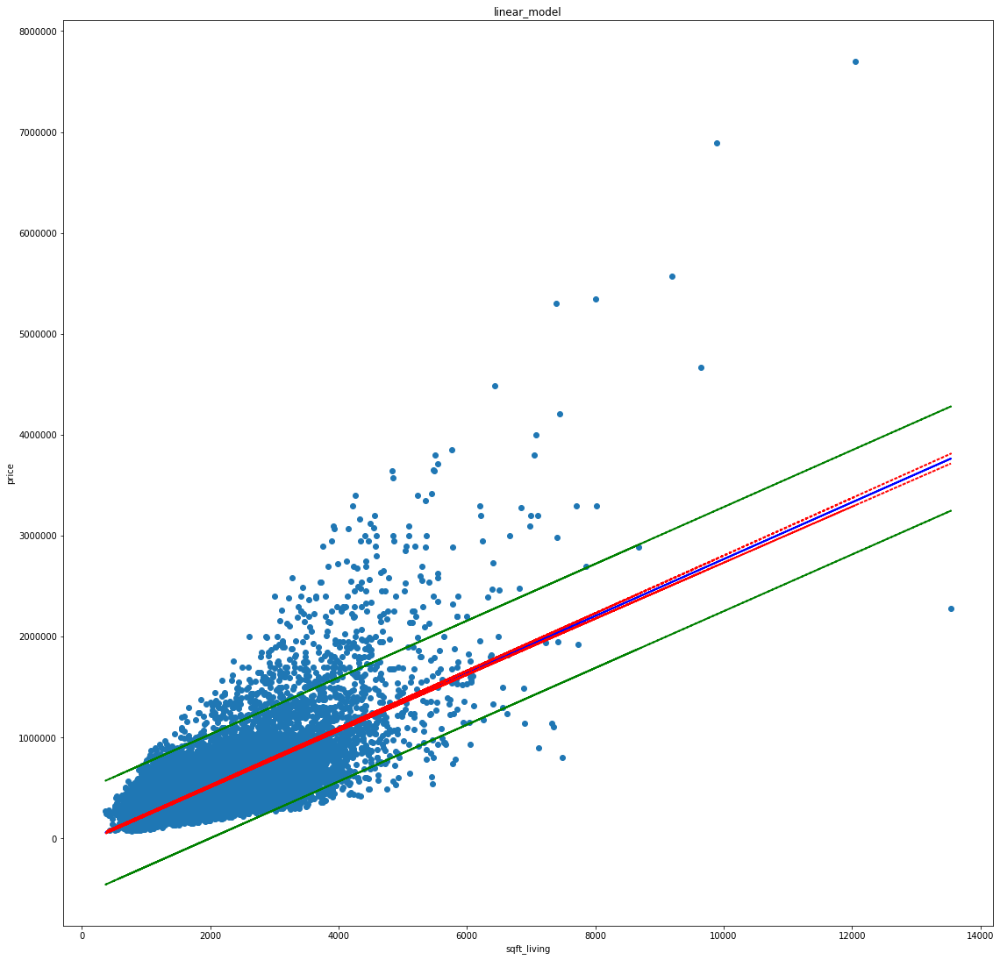

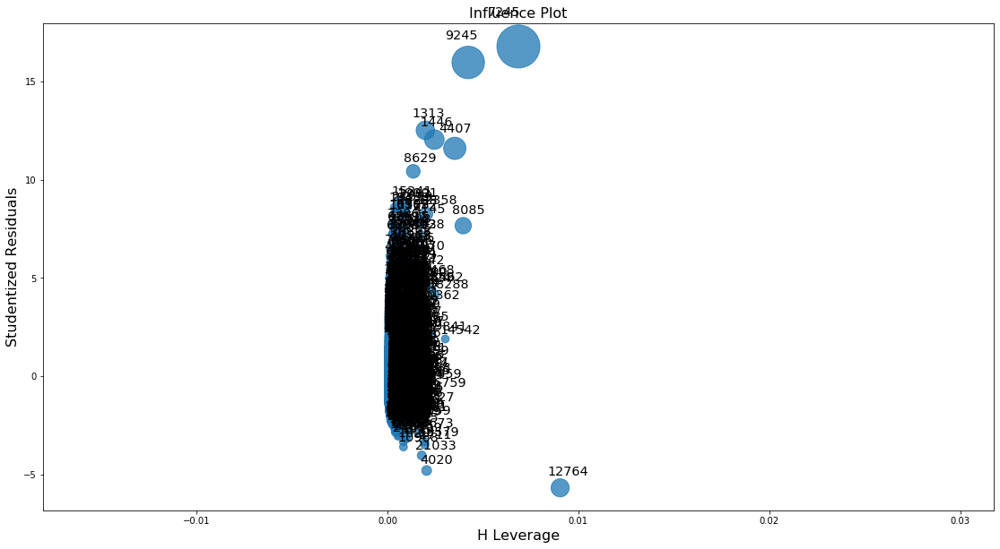

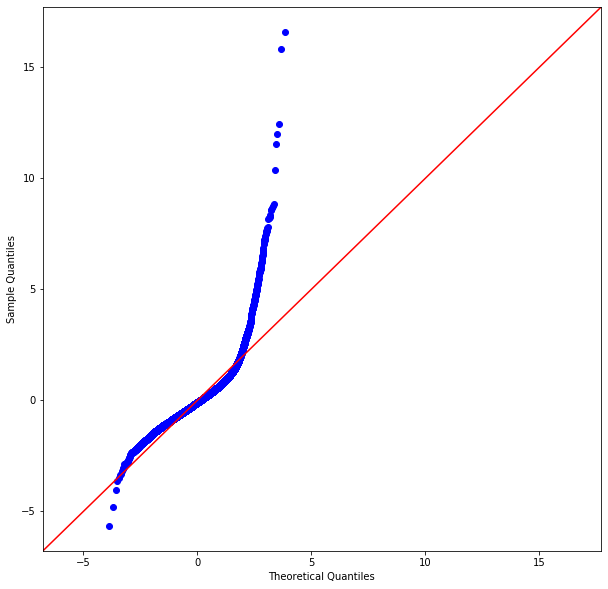

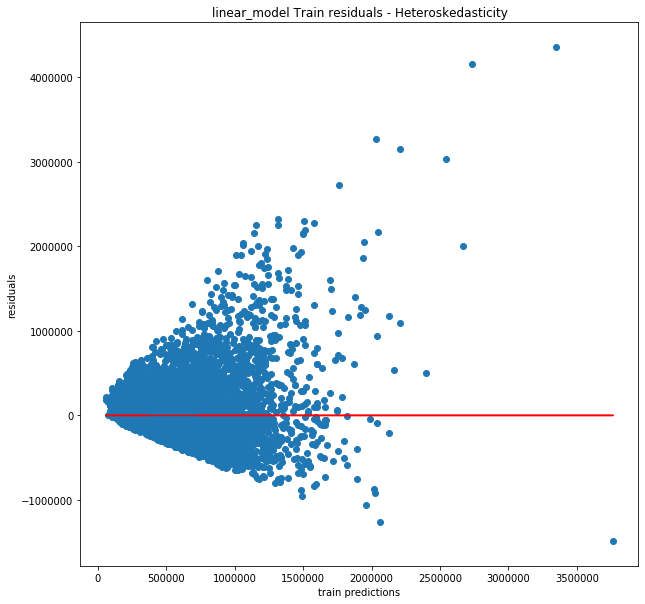

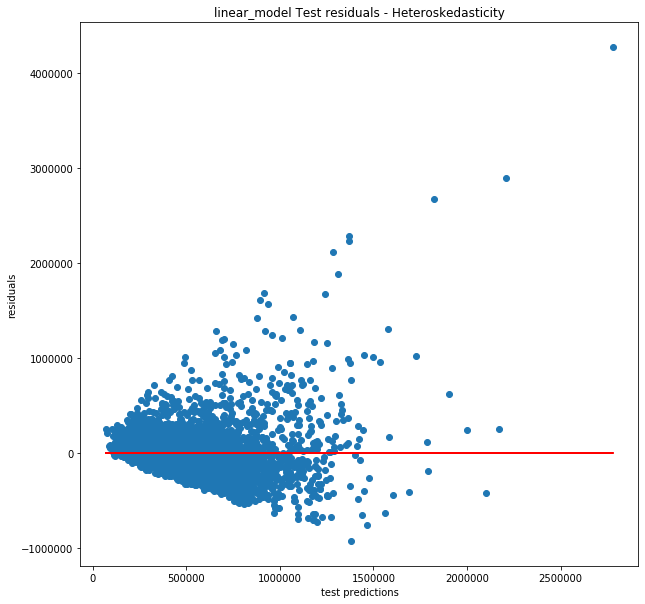

sqft_living - Plotted


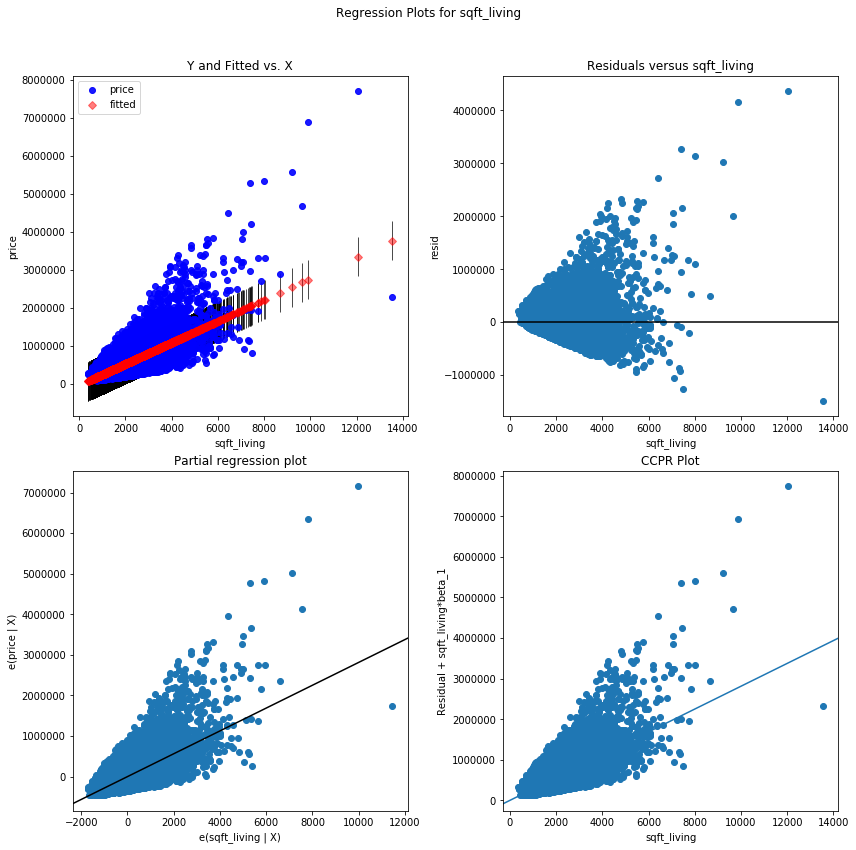

In [179]:
dfresults_lin, dfs_coeff_lin, summaries_lin, models_dict_lin, X_train_models_lin, X_test_models_lin, y_train_models_lin, y_test_models_lin, columns_models_lin = run_model(linear_models[0], linear_targets[0], 'linear_model', 10, plots=True,
    feature_selection=False)

In [183]:
lowers_lin, uppers_lin, residuals_lin = get_prediction_interval(y_test_models_lin,  models_dict_lin[0].predict(X_train_models_lin))

Text(0.5, 1.0, 'Residuals linear_model histogram')

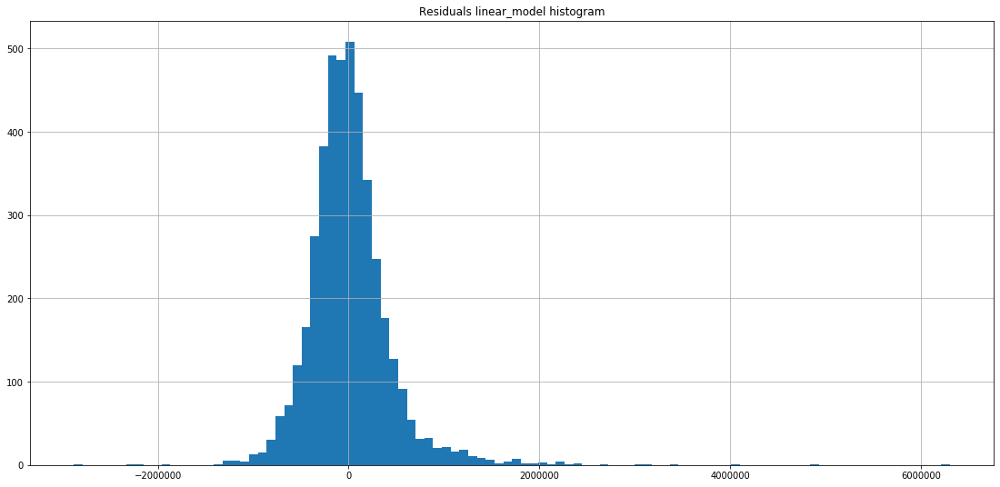

In [188]:
residuals_lin['residuals'].hist(figsize=(19,9), bins=100)
plt.title('Residuals linear_model histogram')

## Multilinear regression

In [74]:
multi_targets_str = [get_df_name(x) for x in multi_targets]
multi_models_str = [get_df_name(x) for x in multi_models]

In [70]:
def get_df_name(df):
    name =[x for x in globals() if globals()[x] is df][0]
    return name

In [156]:
multi_models = [b_pro, logtr, minmax, robscal, logstd, b6_pro, logtr6, minmax6, robscal6, logstd6, b_pro_mul, logtr_mul, minmax_mul, robscal_mul, logstd_mul, b6_pro_mul, logtr6_mul, minmax6_mul, robscal6_mul, logstd6_mul, b_pro_mul_vif, logtr_mul_vif, minmax_mul_vif, robscal_mul_vif, logstd_mul_vif, b6_pro_mul_vif, logtr6_mul_vif, minmax6_mul_vif,robscal6_mul_vif, logstd6_mul_vif, b_pro_out, b_pro_log_out, b_pro_minmax_out, b_pro_robscal_out, b_pro_std_out, b6_pro_out, b6_pro_log_out, b6_pro_minmax_out, b6_pro_robscal_out, b6_pro_std_out, b_pro_out_mul, b_pro_log_out_mul, b_pro_minmax_out_mul, b_pro_robscal_out_mul, b_pro_std_out_mul, b6_pro_out_mul, b6_pro_log_out_mul, b6_pro_minmax_out_mul, b6_pro_robscal_out_mul, b6_pro_std_out_mul, b_pro_out_mul_vif, logtr_out_mul_vif, minmax_out_mul_vif, robscal_out_mul_vif, logstd_out_mul_vif, b6_pro_out_mul_vif, logtr6_out_mul_vif, minmax6_out_mul_vif,robscal6_out_mul_vif, logstd6_out_mul_vif]
multi_targets = [target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout, target_pro_noout]
multi_descriptions = ['multilinear', 'multilinear-log', 'multilinear-log-minmax', 'multilinear-log-robscal', 'multilinear-log-std', 'multilinear_6cat', 'multilinear_6cat-log','multilinear_6cat-log-minmax', 'multilinear_6cat-log-robscal', 'multilinear_6cat-log-std', 'multilinear_mul', 'multilinear_mul-log', 'multilinear_mul-log-minmax', 'multilinear_mul-log-robscal', 'multilinear_mul-log-std', 'multilinear_6cat_mul', 'multilinear_6cat_mul-log', 'multilinear_6cat_mul-log-minamx', 'multilinear_6cat_mul-log-robscal', 'multilinear_6cat_mul-log-std', 'multilinear_mul_vif','multilinear_mul_vif-log','multilinear_mul_vif-log-minmax','multilinear_mul_vif-log-robscal','multilinear_mul_vif-log-std','multilinear_6_cat_mul_vif', 'multilinear_6_cat_mul_vif-log','multi-log-minmax','multilinear_6_cat_mul_vif-log-robscal','multilinear_6_cat_mul_vif-log-std', 'multilinear_noout', 'multilinear_noout-log', 'multilinear_noout-log-minmax', 'multilinear_noout-log-robscal', 'multilinear_noout-log-std', 'multilinear_6cat_noout', 'multilinear_6cat_noout-log', 'multilinear_6cat_noout-log-minamax', 'multilinear_6cat_noout-log-robscal', 'multilinear_6cat_noout-log-std', 'multilinear_mul_noout', 'multilinear_mul_noout-log', 'multilinear_mul_noout-log-minmax', 'multilinear_mul_noout-log-robscal', 'multilinear_mul_noout-log-std', 'multilinear_6cat_mul_noout', 'multilinear_6cat_mul_noout-log', 'multilinear_6cat_mul_noout-log-minmax', 'multilinear_6cat_mul_noout-log-robscal', 'multilinear_6cat_mul_noout-log-std', 'multilinear_mul_noout_vif','multilinear_mul_noout_vif-log','multilinear_out_mul_vif-log-minmax','multilinear_out_mul_vif-log-robscal','multilinear_noout_mul_vif-log-std','multilinear_6cat_noout_mul_vif','multilinear_6cat_noout_mul_vif-log','multilinear_6cat_noout_mul_vif-log-minmax','multilinear_6cat_noout_mul_vif-log-robscal','multilinear_6cat_noout_mul_vif-log-std']

In [157]:
results_multi, dfs_coeffs_multi, summaries_multi, models_multi, X_train_models_multi, X_test_models_multi, y_train_models_multi, y_test_models_multi, columns_models_multi = run_multi_models(multi_models, multi_targets, multi_descriptions, featureSelection=False)

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site


multilinear --- Adj.R^2: ['0.816']


Top 10 coefficients by absolute value
                 multilinear
const          2.887955e+07
zipcode_98039  1.181553e+06
zipcode_98004  6.151155e+05
waterfront     5.705279e+05
zipcode_98112  4.831676e+05
zipcode_98040  3.948775e+05
bedrooms_10.0  3.944882e+05
zipcode_98102  3.902834e+05
zipcode_98109  3.723325e+05
zipcode_98119  3.474777e+05 

Top 10 coefficients (actual values)
                 multilinear
zipcode_98039  1.181553e+06
zipcode_98004  6.151155e+05
waterfront     5.705279e+05
zipcode_98112  4.831676e+05
zipcode_98040  3.948775e+05
zipcode_98102  3.902834e+05
zipcode_98109  3.723325e+05
zipcode_98119  3.474777e+05
zipcode_98105  3.373654e+05
view_4.0       3.347618e+05

multilinear-log --- Adj.R^2: ['0.767']


Top 10 coefficients by absolute value
                multilinear-log
waterfront        3.402294e+07
zipcode_98039     1.375793e+06
zipcode_98004     6.816793e+05
view_4.0          5.850628e+05
zipcode_98112     5.473747e+05
z


multilinear_mul_noout_vif --- Adj.R^2: ['0.441']


Top 10 coefficients by absolute value
                multilinear_mul_noout_vif
const                      477222.307792
zipcode_98040              393862.620041
zipcode_98002              290912.994654
zipcode_98032              268776.192813
zipcode_98022              268158.070201
zipcode_98198              267721.166143
zipcode_98168              261904.018198
zipcode_98030              250496.076595
zipcode_98092              249870.418508
zipcode_98178              249724.284081 

Top 10 coefficients (actual values)
                multilinear_mul_noout_vif
const                      477222.307792
zipcode_98040              393862.620041
zipcode_98112              249293.881481
zipcode_98005              228530.049354
zipcode_98109              225588.321108
view_1.0                   197474.122385
floors_2.5                 194657.610418
view_2.0                   179024.251699
zipcode_98119              164278.697311
zipcode_9

In [158]:
results_multi.to_csv('multilinear-results.csv')

In [229]:
pickle_regression_results('multilinear', results_multi, dfs_coeffs_multi, summaries_multi, models_multi, X_train_models_multi, X_test_models_multi, y_train_models_multi, y_test_models_multi, columns_models_multi)

### Best Model 

The best performing model is **'*multilinear-noout*'** with
- Test RMSE: 94251
- Adj. R^2: 0.828
- AIC: 3.865e+05
- 10-fold Cross-validation R-Squared of 0.837 +- 0.010

Let's see how our results are affected by feature selection.

However, the validity of the model **multilinear-noout** is affected by:
- Multicolinearity (no VIF)
- Scaling

For this reason, we prefer the **multilinear_6cat_noout_mul_vif-log-std**, which has:

- Test RMSE: 126962.007	
- AIC: 3.961e+05
- Adj R^2: 0.688
- 10-fold Cross-validation R-Squared of 0.694 +- 0.017 

In [35]:
results_multi_bm_vif, dfs_coeffs_multi_bm_vif, summaries_multi_bm_vif, models_multi_bm_vif, X_train_models_multi_bm_vif, X_test_models_multi_bm_vif, y_train_models_multi_bm_vif, y_test_models_multi_bm_vif, columns_models_multi_bm_vif  = run_model(logstd6_out_mul_vif, target_pro_noout, 'multilinear_6cat_noout_mul_vif-log-std', 10, plots=False )

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


In [37]:
summaries_multi_bm_vif

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.696
Model:                            OLS   Adj. R-squared:                  0.695
Method:                 Least Squares   F-statistic:                     902.5
Date:                Mon, 22 Jun 2020   Prob (F-statistic):               0.00
Time:                        17:24:17   Log-Likelihood:            -1.9799e+05
No. Observations:               15034   AIC:                         3.961e+05
Df Residuals:                   14995   BIC:                         3.963e+05
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const             -2.244e+06   5.23e+04    -42.925      0.000   -2.35e+06   -2.14e+06
floors             1.222e+04   1350.325      9.048      0.000    9570.426    1.49e+04
condition          1.103e+04   1170.502      9.423      0.000    8735.150    1.33e+04
grade              1.061e+05   1617.798     65.586      0.000    1.03e+05    1.09e+05
yr_built          -6.441e+04   1552.868    -41.481      0.000   -6.75e+04   -6.14e+04
log-bedrooms       3.804e+04   4617.476      8.239      0.000     2.9e+04    4.71e+04
log-bathrooms      7.432e+04   4398.971     16.896      0.000    6.57e+04    8.29e+04
log-sqft_living15  7.033e+04   4977.906     14.129      0.000    6.06e+04    8.01e+04
log-MHI             1.82e+05   4007.764     45.408      0.000    1.74e+05     1.9e+05
view_2.0           7.093e+04   5512.699     12.867      0.000    6.01e+04    8.17e+04
zipcode_98002     -4.207e+04   1.08e+04     -3.906      0.000   -6.32e+04    -2.1e+04
zipcode_98003     -1.016e+05   8787.753    -11.567      0.000   -1.19e+05   -8.44e+04
zipcode_98005      1.267e+05   1.17e+04     10.872      0.000    1.04e+05     1.5e+05
zipcode_98007      7.696e+04   1.25e+04      6.155      0.000    5.24e+04    1.01e+05
zipcode_98010     -4.793e+04    1.7e+04     -2.813      0.005   -8.13e+04   -1.45e+04
zipcode_98022     -8.069e+04   1.16e+04     -6.971      0.000   -1.03e+05    -5.8e+04
zipcode_98023     -1.529e+05   6642.624    -23.016      0.000   -1.66e+05    -1.4e+05
zipcode_98024     -3.266e+04   2.07e+04     -1.582      0.114   -7.31e+04    7818.858
zipcode_98030     -7.659e+04   9155.638     -8.366      0.000   -9.45e+04   -5.86e+04
zipcode_98031     -1.178e+05   9007.428    -13.075      0.000   -1.35e+05      -1e+05
zipcode_98032     -1.051e+05   1.37e+04     -7.671      0.000   -1.32e+05   -7.83e+04
zipcode_98040      1.998e+05   1.07e+04     18.710      0.000    1.79e+05    2.21e+05
zipcode_98045     -7.474e+04   4.49e+04     -1.663      0.096   -1.63e+05    1.33e+04
zipcode_98055     -7.102e+04   9137.215     -7.773      0.000   -8.89e+04   -5.31e+04
zipcode_98070     -3.786e+04   2.18e+04     -1.733      0.083   -8.07e+04    4958.918
zipcode_98092     -1.617e+05   8332.961    -19.402      0.000   -1.78e+05   -1.45e+05
zipcode_98102      1.144e+05   1.52e+04      7.507      0.000    8.46e+04    1.44e+05
zipcode_98108       1.41e+04   1.08e+04      1.310      0.190   -6998.931    3.52e+04
zipcode_98109      1.326e+05   1.44e+04      9.199      0.000    1.04e+05    1.61e+05
zipcode_98112      1.328e+05   1.14e+04     11.632      0.000     1.1e+05    1.55e+05
zipcode_98119      1.039e+05   1.18e+04      8.798      0.000    8.07e+04    1.27e+05
zipcode_98136      2723.7141   9502.657      0.287      0.774   -1.59e+04    2.14e+04
zipcode_98146     -4934.2756   9301.225     -0.530      0.596   -2.32e+04

In [36]:
dfs_coeffs_multi_bm_vif.sort_values(by='multilinear_6cat_noout_mul_vif-log-std', ascending=False).head(15)

,multilinear_6cat_noout_mul_vif-log-std
zipcode_98040,199790.154989
log-MHI,181985.414567
zipcode_98112,132809.621366
zipcode_98109,132560.836051
zipcode_98005,126689.920348
zipcode_98102,114440.330472
grade,106105.159104
zipcode_98119,103894.769554
zipcode_98007,76955.904523
log-bathrooms,74324.910885


In [230]:
pickle_regression_results('multilinear_6cat_noout_mul_vif-log-std', results_multi_bm_vif, dfs_coeffs_multi_bm_vif, summaries_multi_bm_vif, models_multi_bm_vif, X_train_models_multi_bm_vif, X_test_models_multi_bm_vif, y_train_models_multi_bm_vif, y_test_models_multi_bm_vif, columns_models_multi_bm_vif )

### Best multilinear model with VIF - removing p-values > 0.05

In [124]:
columns_to_drop = ['zipcode_98024', 'zipcode_98045', 'zipcode_98108', 'zipcode_98070', 'zipcode_98136', 'zipcode_98146', 'zipcode_98188']

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


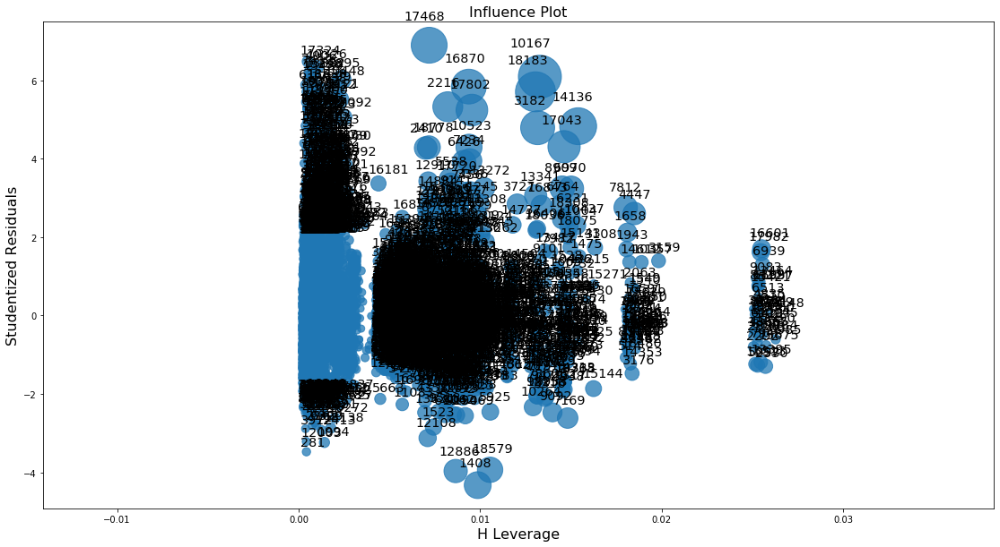

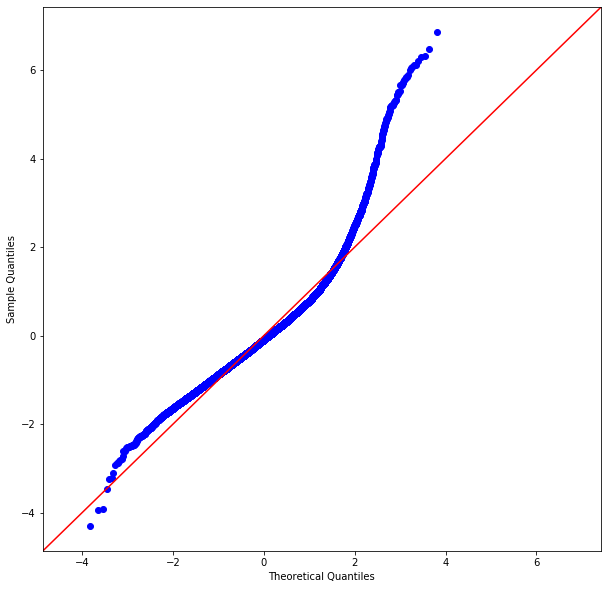

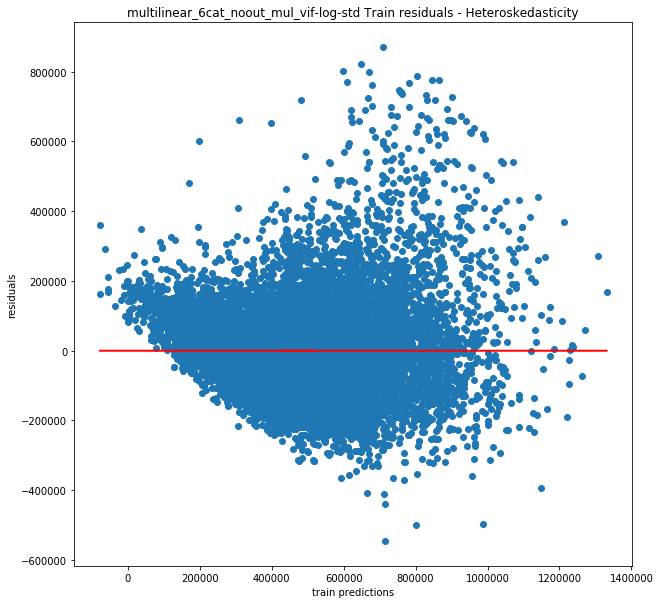

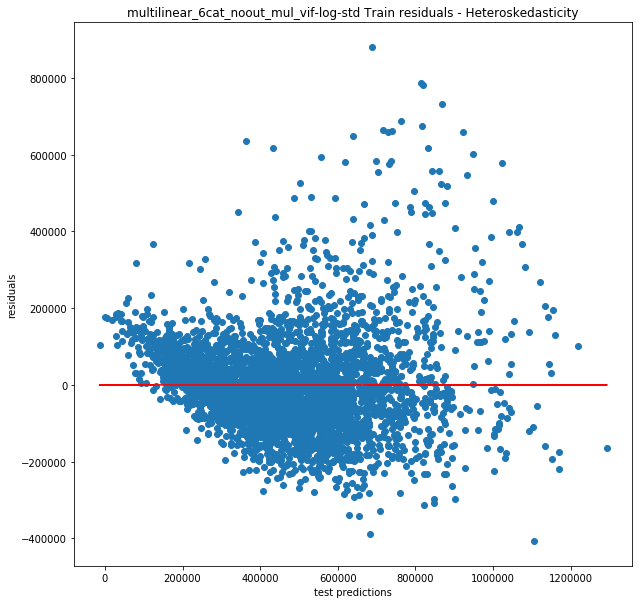

floors - Plotted


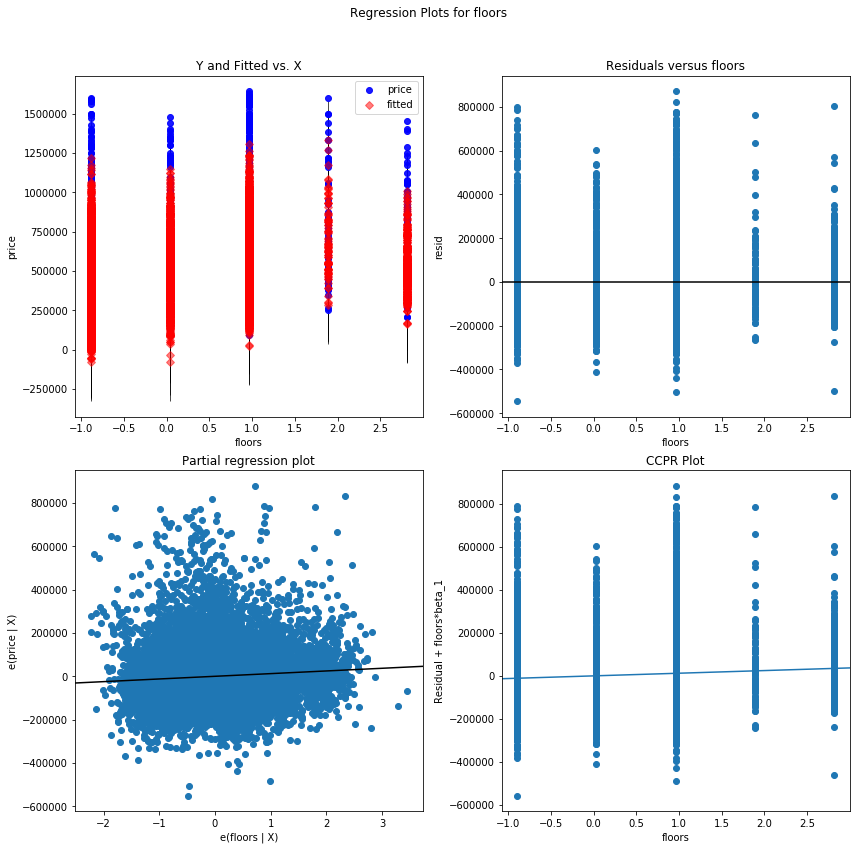

condition - Plotted


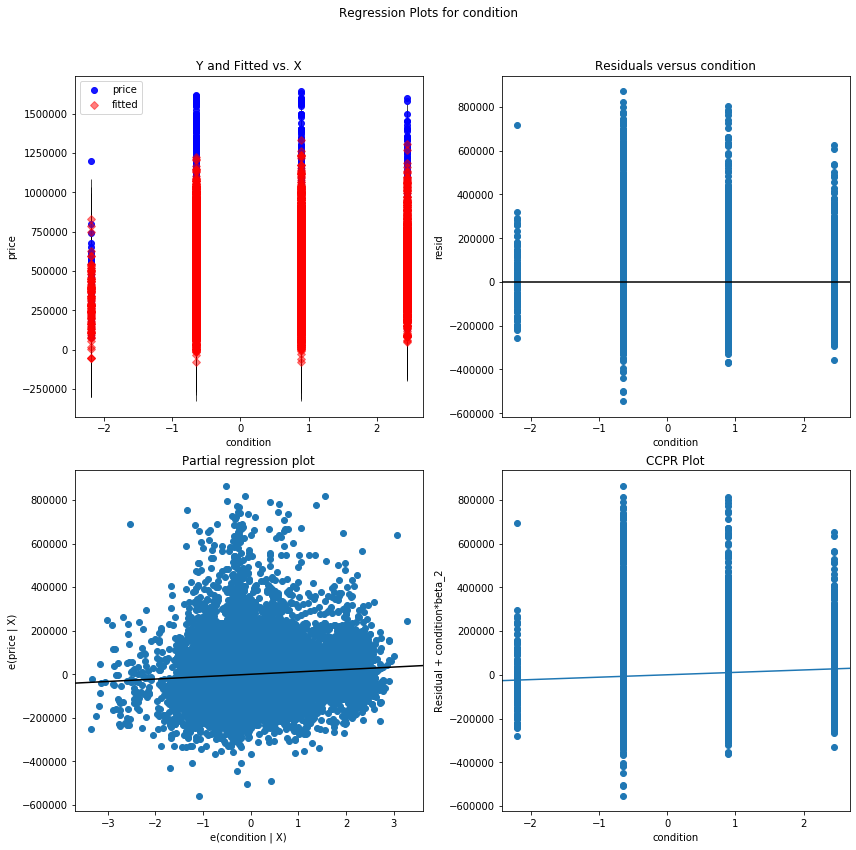

grade - Plotted


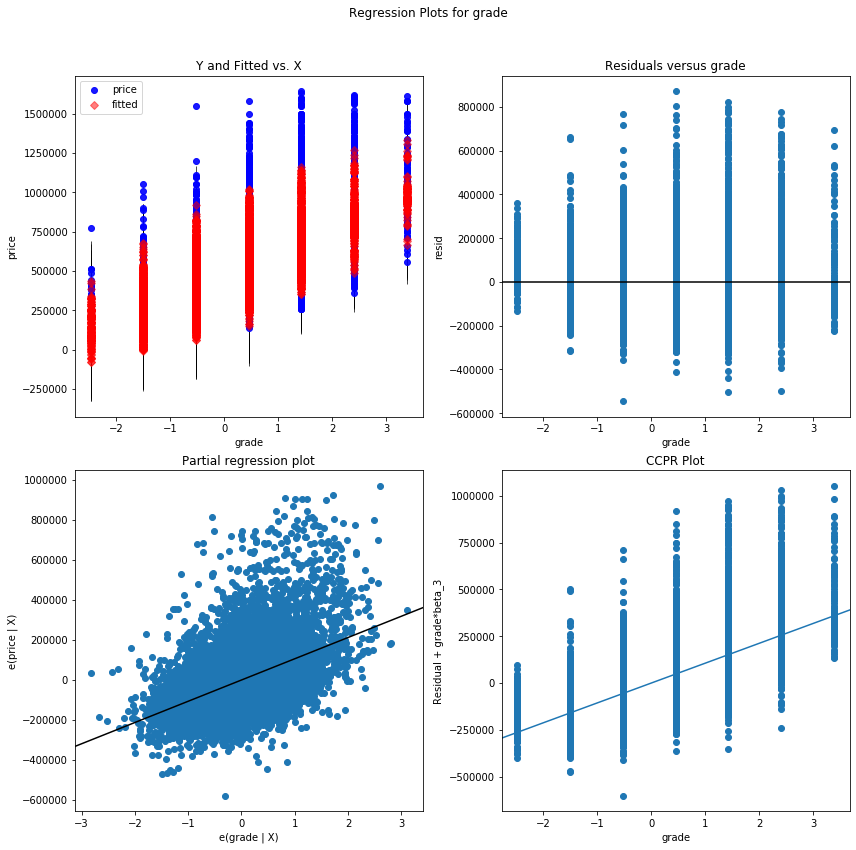

yr_built - Plotted


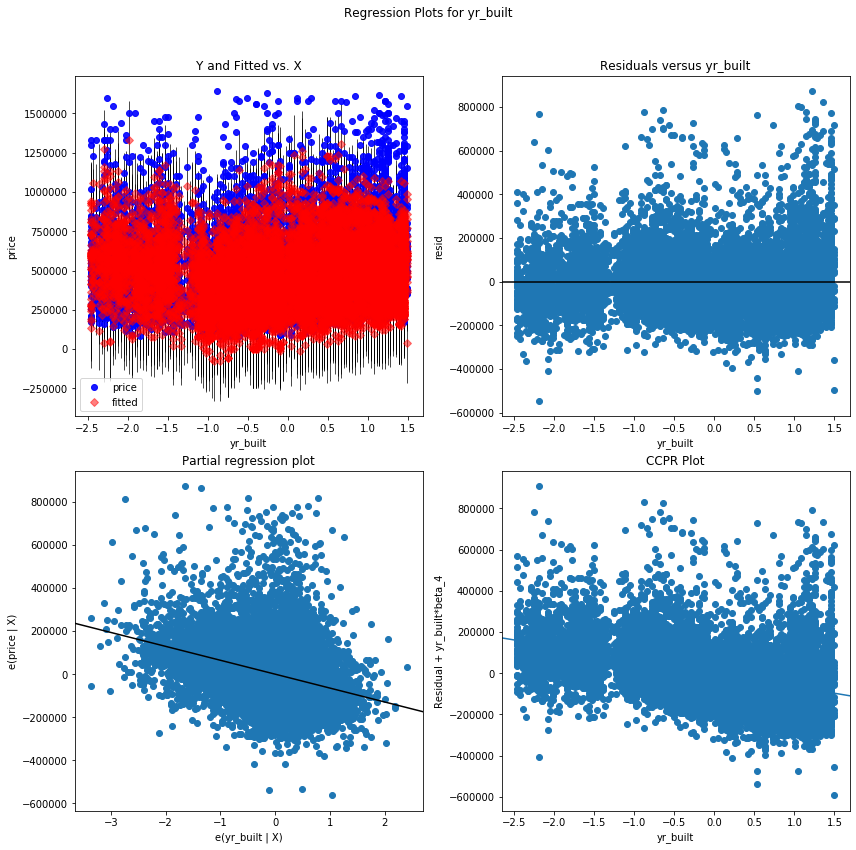

log-bedrooms - Plotted


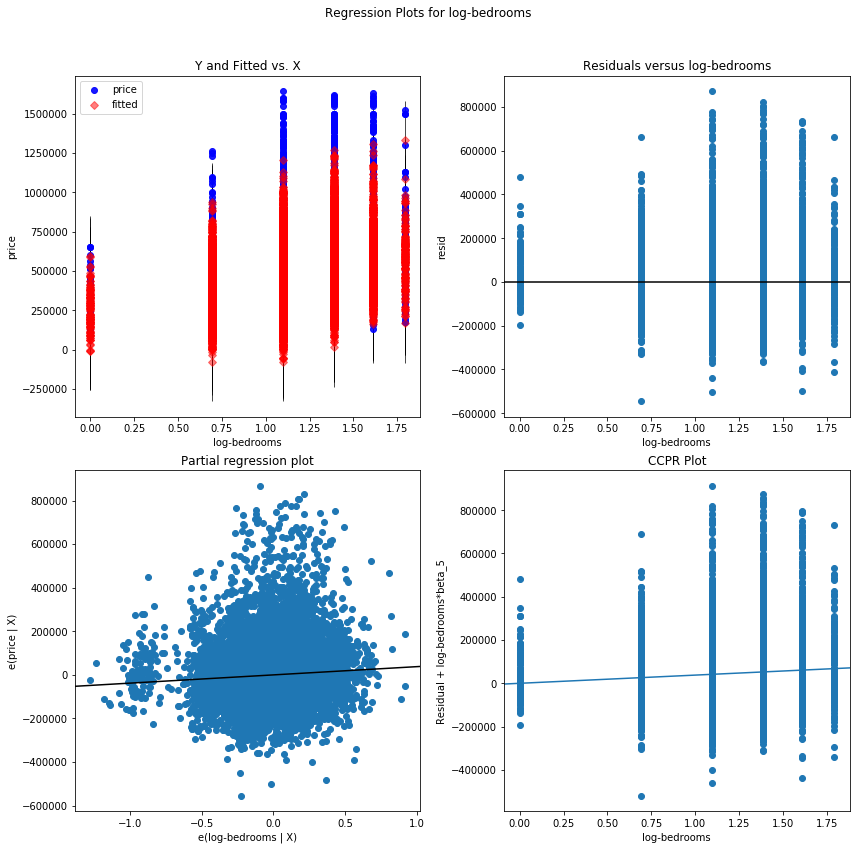

log-bathrooms - Plotted


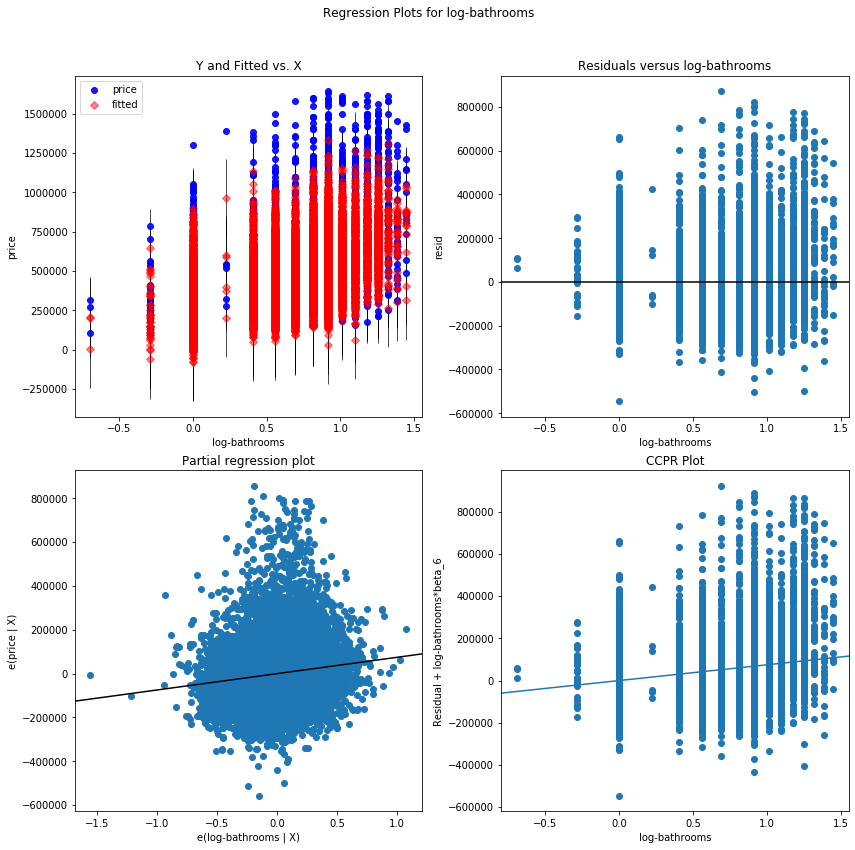

log-sqft_living15 - Plotted


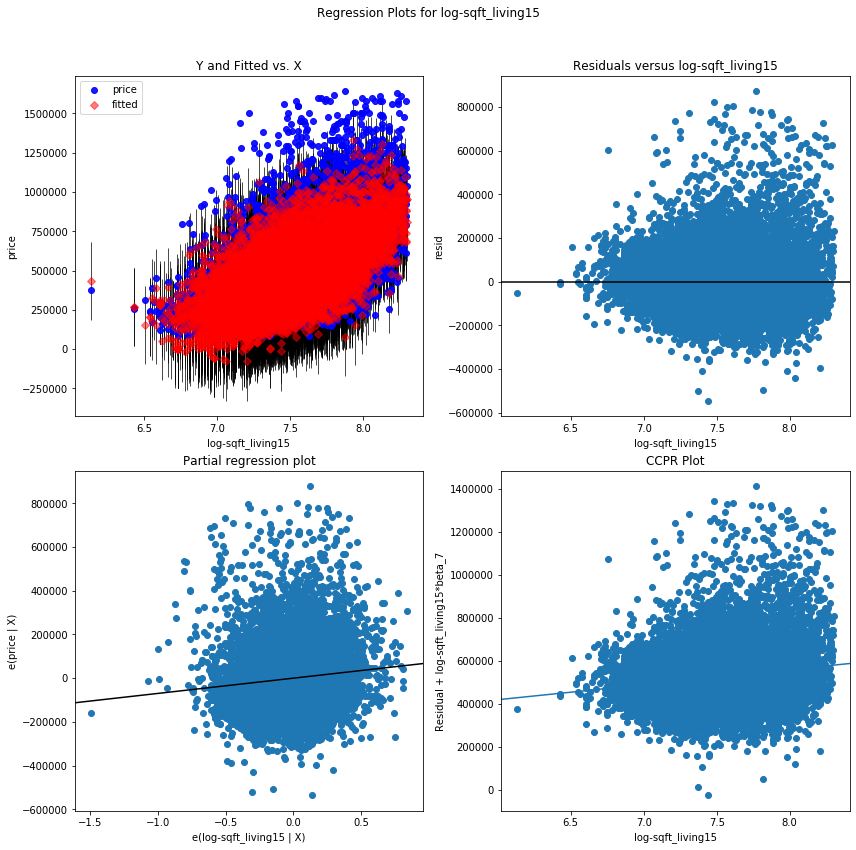

log-MHI - Plotted


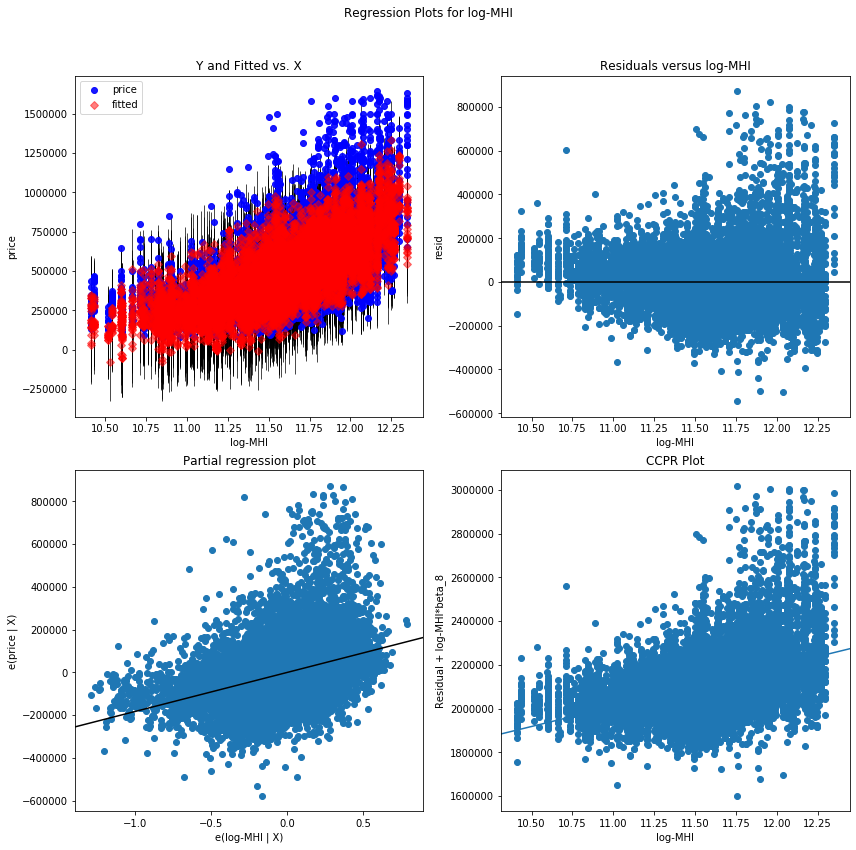

view_2.0 - Plotted


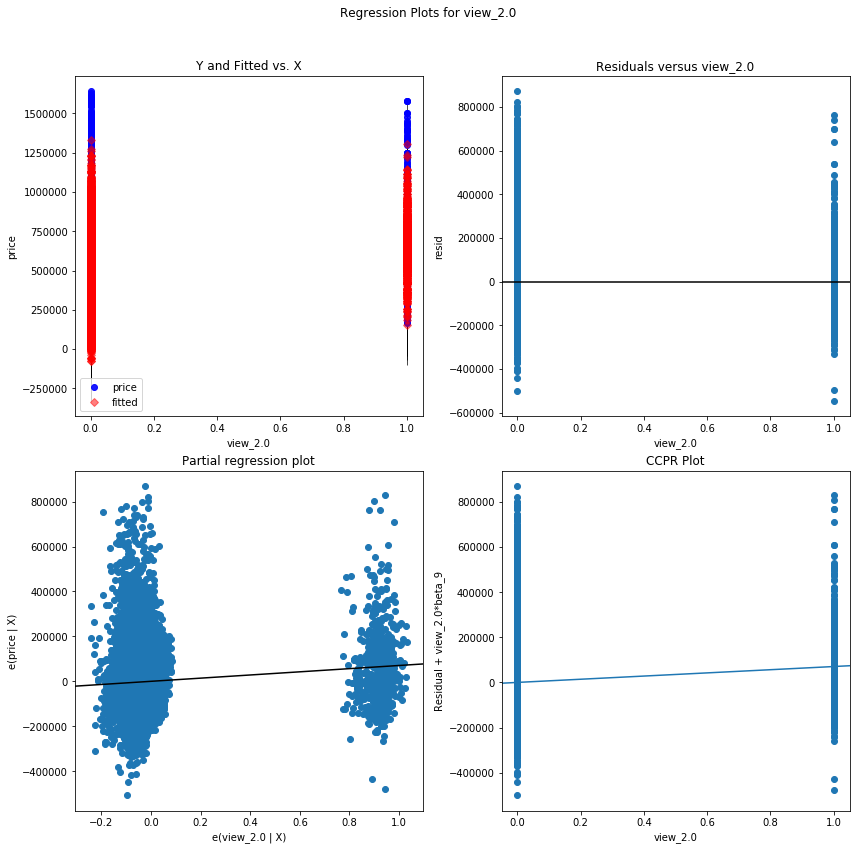

zipcode_98002 - Plotted


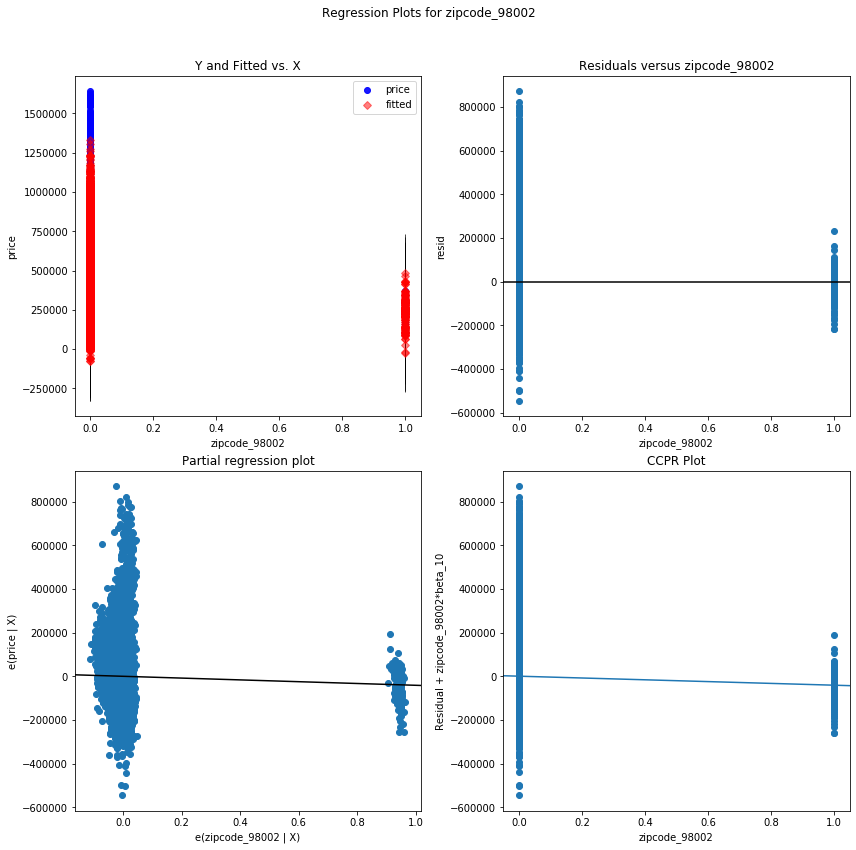

zipcode_98003 - Plotted


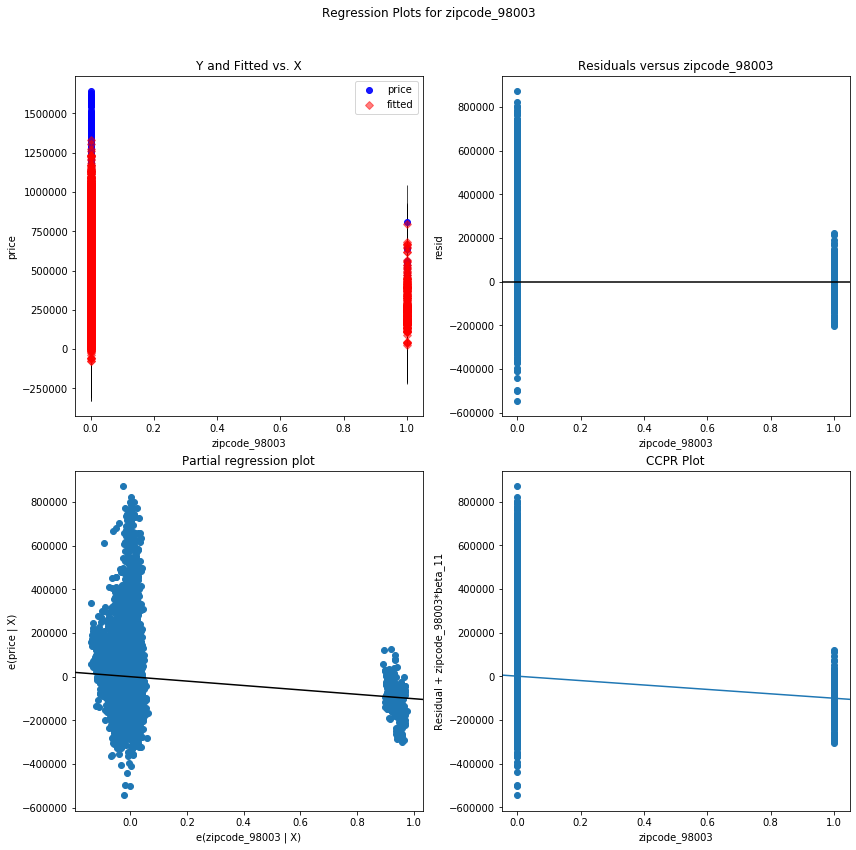

zipcode_98005 - Plotted


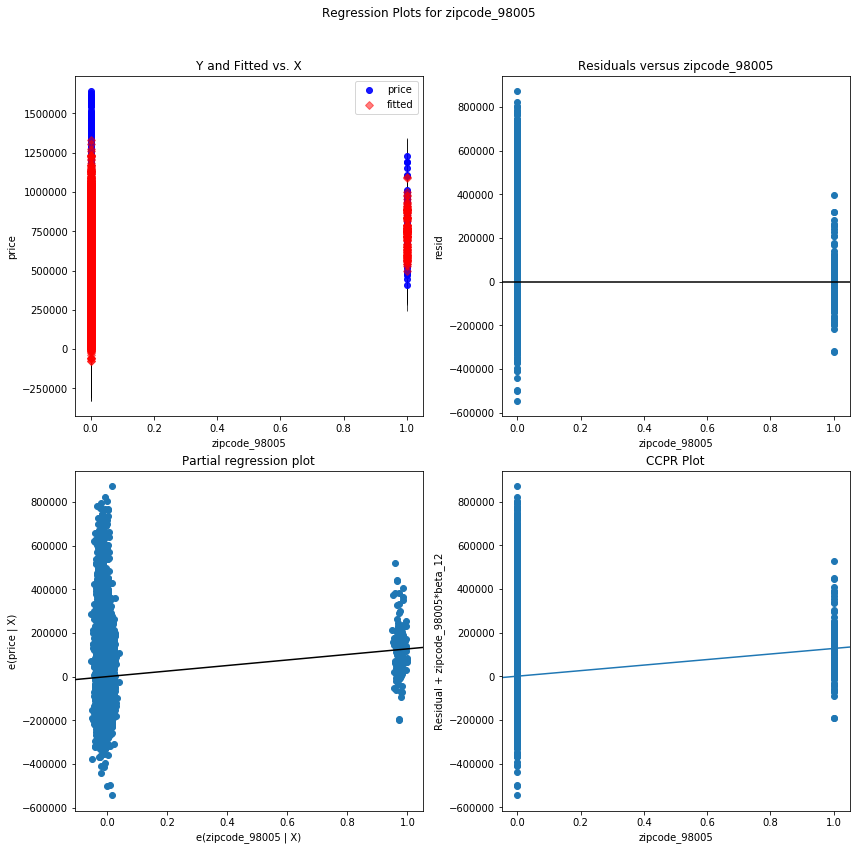

zipcode_98007 - Plotted


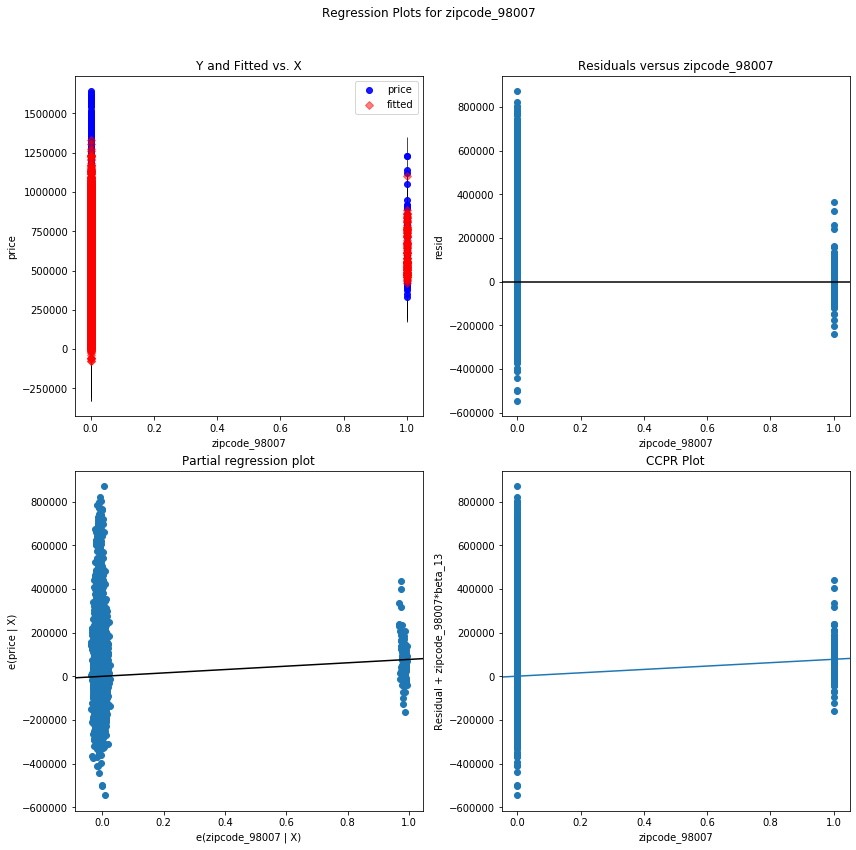

zipcode_98010 - Plotted


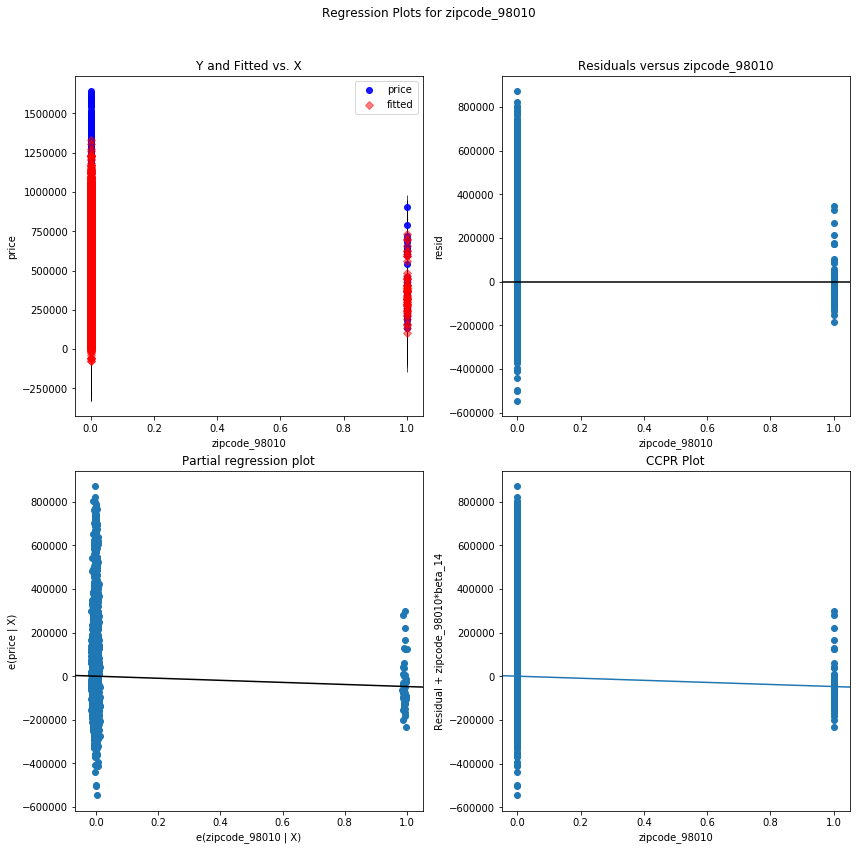

zipcode_98022 - Plotted


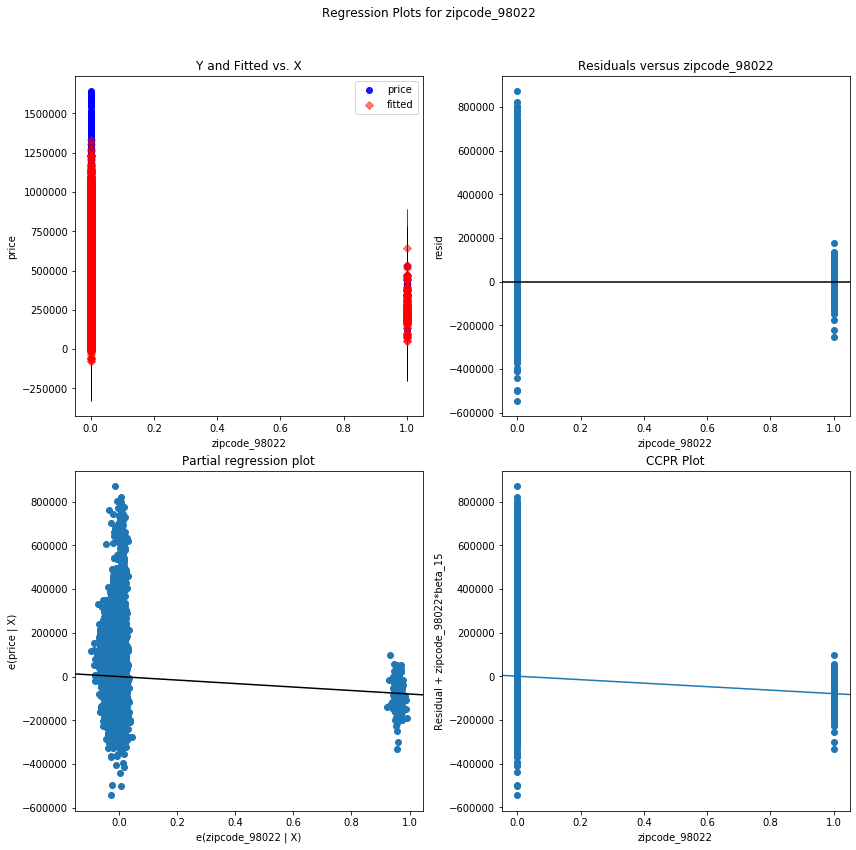

zipcode_98023 - Plotted


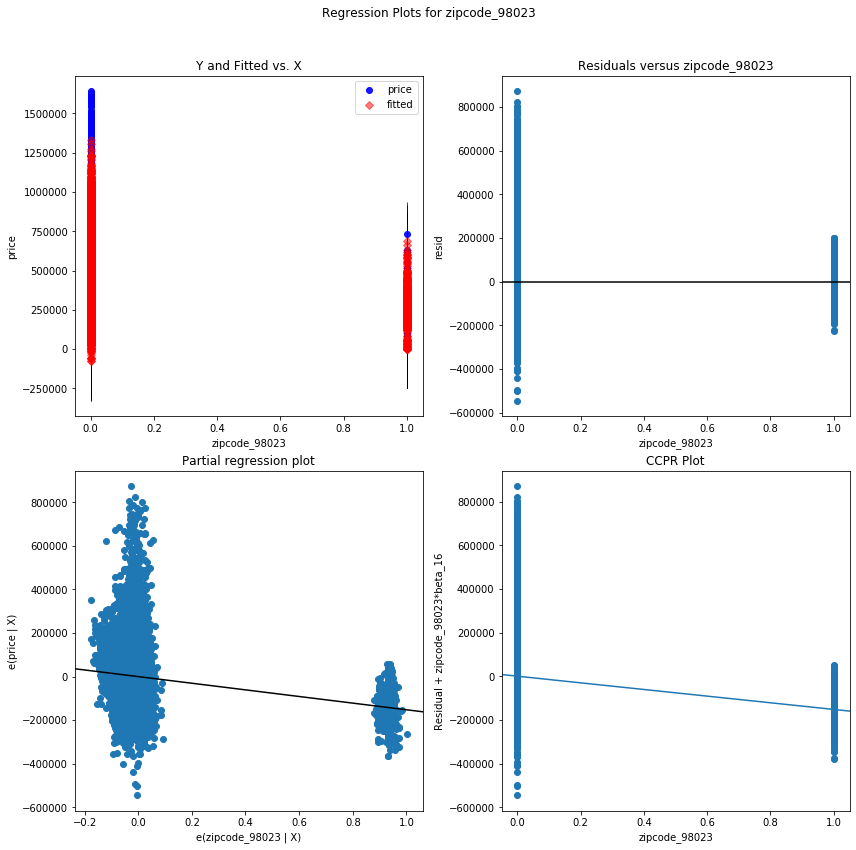

zipcode_98030 - Plotted


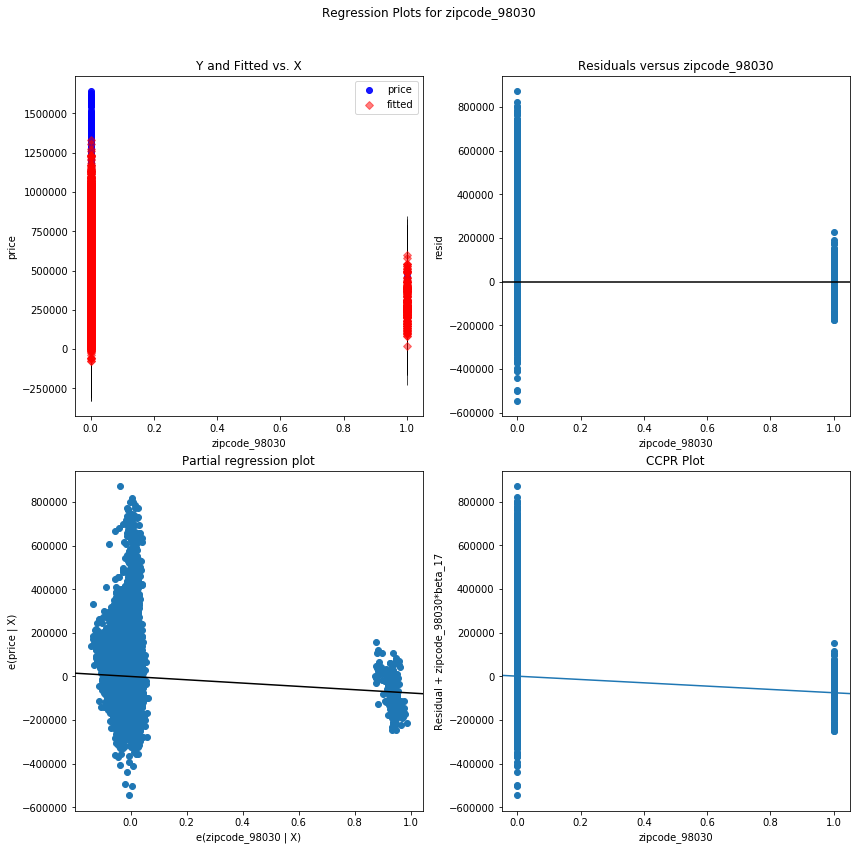

zipcode_98031 - Plotted


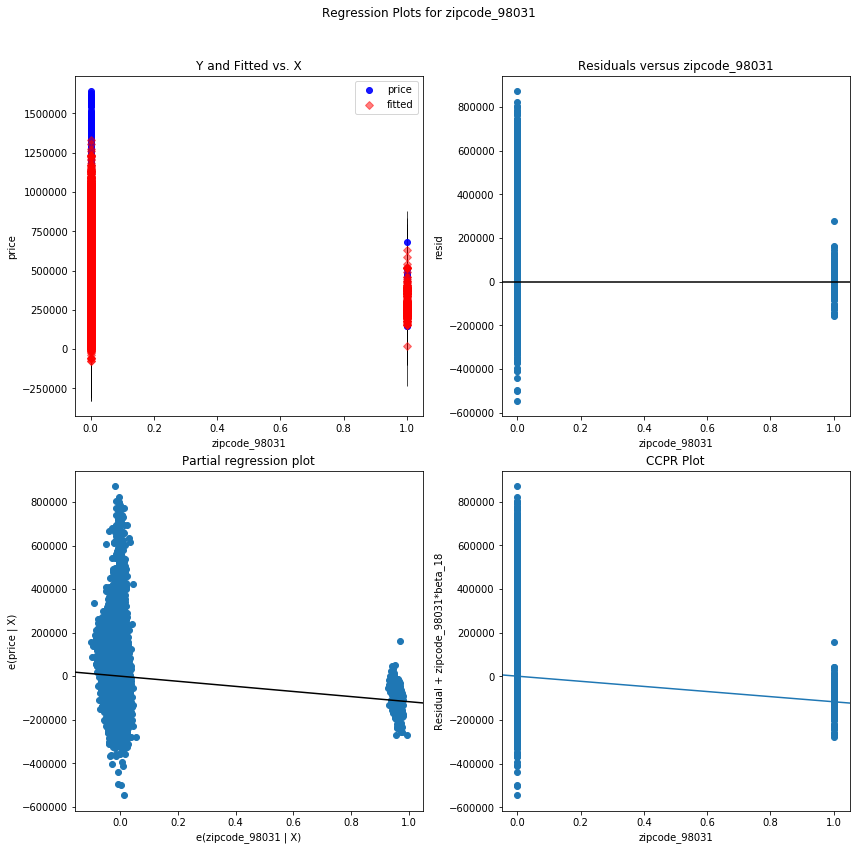

zipcode_98032 - Plotted


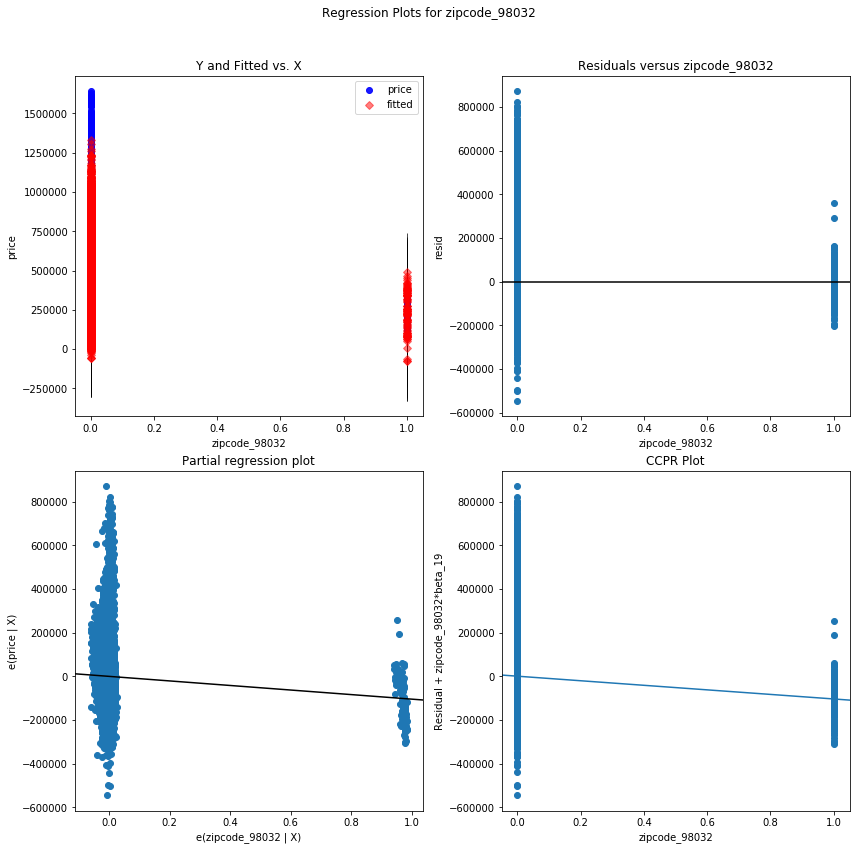

zipcode_98040 - Plotted


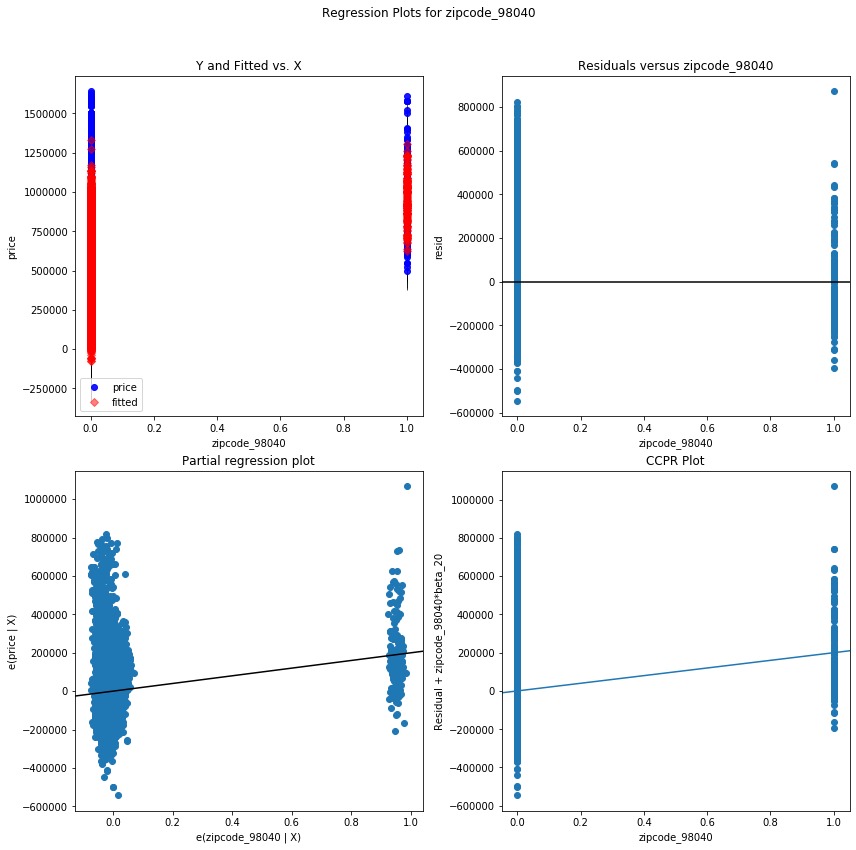

zipcode_98055 - Plotted


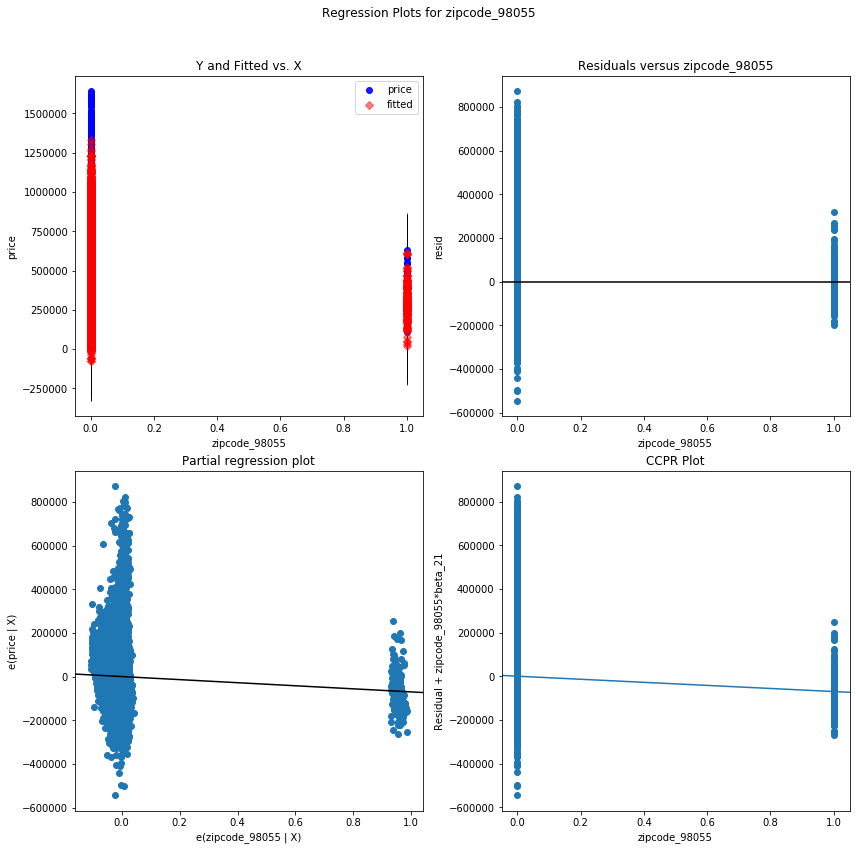

zipcode_98092 - Plotted


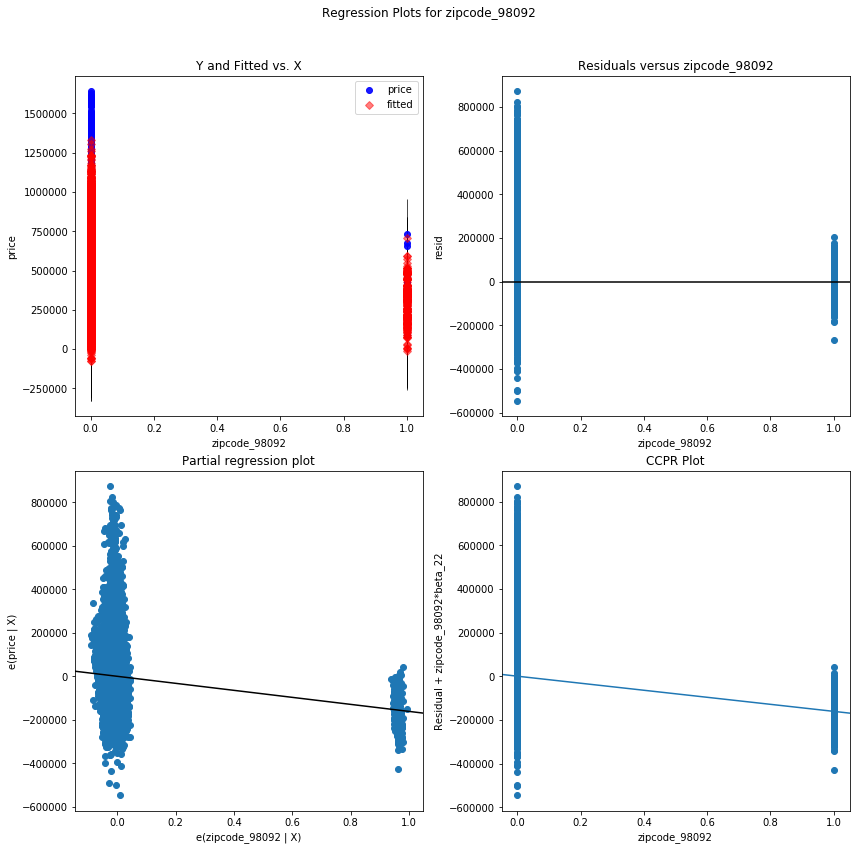

zipcode_98102 - Plotted


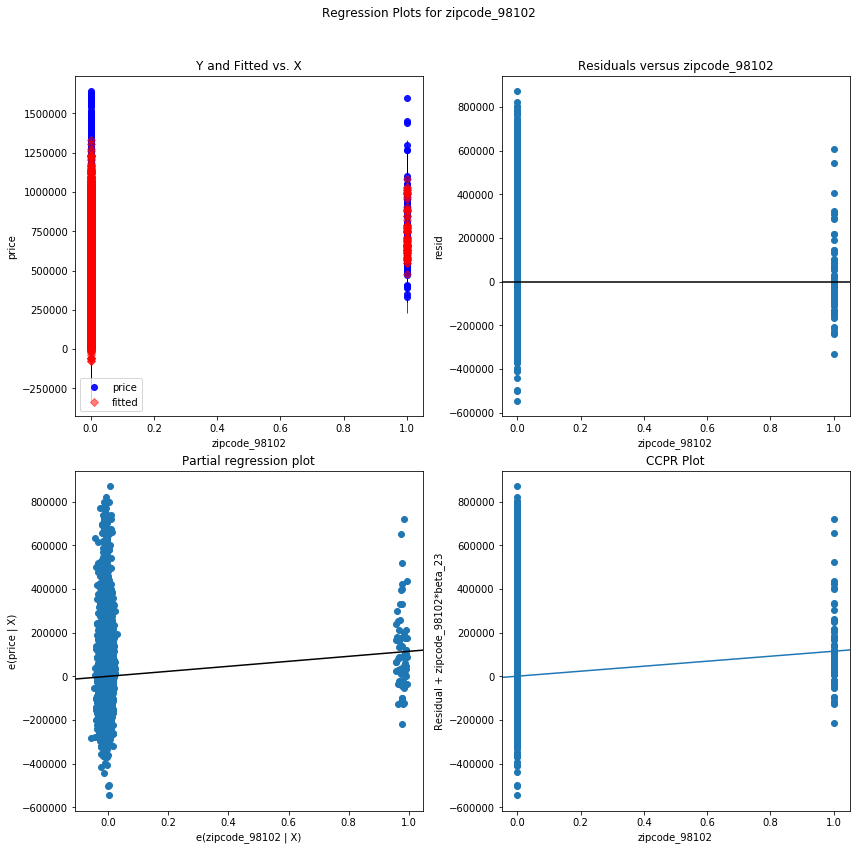

zipcode_98109 - Plotted


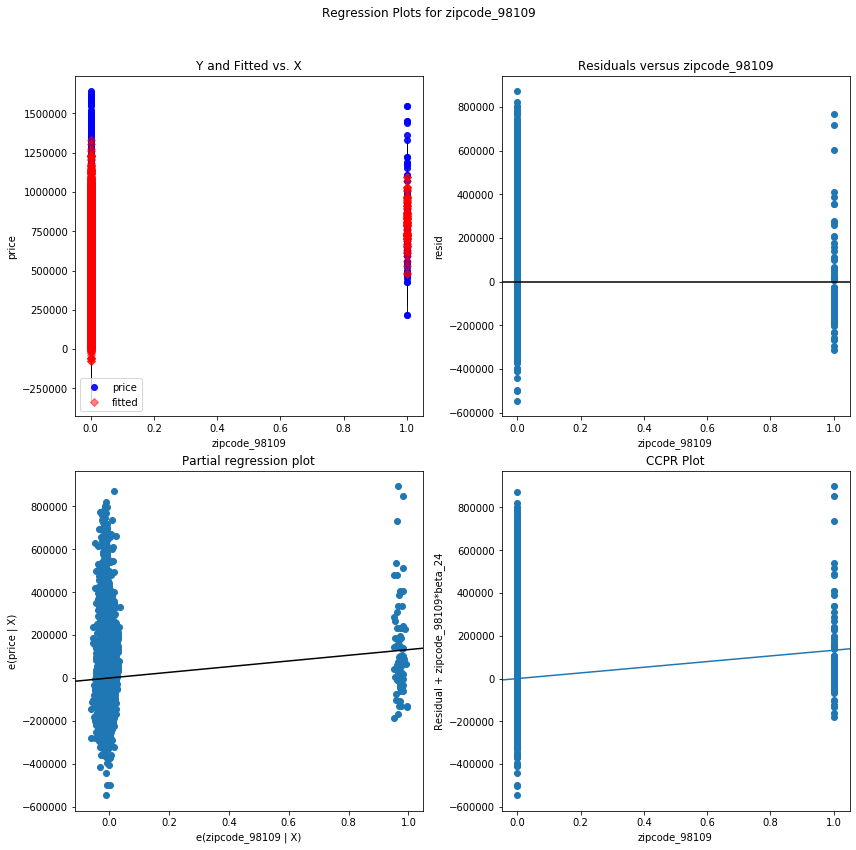

zipcode_98112 - Plotted


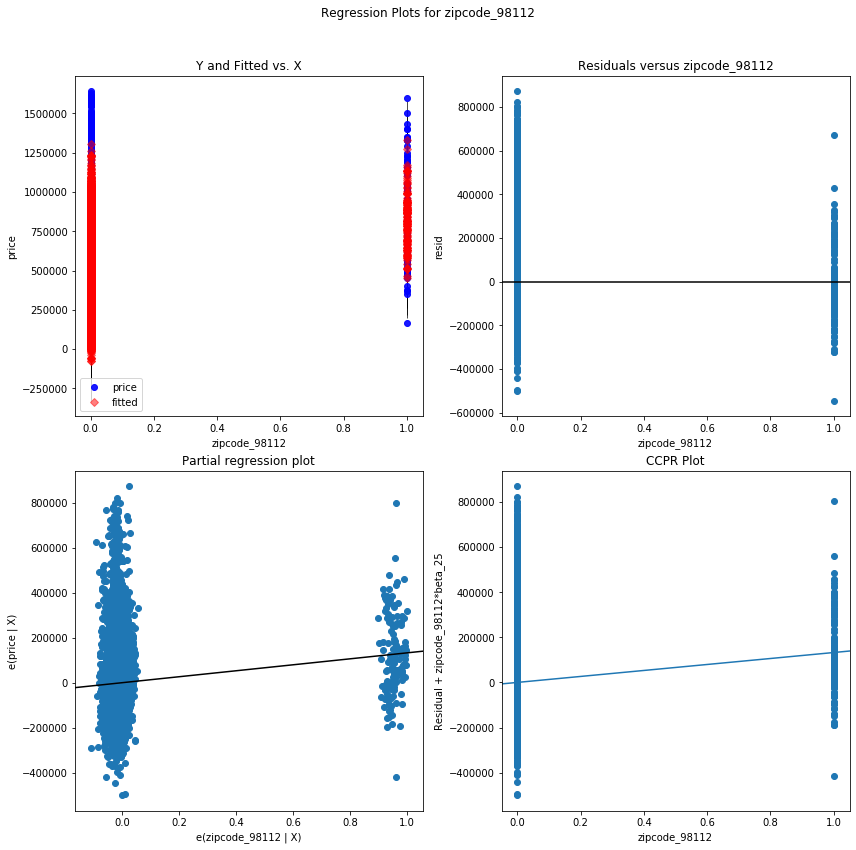

zipcode_98119 - Plotted


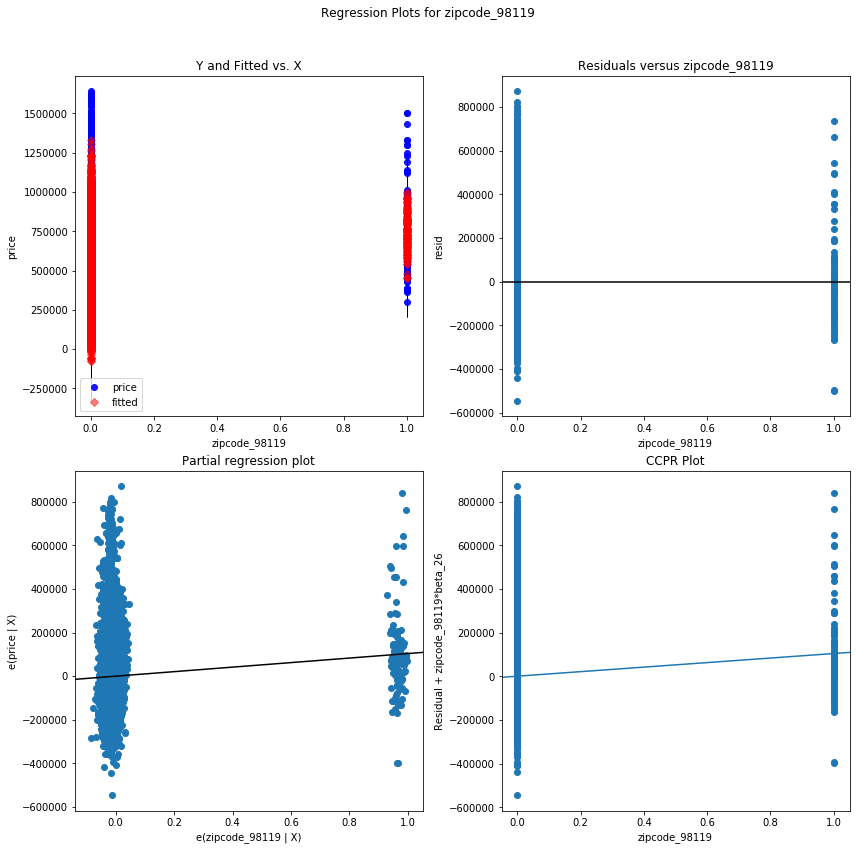

zipcode_98148 - Plotted


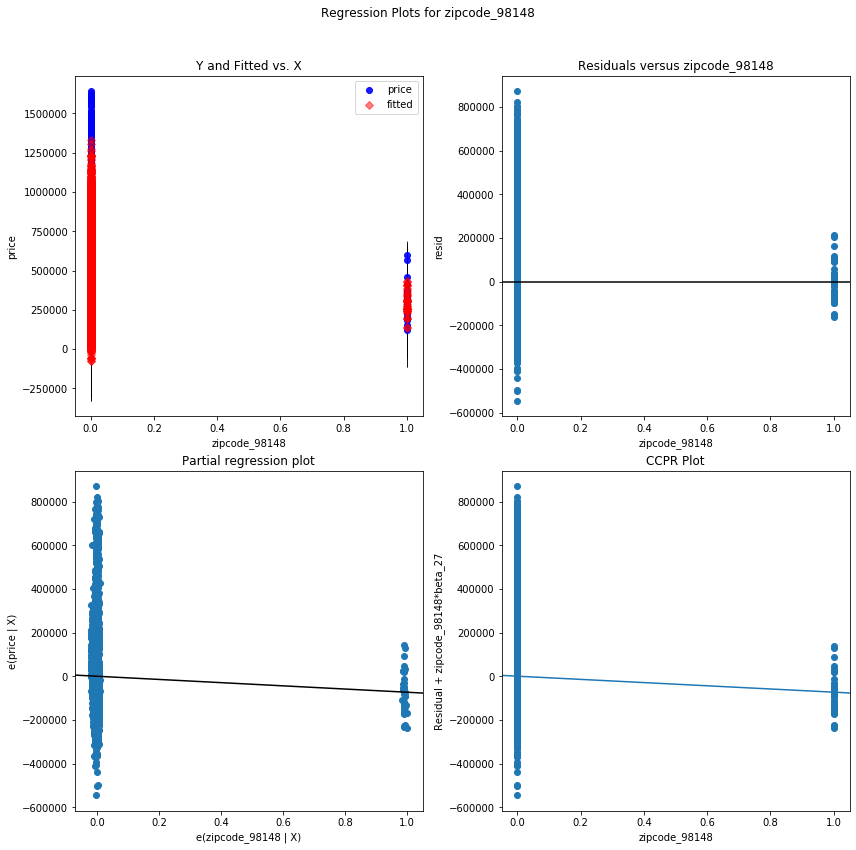

zipcode_98166 - Plotted


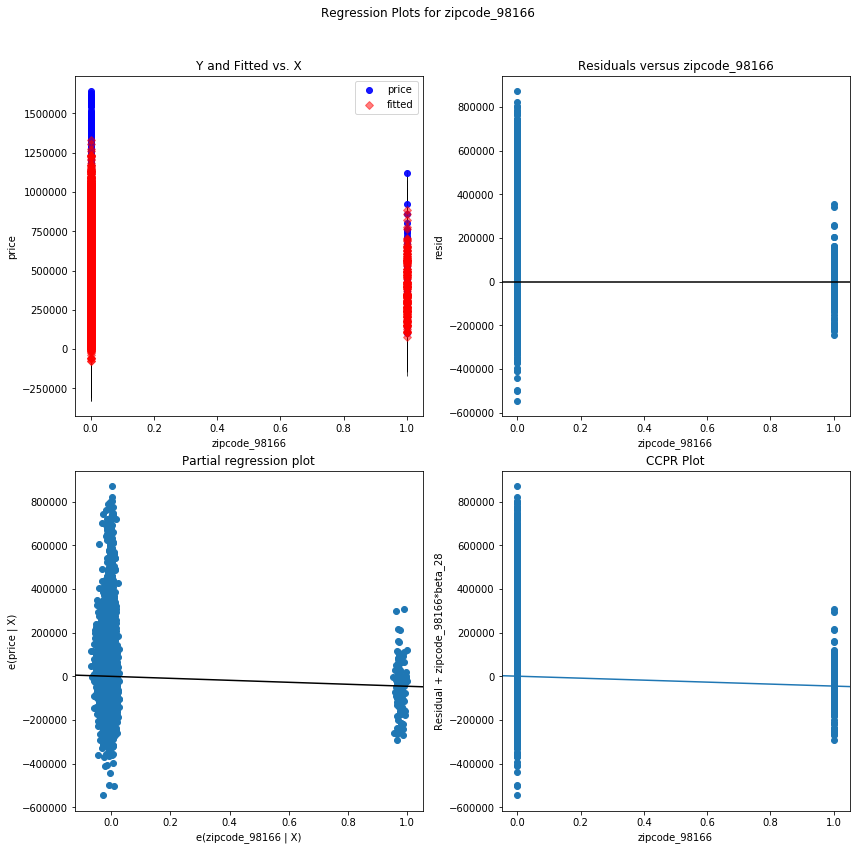

zipcode_98168 - Plotted


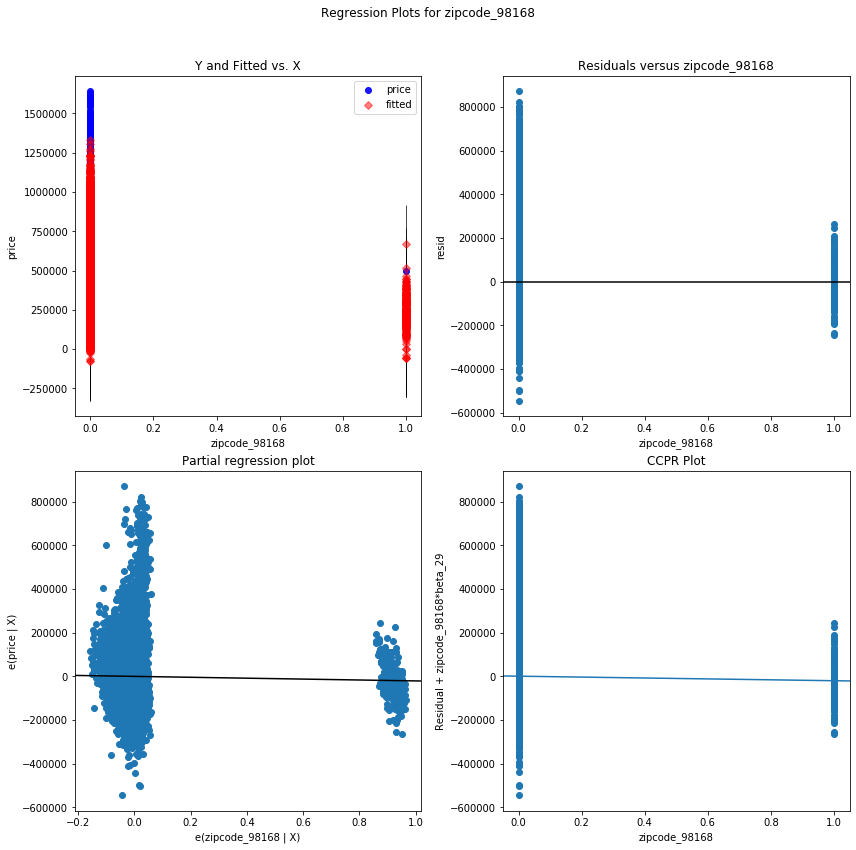

zipcode_98178 - Plotted


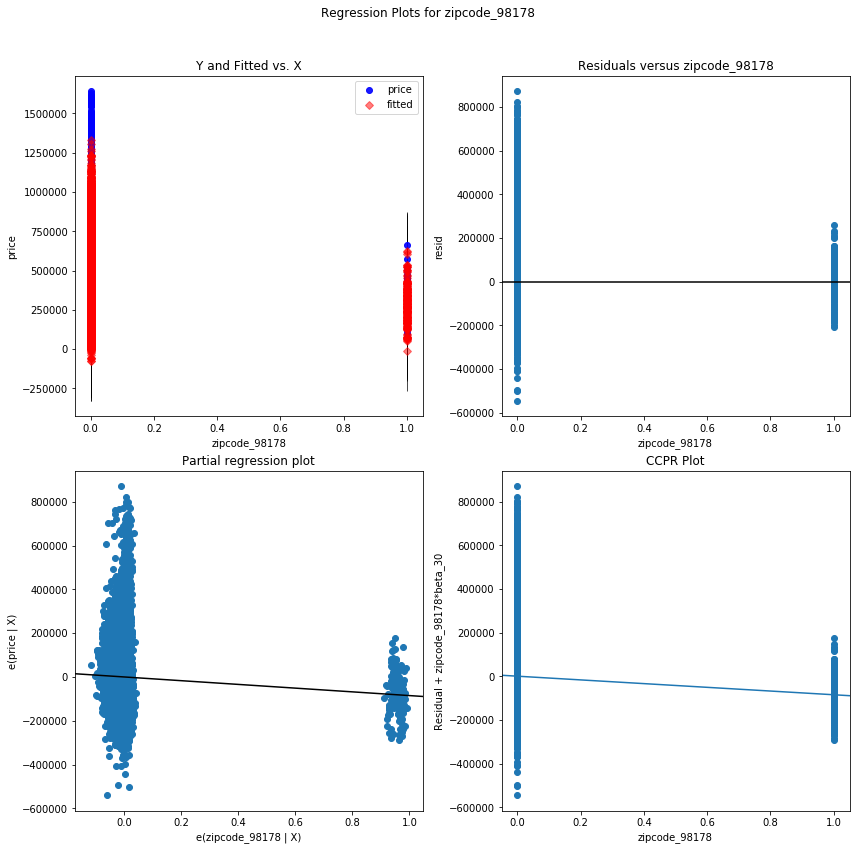

zipcode_98198 - Plotted


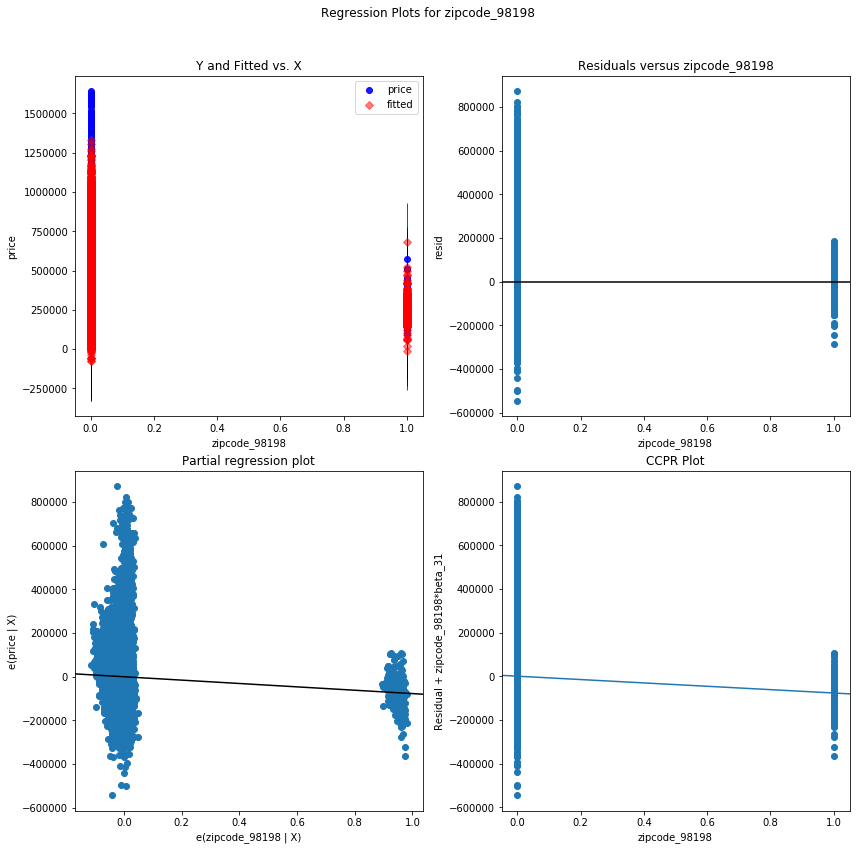

In [128]:
results_multi_bm_vif, dfs_coeffs_multi_bm_vif, summaries_multi_bm_vif, models_multi_bm_vif, X_train_models_multi_bm_vif, X_test_models_multi_bm_vif, y_train_models_multi_bm_vif, y_test_models_multi_bm_vif, columns_models_multi_bm_vif  = run_model(logstd6_out_mul_vif.drop(columns_to_drop, axis=1), target_pro_noout, 'multilinear_6cat_noout_mul_vif-log-std', 10, plots=True )

In [127]:
summaries_multi_bm_vif

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.696
Model:                            OLS   Adj. R-squared:                  0.695
Method:                 Least Squares   F-statistic:                     1105.
Date:                Tue, 23 Jun 2020   Prob (F-statistic):               0.00
Time:                        11:32:08   Log-Likelihood:            -1.9799e+05
No. Observations:               15034   AIC:                         3.961e+05
Df Residuals:                   15002   BIC:                         3.963e+05
Df Model:                          31                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const             -2.249e+06   5.05e+04    -44.563      0.000   -2.35e+06   -2.15e+06
floors             1.233e+04   1348.954      9.140      0.000    9685.318     1.5e+04
condition          1.104e+04   1168.433      9.444      0.000    8744.753    1.33e+04
grade              1.062e+05   1617.250     65.688      0.000    1.03e+05    1.09e+05
yr_built          -6.459e+04   1549.366    -41.689      0.000   -6.76e+04   -6.16e+04
log-bedrooms       3.784e+04   4611.537      8.207      0.000    2.88e+04    4.69e+04
log-bathrooms      7.461e+04   4395.526     16.973      0.000     6.6e+04    8.32e+04
log-sqft_living15  6.992e+04   4966.018     14.081      0.000    6.02e+04    7.97e+04
log-MHI            1.827e+05   3809.766     47.947      0.000    1.75e+05     1.9e+05
view_2.0           7.048e+04   5503.876     12.805      0.000    5.97e+04    8.13e+04
zipcode_98002     -4.125e+04   1.07e+04     -3.845      0.000   -6.23e+04   -2.02e+04
zipcode_98003     -1.009e+05   8746.364    -11.535      0.000   -1.18e+05   -8.37e+04
zipcode_98005       1.27e+05   1.17e+04     10.901      0.000    1.04e+05     1.5e+05
zipcode_98007      7.738e+04   1.25e+04      6.191      0.000    5.29e+04    1.02e+05
zipcode_98010     -4.745e+04    1.7e+04     -2.785      0.005   -8.08e+04   -1.41e+04
zipcode_98022     -7.991e+04   1.15e+04     -6.919      0.000   -1.03e+05   -5.73e+04
zipcode_98023     -1.523e+05   6613.106    -23.023      0.000   -1.65e+05   -1.39e+05
zipcode_98030     -7.581e+04   9115.998     -8.316      0.000   -9.37e+04   -5.79e+04
zipcode_98031     -1.172e+05   8989.520    -13.032      0.000   -1.35e+05   -9.95e+04
zipcode_98032     -1.043e+05   1.37e+04     -7.630      0.000   -1.31e+05   -7.75e+04
zipcode_98040      1.998e+05   1.07e+04     18.719      0.000    1.79e+05    2.21e+05
zipcode_98055     -7.034e+04   9104.572     -7.726      0.000   -8.82e+04   -5.25e+04
zipcode_98092     -1.611e+05   8321.846    -19.363      0.000   -1.77e+05   -1.45e+05
zipcode_98102      1.144e+05   1.52e+04      7.501      0.000    8.45e+04    1.44e+05
zipcode_98109      1.324e+05   1.44e+04      9.192      0.000    1.04e+05    1.61e+05
zipcode_98112      1.326e+05   1.14e+04     11.619      0.000     1.1e+05    1.55e+05
zipcode_98119      1.038e+05   1.18e+04      8.794      0.000    8.07e+04    1.27e+05
zipcode_98148     -7.326e+04   2.02e+04     -3.632      0.000   -1.13e+05   -3.37e+04
zipcode_98166     -4.536e+04      1e+04     -4.529      0.000    -6.5e+04   -2.57e+04
zipcode_98168     -2.075e+04   8981.888     -2.310      0.021   -3.84e+04   -3142.220
zipcode_98178     -8.507e+04   9541.182     -8.916      0.000   -1.04e+05   -6.64e+04
zipcode_98198     -7.705e+04   9483.625     -8.124      0.000   -9.56e+04   -5.85e+04
=========================================================================

In [219]:
dfs_coeffs_multi_bm_vif.sort_values(by='multilinear_6cat_noout_mul_vif-log-std', ascending=False).head(50)

,multilinear_6cat_noout_mul_vif-log-std
zipcode_98040,1.998149e+05
log-MHI,1.826657e+05
zipcode_98112,1.326271e+05
zipcode_98109,1.324369e+05
zipcode_98005,1.270291e+05
zipcode_98102,1.143533e+05
grade,1.062334e+05
zipcode_98119,1.038198e+05
zipcode_98007,7.738303e+04
log-bathrooms,7.460548e+04


<Figure size 1368x648 with 0 Axes>

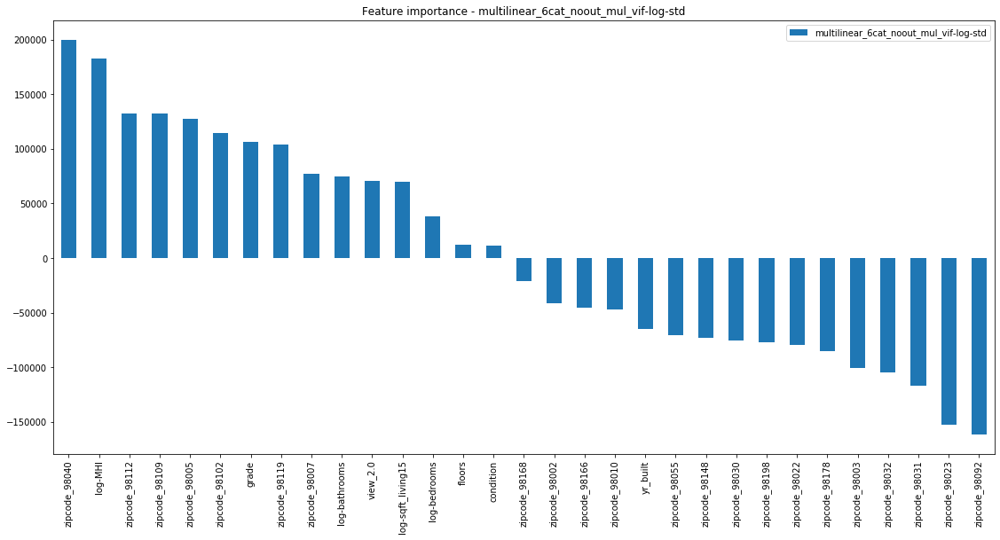

<Figure size 1368x648 with 0 Axes>

In [210]:
top_features_bm_multi = dfs_coeffs_multi_bm_vif.sort_values(by='multilinear_6cat_noout_mul_vif-log-std', ascending=False).head(50)
top_features_bm_multi.drop(labels='const').plot.bar(figsize=(19,9))
plt.title('Feature importance - multilinear_6cat_noout_mul_vif-log-std');

plt.figure(figsize=(19,9))


In [62]:
abs(dfs_coeffs_multi_bm_vif['multilinear_6cat_noout_mul_vif-log-std']).sort_values(ascending=False).head(30)

const                2.248947e+06
zipcode_98040        1.998149e+05
log-MHI              1.826657e+05
zipcode_98092        1.611350e+05
zipcode_98023        1.522545e+05
zipcode_98112        1.326271e+05
zipcode_98109        1.324369e+05
zipcode_98005        1.270291e+05
zipcode_98031        1.171502e+05
zipcode_98102        1.143533e+05
grade                1.062334e+05
zipcode_98032        1.043438e+05
zipcode_98119        1.038198e+05
zipcode_98003        1.008916e+05
zipcode_98178        8.506775e+04
zipcode_98022        7.990604e+04
zipcode_98007        7.738303e+04
zipcode_98198        7.704631e+04
zipcode_98030        7.580810e+04
log-bathrooms        7.460548e+04
zipcode_98148        7.326238e+04
view_2.0             7.047835e+04
zipcode_98055        7.033932e+04
log-sqft_living15    6.992407e+04
yr_built             6.459170e+04
zipcode_98010        4.744906e+04
zipcode_98166        4.536322e+04
zipcode_98002        4.125213e+04
log-bedrooms         3.784467e+04
zipcode_98168 

In [142]:
predictions_multi_bm_vif = models_multi_bm_vif[0].predict(X_test_models_multi_bm_vif)

In [217]:
lowers, uppers, residuals, rse = get_prediction_interval(y_test_models_multi_bm_vif, predictions_multi_bm_vif,  X_train_models_multi_bm_vif)

In [218]:
rse

63490.99262955199

In [145]:
residuals

,predicted-price,price,residuals,residuals2
0,124146.440583,302000.0,177853.559417,3.163189e+10
1,27917.469868,213950.0,186032.530132,3.460810e+10
2,549245.173627,650000.0,100754.826373,1.015154e+10
3,794836.586578,847000.0,52163.413422,2.721022e+09
4,470883.665719,445000.0,-25883.665719,6.699642e+08
...,...,...,...,...
3754,743952.721366,640000.0,-103952.721366,1.080617e+10
3755,369337.415099,235000.0,-134337.415099,1.804654e+10
3756,446850.768463,400000.0,-46850.768463,2.194995e+09
3757,633982.137617,685000.0,51017.862383,2.602822e+09


In [146]:
rse_multi = np.sqrt(residuals['residuals2'].sum() / (len(X_train) - 2))

In [147]:
rse_multi

63490.99262955199

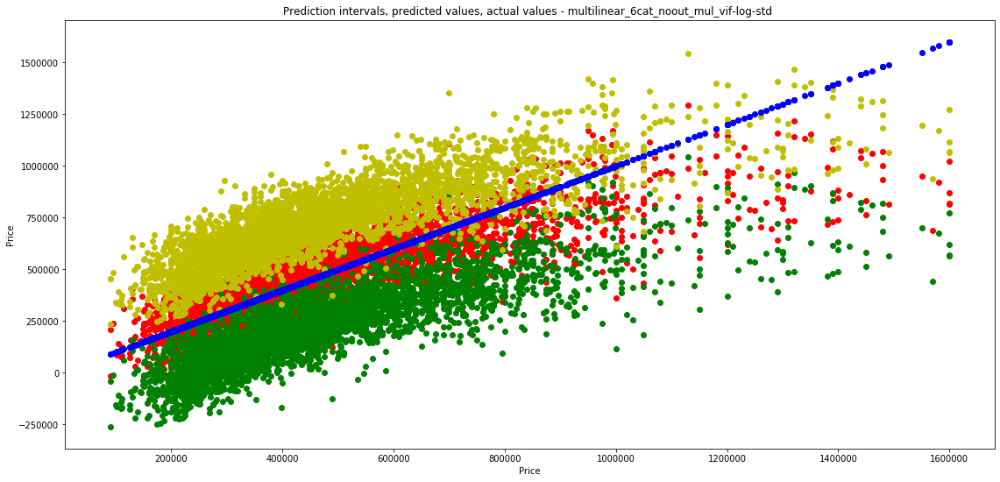

In [213]:
plt.figure(figsize=(19,9))
plt.scatter(y_test_models_multi_bm_vif, residuals['predicted-price'], color='r')
plt.scatter(y_test_models_multi_bm_vif, lowers, color='g')
plt.scatter(y_test_models_multi_bm_vif, uppers, color='y')
plt.scatter(y_test_models_multi_bm_vif, y_test_models_multi_bm_vif, color='b')
plt.title('Prediction intervals, predicted values, actual values - multilinear_6cat_noout_mul_vif-log-std ')
plt.xlabel('Price')
plt.ylabel('Price');

### Best multilinear model standardized, without VIF - removing p-values > 0.05

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/linalg/linalg.py:2093: RuntimeWarning: overflow encountered in det
  r = _umath_linalg.det(a, signature=signature)


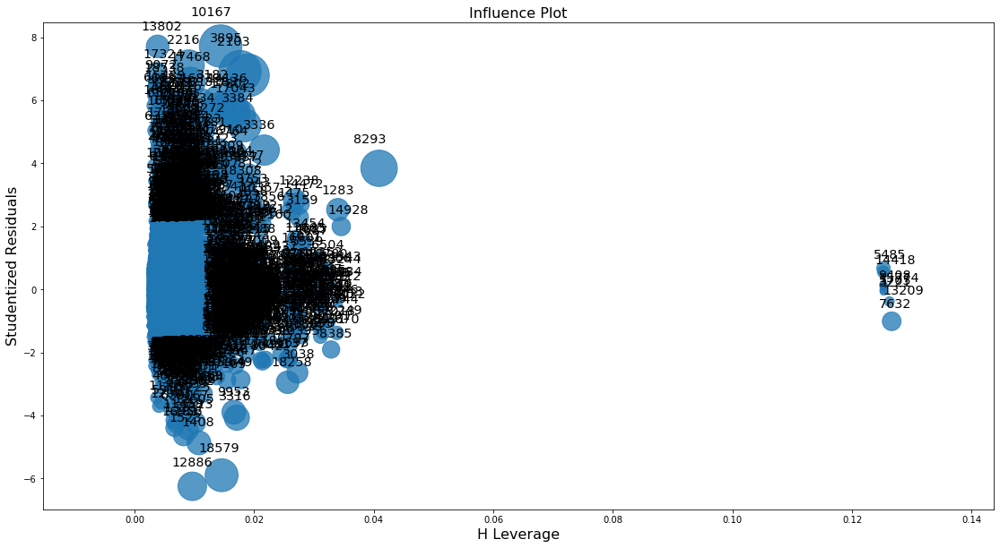

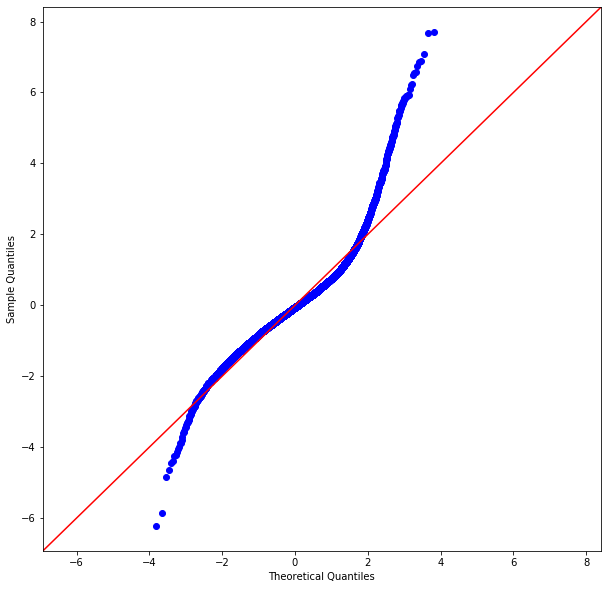

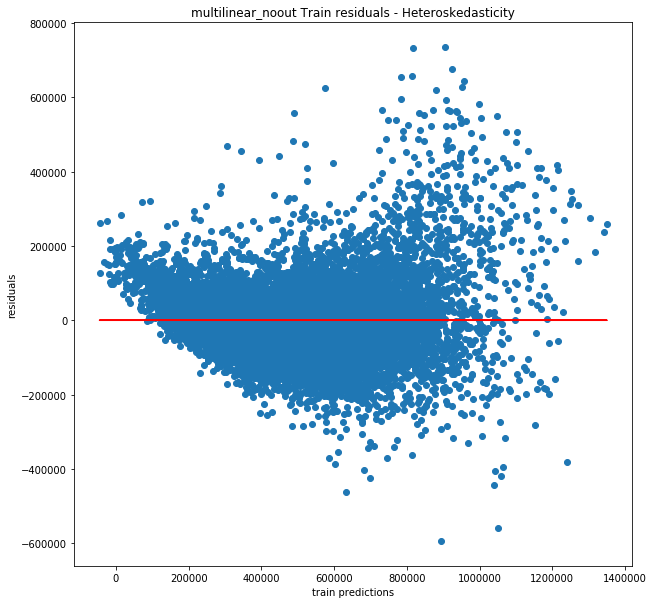

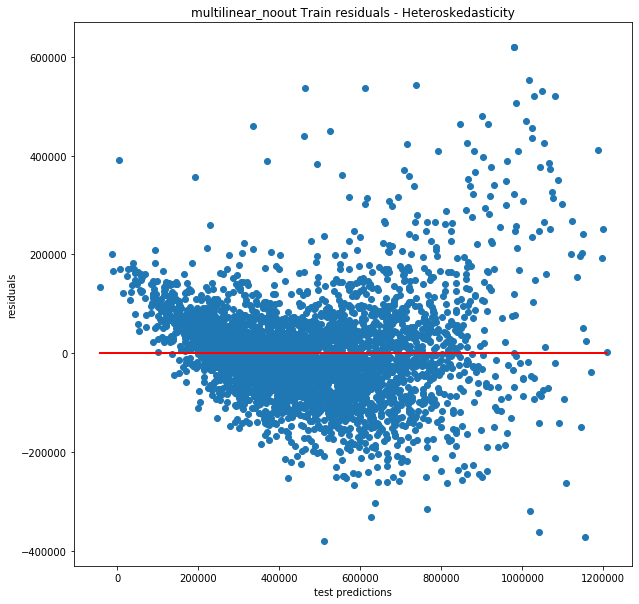

waterfront - Plotted


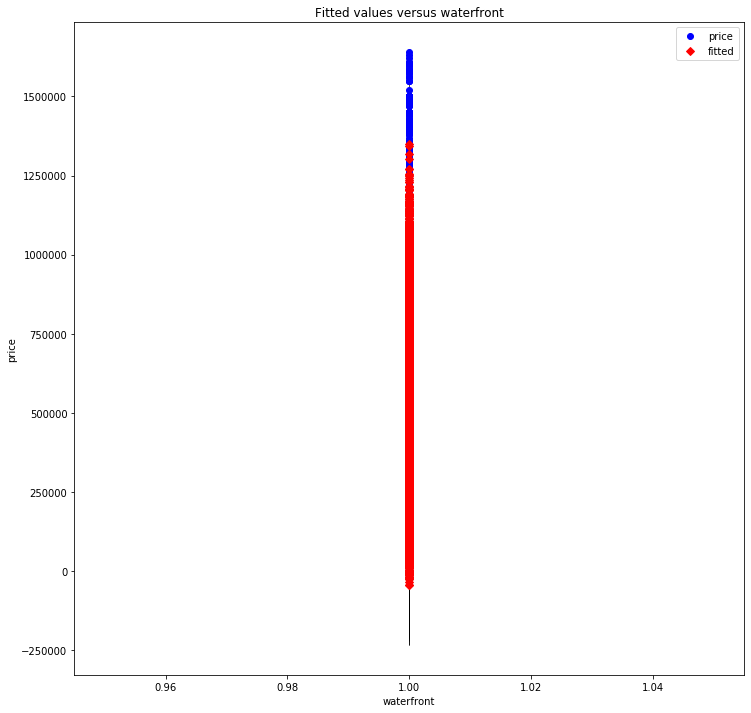

condition - Plotted


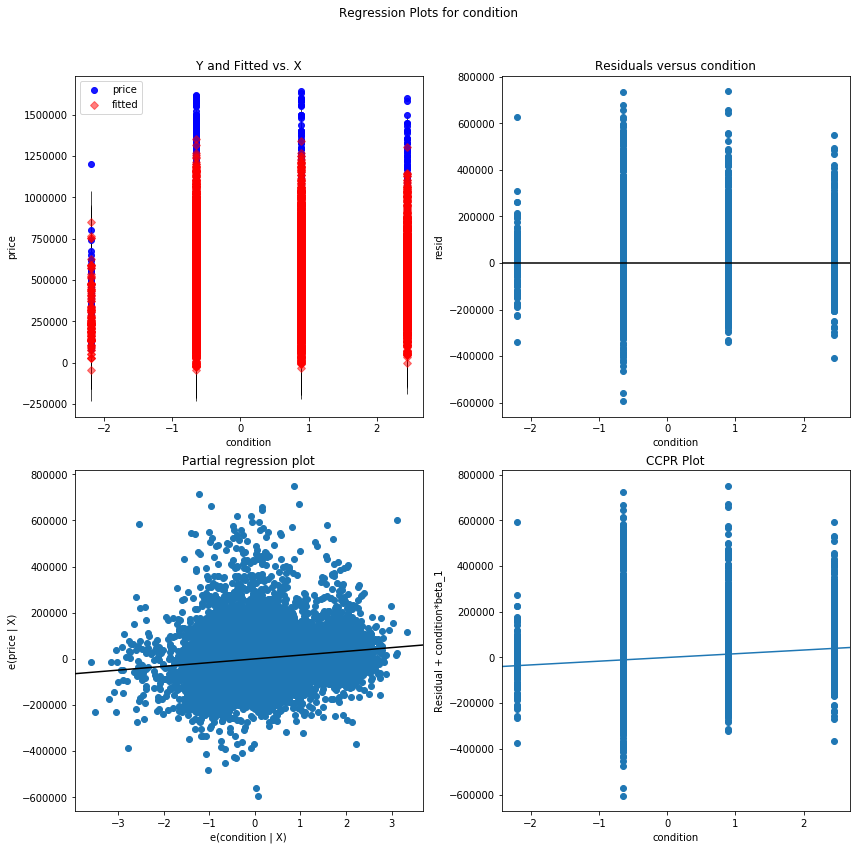

grade - Plotted


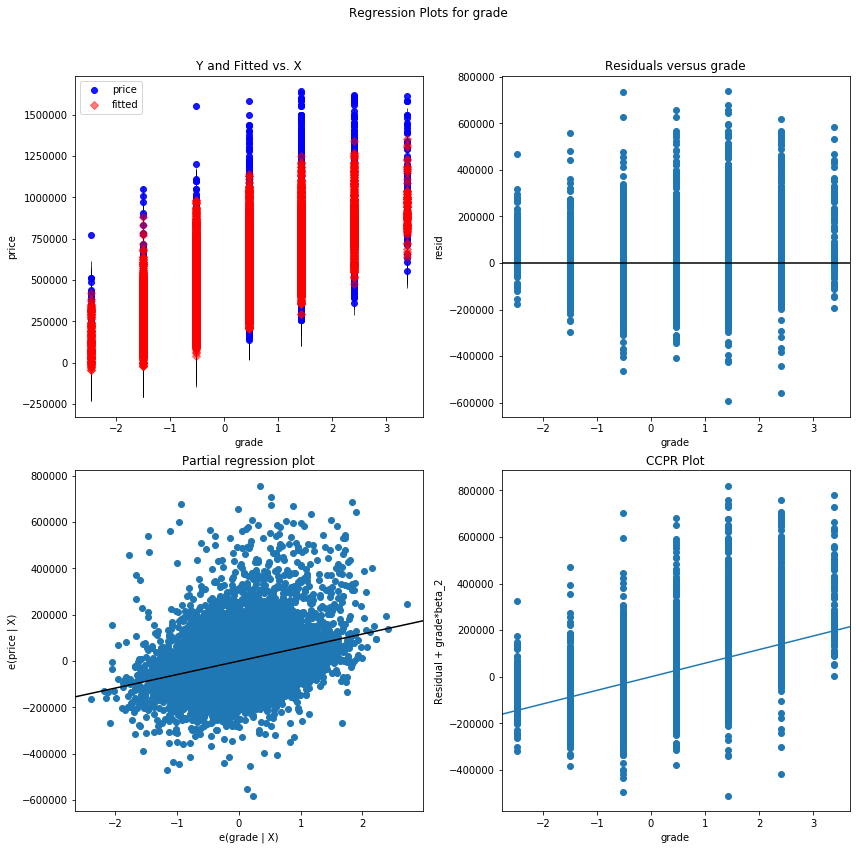

yr_built - Plotted


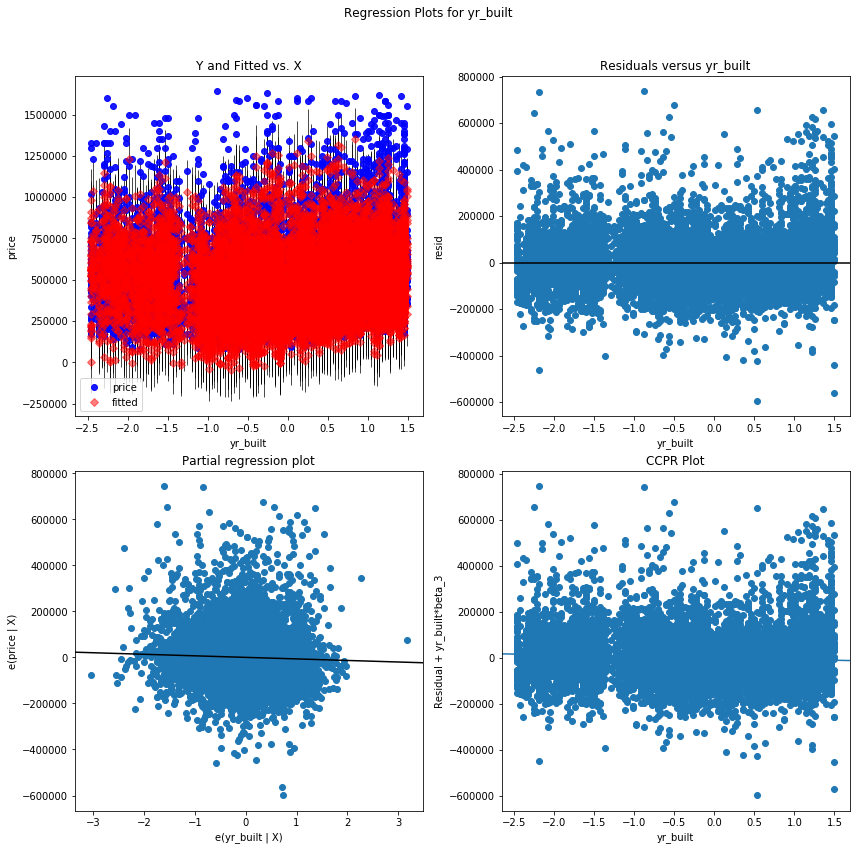

lat - Plotted


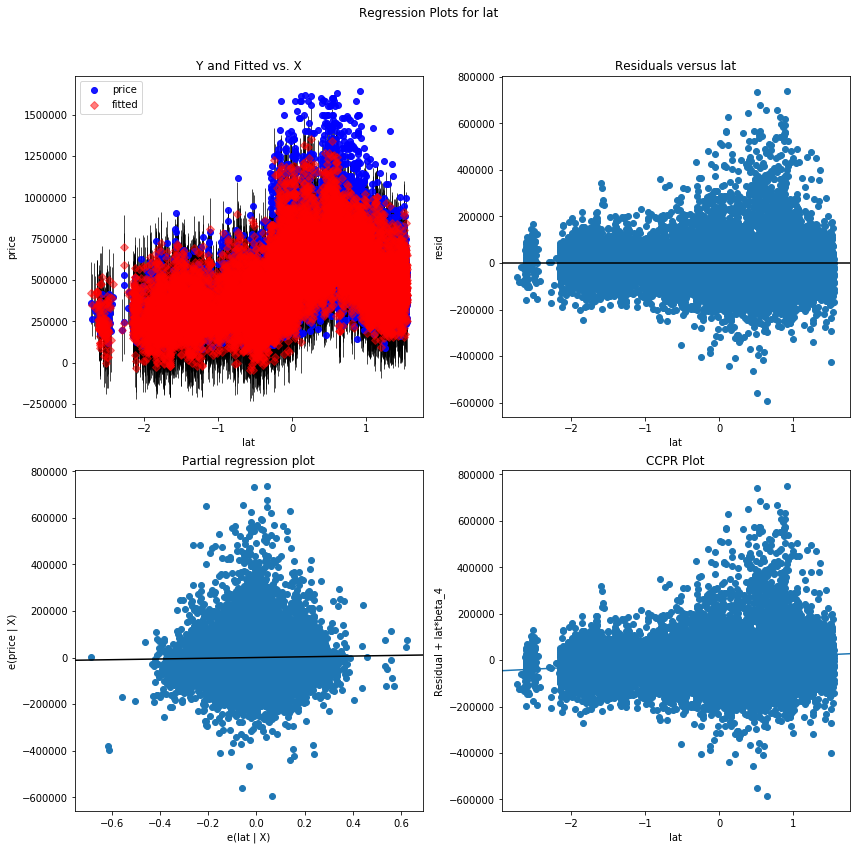

long - Plotted


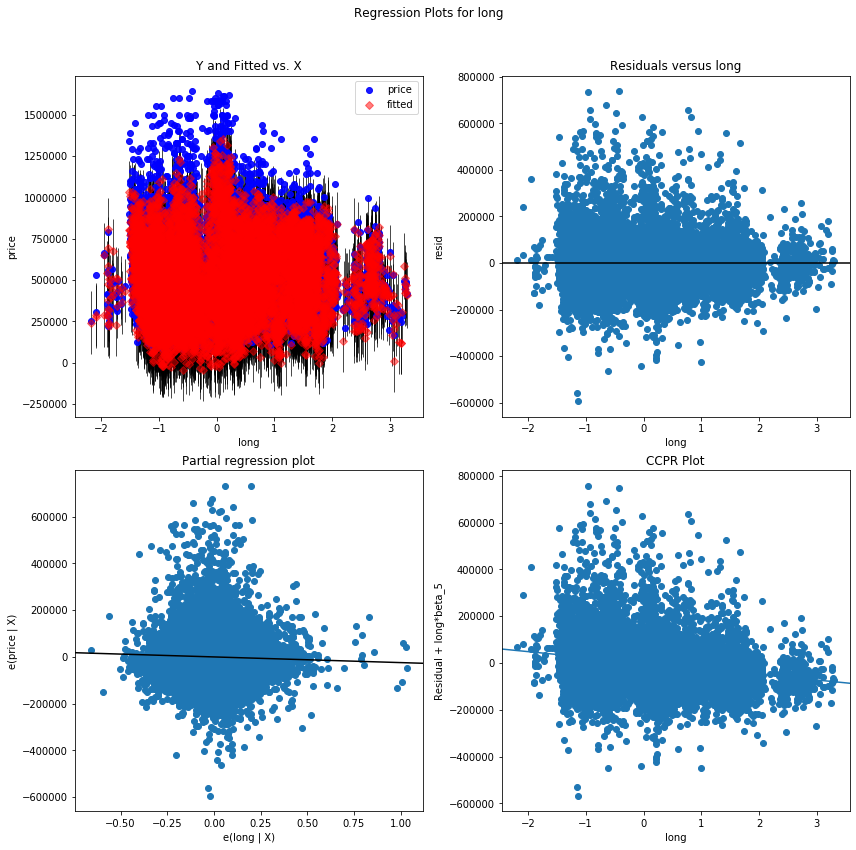

renovated - Plotted


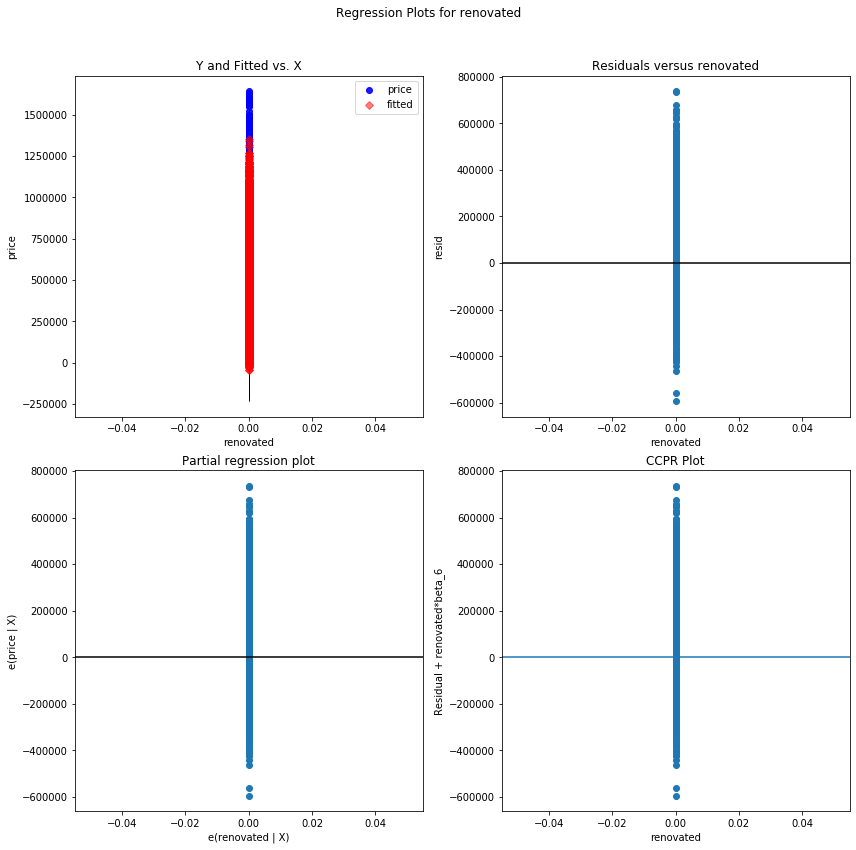

log-bathrooms - Plotted


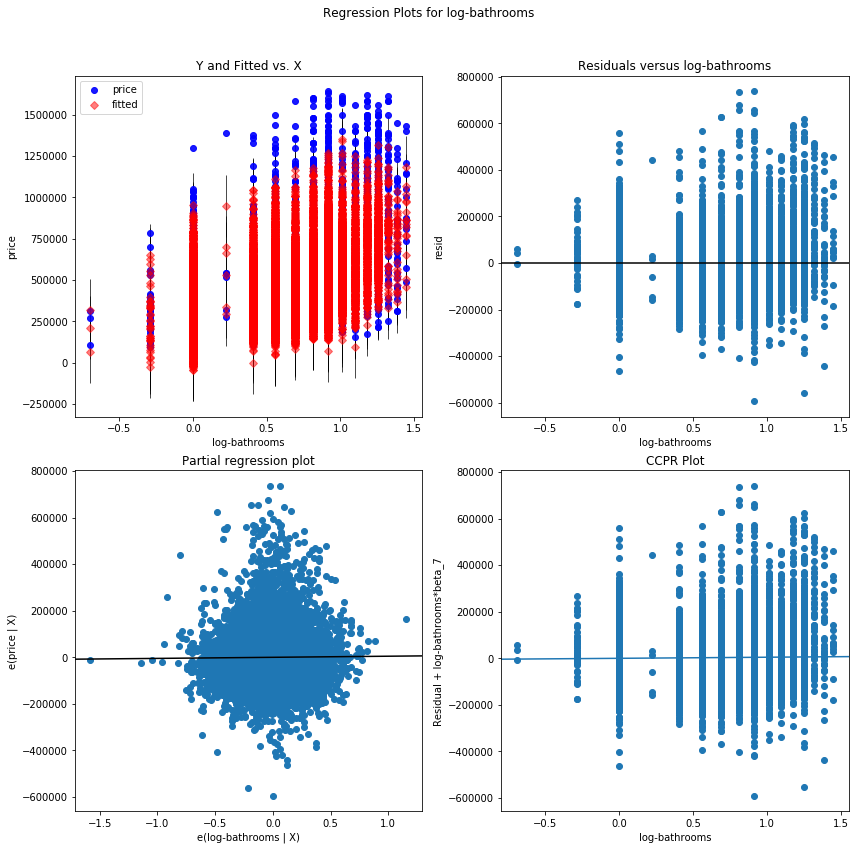

log-sqft_living - Plotted


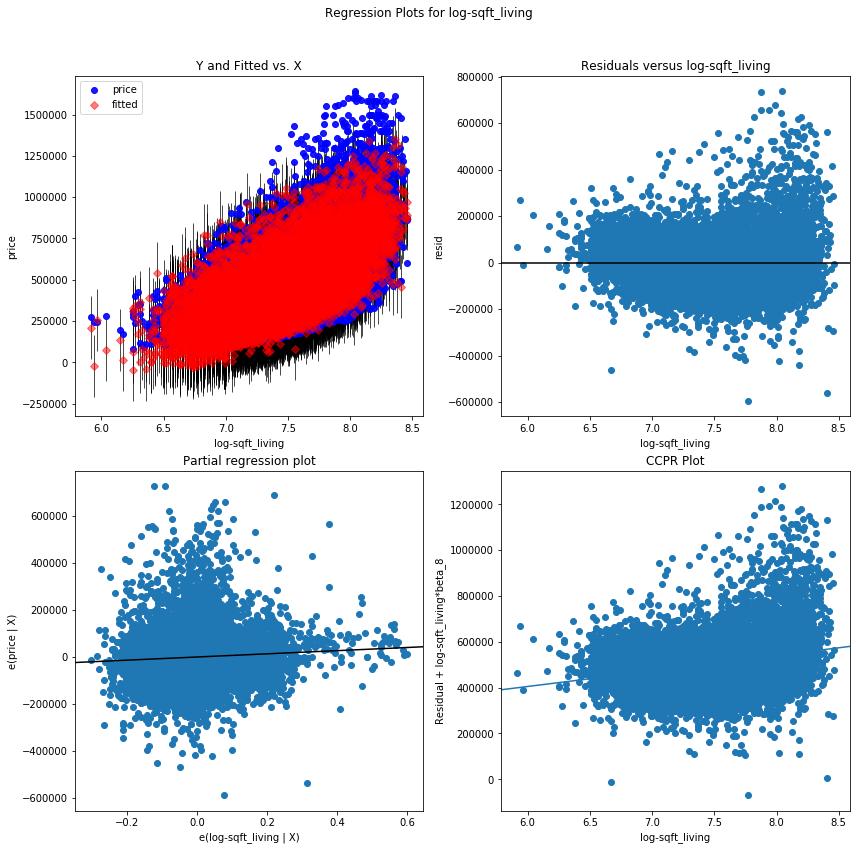

log-sqft_lot - Plotted


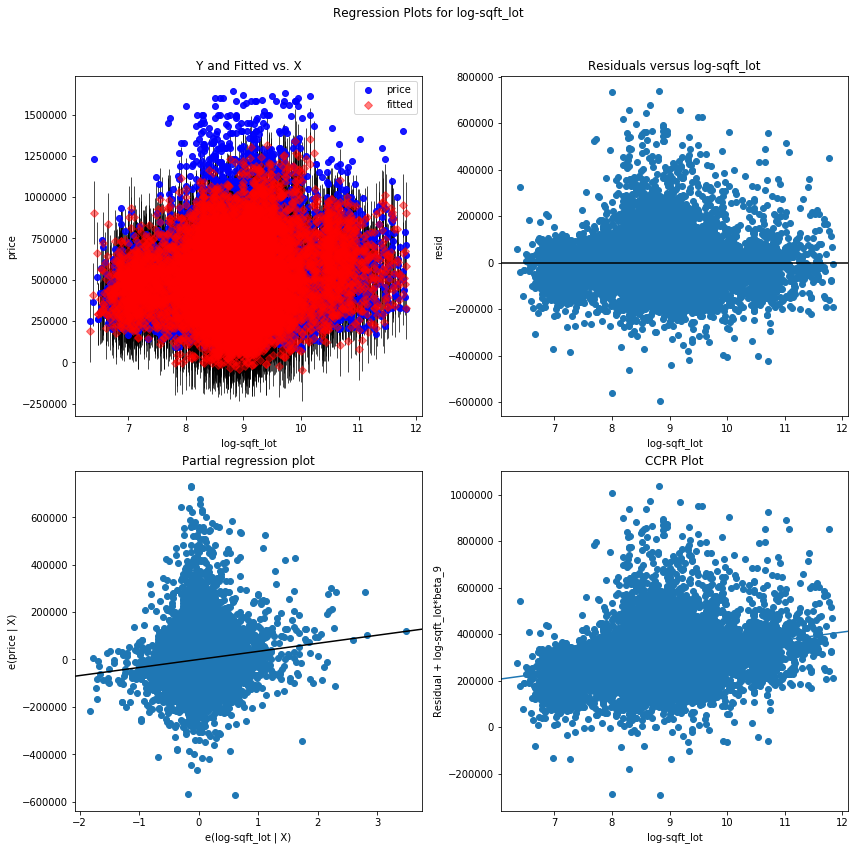

log-sqft_above - Plotted


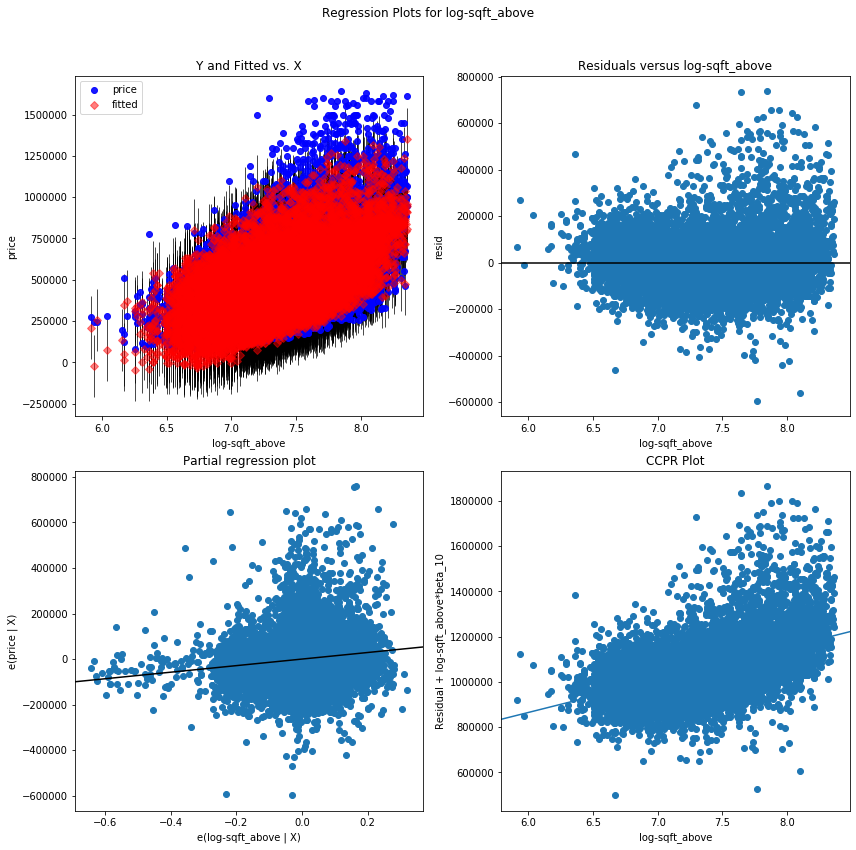

log-sqft_basement - Plotted


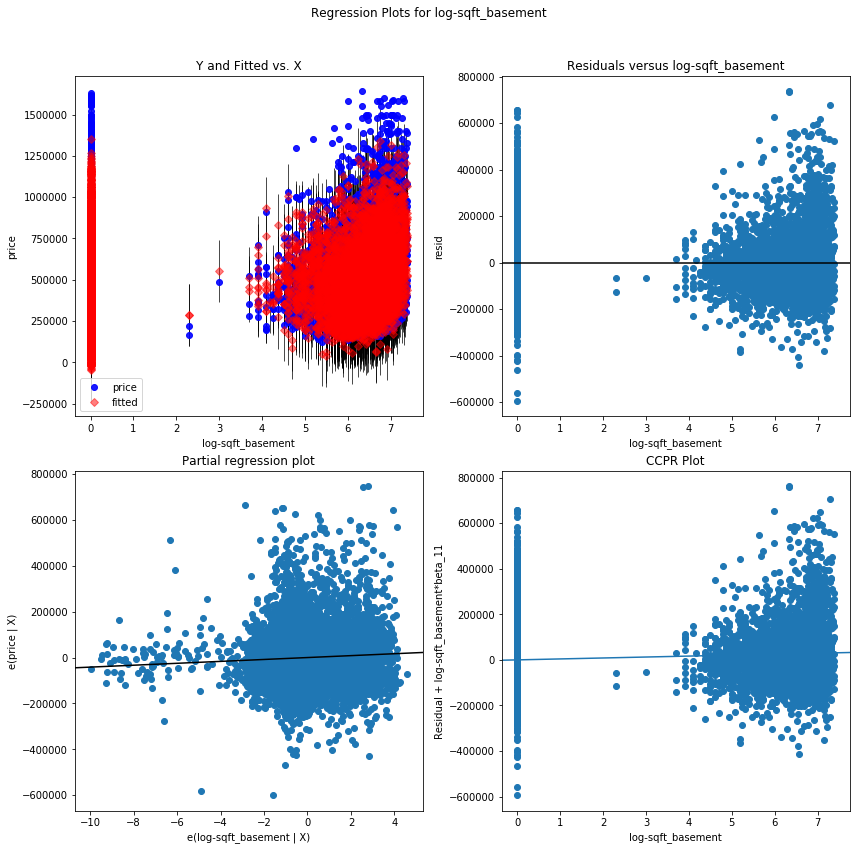

log-sqft_living15 - Plotted


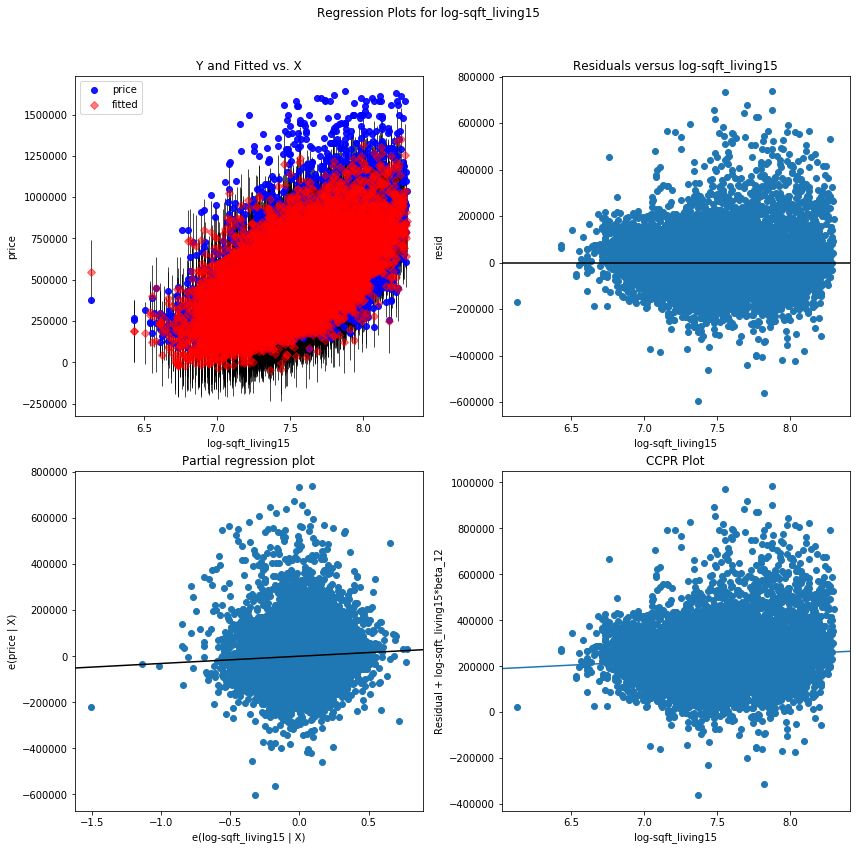

log-sqft_lot15 - Plotted


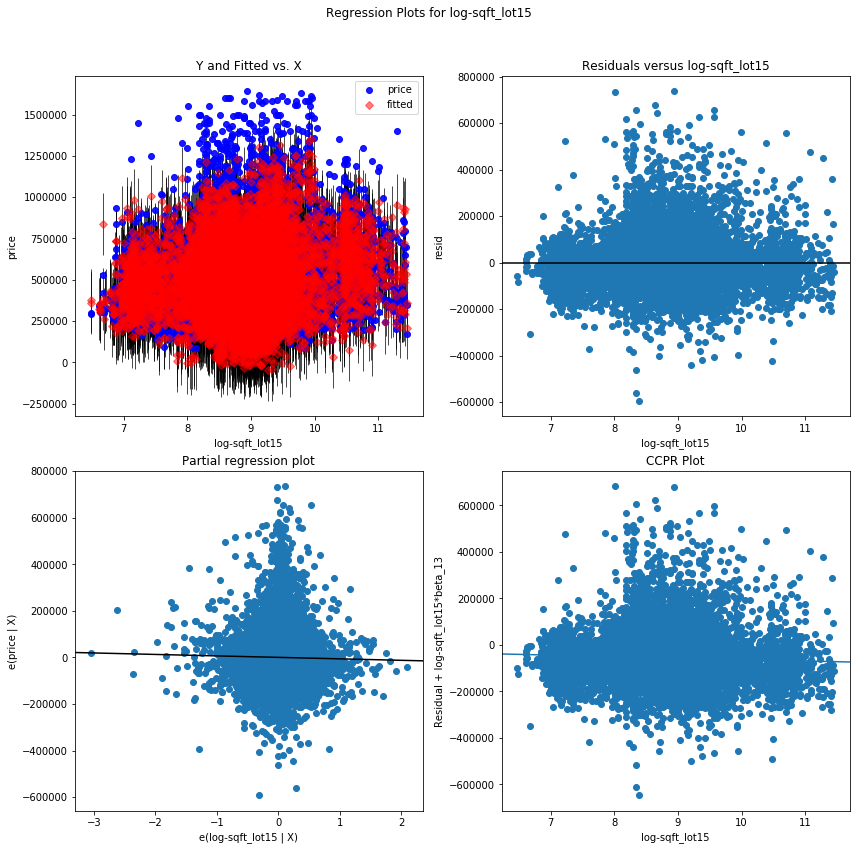

log-MHI - Plotted


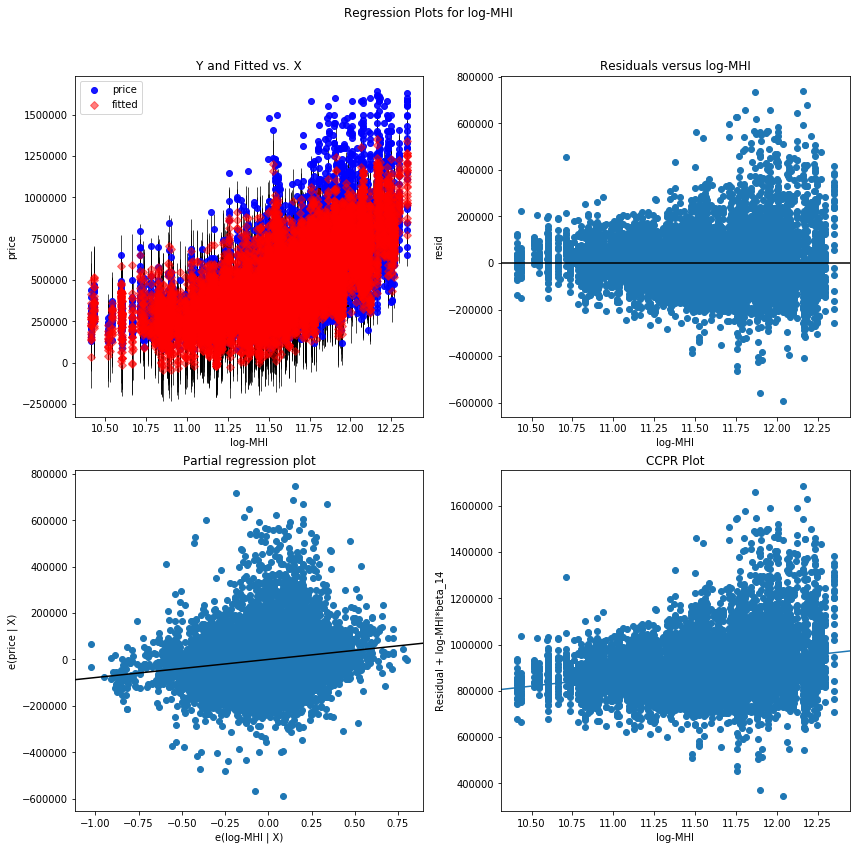

bedrooms_2.0 - Plotted


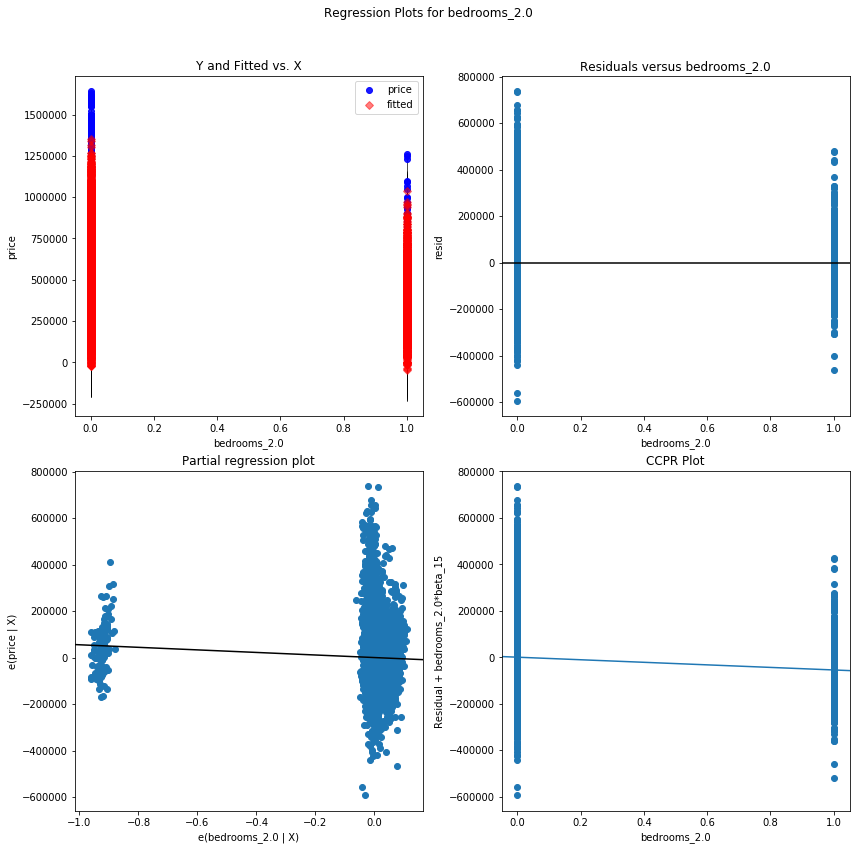

bedrooms_3.0 - Plotted


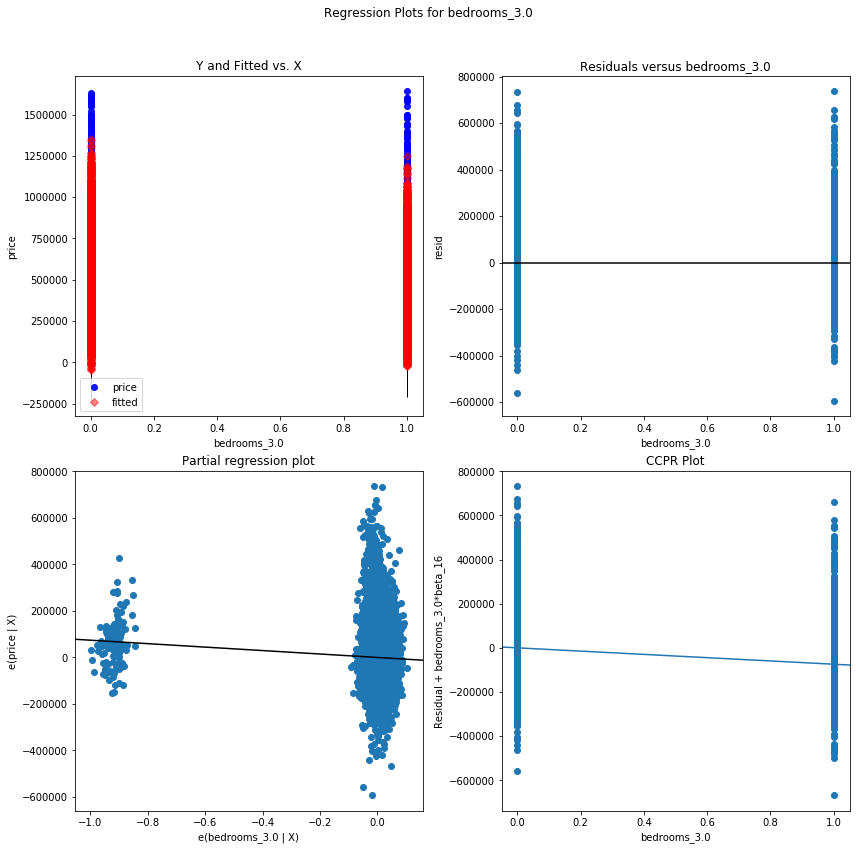

bedrooms_4.0 - Plotted


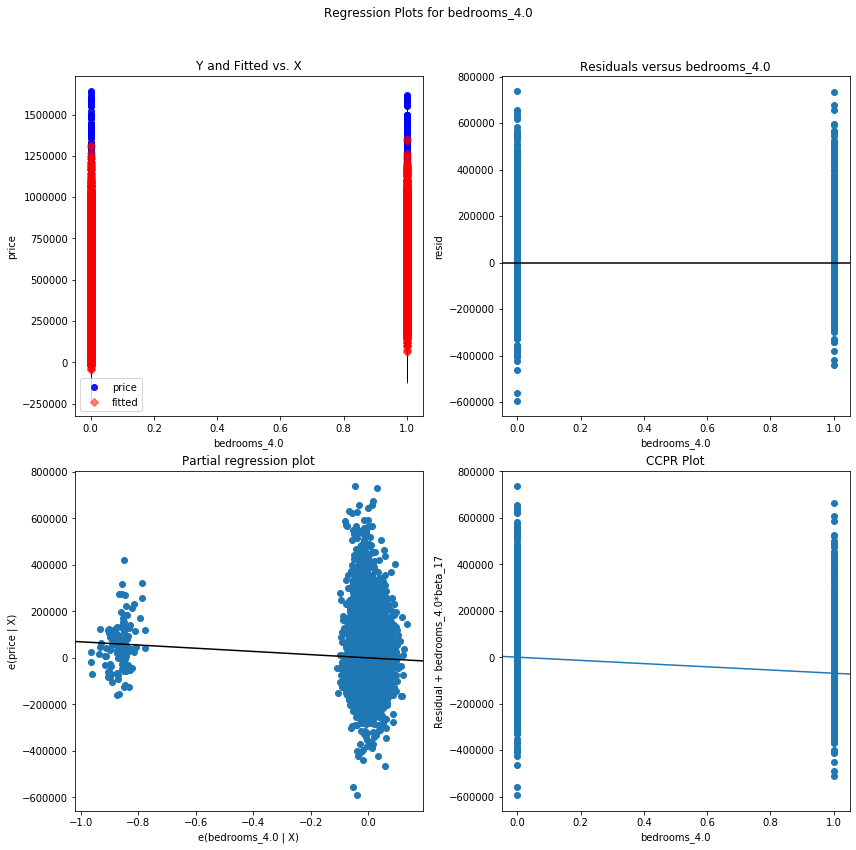

bedrooms_5.0 - Plotted


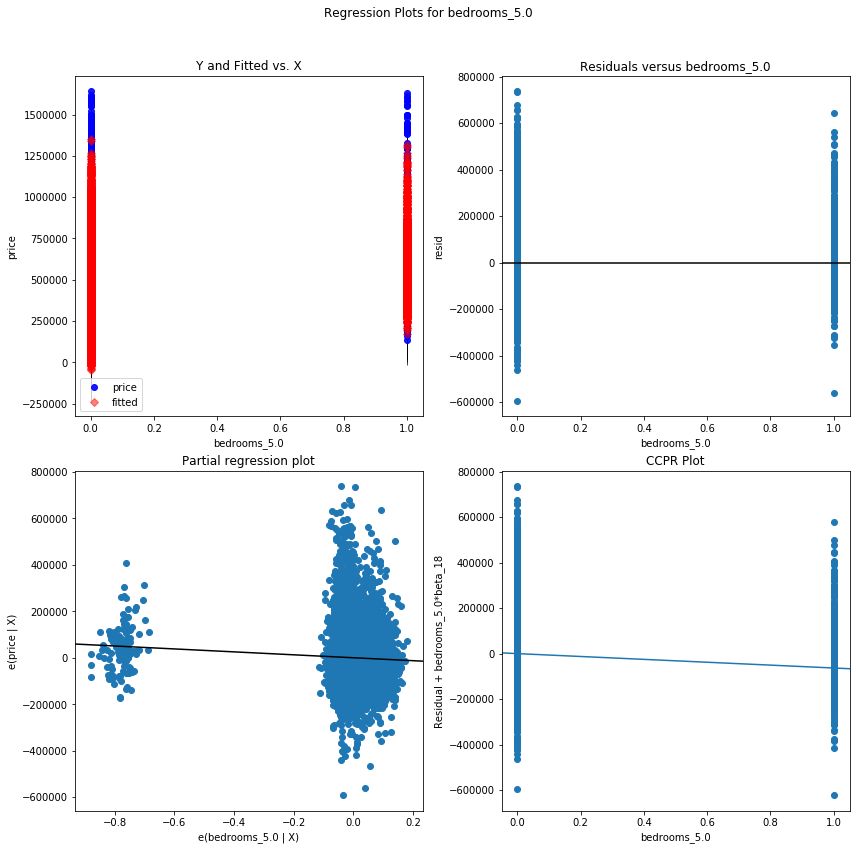

bedrooms_6.0 - Plotted


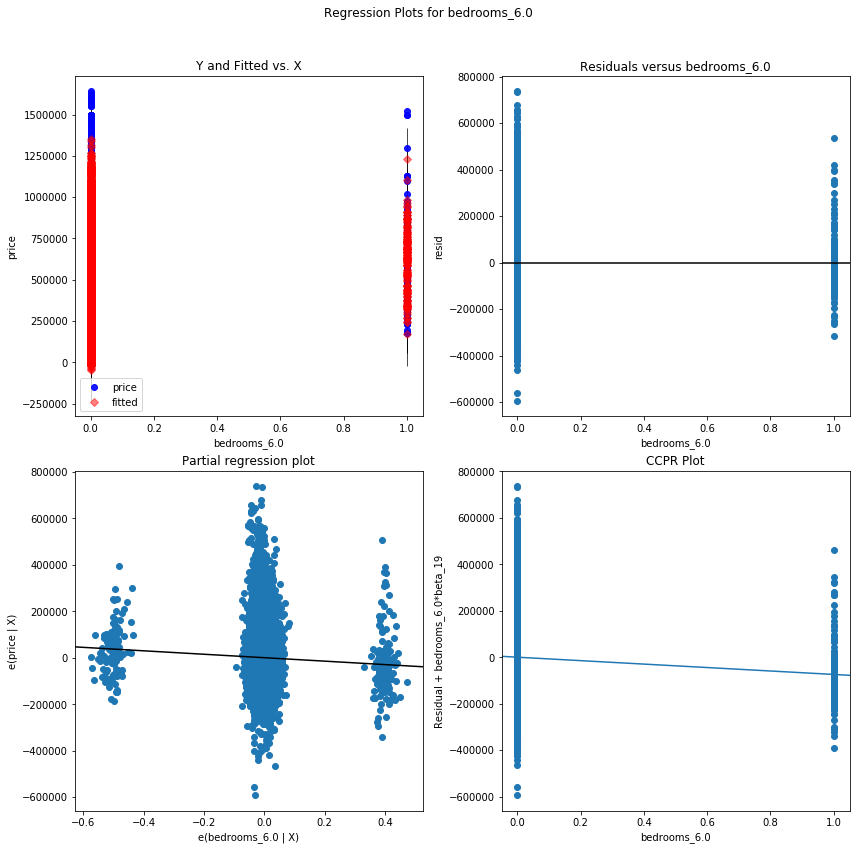

floors_1.5 - Plotted


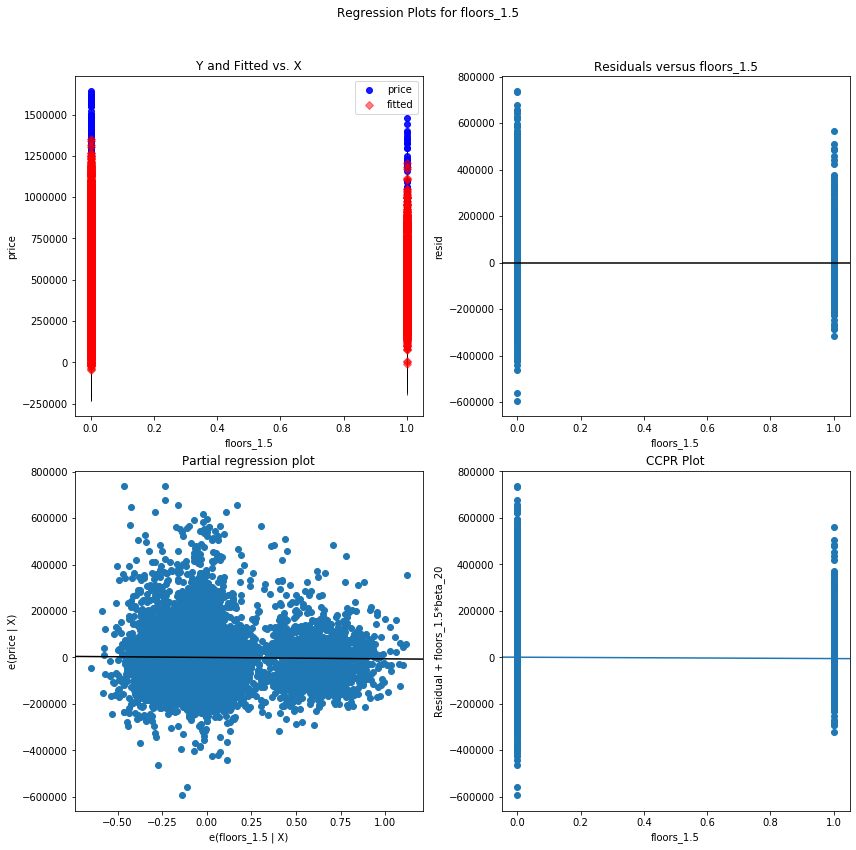

floors_2.0 - Plotted


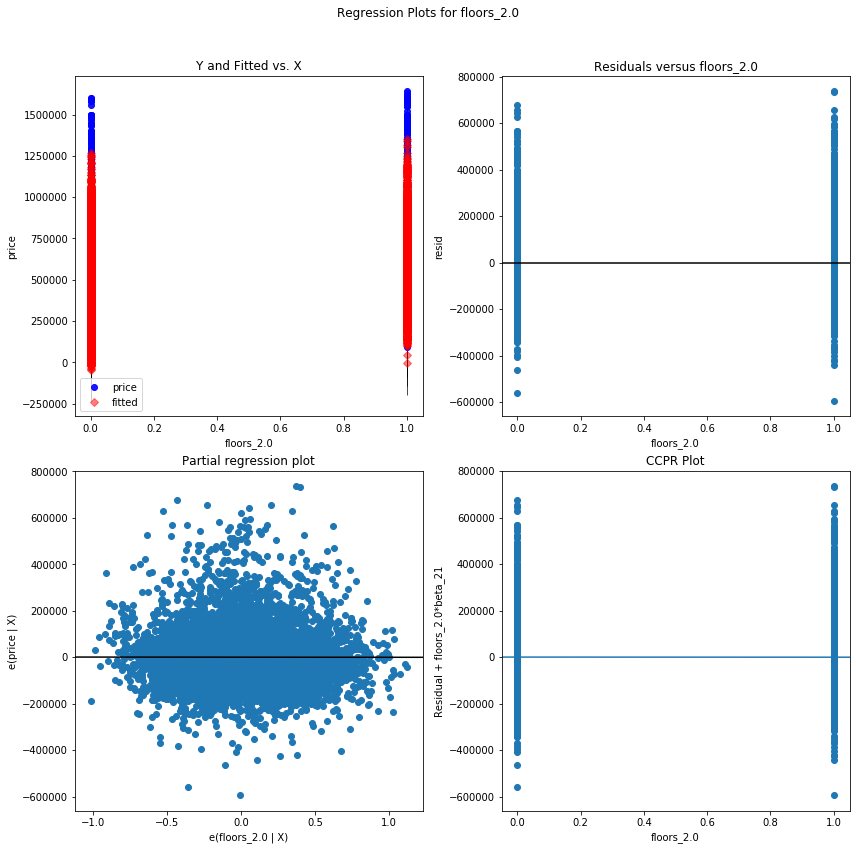

floors_2.5 - Plotted


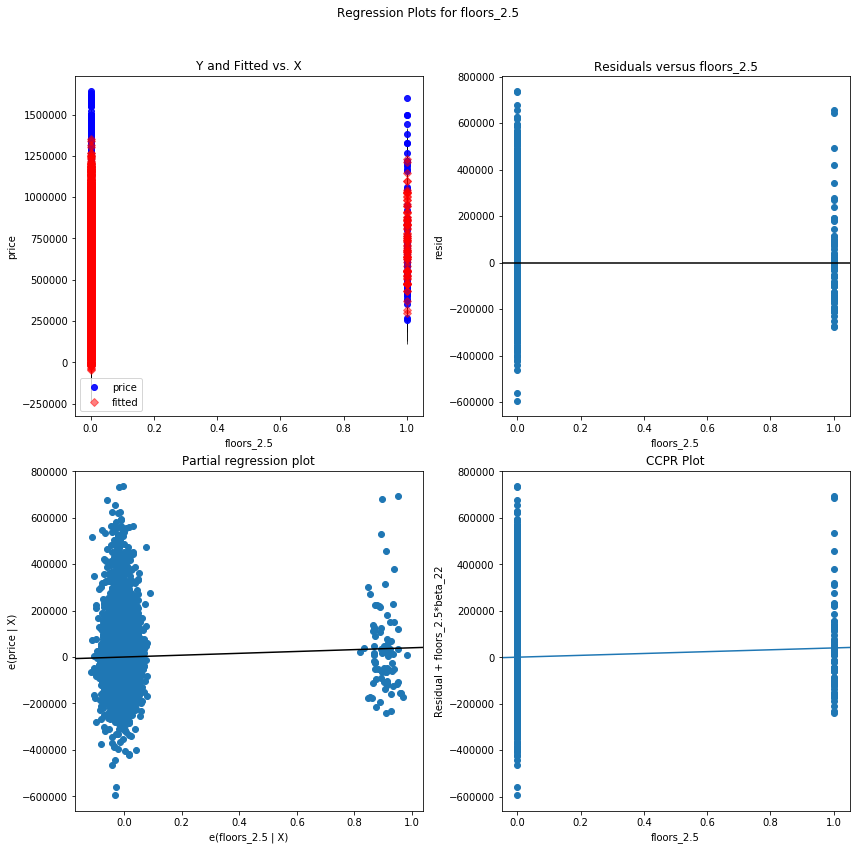

floors_3.0 - Plotted


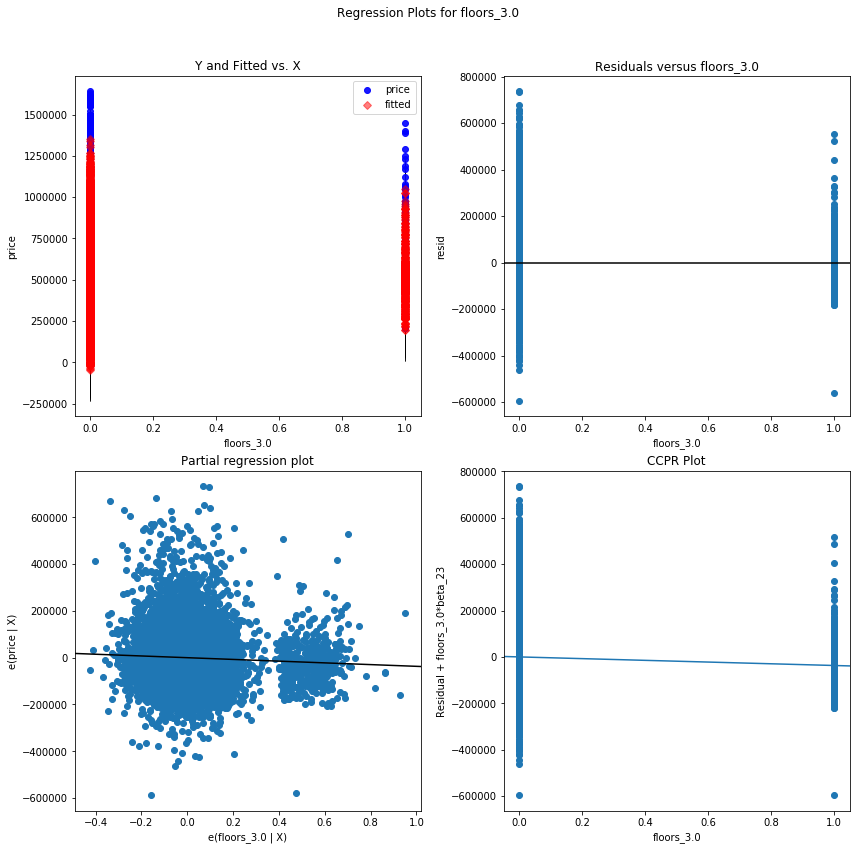

view_2.0 - Plotted


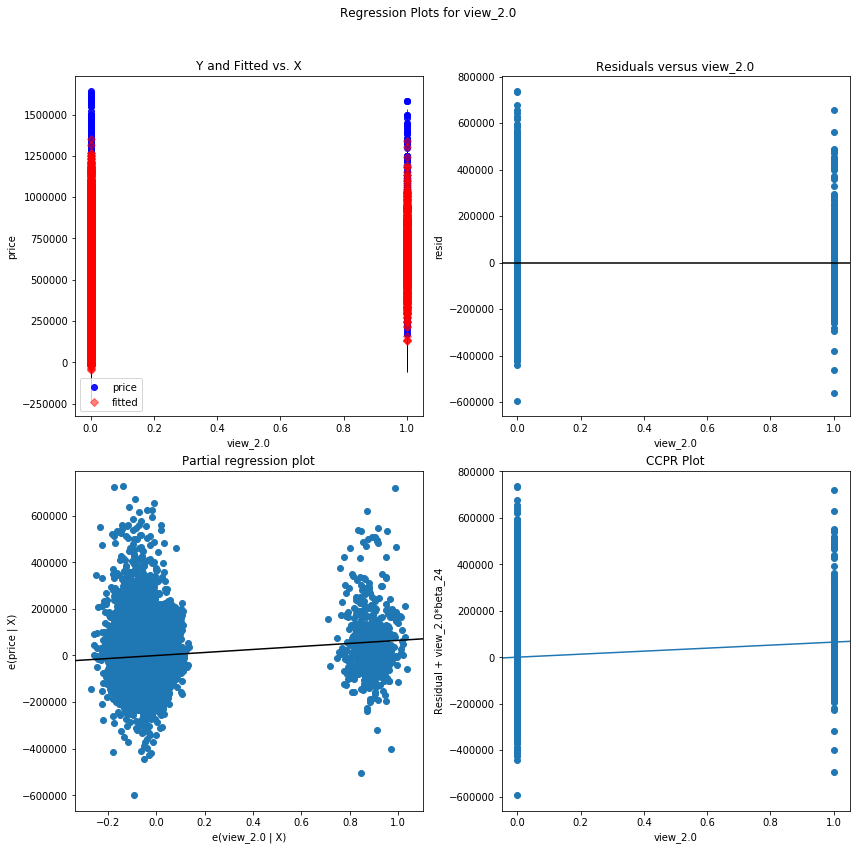

zipcode_98002 - Plotted


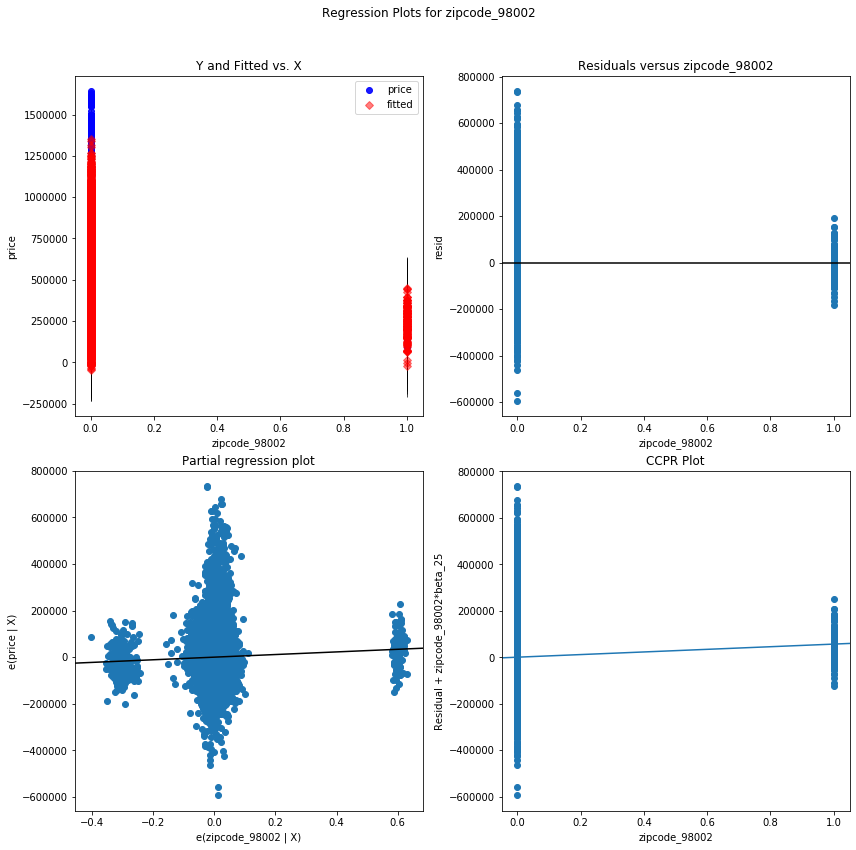

zipcode_98003 - Plotted


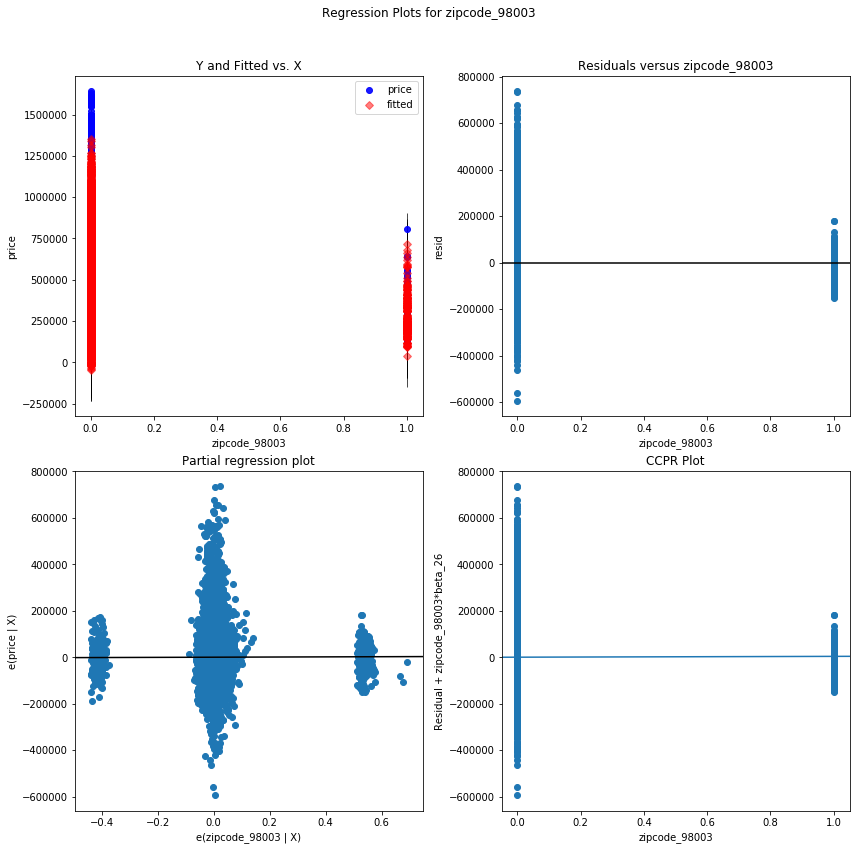

zipcode_98004 - Plotted


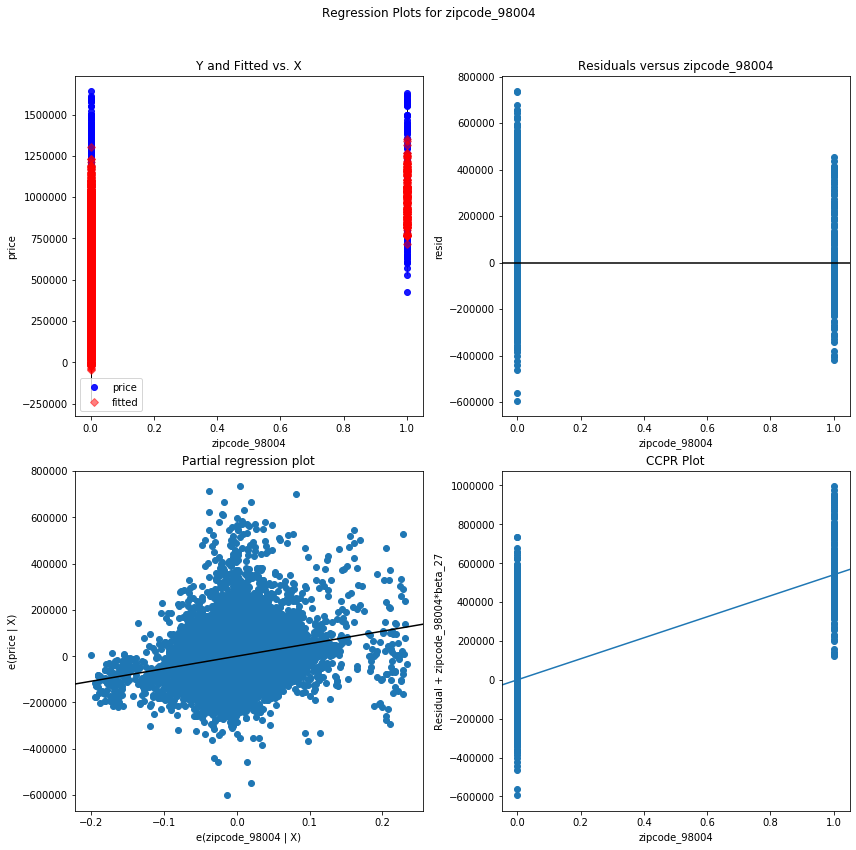

zipcode_98005 - Plotted


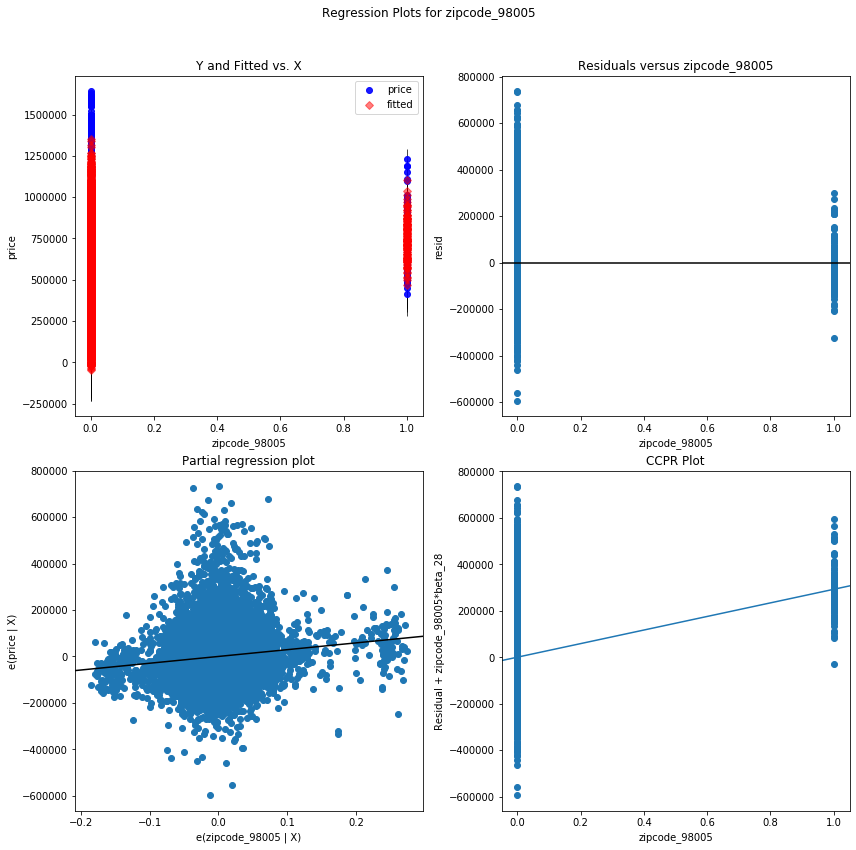

zipcode_98006 - Plotted


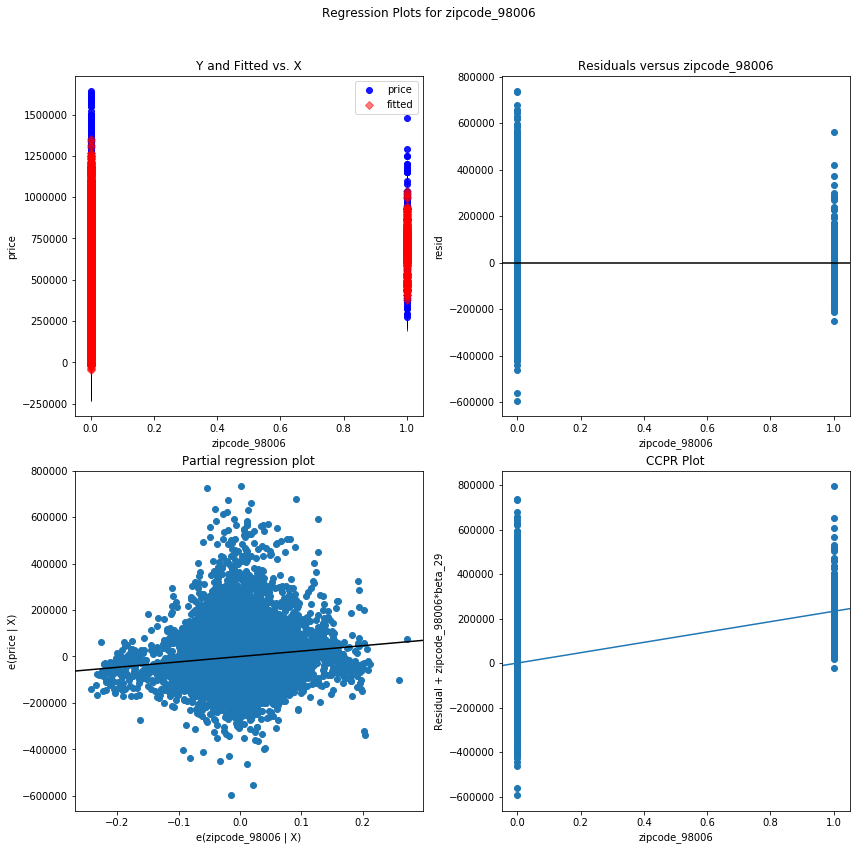

zipcode_98007 - Plotted


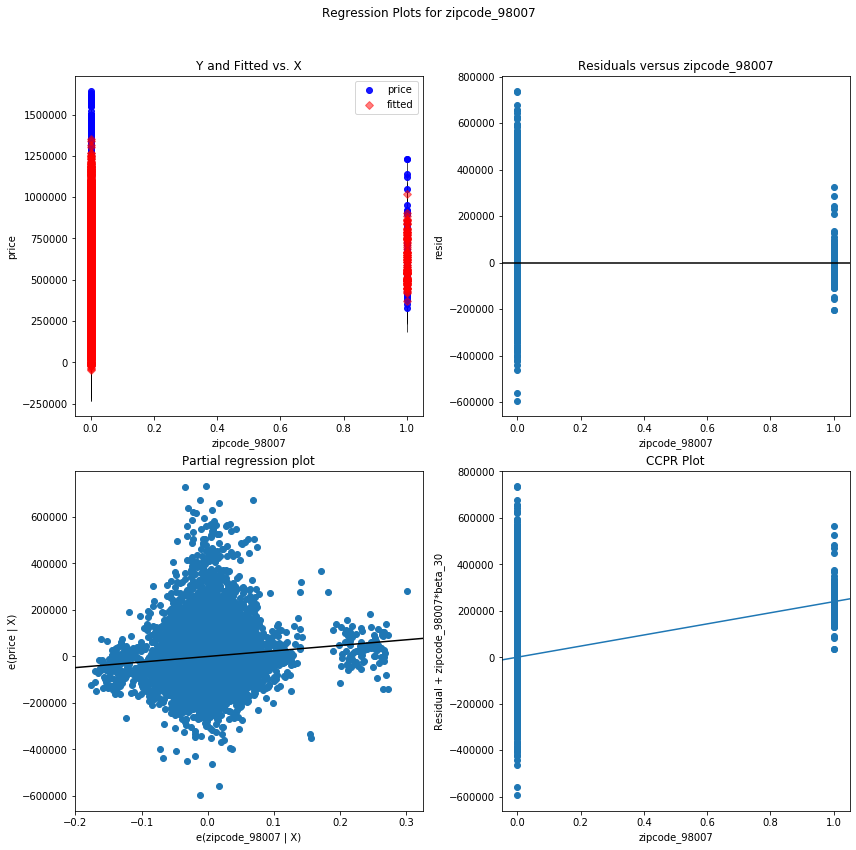

zipcode_98008 - Plotted


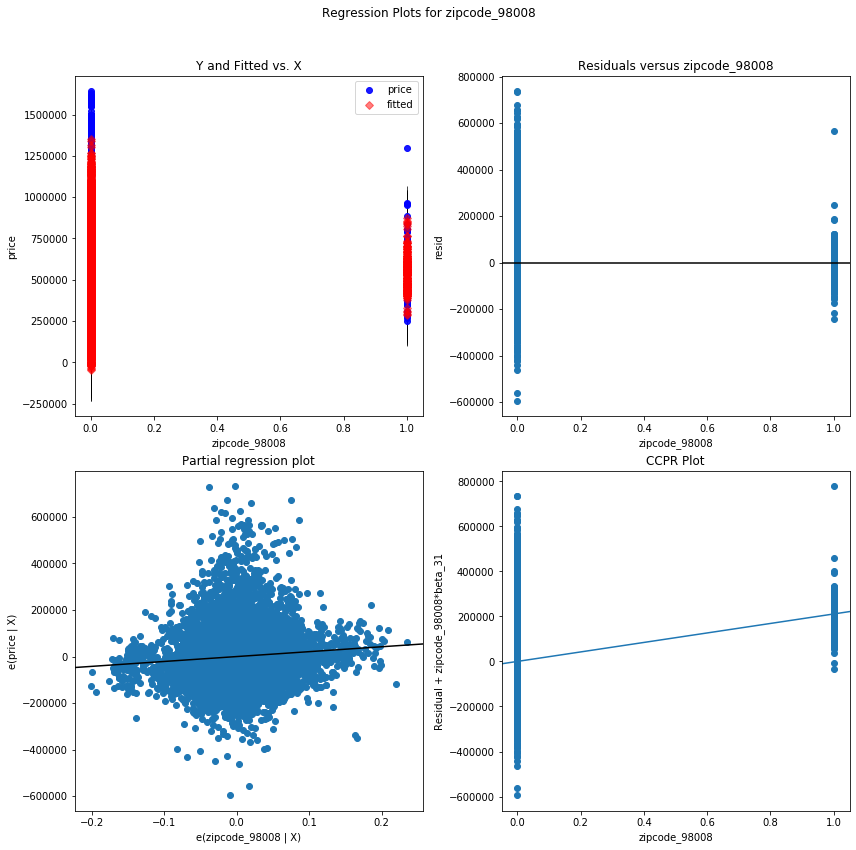

zipcode_98010 - Plotted


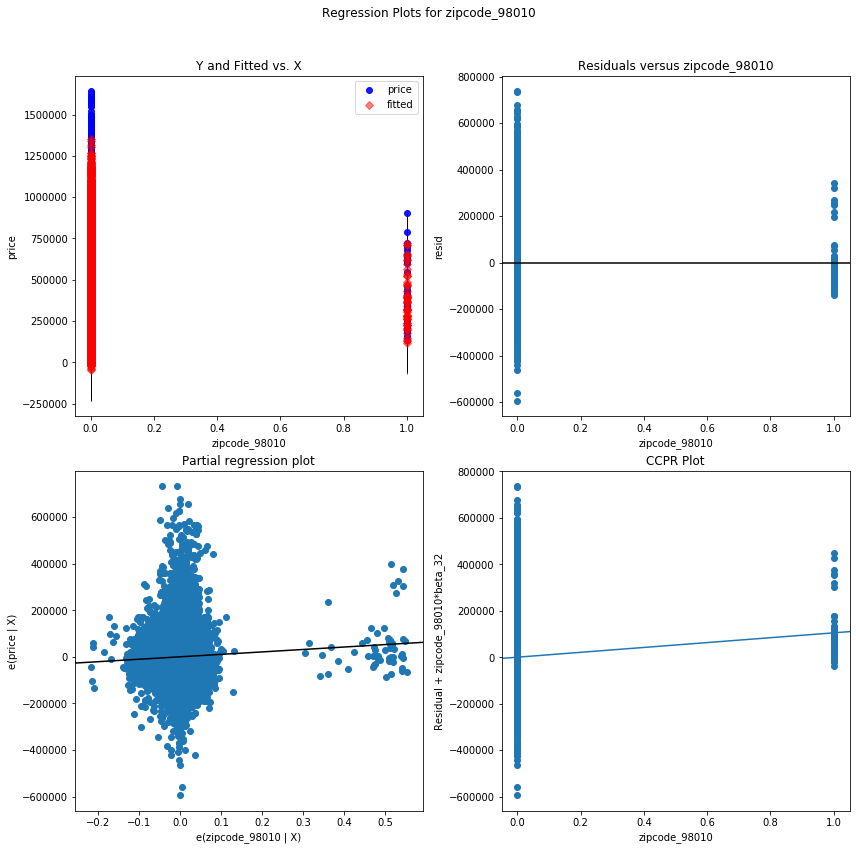

zipcode_98011 - Plotted


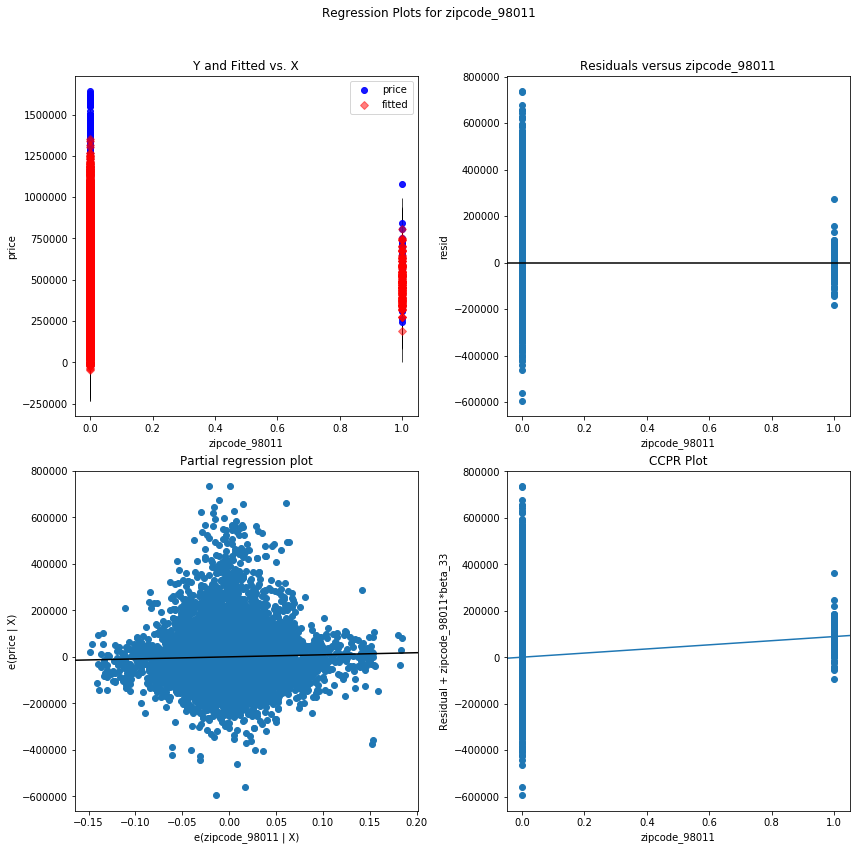

zipcode_98014 - Plotted


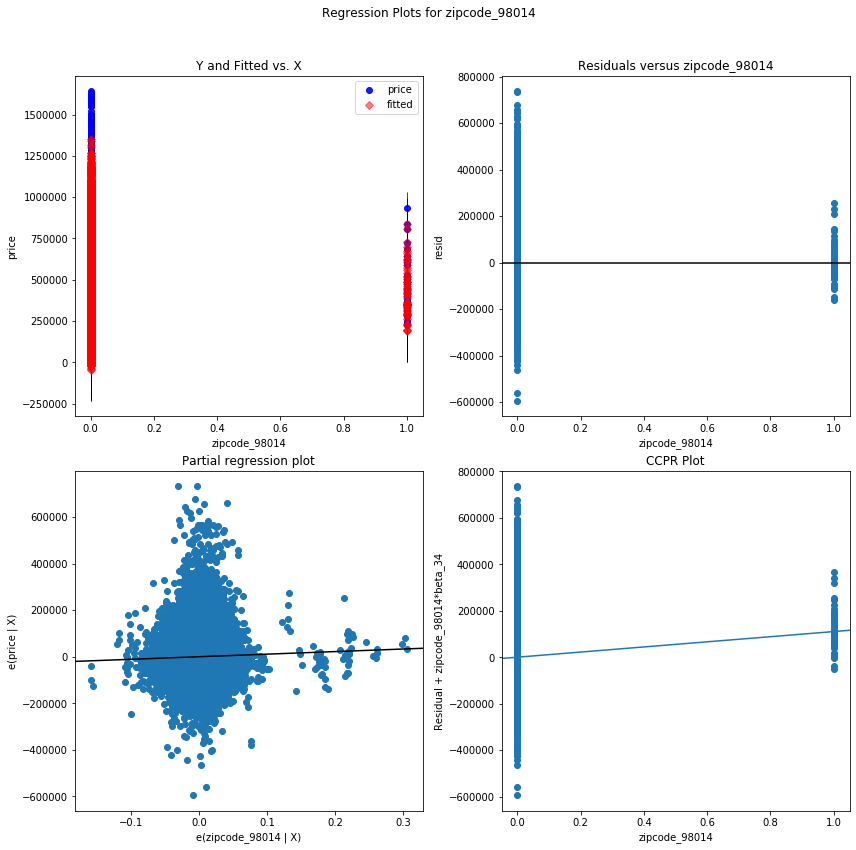

zipcode_98019 - Plotted


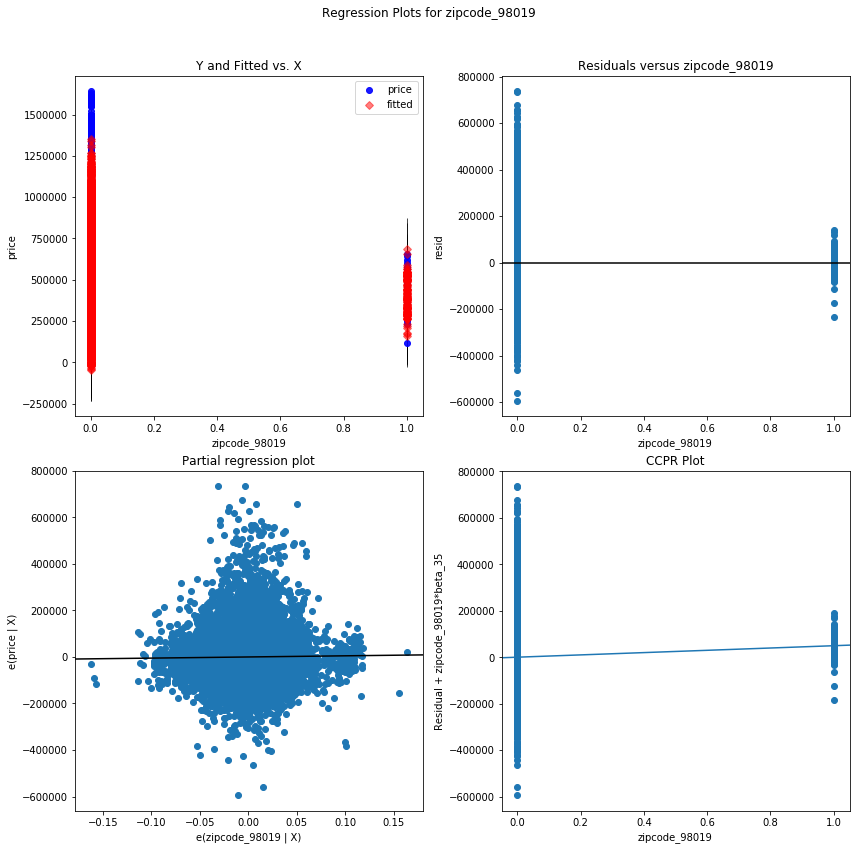

zipcode_98022 - Plotted


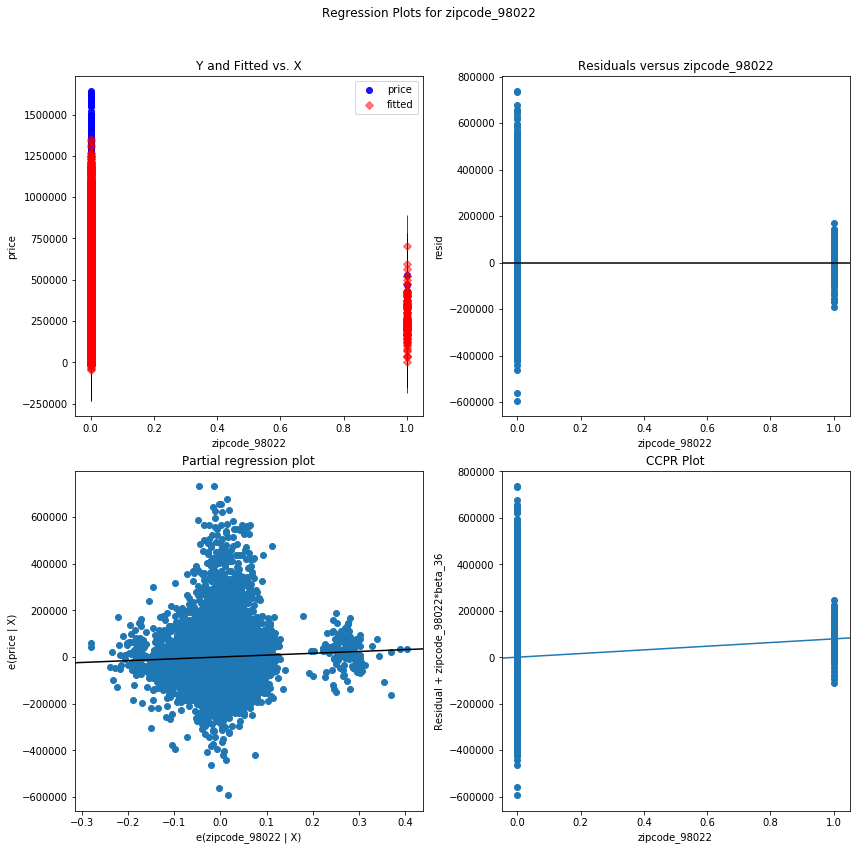

zipcode_98023 - Plotted


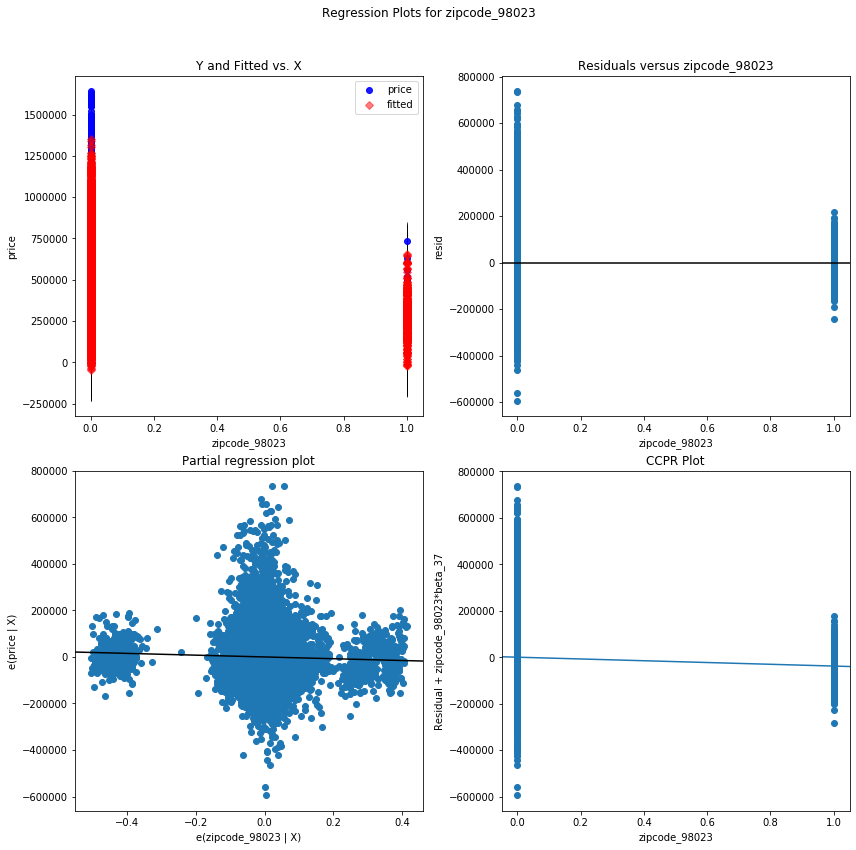

zipcode_98024 - Plotted


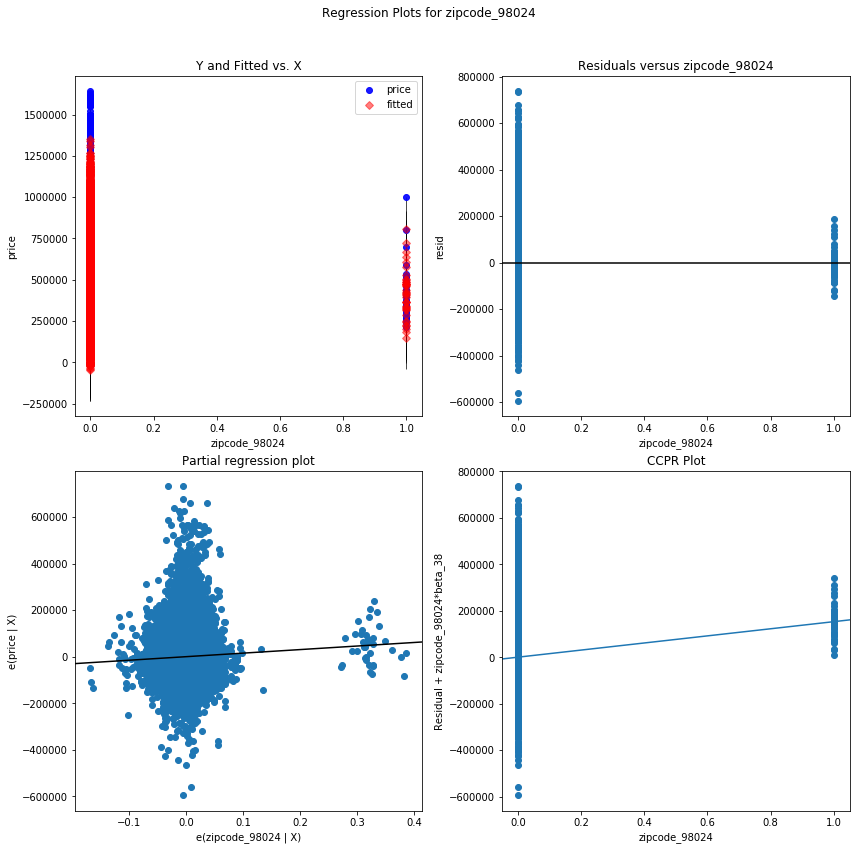

zipcode_98027 - Plotted


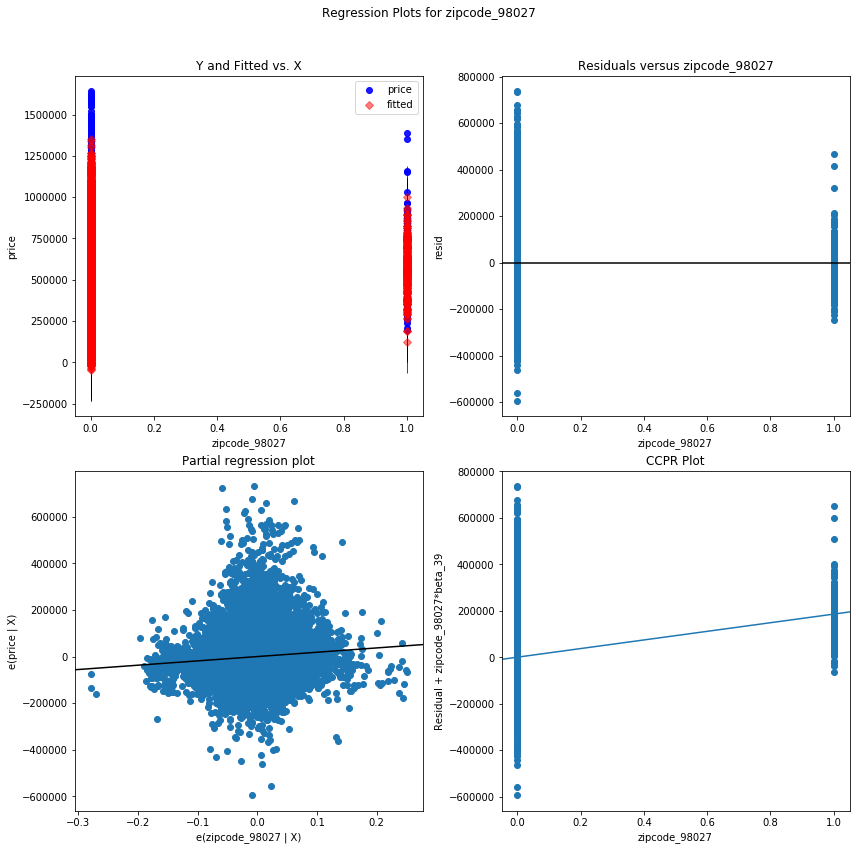

zipcode_98028 - Plotted


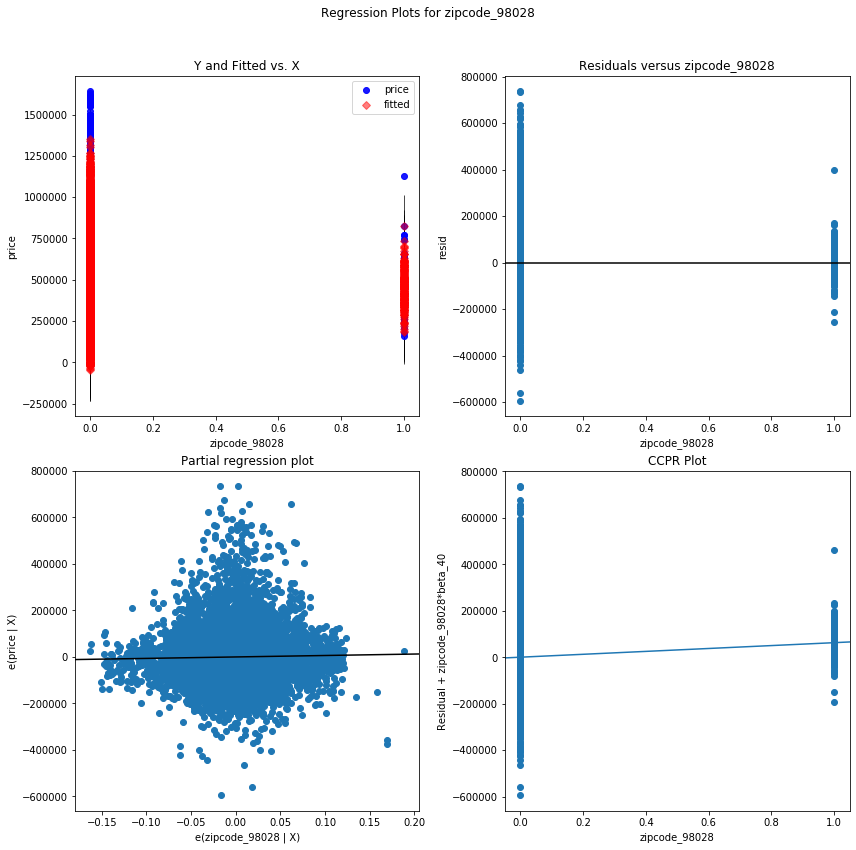

zipcode_98029 - Plotted


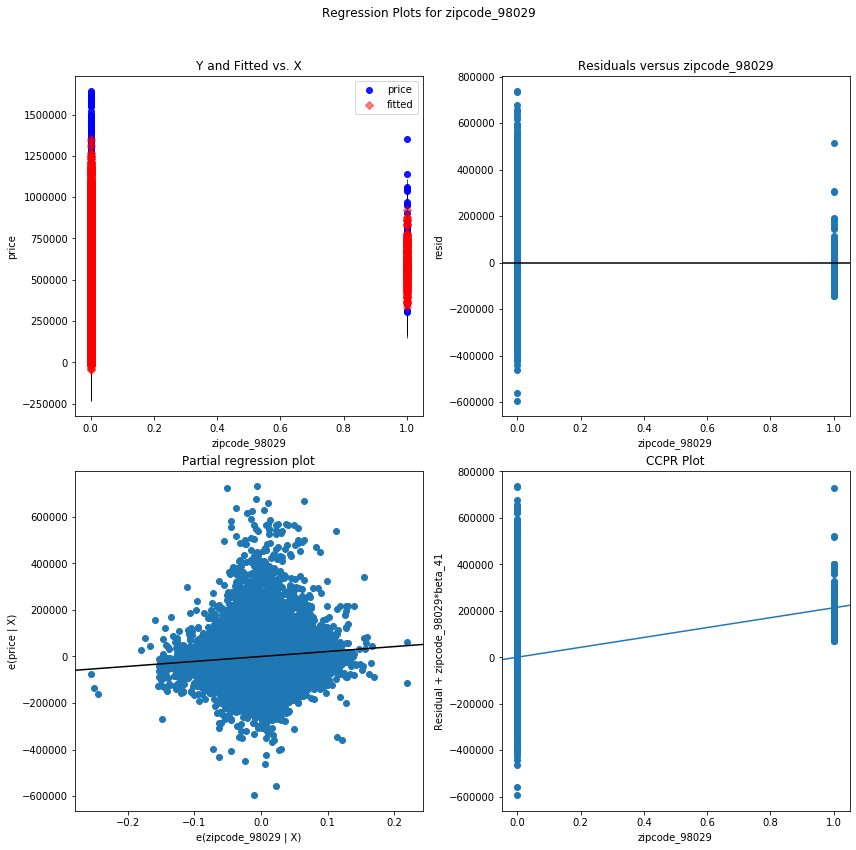

zipcode_98030 - Plotted


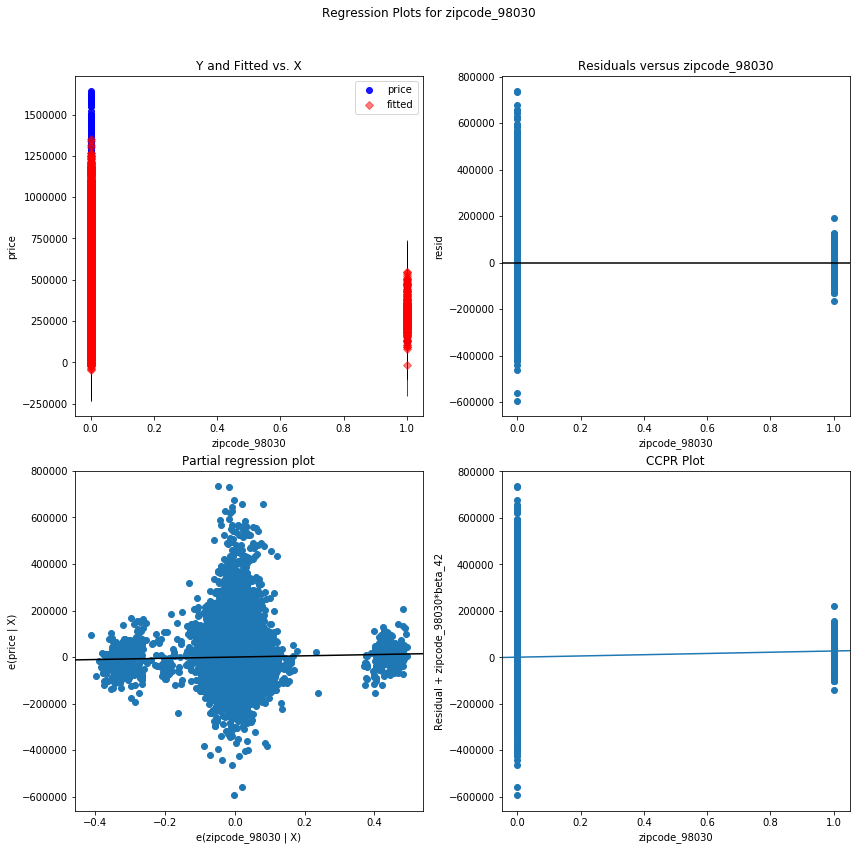

zipcode_98031 - Plotted


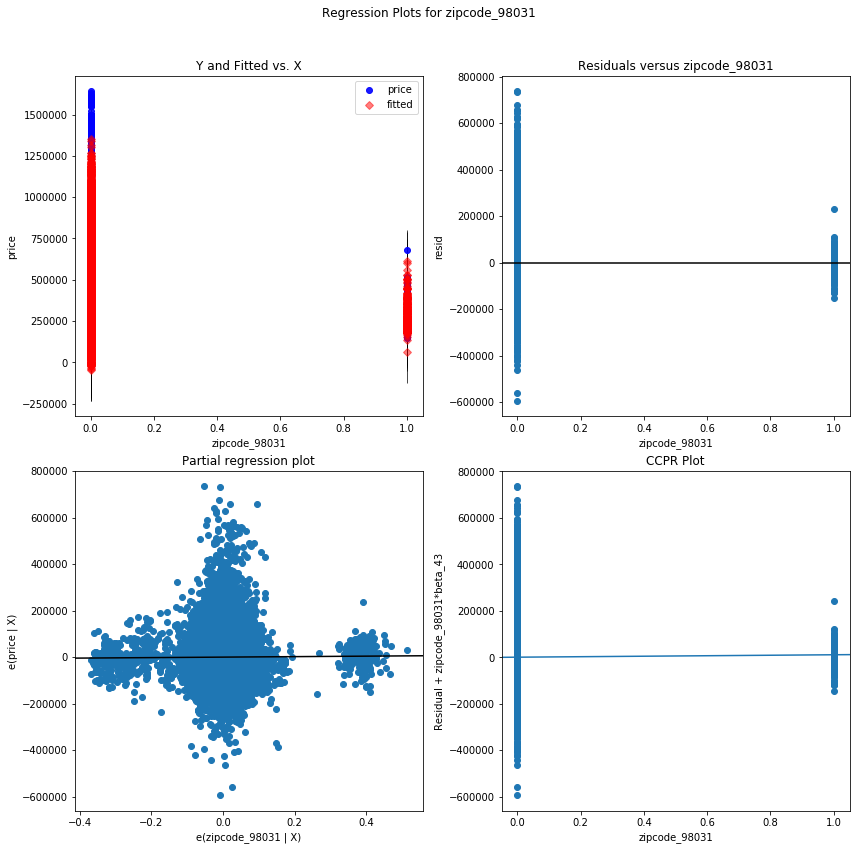

zipcode_98032 - Plotted


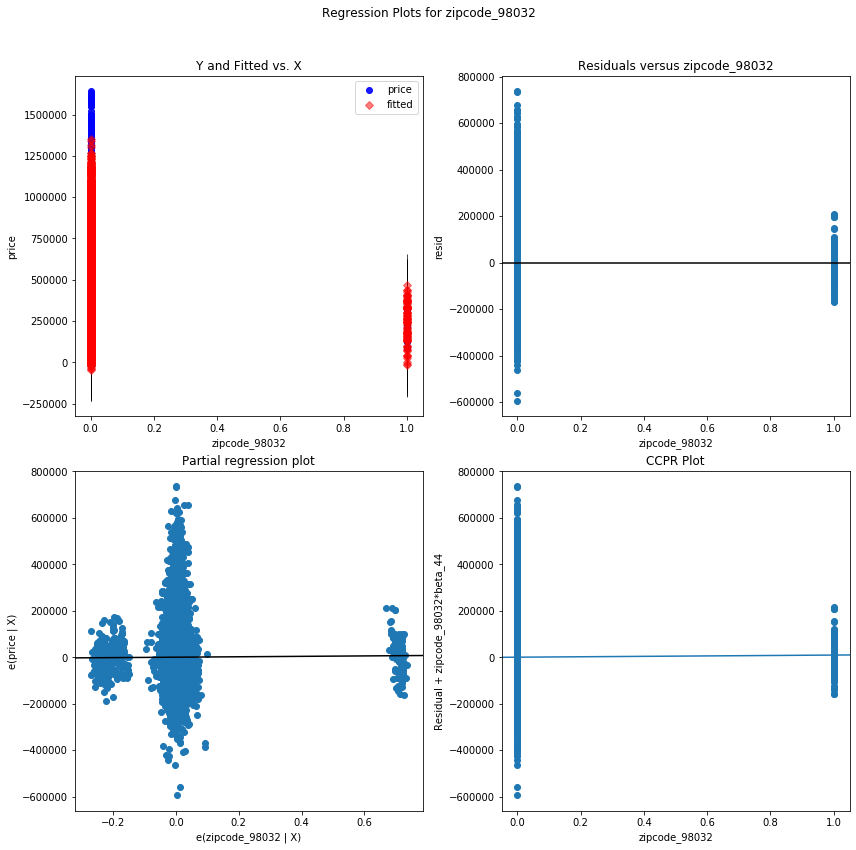

zipcode_98033 - Plotted


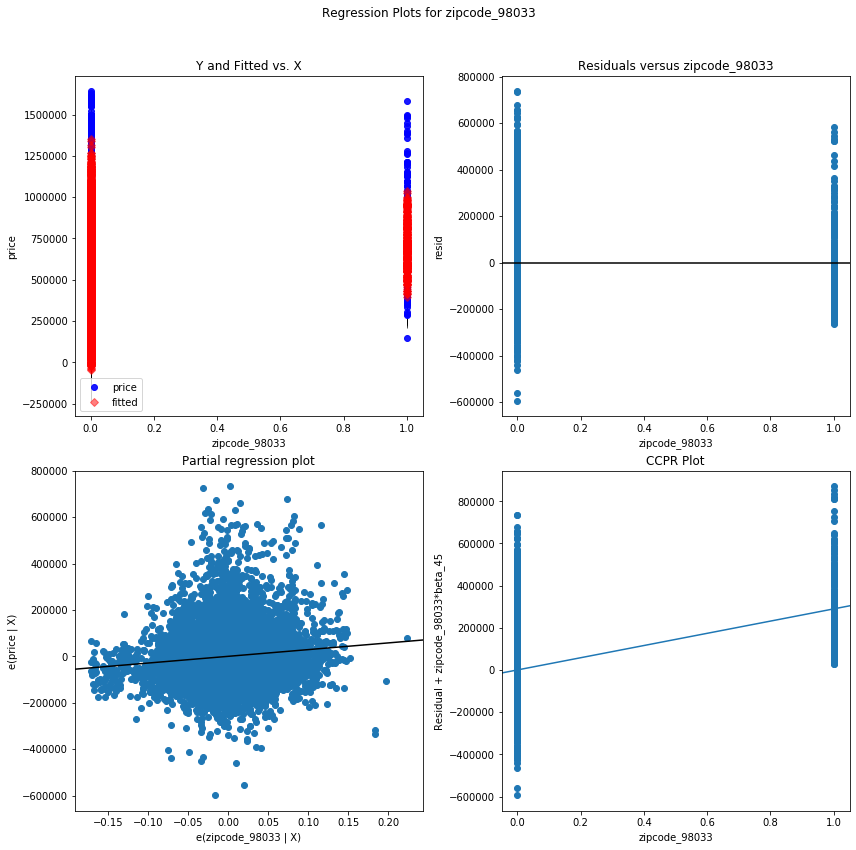

zipcode_98034 - Plotted


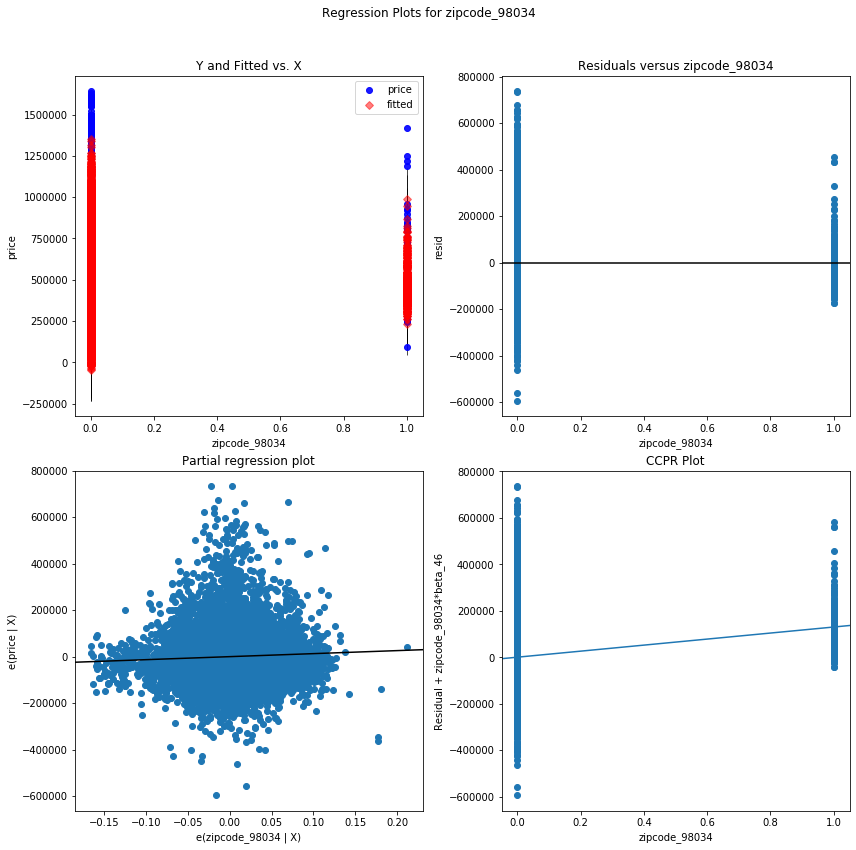

zipcode_98038 - Plotted


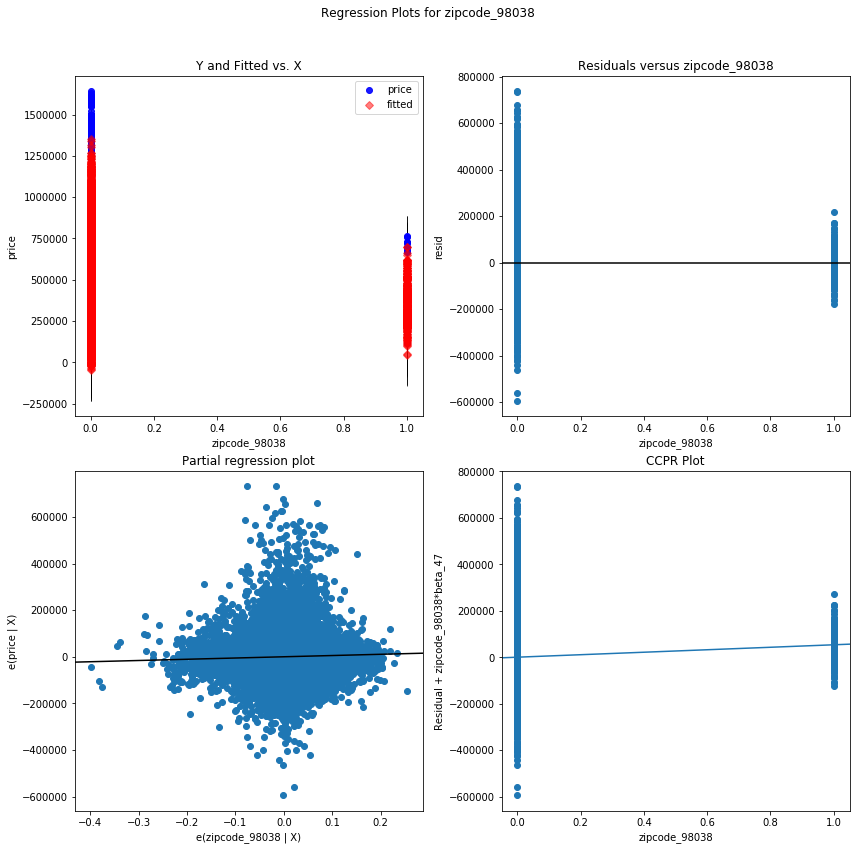

zipcode_98040 - Plotted


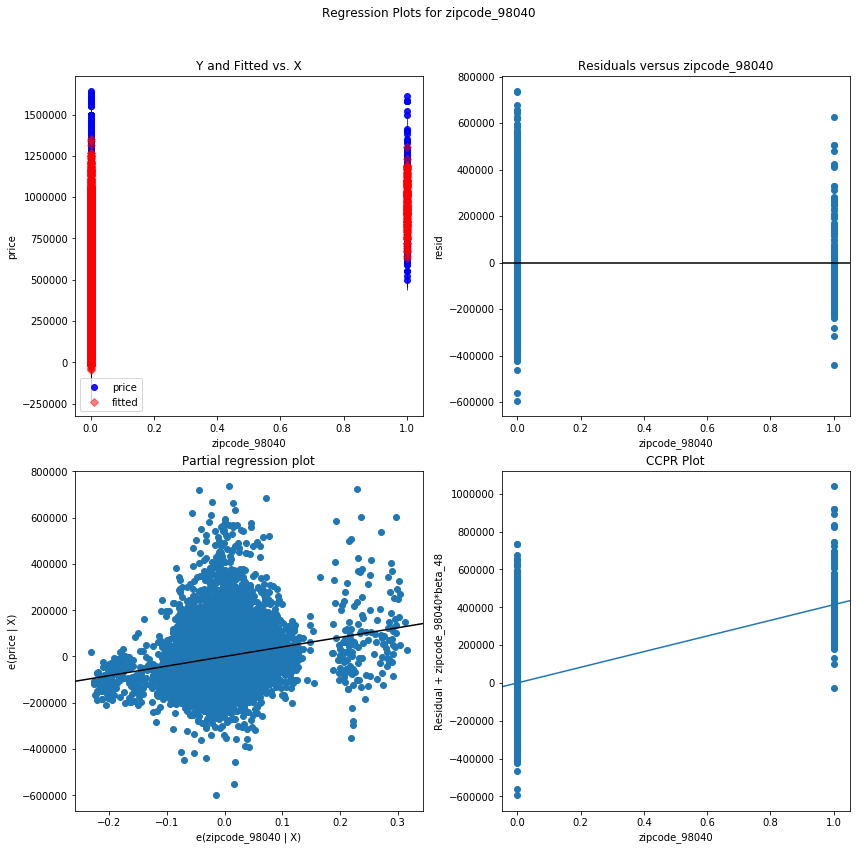

zipcode_98042 - Plotted


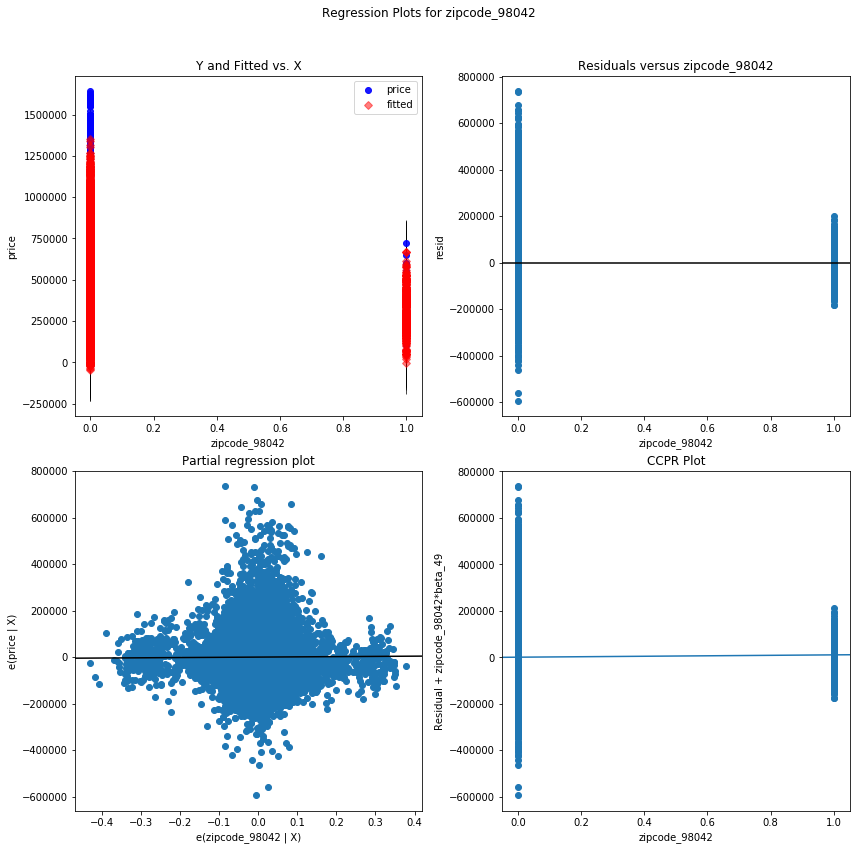

zipcode_98045 - Plotted


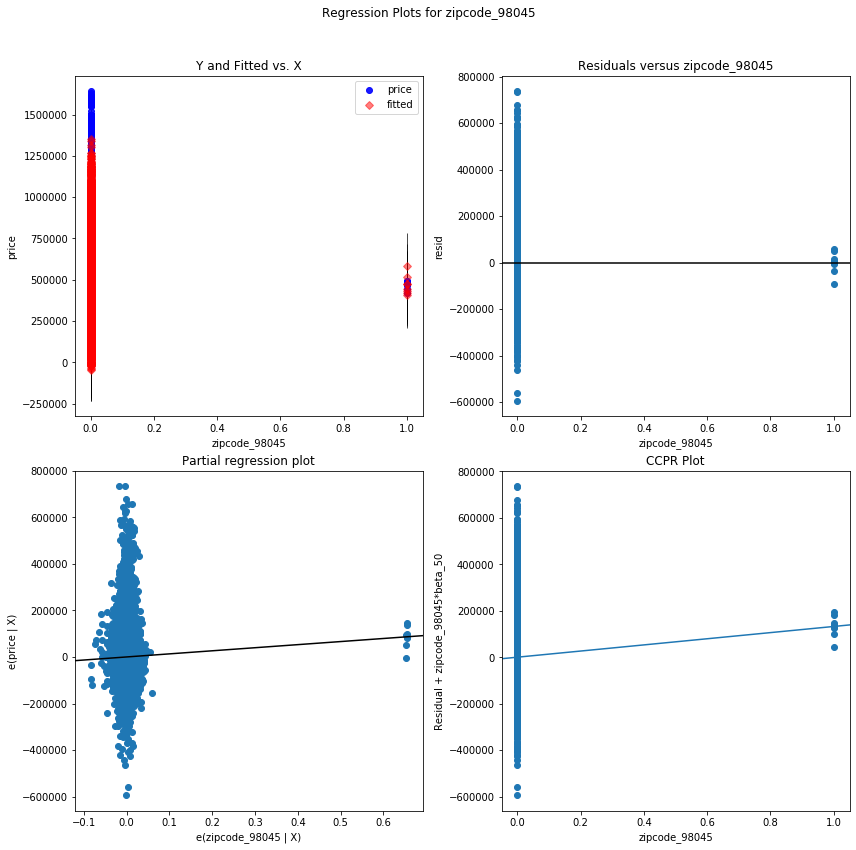

zipcode_98052 - Plotted


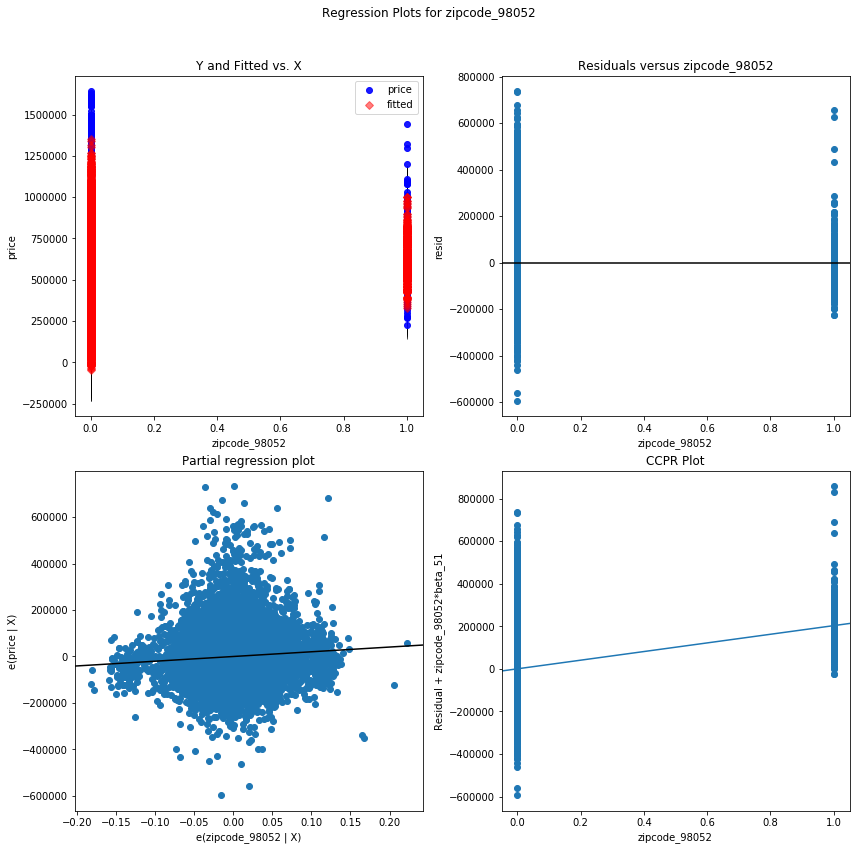

zipcode_98053 - Plotted


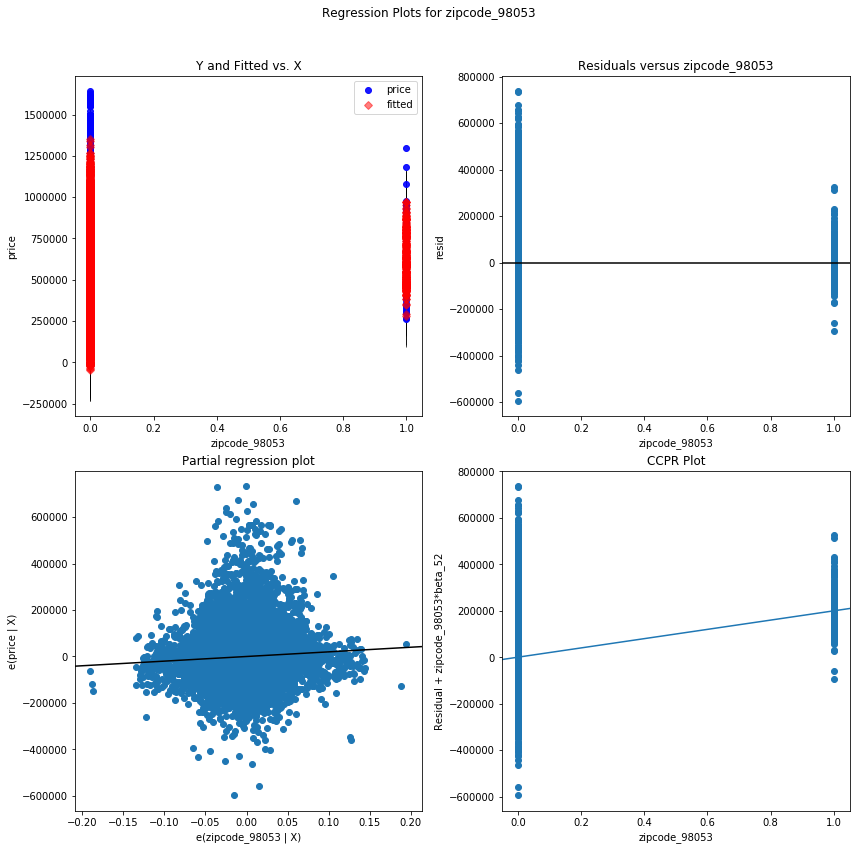

zipcode_98055 - Plotted


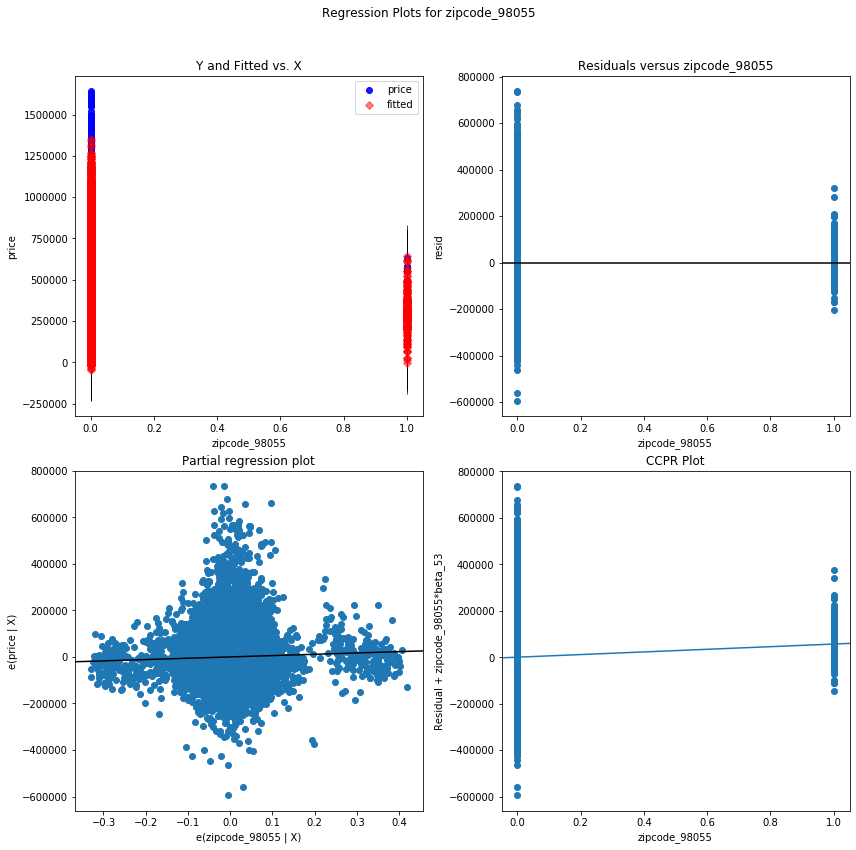

zipcode_98056 - Plotted


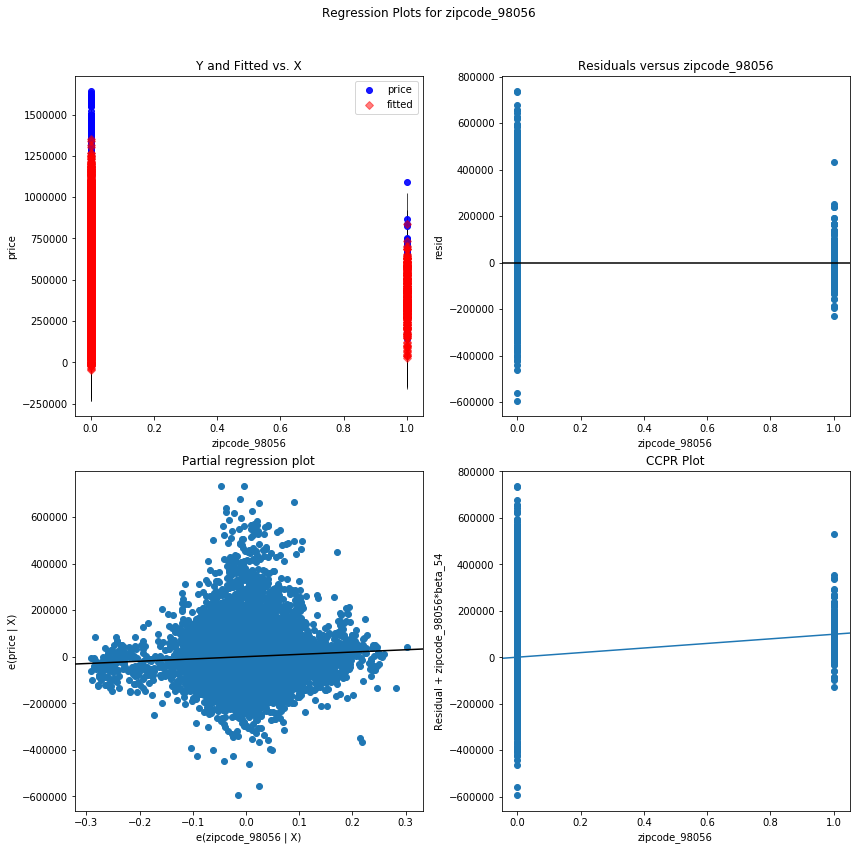

zipcode_98058 - Plotted


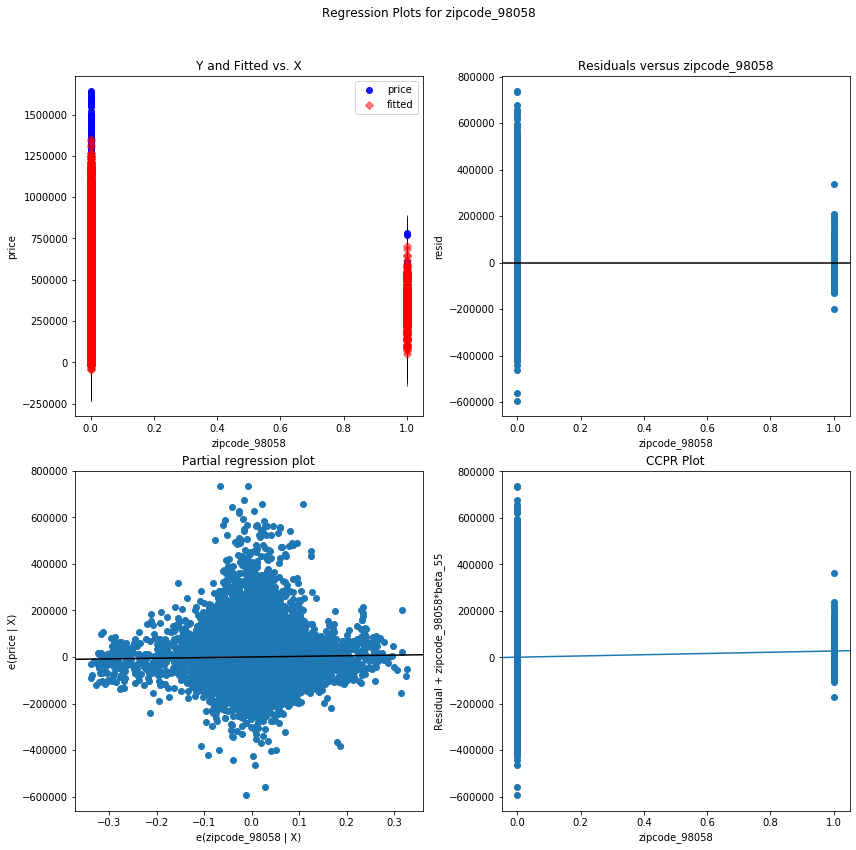

zipcode_98059 - Plotted


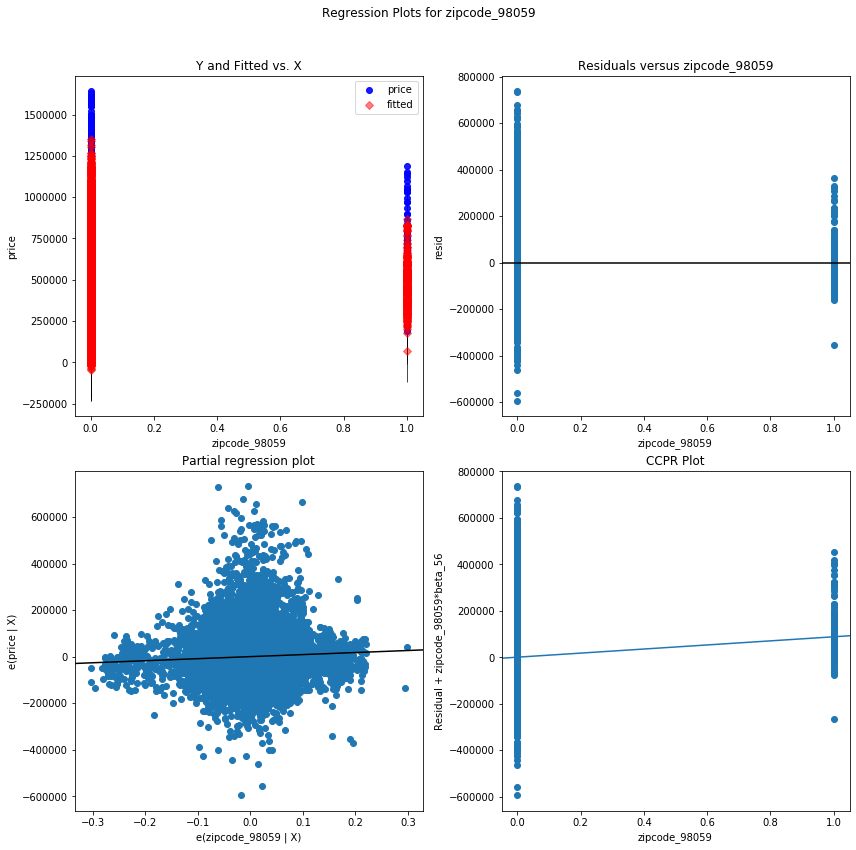

zipcode_98065 - Plotted


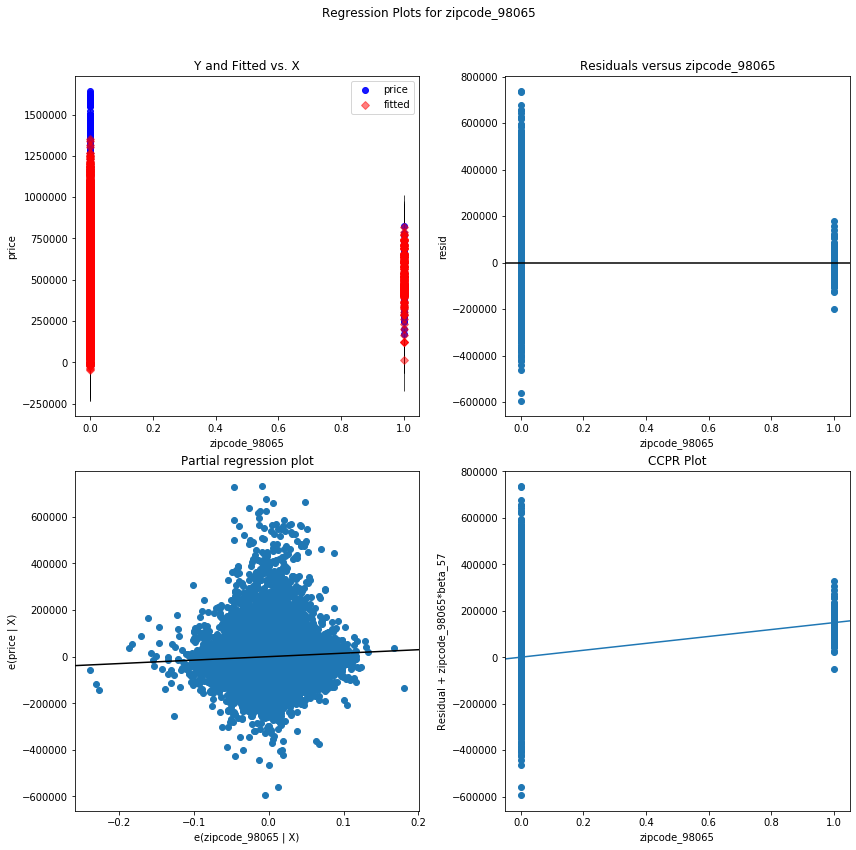

zipcode_98070 - Plotted


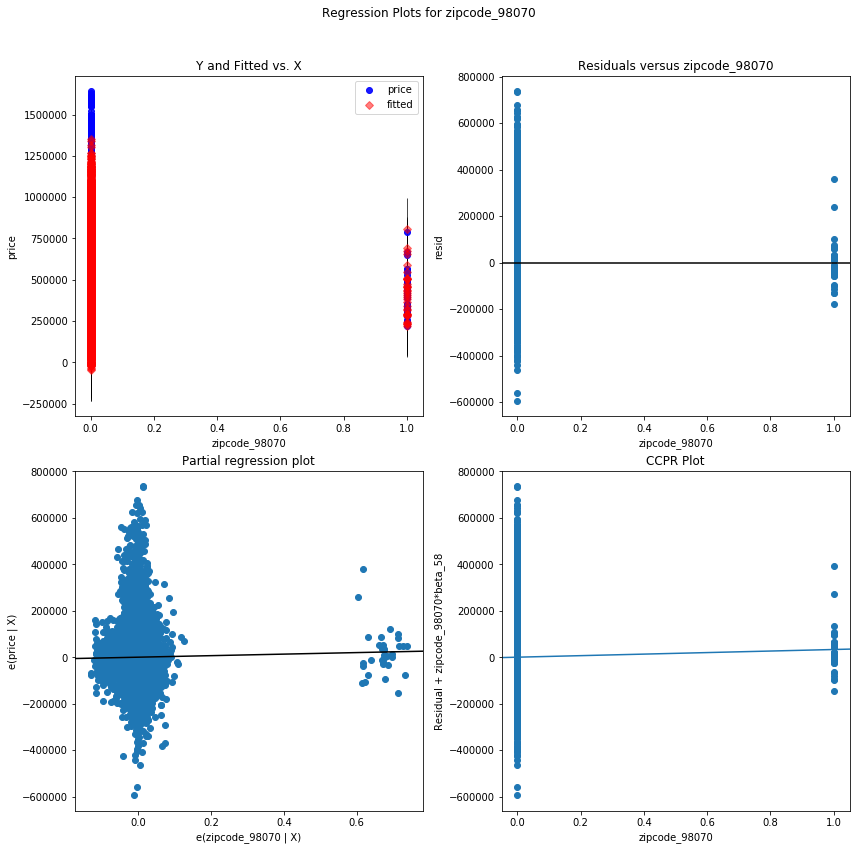

zipcode_98072 - Plotted


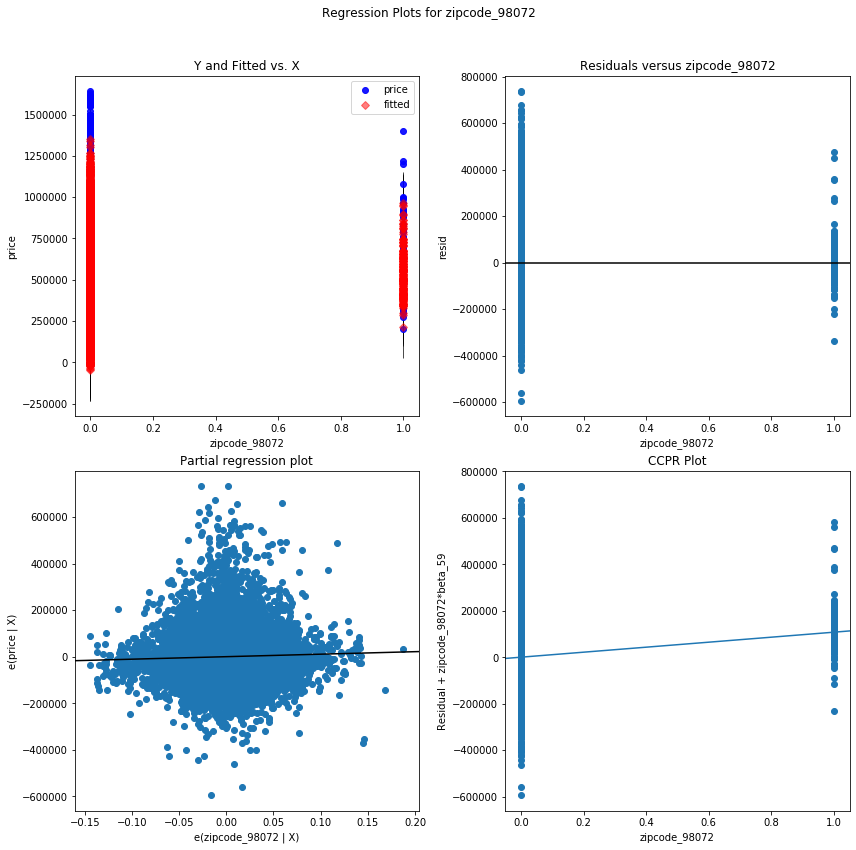

zipcode_98074 - Plotted


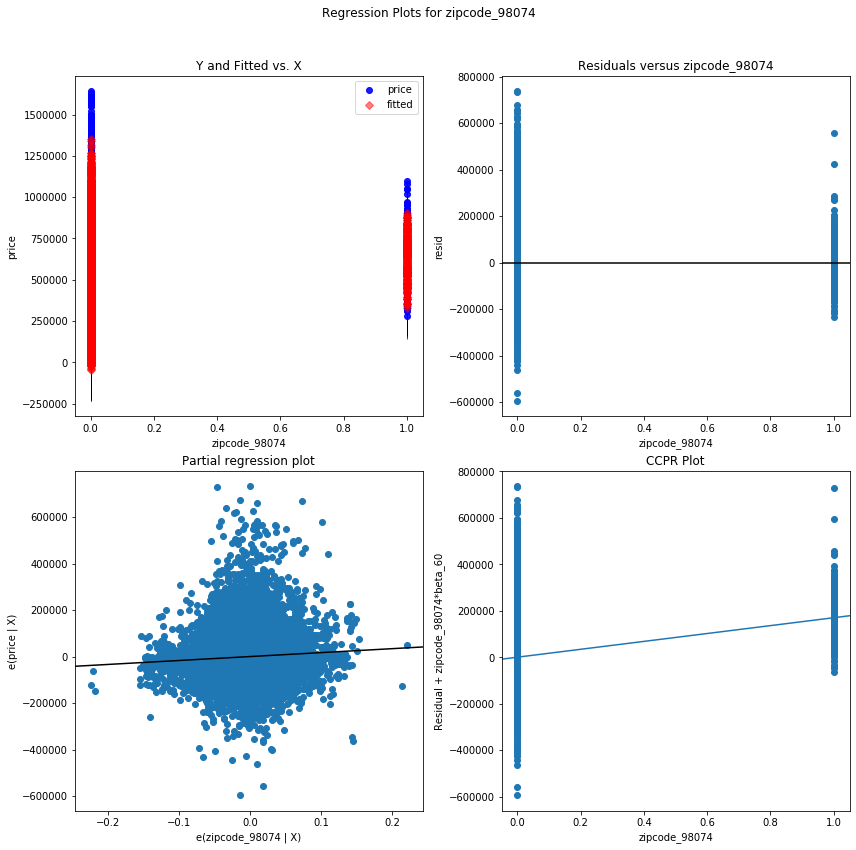

zipcode_98075 - Plotted


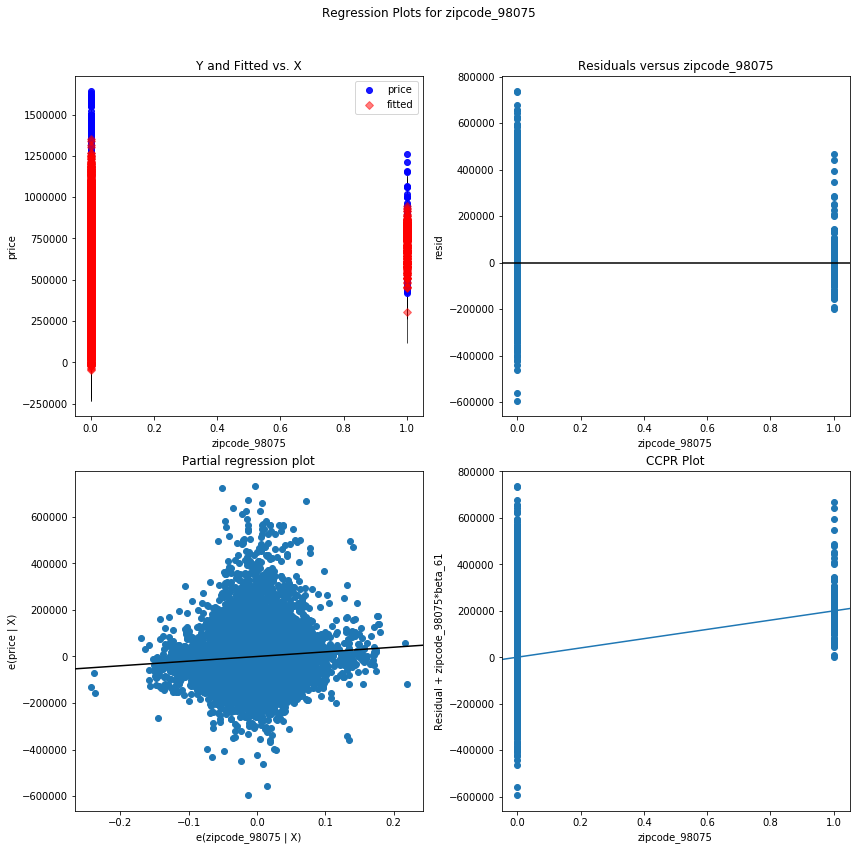

zipcode_98077 - Plotted


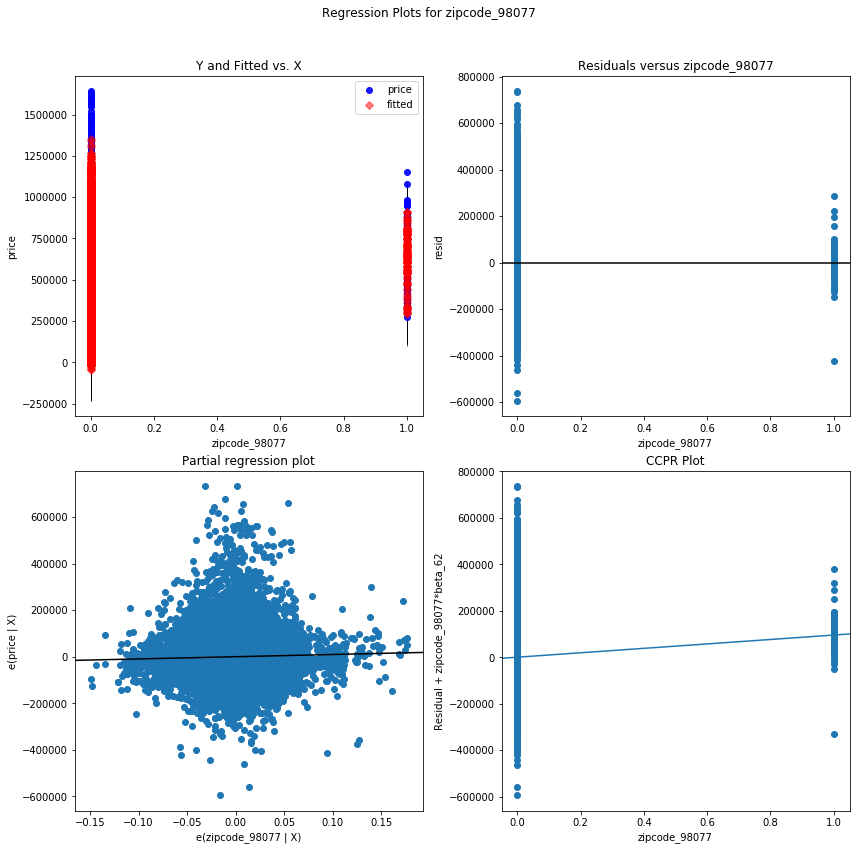

zipcode_98092 - Plotted


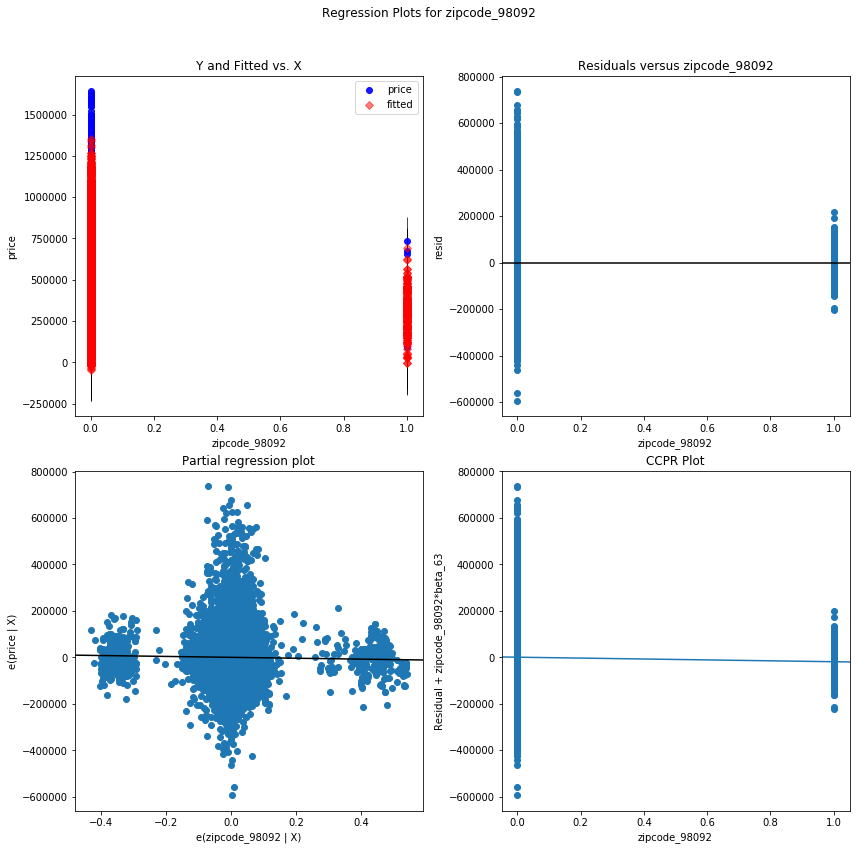

zipcode_98102 - Plotted


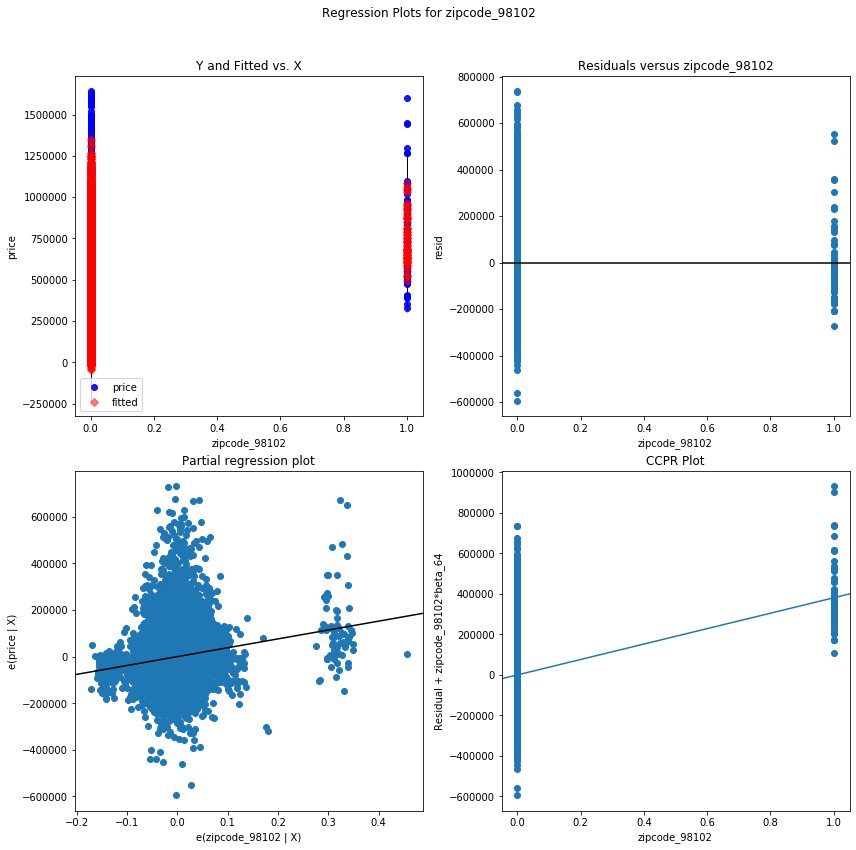

zipcode_98103 - Plotted


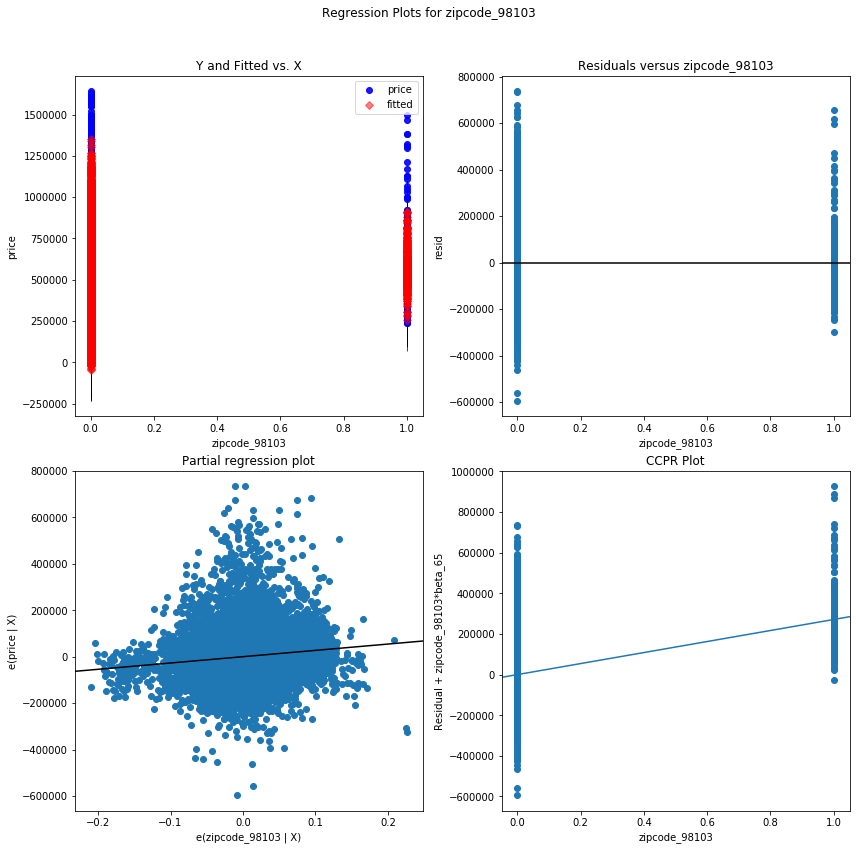

zipcode_98105 - Plotted


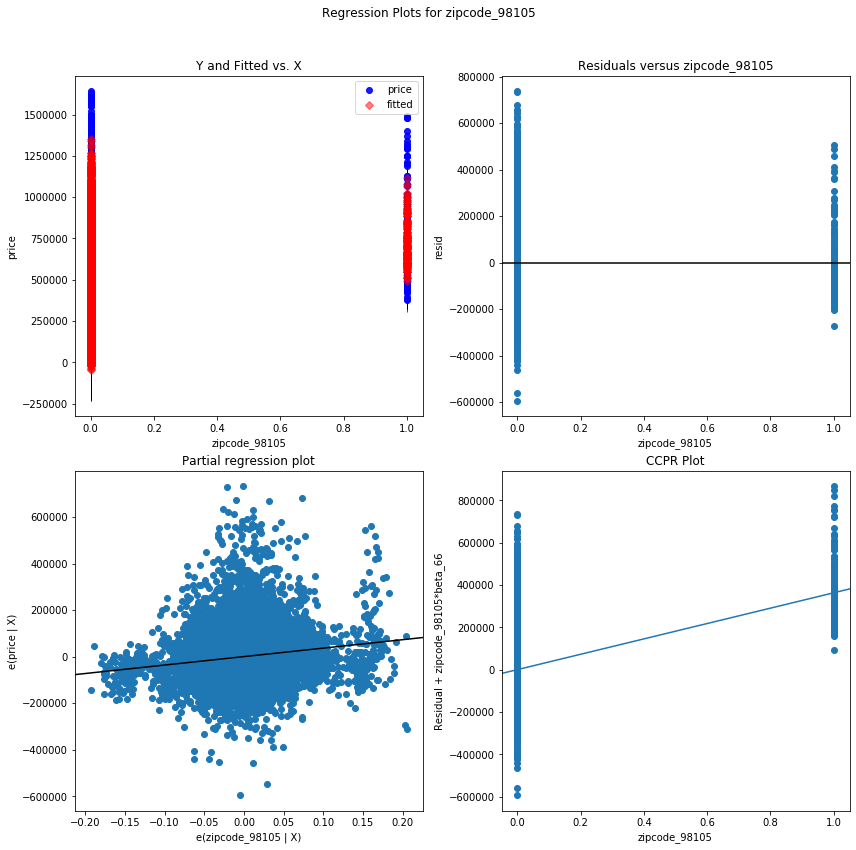

zipcode_98106 - Plotted


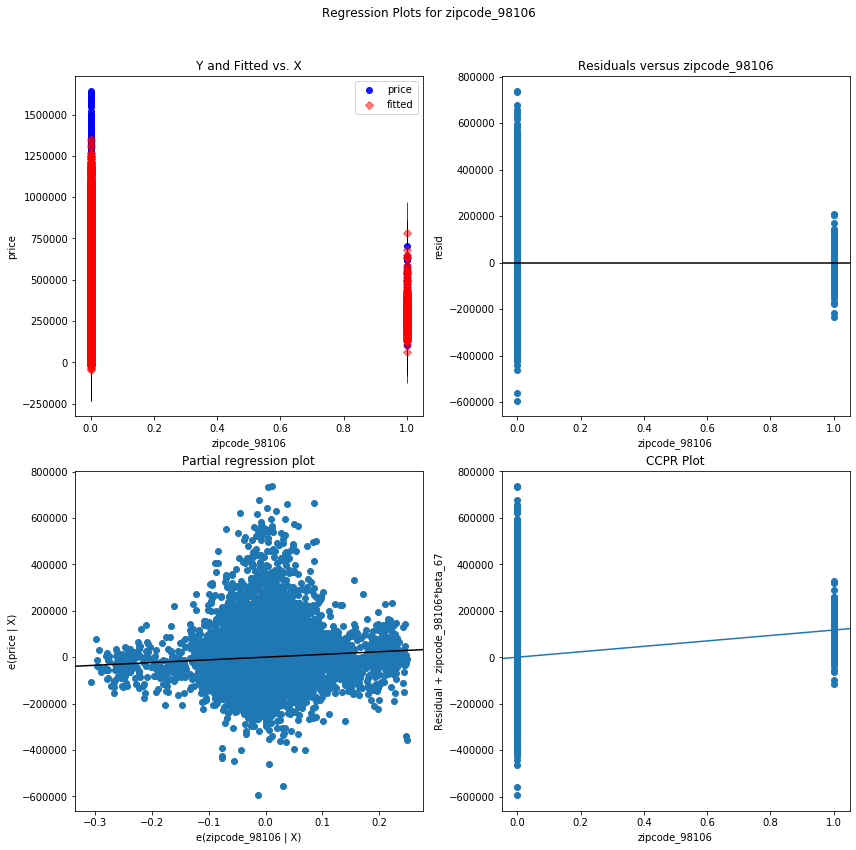

zipcode_98107 - Plotted


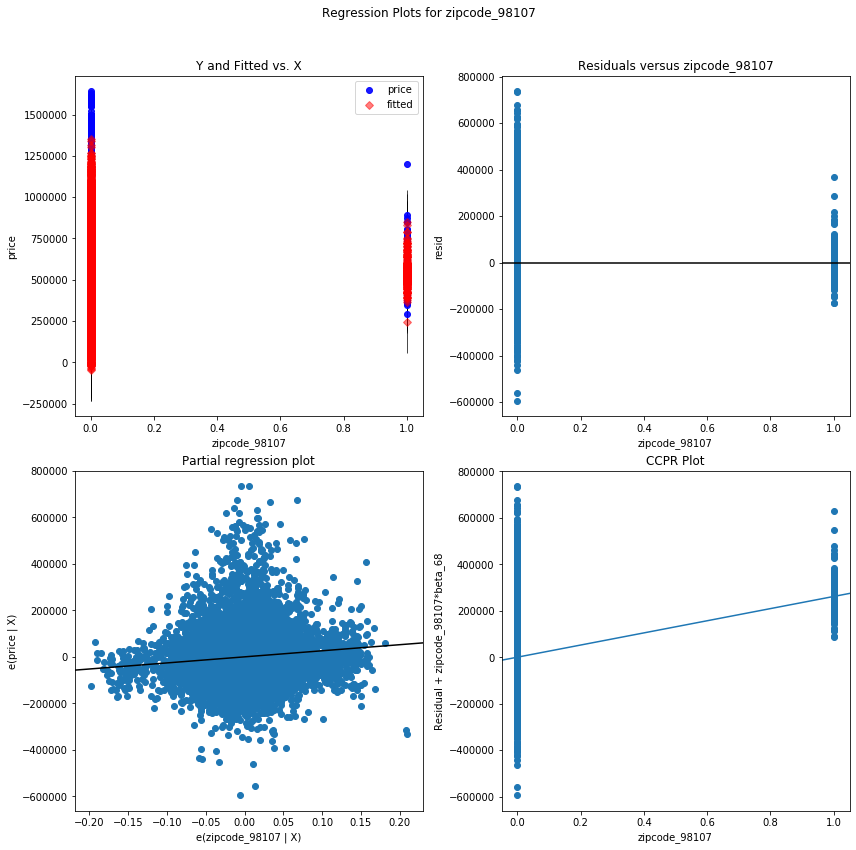

zipcode_98108 - Plotted


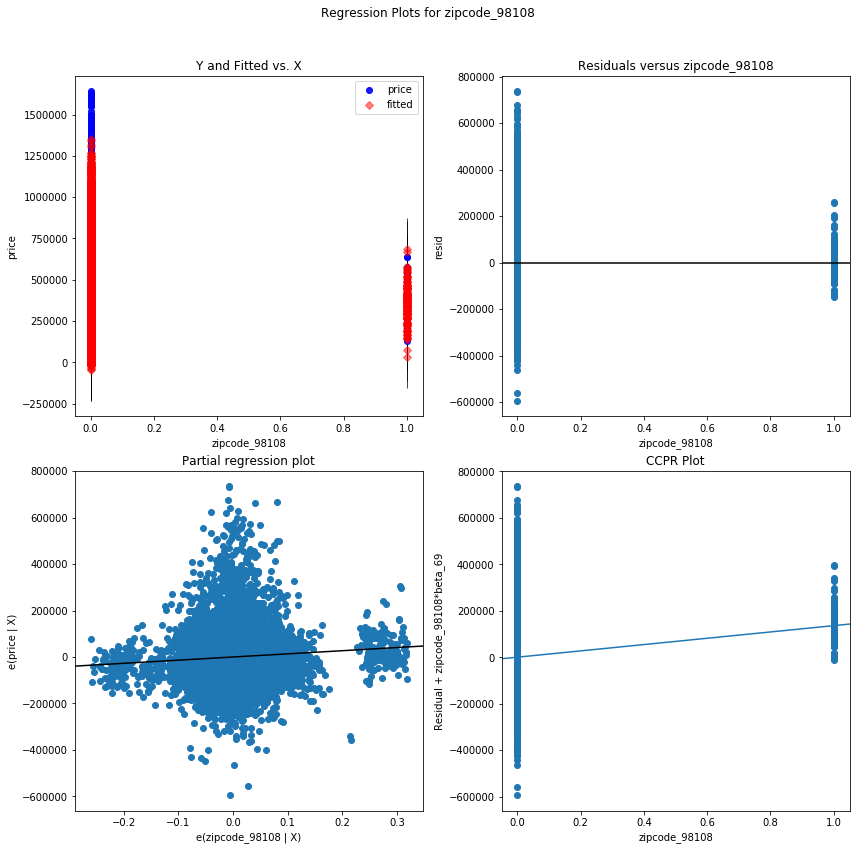

zipcode_98109 - Plotted


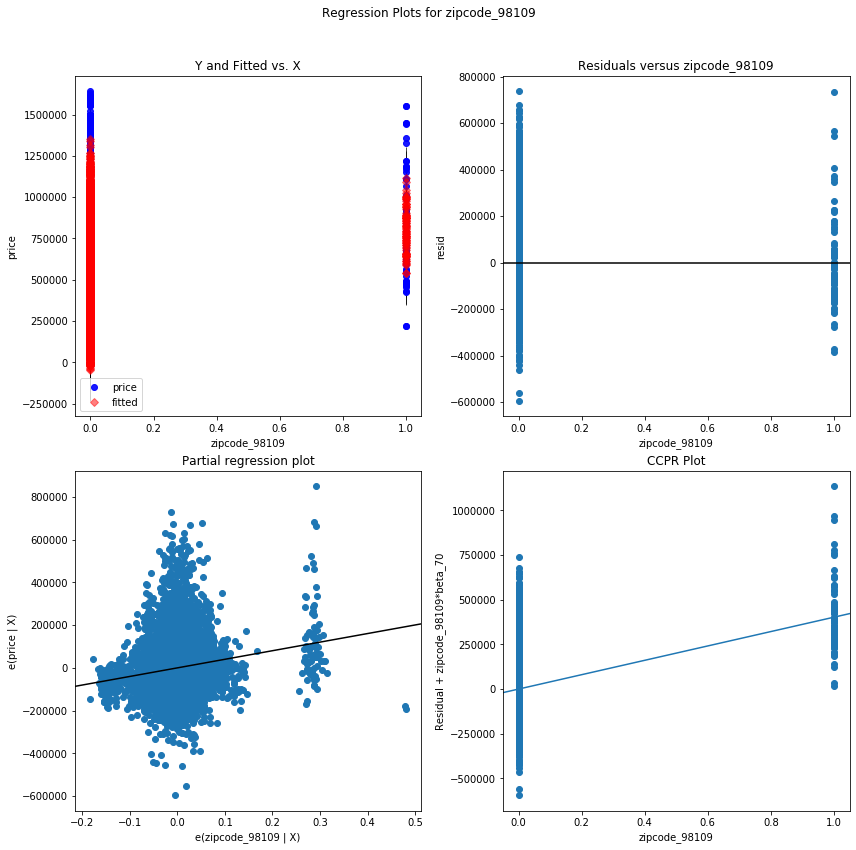

zipcode_98112 - Plotted


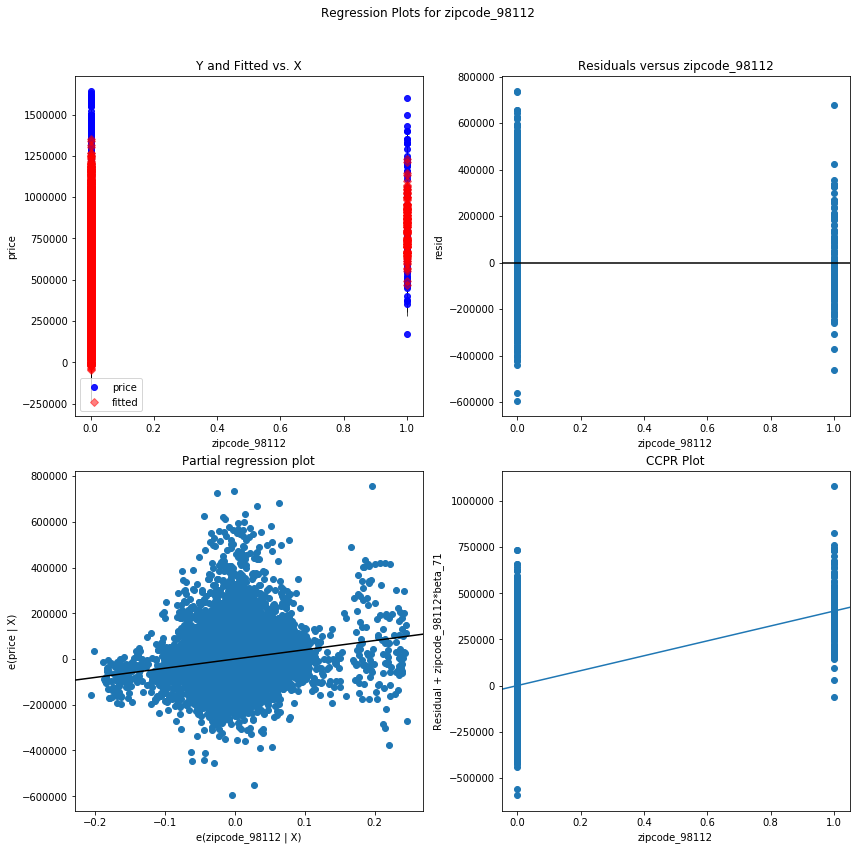

zipcode_98115 - Plotted


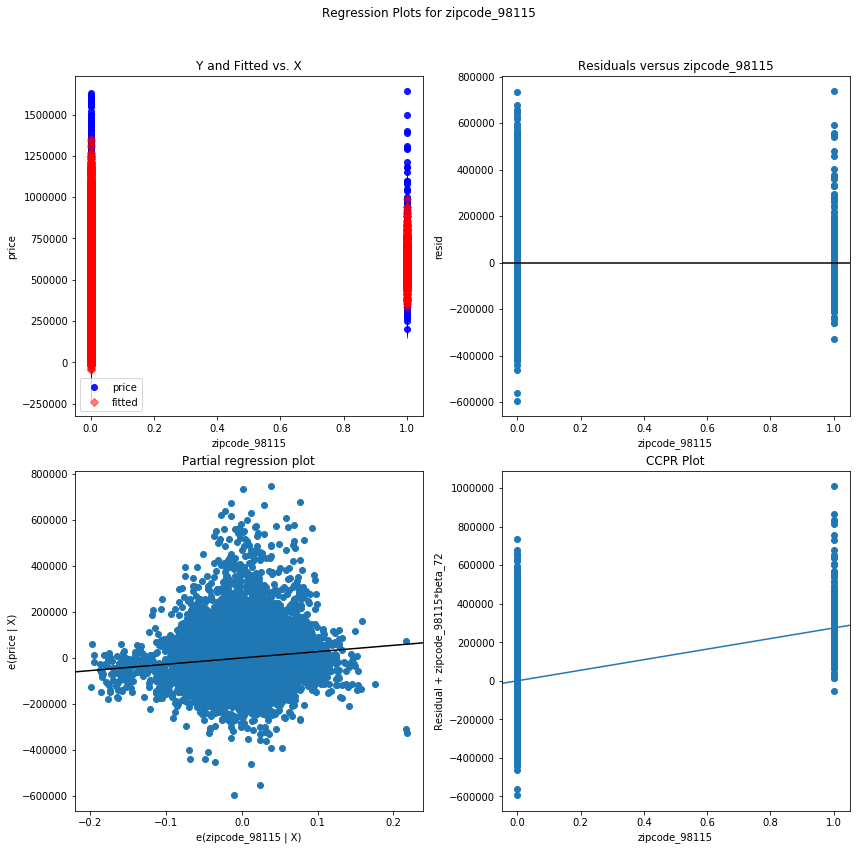

zipcode_98116 - Plotted


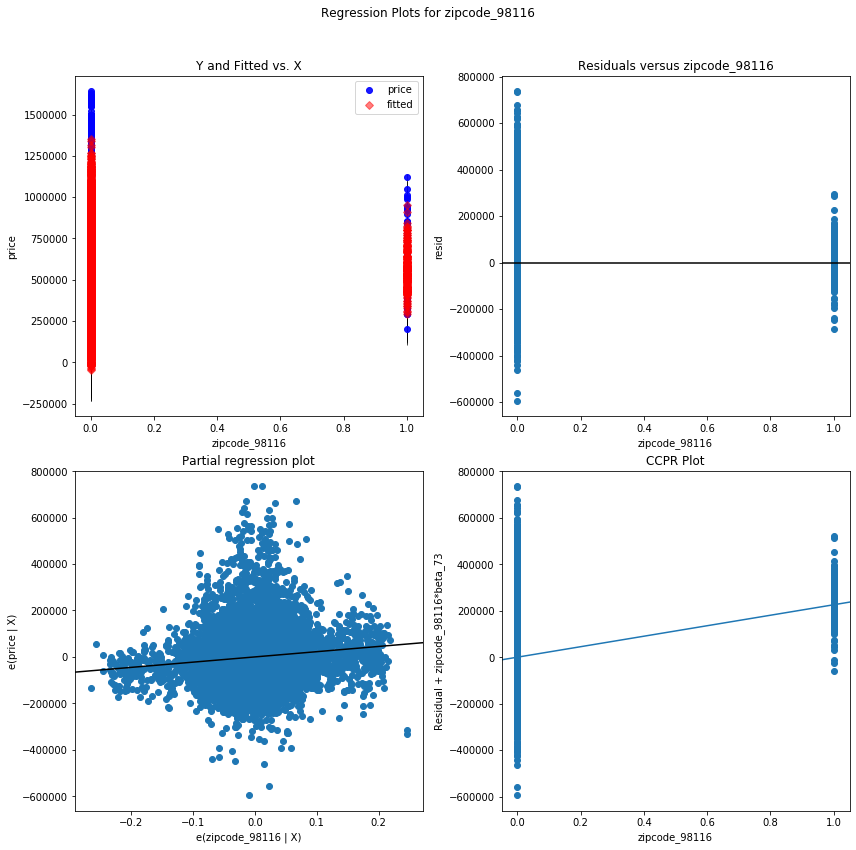

zipcode_98117 - Plotted


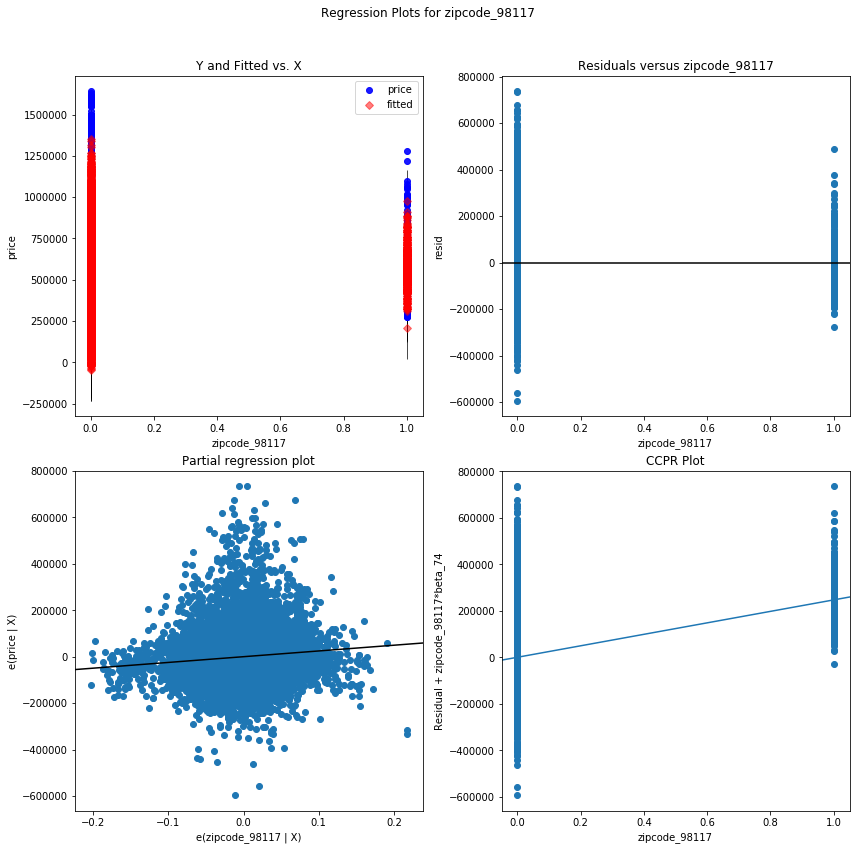

zipcode_98118 - Plotted


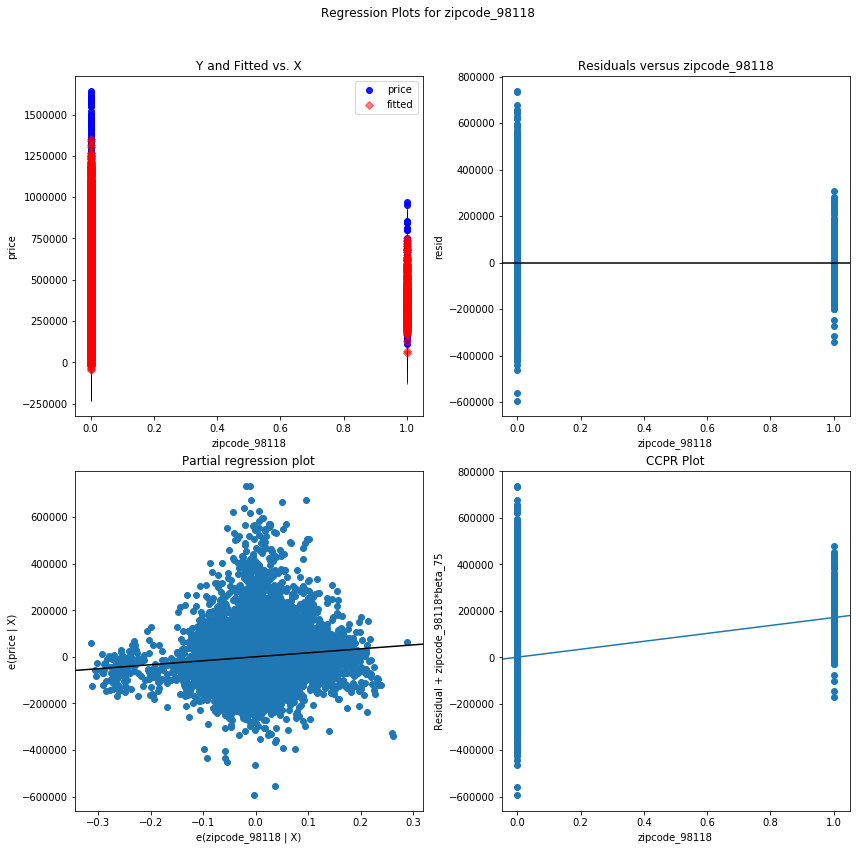

zipcode_98119 - Plotted


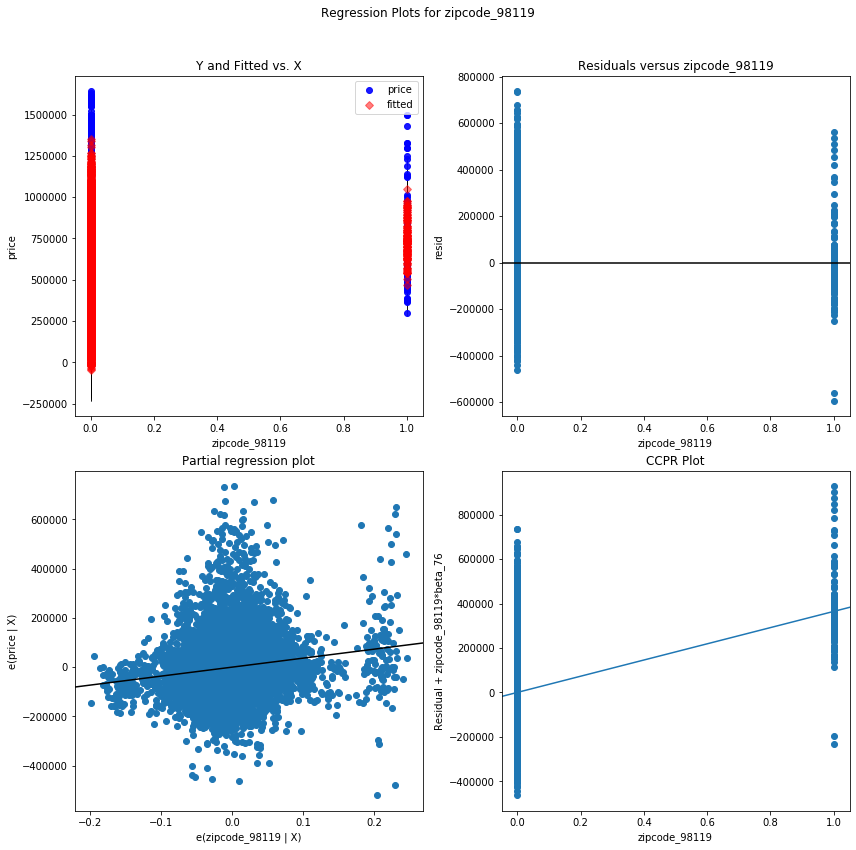

zipcode_98122 - Plotted


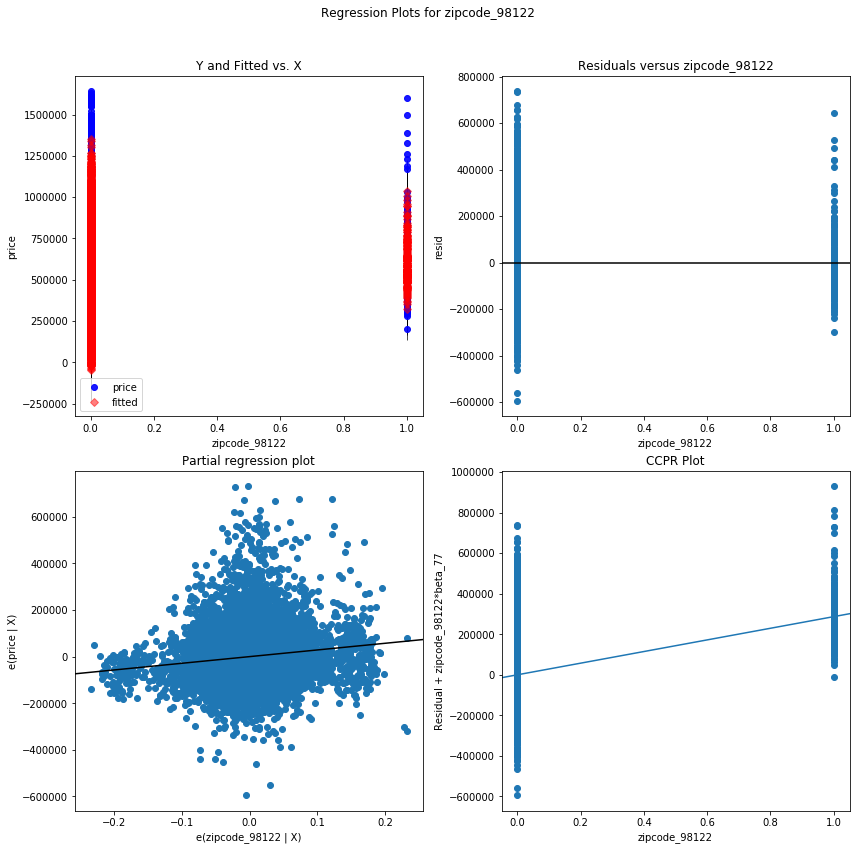

zipcode_98125 - Plotted


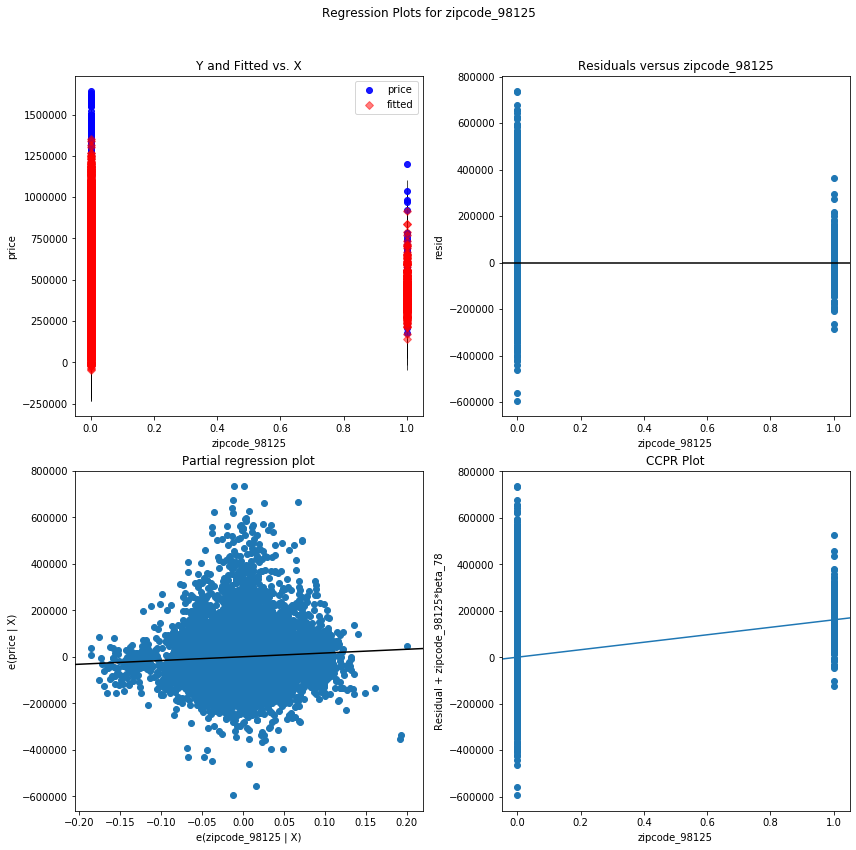

zipcode_98126 - Plotted


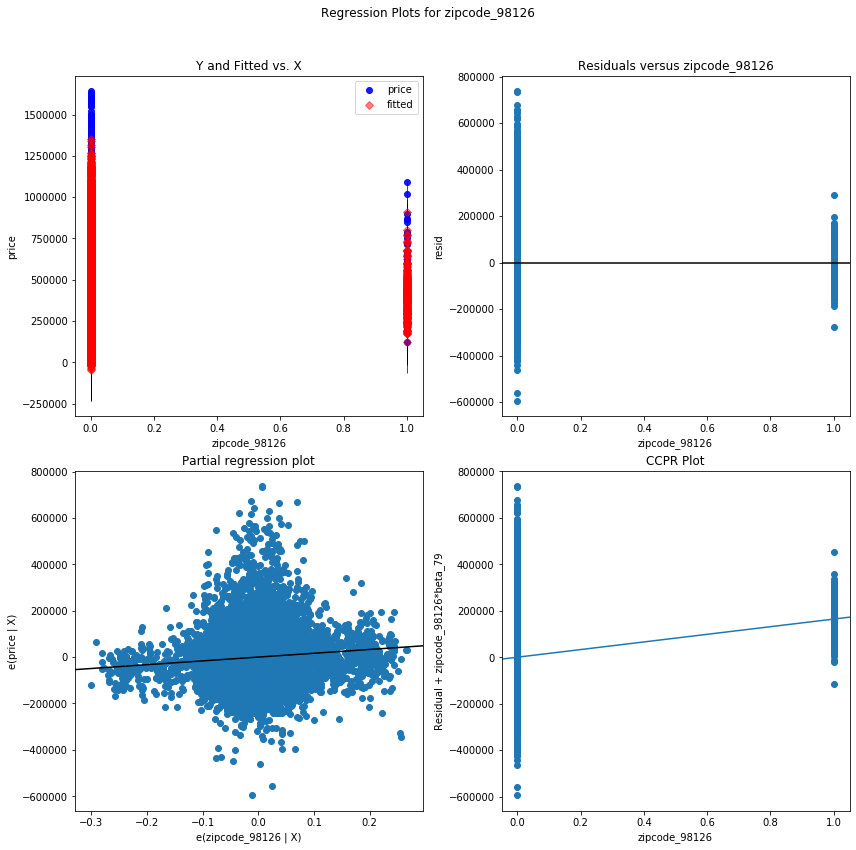

zipcode_98133 - Plotted


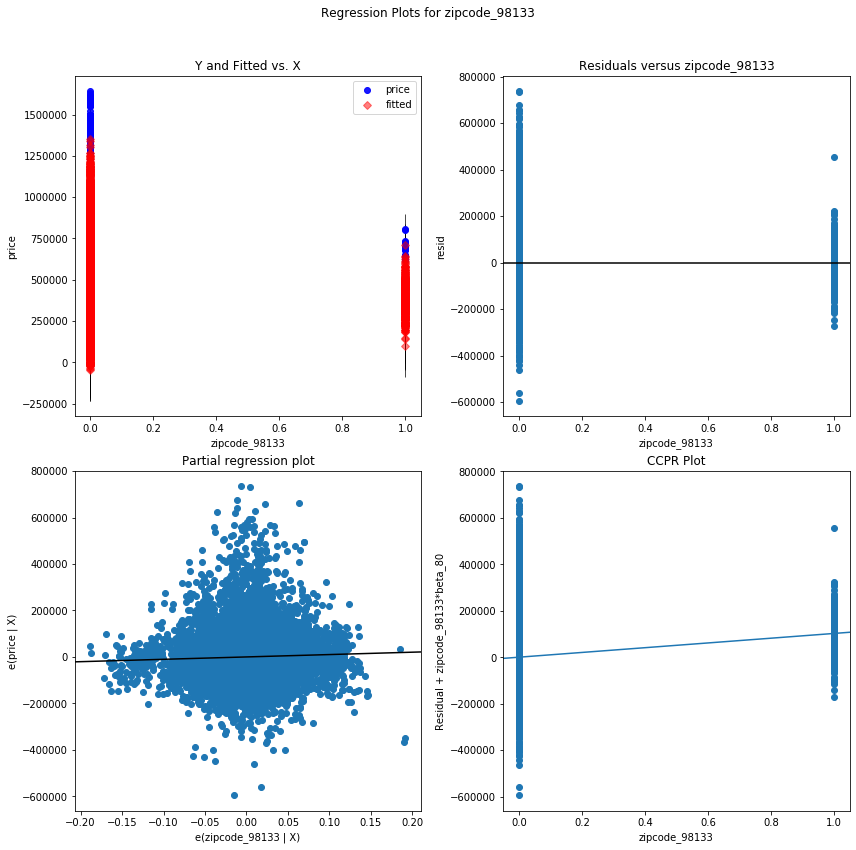

zipcode_98136 - Plotted


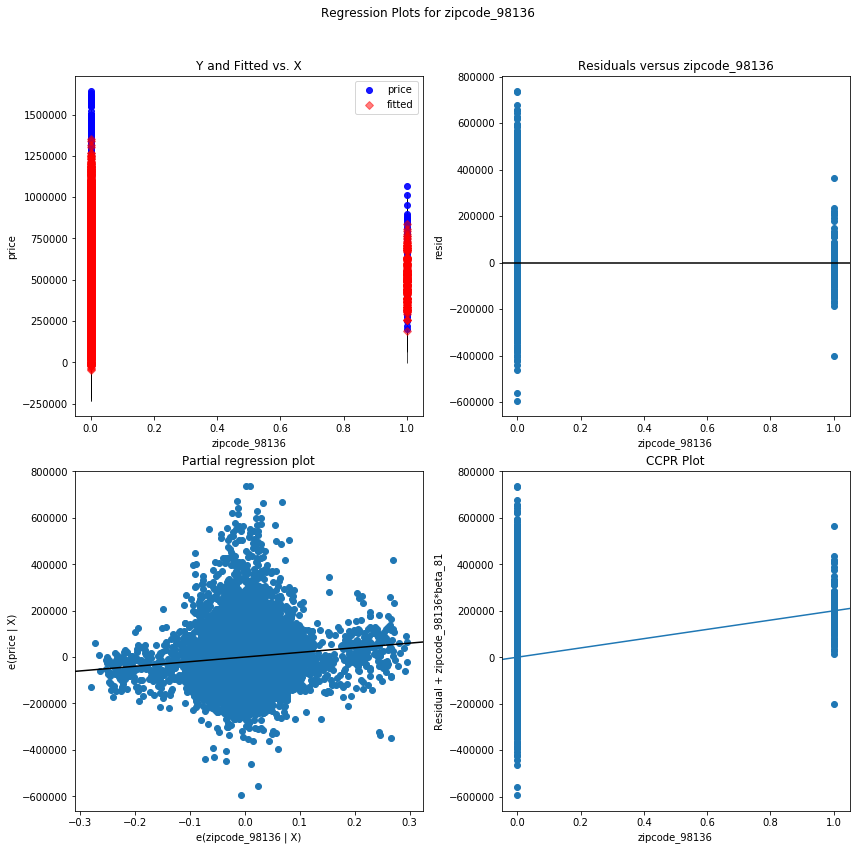

zipcode_98144 - Plotted


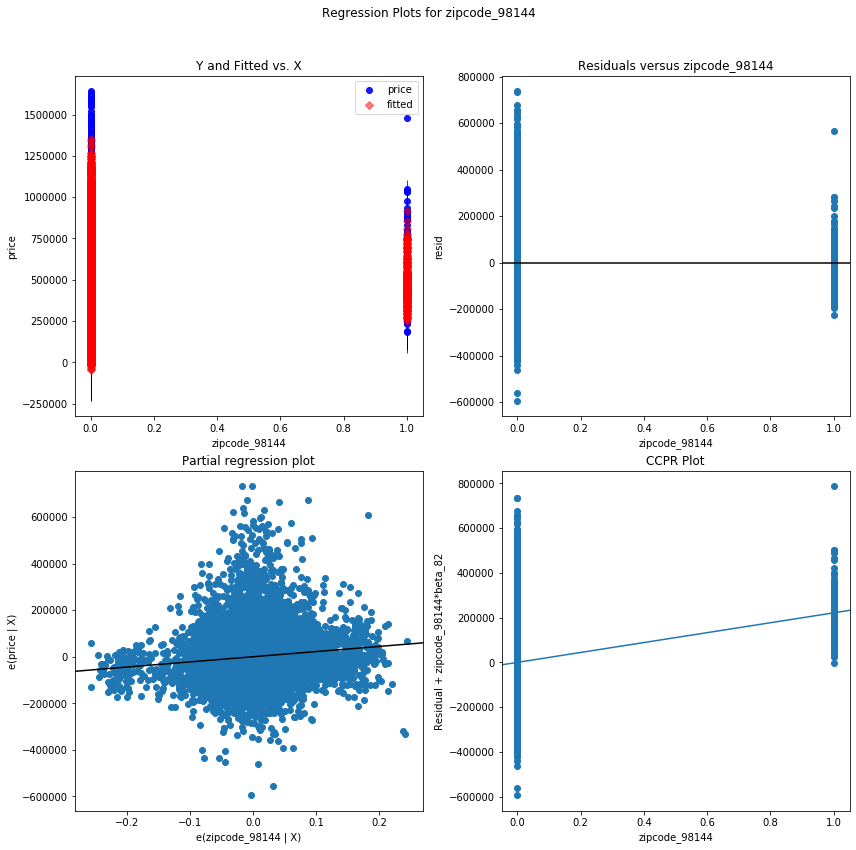

zipcode_98146 - Plotted


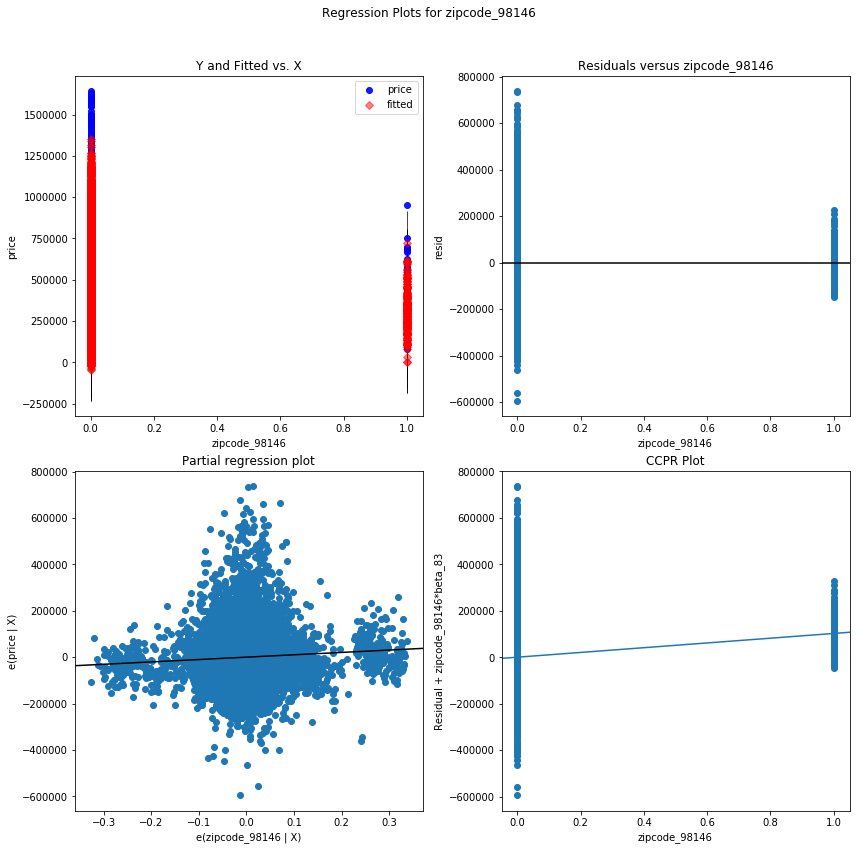

zipcode_98148 - Plotted


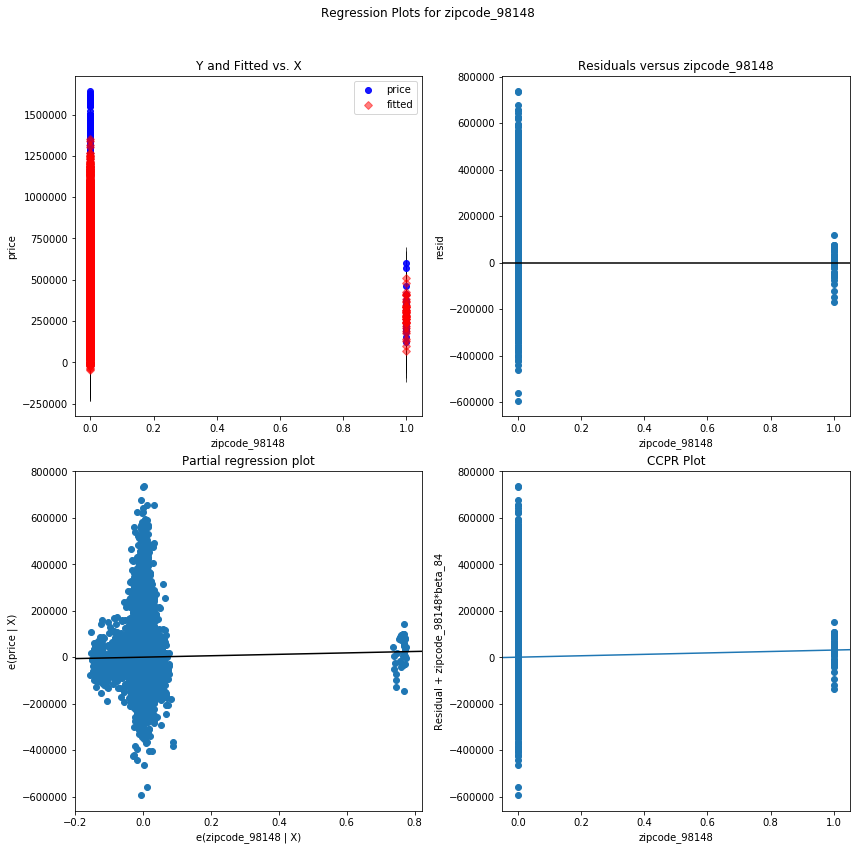

zipcode_98155 - Plotted


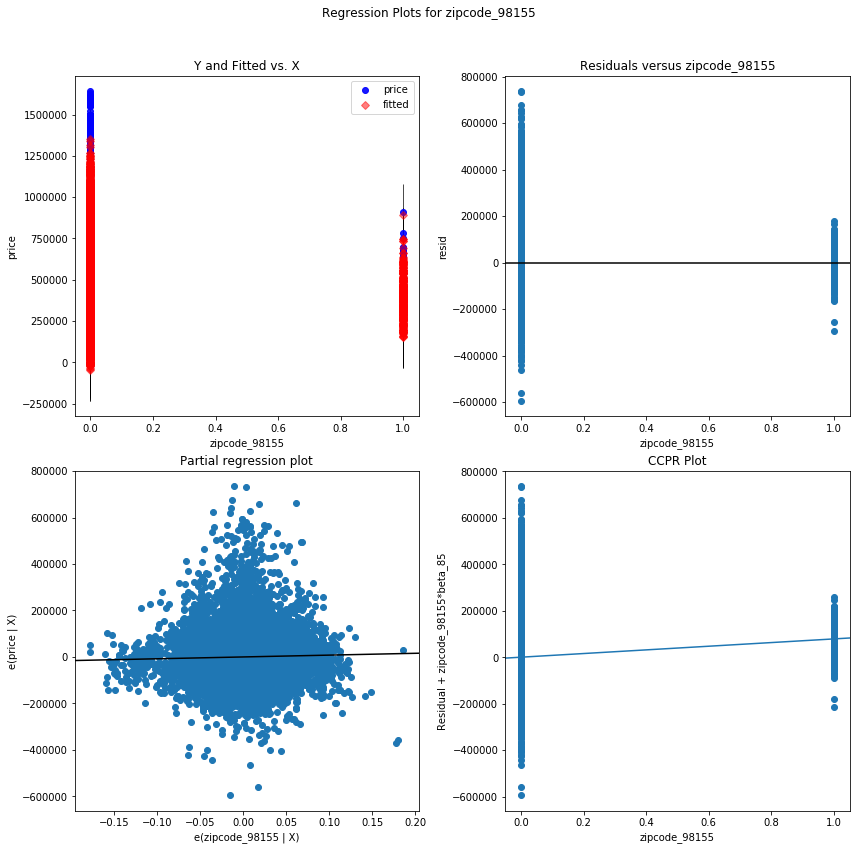

zipcode_98166 - Plotted


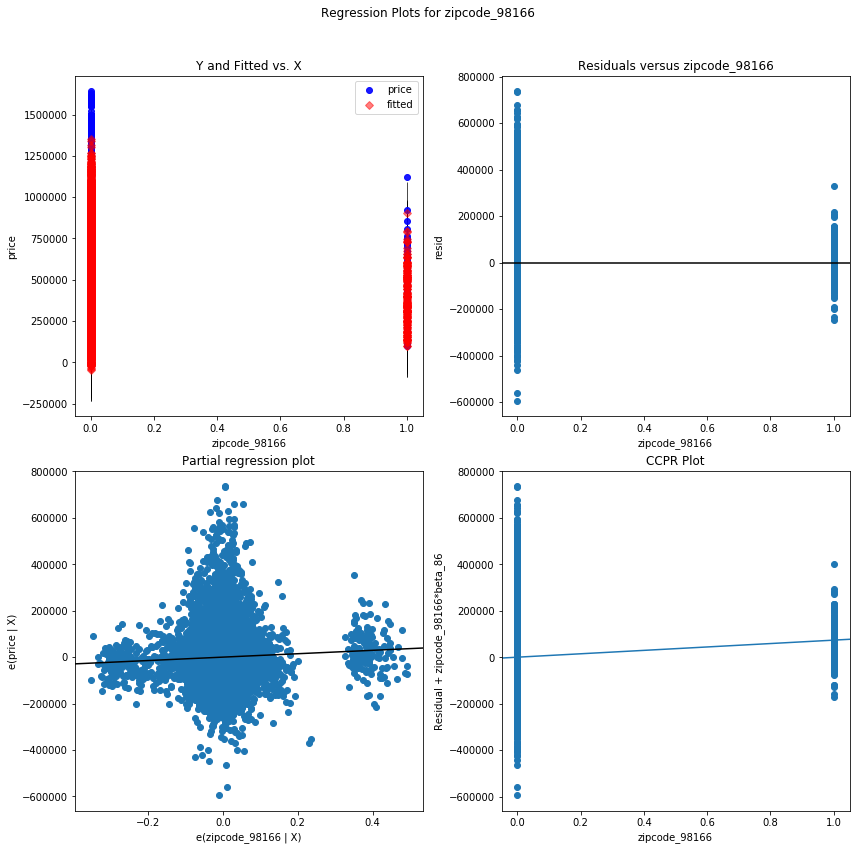

zipcode_98168 - Plotted


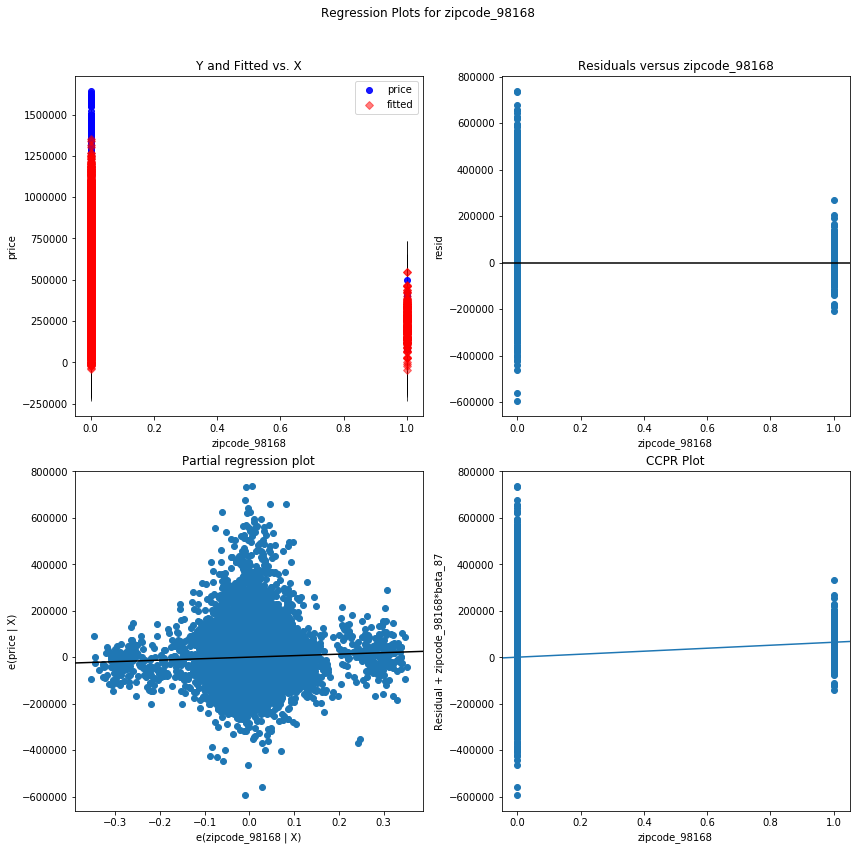

zipcode_98177 - Plotted


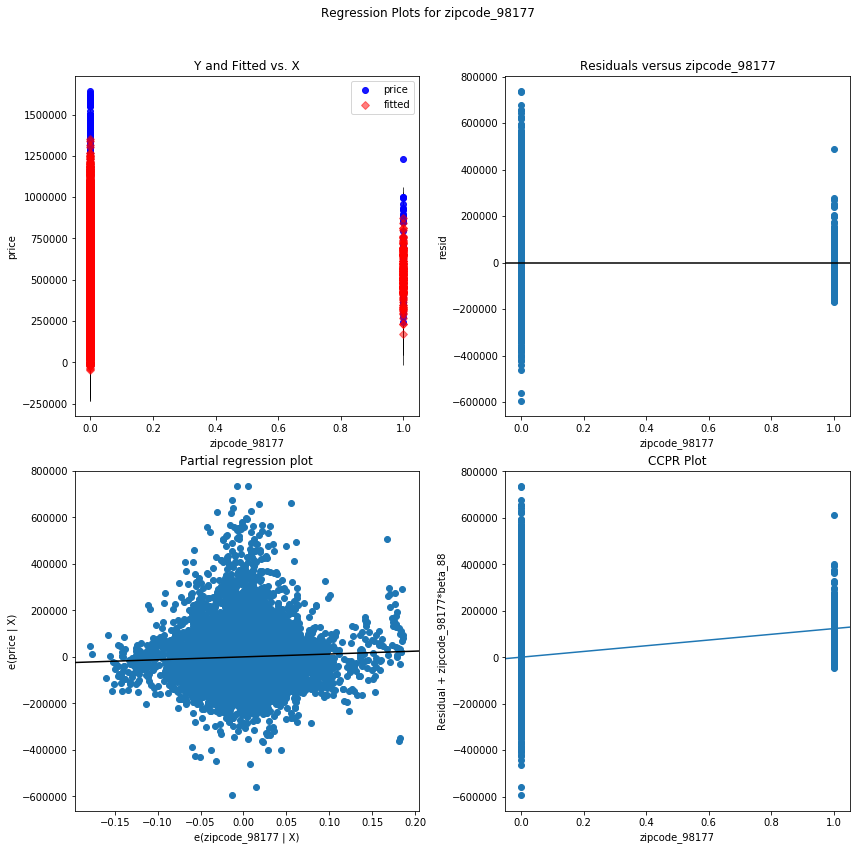

zipcode_98178 - Plotted


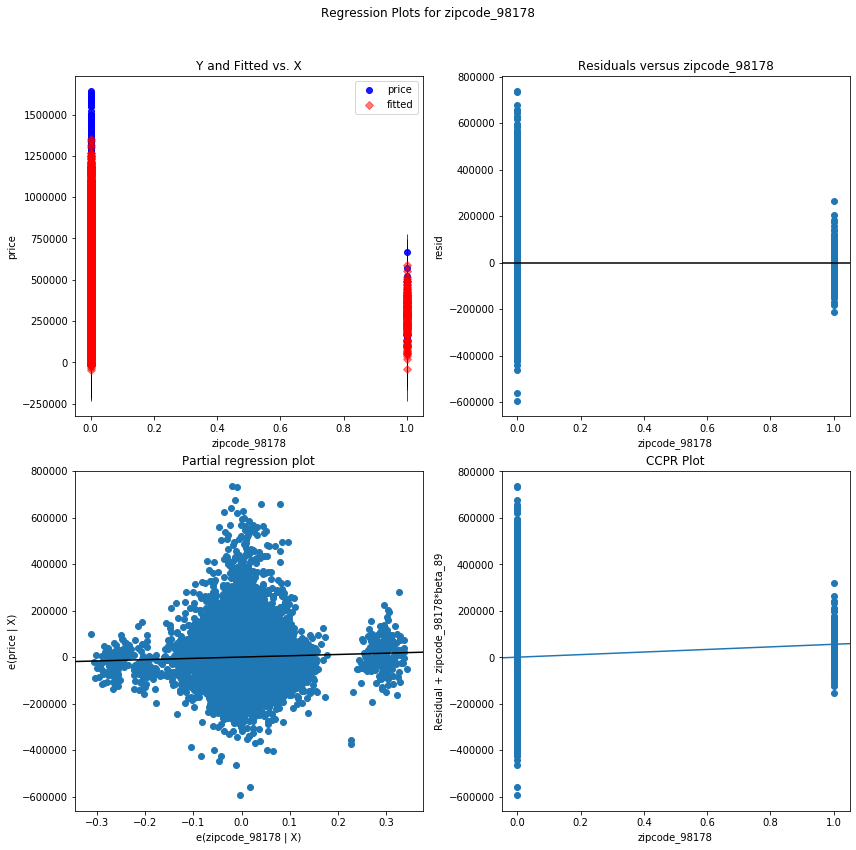

zipcode_98188 - Plotted


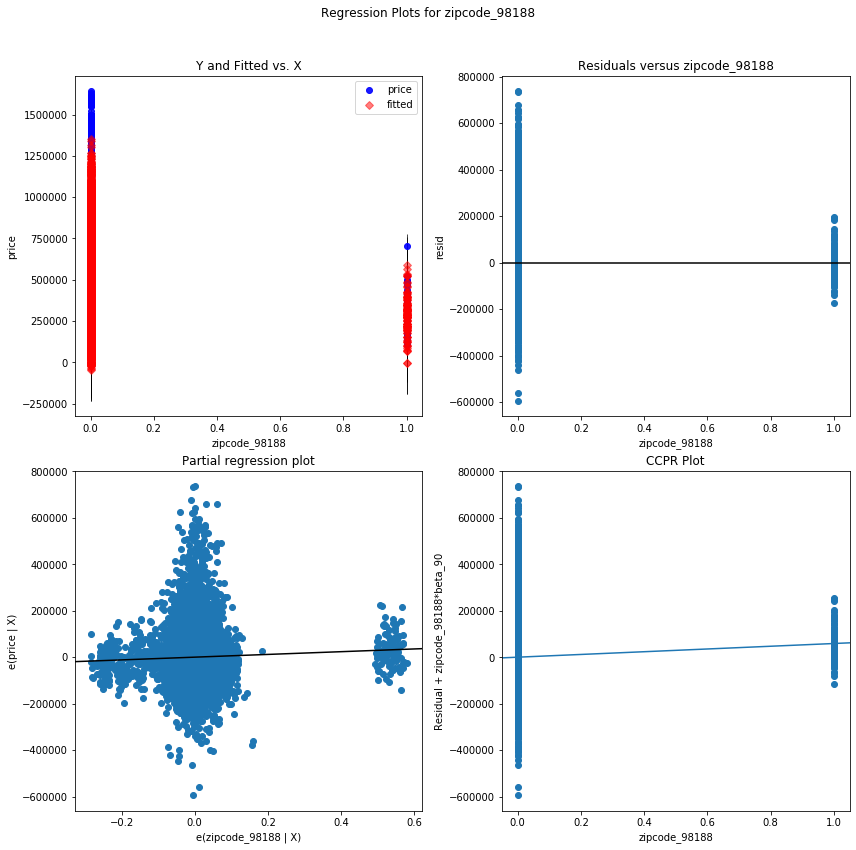

zipcode_98198 - Plotted


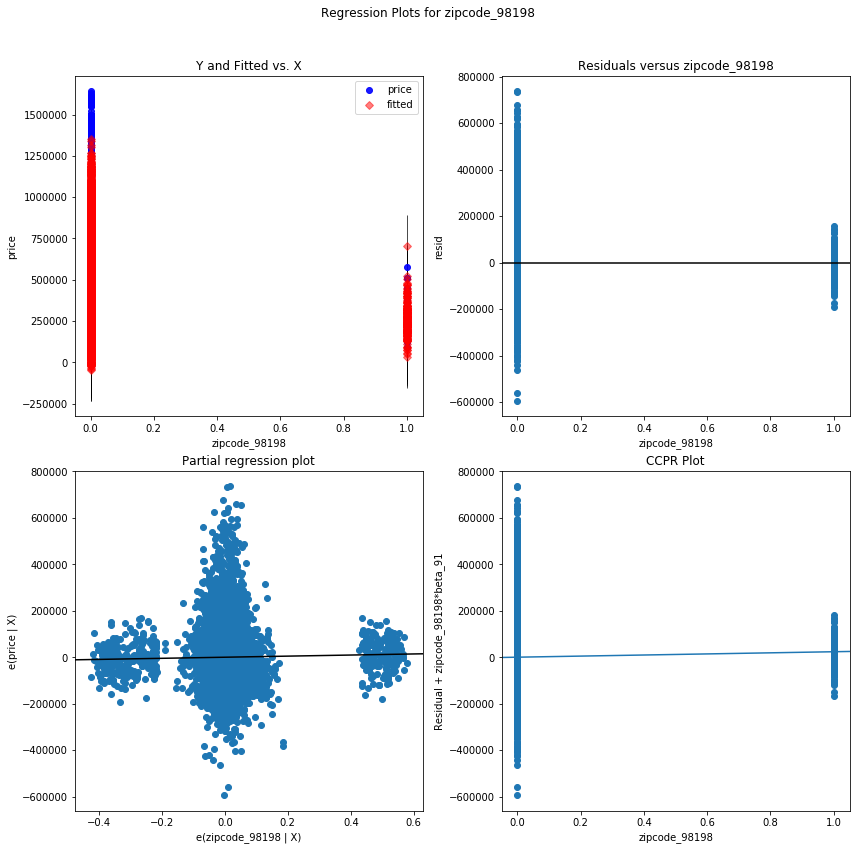

zipcode_98199 - Plotted


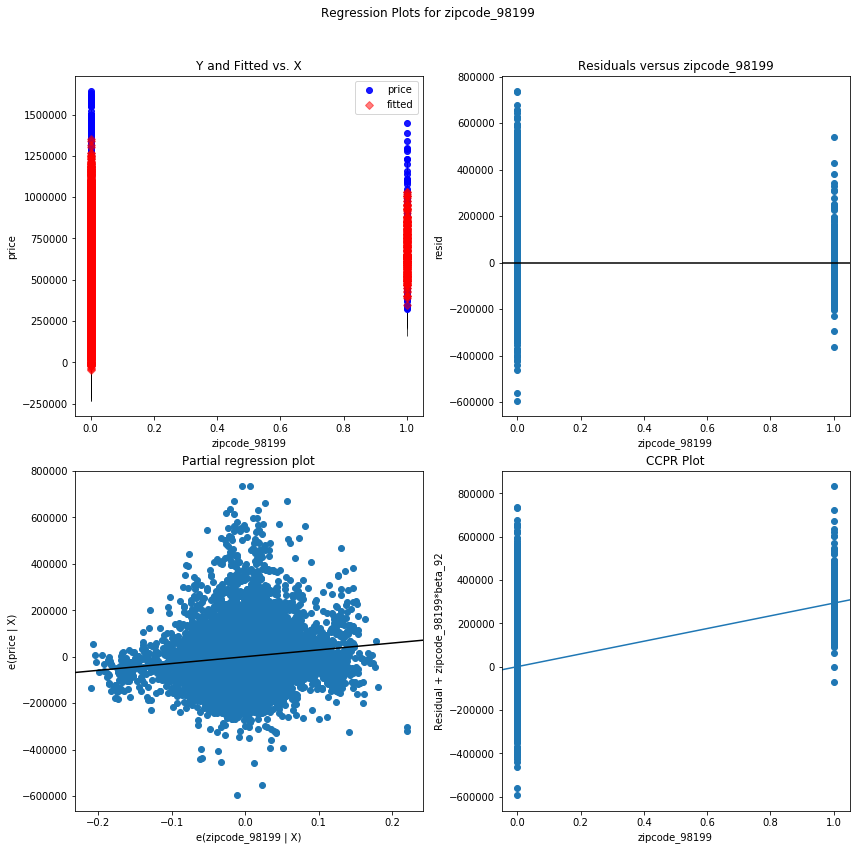

In [21]:
results_multi_bm_std, dfs_coeffs_multi_bm_std, summaries_multi_bm_std, models_multi_bm_std, X_train_models_multi_bm_std, X_test_models_multi_bm_std, y_train_models_multi_bm_std, y_test_models_multi_bm_std, columns_models_multi_bm_std  = run_model(b_pro_std_out, target_pro_noout, 'multilinear_noout', 10, plots=True )

In [47]:
summaries_multi_bm_std

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.827
Model:                            OLS   Adj. R-squared:                  0.826
Method:                 Least Squares   F-statistic:                     786.9
Date:                Mon, 22 Jun 2020   Prob (F-statistic):               0.00
Time:                        16:57:30   Log-Likelihood:            -1.9373e+05
No. Observations:               15034   AIC:                         3.876e+05
Df Residuals:                   14942   BIC:                         3.883e+05
Df Model:                          91                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
waterfront         -2.57e+06   5.73e+04    -44.809      0.000   -2.68e+06   -2.46e+06
condition          1.628e+04    911.497     17.856      0.000    1.45e+04    1.81e+04
grade              5.834e+04   1398.483     41.717      0.000    5.56e+04    6.11e+04
yr_built          -6699.5007   1531.230     -4.375      0.000   -9700.900   -3698.102
lat                1.558e+04   6679.042      2.332      0.020    2485.092    2.87e+04
long              -2.426e+04   5852.914     -4.145      0.000   -3.57e+04   -1.28e+04
renovated           2.24e-09   1.03e-10     21.808      0.000    2.04e-09    2.44e-09
log-bathrooms      4689.6780   3765.182      1.246      0.213   -2690.540    1.21e+04
log-sqft_living    6.751e+04   9371.690      7.204      0.000    4.91e+04    8.59e+04
log-sqft_lot       3.404e+04   2731.606     12.463      0.000    2.87e+04    3.94e+04
log-sqft_above      1.44e+05   9172.354     15.702      0.000    1.26e+05    1.62e+05
log-sqft_basement  4176.0267    609.038      6.857      0.000    2982.237    5369.816
log-sqft_living15   3.15e+04   4516.415      6.974      0.000    2.26e+04    4.03e+04
log-sqft_lot15    -6306.6721   2967.530     -2.125      0.034   -1.21e+04    -489.950
log-MHI            7.811e+04   3852.932     20.273      0.000    7.06e+04    8.57e+04
bedrooms_2.0      -5.495e+04   9300.076     -5.908      0.000   -7.32e+04   -3.67e+04
bedrooms_3.0      -7.425e+04   9335.440     -7.954      0.000   -9.25e+04    -5.6e+04
bedrooms_4.0      -6.901e+04   9611.793     -7.180      0.000   -8.79e+04   -5.02e+04
bedrooms_5.0      -6.326e+04   1.01e+04     -6.241      0.000   -8.31e+04   -4.34e+04
bedrooms_6.0      -7.423e+04   1.26e+04     -5.882      0.000    -9.9e+04   -4.95e+04
floors_1.5        -5928.5044   3328.780     -1.781      0.075   -1.25e+04     596.314
floors_2.0         -462.8972   2859.570     -0.162      0.871   -6068.005    5142.210
floors_2.5         3.984e+04   1.11e+04      3.595      0.000    1.81e+04    6.16e+04
floors_3.0        -3.693e+04   6118.454     -6.035      0.000   -4.89e+04   -2.49e+04
view_2.0           6.489e+04   4228.222     15.346      0.000    5.66e+04    7.32e+04
zipcode_98002      5.634e+04   1.01e+04      5.566      0.000    3.65e+04    7.62e+04
zipcode_98003      3528.0673   8666.098      0.407      0.684   -1.35e+04    2.05e+04
zipcode_98004      5.406e+05   1.79e+04     30.157      0.000    5.05e+05    5.76e+05
zipcode_98005      2.922e+05   1.88e+04     15.534      0.000    2.55e+05    3.29e+05
zipcode_98006      2.326e+05    1.6e+04     14.571      0.000    2.01e+05    2.64e+05
zipcode_98007       2.39e+05   1.96e+04     12.210      0.000    2.01e+05    2.77e+05
zipcode_98008      2.107e+05   1.92e+04     10.991      0.000    1.73e+05    2.48e+05
zipcode_98010      1.048e+05   1.85e+04      5.677      0.000    6.86e+04

In [48]:
columns_todrop = ['log-bathrooms', 'log-sqft_lot15', 'floors_1.5', 'floors_2.0', 'zipcode_98003', 'zipcode_98019', 'zipcode_98031', 'zipcode_98031', 'zipcode_98032', 'zipcode_98042', 'zipcode_98070', 'zipcode_98148']

In [50]:
results_multi_bm_std, dfs_coeffs_multi_bm_std, summaries_multi_bm_std, models_multi_bm_std, X_train_models_multi_bm_std, X_test_models_multi_bm_std, y_train_models_multi_bm_std, y_test_models_multi_bm_std, columns_models_multi_bm_std  = run_model(b_pro_std_out.drop(columns_todrop, axis=1), target_pro_noout, 'multilinear_', 10, plots=False )

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


In [51]:
summaries_multi_bm_std

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.827
Model:                            OLS   Adj. R-squared:                  0.826
Method:                 Least Squares   F-statistic:                     894.6
Date:                Mon, 22 Jun 2020   Prob (F-statistic):               0.00
Time:                        17:45:12   Log-Likelihood:            -1.9374e+05
No. Observations:               15034   AIC:                         3.876e+05
Df Residuals:                   14953   BIC:                         3.883e+05
Df Model:                          80                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
waterfront         -2.57e+06   5.37e+04    -47.882      0.000   -2.68e+06   -2.46e+06
condition          1.629e+04    901.732     18.068      0.000    1.45e+04    1.81e+04
grade              5.822e+04   1392.273     41.815      0.000    5.55e+04    6.09e+04
yr_built          -5180.5427   1325.986     -3.907      0.000   -7779.637   -2581.448
lat                 2.82e+04   3368.218      8.372      0.000    2.16e+04    3.48e+04
long              -2.354e+04   3148.146     -7.477      0.000   -2.97e+04   -1.74e+04
renovated          1.623e-08   3.28e-10     49.457      0.000    1.56e-08    1.69e-08
log-sqft_living    7.058e+04   9165.727      7.700      0.000    5.26e+04    8.85e+04
log-sqft_lot       2.966e+04   1561.337     18.996      0.000    2.66e+04    3.27e+04
log-sqft_above     1.429e+05   8772.661     16.293      0.000    1.26e+05     1.6e+05
log-sqft_basement  4234.6717    606.621      6.981      0.000    3045.621    5423.723
log-sqft_living15  3.062e+04   4479.122      6.835      0.000    2.18e+04    3.94e+04
log-MHI            7.846e+04   3808.364     20.603      0.000     7.1e+04    8.59e+04
bedrooms_2.0      -5.475e+04   9292.833     -5.892      0.000    -7.3e+04   -3.65e+04
bedrooms_3.0       -7.44e+04   9318.728     -7.984      0.000   -9.27e+04   -5.61e+04
bedrooms_4.0      -6.932e+04   9592.818     -7.226      0.000   -8.81e+04   -5.05e+04
bedrooms_5.0      -6.344e+04   1.01e+04     -6.280      0.000   -8.32e+04   -4.36e+04
bedrooms_6.0      -7.329e+04   1.26e+04     -5.823      0.000    -9.8e+04   -4.86e+04
floors_2.5         4.148e+04   1.08e+04      3.858      0.000    2.04e+04    6.25e+04
floors_3.0        -3.537e+04   5401.518     -6.548      0.000    -4.6e+04   -2.48e+04
view_2.0           6.533e+04   4226.345     15.457      0.000     5.7e+04    7.36e+04
zipcode_98002      5.212e+04   8532.794      6.109      0.000    3.54e+04    6.88e+04
zipcode_98004      5.087e+05   9678.336     52.564      0.000     4.9e+05    5.28e+05
zipcode_98005      2.605e+05   1.04e+04     25.066      0.000     2.4e+05    2.81e+05
zipcode_98006      2.057e+05   7291.280     28.218      0.000    1.91e+05     2.2e+05
zipcode_98007      2.078e+05   1.09e+04     19.137      0.000    1.86e+05    2.29e+05
zipcode_98008      1.789e+05   8639.031     20.707      0.000    1.62e+05    1.96e+05
zipcode_98010       9.49e+04   1.42e+04      6.695      0.000    6.71e+04    1.23e+05
zipcode_98011       4.42e+04   1.22e+04      3.610      0.000    2.02e+04    6.82e+04
zipcode_98014      6.968e+04   1.48e+04      4.700      0.000    4.06e+04    9.87e+04
zipcode_98022      8.184e+04   1.21e+04      6.779      0.000    5.82e+04    1.05e+05
zipcode_98023     -4.145e+04   6418.346     -6.459      0.000    -5.4e+04   -2.89e+04
zipcode_98024      1.221e+05    1.7e+04      7.177      0.000    8.88e+04

In [130]:
columns_todrop = ['log-bathrooms', 'log-sqft_lot15', 'floors_1.5', 'floors_2.0', 'zipcode_98003', 'zipcode_98019', 'zipcode_98031', 'zipcode_98031', 'zipcode_98032', 'zipcode_98042', 'zipcode_98070', 'zipcode_98148', 'zipcode_98028', 'zipcode_98058', 'zipcode_98198']

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/linalg/linalg.py:2093: RuntimeWarning: overflow encountered in det
  r = _umath_linalg.det(a, signature=signature)


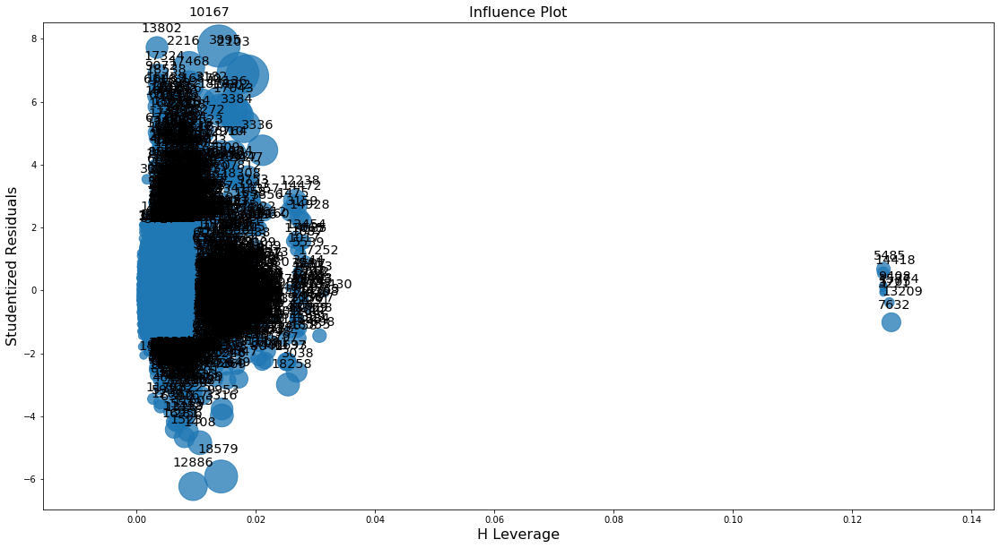

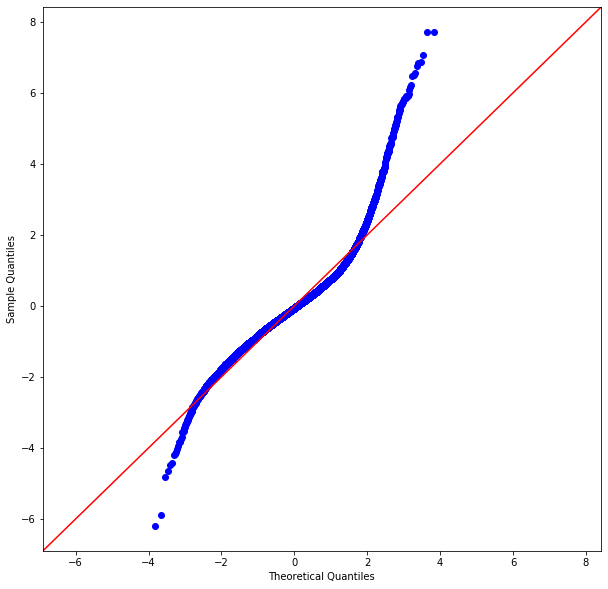

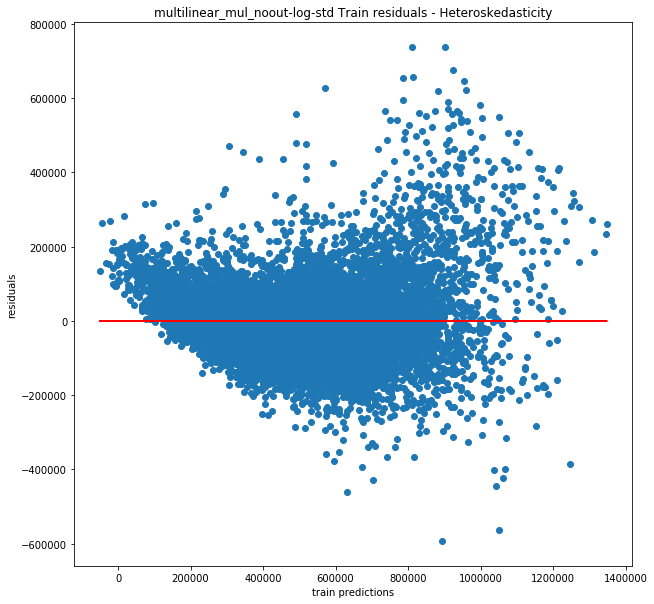

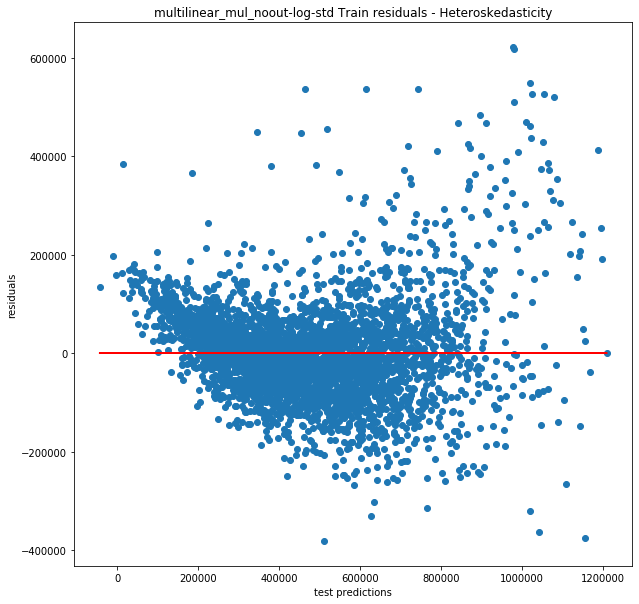

waterfront - Plotted


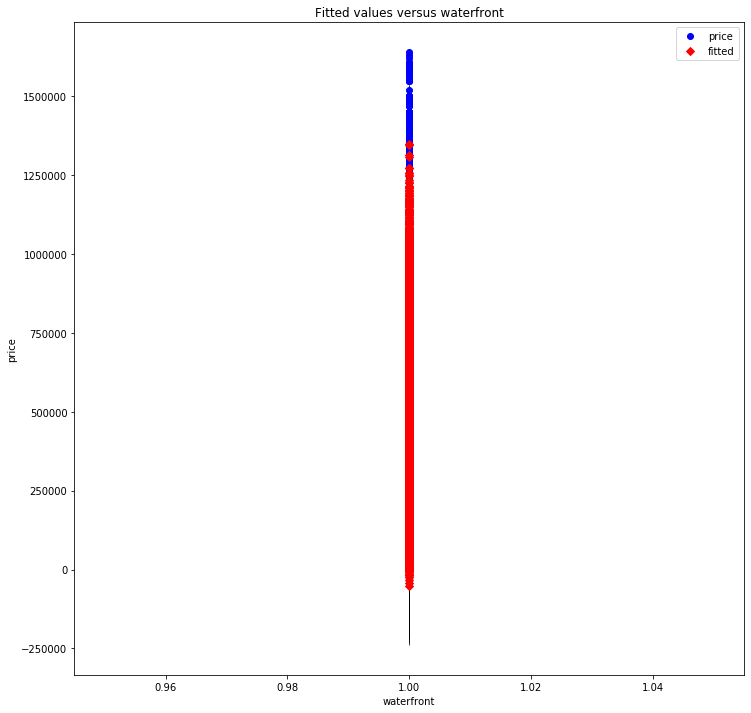

condition - Plotted


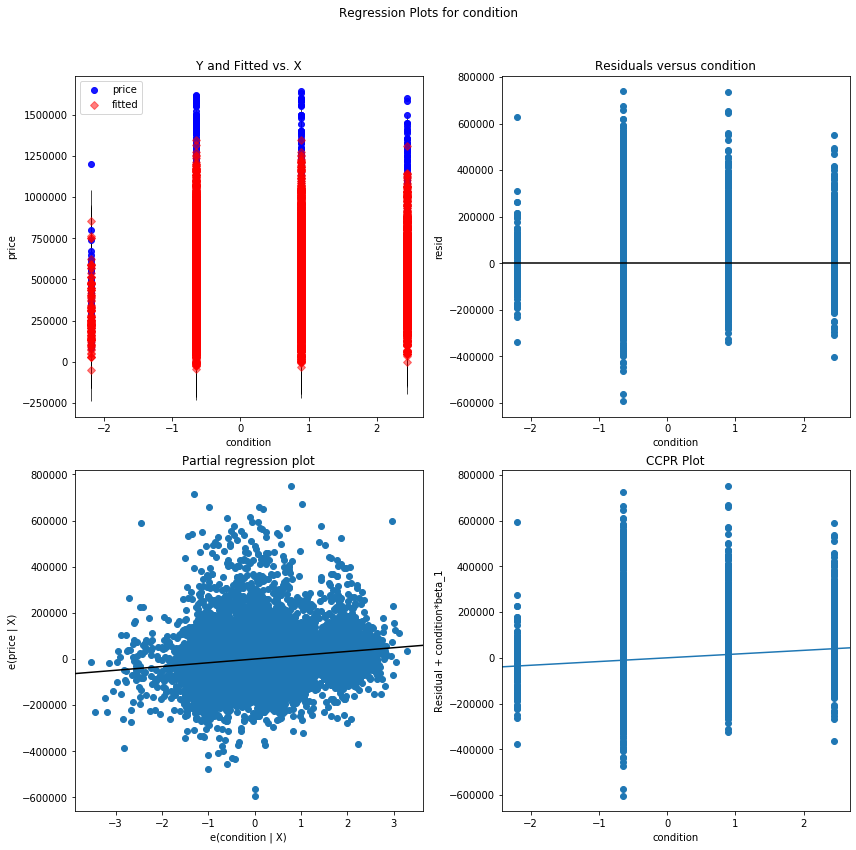

grade - Plotted


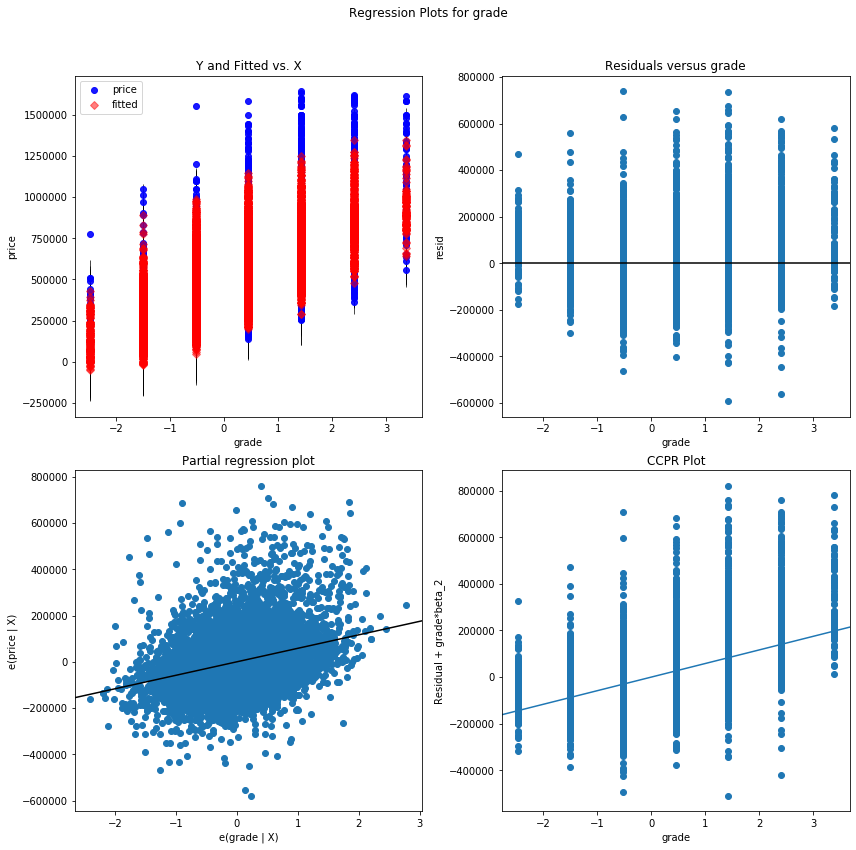

yr_built - Plotted


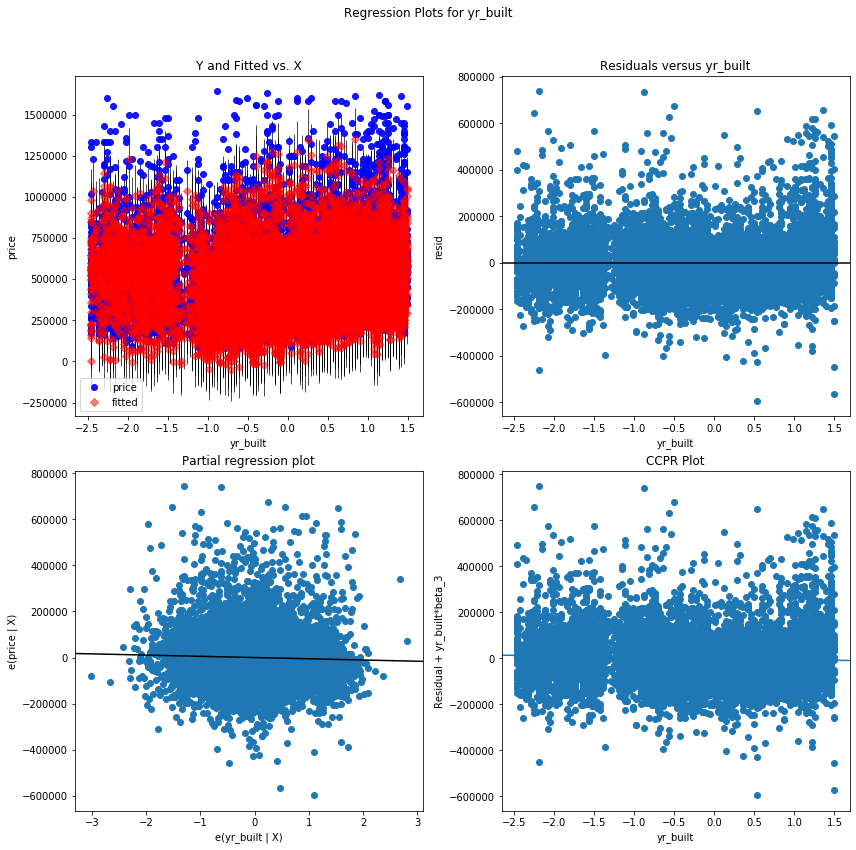

lat - Plotted


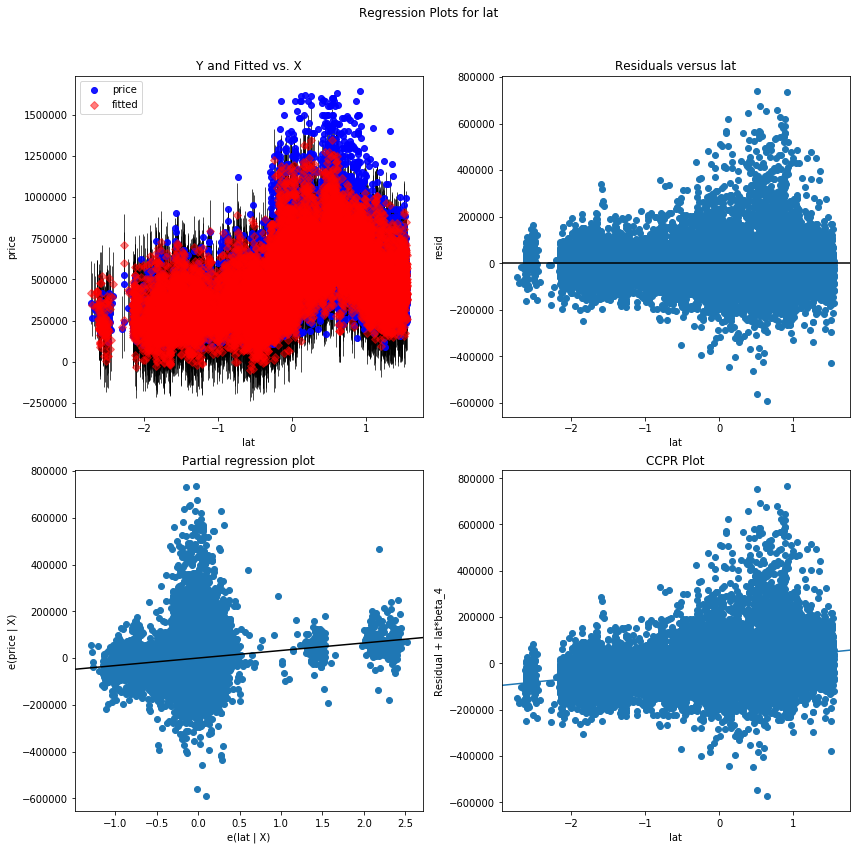

long - Plotted


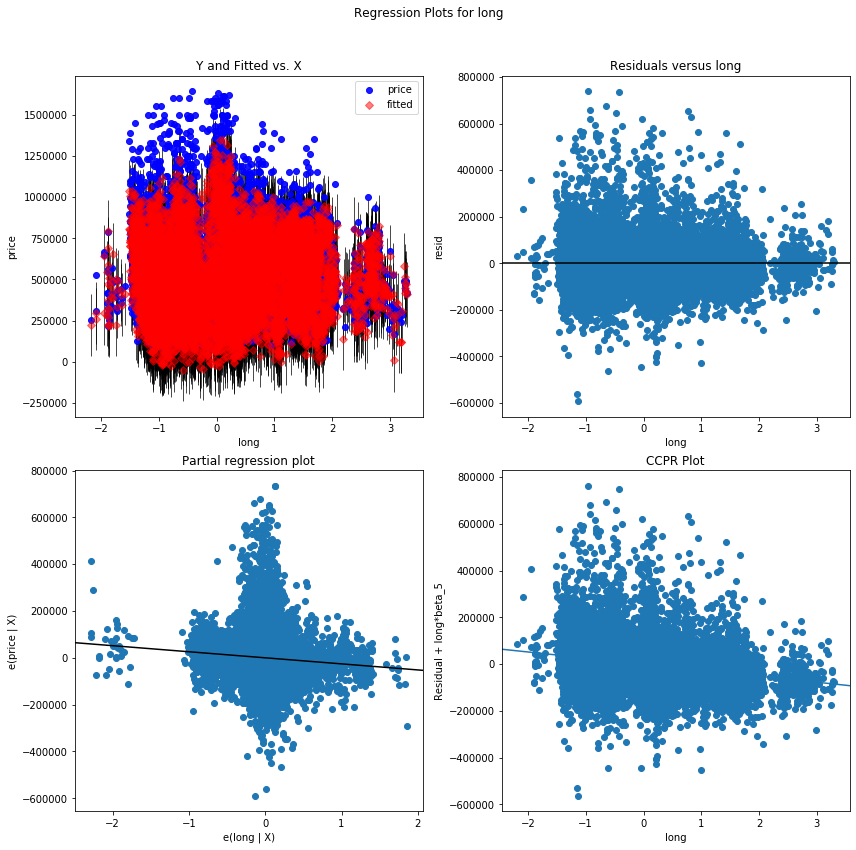

renovated - Plotted


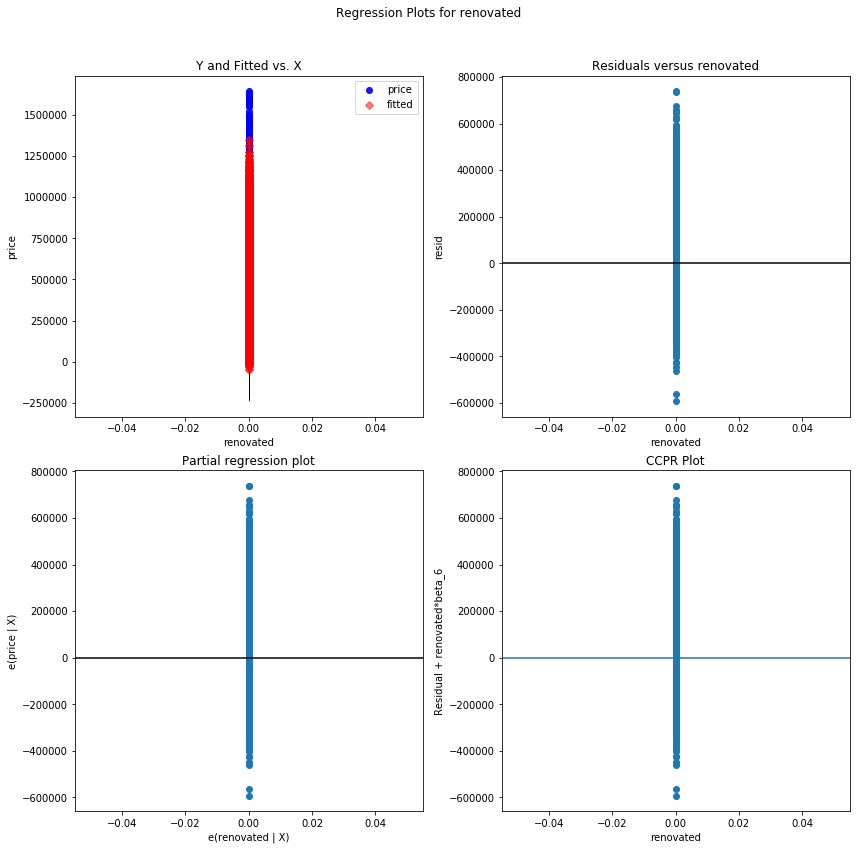

log-sqft_living - Plotted


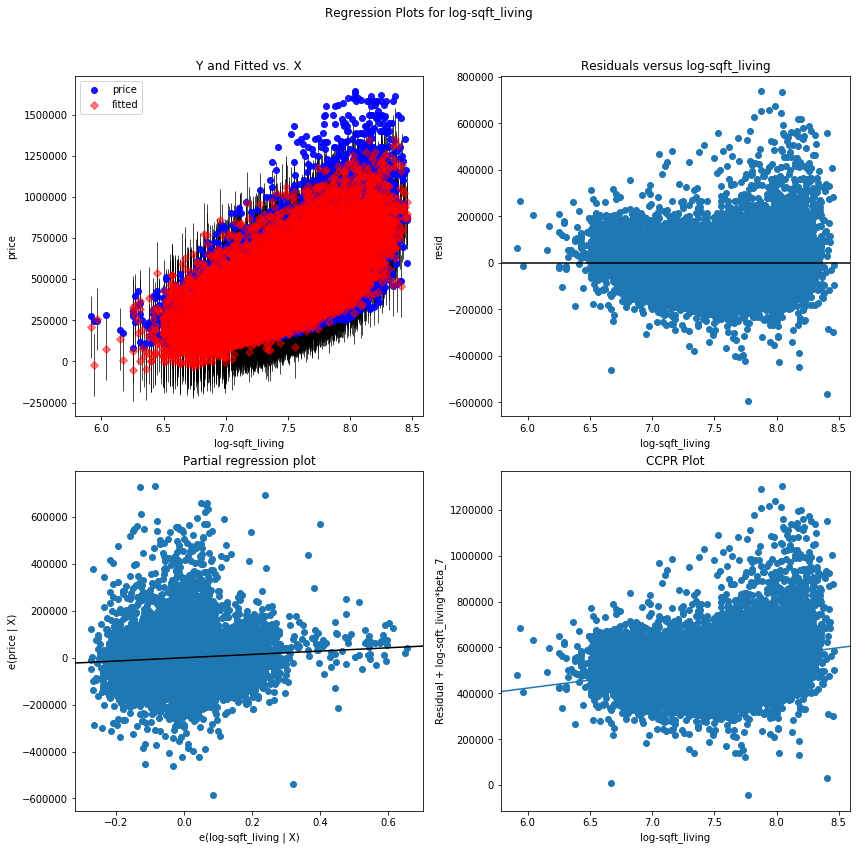

log-sqft_lot - Plotted


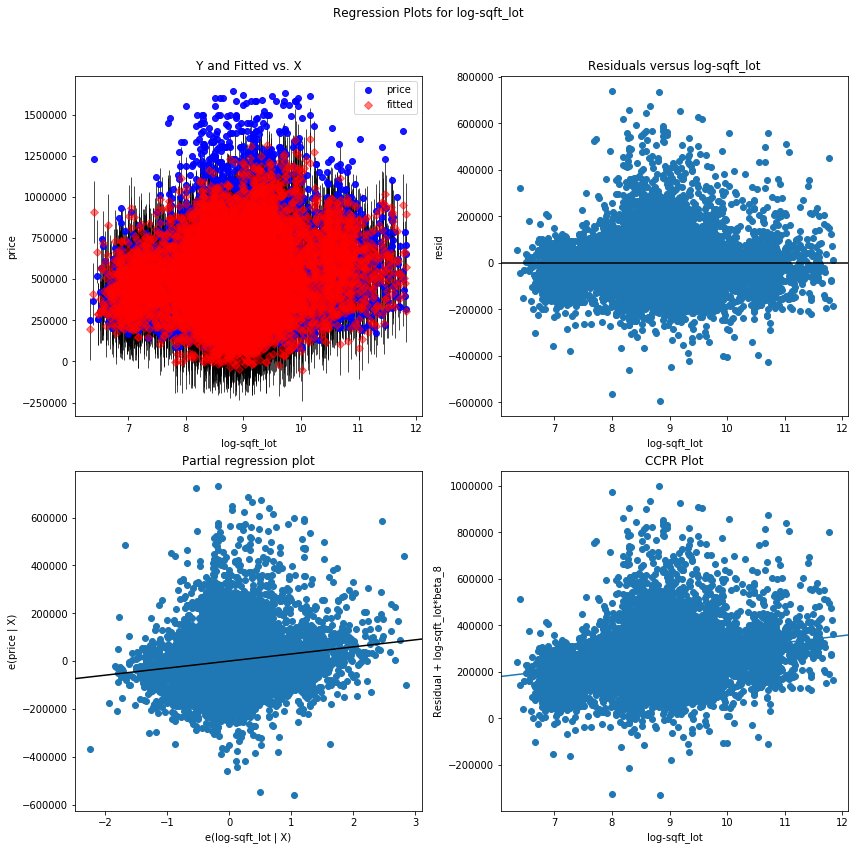

log-sqft_above - Plotted


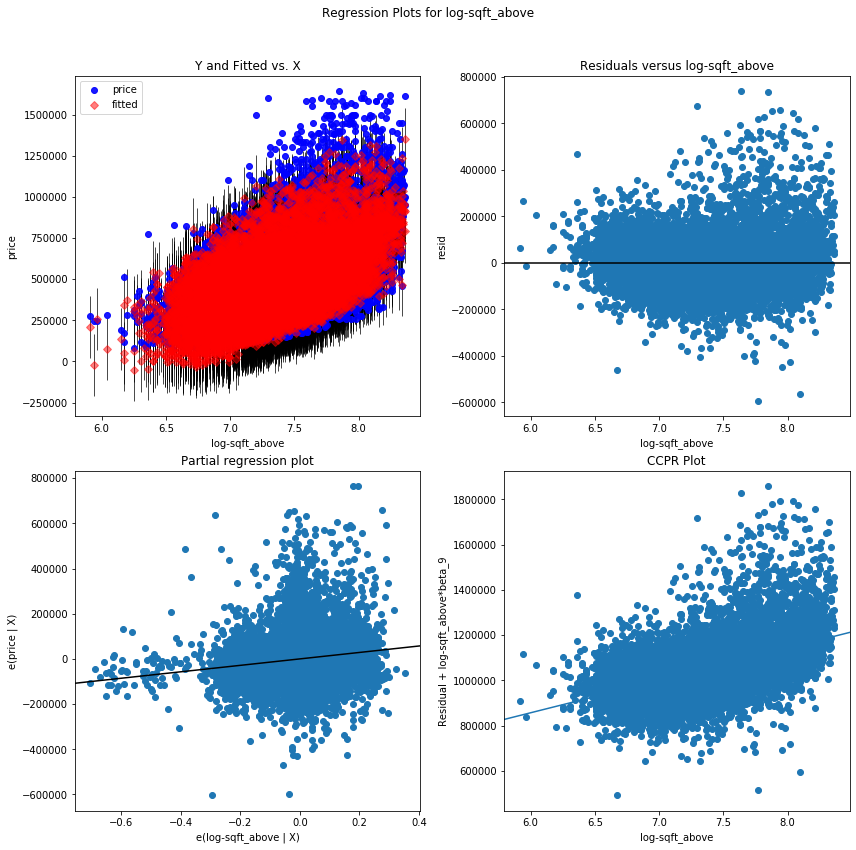

log-sqft_basement - Plotted


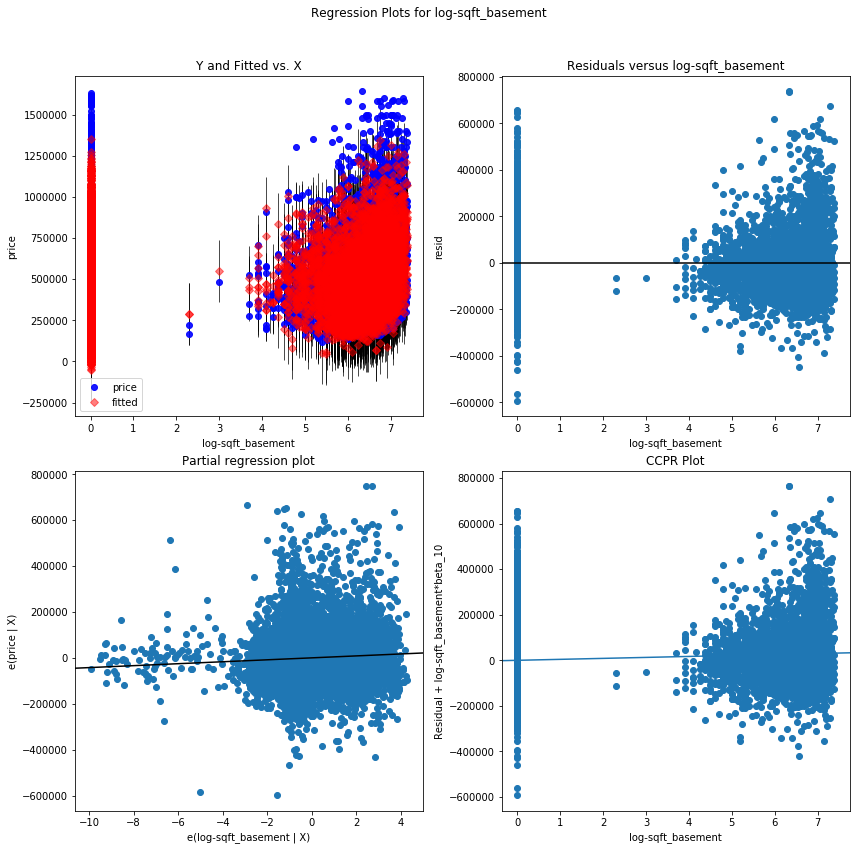

log-sqft_living15 - Plotted


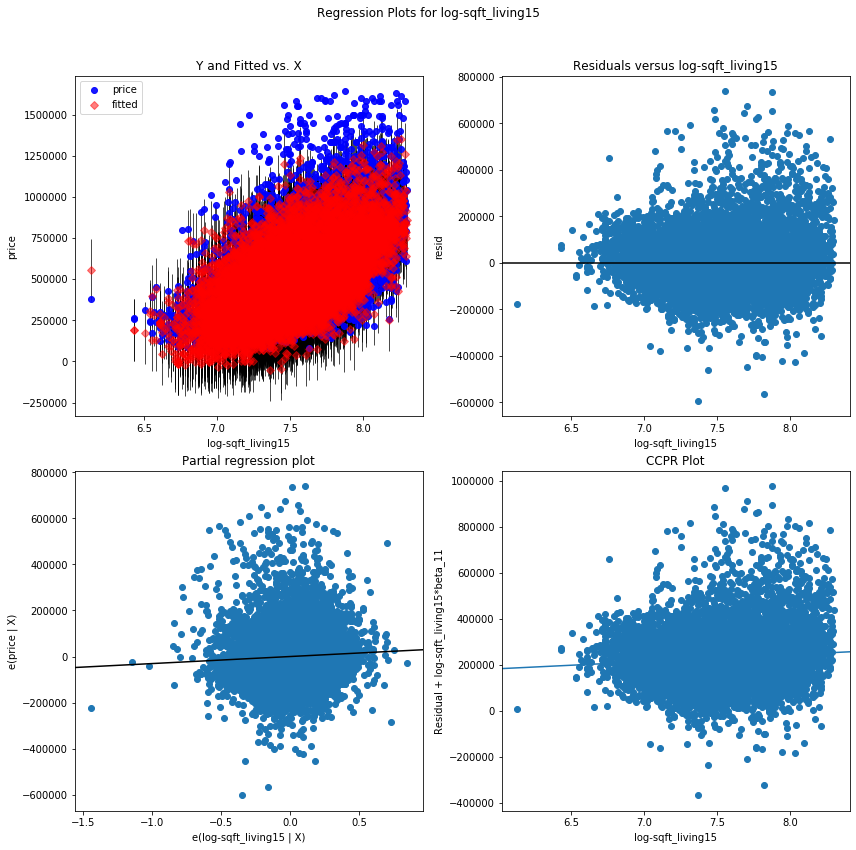

log-MHI - Plotted


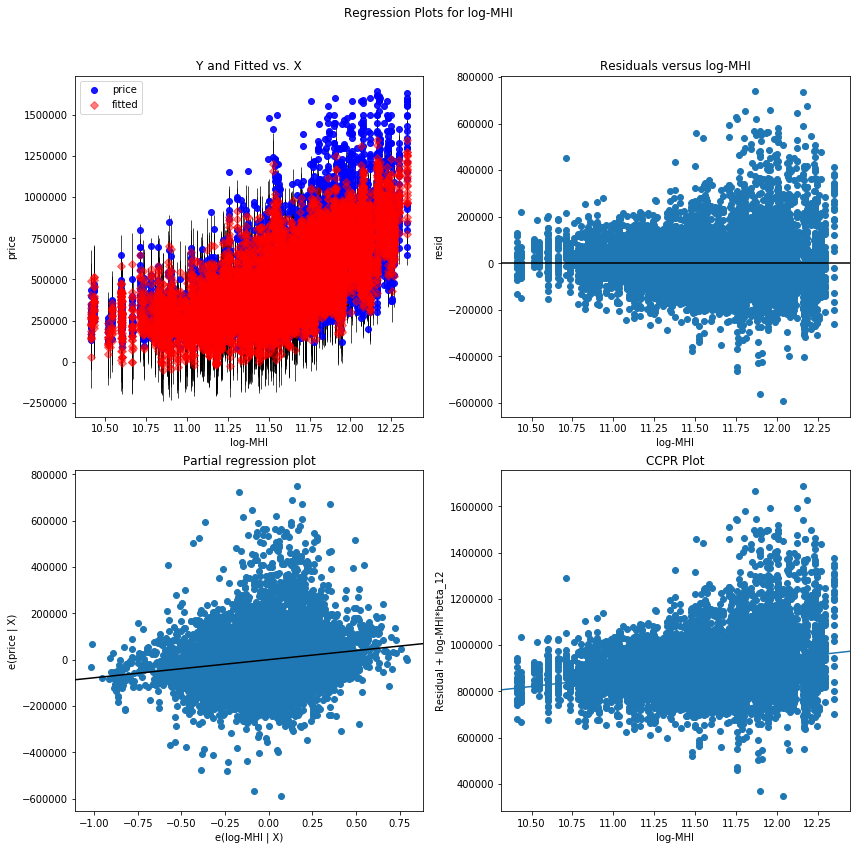

bedrooms_2.0 - Plotted


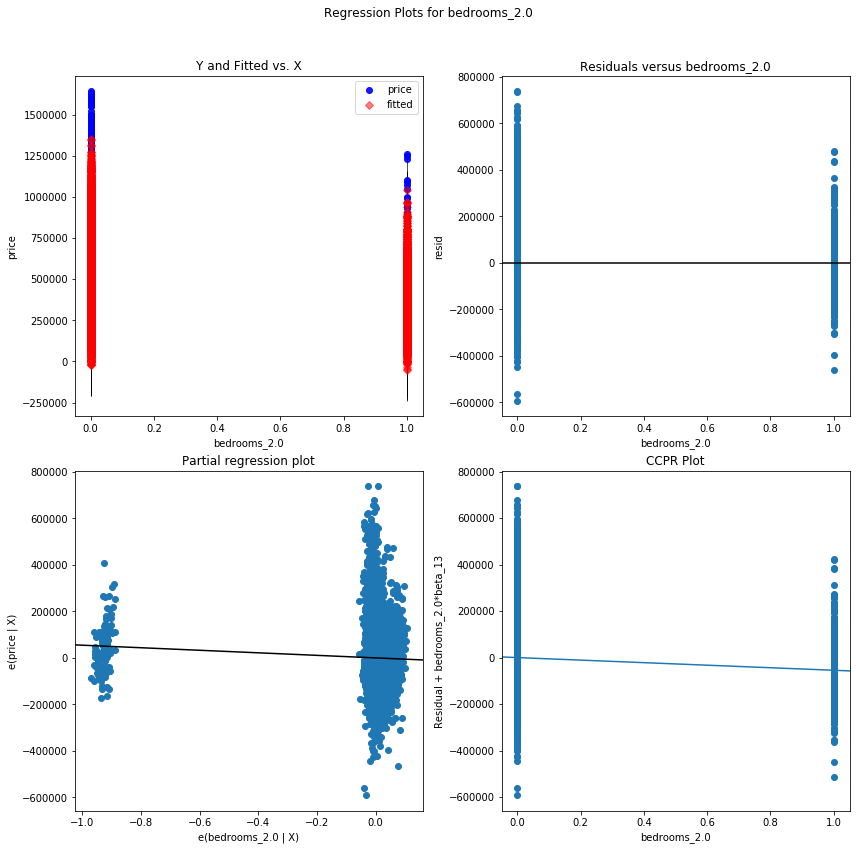

bedrooms_3.0 - Plotted


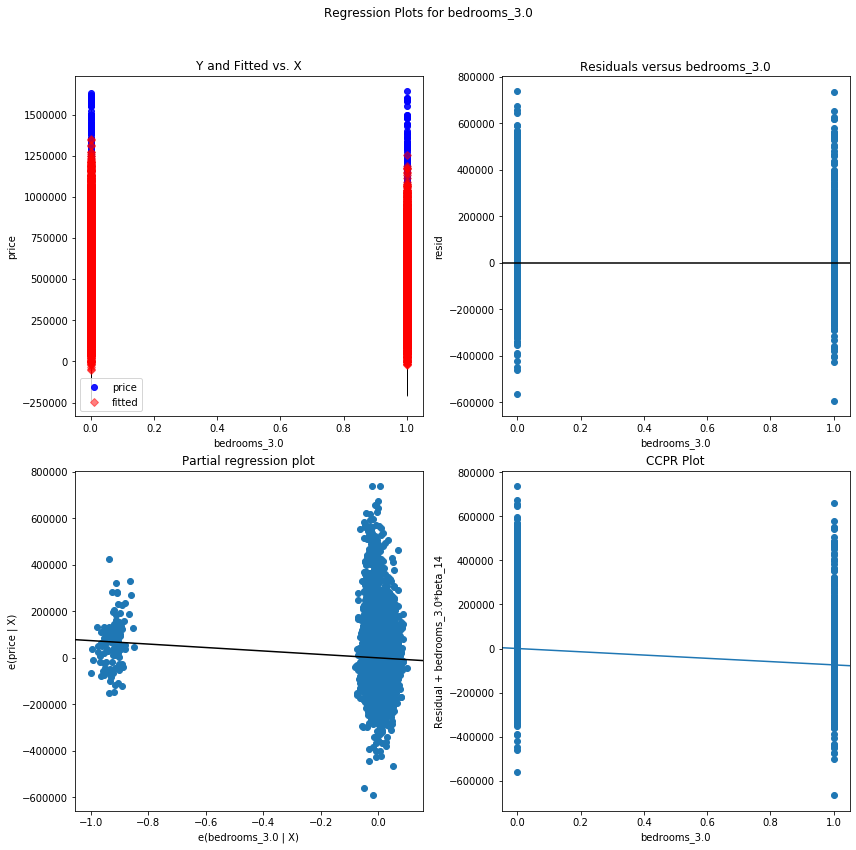

bedrooms_4.0 - Plotted


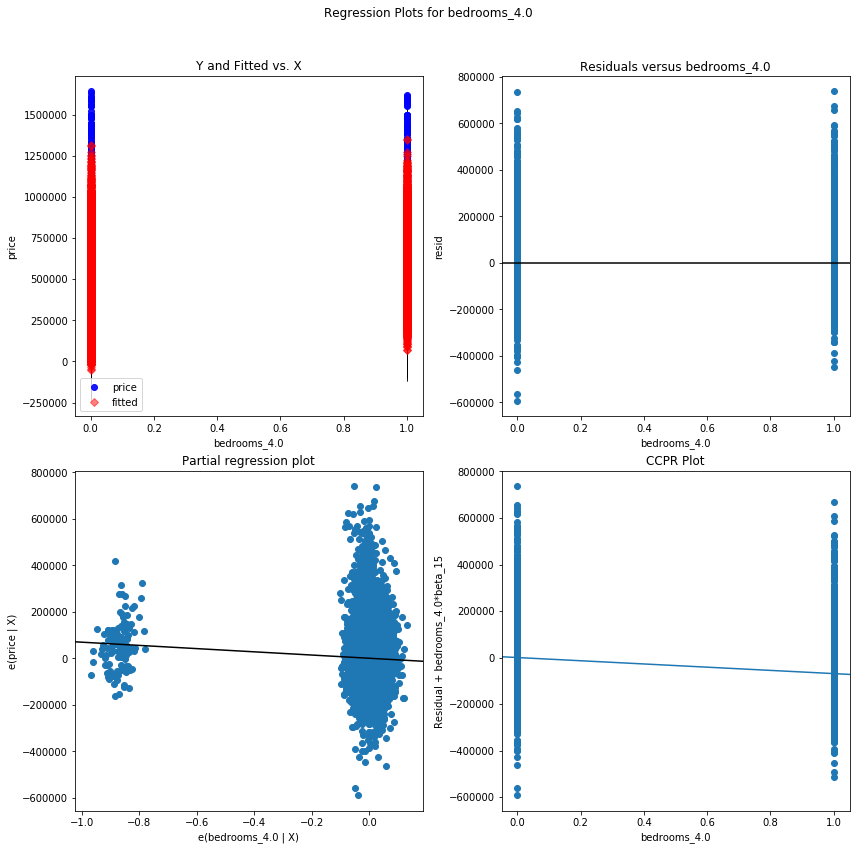

bedrooms_5.0 - Plotted


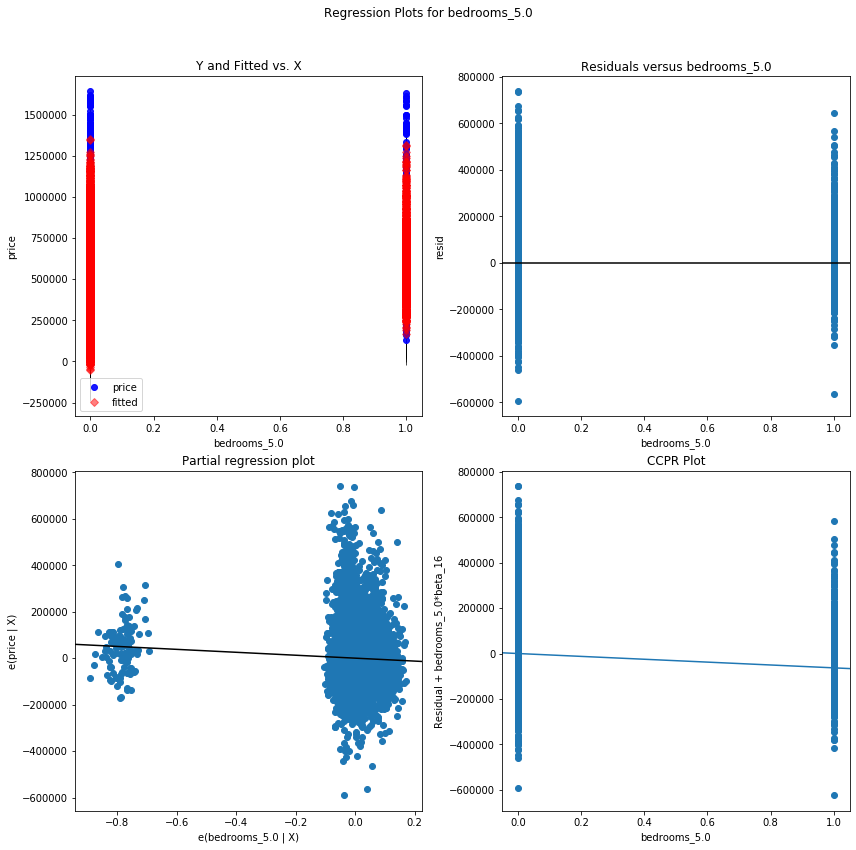

bedrooms_6.0 - Plotted


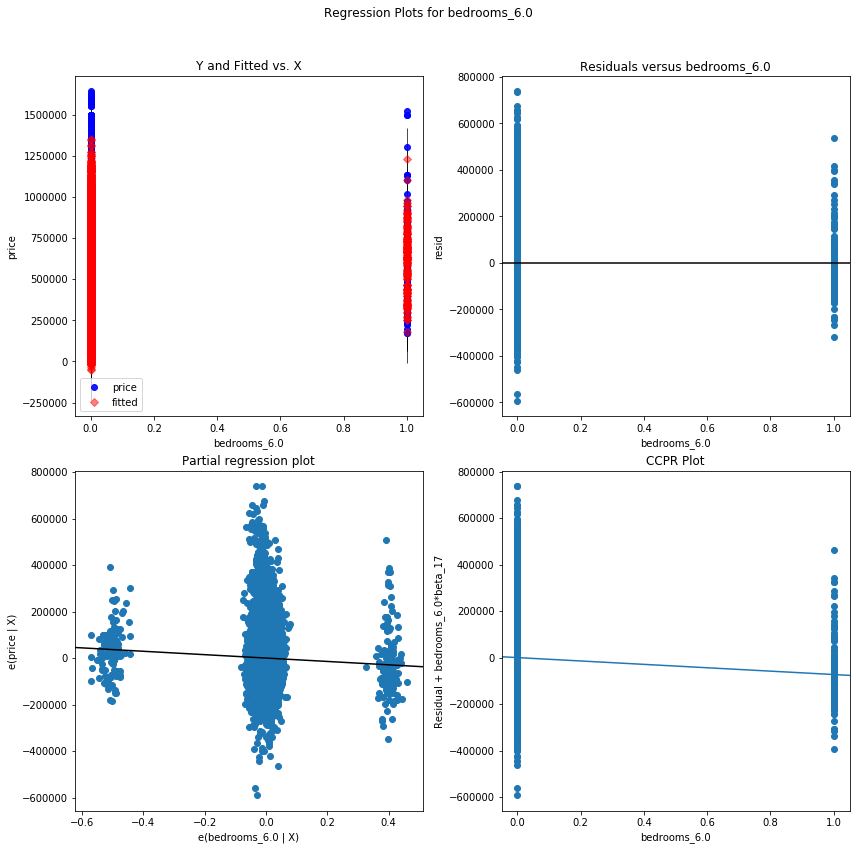

floors_2.5 - Plotted


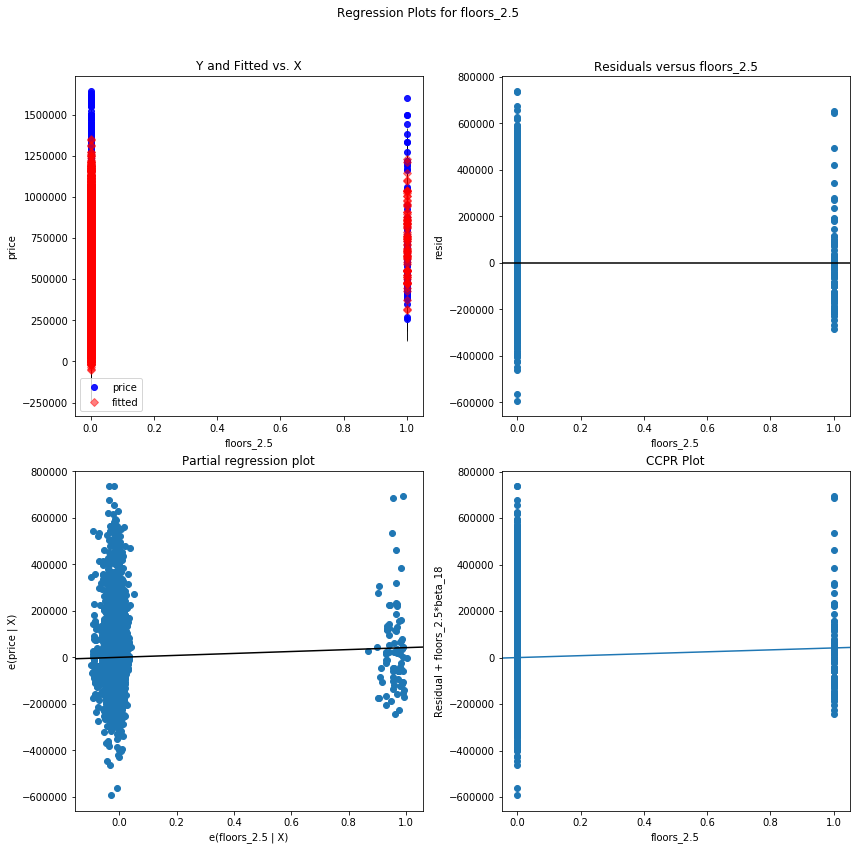

floors_3.0 - Plotted


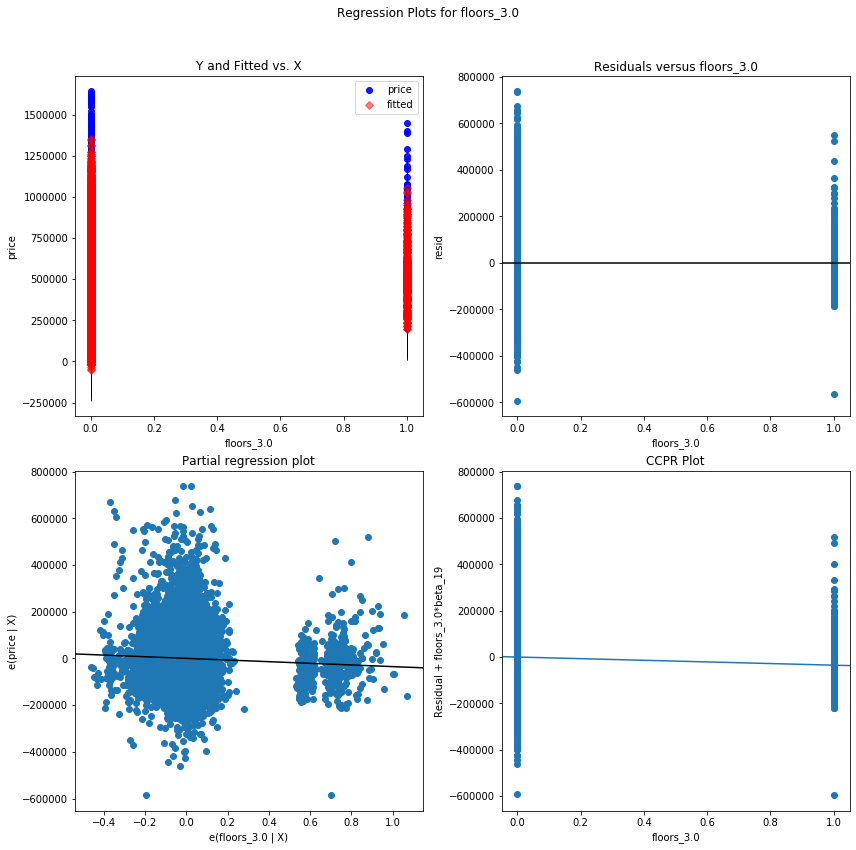

view_2.0 - Plotted


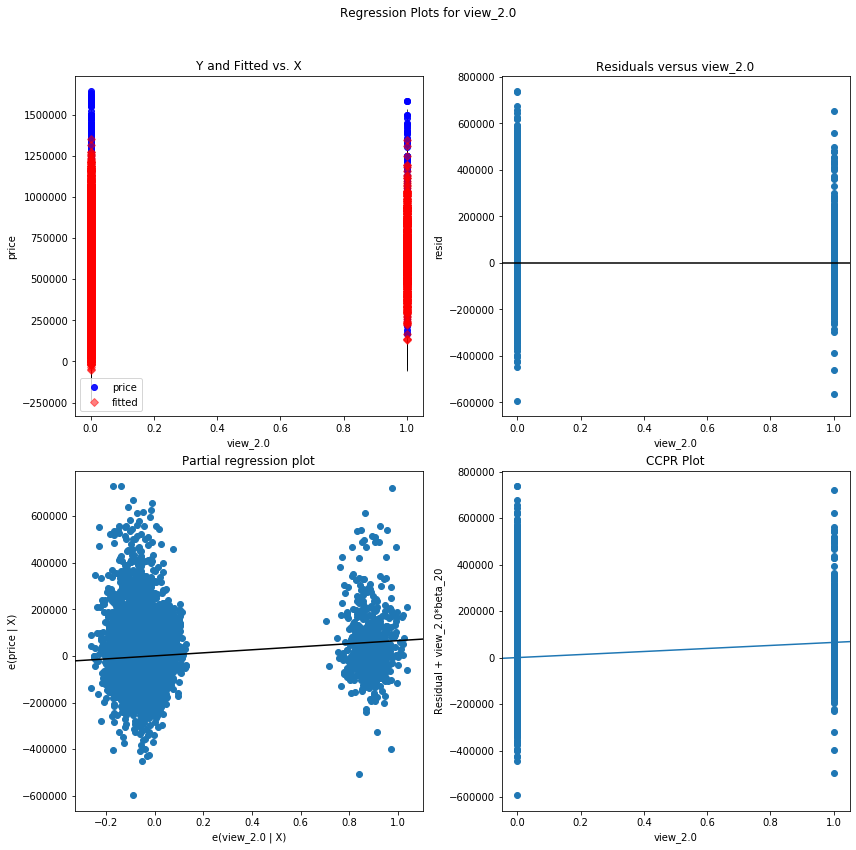

zipcode_98002 - Plotted


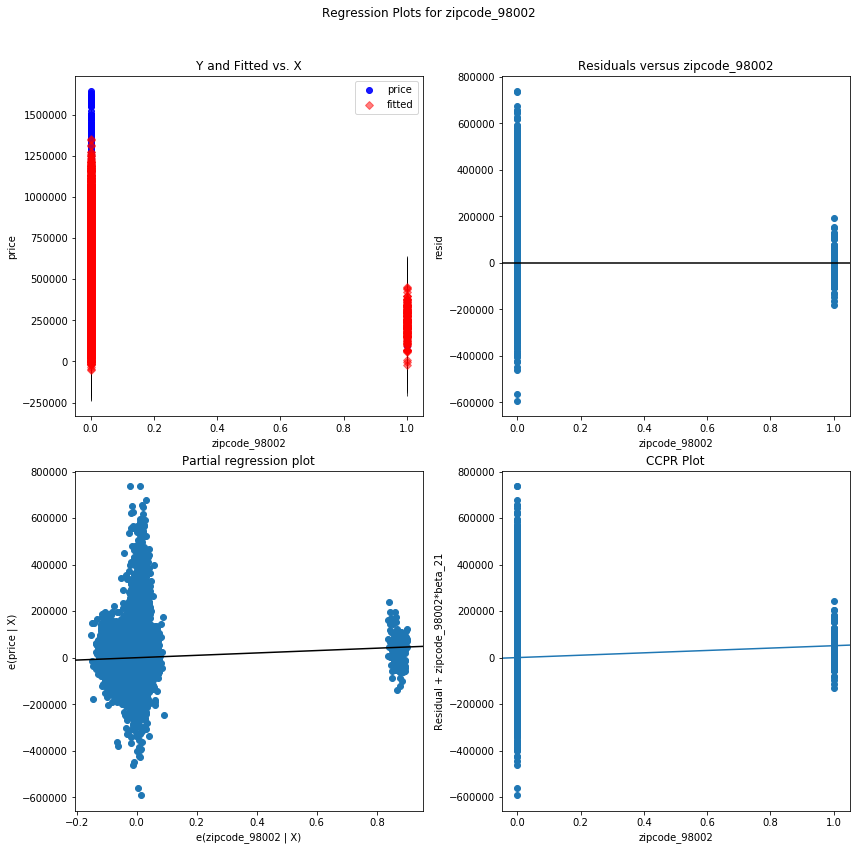

zipcode_98004 - Plotted


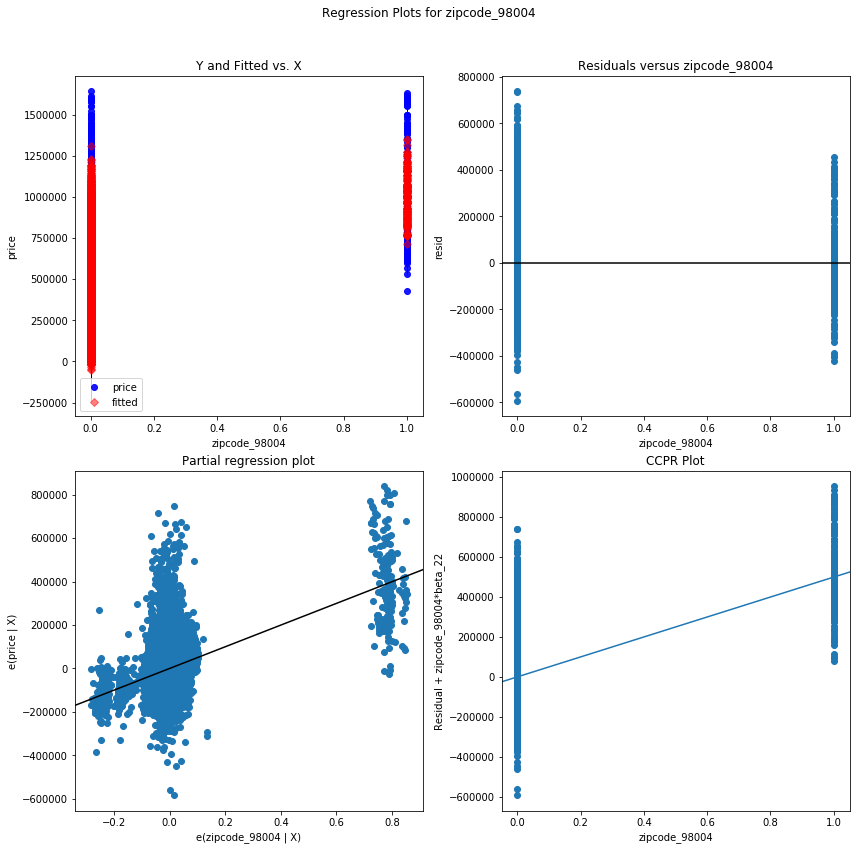

zipcode_98005 - Plotted


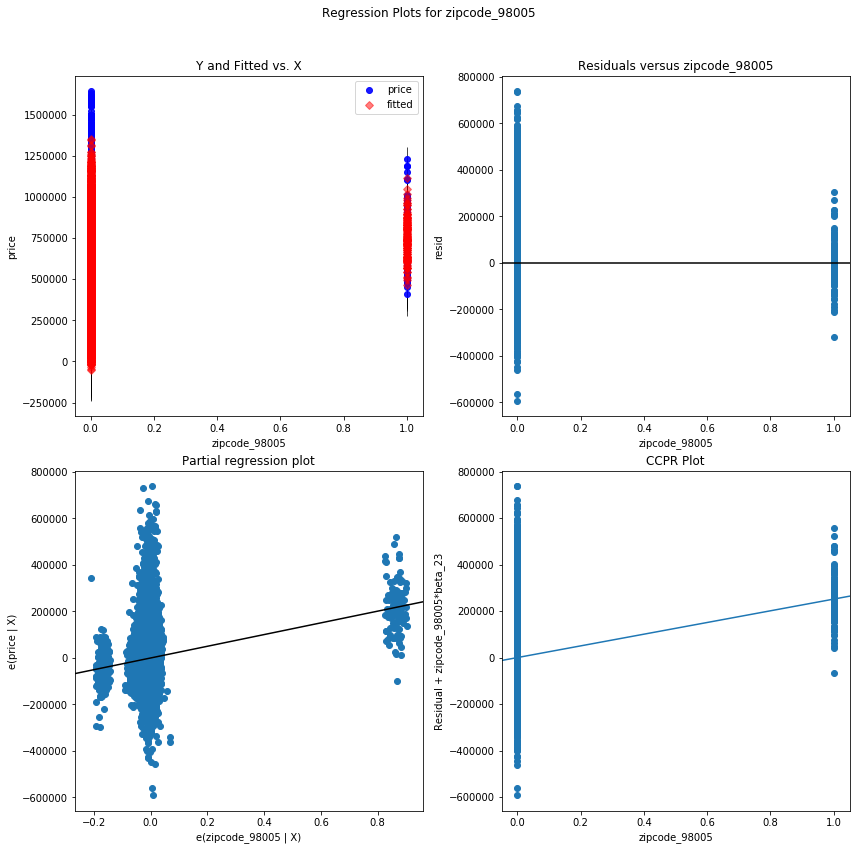

zipcode_98006 - Plotted


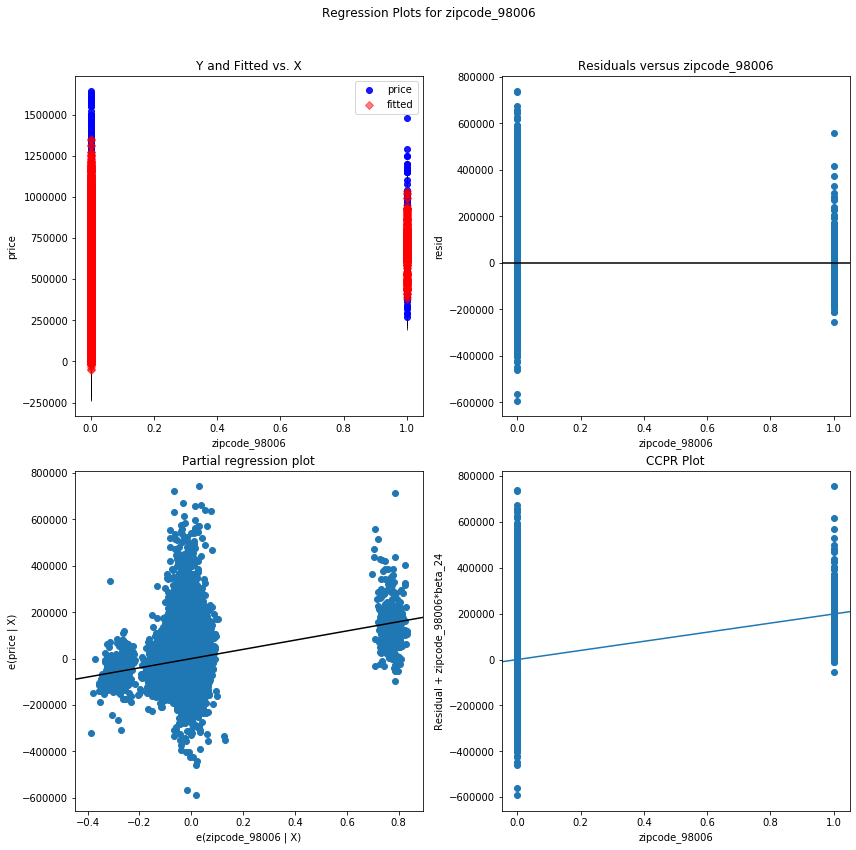

zipcode_98007 - Plotted


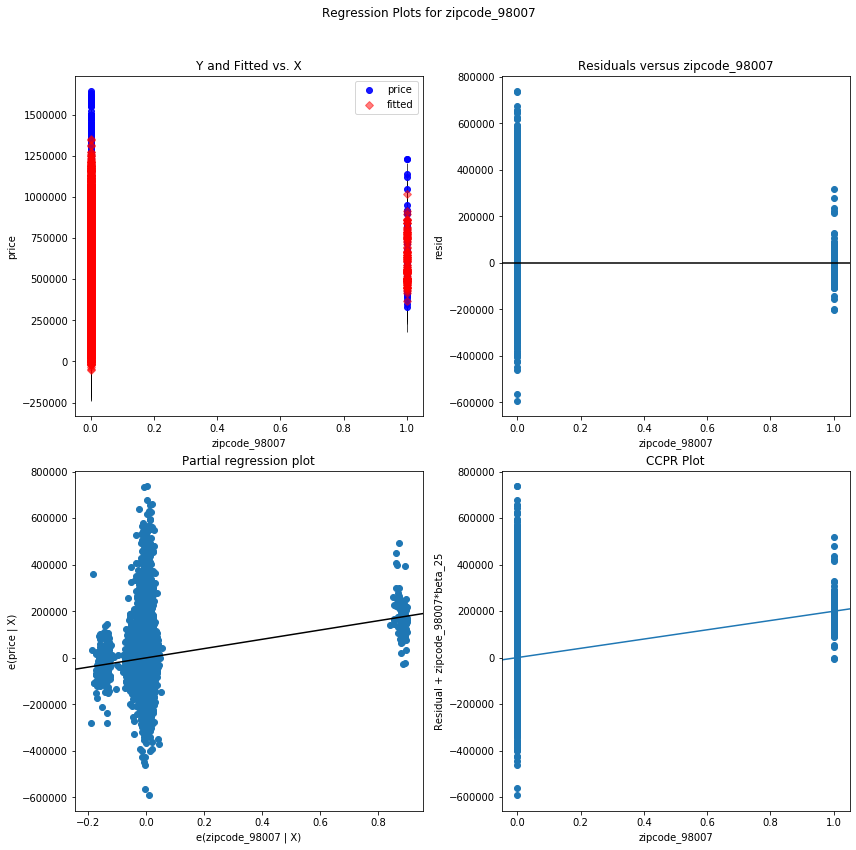

zipcode_98008 - Plotted


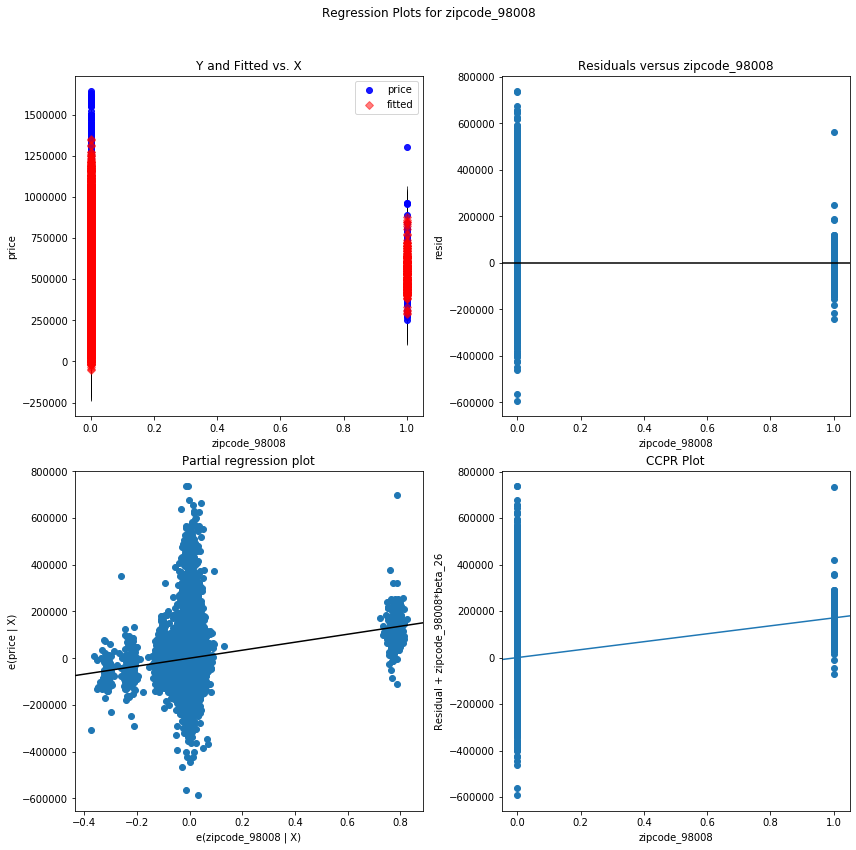

zipcode_98010 - Plotted


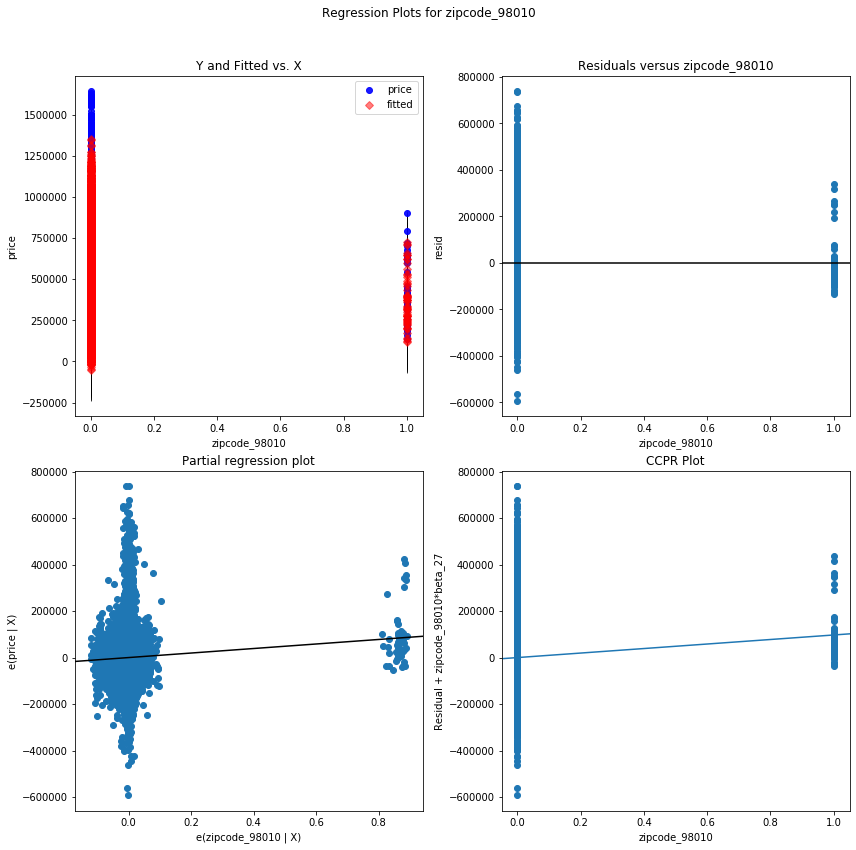

zipcode_98011 - Plotted


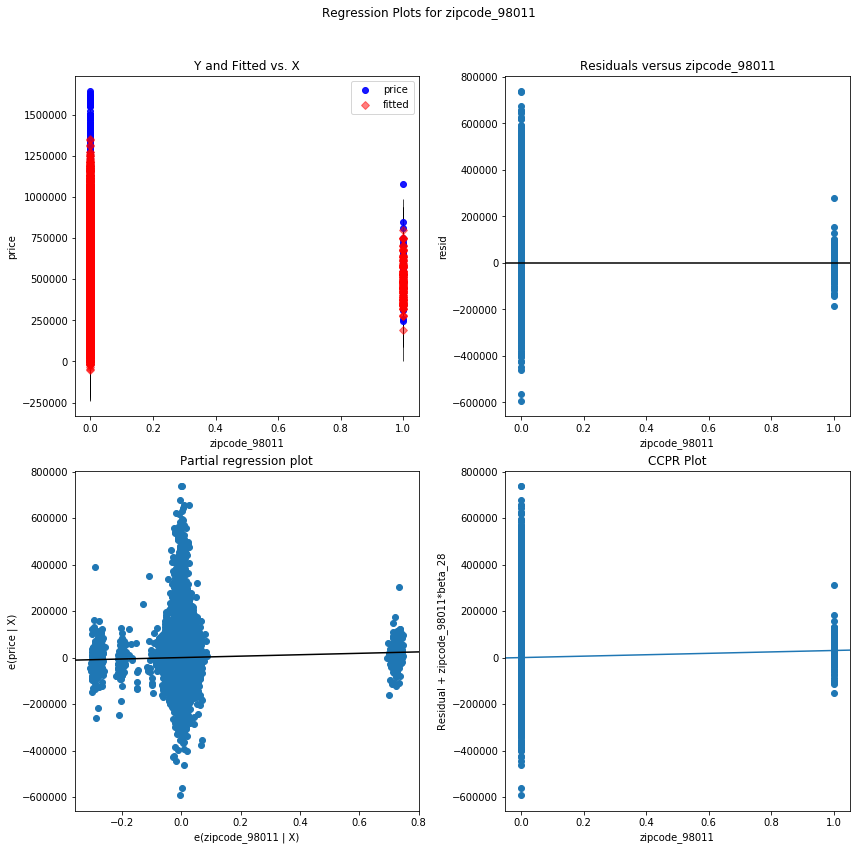

zipcode_98014 - Plotted


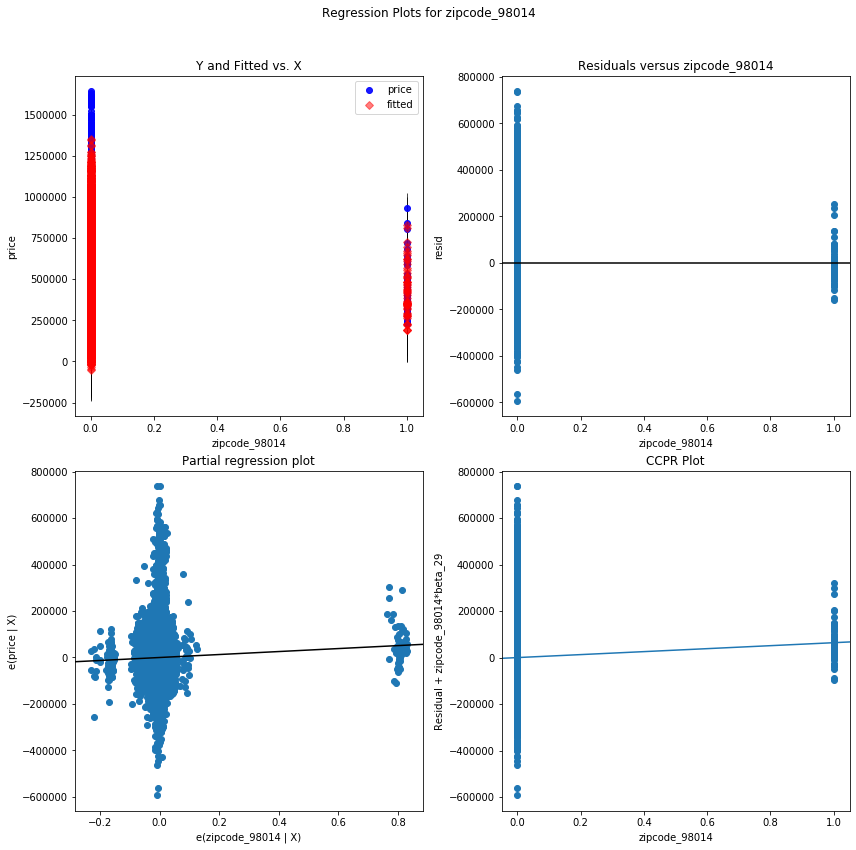

zipcode_98022 - Plotted


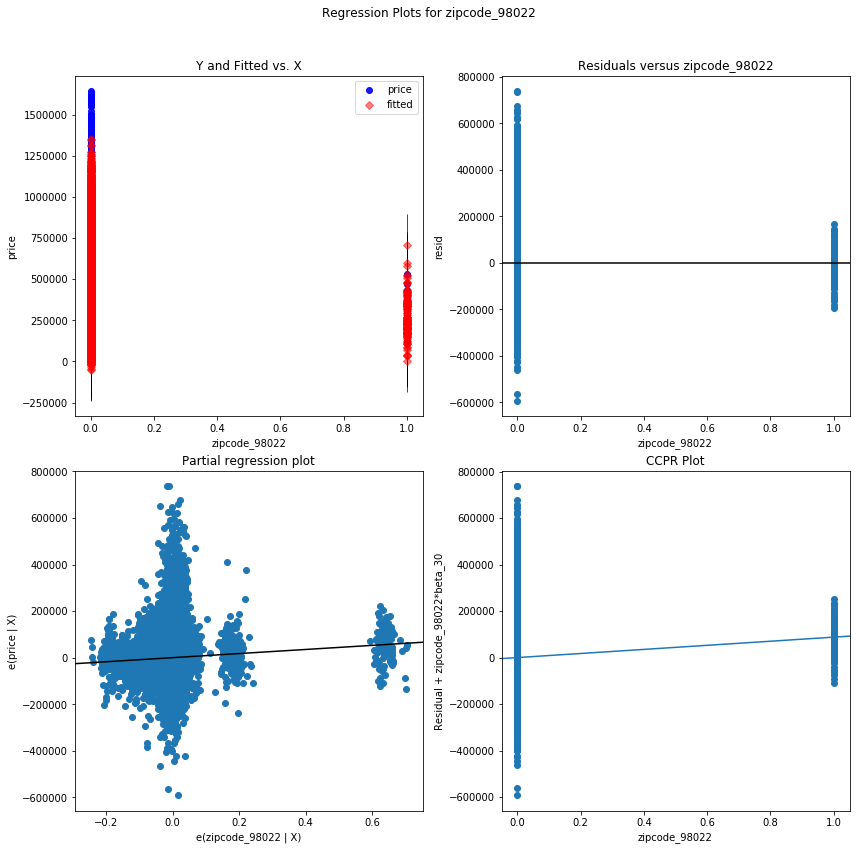

zipcode_98023 - Plotted


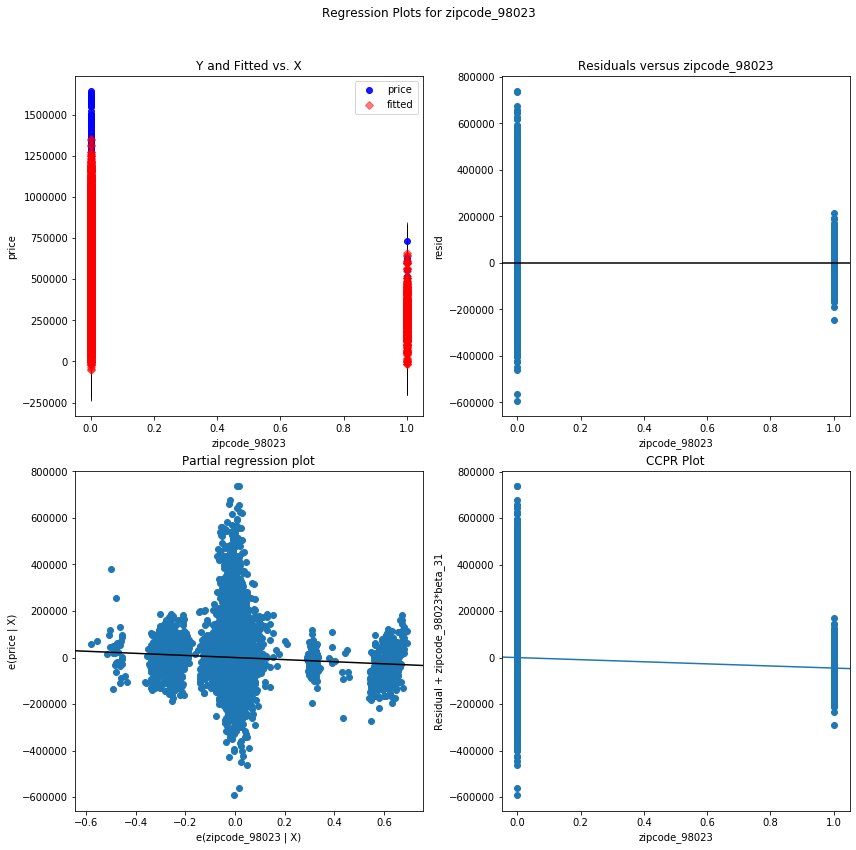

zipcode_98024 - Plotted


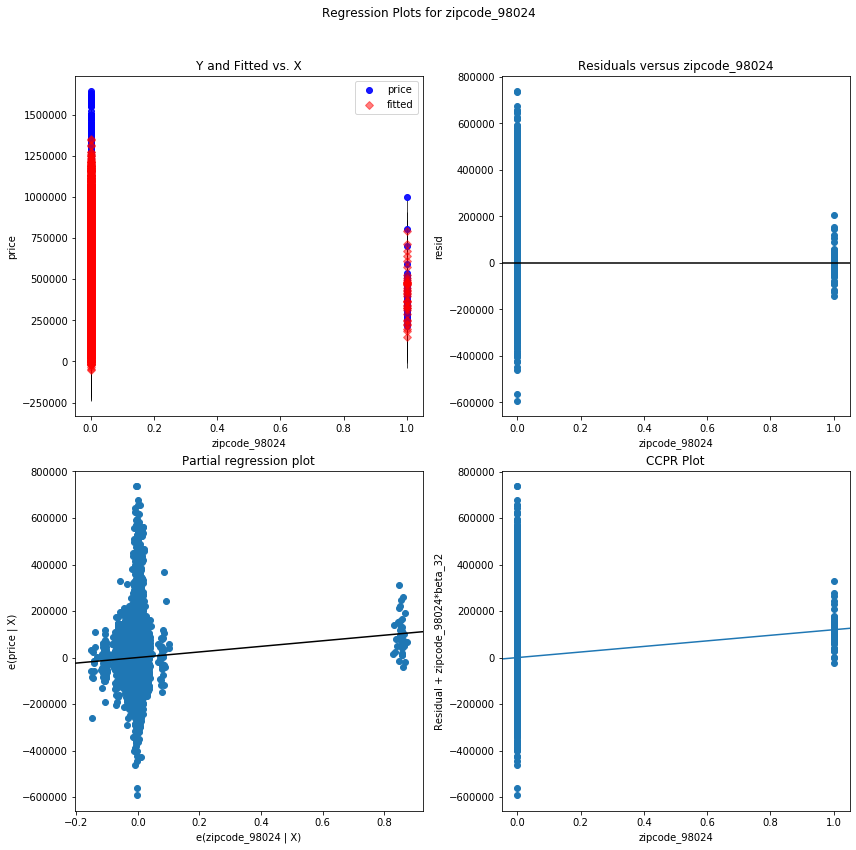

zipcode_98027 - Plotted


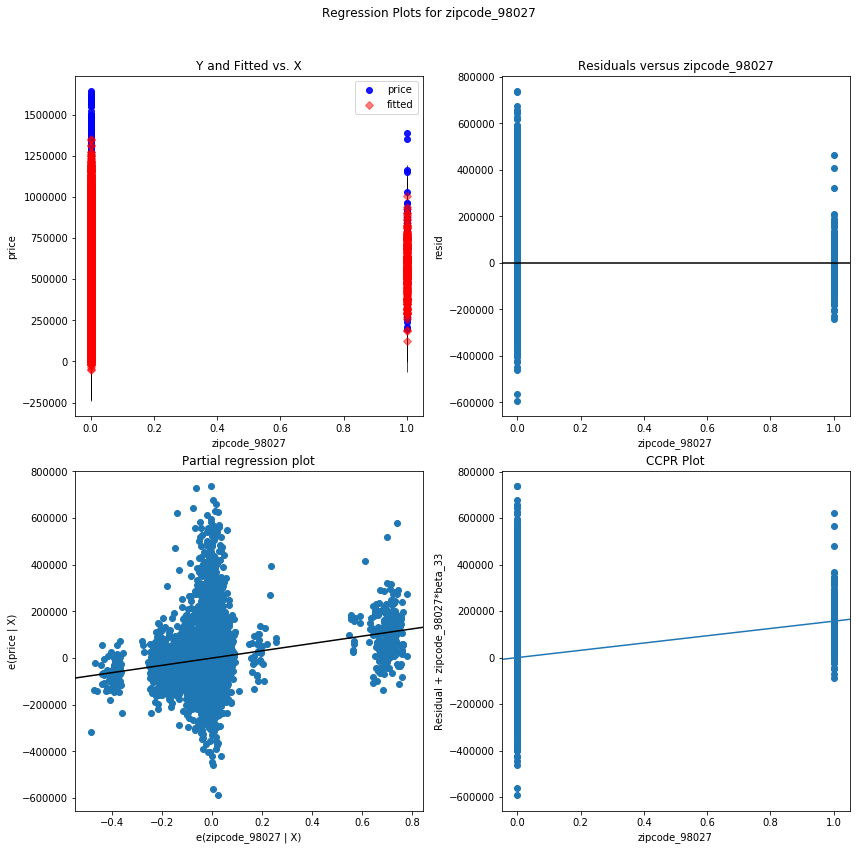

zipcode_98029 - Plotted


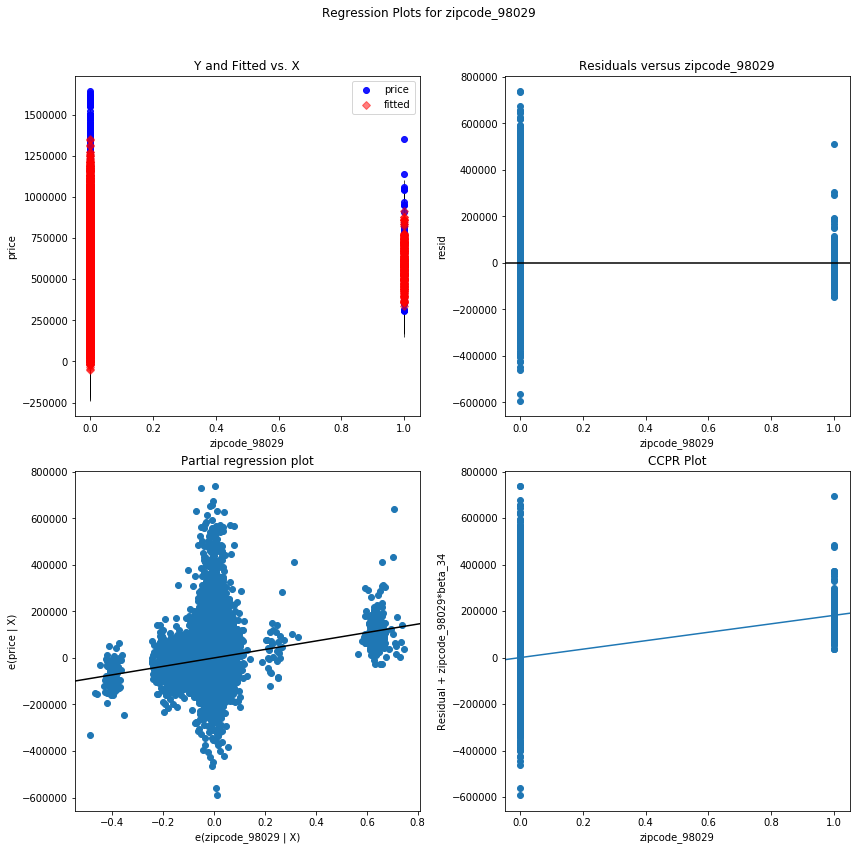

zipcode_98030 - Plotted


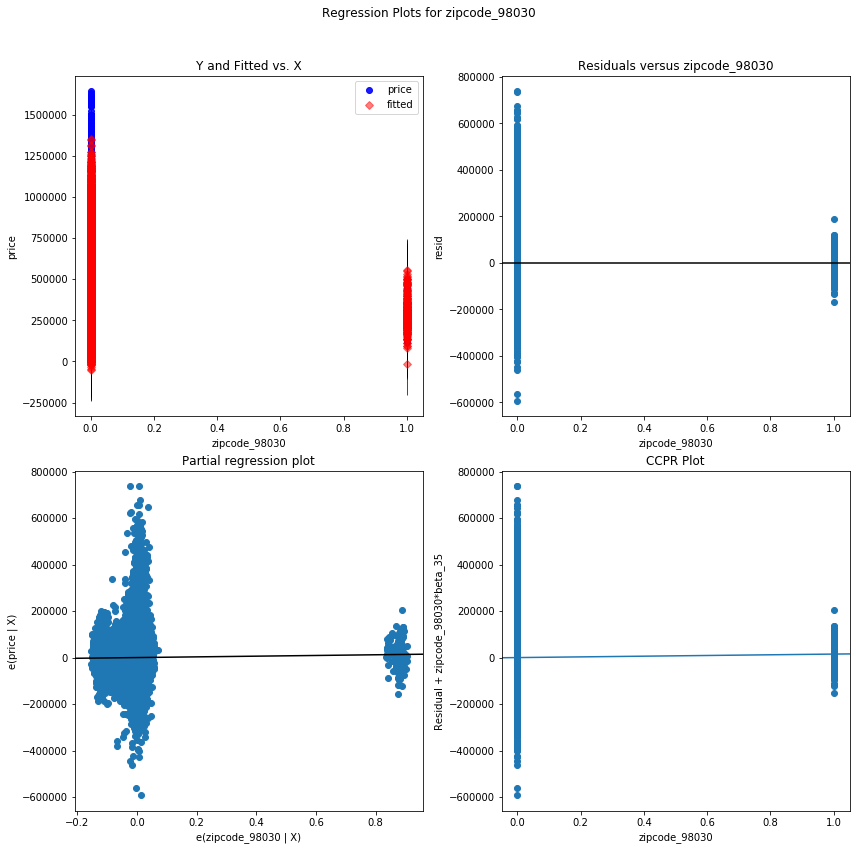

zipcode_98033 - Plotted


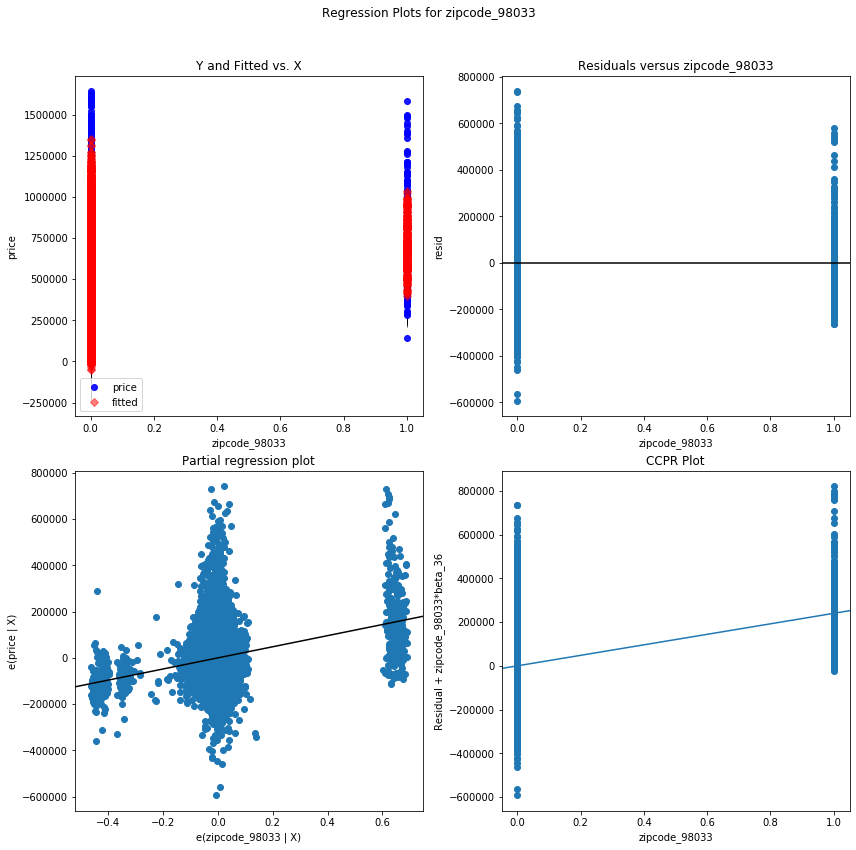

zipcode_98034 - Plotted


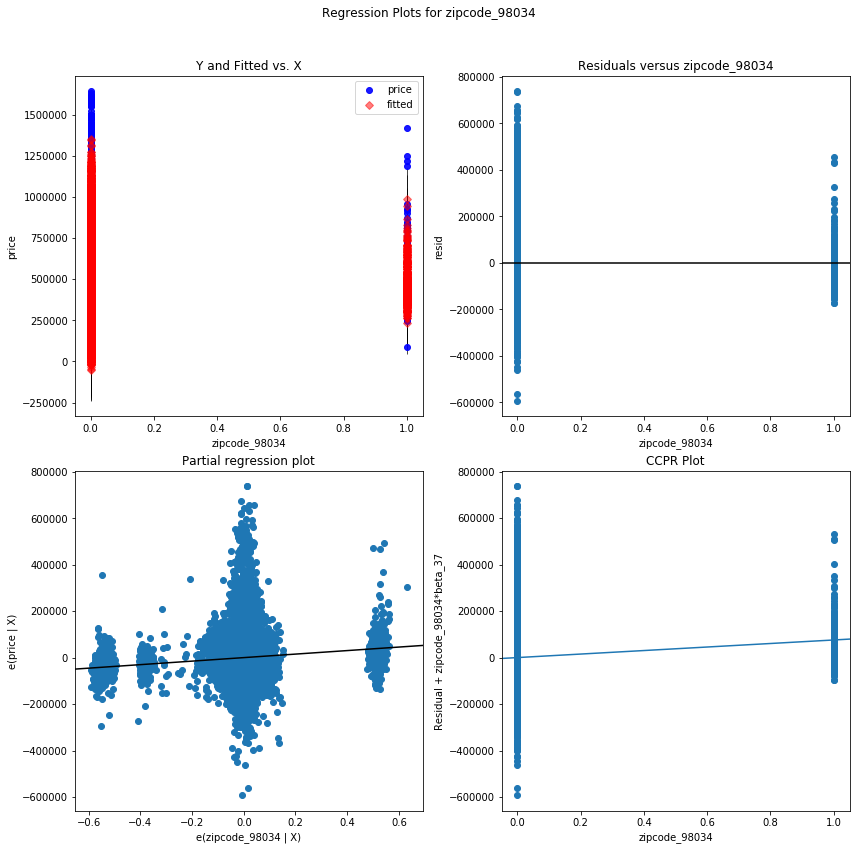

zipcode_98038 - Plotted


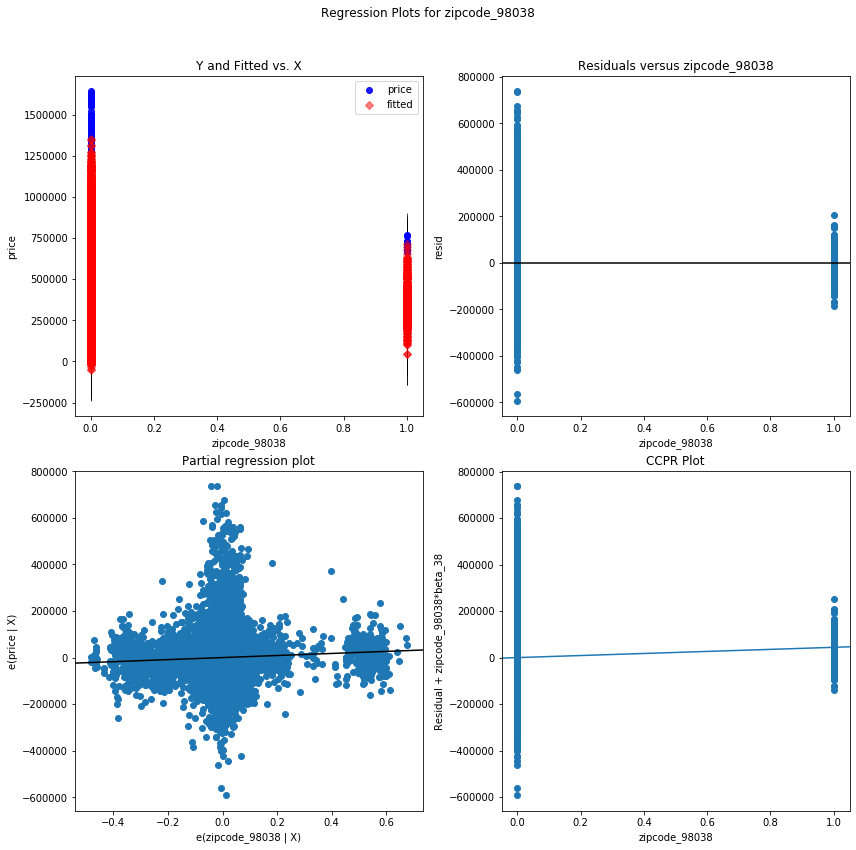

zipcode_98040 - Plotted


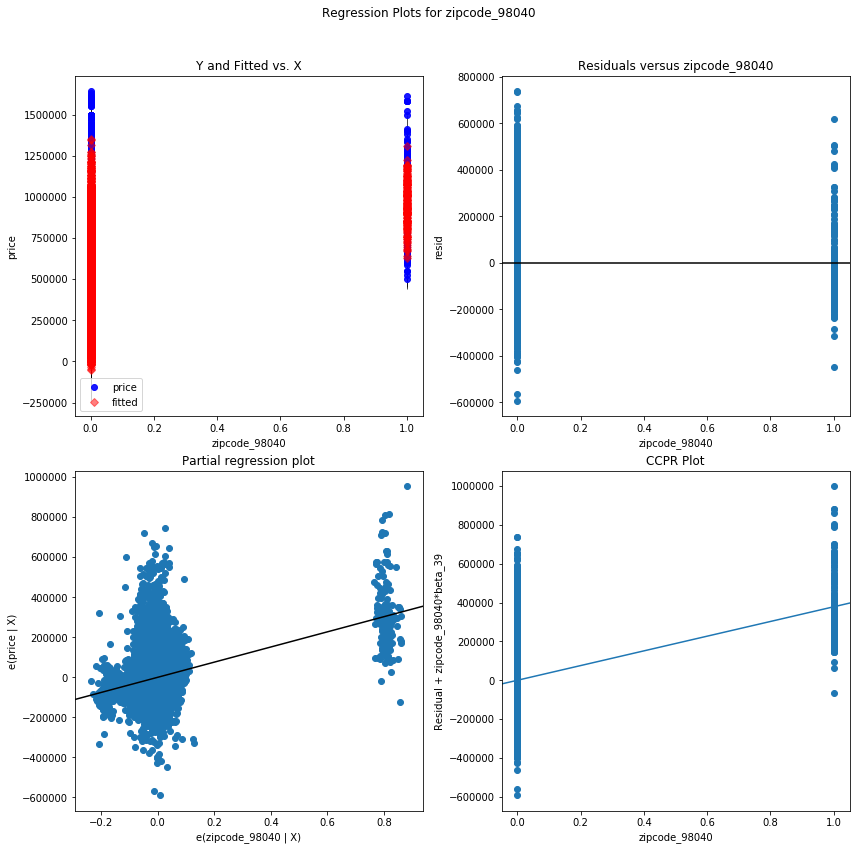

zipcode_98045 - Plotted


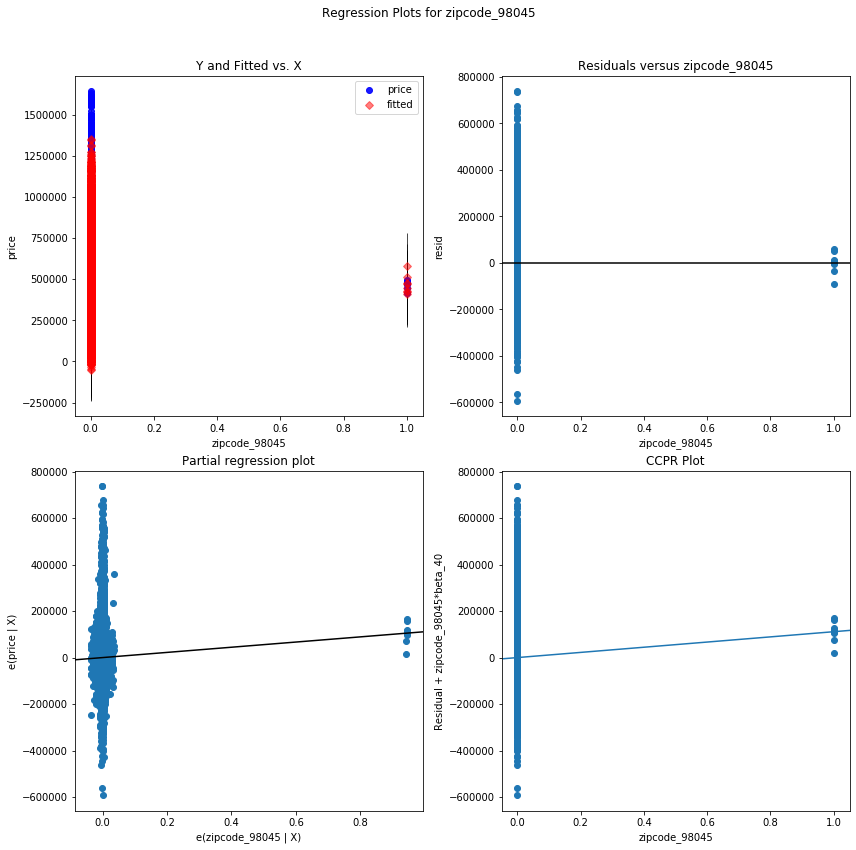

zipcode_98052 - Plotted


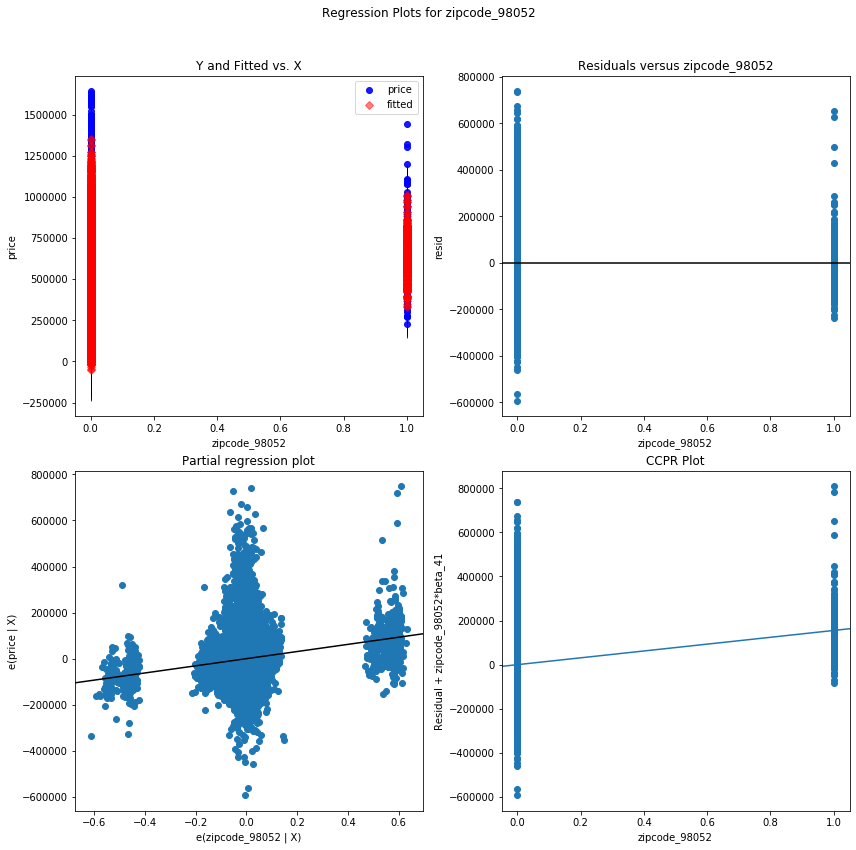

zipcode_98053 - Plotted


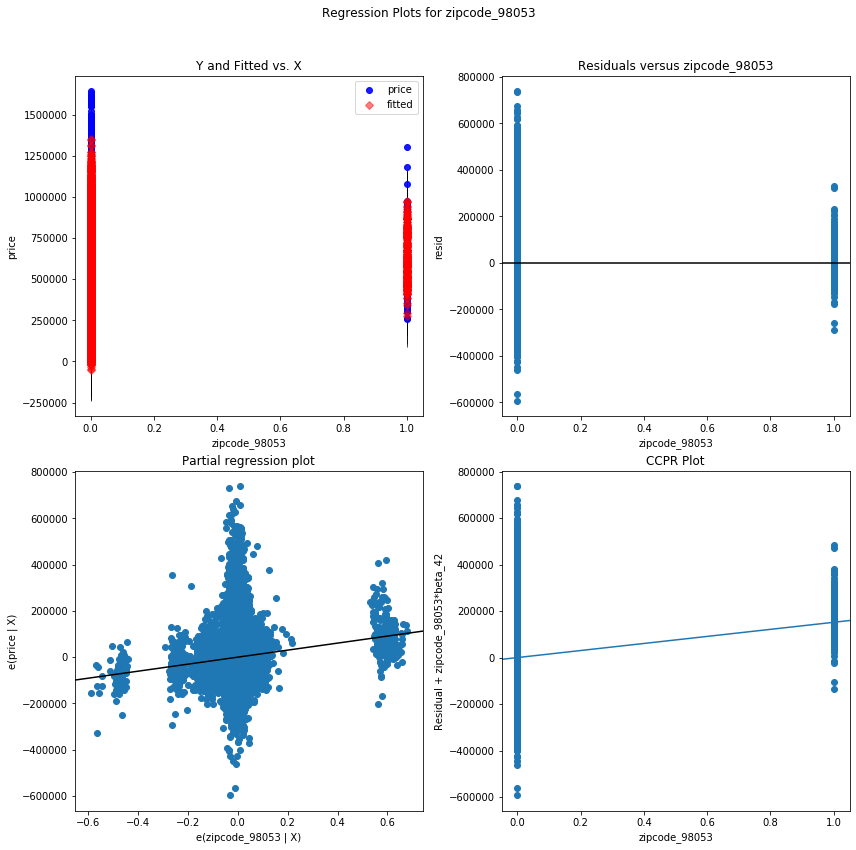

zipcode_98055 - Plotted


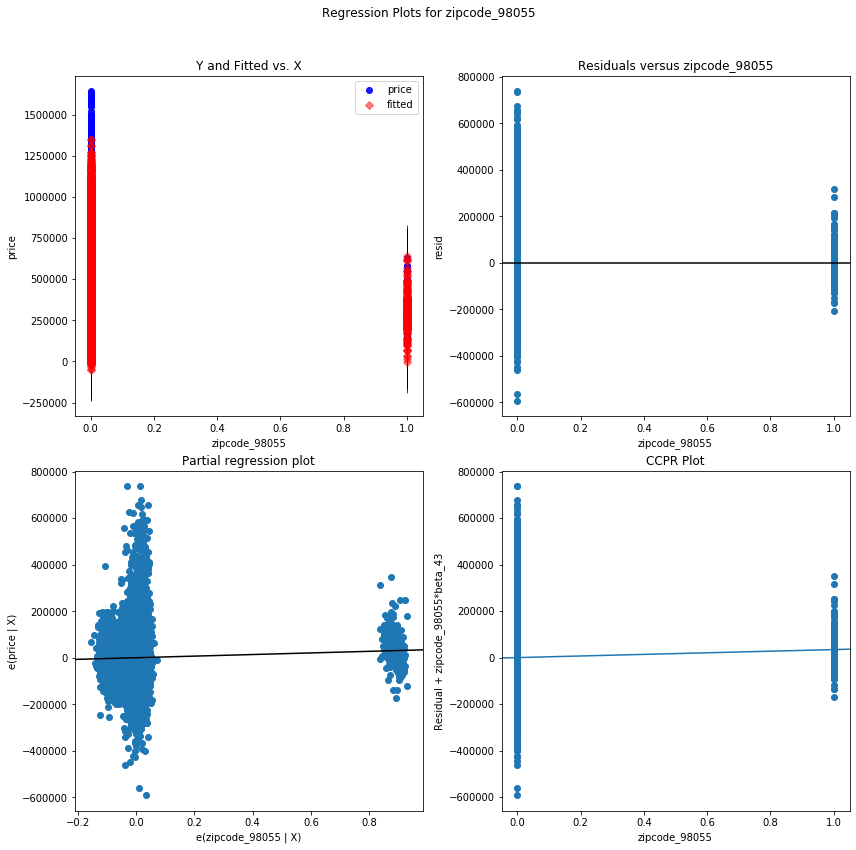

zipcode_98056 - Plotted


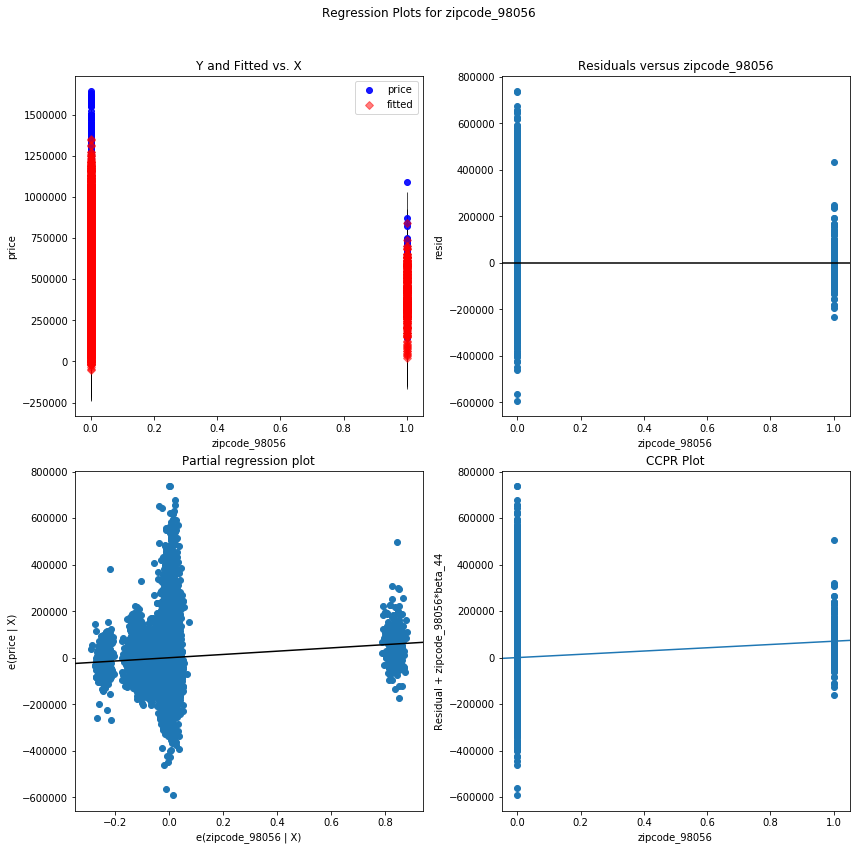

zipcode_98059 - Plotted


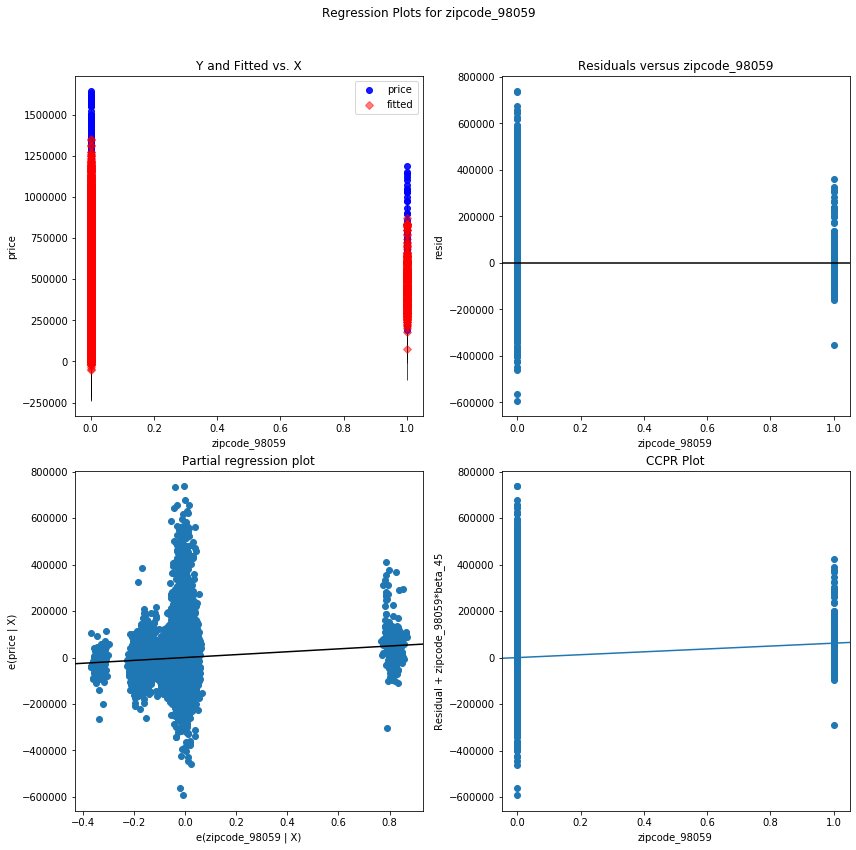

zipcode_98065 - Plotted


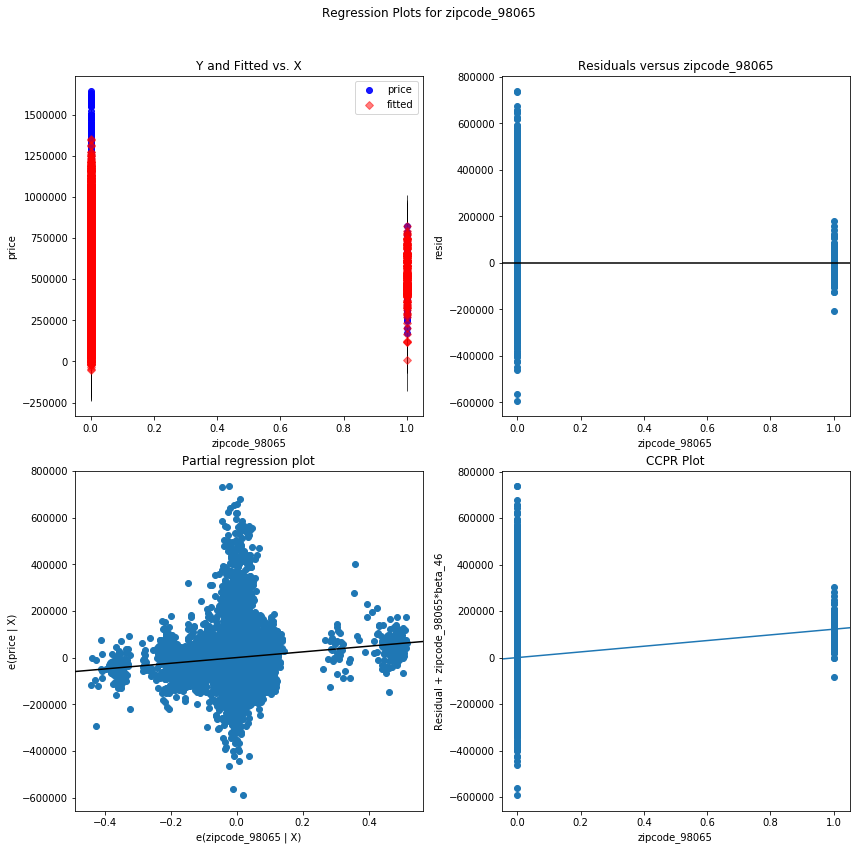

zipcode_98072 - Plotted


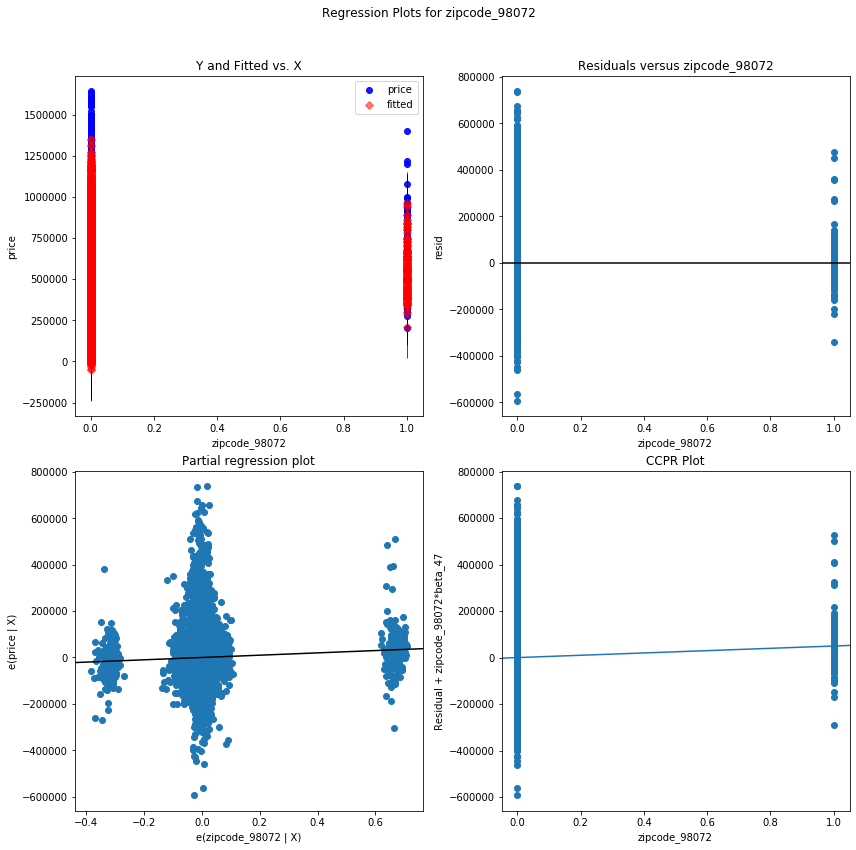

zipcode_98074 - Plotted


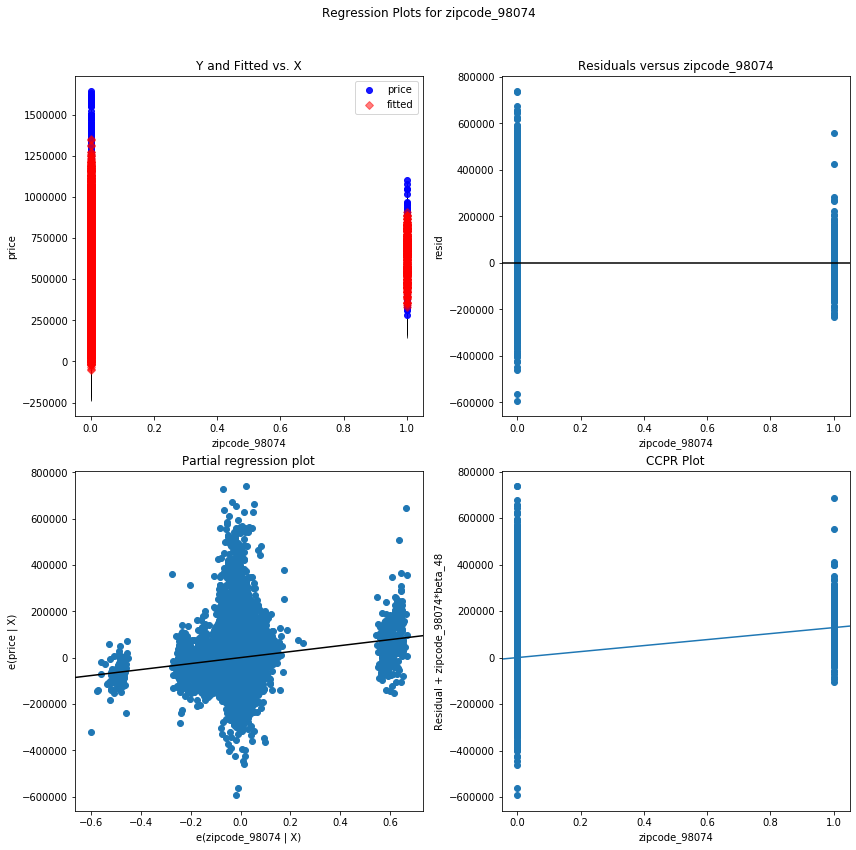

zipcode_98075 - Plotted


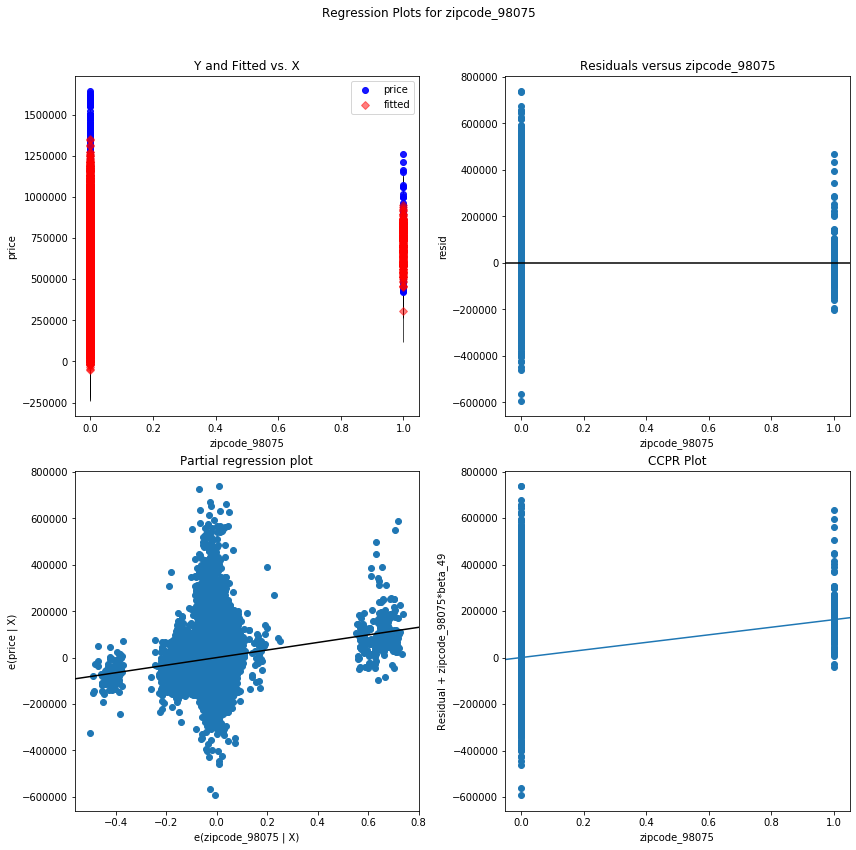

zipcode_98077 - Plotted


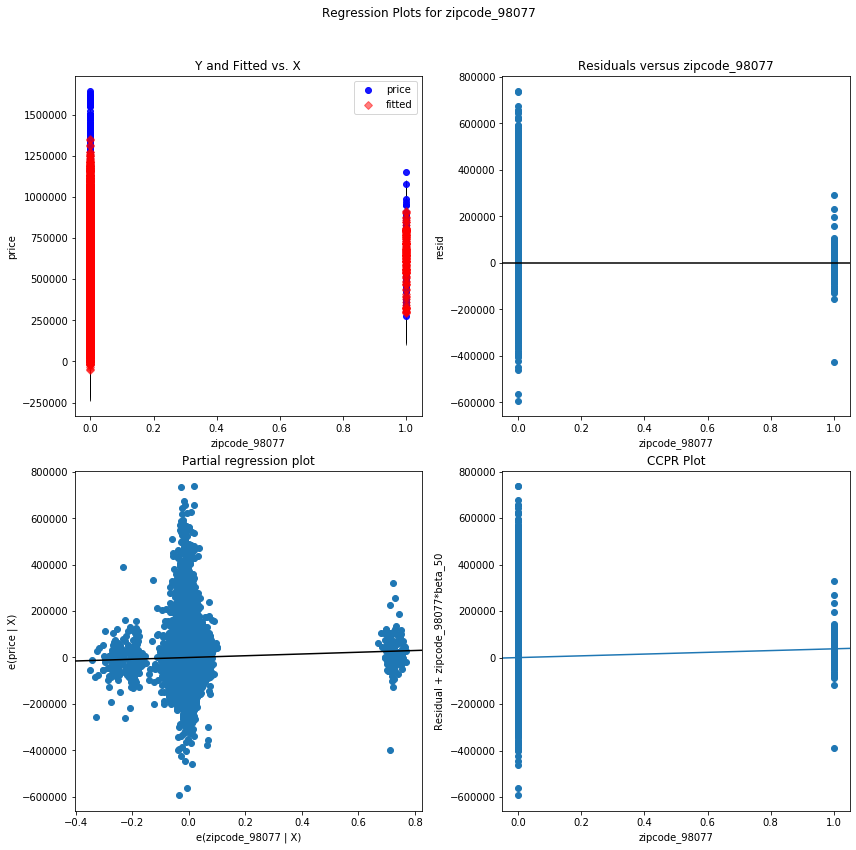

zipcode_98092 - Plotted


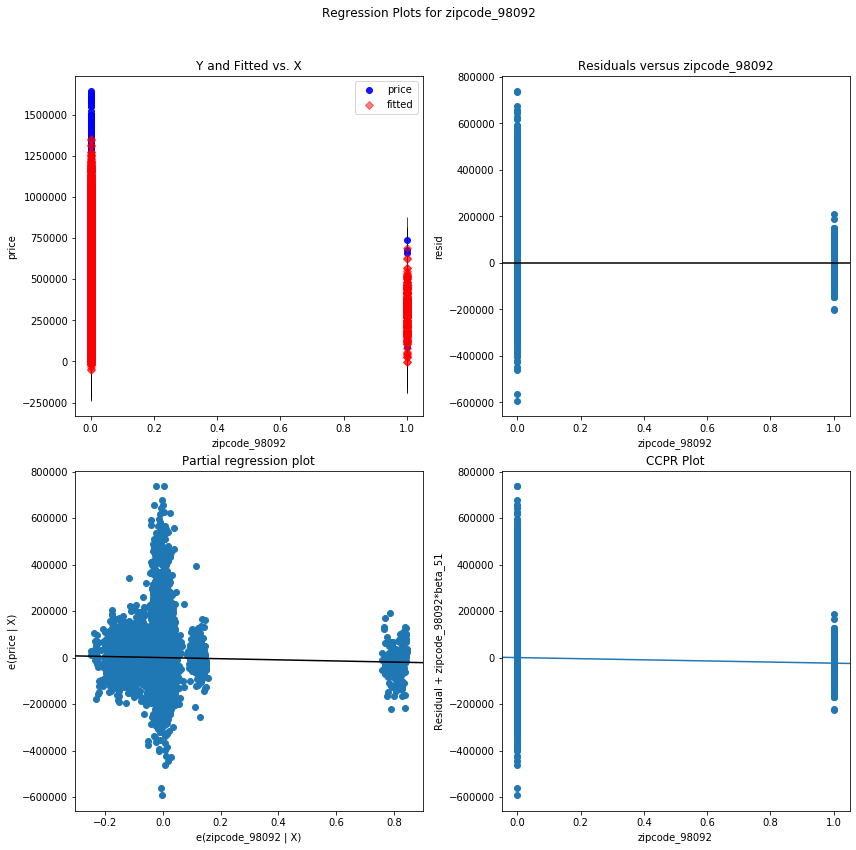

zipcode_98102 - Plotted


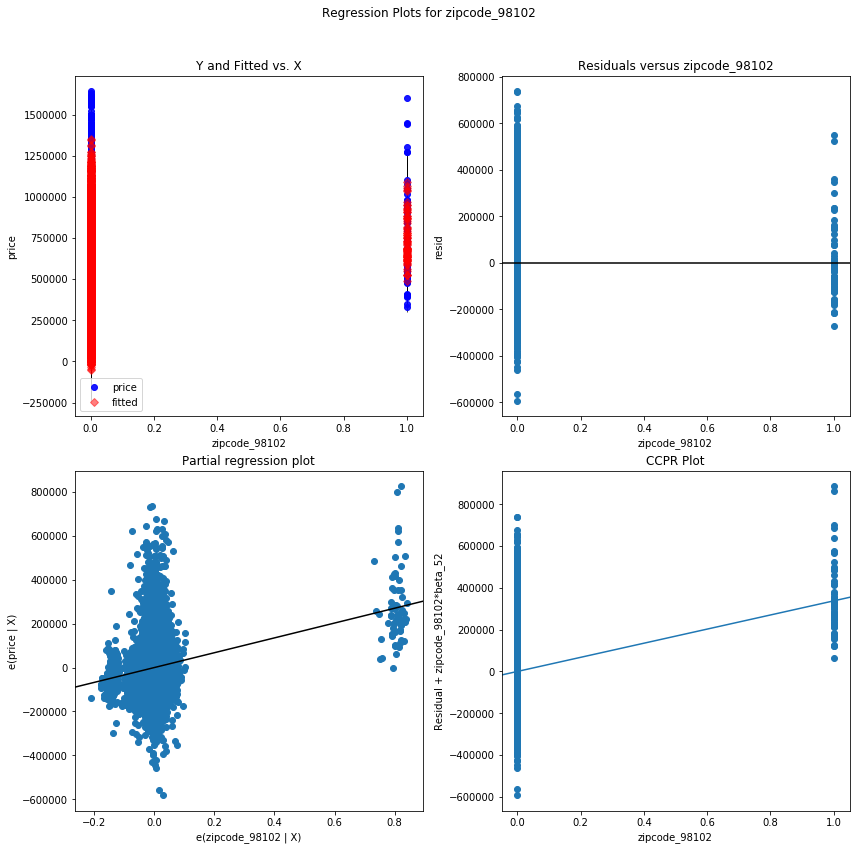

zipcode_98103 - Plotted


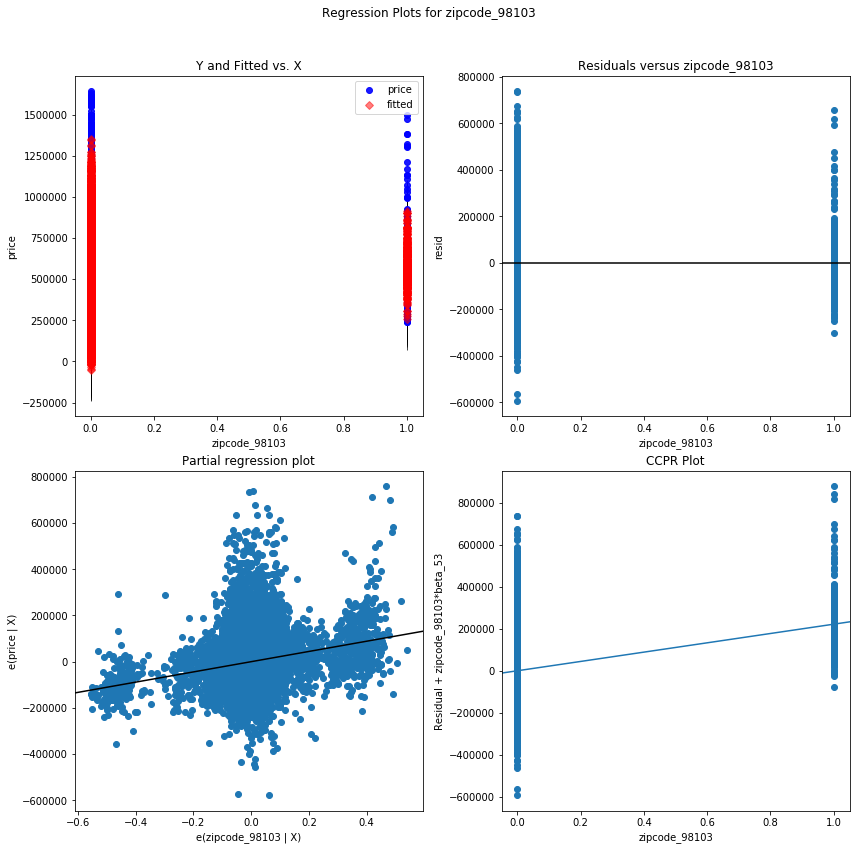

zipcode_98105 - Plotted


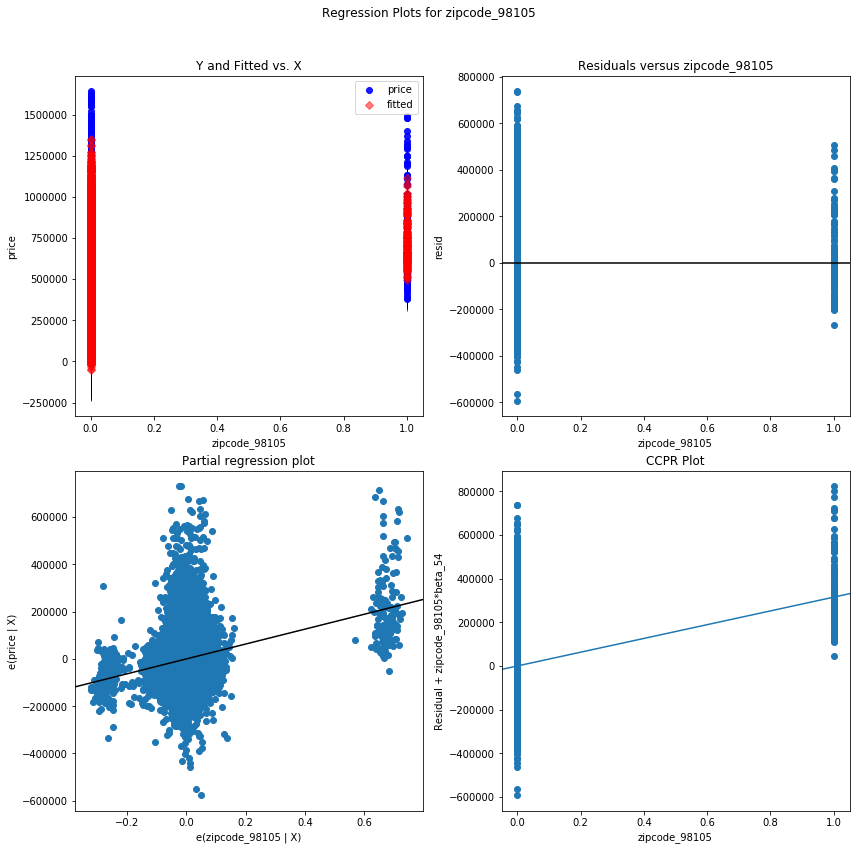

zipcode_98106 - Plotted


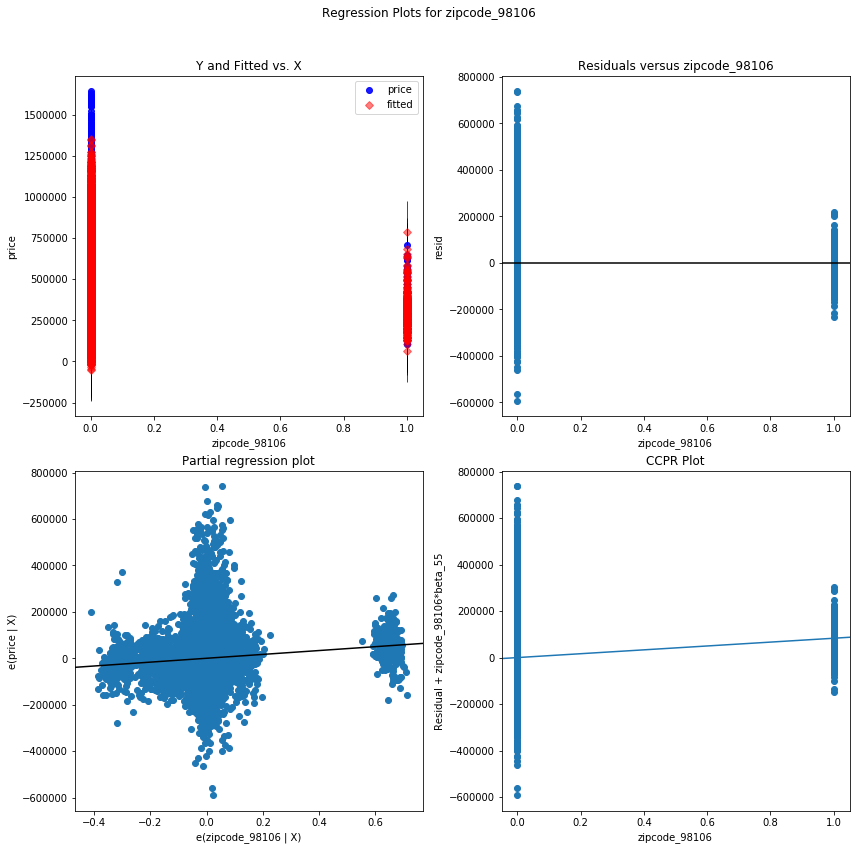

zipcode_98107 - Plotted


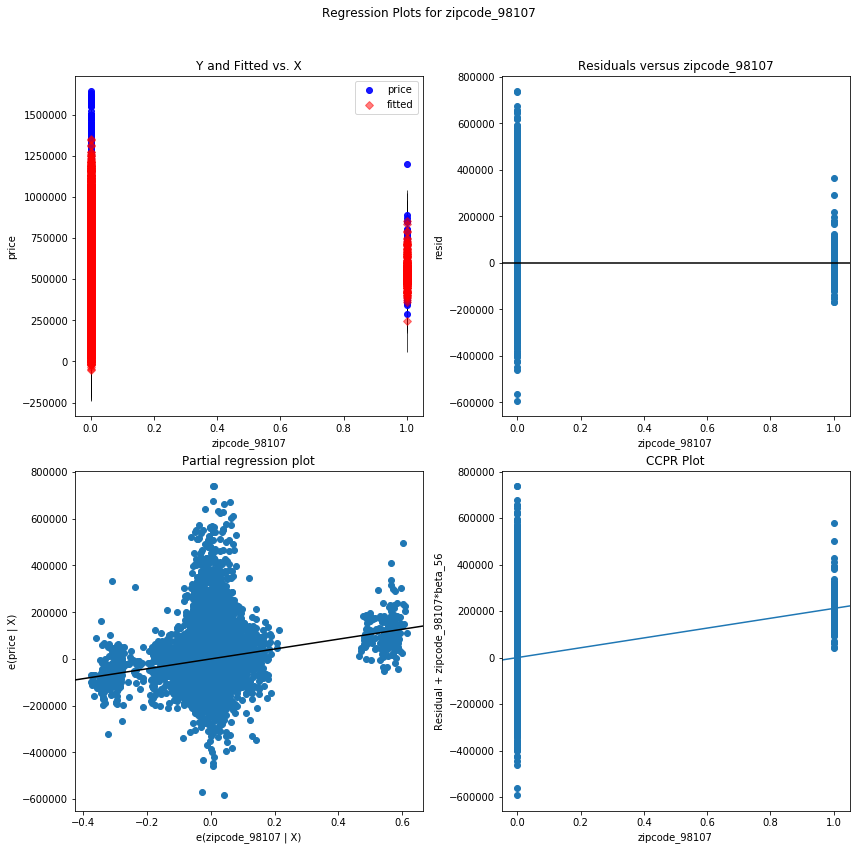

zipcode_98108 - Plotted


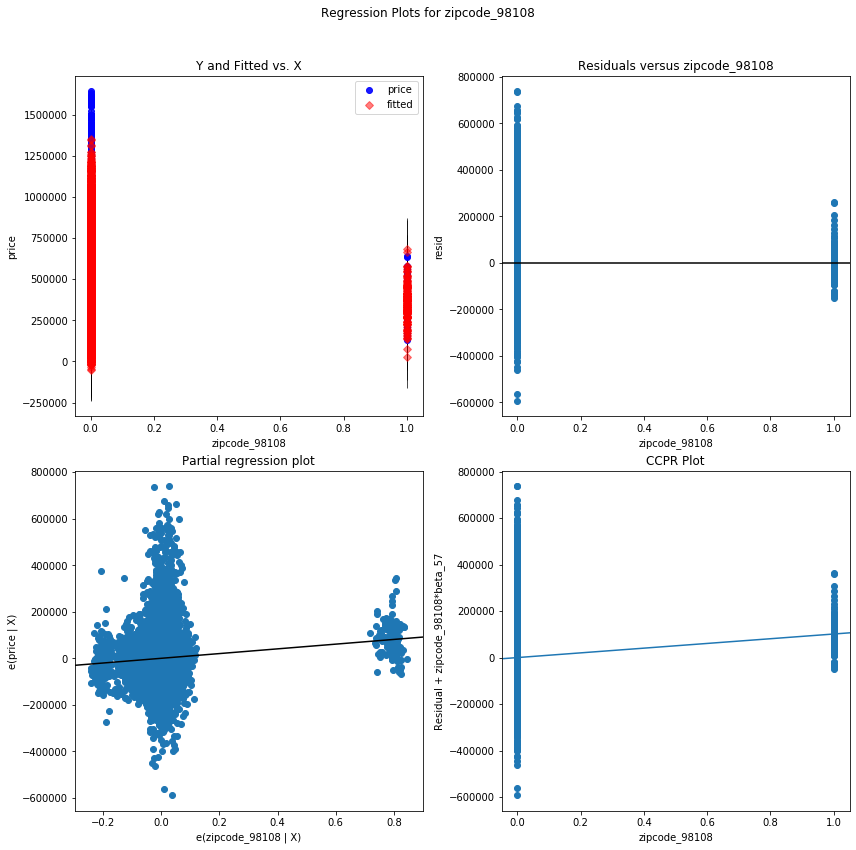

zipcode_98109 - Plotted


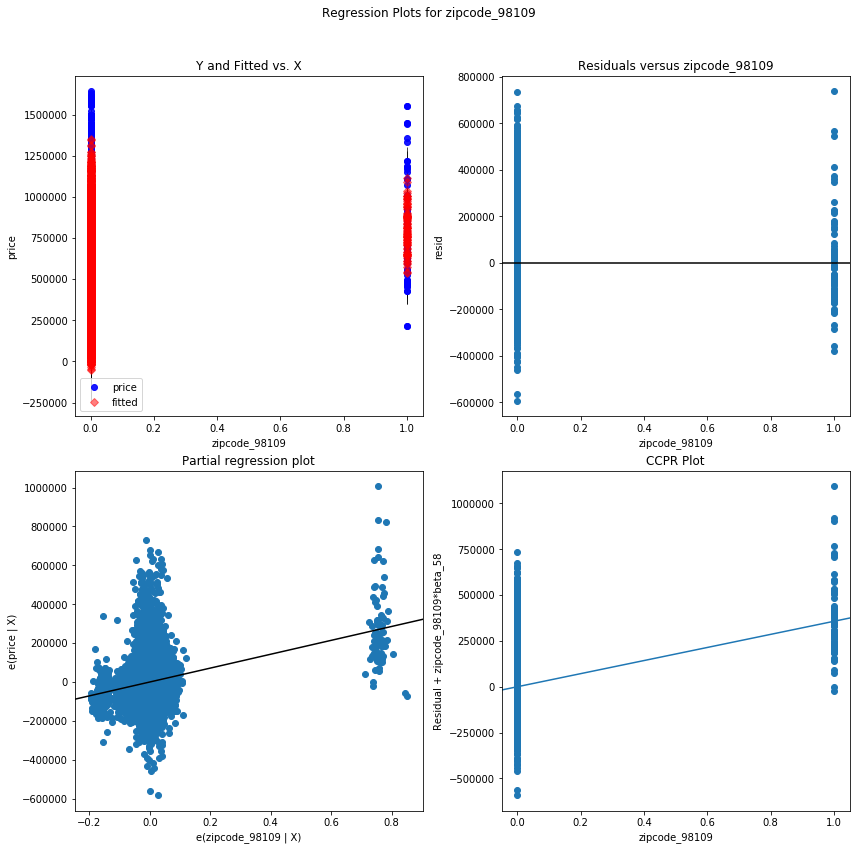

zipcode_98112 - Plotted


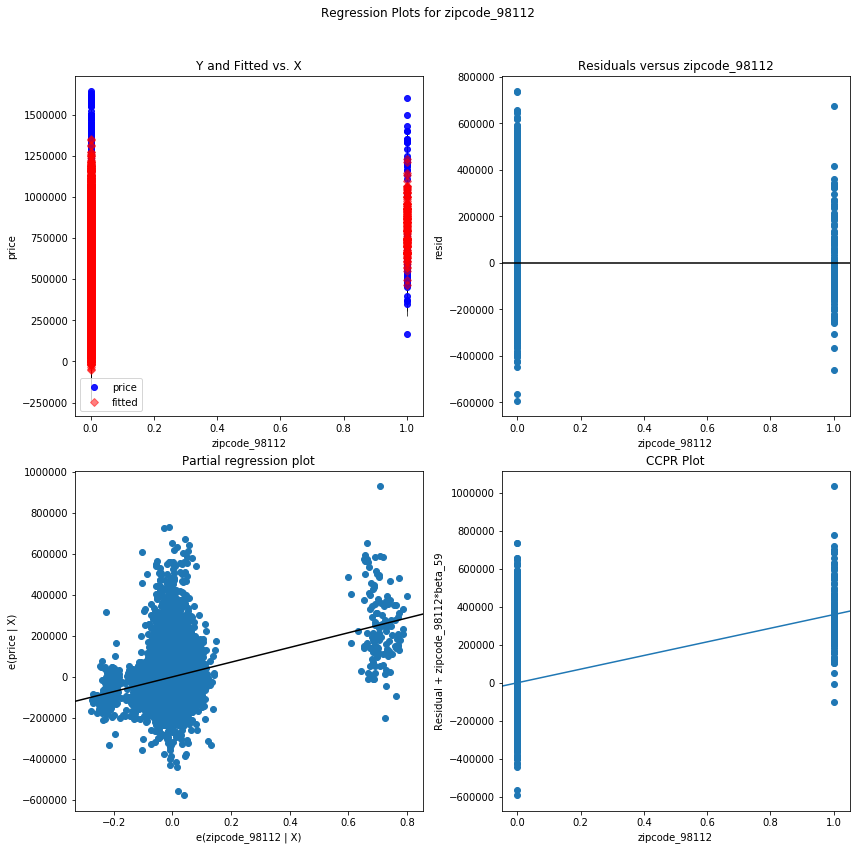

zipcode_98115 - Plotted


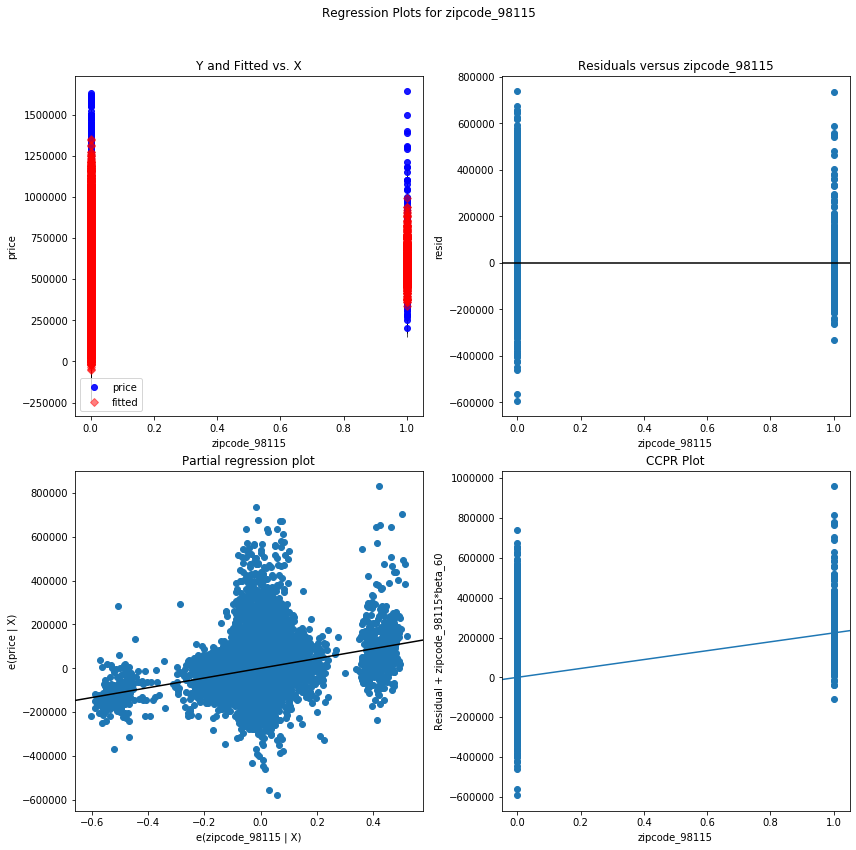

zipcode_98116 - Plotted


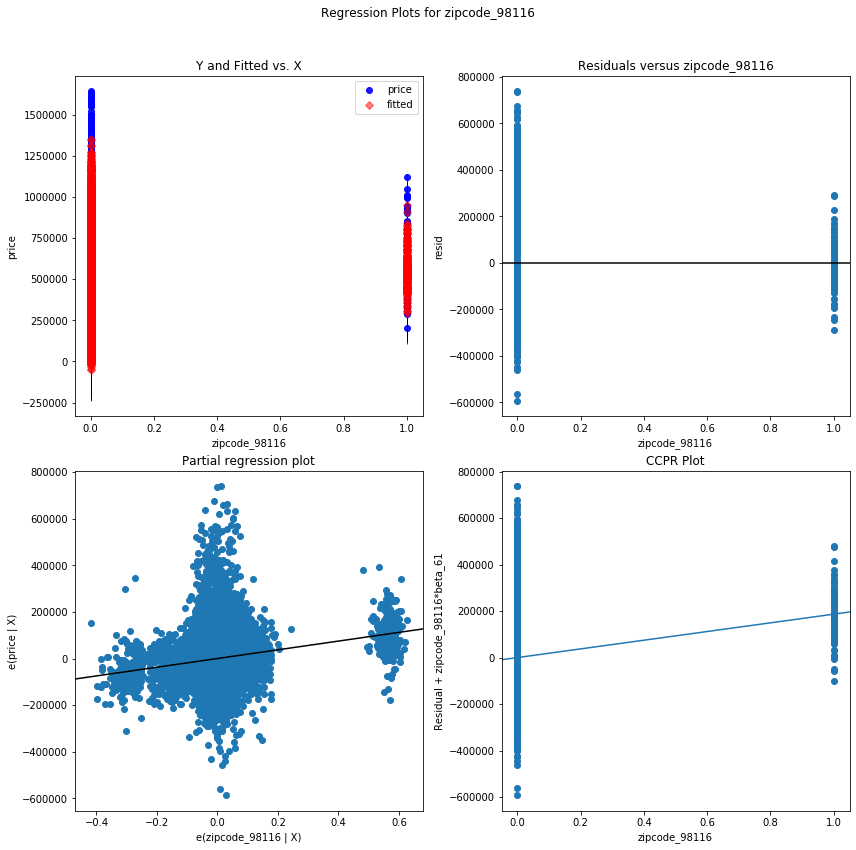

zipcode_98117 - Plotted


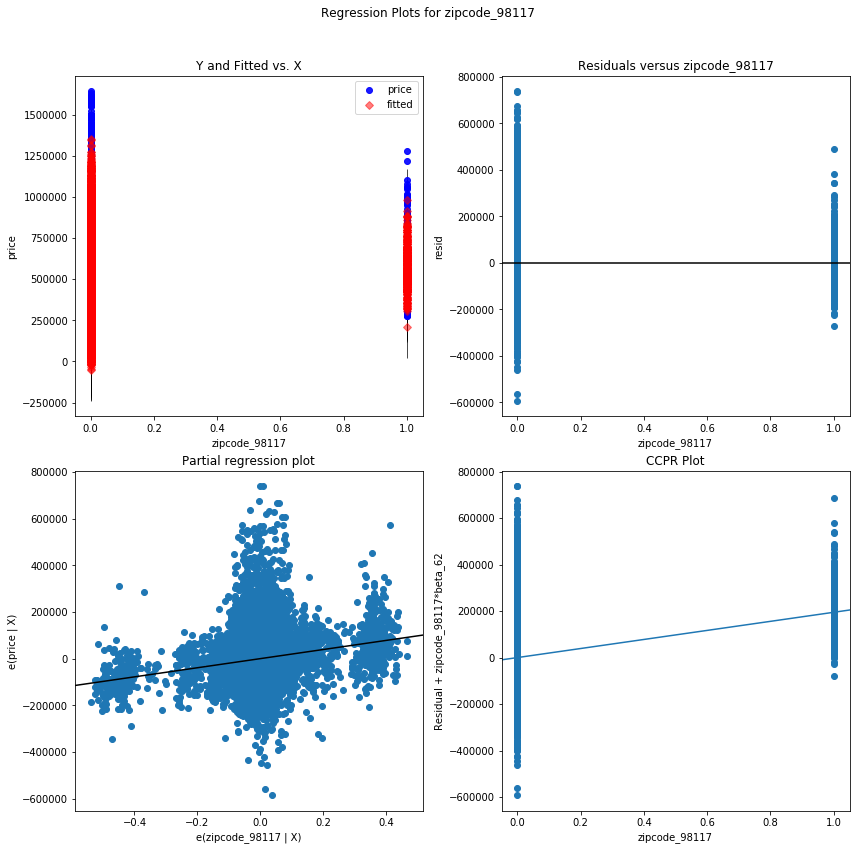

zipcode_98118 - Plotted


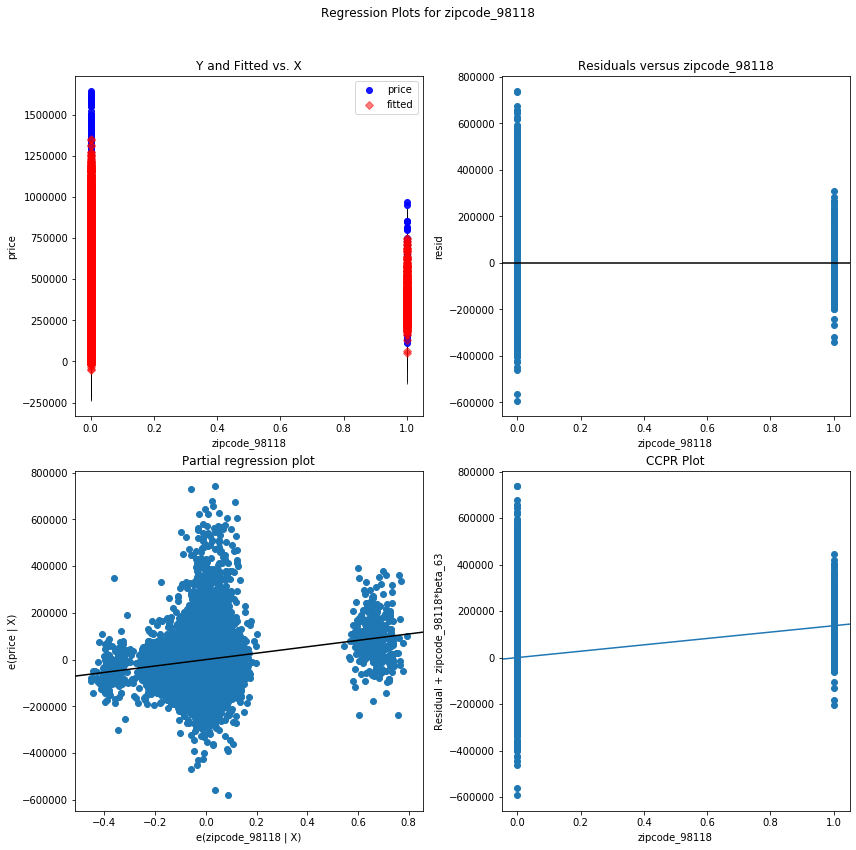

zipcode_98119 - Plotted


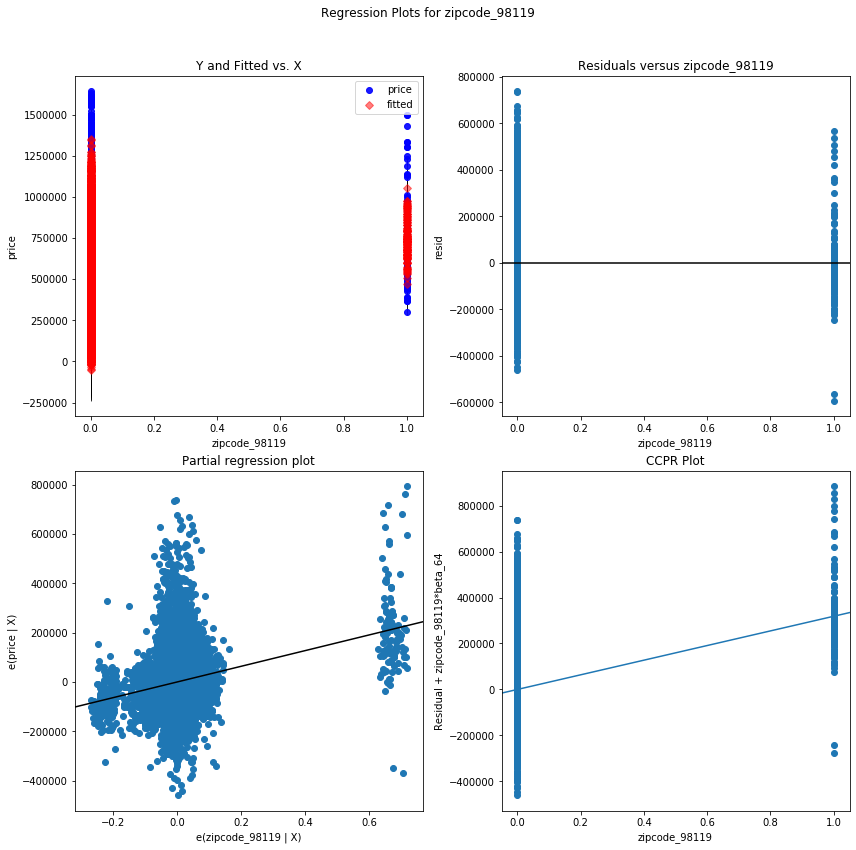

zipcode_98122 - Plotted


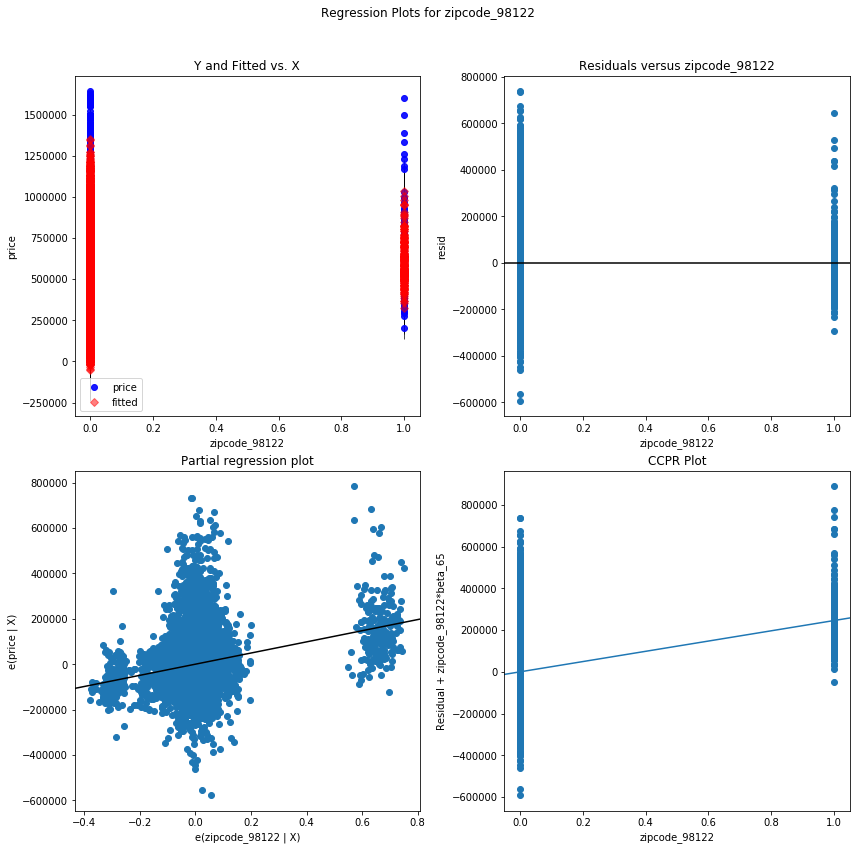

zipcode_98125 - Plotted


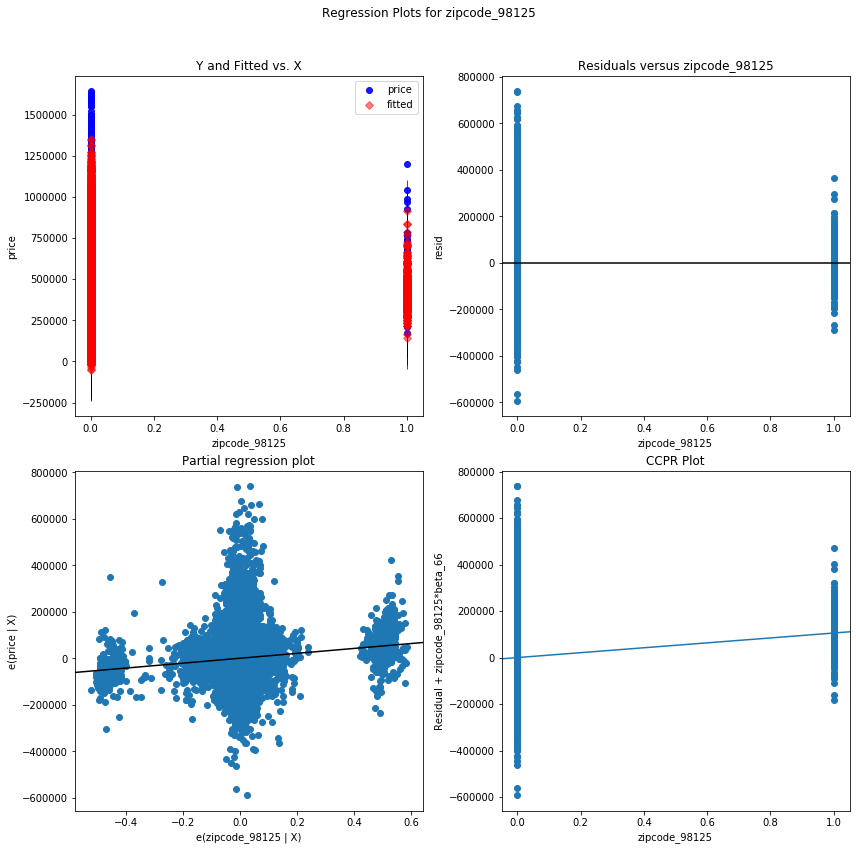

zipcode_98126 - Plotted


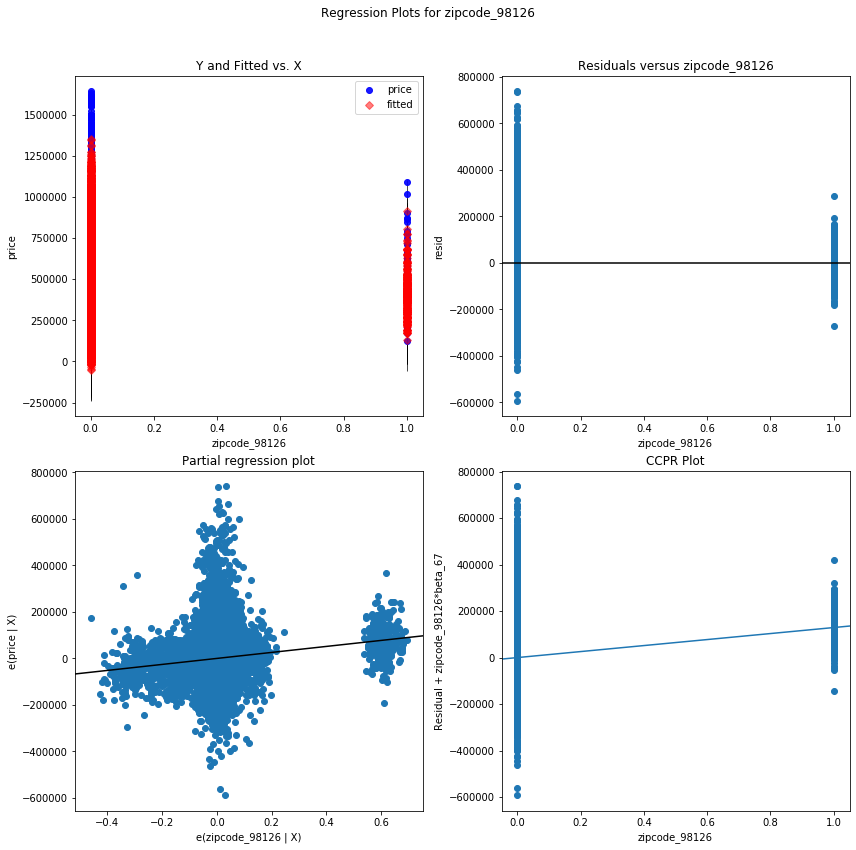

zipcode_98133 - Plotted


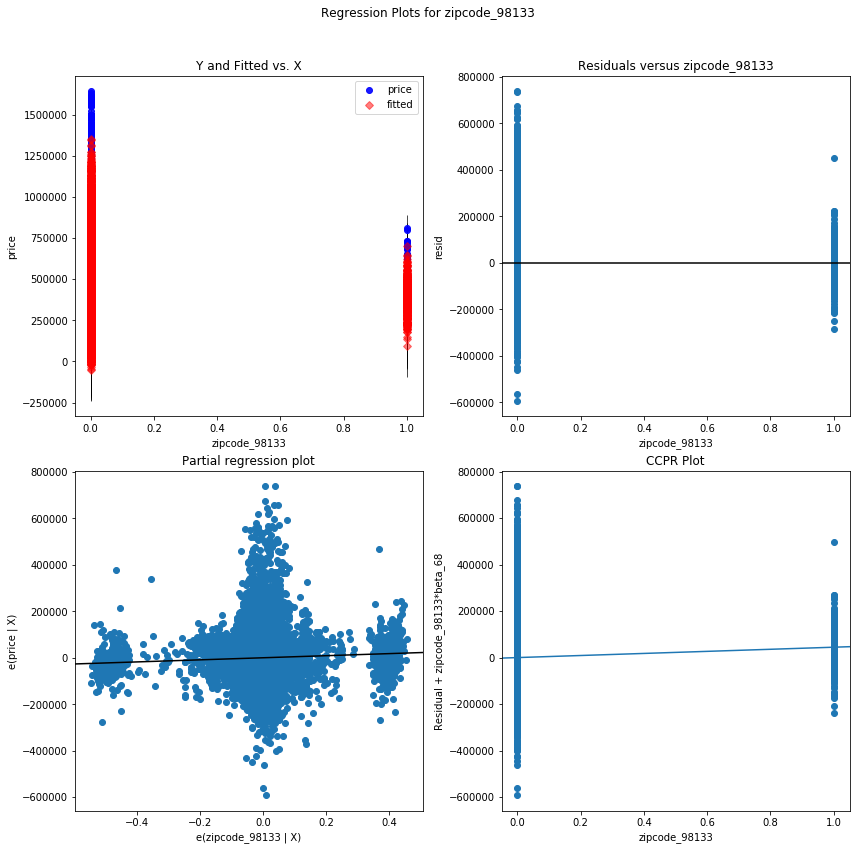

zipcode_98136 - Plotted


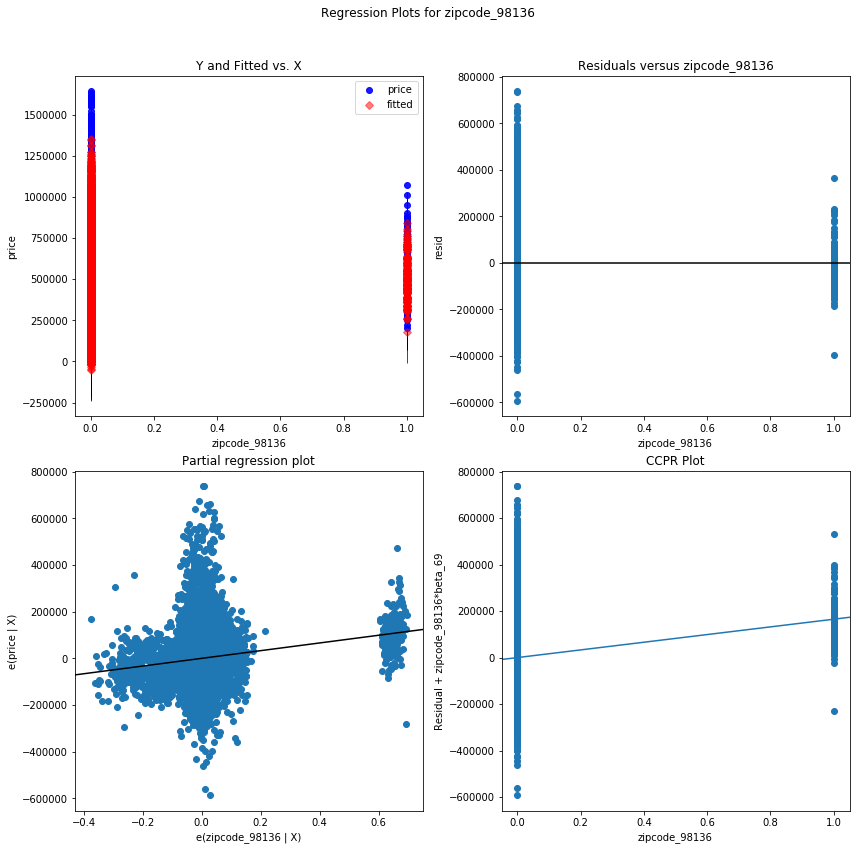

zipcode_98144 - Plotted


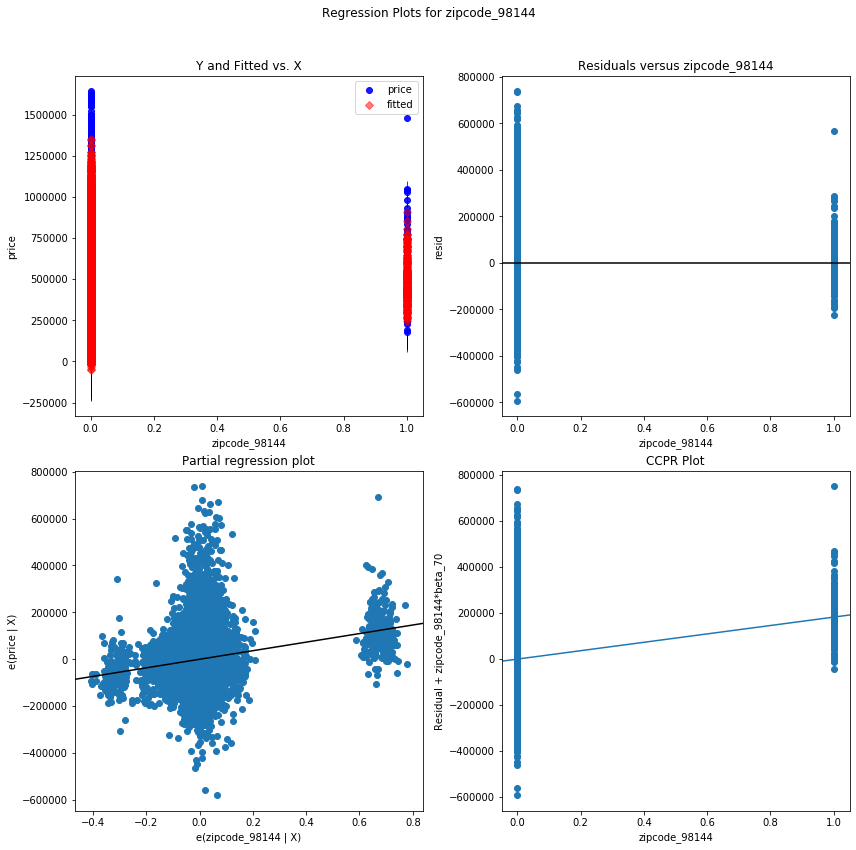

zipcode_98146 - Plotted


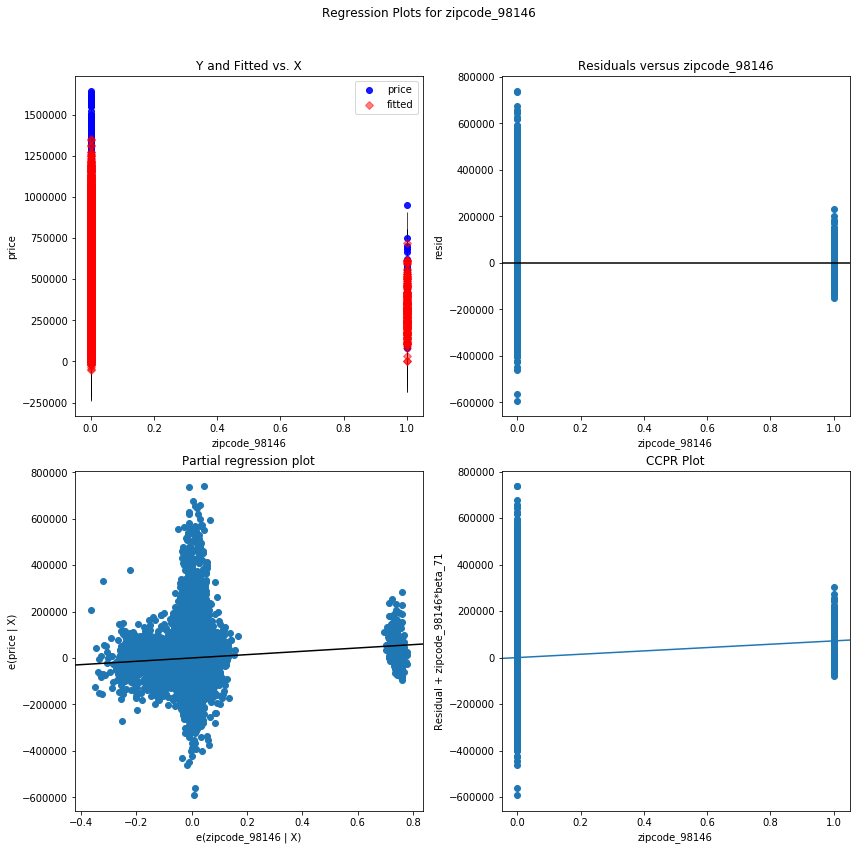

zipcode_98155 - Plotted


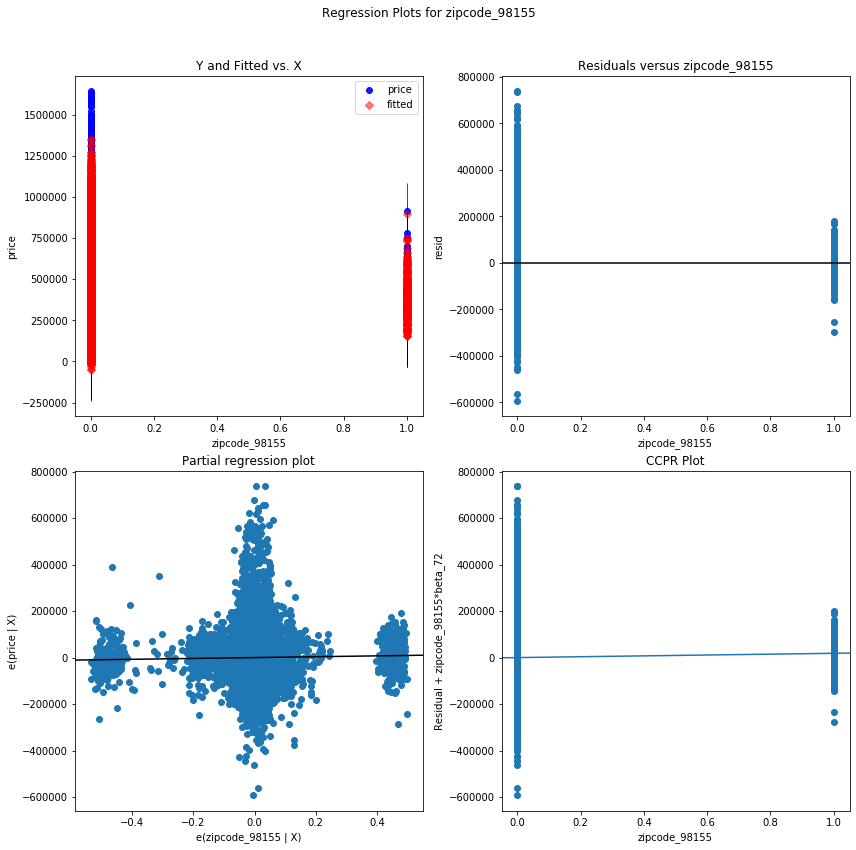

zipcode_98166 - Plotted


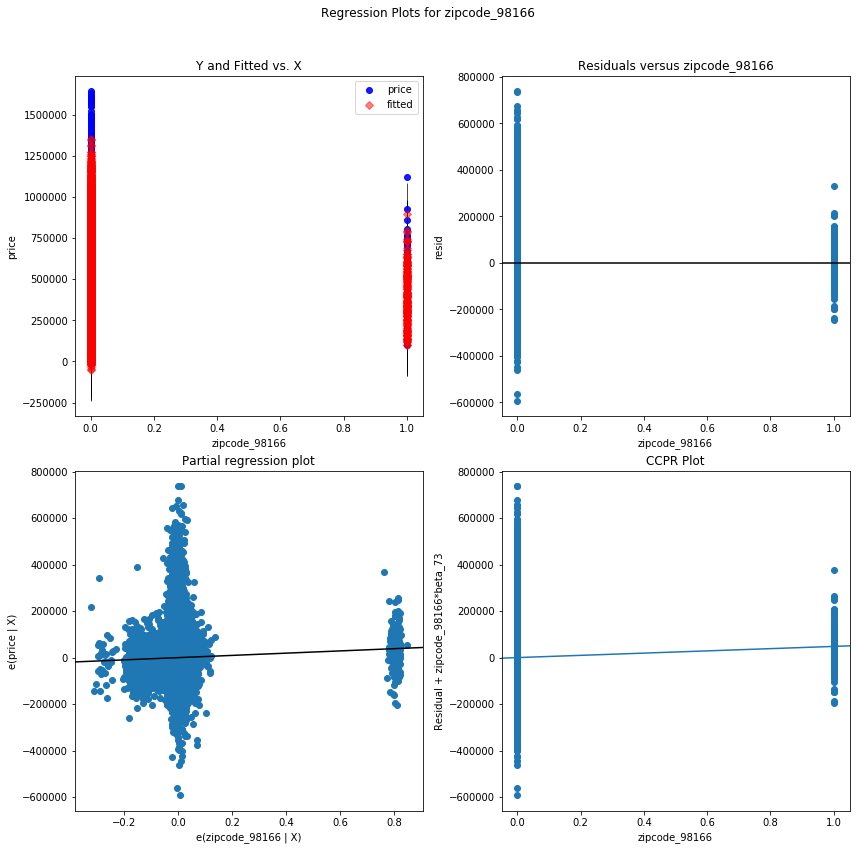

zipcode_98168 - Plotted


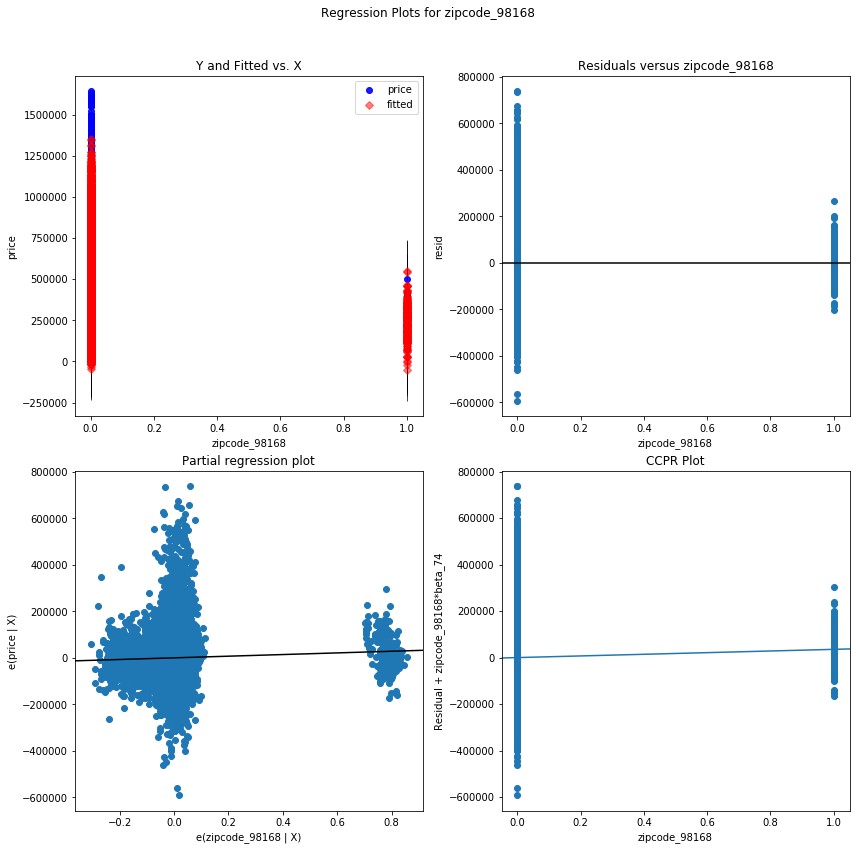

zipcode_98177 - Plotted


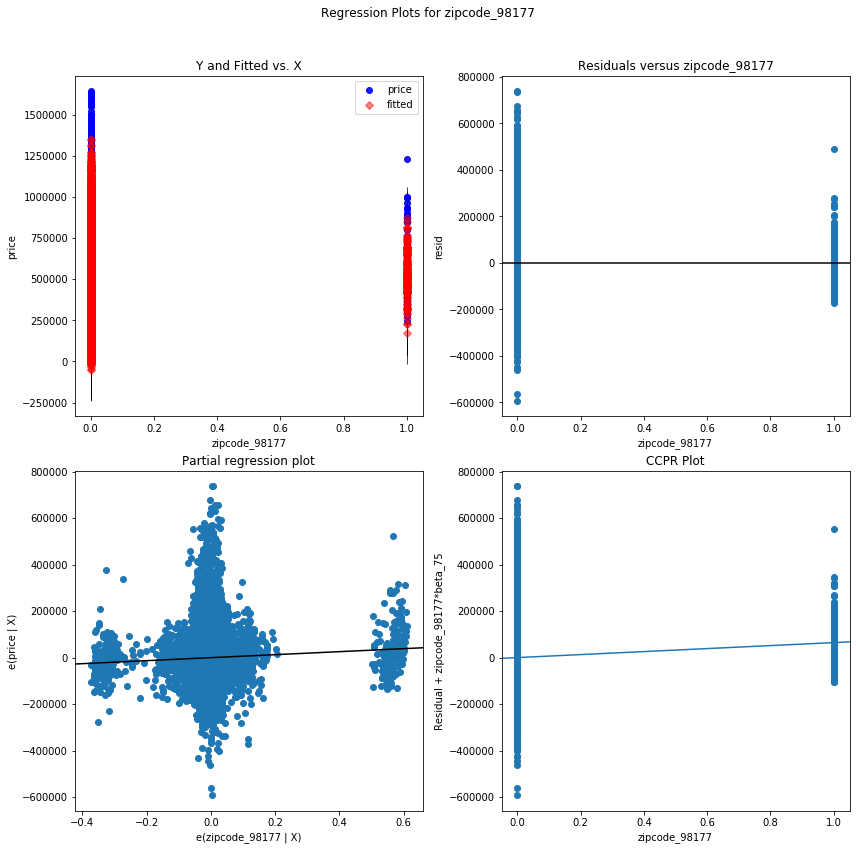

zipcode_98178 - Plotted


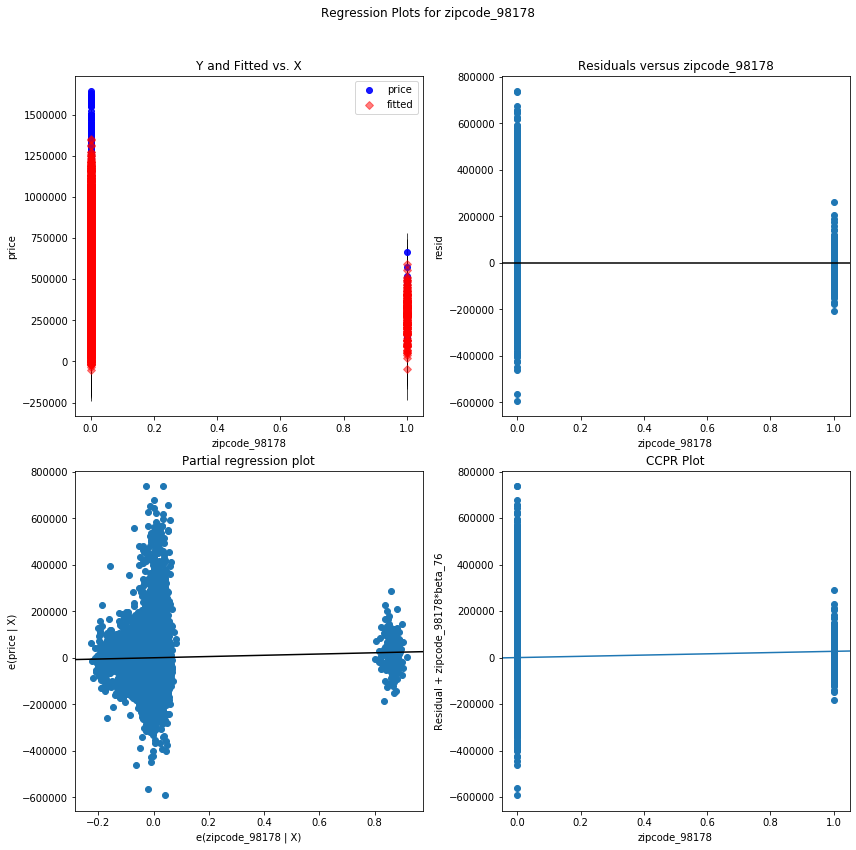

zipcode_98188 - Plotted


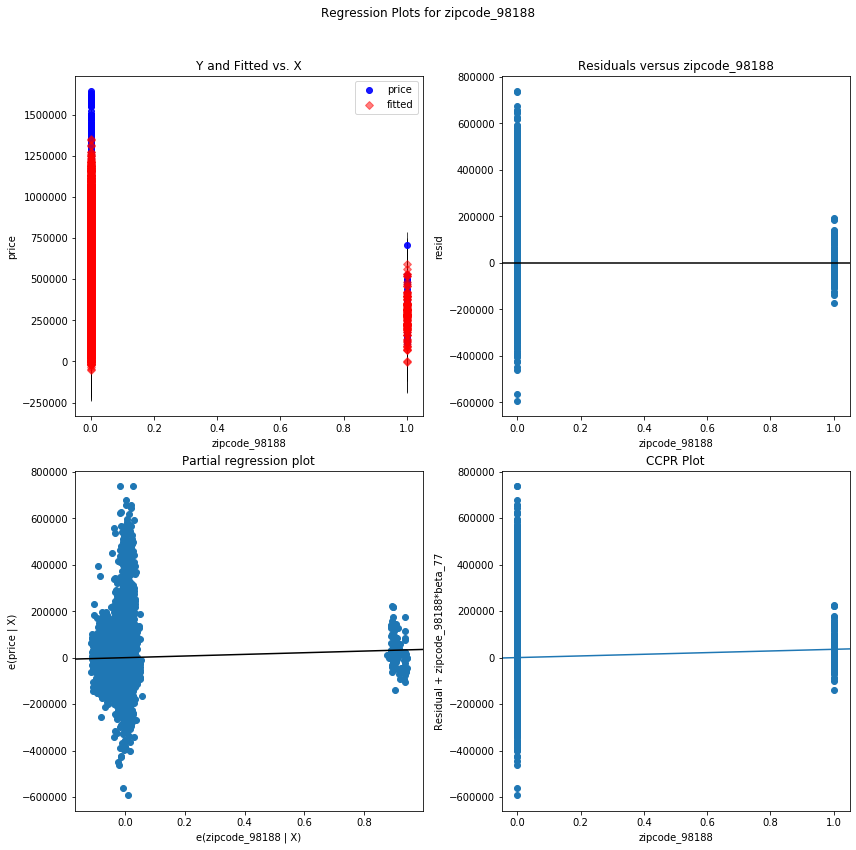

zipcode_98199 - Plotted


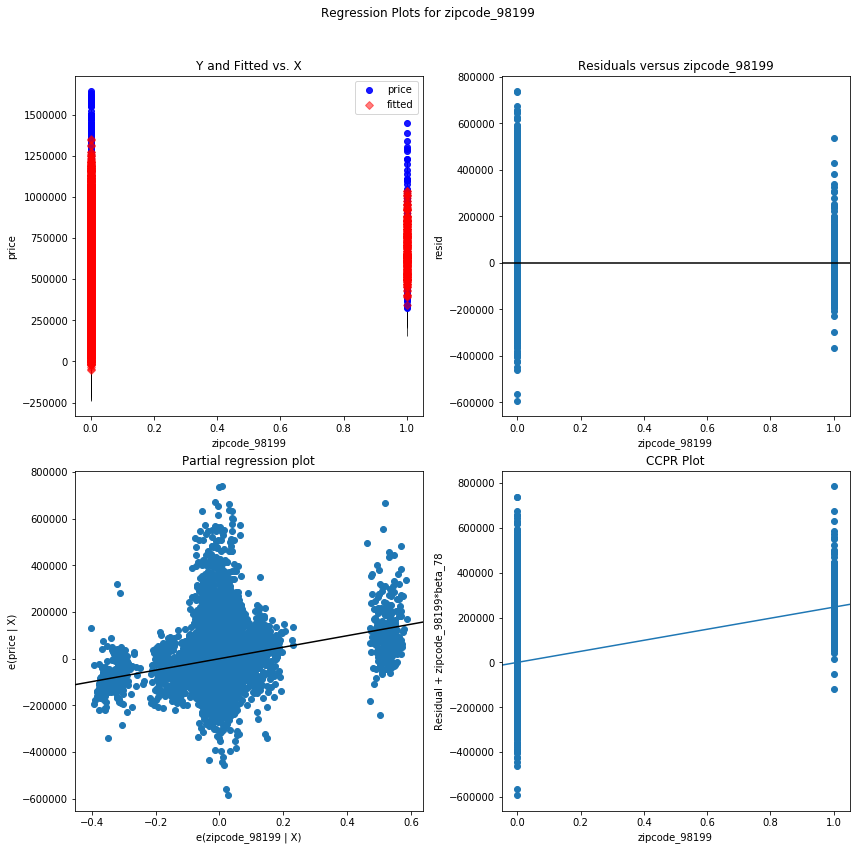

In [131]:
results_multi_bm_std, dfs_coeffs_multi_bm_std, summaries_multi_bm_std, models_multi_bm_std, X_train_models_multi_bm_std, X_test_models_multi_bm_std, y_train_models_multi_bm_std, y_test_models_multi_bm_std, columns_models_multi_bm_std  = run_model(b_pro_std_out.drop(columns_todrop, axis=1), target_pro_noout, 'multilinear_mul_noout-log-std', 10, plots=True )

In [132]:
summaries_multi_bm_std

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.827
Model:                            OLS   Adj. R-squared:                  0.826
Method:                 Least Squares   F-statistic:                     929.2
Date:                Tue, 23 Jun 2020   Prob (F-statistic):               0.00
Time:                        11:50:04   Log-Likelihood:            -1.9374e+05
No. Observations:               15034   AIC:                         3.876e+05
Df Residuals:                   14956   BIC:                         3.882e+05
Df Model:                          77                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
waterfront        -2.557e+06   5.33e+04    -47.923      0.000   -2.66e+06   -2.45e+06
condition           1.63e+04    901.689     18.082      0.000    1.45e+04    1.81e+04
grade              5.834e+04   1390.524     41.952      0.000    5.56e+04    6.11e+04
yr_built          -5327.8450   1323.371     -4.026      0.000   -7921.814   -2733.876
lat                 3.23e+04   2070.066     15.605      0.000    2.82e+04    3.64e+04
long              -2.589e+04   2602.599     -9.948      0.000    -3.1e+04   -2.08e+04
renovated         -1.093e-08   2.39e-10    -45.694      0.000   -1.14e-08   -1.05e-08
log-sqft_living    7.047e+04   9166.093      7.689      0.000    5.25e+04    8.84e+04
log-sqft_lot       2.959e+04   1560.220     18.967      0.000    2.65e+04    3.27e+04
log-sqft_above     1.429e+05   8772.505     16.287      0.000    1.26e+05     1.6e+05
log-sqft_basement  4250.8623    606.616      7.007      0.000    3061.820    5439.905
log-sqft_living15  3.061e+04   4478.801      6.834      0.000    2.18e+04    3.94e+04
log-MHI            7.817e+04   3803.242     20.554      0.000    7.07e+04    8.56e+04
bedrooms_2.0      -5.456e+04   9291.537     -5.872      0.000   -7.28e+04   -3.63e+04
bedrooms_3.0       -7.43e+04   9316.032     -7.976      0.000   -9.26e+04    -5.6e+04
bedrooms_4.0      -6.912e+04   9589.371     -7.208      0.000   -8.79e+04   -5.03e+04
bedrooms_5.0      -6.314e+04   1.01e+04     -6.252      0.000   -8.29e+04   -4.33e+04
bedrooms_6.0       -7.29e+04   1.26e+04     -5.794      0.000   -9.76e+04   -4.82e+04
floors_2.5         4.149e+04   1.08e+04      3.860      0.000    2.04e+04    6.26e+04
floors_3.0        -3.521e+04   5401.275     -6.519      0.000   -4.58e+04   -2.46e+04
view_2.0           6.532e+04   4223.908     15.465      0.000     5.7e+04    7.36e+04
zipcode_98002      5.108e+04   8402.752      6.079      0.000    3.46e+04    6.76e+04
zipcode_98004      4.992e+05   8282.390     60.273      0.000    4.83e+05    5.15e+05
zipcode_98005      2.516e+05   9328.845     26.971      0.000    2.33e+05     2.7e+05
zipcode_98006      1.987e+05   6407.622     31.014      0.000    1.86e+05    2.11e+05
zipcode_98007      1.993e+05   9967.919     19.998      0.000     1.8e+05    2.19e+05
zipcode_98008      1.708e+05   7587.176     22.511      0.000    1.56e+05    1.86e+05
zipcode_98010      9.726e+04   1.38e+04      7.062      0.000    7.03e+04    1.24e+05
zipcode_98011      3.054e+04   9589.797      3.185      0.001    1.17e+04    4.93e+04
zipcode_98014      6.405e+04   1.44e+04      4.443      0.000    3.58e+04    9.23e+04
zipcode_98022      8.793e+04   1.07e+04      8.244      0.000     6.7e+04    1.09e+05
zipcode_98023     -4.512e+04   6140.742     -7.348      0.000   -5.72e+04   -3.31e+04
zipcode_98024      1.199e+05   1.68e+04      7.126      0.000    8.69e+04

In [ ]:
dfs_coeffs_multi_bm_std.sort_values(by='multilinear_mul_noout-log-std', ascending=False).head(30)

In [ ]:
abs(dfs_coeffs_multi_bm_std['multilinear_mul_noout-log-std']).sort_values(ascending=False).head(30)

In [120]:
result_bestmulti, df_coeff_bestmulti, summary_bestmulti, model_bestmulti,  X_train_bestmulti, X_test_bestmulti, y_train_bestmulti, y_test_bestmulti, columns_bestmulti = run_model(b_pro_out, target_pro_noout, 'multilinear-noout', cv=10)


/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


In [134]:
predictions_bestmulti = model_bestmulti[0].predict(X_test_bestmulti)

In [135]:
lowers, uppers, residuals = get_prediction_interval(y_test_bestmulti, predictions_bestmulti)

In [136]:
residuals

,predicted-price,price,residuals,residuals2
0,120283.915474,302000.0,181716.084526,3.302074e+10
1,117450.083478,213950.0,96499.916522,9.312234e+09
2,609149.449676,650000.0,40850.550324,1.668767e+09
3,821076.616706,847000.0,25923.383294,6.720218e+08
4,472835.021890,445000.0,-27835.021890,7.747884e+08
...,...,...,...,...
3754,736497.469145,640000.0,-96497.469145,9.311762e+09
3755,213368.972921,235000.0,21631.027079,4.679013e+08
3756,404386.182058,400000.0,-4386.182058,1.923859e+07
3757,607847.357775,685000.0,77152.642225,5.952530e+09


In [137]:
rse_multi = np.sqrt(residuals['residuals2'].sum() / (len(X_train) - 2))

In [138]:
rse_multi

47132.089497531044

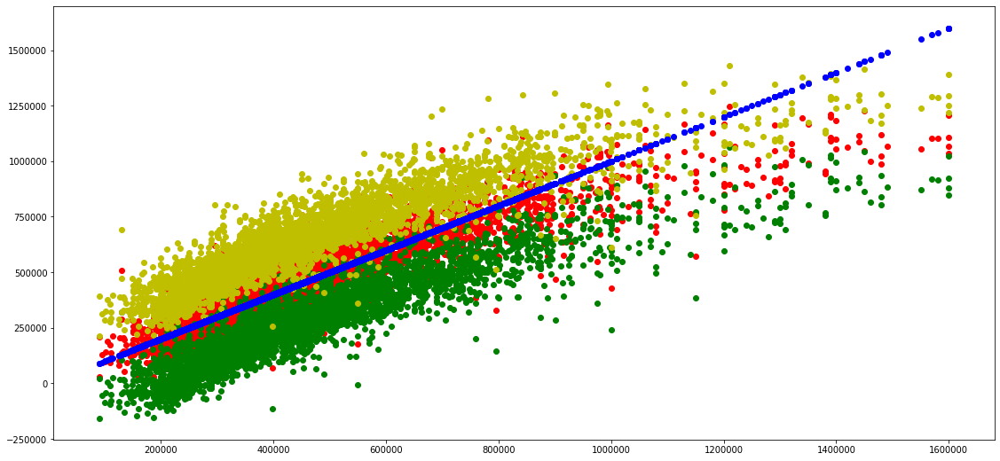

In [139]:
plt.figure(figsize=(19,9))
plt.scatter(y_test_bestmulti, residuals['predicted-price'], color='r')
plt.scatter(y_test_bestmulti, lowers, color='g')
plt.scatter(y_test_bestmulti, uppers, color='y')
plt.scatter(y_test_bestmulti, y_test_bestmulti, color='b')

## Multilinear regression with feature selection

In [73]:
dfresults, dfs_coeff, summaries, models_dict, X_train_models, X_test_models, y_train_models, y_test_models, columns_models     = run_multi_models(multi_models, multi_targets, multi_descriptions, featureSelection=True)

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be rem

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is de

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/base/model.py:1294: RuntimeWarning: invalid value encountered in true_divide

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/base/model.py:1294: RuntimeWarning: invalid value encountered in true_divide
  return self.params / self.bse
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in less
  return (a < x

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/base/model.py:1294: RuntimeWarning: invalid value encountered in true_divide

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site


multilinear --- Adj.R^2: ['0.815']


Top 10 coefficients by absolute value
                 multilinear
const          2.943529e+07
zipcode_98039  1.099450e+06
waterfront     5.731833e+05
zipcode_98004  5.332182e+05
lat            4.091312e+05
zipcode_98112  4.021991e+05
bedrooms_10.0  3.839655e+05
view_4.0       3.379576e+05
zipcode_98040  3.272854e+05
zipcode_98102  3.100398e+05 

Top 10 coefficients (actual values)
                 multilinear
zipcode_98039  1.099450e+06
waterfront     5.731833e+05
zipcode_98004  5.332182e+05
lat            4.091312e+05
zipcode_98112  4.021991e+05
view_4.0       3.379576e+05
zipcode_98040  3.272854e+05
zipcode_98102  3.100398e+05
zipcode_98109  2.943445e+05
zipcode_98119  2.686999e+05

multilinear-log --- Adj.R^2: ['0.765']


Top 10 coefficients by absolute value
                 multilinear-log
waterfront         5.625567e+07
zipcode_98039      1.162818e+06
lat                8.339213e+05
view_4.0           5.883487e+05
zipcode_98004      4.763403


Top 10 coefficients by absolute value
                multilinear_6cat_noout-log-robscal
waterfront                           2.644440e+06
zipcode_98004                        4.407185e+05
zipcode_98040                        3.335446e+05
zipcode_98112                        3.144109e+05
zipcode_98109                        3.120801e+05
zipcode_98102                        2.940219e+05
zipcode_98119                        2.763704e+05
zipcode_98105                        2.609636e+05
zipcode_98199                        2.084945e+05
zipcode_98122                        2.027876e+05 

Top 10 coefficients (actual values)
                multilinear_6cat_noout-log-robscal
zipcode_98004                       440718.529675
zipcode_98040                       333544.629328
zipcode_98112                       314410.886047
zipcode_98109                       312080.111622
zipcode_98102                       294021.872021
zipcode_98119                       276370.394578
zipcode_98105        

In [76]:
dfresults

,Description,RMSE training,RMSE test,R-squared training,R-squared test,Adjusted R-squared training,Adjusted R-squared test,Average R-squared 10-Fold Cross Validation,Standard deviation of average R-squared Cross Validation
0,multilinear,158405.528,160760.763,0.815,0.804,0.815,0.804,0.811,0.018
0,multilinear-log,178548.097,183239.271,0.765,0.745,0.765,0.745,0.762,0.031
0,multilinear-log-minmax,178548.058,183239.602,0.765,0.745,0.765,0.745,0.762,0.031
0,multilinear-log-robscal,178548.097,183239.271,0.765,0.745,0.765,0.745,0.762,0.031
0,multilinear-log-std,178548.097,183239.271,0.765,0.745,0.765,0.745,0.762,0.031
0,multilinear_6cat,158951.401,161825.940,0.814,0.801,0.814,0.801,0.811,0.020
0,multilinear_6cat-log,180368.808,185186.869,0.760,0.739,0.760,0.739,0.759,0.034
0,multilinear_6cat-log-minmax,180368.710,185186.233,0.760,0.739,0.760,0.739,0.759,0.034
0,multilinear_6cat-log-robscal,180368.885,185187.331,0.760,0.739,0.760,0.739,0.759,0.034
0,multilinear_6cat-log-std,180368.616,185185.537,0.760,0.739,0.760,0.739,0.759,0.034


In [77]:
pickle_regression_results('multilinear-feature-selection' ,dfresults, dfs_coeff, summaries, models_dict, X_train_models, X_test_models, y_train_models, y_test_models, columns_models)

In [78]:
summaries

{'multilinear': <class 'statsmodels.iolib.summary.Summary'>
 """
                             OLS Regression Results                            
 Dep. Variable:                  price   R-squared:                       0.815
 Model:                            OLS   Adj. R-squared:                  0.814
 Method:                 Least Squares   F-statistic:                     936.5
 Date:                Tue, 23 Jun 2020   Prob (F-statistic):               0.00
 Time:                        00:04:09   Log-Likelihood:            -2.3136e+05
 No. Observations:               17276   AIC:                         4.629e+05
 Df Residuals:                   17194   BIC:                         4.635e+05
 Df Model:                          81                                         
 Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
 ---------------------------------------------------

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/base/model.py:1294: RuntimeWarning: invalid value encountered in true_divide
  return self.params / self.bse
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1892: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)
/opt/anaconda3/envs/learn-env/lib/python3

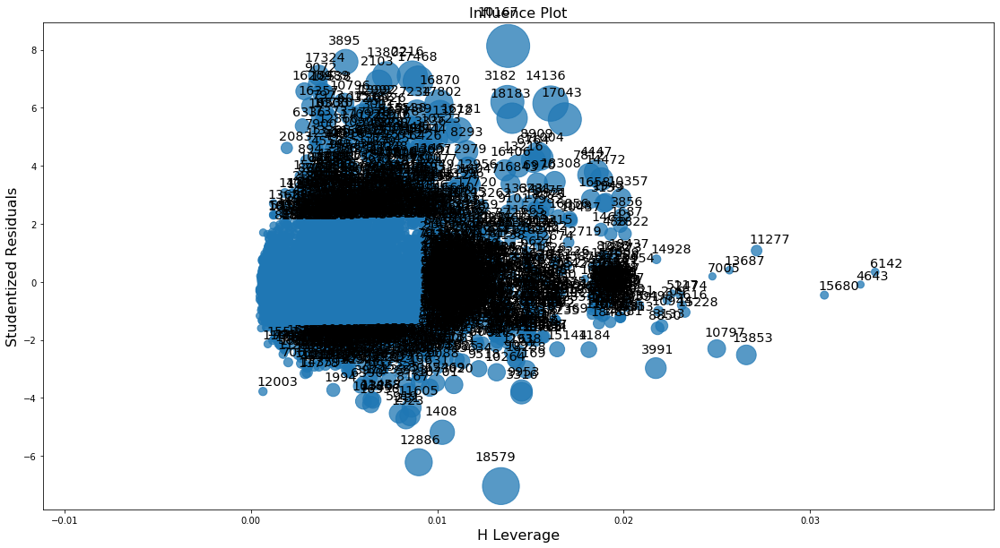

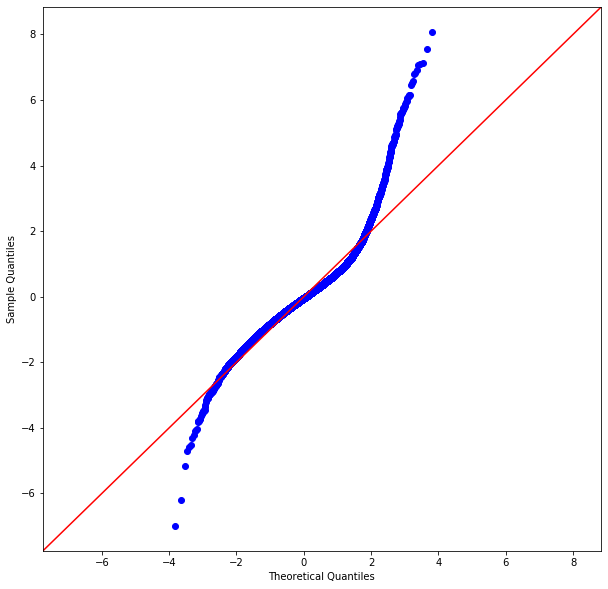

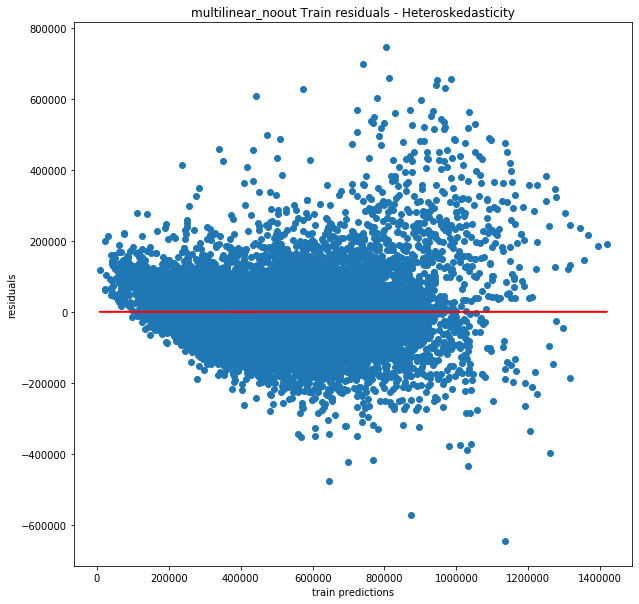

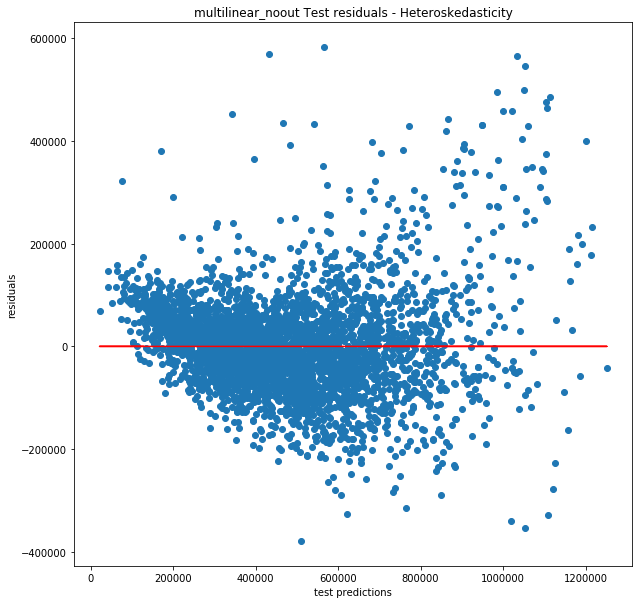

grade - Plotted


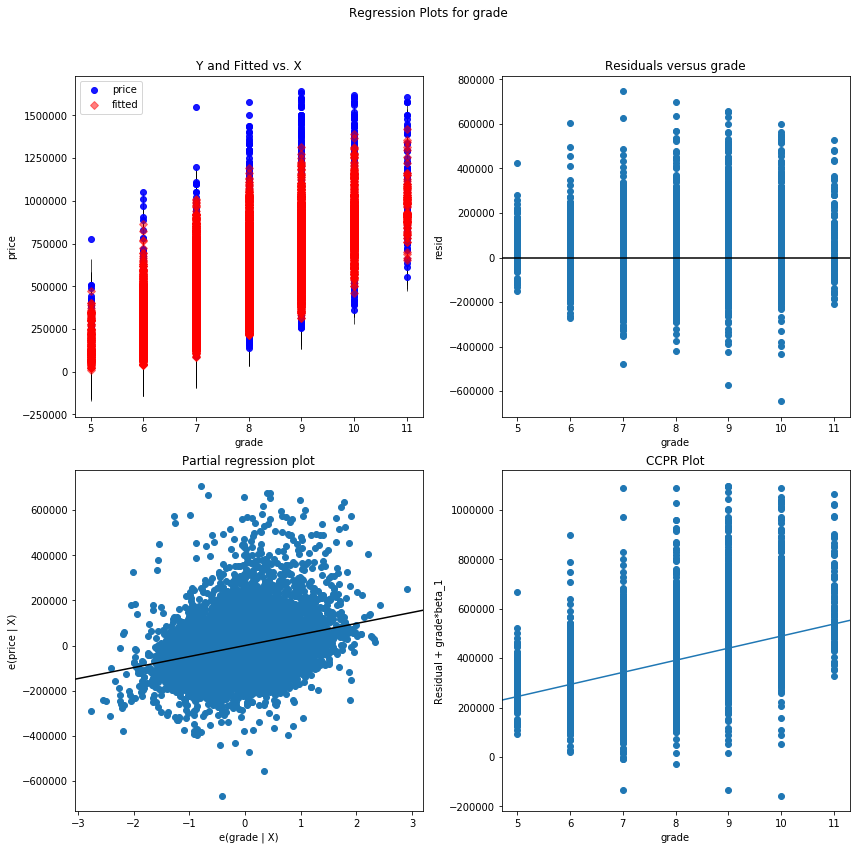

lat - Plotted


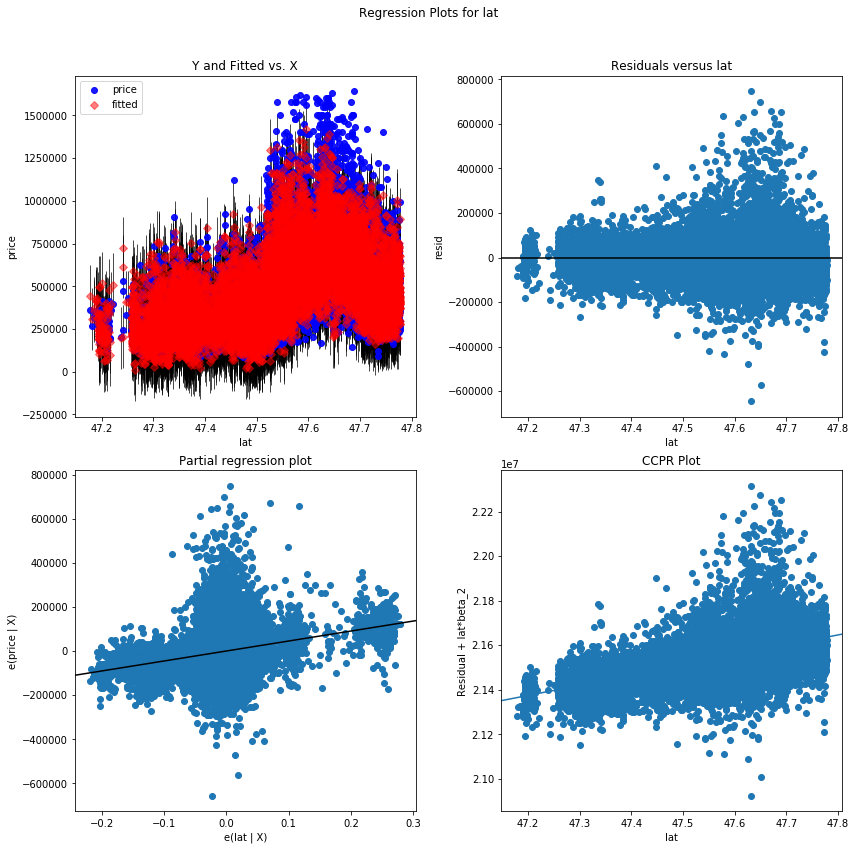

MHI - Plotted


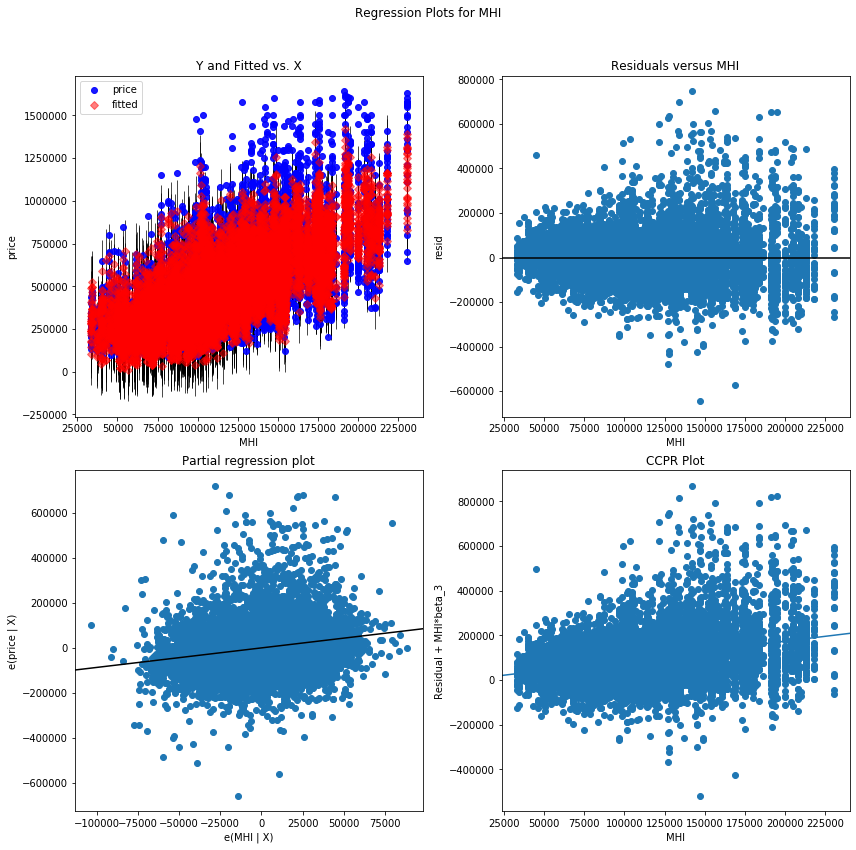

sqft_living - Plotted


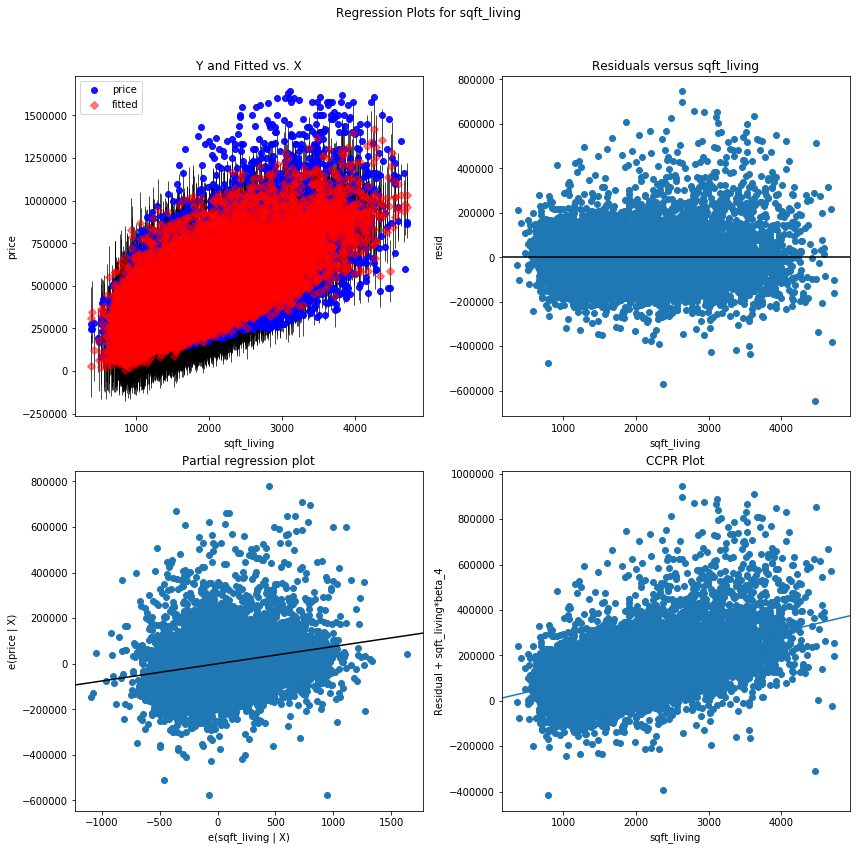

yr_built - Plotted


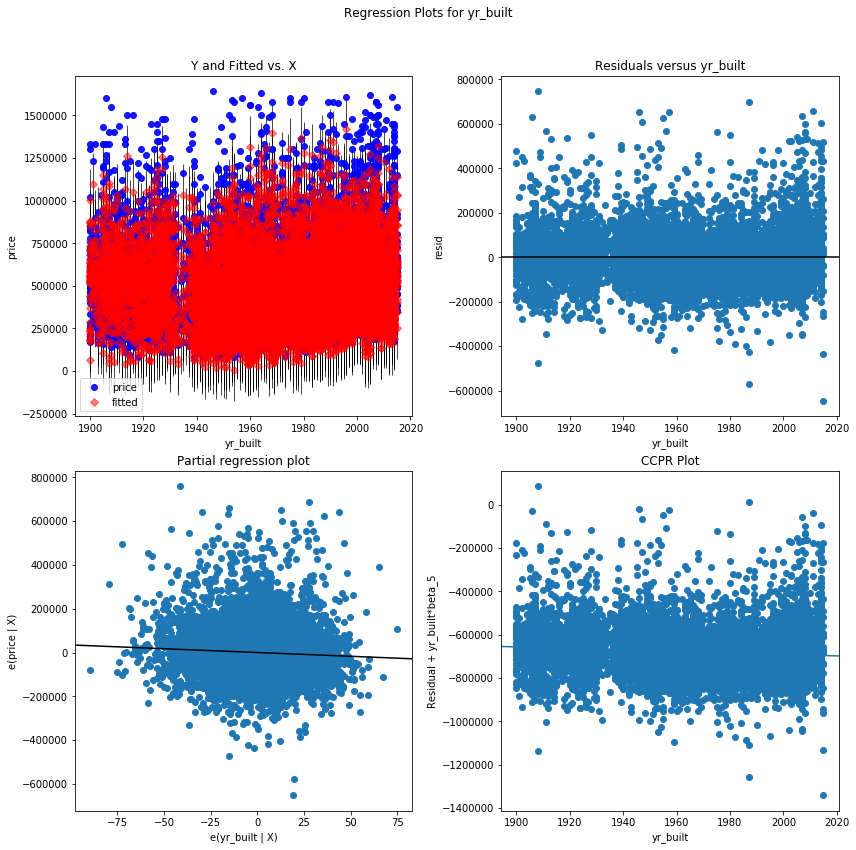

zipcode_98004 - Plotted


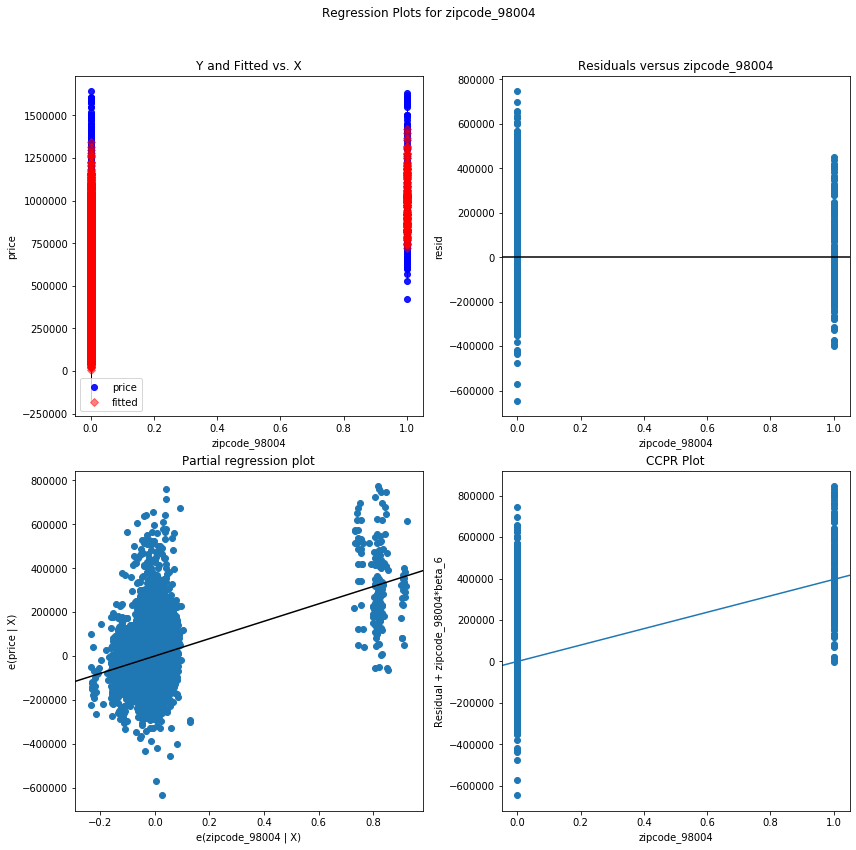

long - Plotted


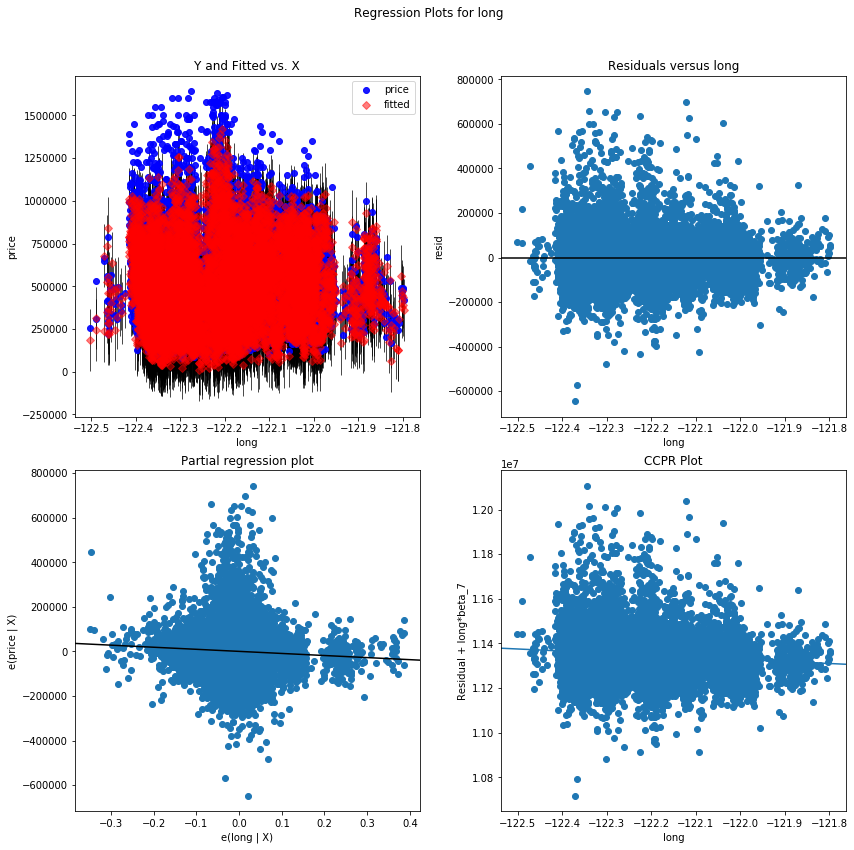

zipcode_98040 - Plotted


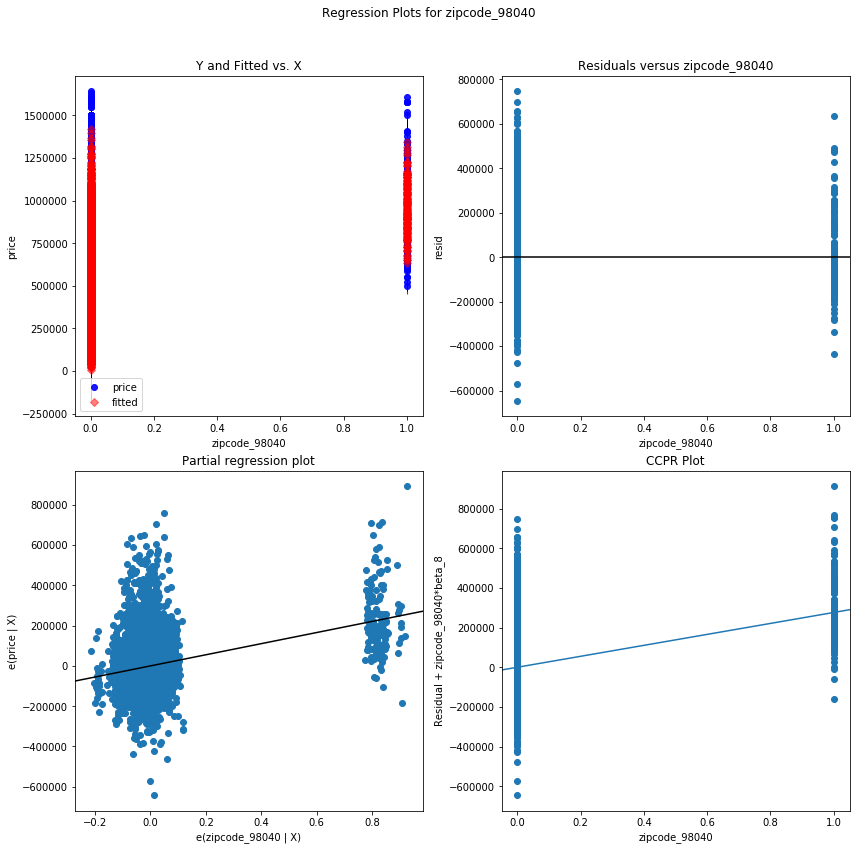

zipcode_98033 - Plotted


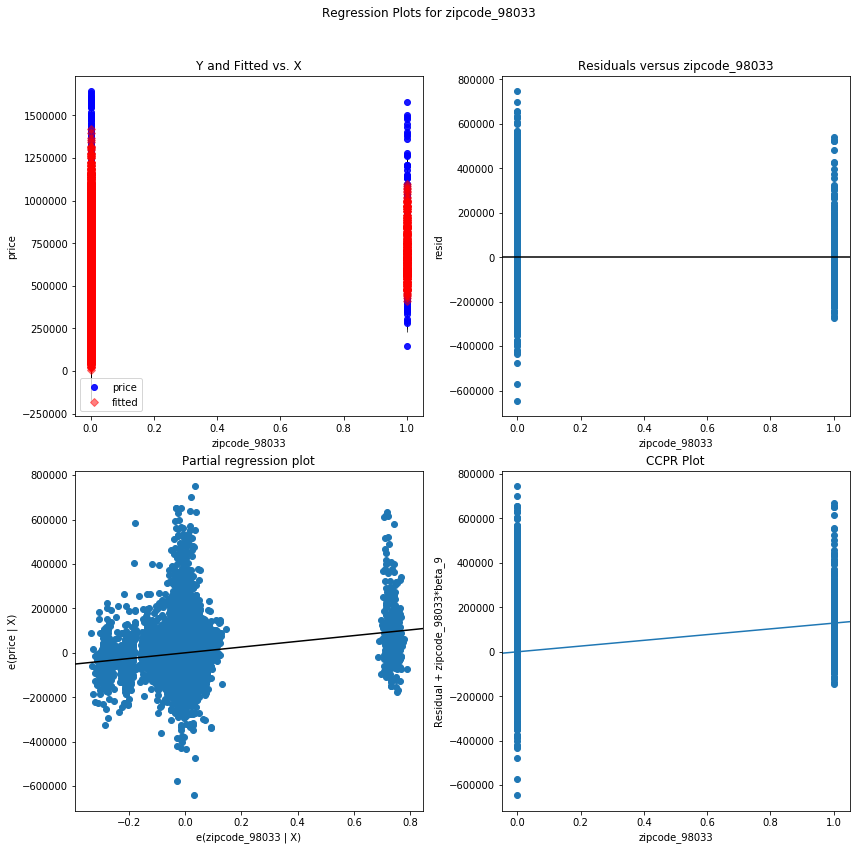

zipcode_98023 - Plotted


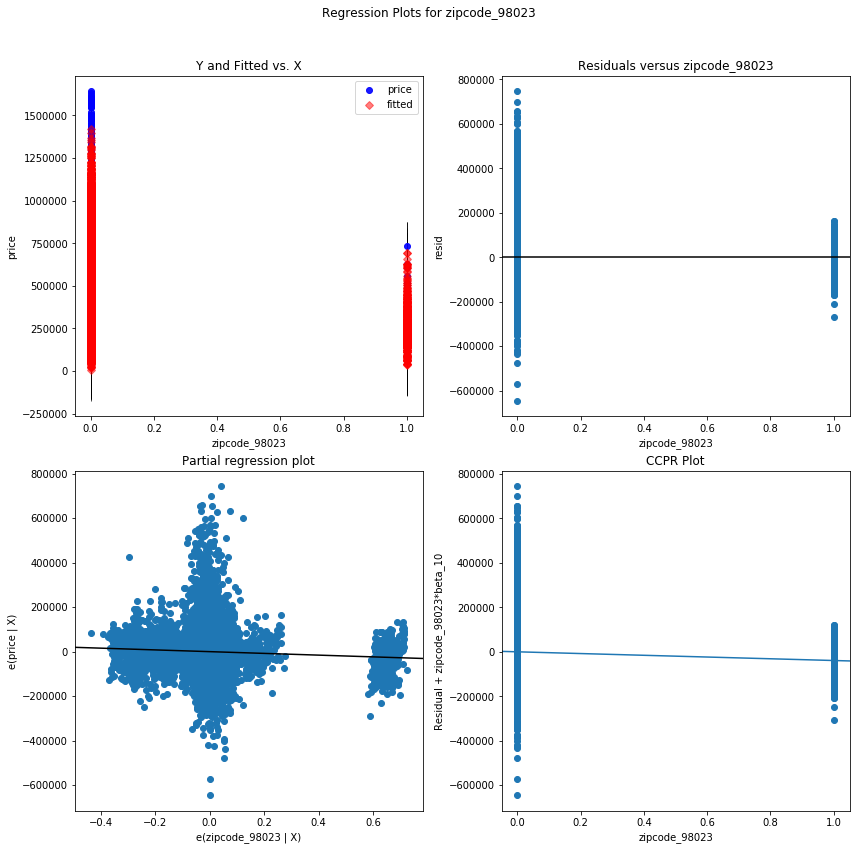

zipcode_98028 - Plotted


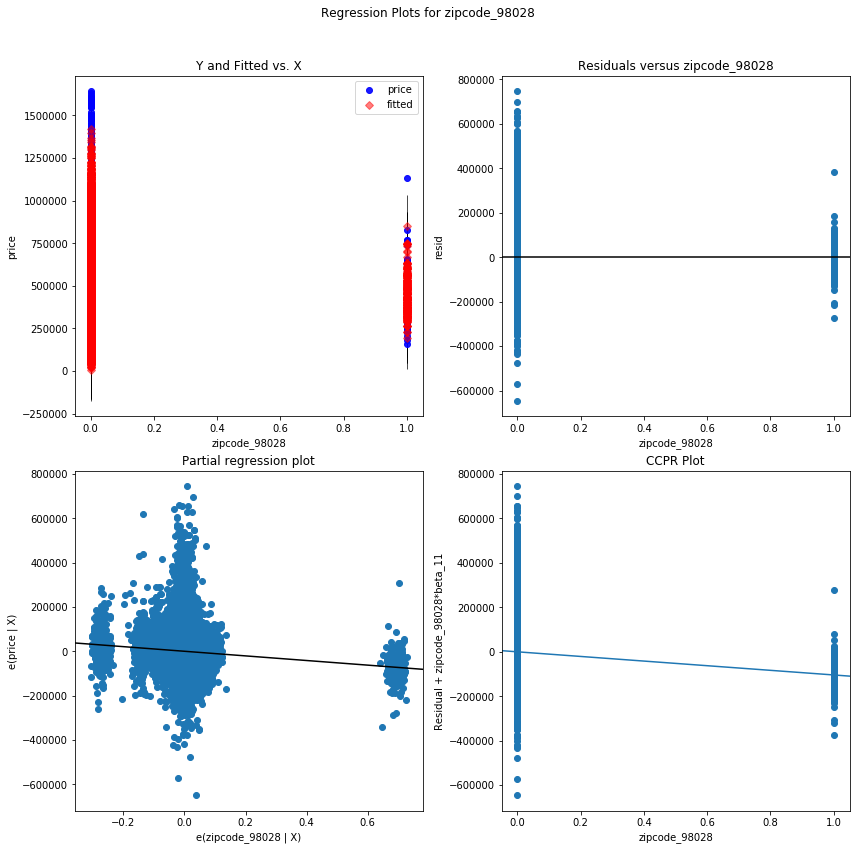

zipcode_98155 - Plotted


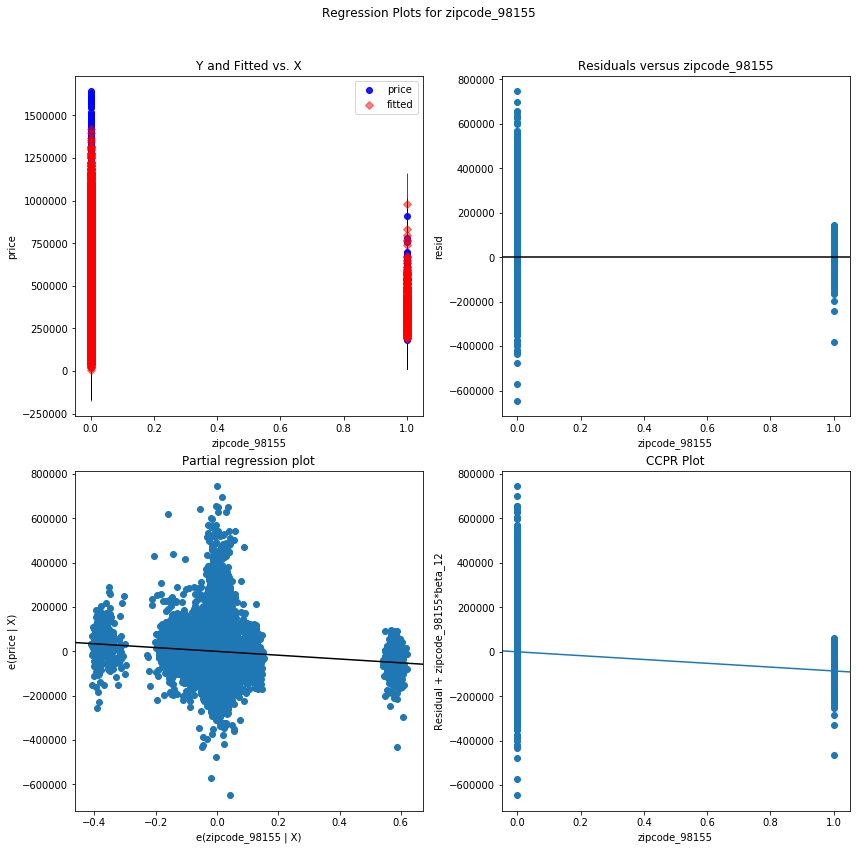

zipcode_98133 - Plotted


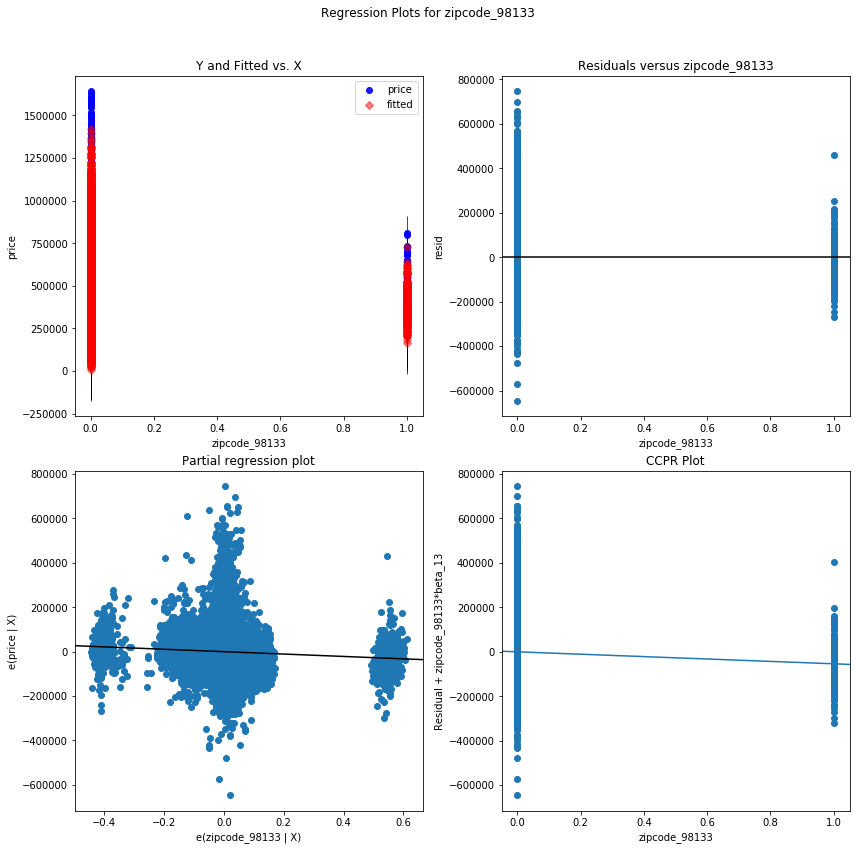

zipcode_98112 - Plotted


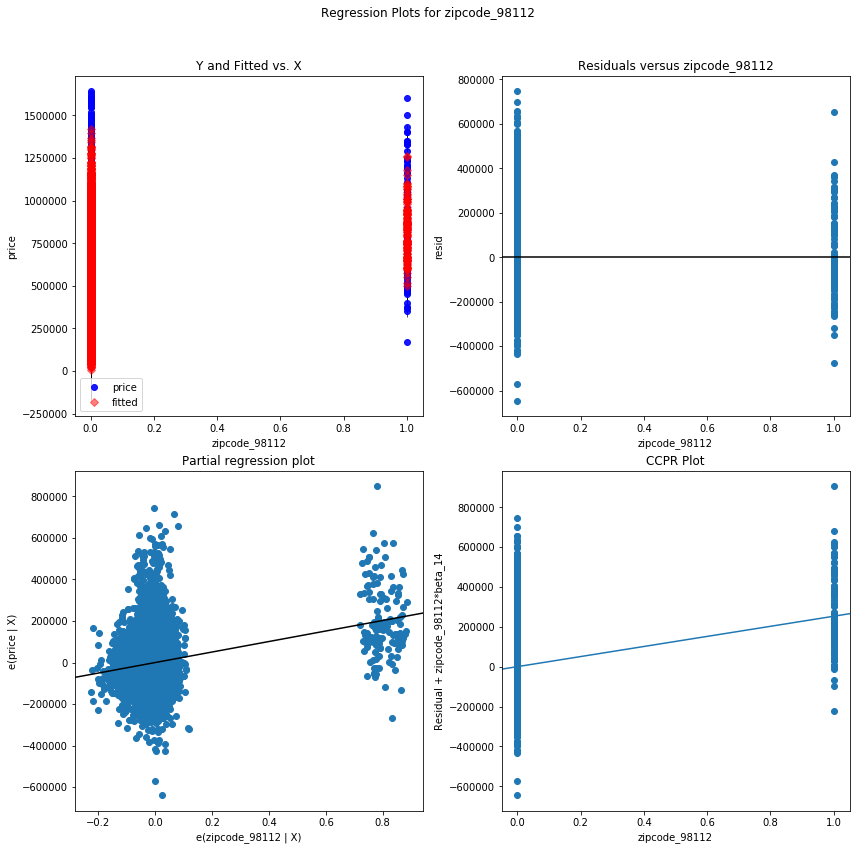

condition - Plotted


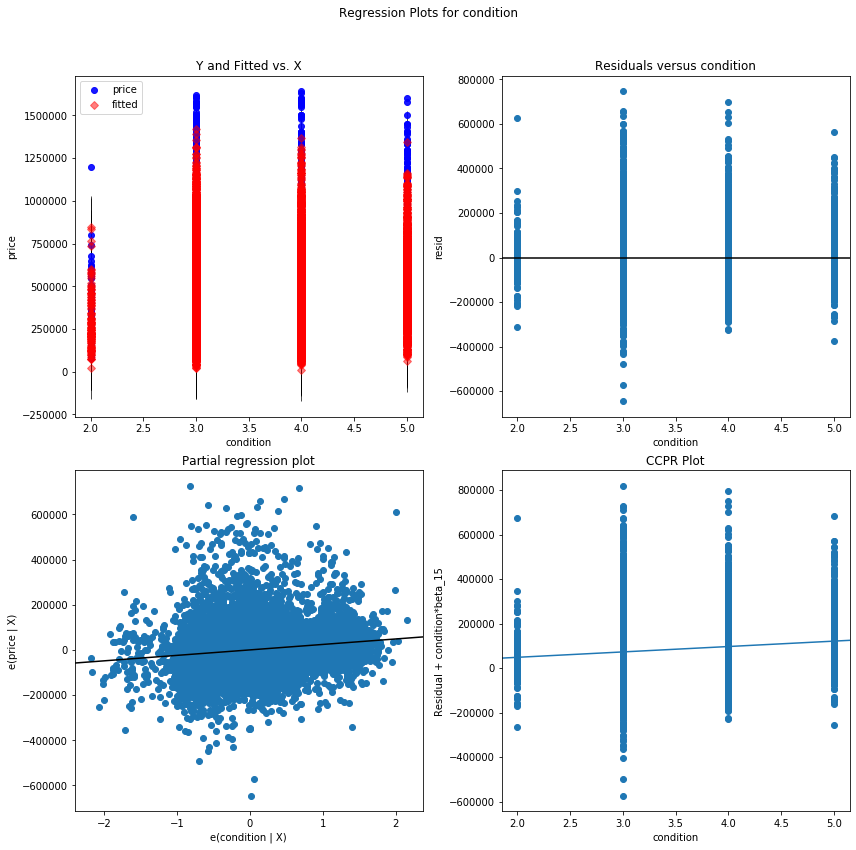

zipcode_98019 - Plotted


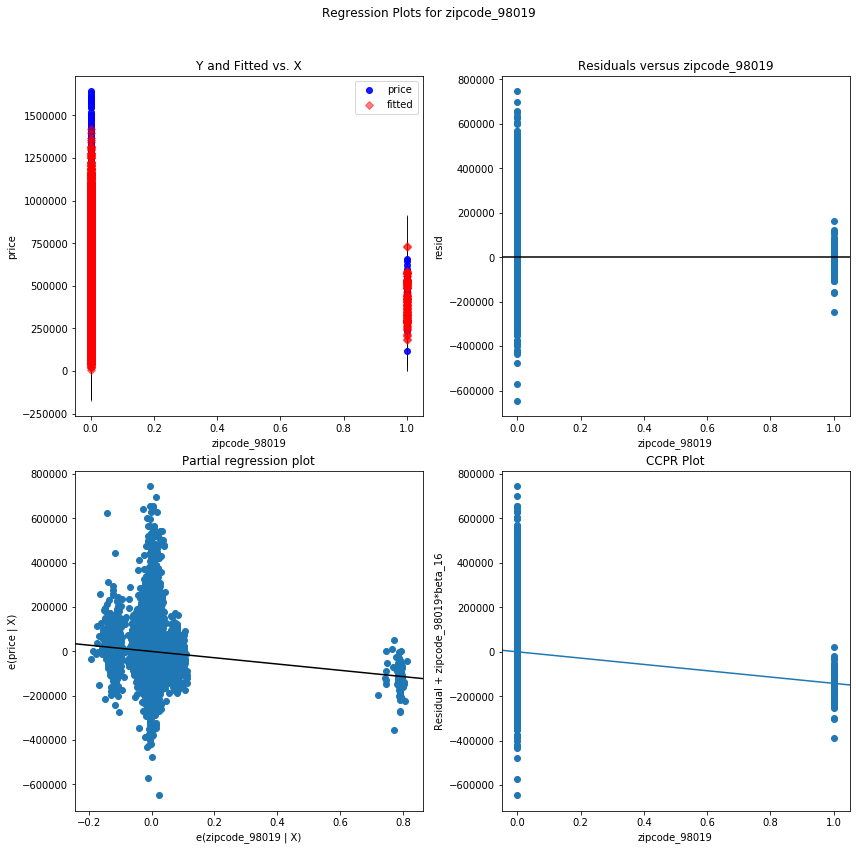

view_2.0 - Plotted


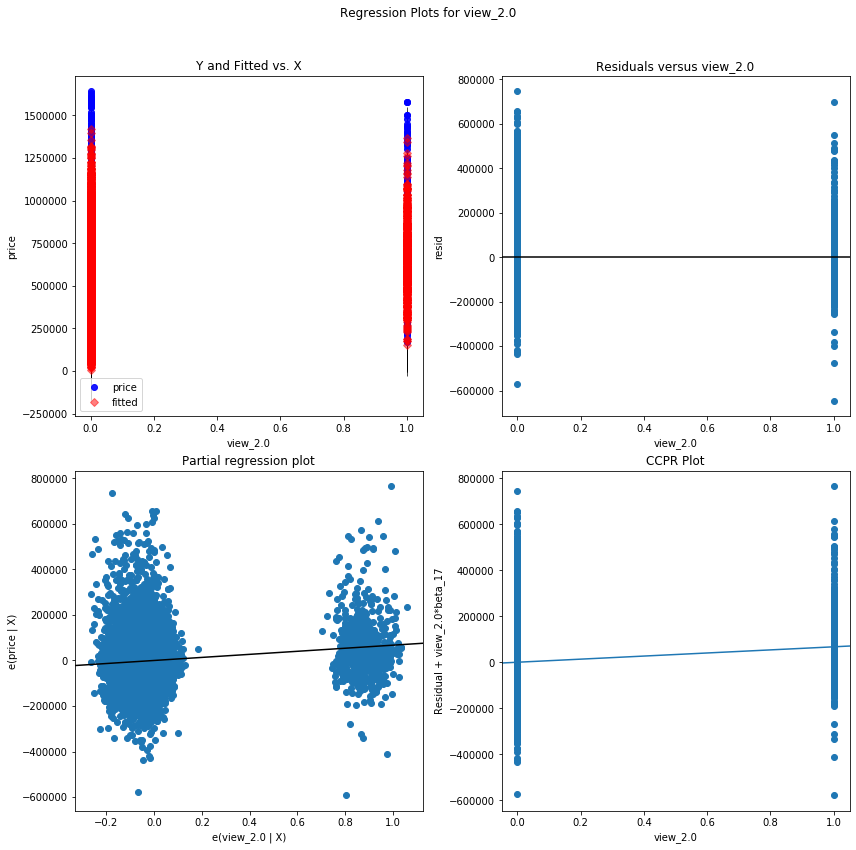

zipcode_98005 - Plotted


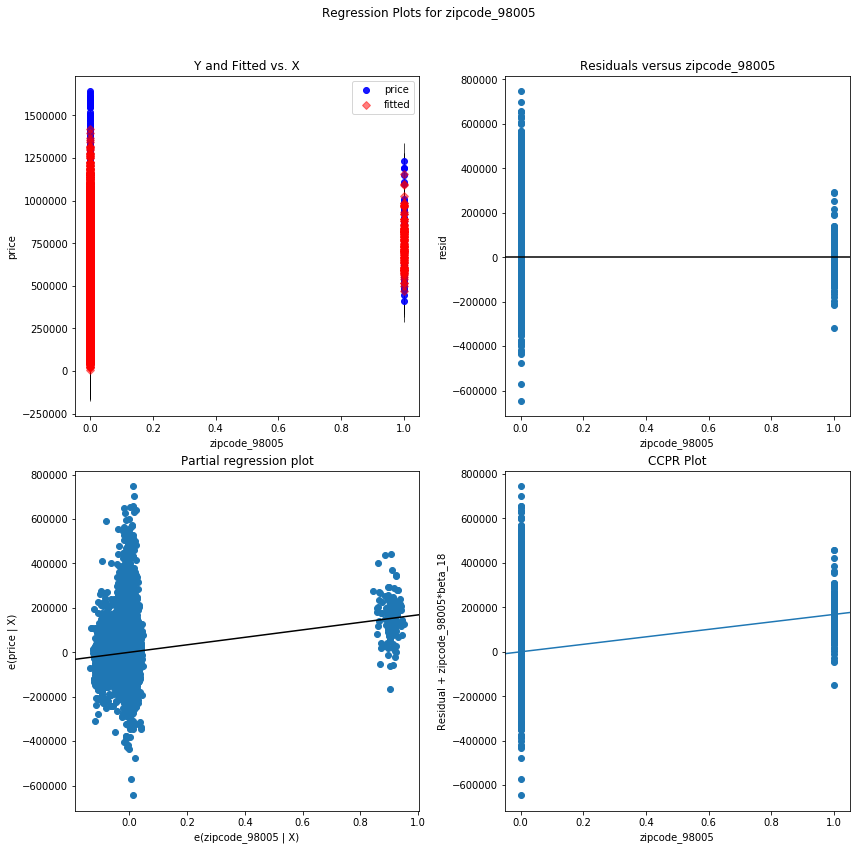

zipcode_98105 - Plotted


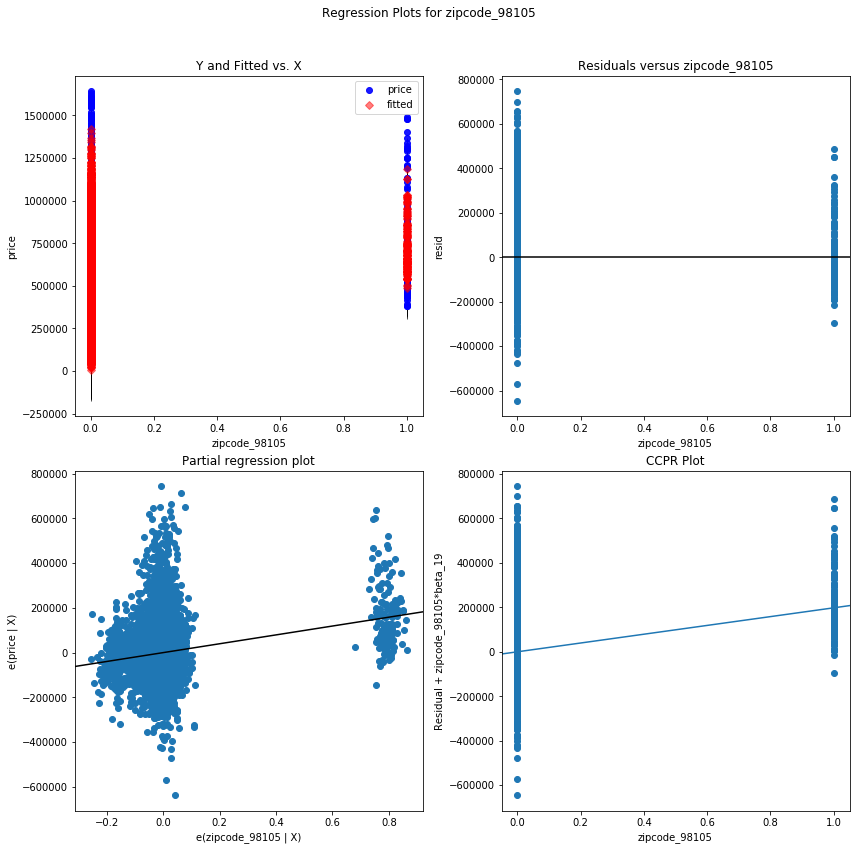

sqft_above - Plotted


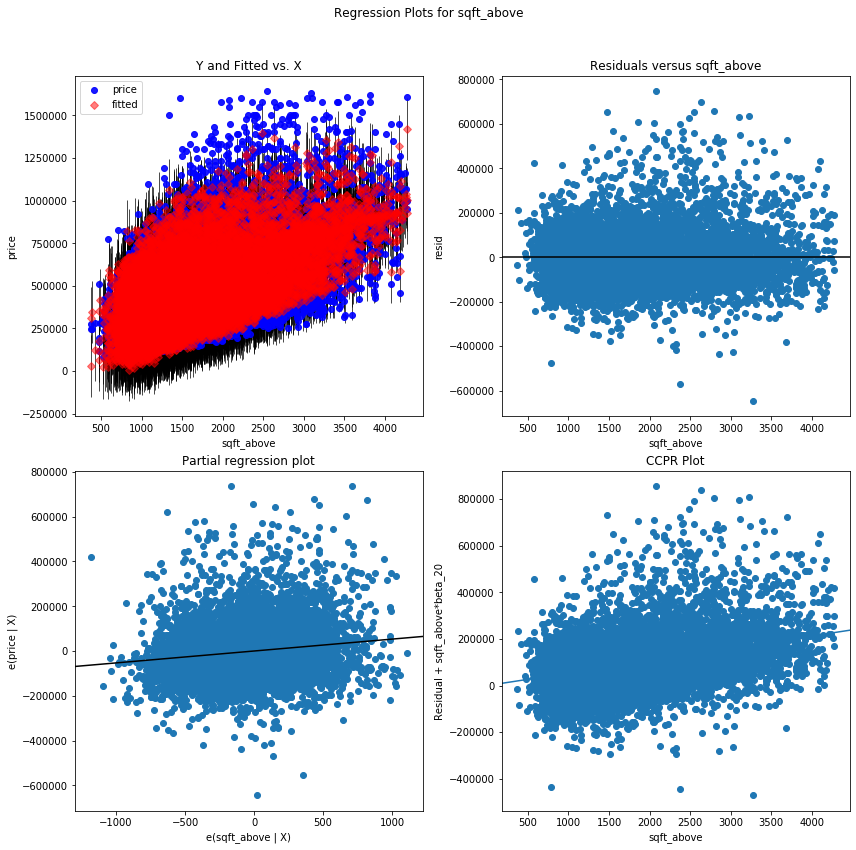

zipcode_98102 - Plotted


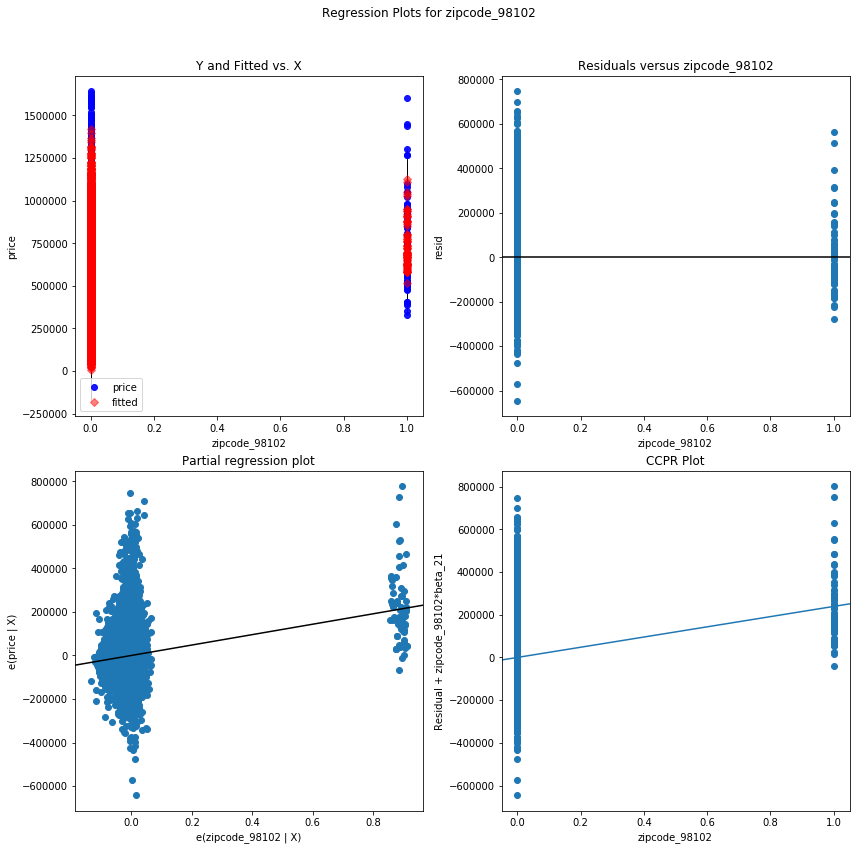

zipcode_98006 - Plotted


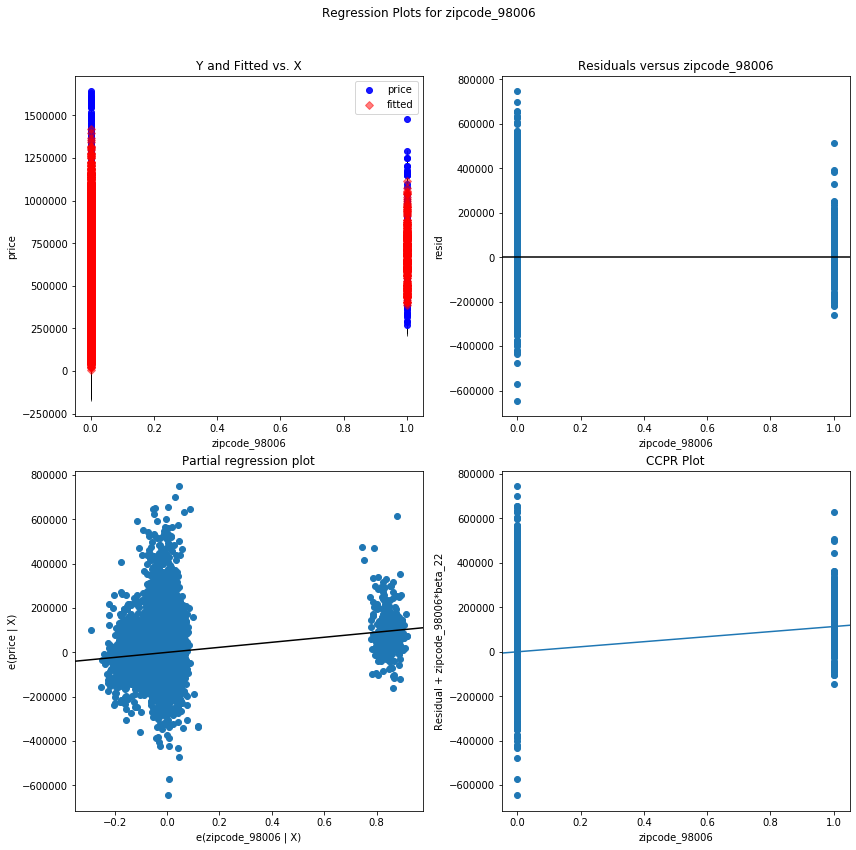

zipcode_98077 - Plotted


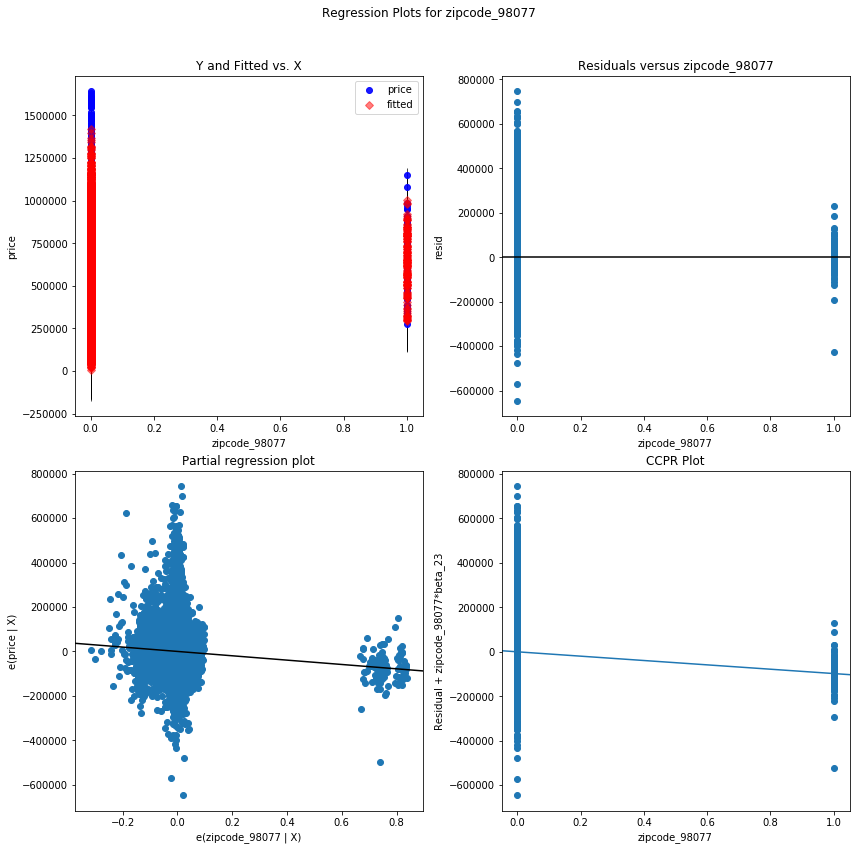

zipcode_98034 - Plotted


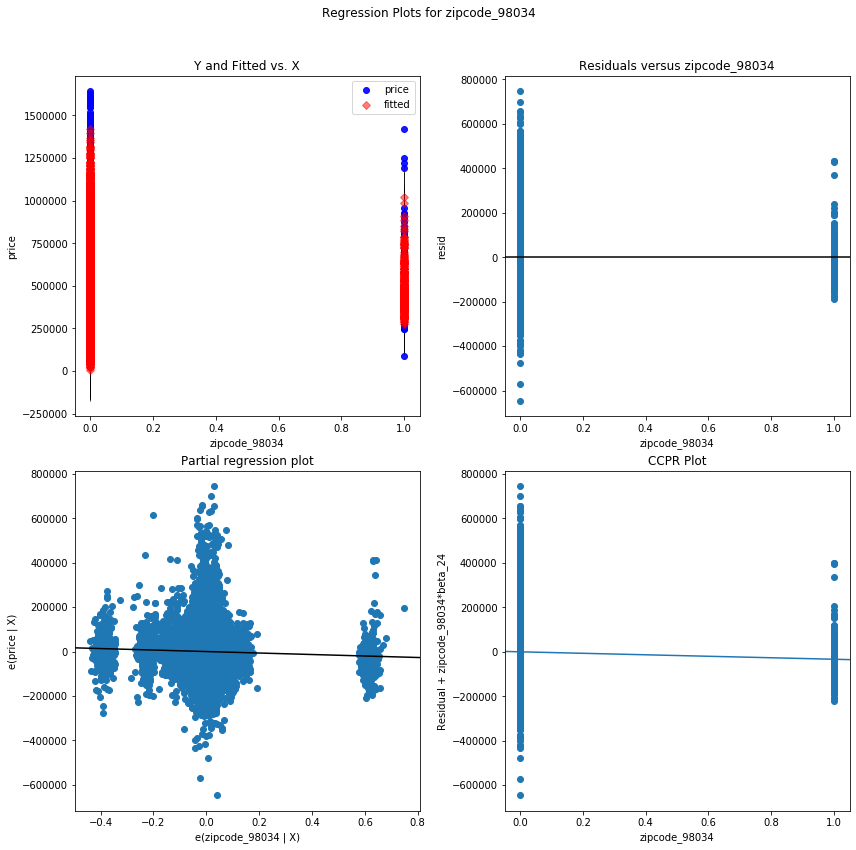

zipcode_98072 - Plotted


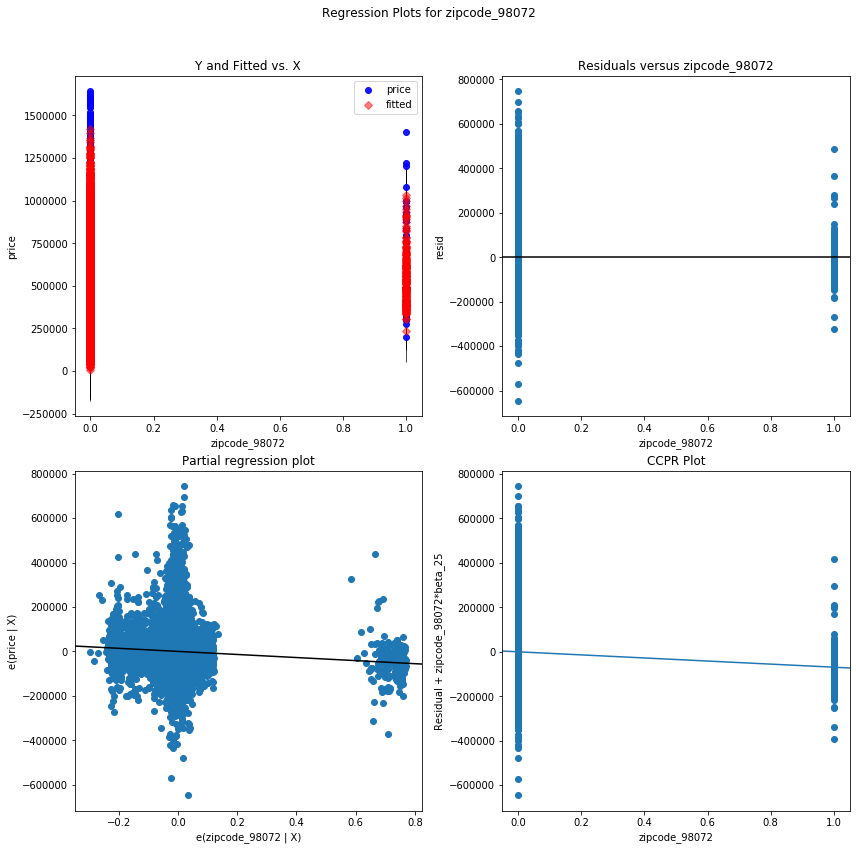

zipcode_98011 - Plotted


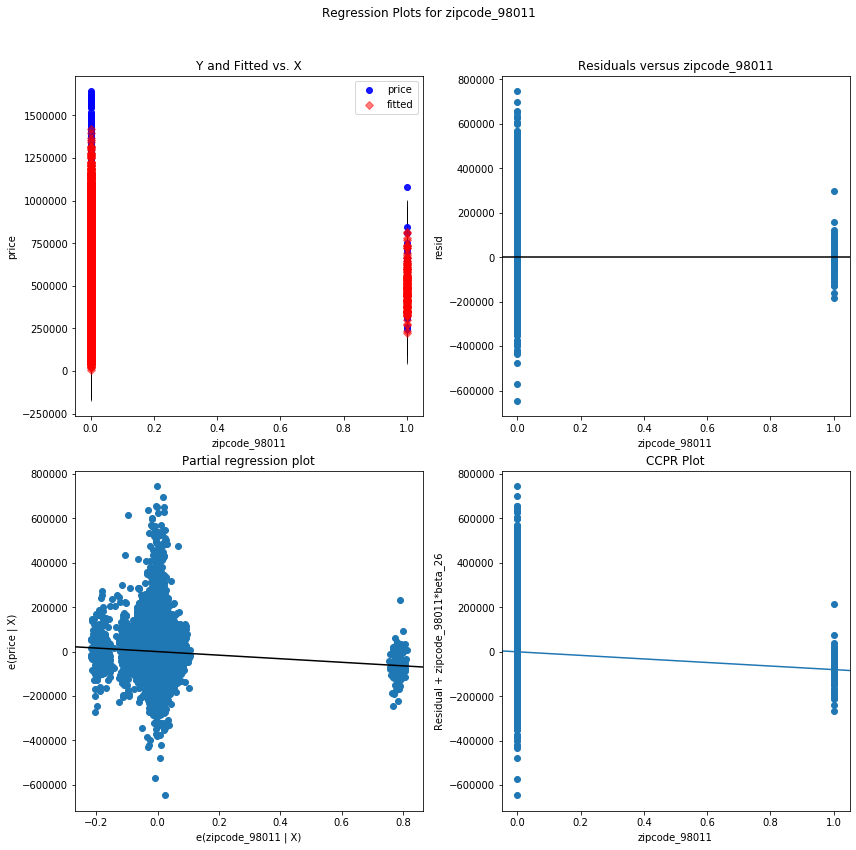

zipcode_98022 - Plotted


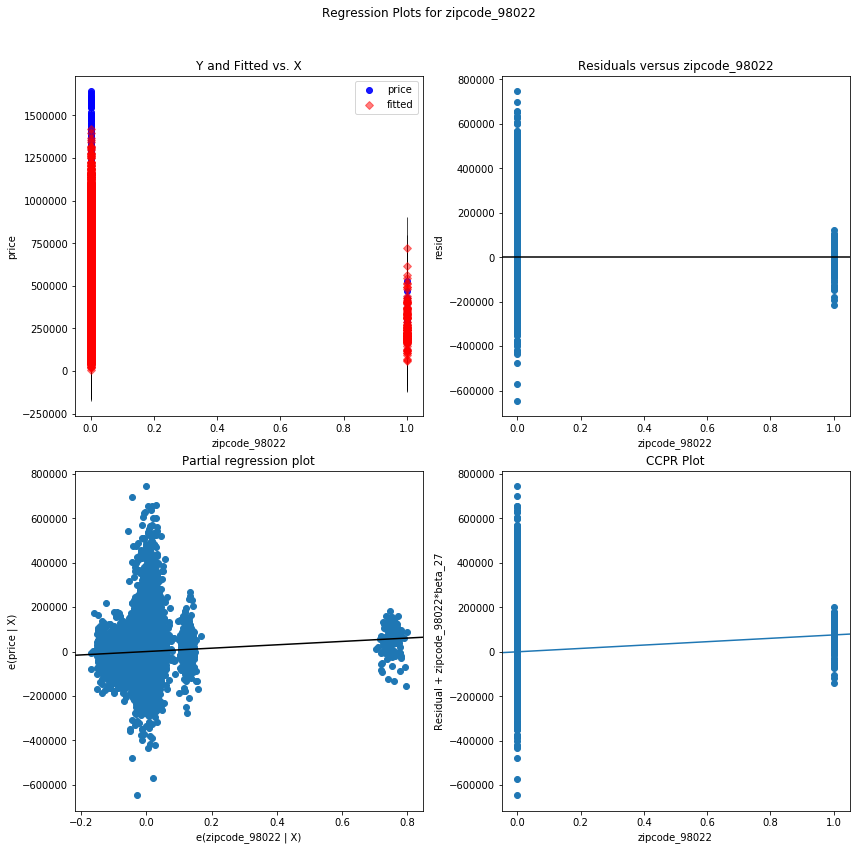

zipcode_98177 - Plotted


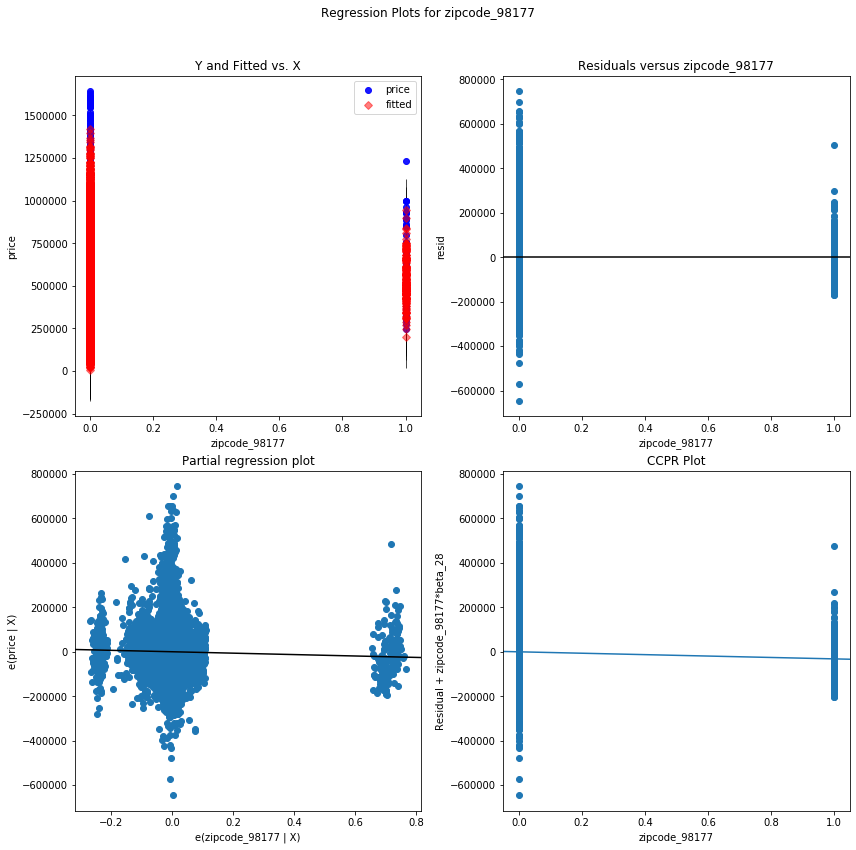

zipcode_98119 - Plotted


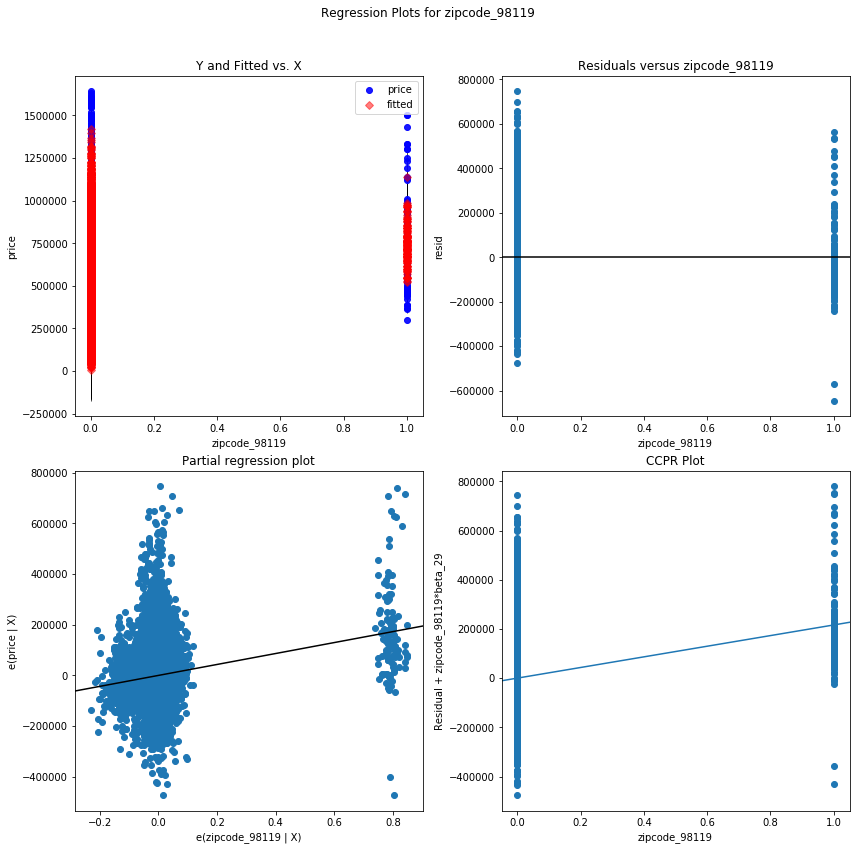

zipcode_98109 - Plotted


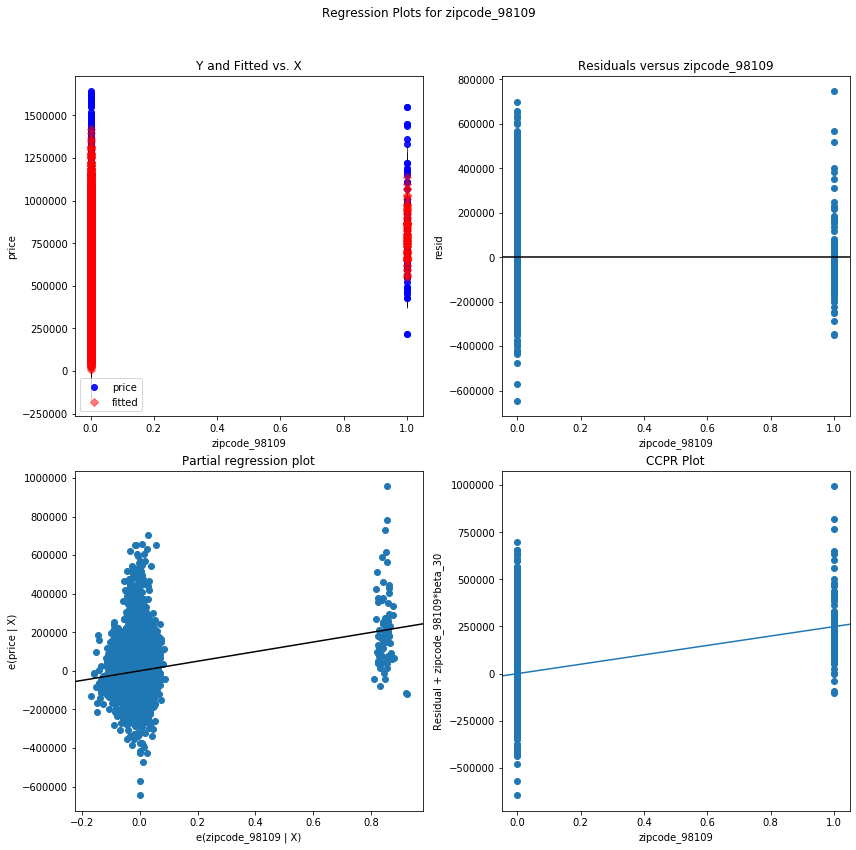

zipcode_98122 - Plotted


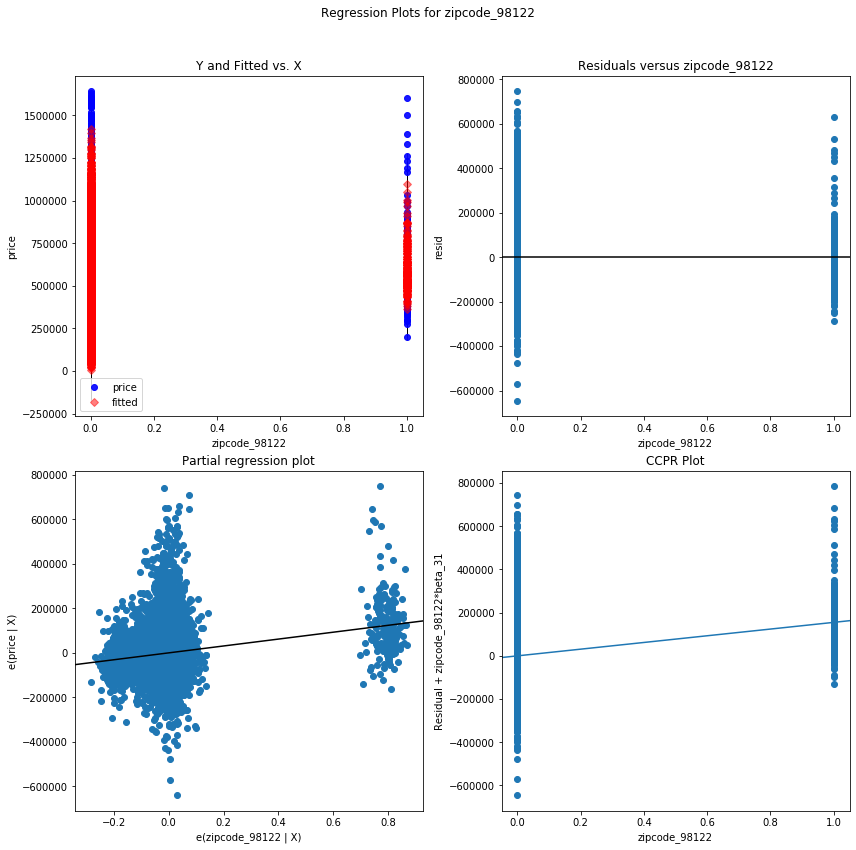

view_1.0 - Plotted


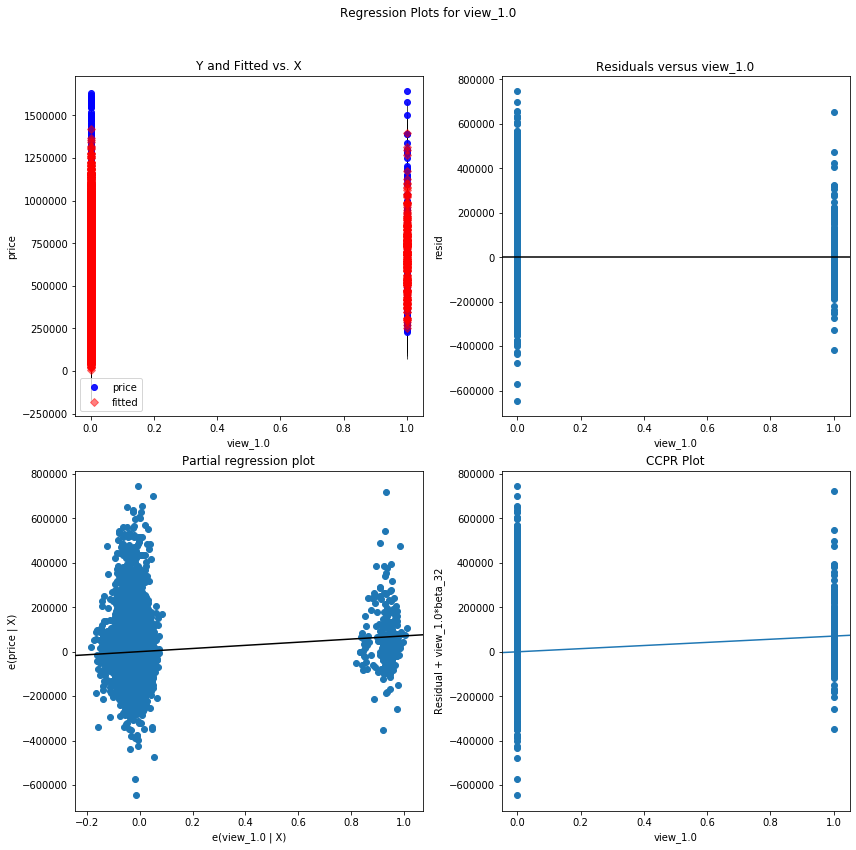

zipcode_98199 - Plotted


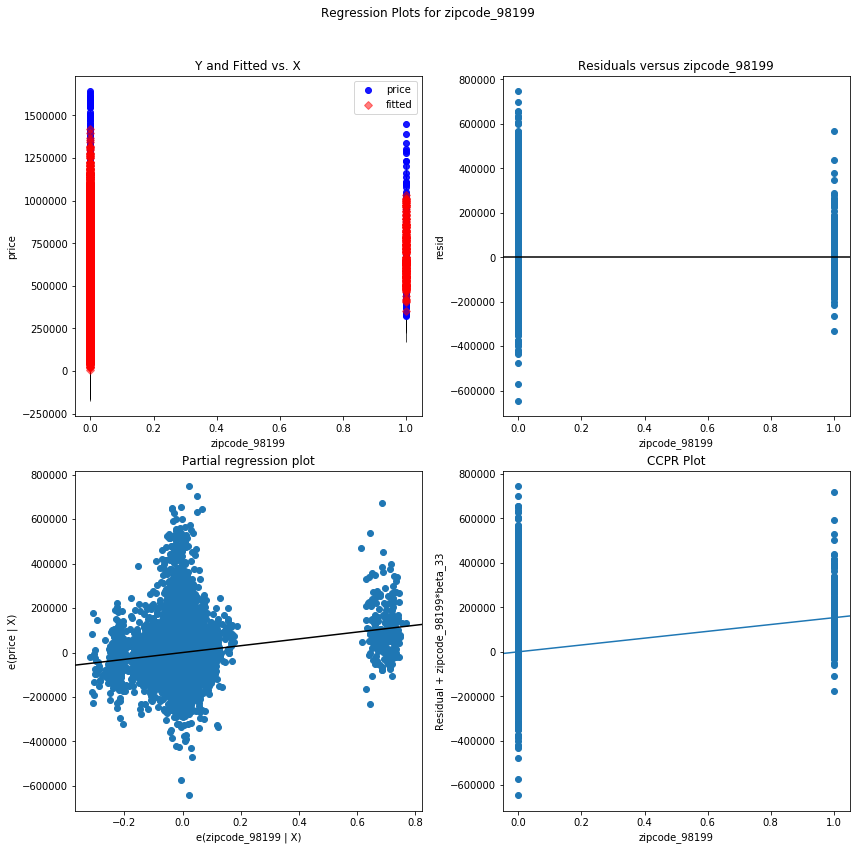

zipcode_98027 - Plotted


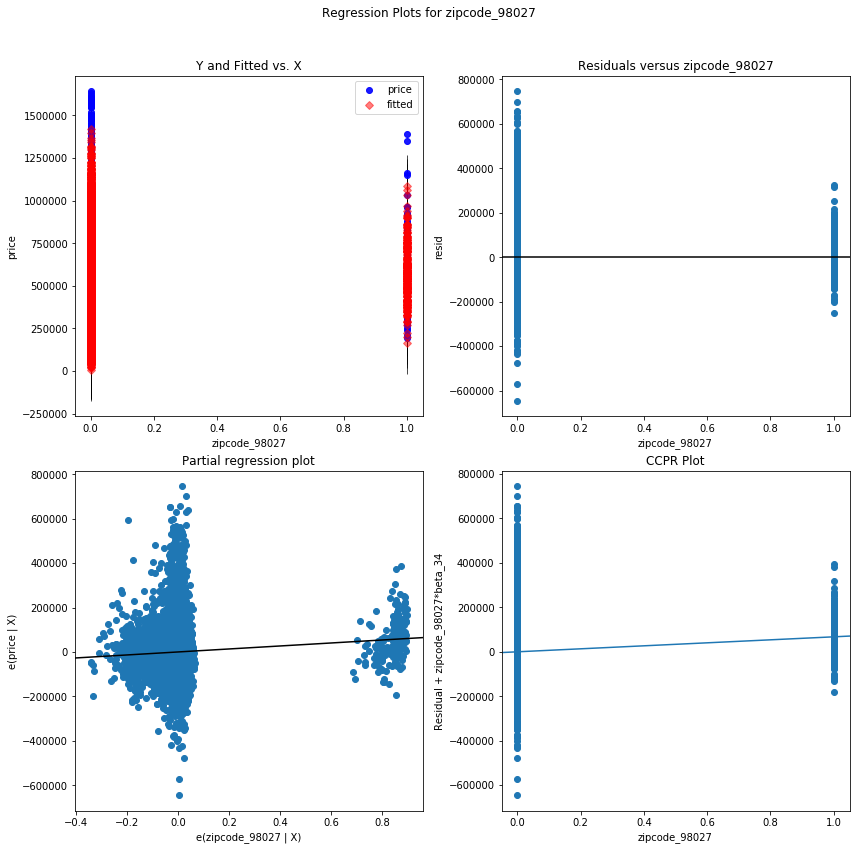

zipcode_98029 - Plotted


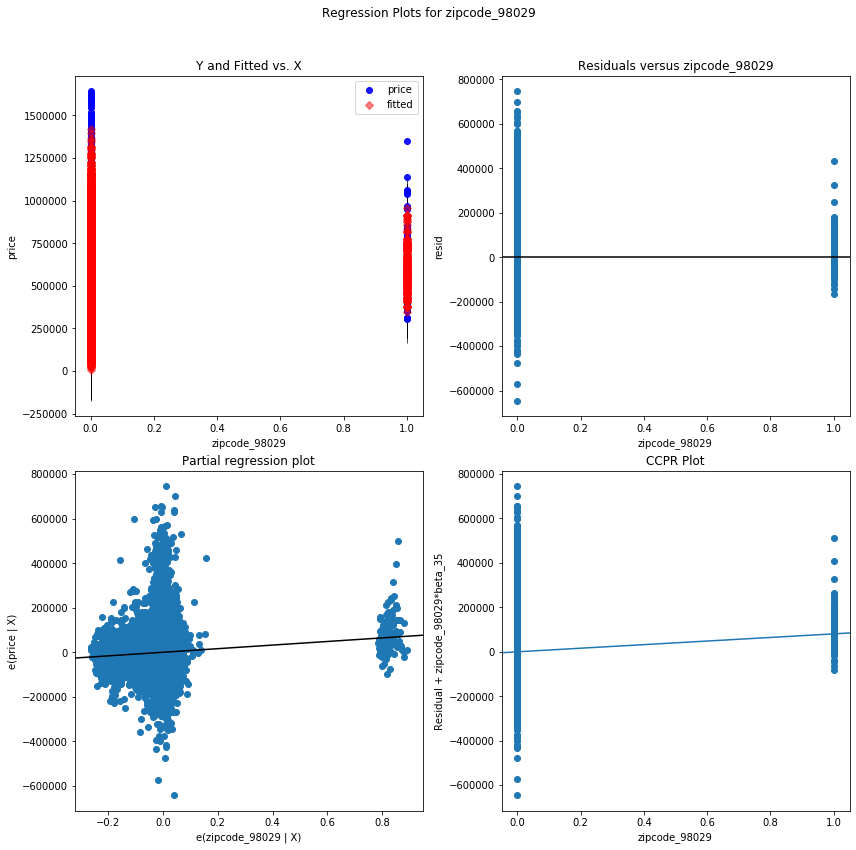

zipcode_98010 - Plotted


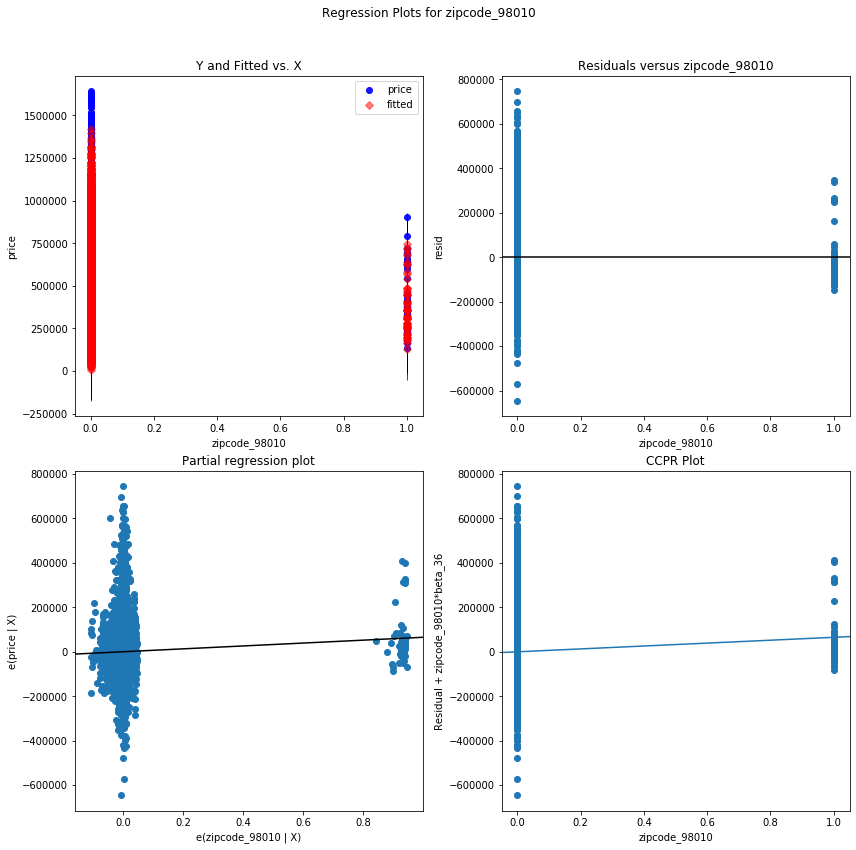

zipcode_98007 - Plotted


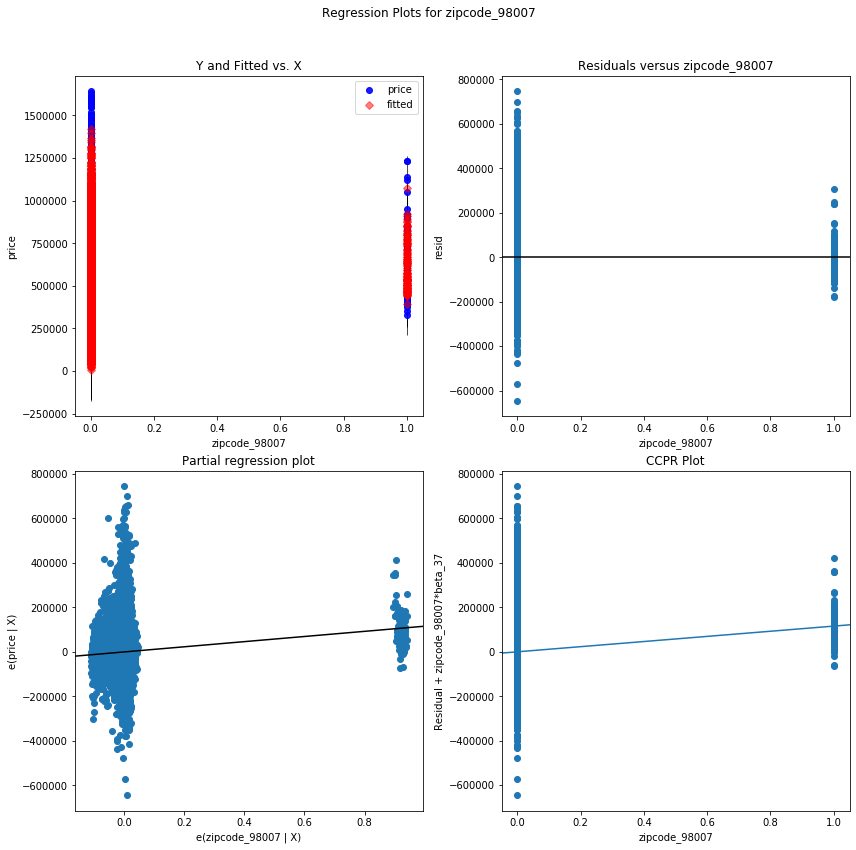

zipcode_98178 - Plotted


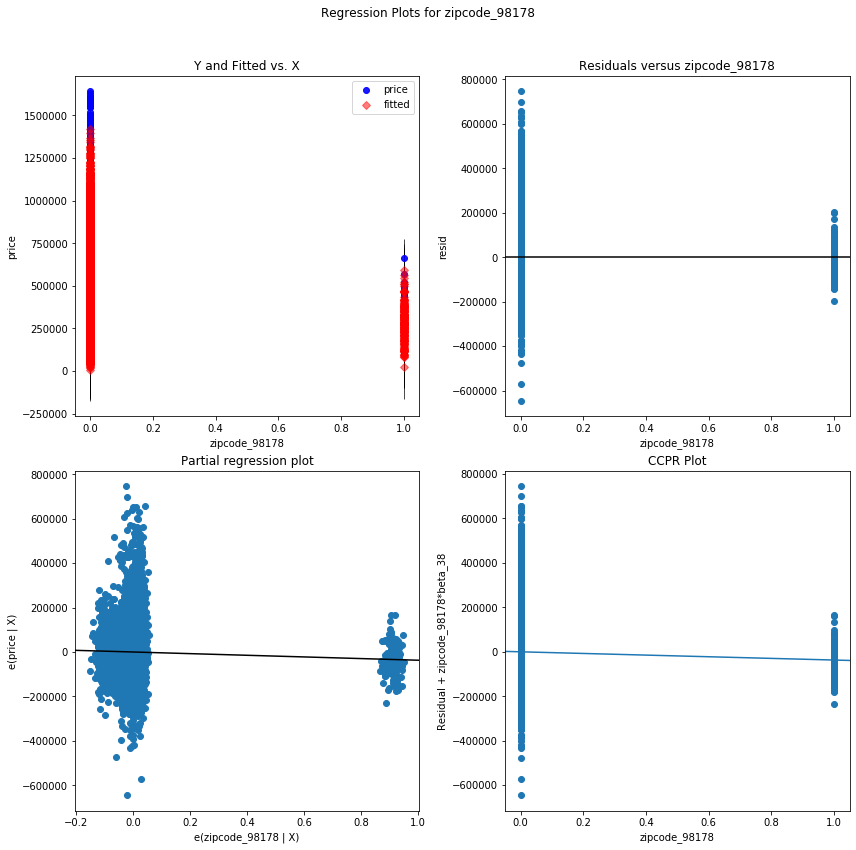

sqft_lot - Plotted


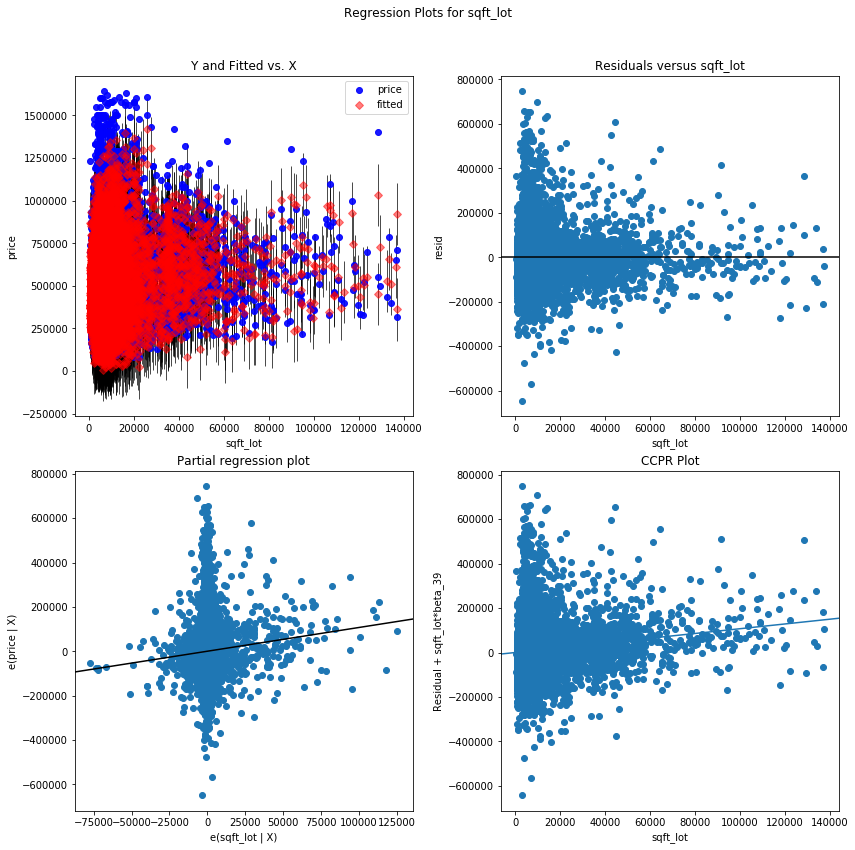

zipcode_98002 - Plotted


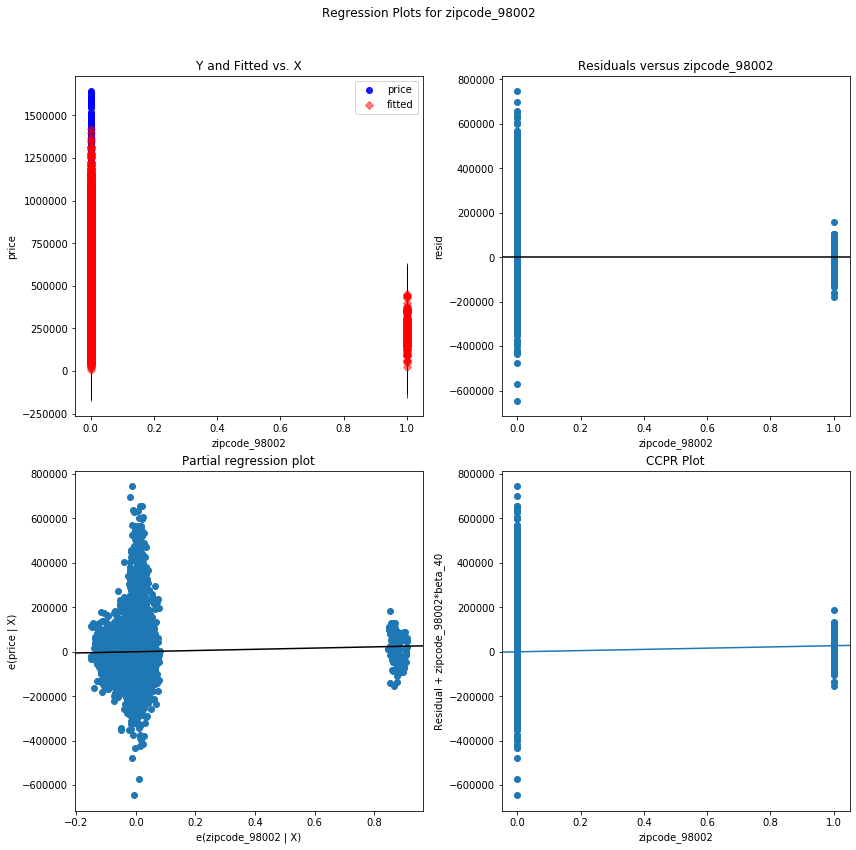

bathrooms - Plotted


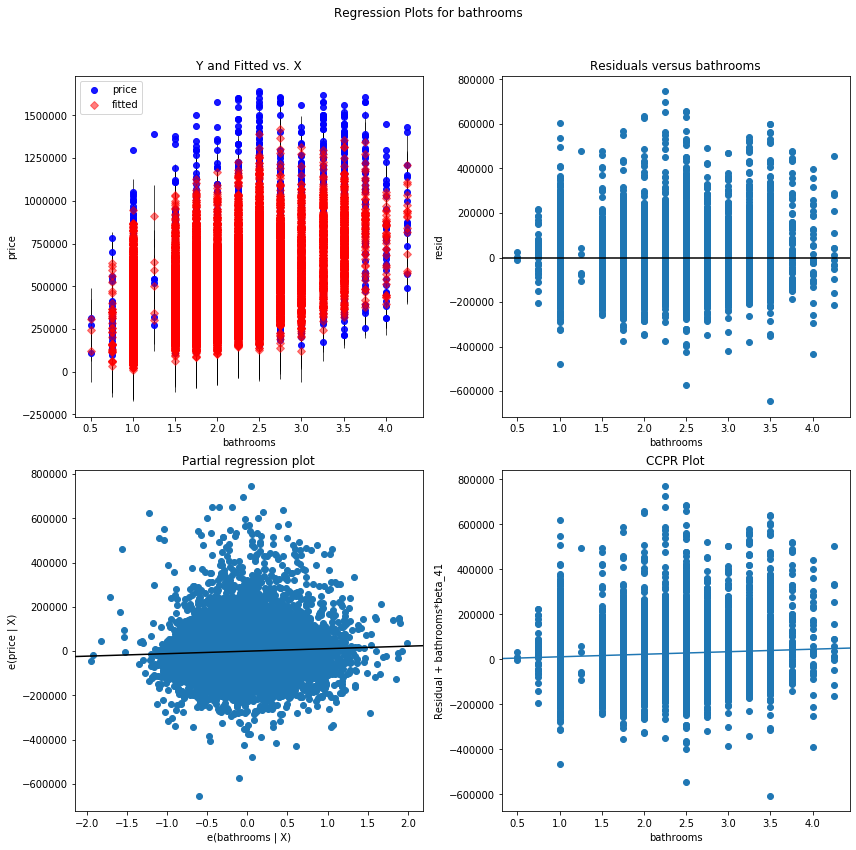

zipcode_98008 - Plotted


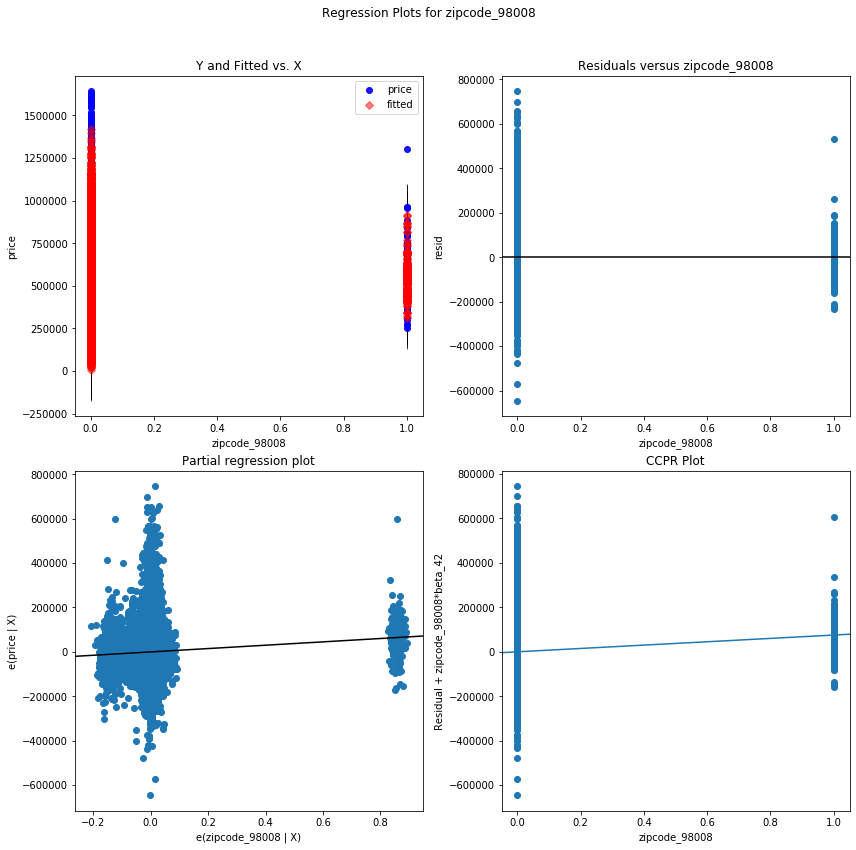

zipcode_98168 - Plotted


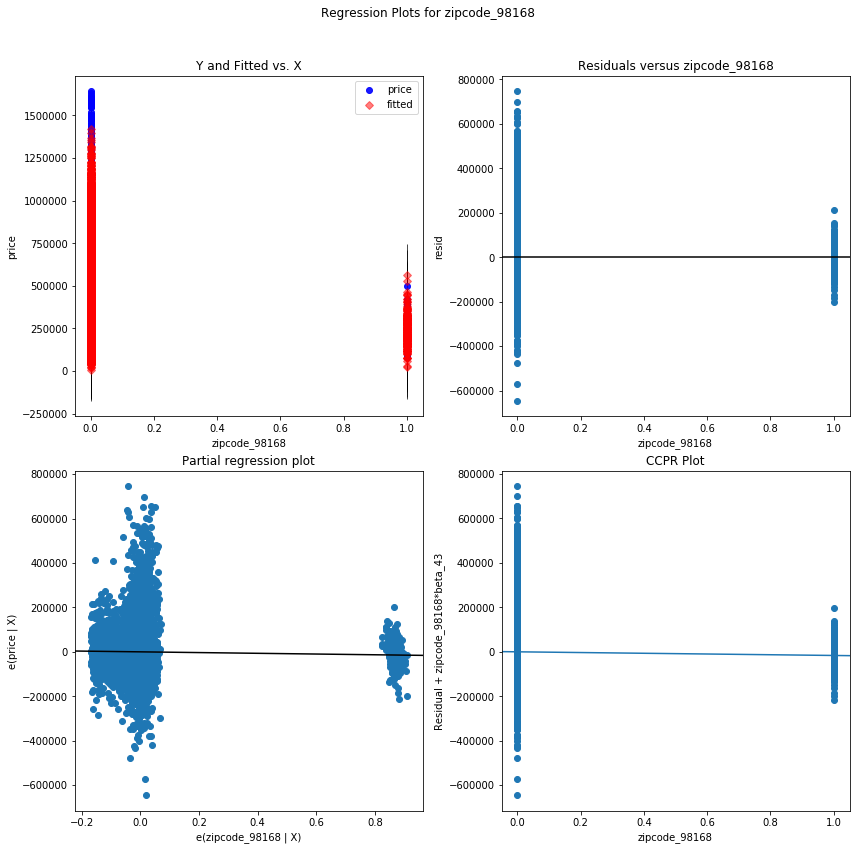

zipcode_98014 - Plotted


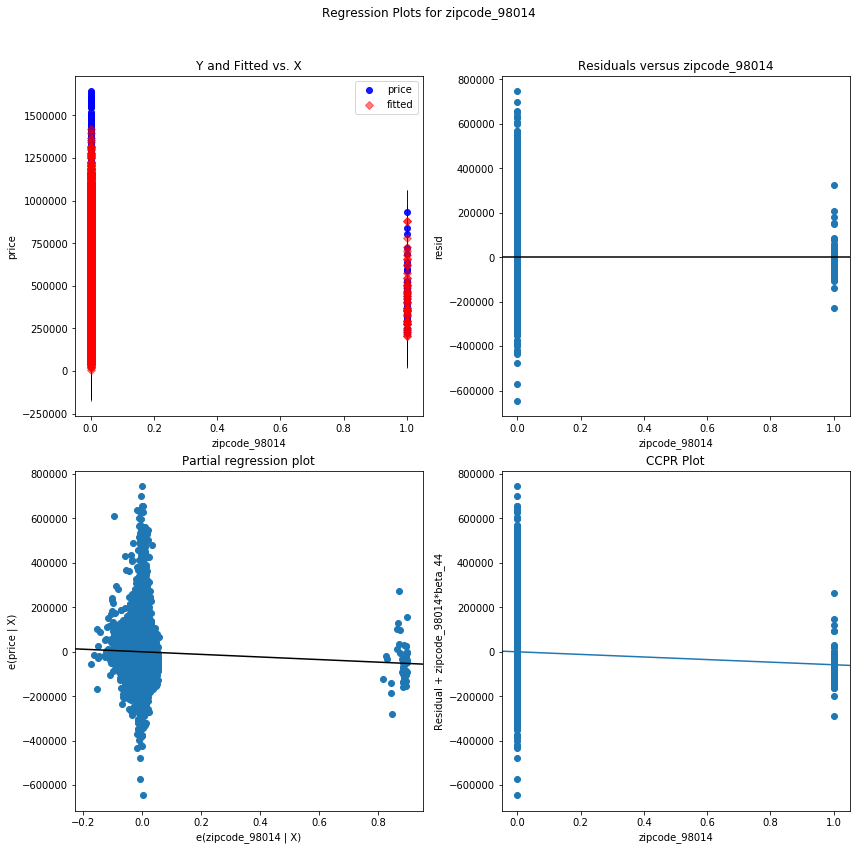

zipcode_98058 - Plotted


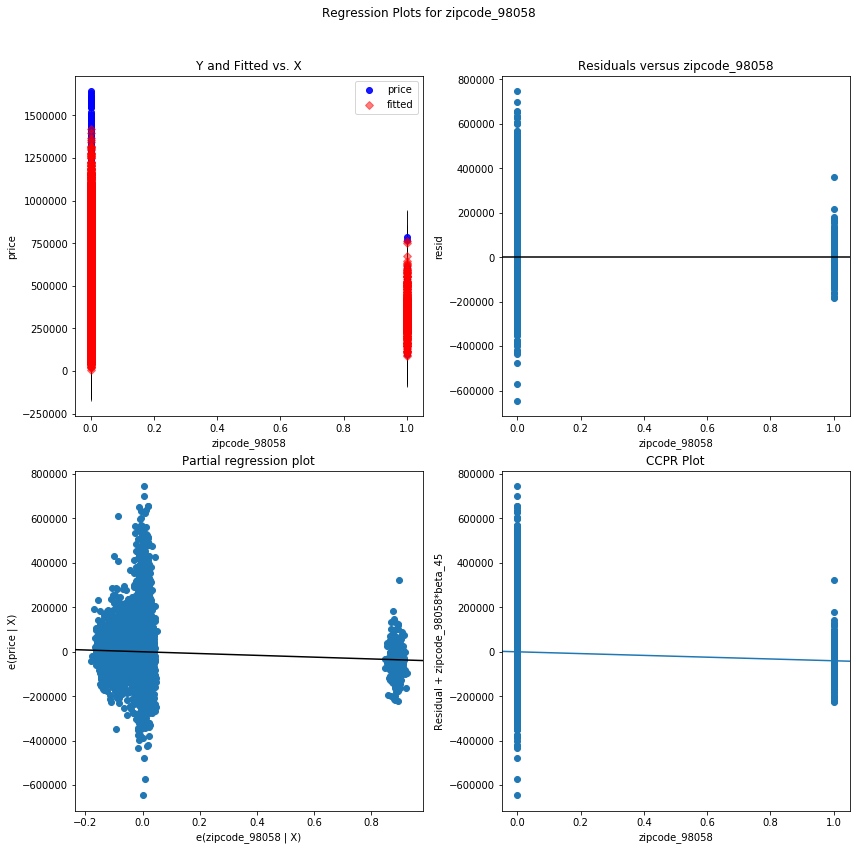

floors_3.0 - Plotted


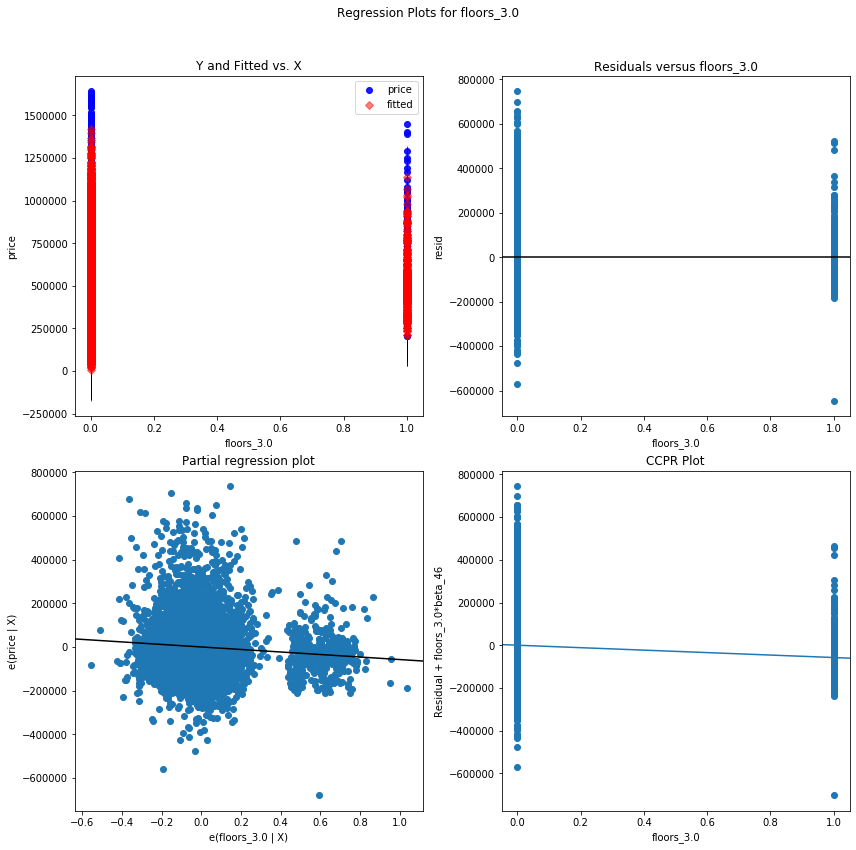

zipcode_98075 - Plotted


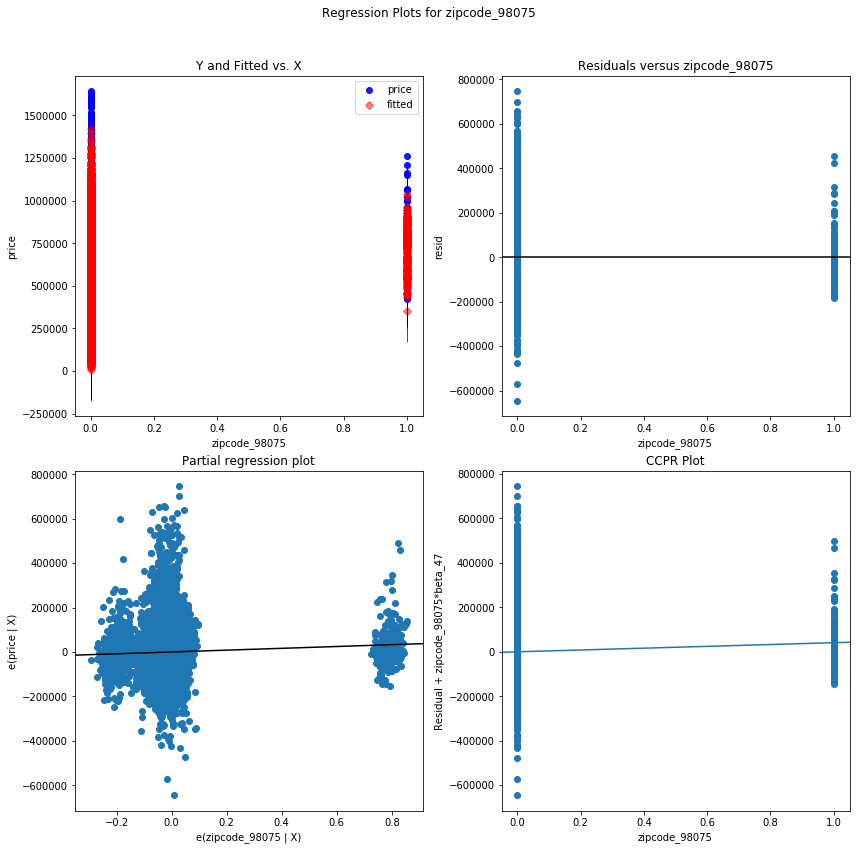

floors_2.0 - Plotted


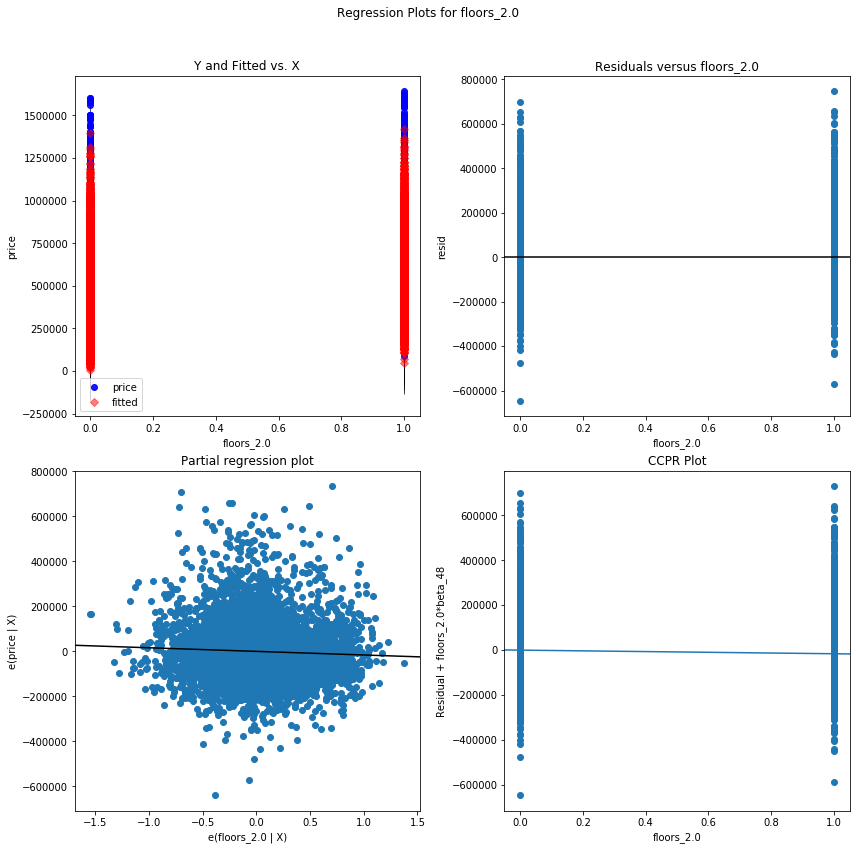

zipcode_98144 - Plotted


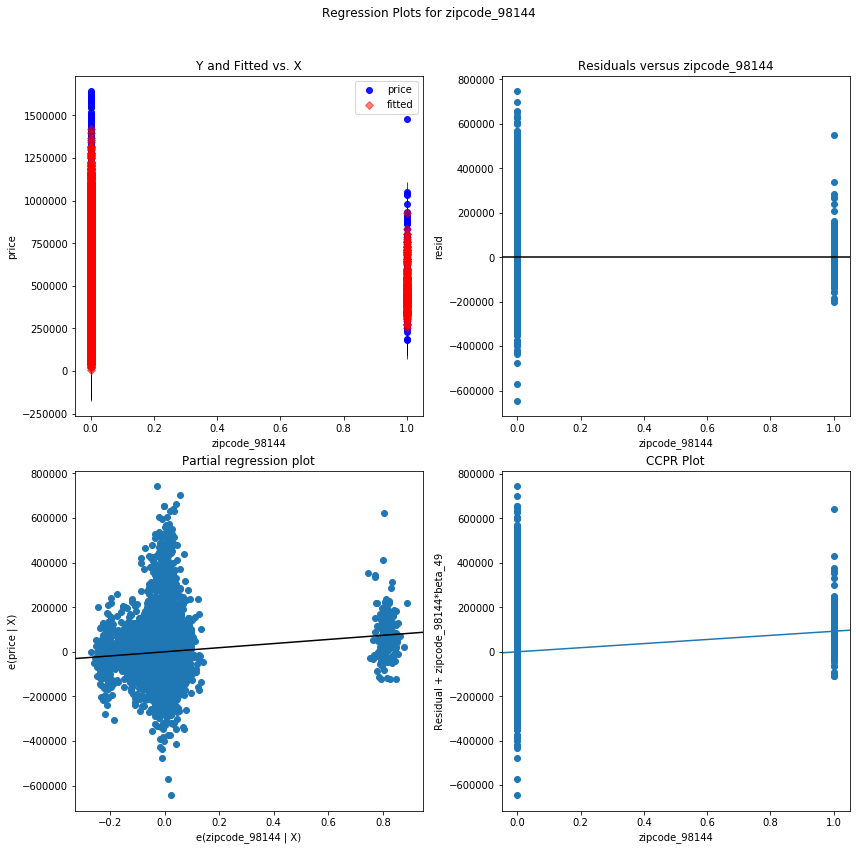

zipcode_98103 - Plotted


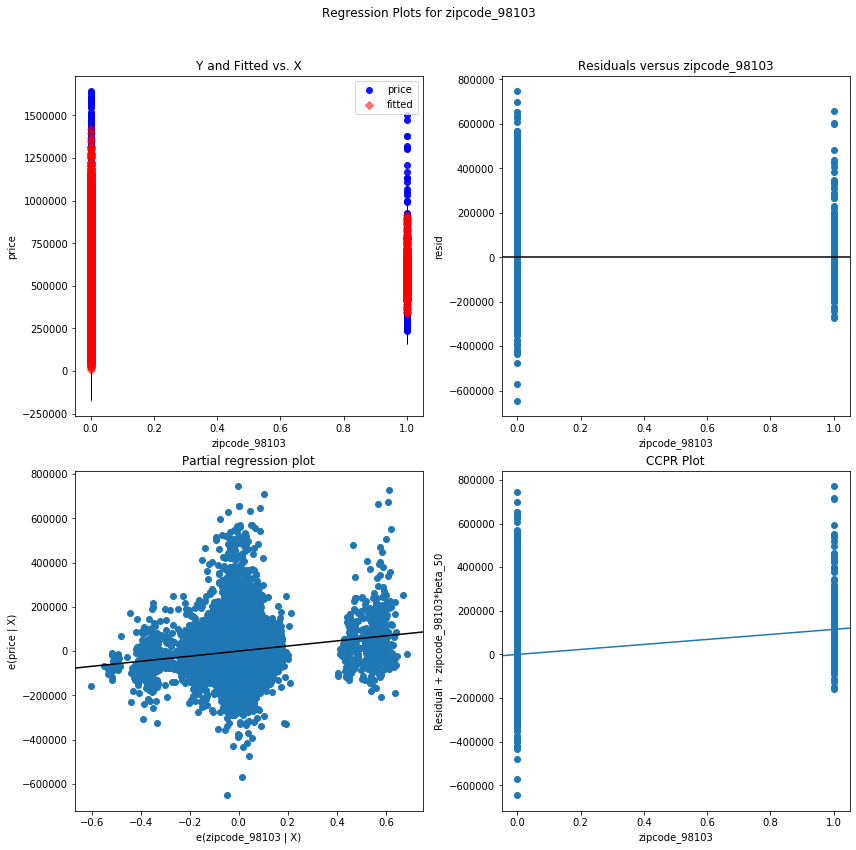

zipcode_98115 - Plotted


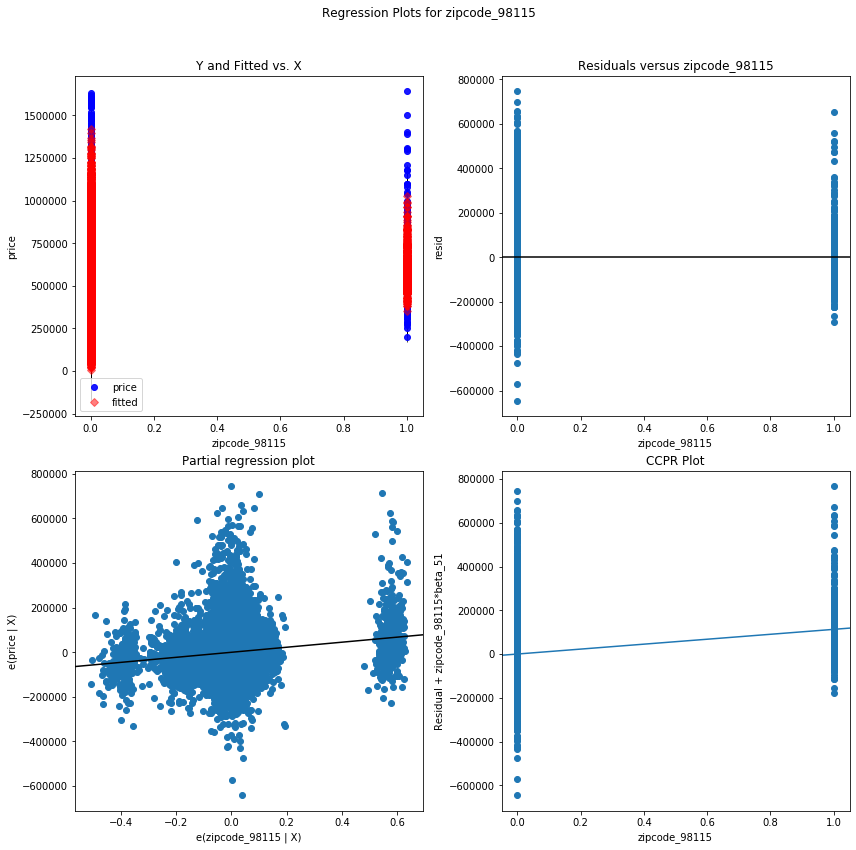

zipcode_98116 - Plotted


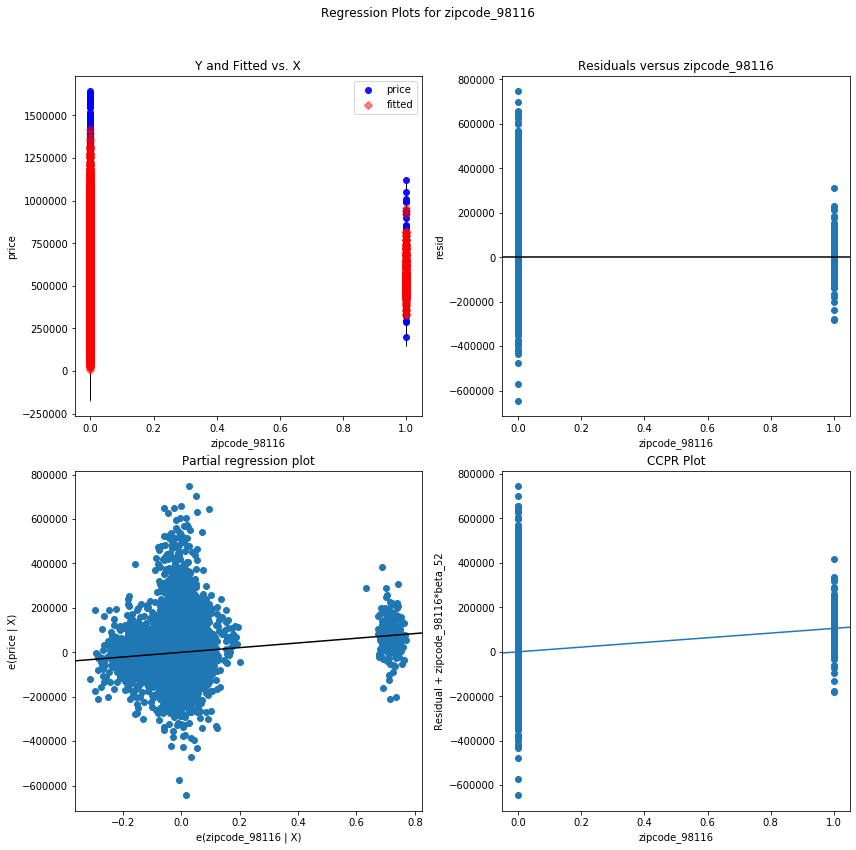

zipcode_98136 - Plotted


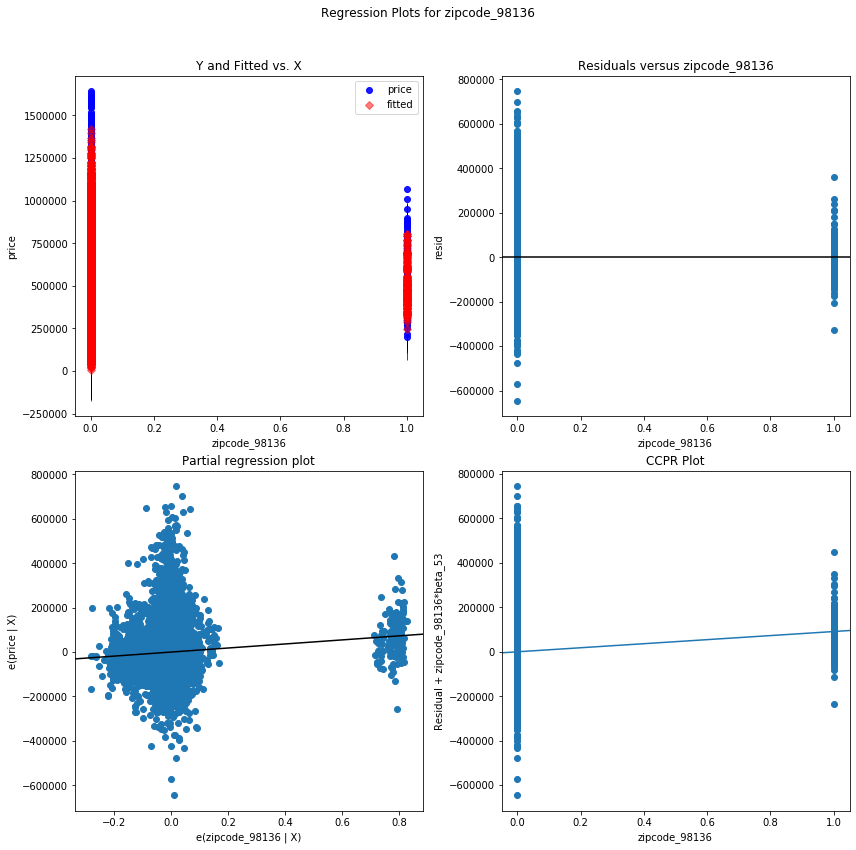

zipcode_98107 - Plotted


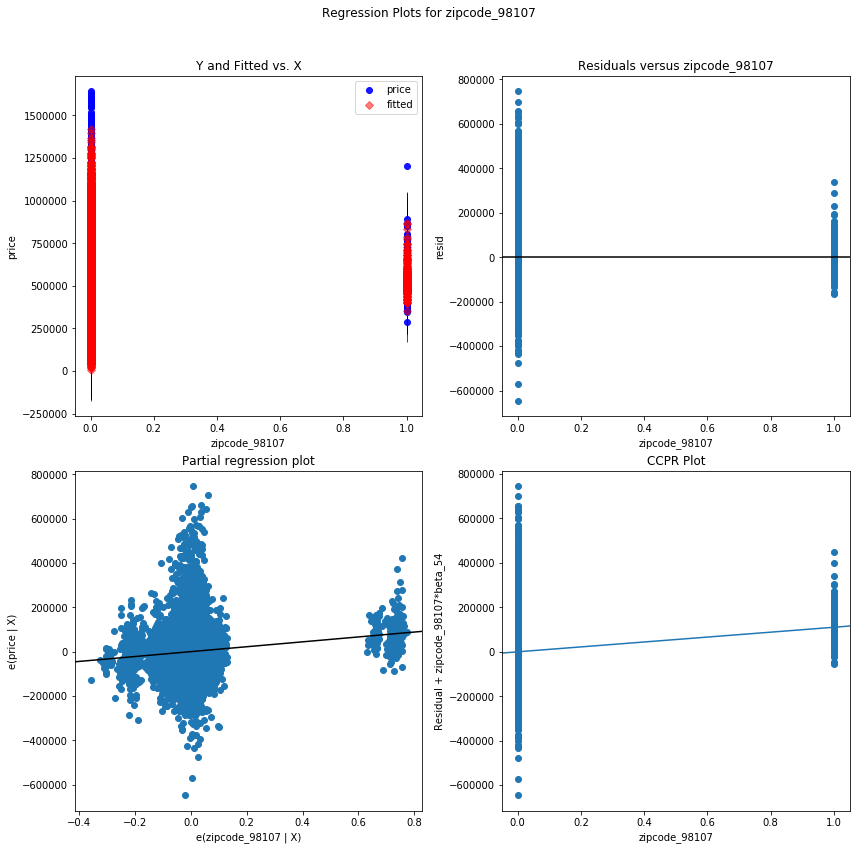

zipcode_98118 - Plotted


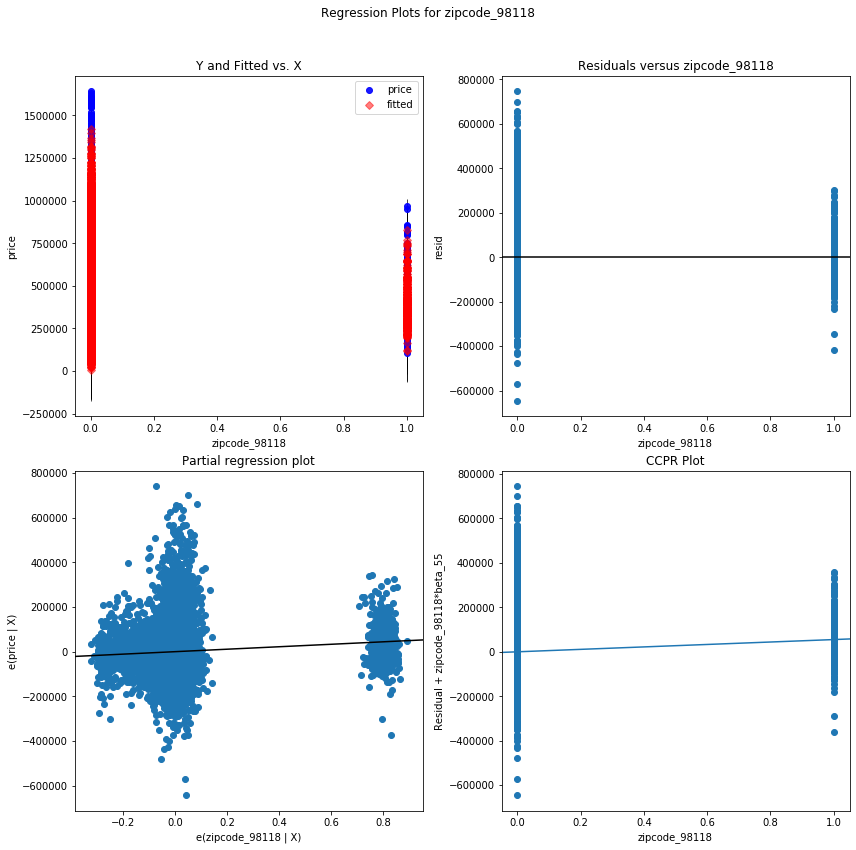

zipcode_98117 - Plotted


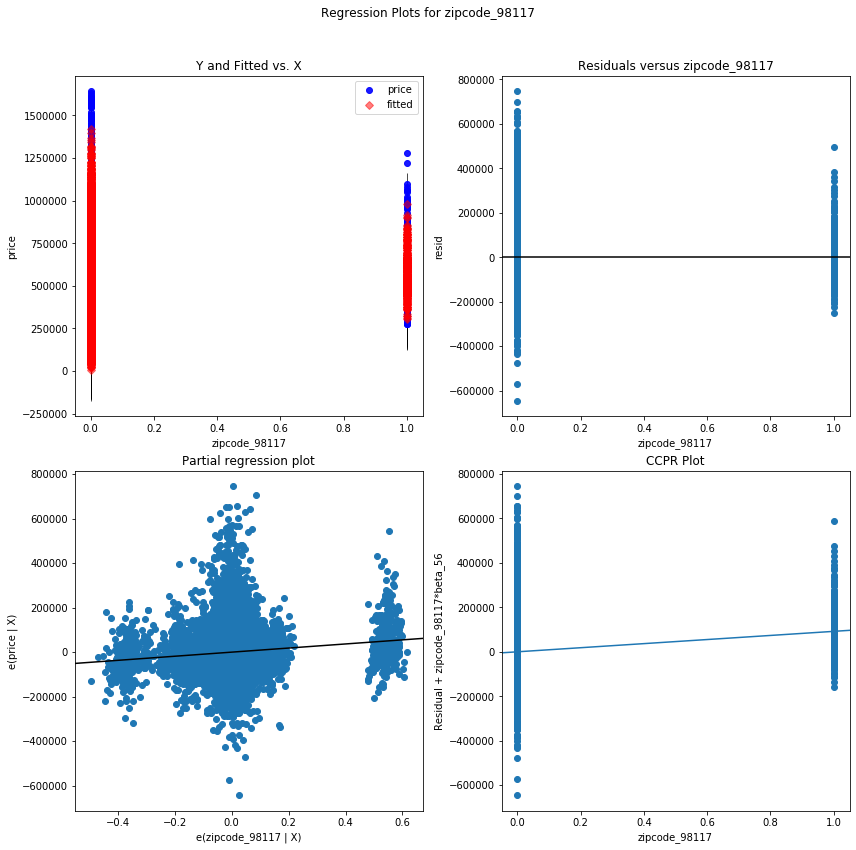

zipcode_98126 - Plotted


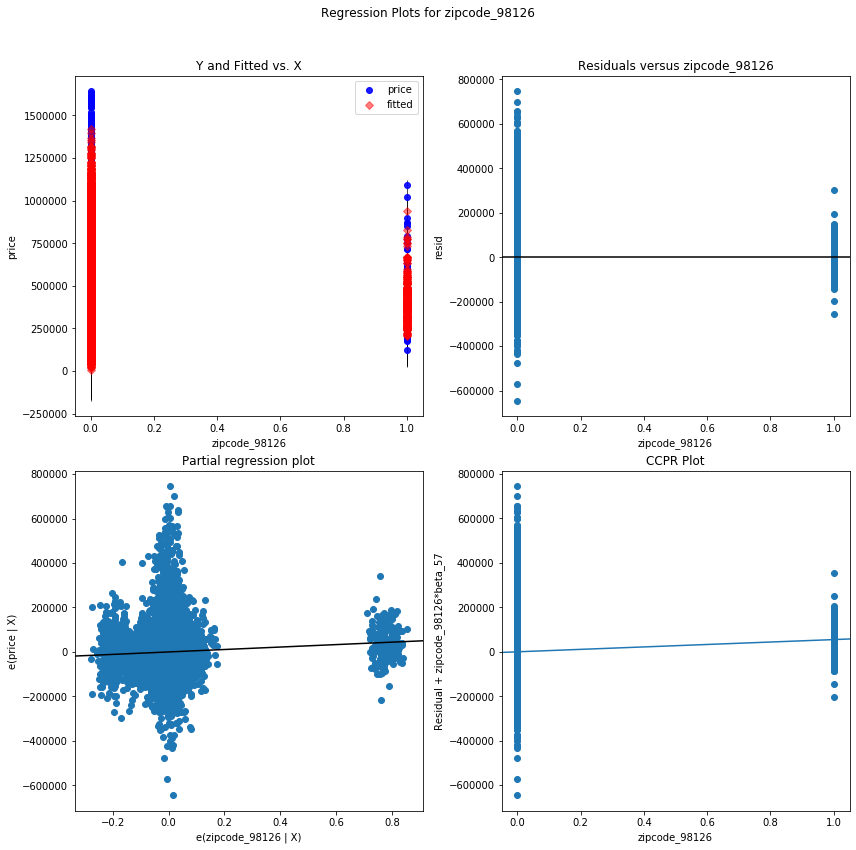

sqft_living15 - Plotted


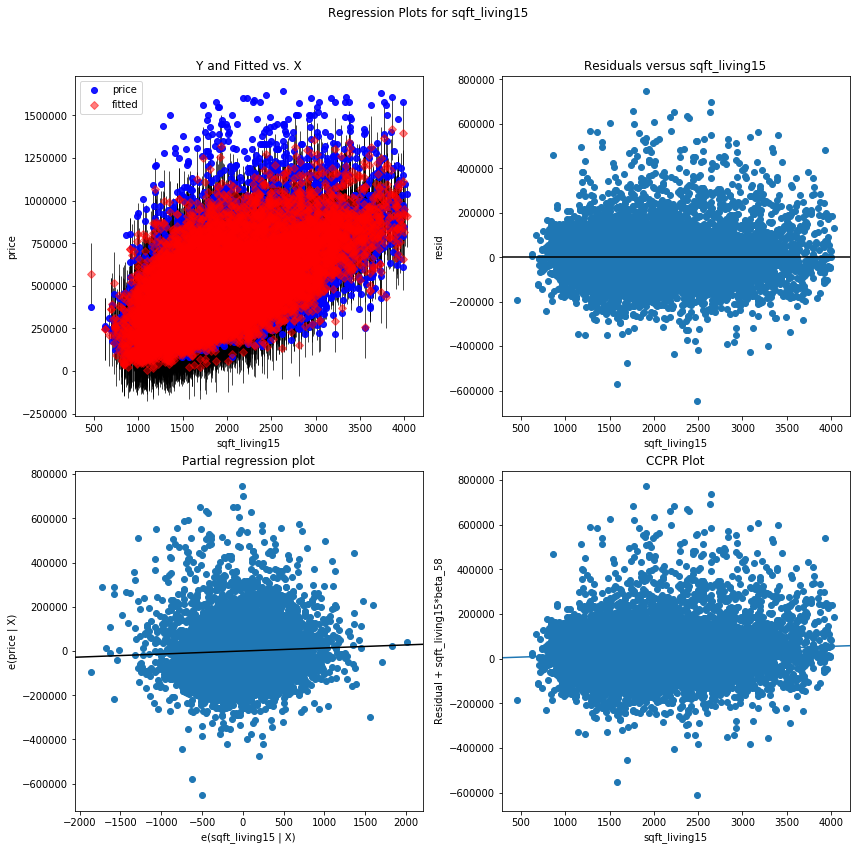

zipcode_98052 - Plotted


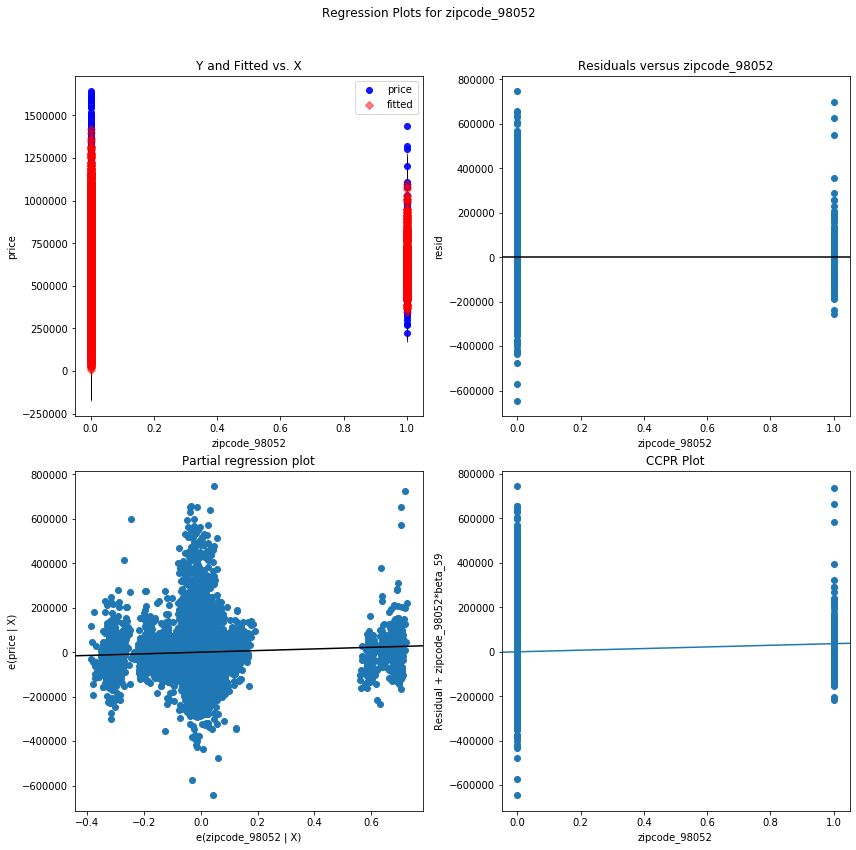

zipcode_98031 - Plotted


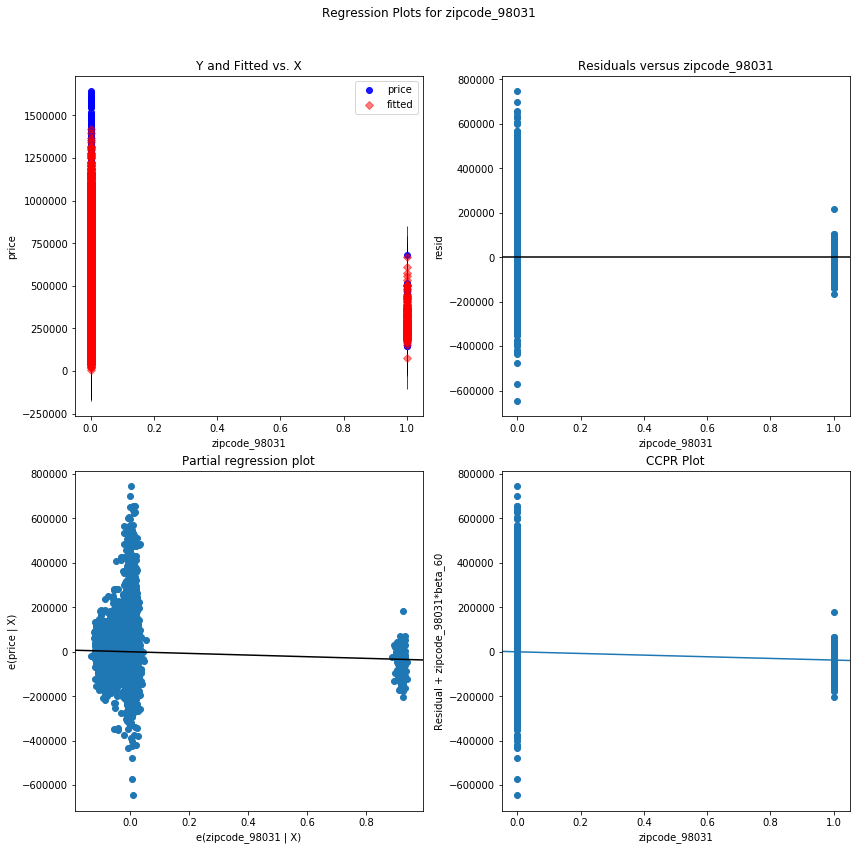

zipcode_98042 - Plotted


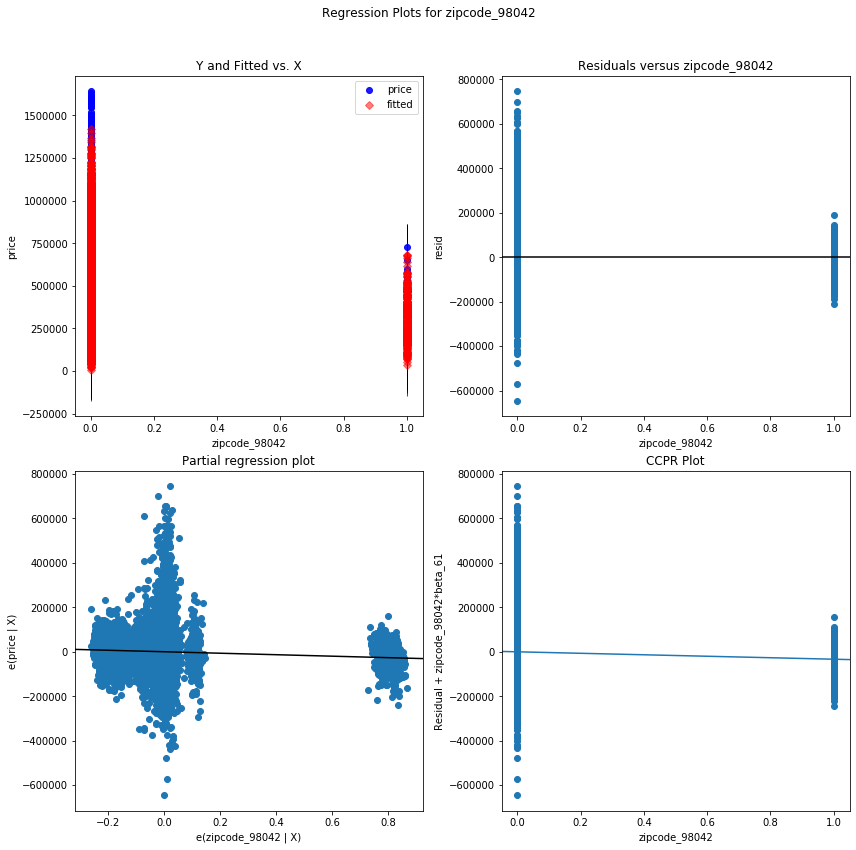

zipcode_98092 - Plotted


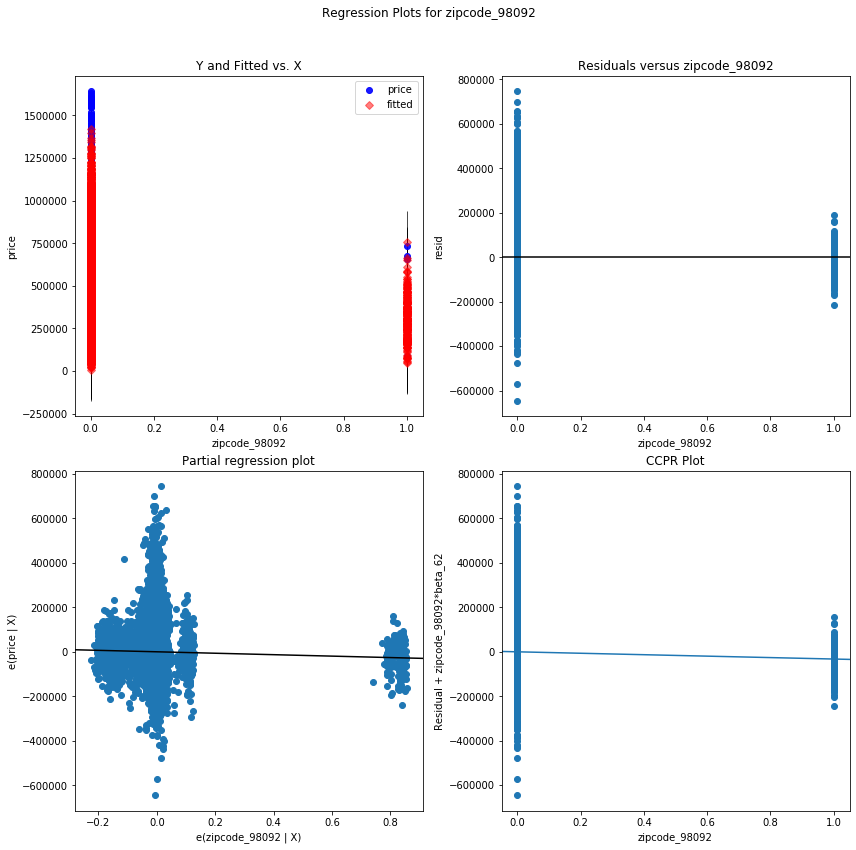

sqft_lot15 - Plotted


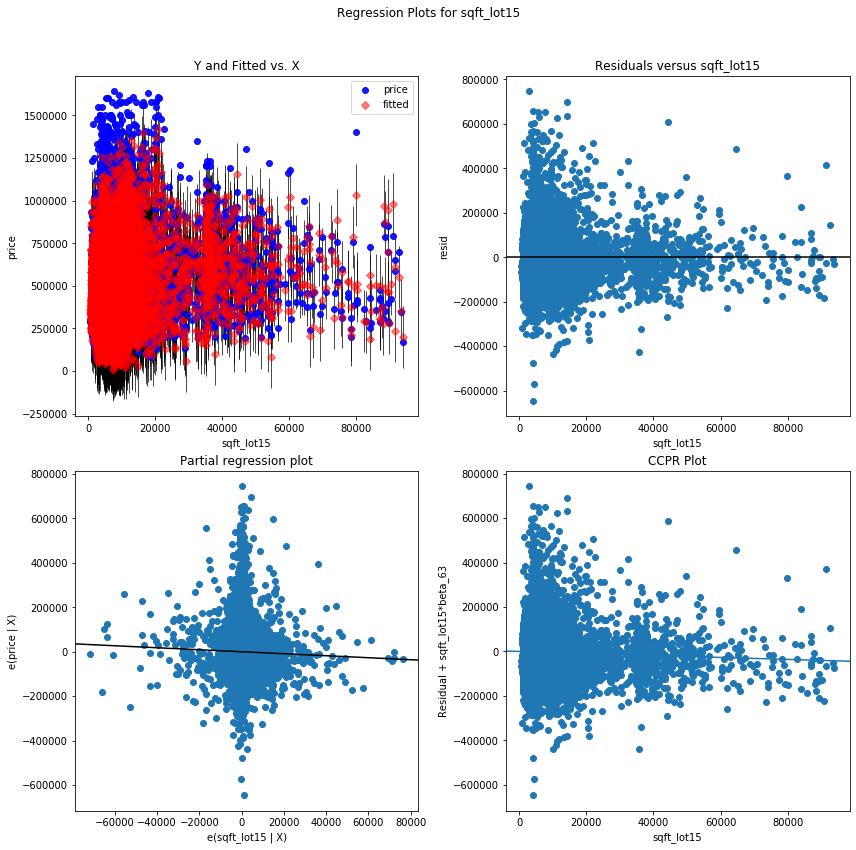

zipcode_98053 - Plotted


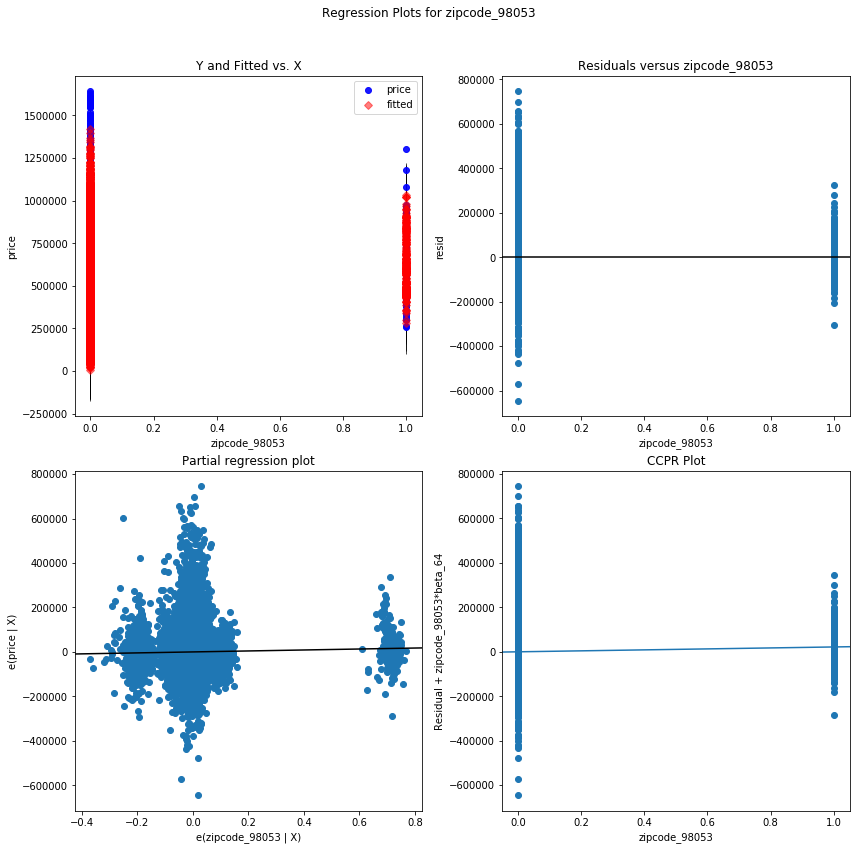

zipcode_98106 - Plotted


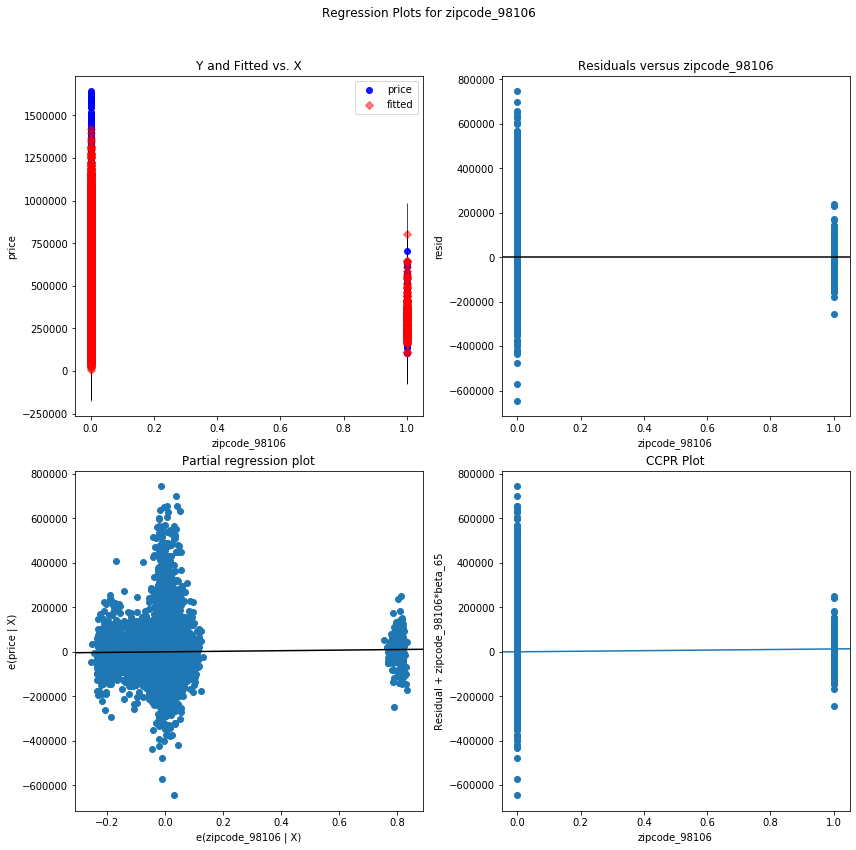

zipcode_98108 - Plotted


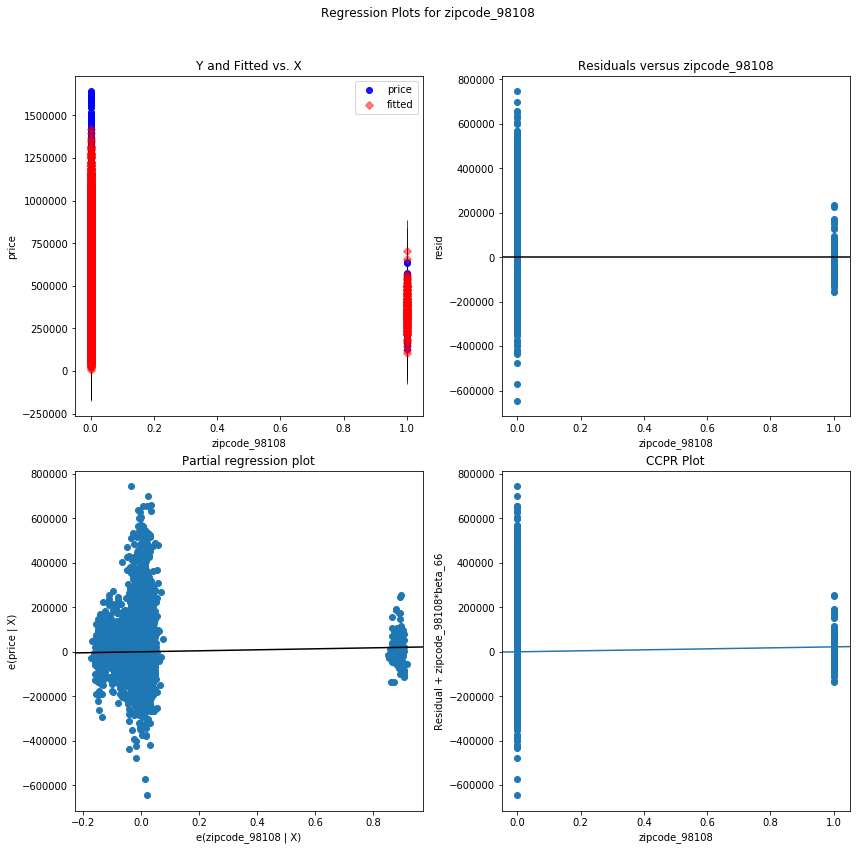

zipcode_98032 - Plotted


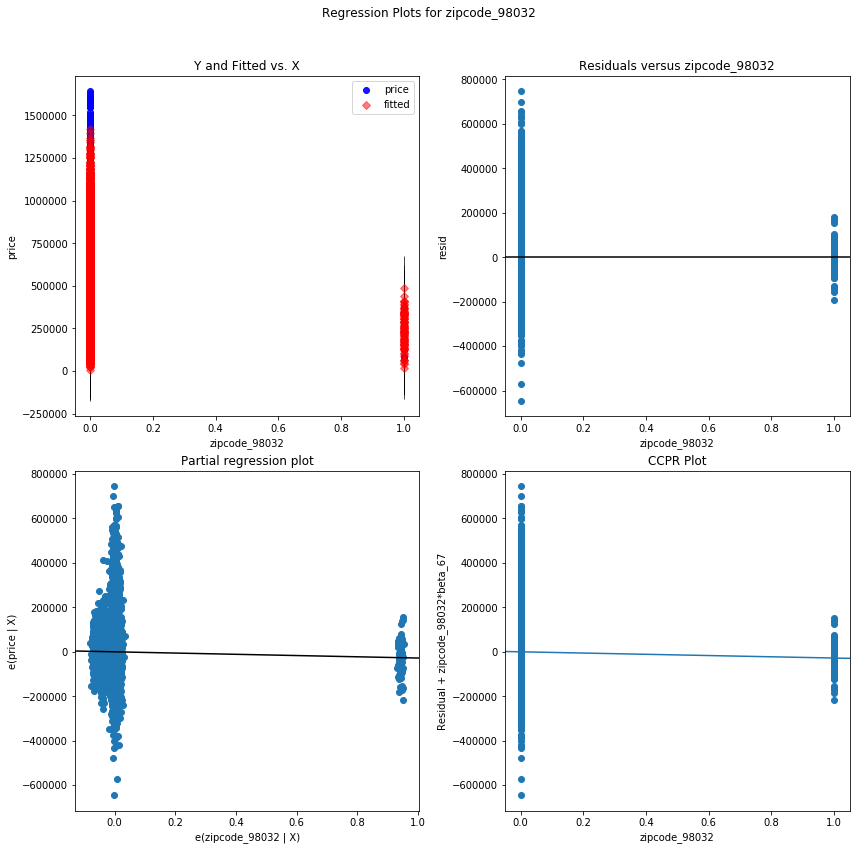

zipcode_98055 - Plotted


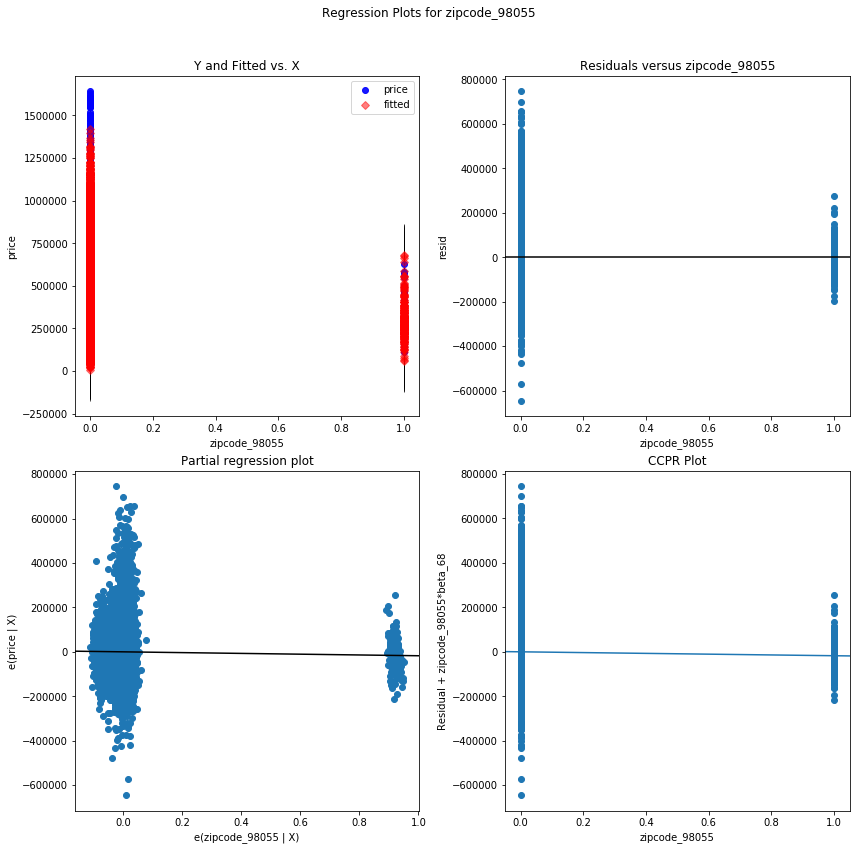

zipcode_98198 - Plotted


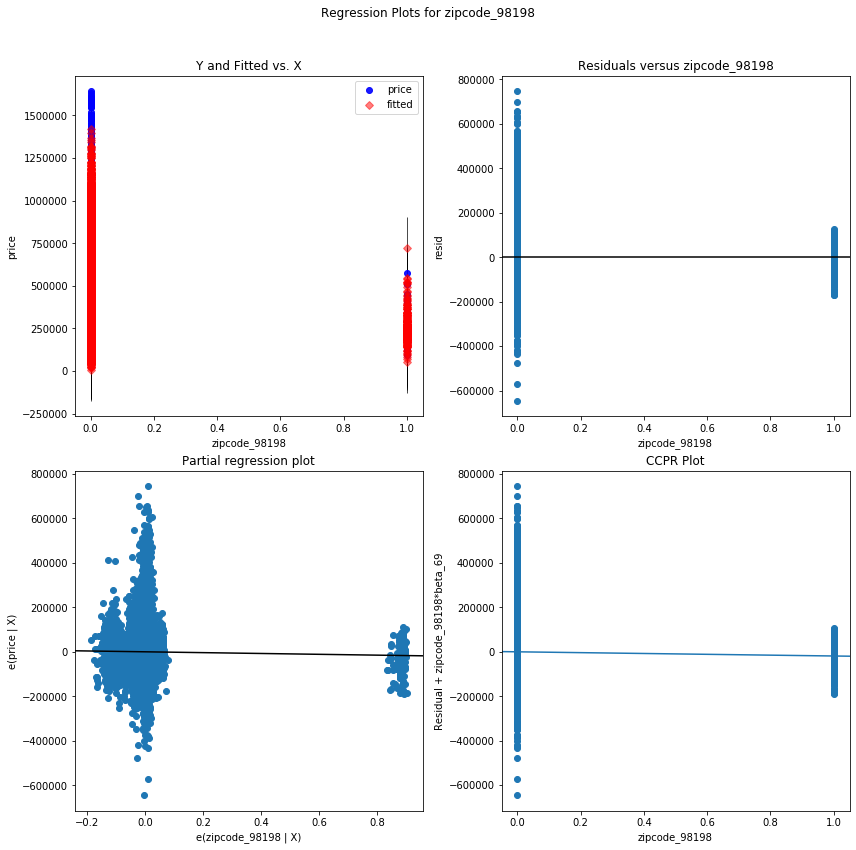

In [220]:
dfresults_bm_fs, dfs_coeff_bm_fs, summaries_bm_fs, models_dict_bm_fs, X_train_models_bm_fs, X_test_models_bm_fs, y_train_models_bm_fs, y_test_models_bm_fs, columns_models_bm_fs = run_model(b_pro_out, target_pro_noout, 'multilinear_noout', cv=10, plots=True, feature_selection=True)

In [221]:
summaries_bm_fs

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.839
Model:                            OLS   Adj. R-squared:                  0.838
Method:                 Least Squares   F-statistic:                     1127.
Date:                Thu, 25 Jun 2020   Prob (F-statistic):               0.00
Time:                        09:30:19   Log-Likelihood:            -1.9322e+05
No. Observations:               15034   AIC:                         3.866e+05
Df Residuals:                   14964   BIC:                         3.871e+05
Df Model:                          69                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const          -3.26e+07   1.68e+06    -19.429      0.000   -3.59e+07   -2.93e+07
grade          4.889e+04   1321.682     36.994      0.000    4.63e+04    5.15e+04
lat            4.528e+05   1.35e+04     33.480      0.000    4.26e+05    4.79e+05
MHI               0.8690      0.034     25.531      0.000       0.802       0.936
sqft_living      75.7452      2.643     28.662      0.000      70.565      80.925
yr_built       -345.7386     47.724     -7.245      0.000    -439.284    -252.193
zipcode_98004  3.958e+05   7816.801     50.633      0.000     3.8e+05    4.11e+05
long          -9.286e+04   1.24e+04     -7.488      0.000   -1.17e+05   -6.85e+04
zipcode_98040  2.763e+05   8361.987     33.041      0.000     2.6e+05    2.93e+05
zipcode_98033  1.291e+05   6254.208     20.637      0.000    1.17e+05    1.41e+05
zipcode_98023 -3.916e+04   5757.926     -6.801      0.000   -5.04e+04   -2.79e+04
zipcode_98028 -1.042e+05   7552.096    -13.797      0.000   -1.19e+05   -8.94e+04
zipcode_98155 -8.609e+04   6750.885    -12.752      0.000   -9.93e+04   -7.29e+04
zipcode_98133 -5.393e+04   6479.805     -8.322      0.000   -6.66e+04   -4.12e+04
zipcode_98112  2.531e+05   9081.949     27.867      0.000    2.35e+05    2.71e+05
condition      2.422e+04   1339.907     18.077      0.000    2.16e+04    2.68e+04
zipcode_98019 -1.419e+05   9451.366    -15.019      0.000    -1.6e+05   -1.23e+05
view_2.0       6.712e+04   4089.875     16.410      0.000    5.91e+04    7.51e+04
zipcode_98005  1.683e+05   8813.610     19.090      0.000    1.51e+05    1.86e+05
zipcode_98105   1.98e+05   8421.910     23.506      0.000    1.81e+05    2.14e+05
sqft_above       53.1615      2.745     19.365      0.000      47.781      58.543
zipcode_98102   2.39e+05   1.17e+04     20.509      0.000    2.16e+05    2.62e+05
zipcode_98006  1.137e+05   5910.169     19.235      0.000    1.02e+05    1.25e+05
zipcode_98077 -9.787e+04   9660.028    -10.131      0.000   -1.17e+05   -7.89e+04
zipcode_98034 -3.345e+04   5908.027     -5.663      0.000    -4.5e+04   -2.19e+04
zipcode_98072 -6.922e+04   7969.121     -8.686      0.000   -8.48e+04   -5.36e+04
zipcode_98011 -8.007e+04   8903.155     -8.994      0.000   -9.75e+04   -6.26e+04
zipcode_98022  7.594e+04   9510.342      7.985      0.000    5.73e+04    9.46e+04
zipcode_98177 -3.177e+04   8430.526     -3.769      0.000   -4.83e+04   -1.52e+04
zipcode_98119  2.162e+05   9505.202     22.748      0.000    1.98e+05    2.35e+05
zipcode_98109  2.492e+05   1.13e+04     22.150      0.000    2.27e+05    2.71e+05
zipcode_98122  1.552e+05   7280.628     21.312      0.000    1.41e+05    1.69e+05
view_1.0        7.07e+04   6424.717     11.005      0.000    5.81e+04    8.33e+04
zipcode_98199  1.535e+05   7552.923     20.328      0.000    1.39e+05    1.68e+05
zipcode_98027  6.744e+04   6154.898     10.957   

In [222]:
predictions_bm_fs = models_dict_bm_fs[0].predict(X_test_models_bm_fs)

In [223]:
lowers_bm_fs, uppers_bm_fs, residuals_bm_fs, rse_bm_fs = get_prediction_interval(y_test_models_bm_fs, predictions_bm_fs, X_train_models_bm_fs)

In [227]:
rse_bm_fs

47351.08526701907

Text(0.5, 1.0, 'Prediction intervals, predicted values, actual values - multilinear_noout')

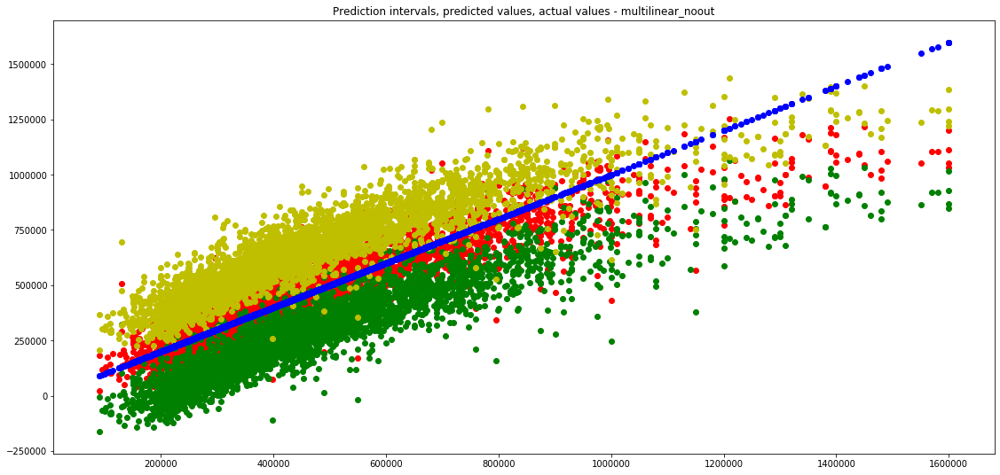

In [296]:
plt.figure(figsize=(19,9))
plt.scatter(y_test_models_bm_fs, residuals_bm_fs['predicted-price'], color='r')
plt.scatter(y_test_models_bm_fs, lowers_bm_fs, color='g')
plt.scatter(y_test_models_bm_fs, uppers_bm_fs, color='y')
plt.scatter(y_test_models_bm_fs, y_test_models_bm_fs, color='b')
plt.title('Prediction intervals, predicted values, actual values - multilinear_noout')

In [224]:
pickle_regression_results('multilinear_noout_fs', dfresults_bm_fs, dfs_coeff_bm_fs, summaries_bm_fs, models_dict_bm_fs, X_train_models_bm_fs, X_test_models_bm_fs, y_train_models_bm_fs, y_test_models_bm_fs, columns_models_bm_fs)

### Multilinear regresssion with log-price and feature selection

In [237]:
multi_targets_log = [np.log(x) for x in multi_targets]

In [238]:
multi_descriptions_log = [x + '-logprice' for x in multi_descriptions]

In [239]:
dfresults_logprice, dfs_coeff_logprice, summaries_logprice, models_dict_logprice, X_train_models_logprice, X_test_models_logprice, y_train_models_logprice, y_test_models_logprice, columns_models_logprice = run_multi_models(multi_models, multi_targets_log, multi_descriptions_log, featureSelection=True)

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be rem

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be rem

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/base/model.py:1294: RuntimeWarning: invalid value encountered in true_divide
  return self.params / self.bse
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1892: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, u

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/base/model.py:1294: RuntimeWarning: invalid value encountered in true_divide

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/base/model.py:1294: RuntimeWarning: invalid value encountered in true_divide
  return self.params / self.bse
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in less
  return (a < x

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/base/model.py:1294: RuntimeWarning: invalid value encountered in true_divide
  return self.params / self.bse
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1892: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, u


multilinear-logprice --- Adj.R^2: ['0.882']


Top 10 coefficients by absolute value
                multilinear-logprice
const                     59.823305
lat                        1.276247
zipcode_98039              0.543382
zipcode_98004              0.528409
waterfront                 0.461681
zipcode_98112              0.443045
zipcode_98109              0.406017
zipcode_98102              0.403010
zipcode_98119              0.402579
zipcode_98040              0.359067 

Top 10 coefficients (actual values)
                multilinear-logprice
lat                        1.276247
zipcode_98039              0.543382
zipcode_98004              0.528409
waterfront                 0.461681
zipcode_98112              0.443045
zipcode_98109              0.406017
zipcode_98102              0.403010
zipcode_98119              0.402579
zipcode_98040              0.359067
zipcode_98105              0.335838

multilinear-log-logprice --- Adj.R^2: ['0.884']


Top 10 coefficients by absolute 


Top 10 coefficients by absolute value
                multilinear_6cat_noout-log-std-logprice
waterfront                                    6.353550
zipcode_98004                                 0.535203
zipcode_98102                                 0.459228
zipcode_98109                                 0.454336
zipcode_98112                                 0.448220
zipcode_98119                                 0.440453
zipcode_98040                                 0.401012
zipcode_98105                                 0.383385
zipcode_98019                                 0.380697
zipcode_98122                                 0.367134 

Top 10 coefficients (actual values)
                multilinear_6cat_noout-log-std-logprice
waterfront                                    6.353550
zipcode_98004                                 0.535203
zipcode_98102                                 0.459228
zipcode_98109                                 0.454336
zipcode_98112                            

In [240]:
dfresults_logprice

,Description,RMSE training,RMSE test,R-squared training,R-squared test,Adjusted R-squared training,Adjusted R-squared test,Average R-squared 10-Fold Cross Validation,Standard deviation of average R-squared Cross Validation
0,multilinear-logprice,0.181,0.180,0.882,0.882,0.882,0.882,0.881,0.004
0,multilinear-log-logprice,0.180,0.178,0.884,0.884,0.884,0.884,0.883,0.005
0,multilinear-log-minmax-logprice,0.180,0.178,0.884,0.884,0.884,0.884,0.883,0.005
0,multilinear-log-robscal-logprice,0.180,0.178,0.884,0.884,0.884,0.884,0.883,0.005
0,multilinear-log-std-logprice,0.180,0.178,0.884,0.884,0.884,0.884,0.883,0.005
0,multilinear_6cat-logprice,0.182,0.181,0.880,0.880,0.880,0.880,0.879,0.004
0,multilinear_6cat-log-logprice,0.180,0.179,0.884,0.884,0.884,0.884,0.883,0.005
0,multilinear_6cat-log-minmax-logprice,0.180,0.179,0.884,0.884,0.884,0.884,0.883,0.005
0,multilinear_6cat-log-robscal-logprice,0.180,0.179,0.884,0.883,0.884,0.883,0.883,0.005
0,multilinear_6cat-log-std-logprice,0.180,0.179,0.884,0.884,0.884,0.884,0.883,0.005


In [242]:
summaries_logprice

{'multilinear-logprice': <class 'statsmodels.iolib.summary.Summary'>
 """
                             OLS Regression Results                            
 Dep. Variable:                  price   R-squared:                       0.882
 Model:                            OLS   Adj. R-squared:                  0.882
 Method:                 Least Squares   F-statistic:                     1589.
 Date:                Thu, 25 Jun 2020   Prob (F-statistic):               0.00
 Time:                        12:29:43   Log-Likelihood:                 5017.2
 No. Observations:               17276   AIC:                            -9870.
 Df Residuals:                   17194   BIC:                            -9234.
 Df Model:                          81                                         
 Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
 ------------------------------------------

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/base/model.py:1294: RuntimeWarning: invalid value encountered in true_divide
  return self.params / self.bse
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:901: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1892: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)
/opt/anaconda3/envs/learn-env/lib/python3

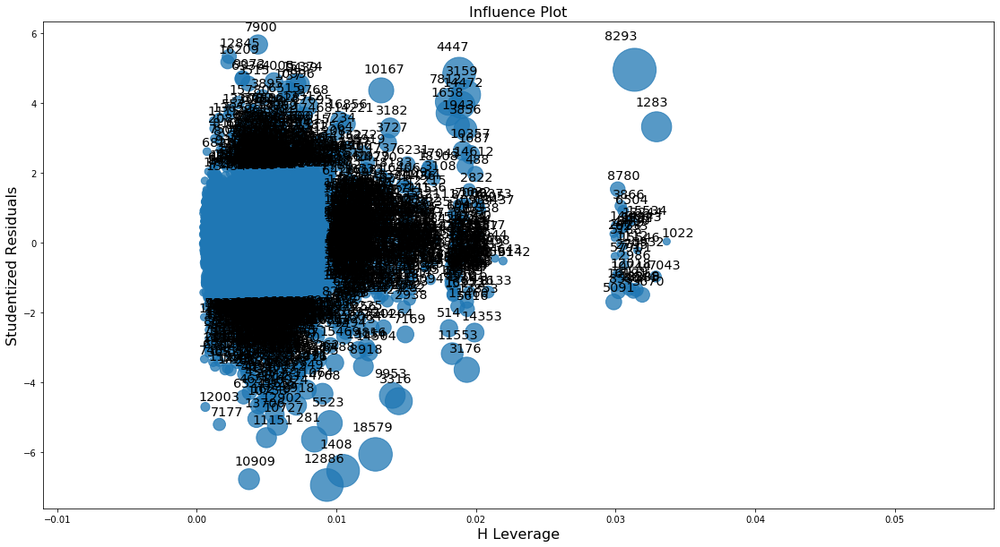

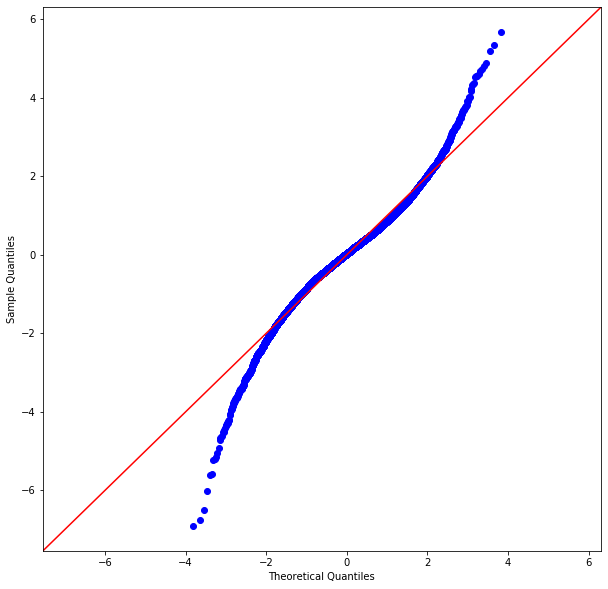

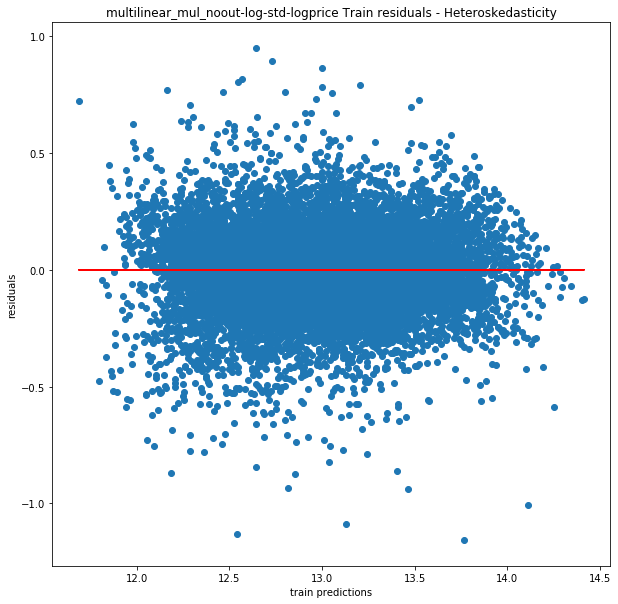

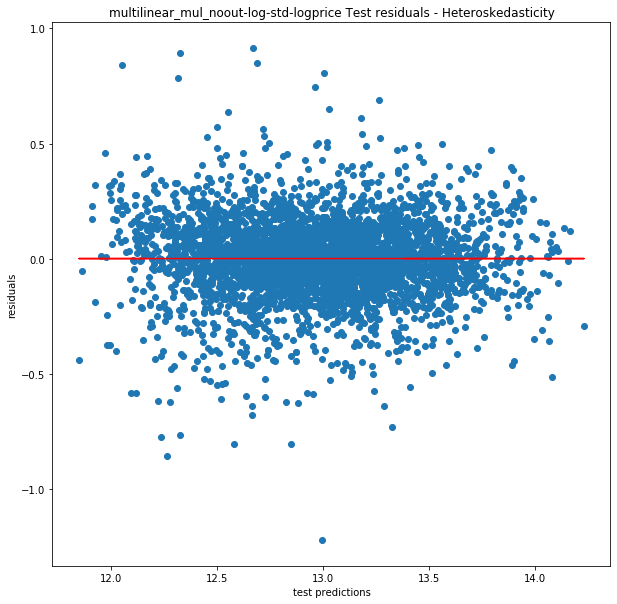

grade - Plotted


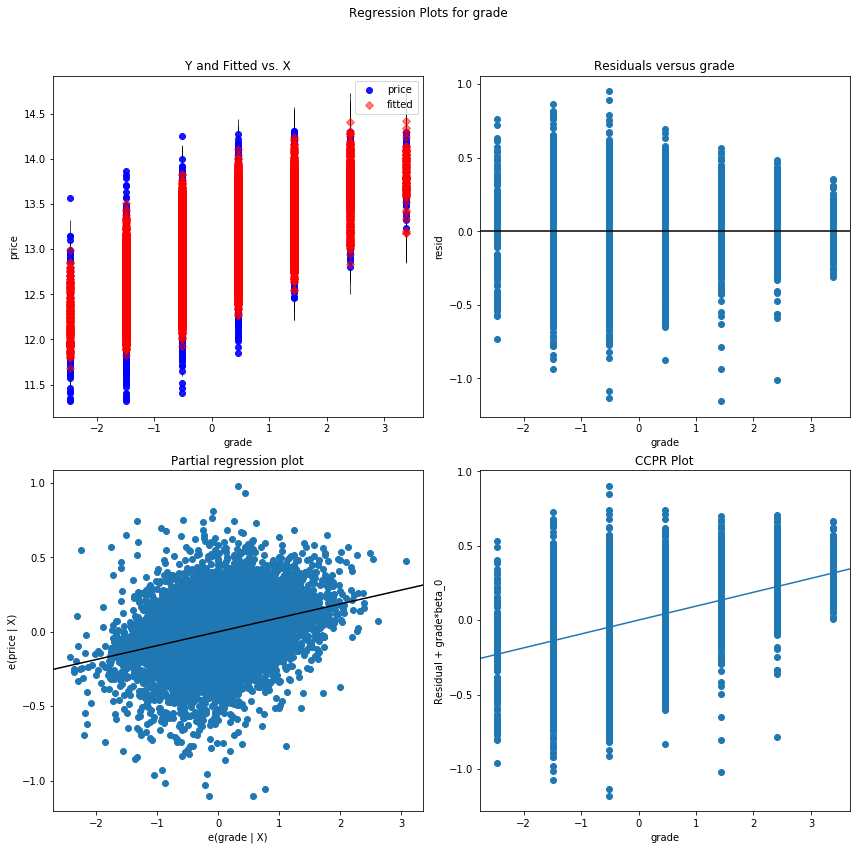

lat - Plotted


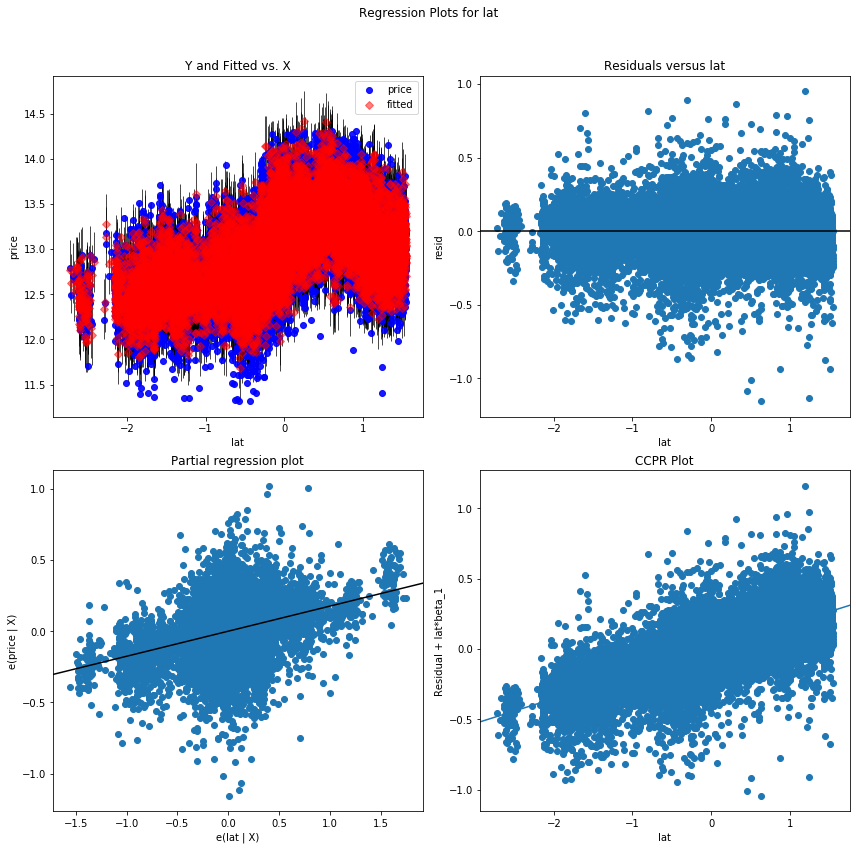

log-sqft_living - Plotted


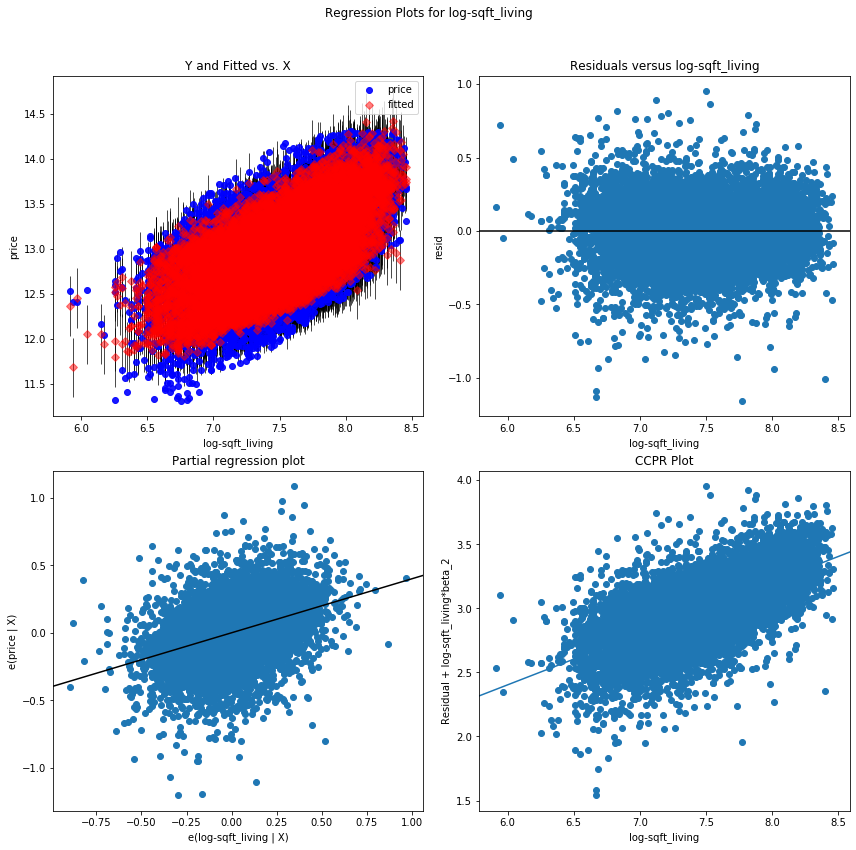

log-MHI - Plotted


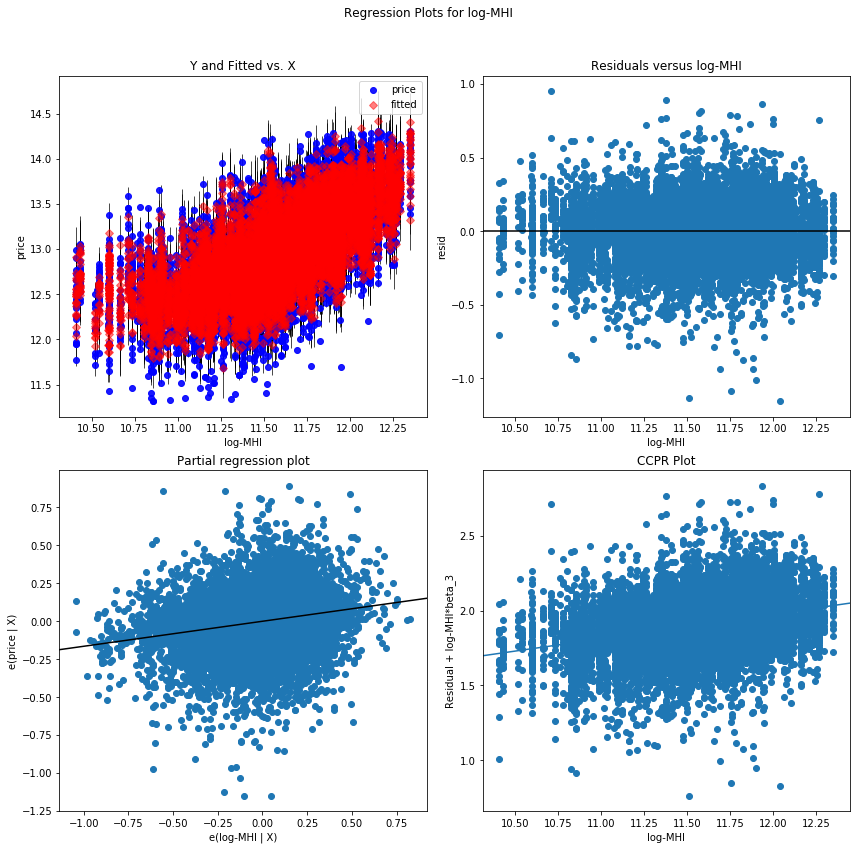

waterfront - Plotted


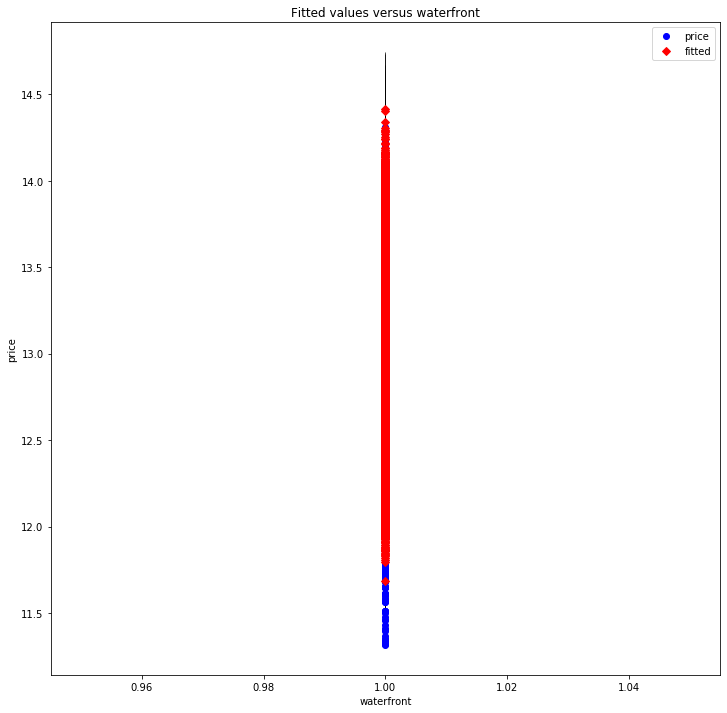

zipcode_98004 - Plotted


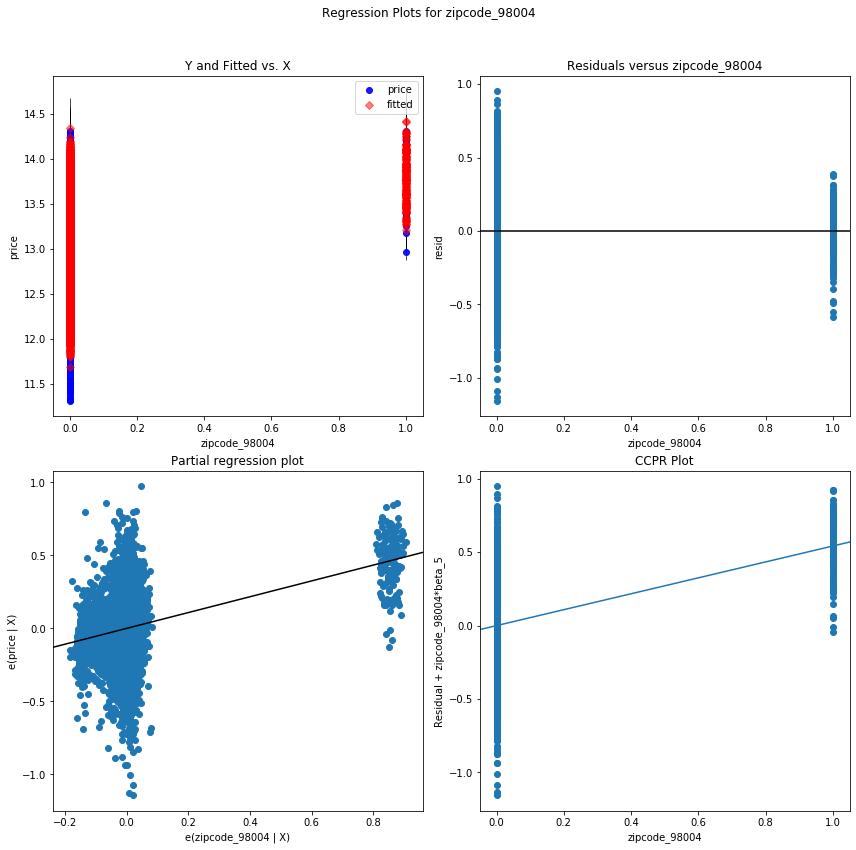

zipcode_98019 - Plotted


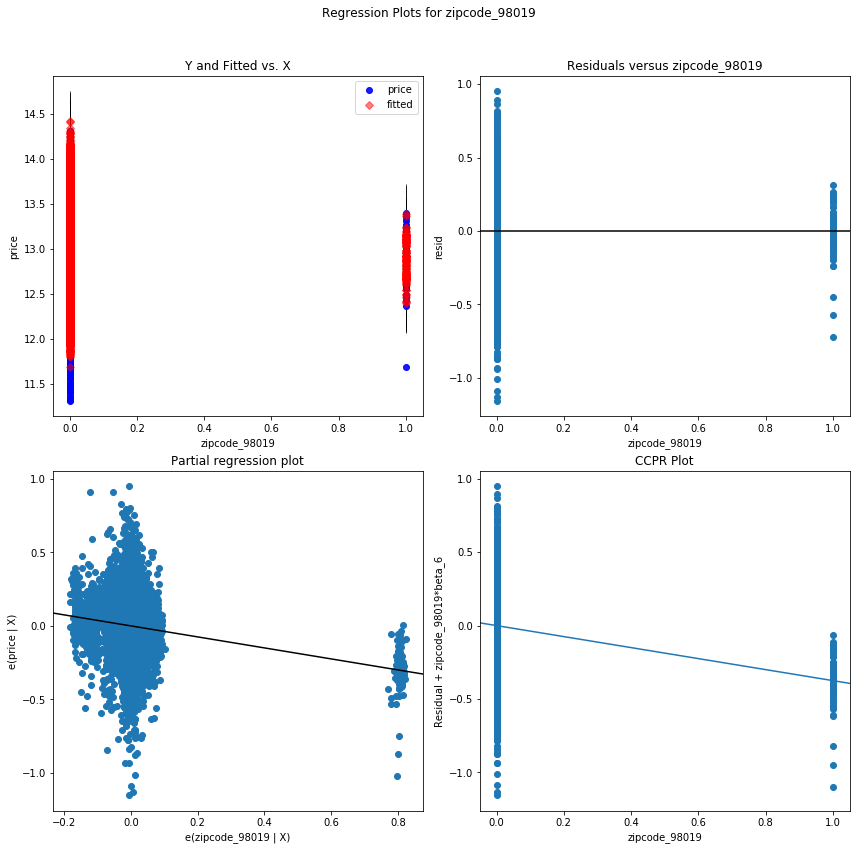

zipcode_98028 - Plotted


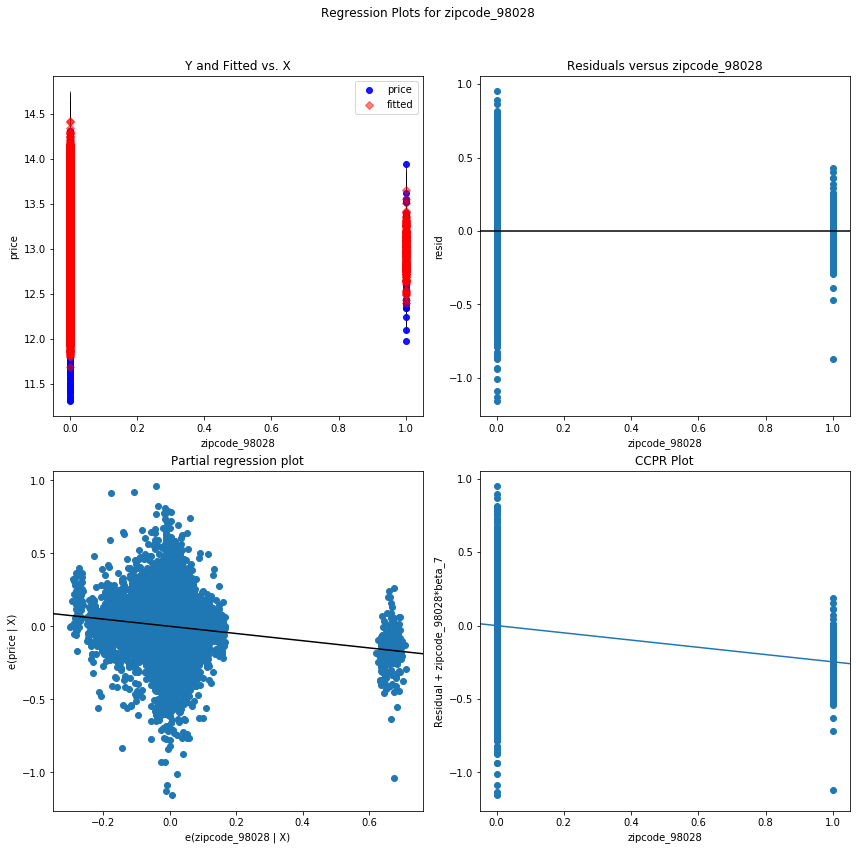

zipcode_98155 - Plotted


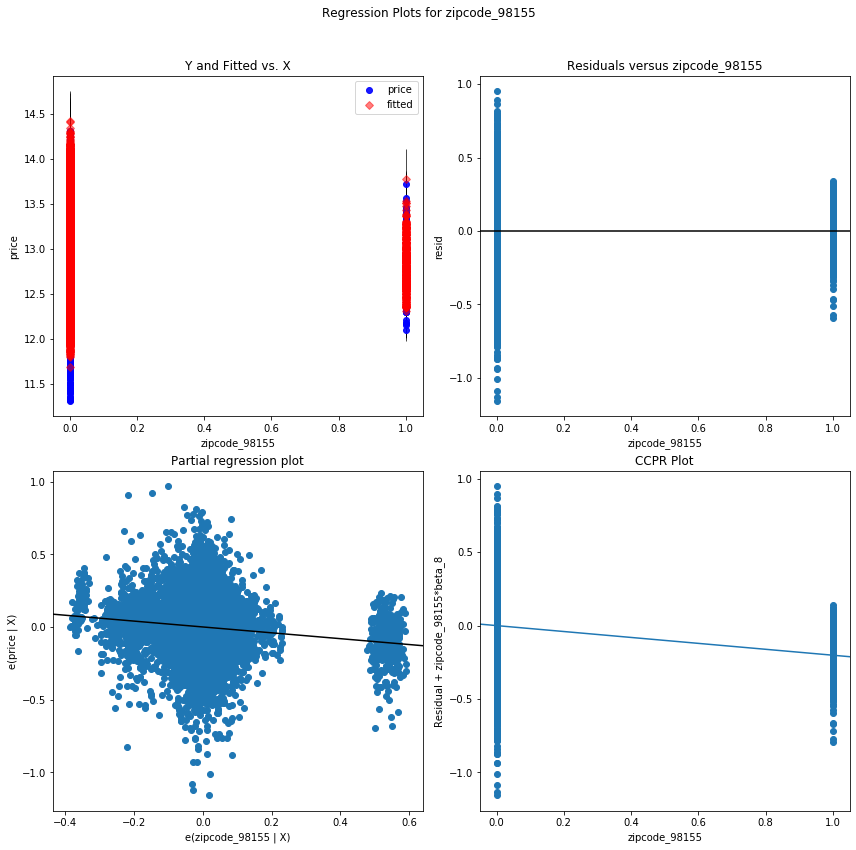

zipcode_98133 - Plotted


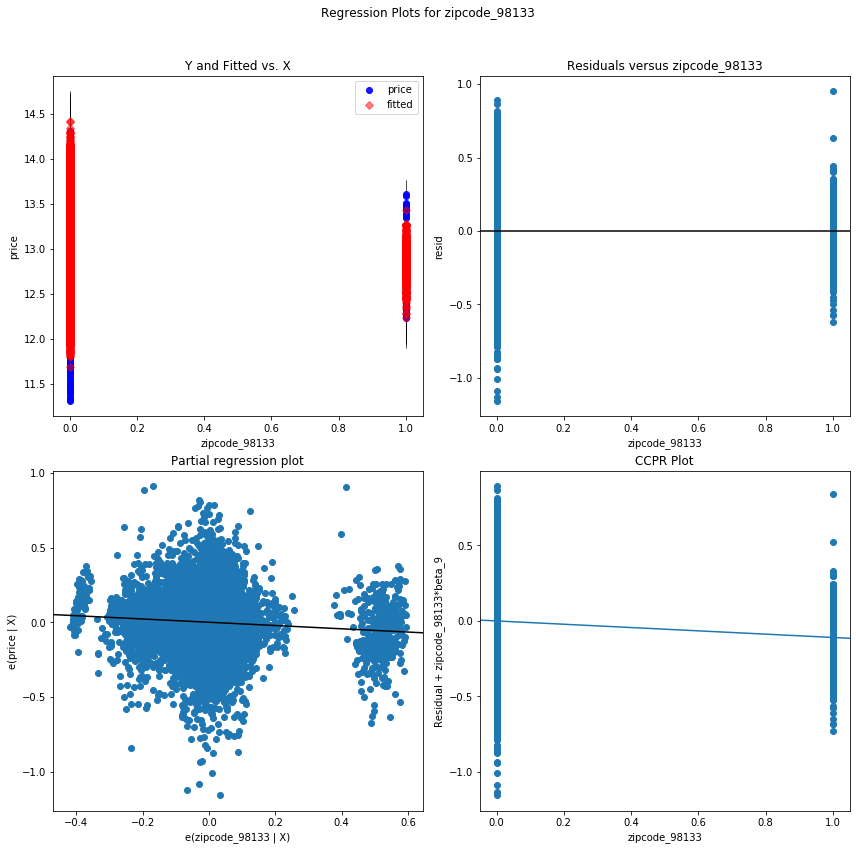

condition - Plotted


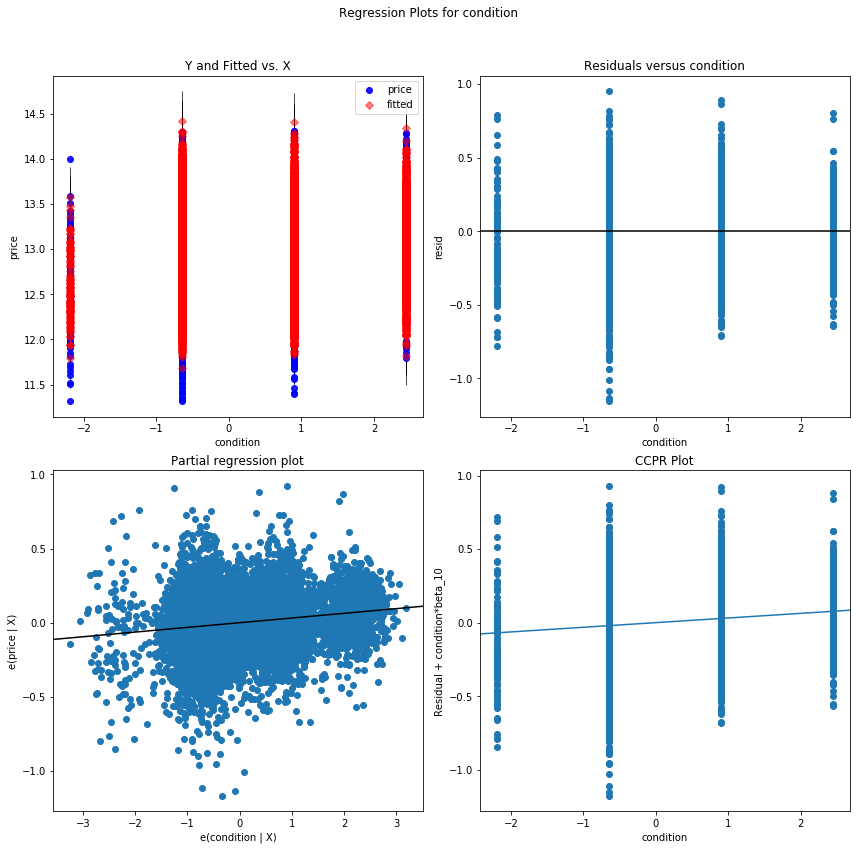

zipcode_98040 - Plotted


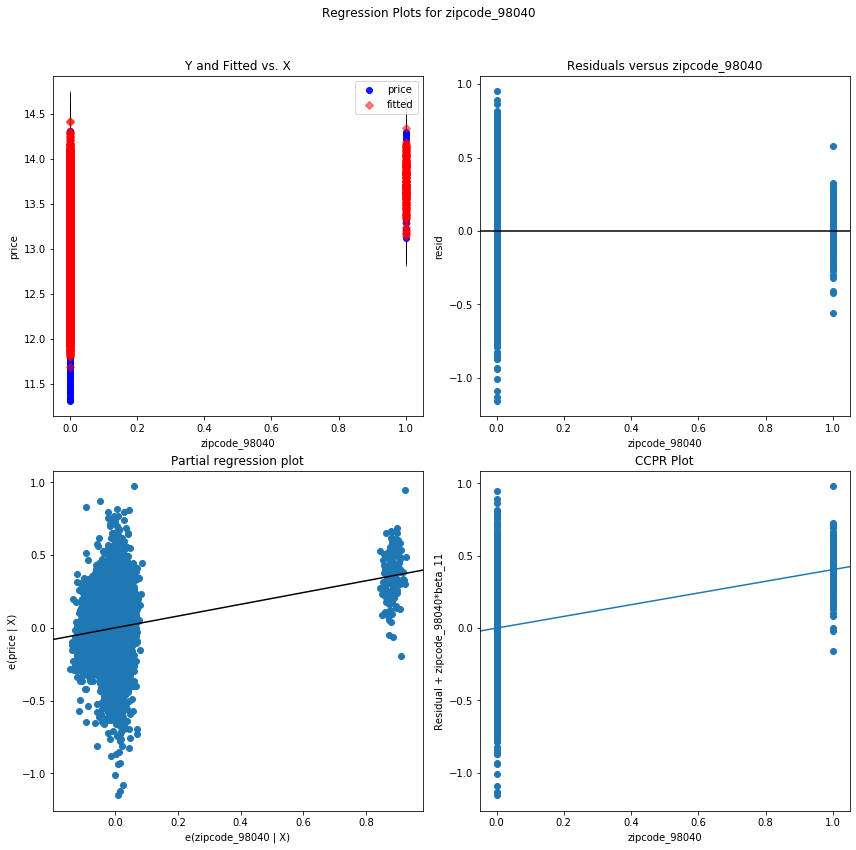

zipcode_98034 - Plotted


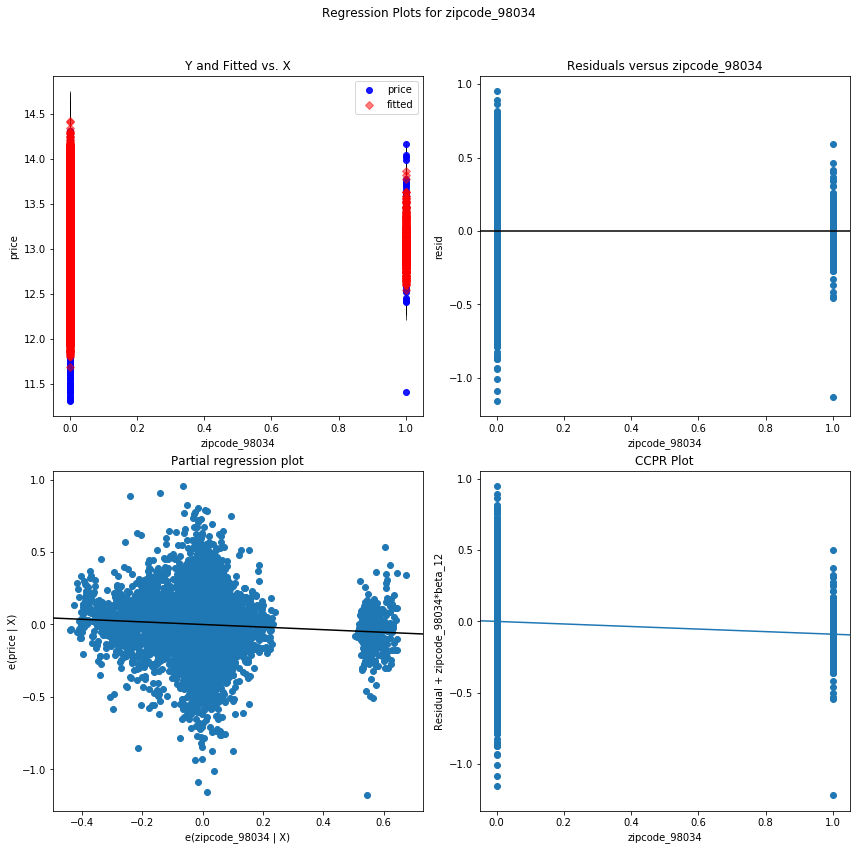

zipcode_98072 - Plotted


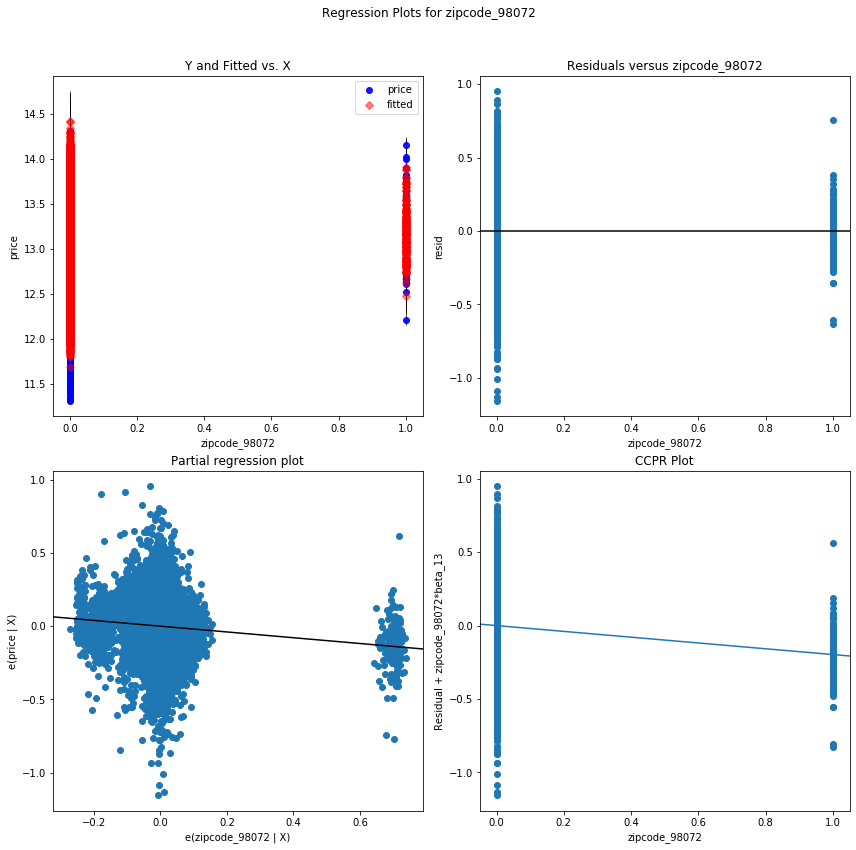

zipcode_98011 - Plotted


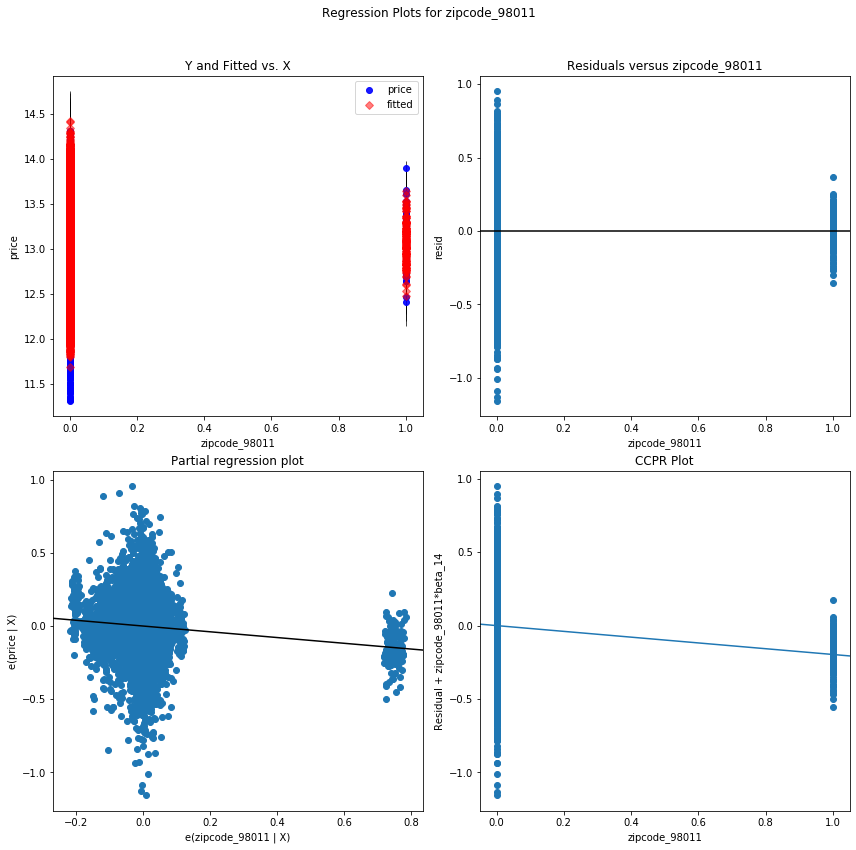

zipcode_98077 - Plotted


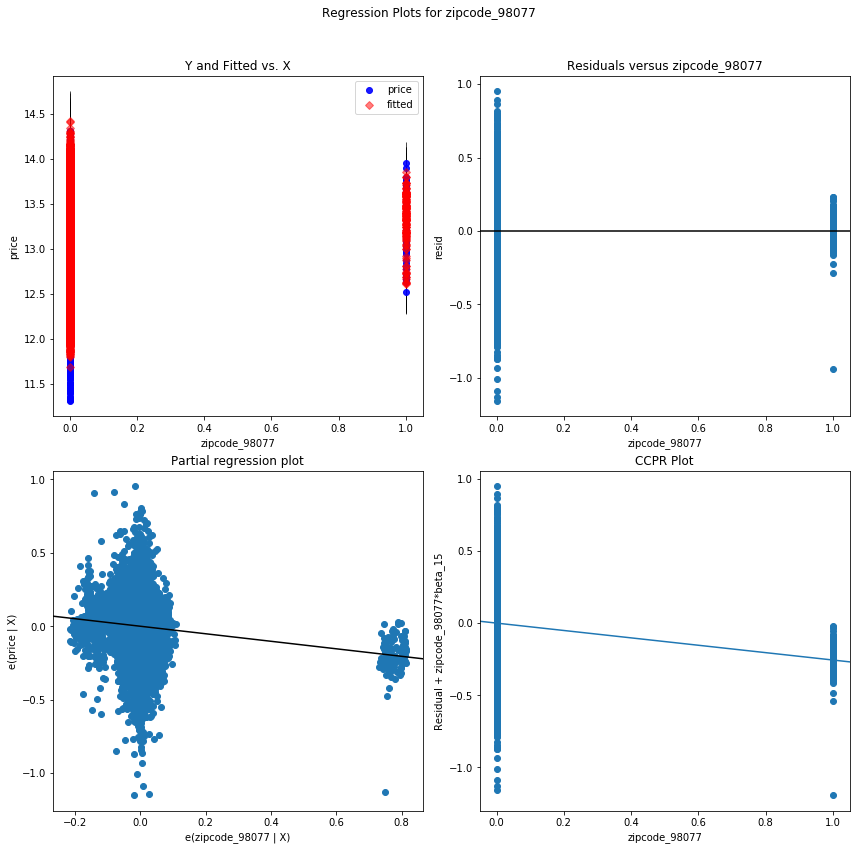

view_2.0 - Plotted


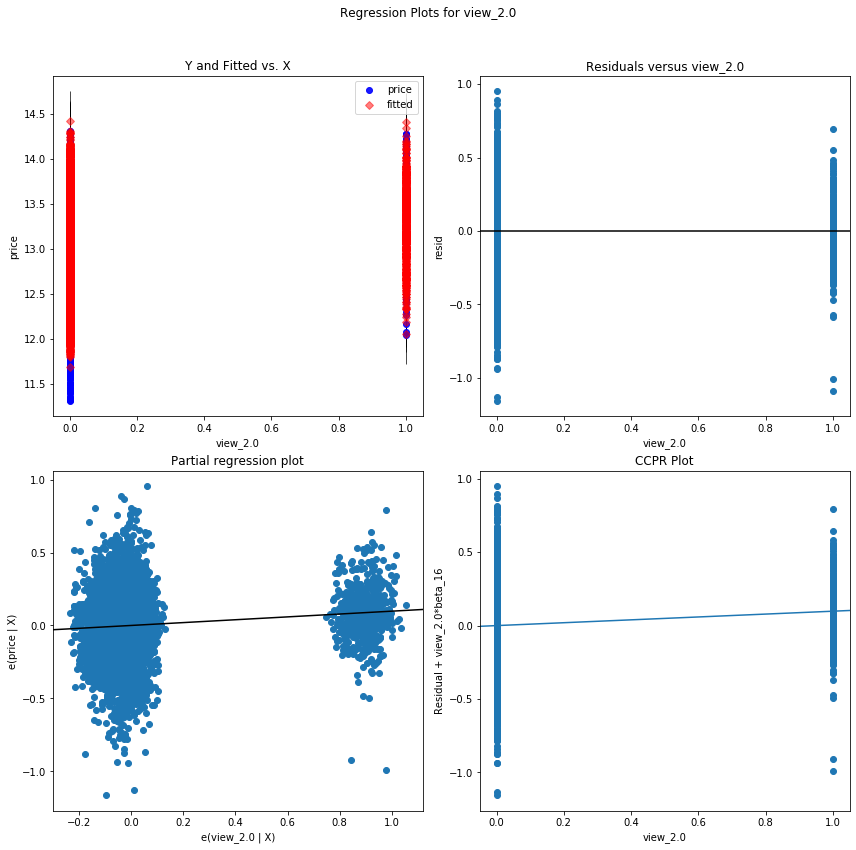

zipcode_98177 - Plotted


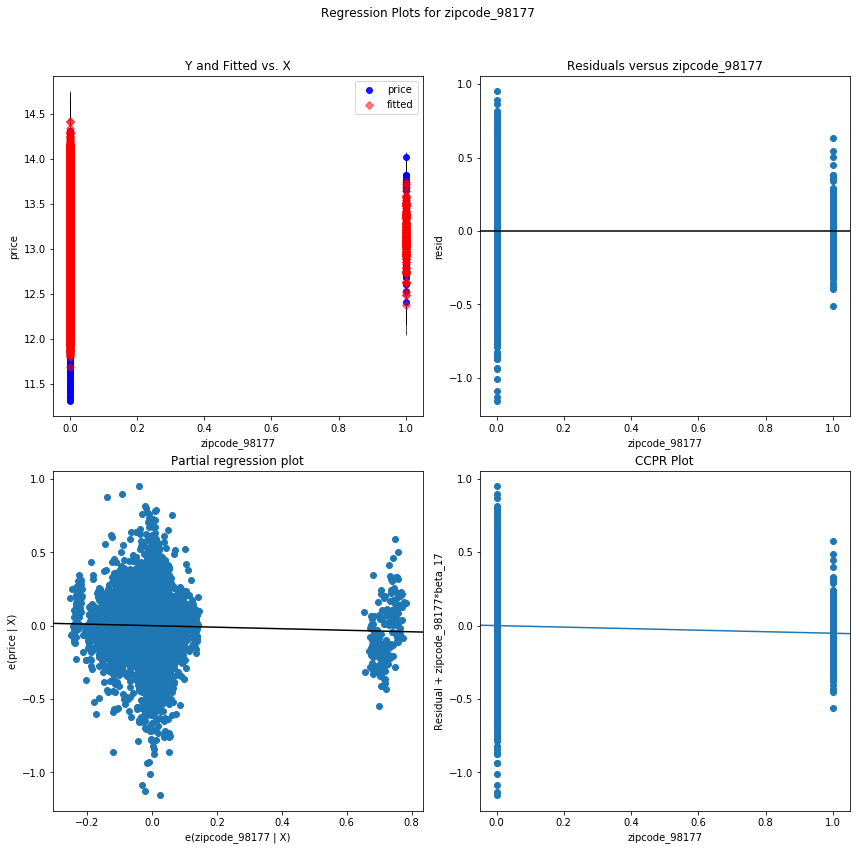

log-sqft_living15 - Plotted


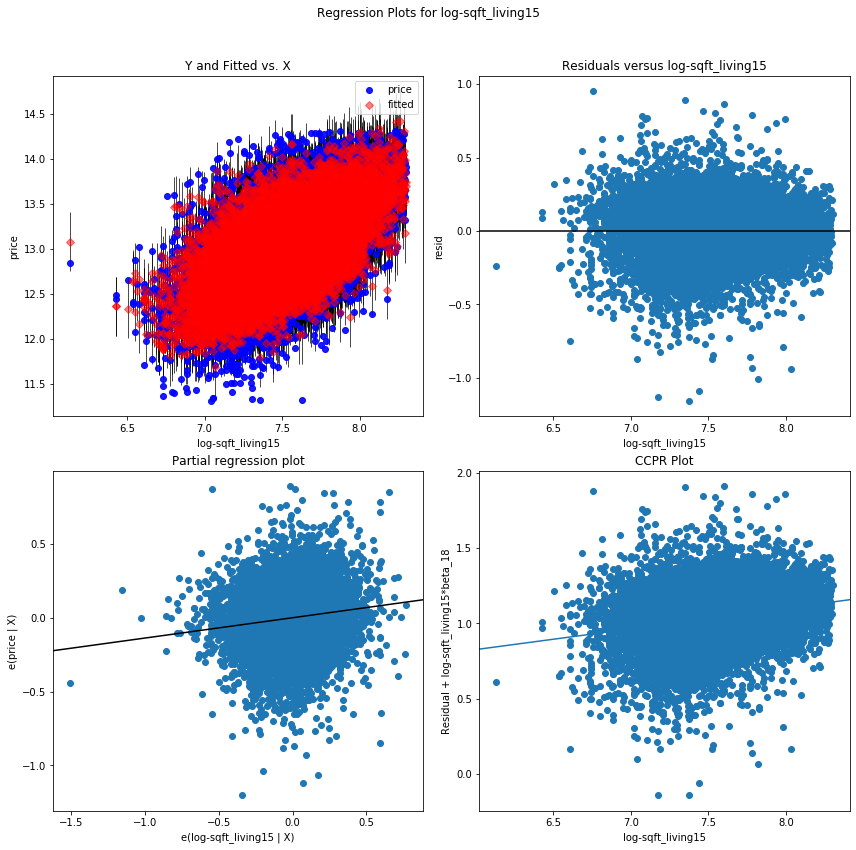

zipcode_98022 - Plotted


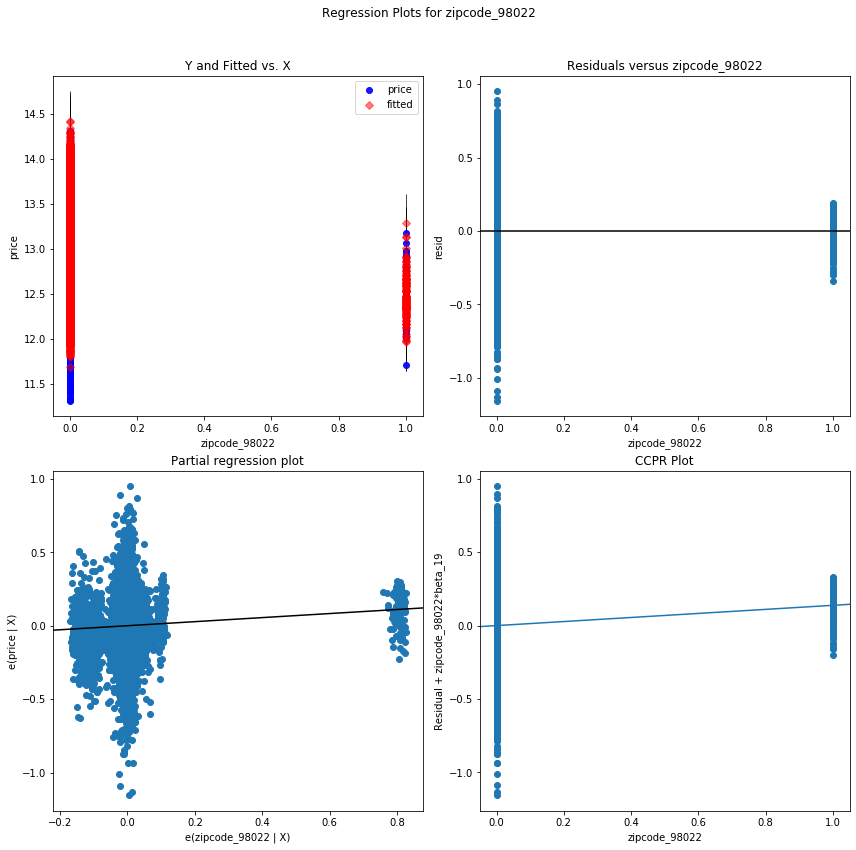

zipcode_98125 - Plotted


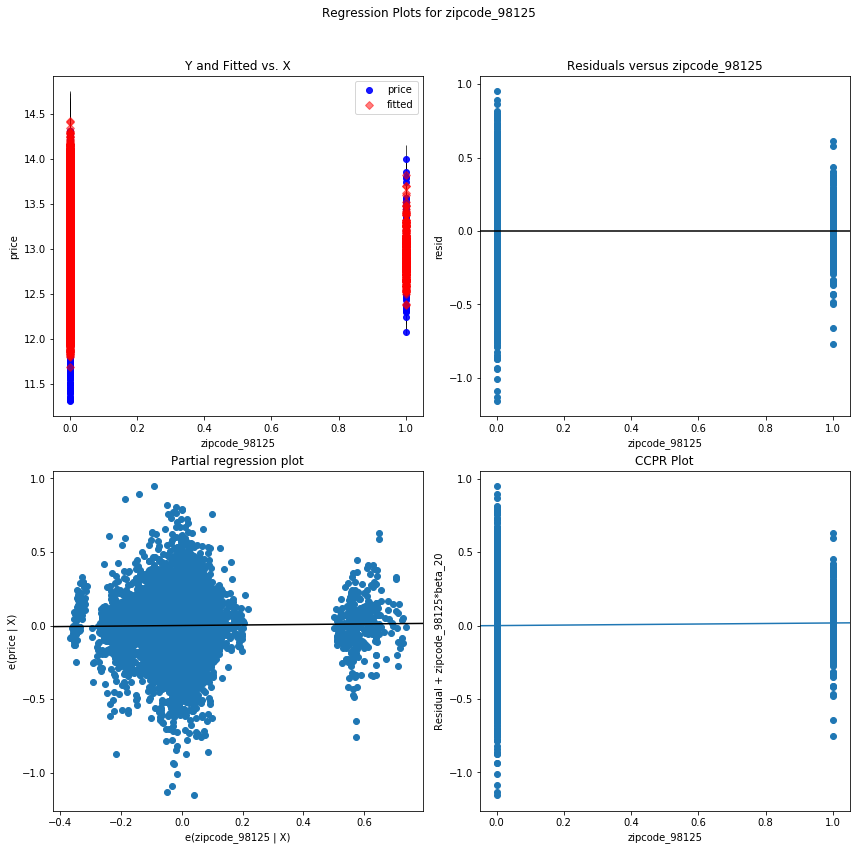

zipcode_98178 - Plotted


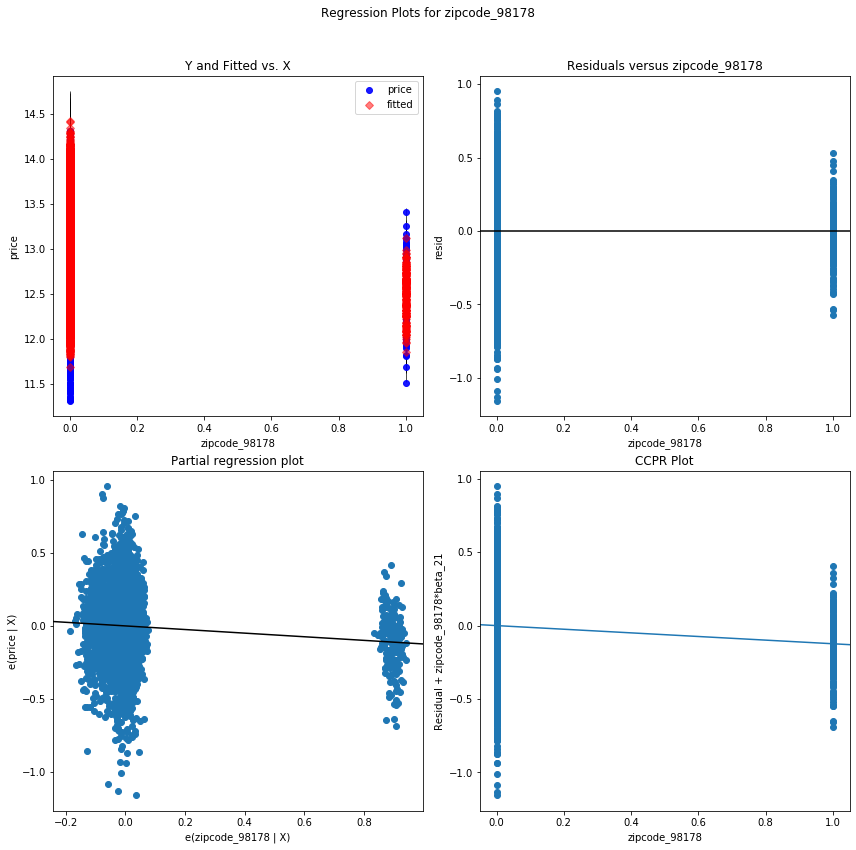

zipcode_98168 - Plotted


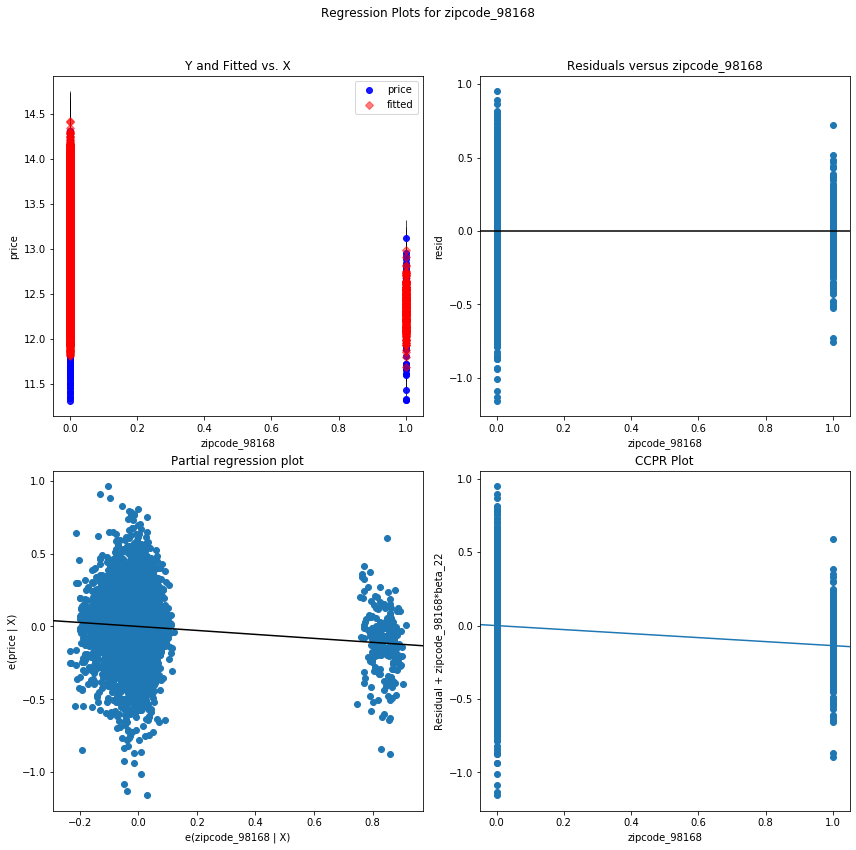

zipcode_98014 - Plotted


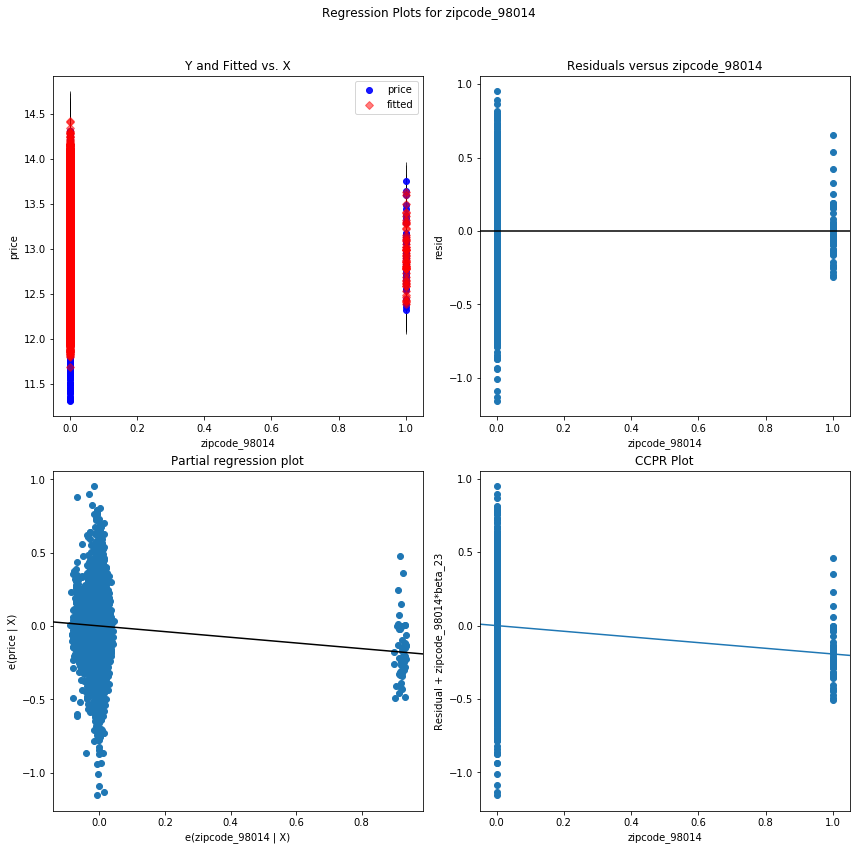

zipcode_98058 - Plotted


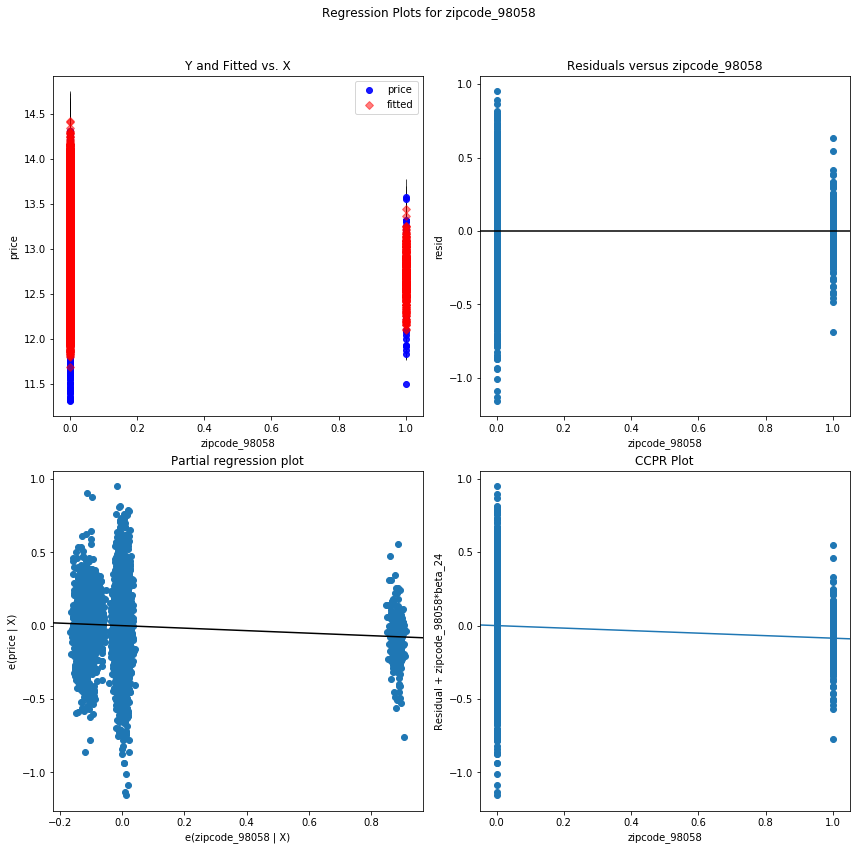

zipcode_98112 - Plotted


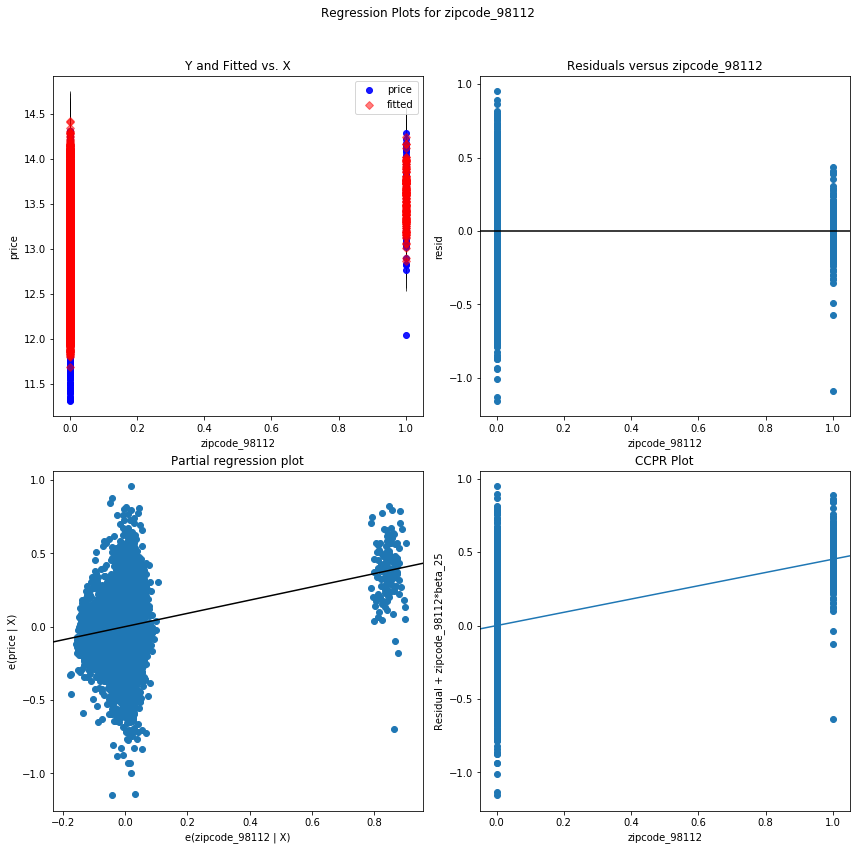

log-sqft_basement - Plotted


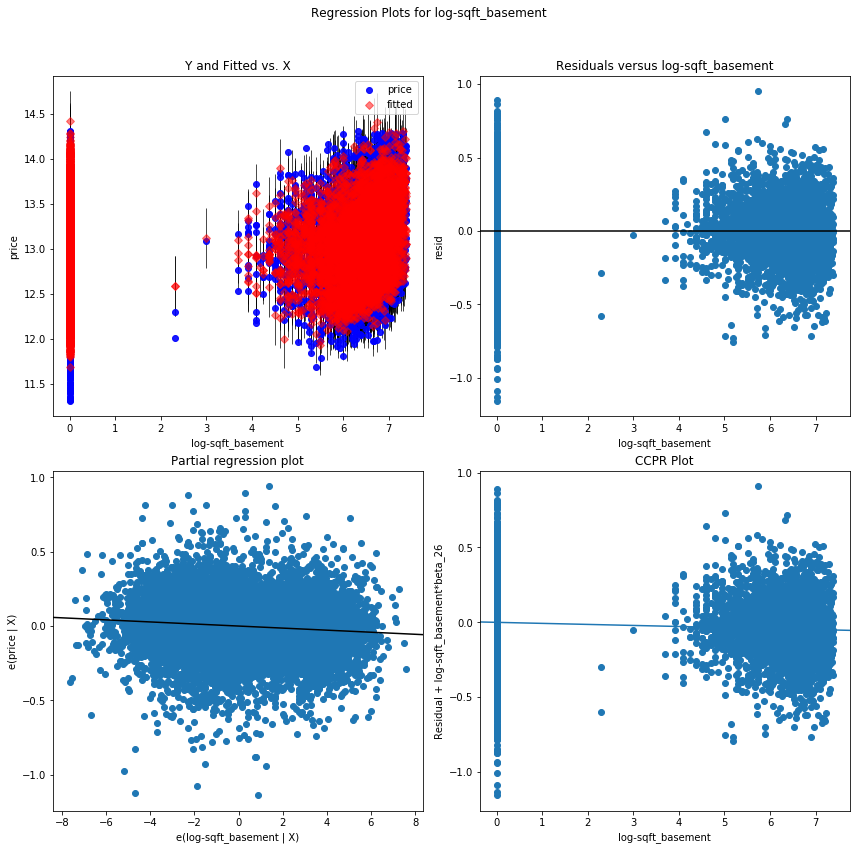

zipcode_98010 - Plotted


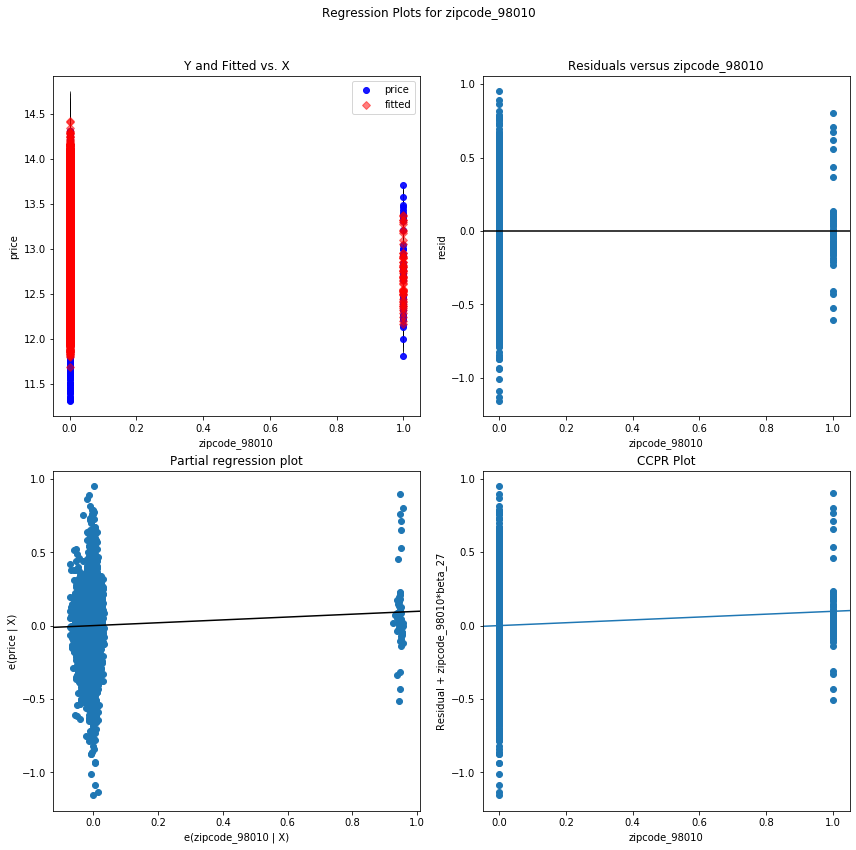

zipcode_98055 - Plotted


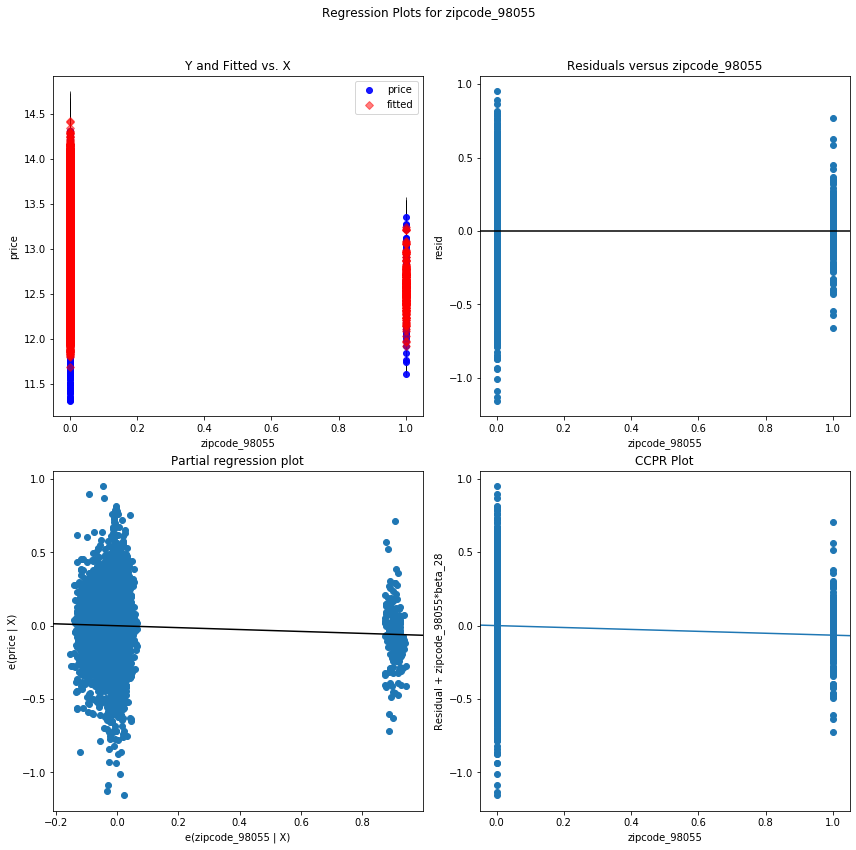

log-sqft_lot - Plotted


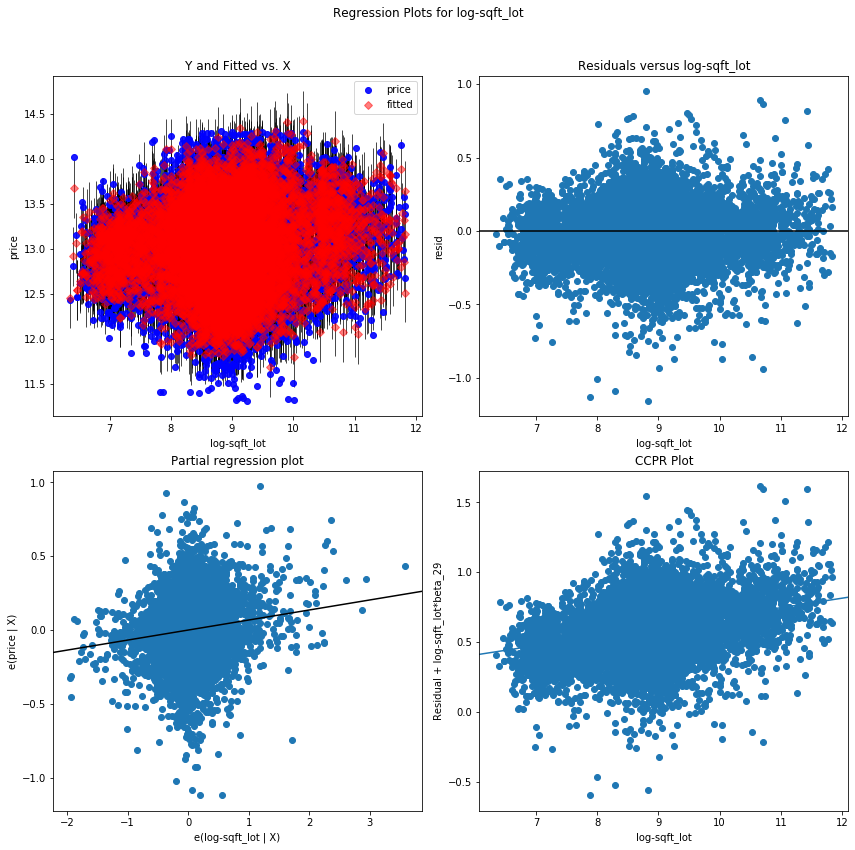

zipcode_98122 - Plotted


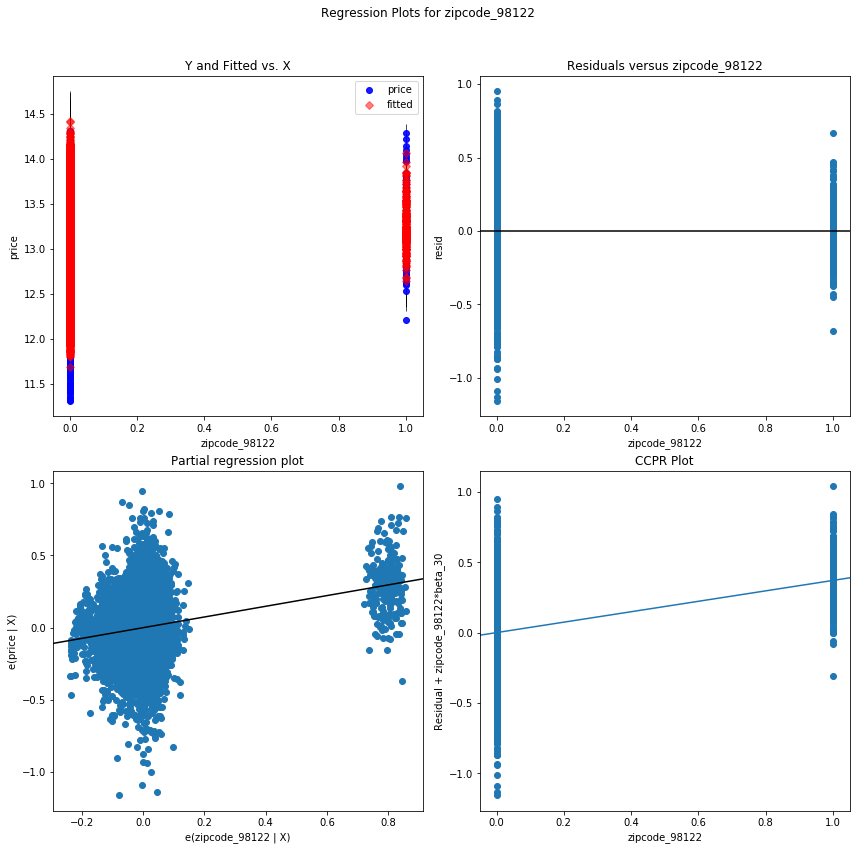

zipcode_98102 - Plotted


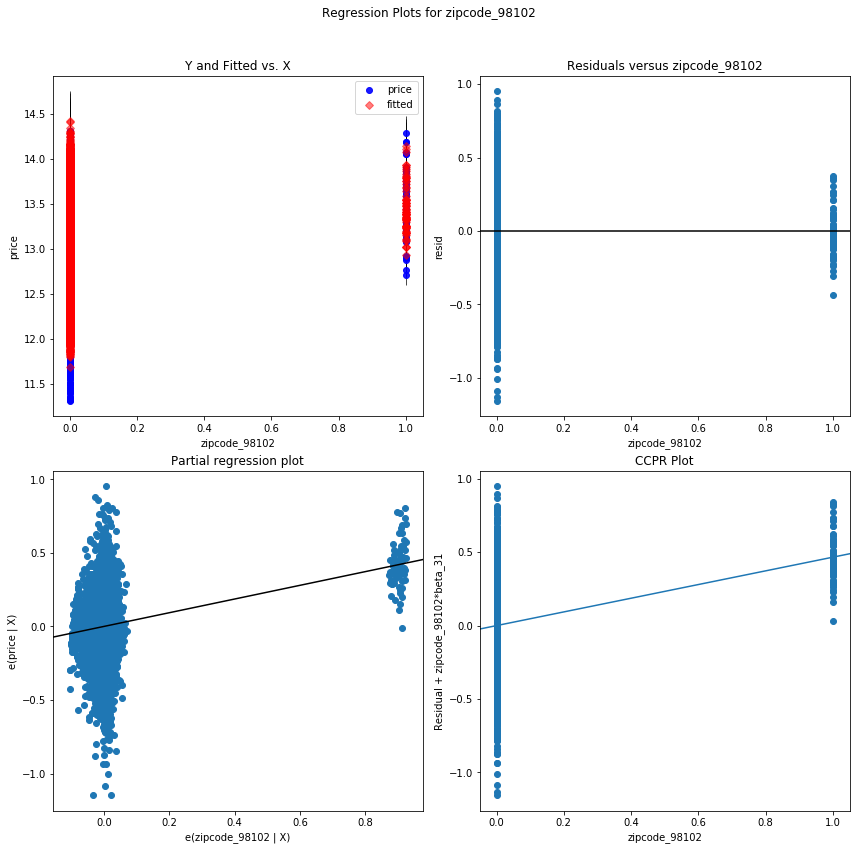

zipcode_98119 - Plotted


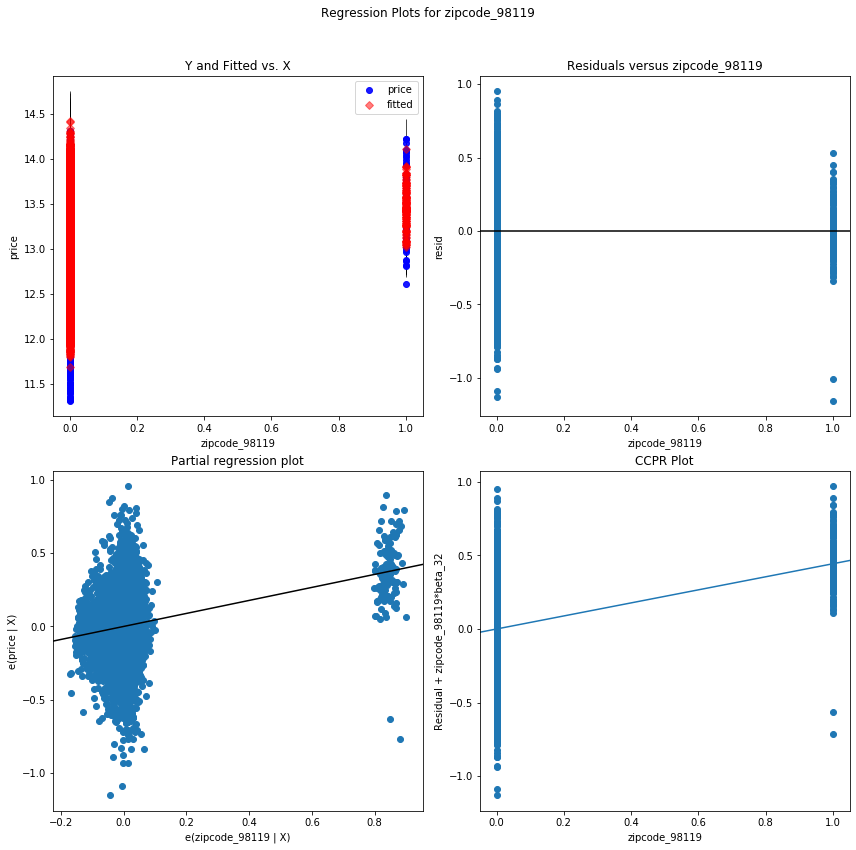

zipcode_98136 - Plotted


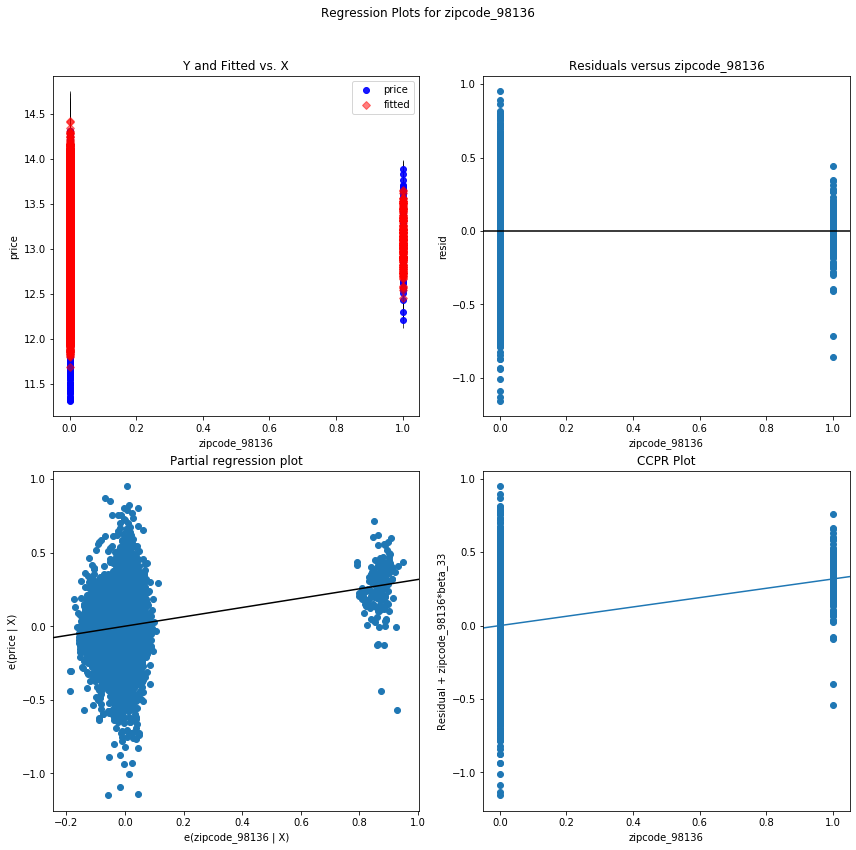

zipcode_98116 - Plotted


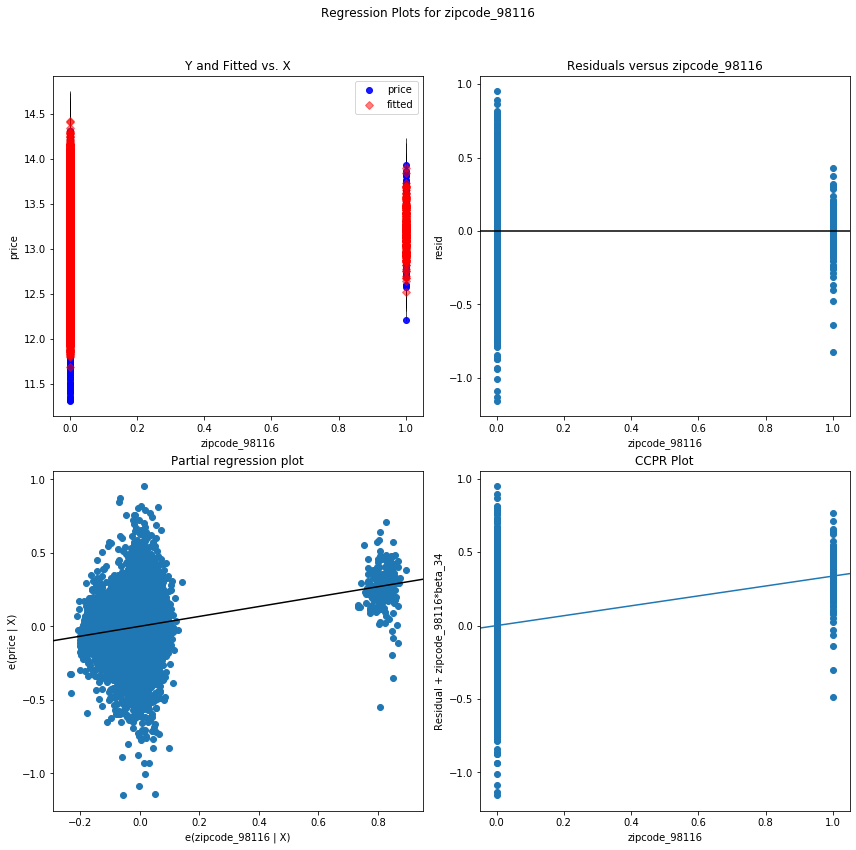

zipcode_98109 - Plotted


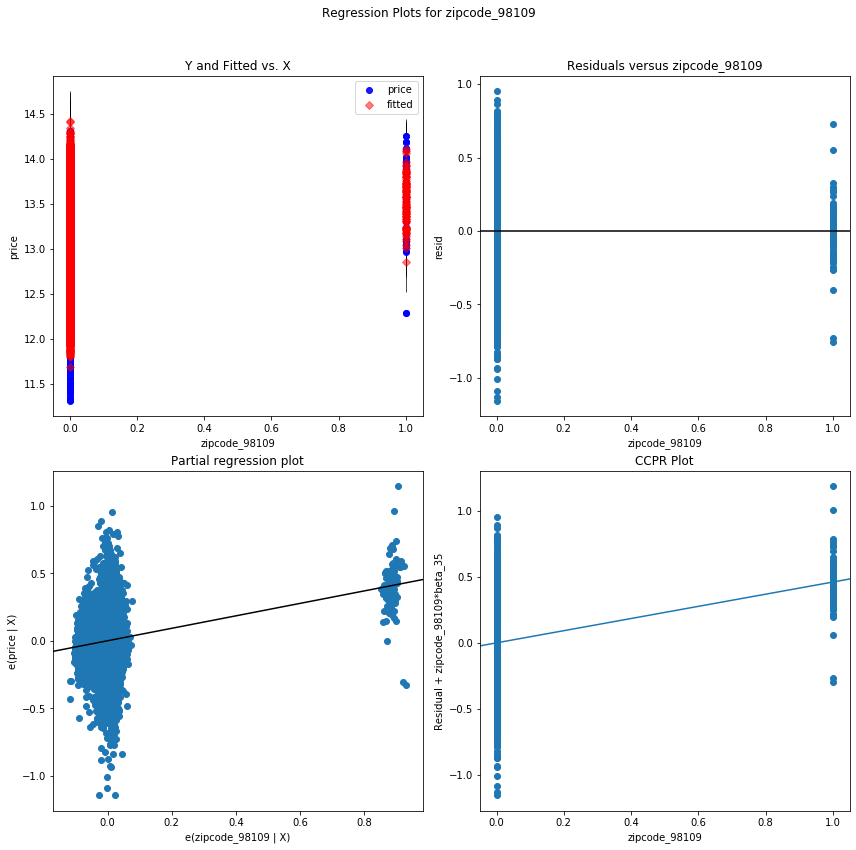

zipcode_98105 - Plotted


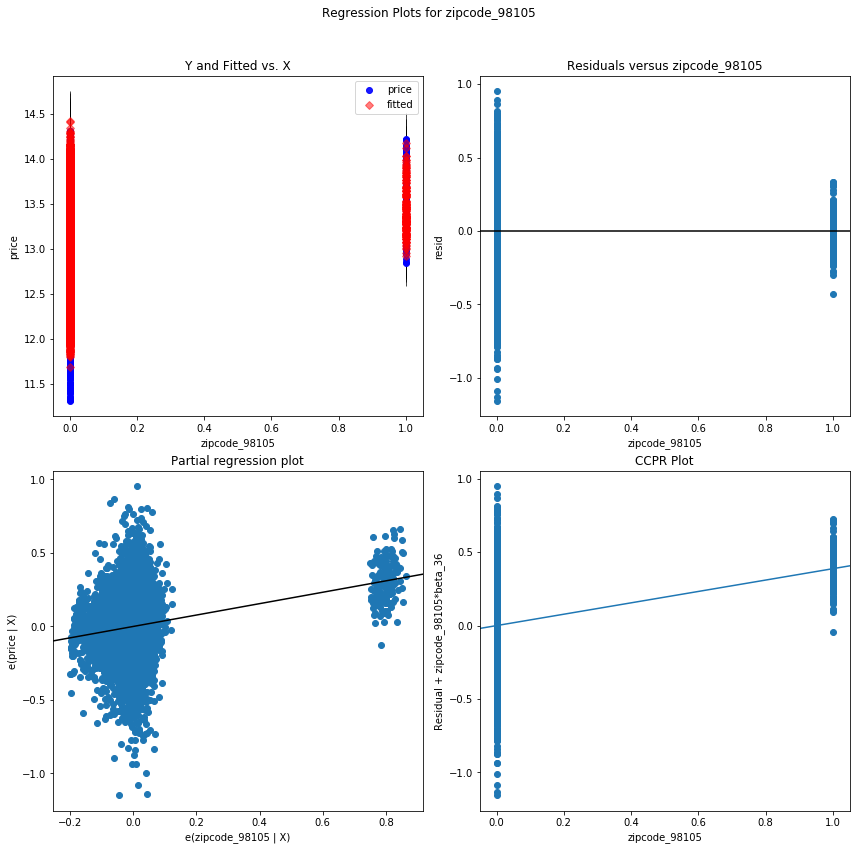

zipcode_98031 - Plotted


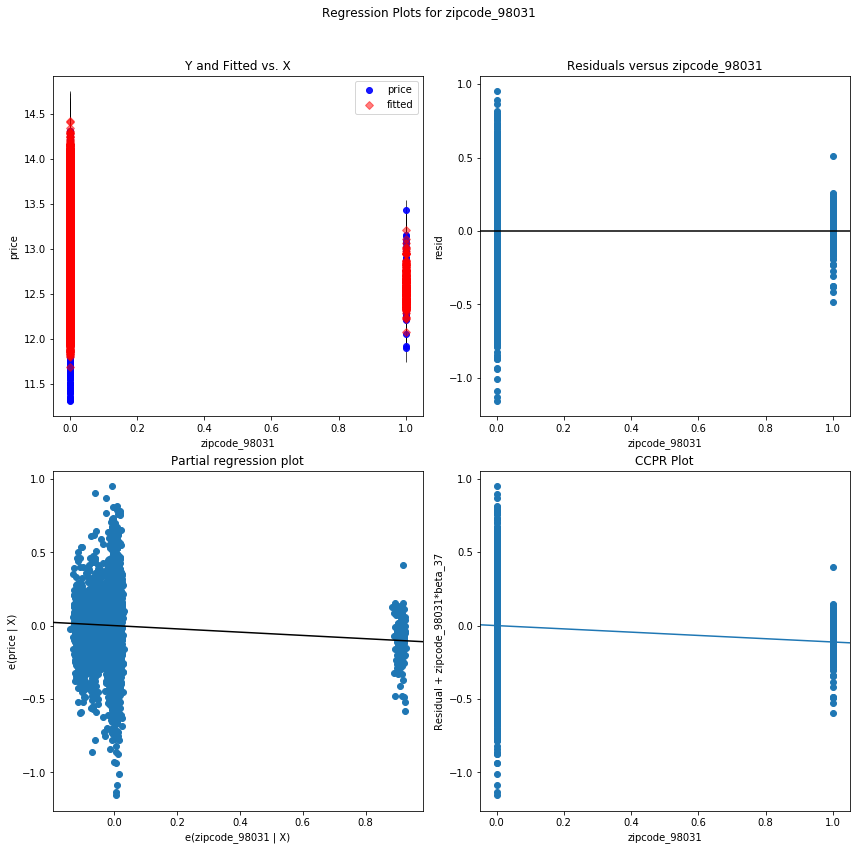

zipcode_98006 - Plotted


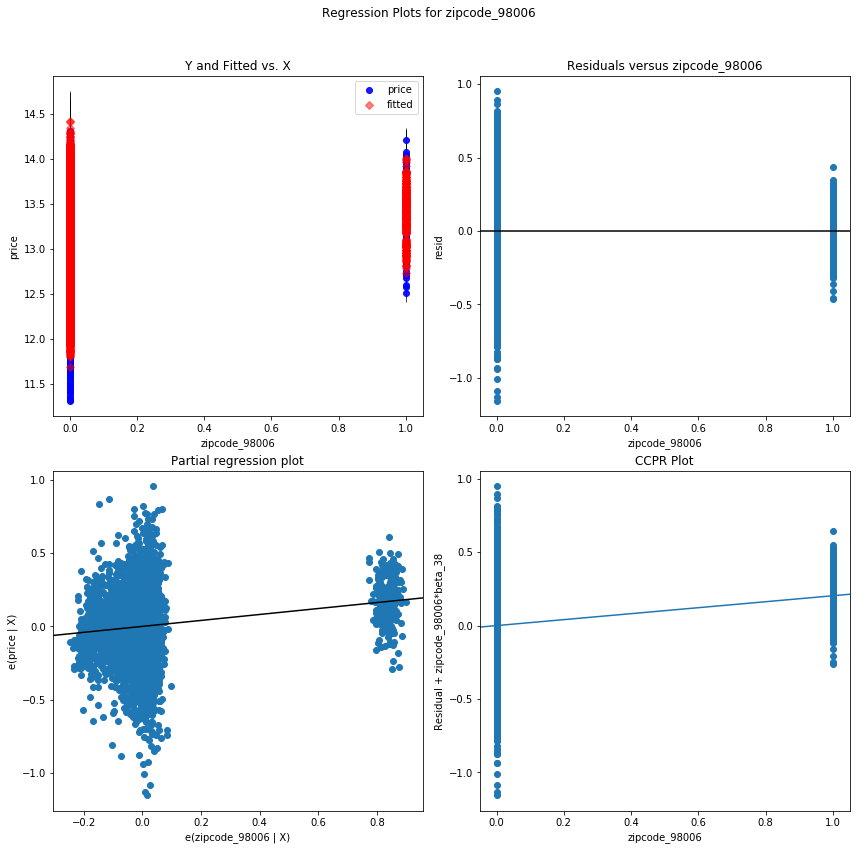

zipcode_98027 - Plotted


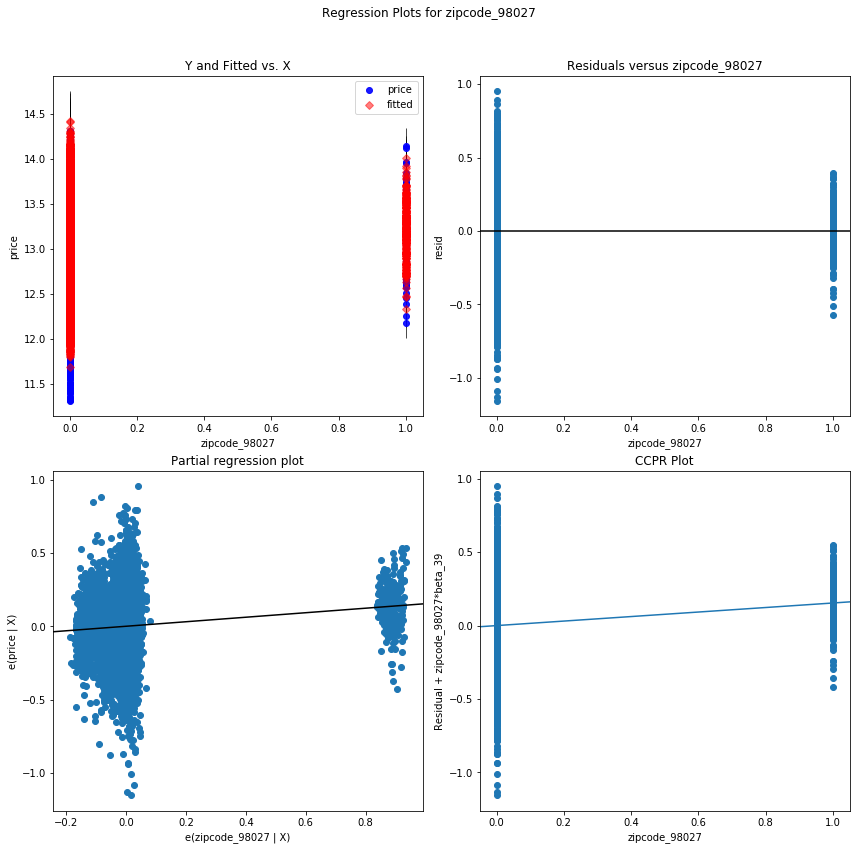

zipcode_98029 - Plotted


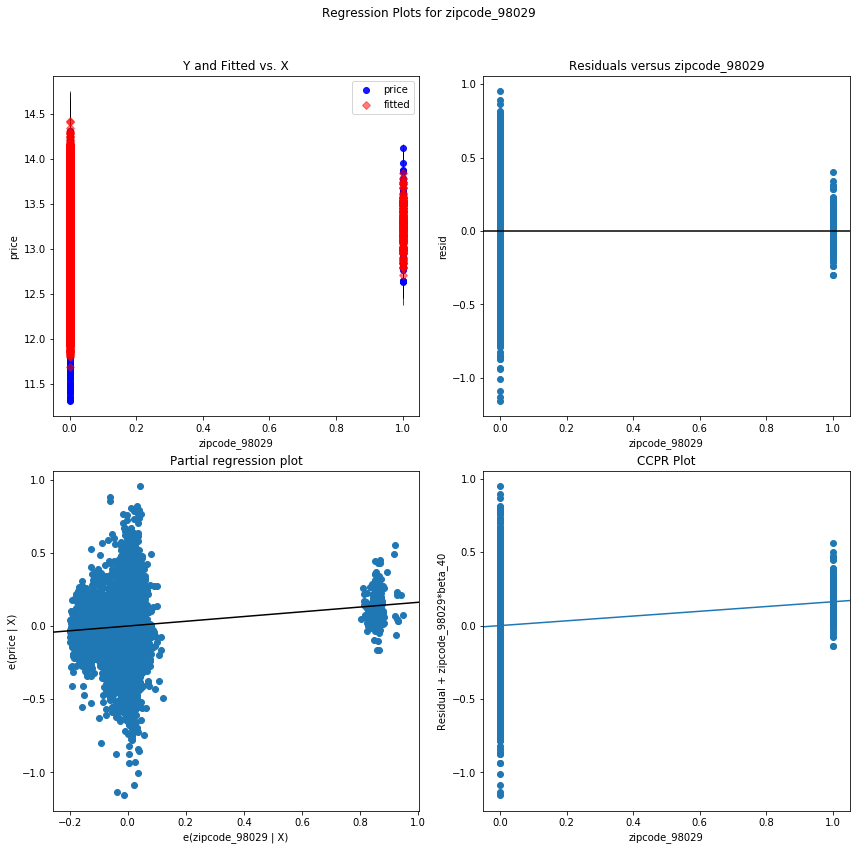

zipcode_98005 - Plotted


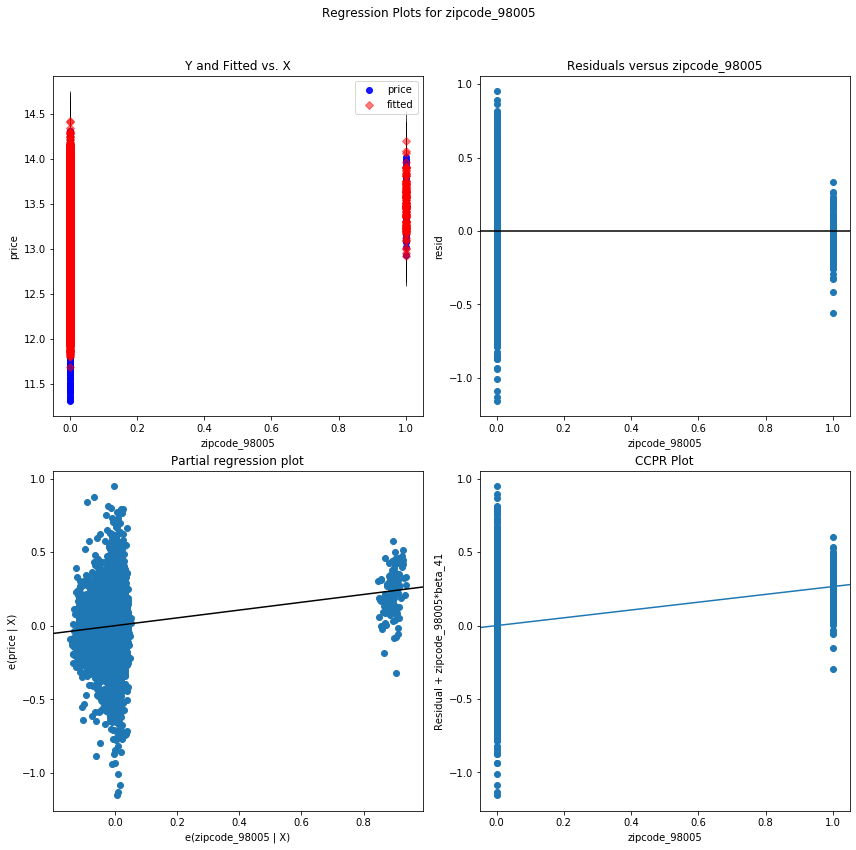

zipcode_98144 - Plotted


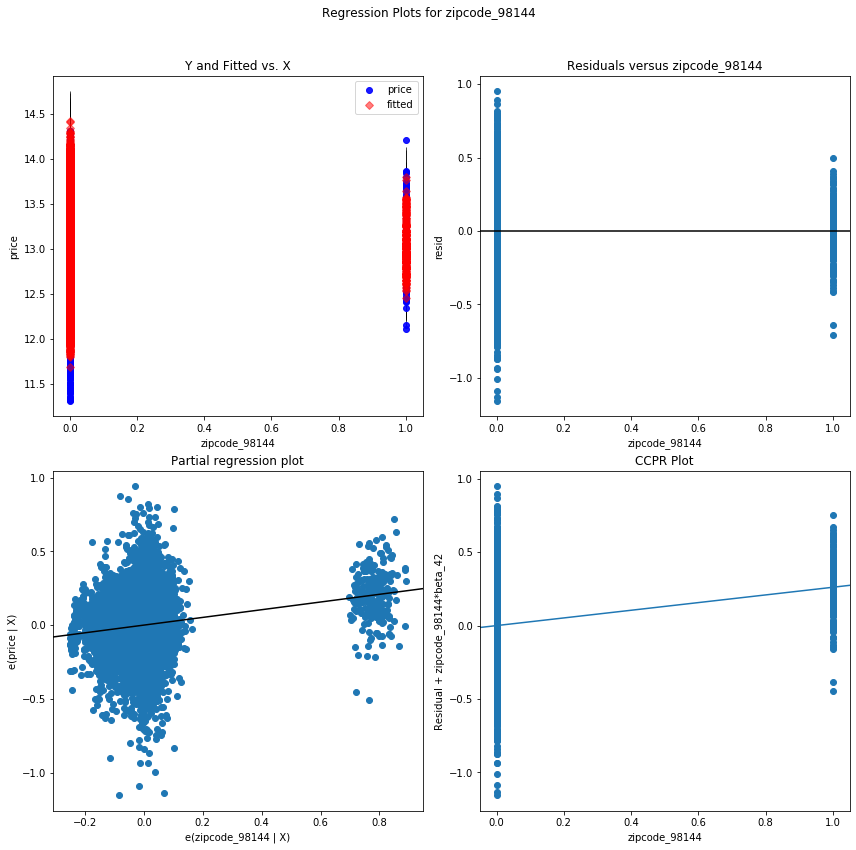

zipcode_98199 - Plotted


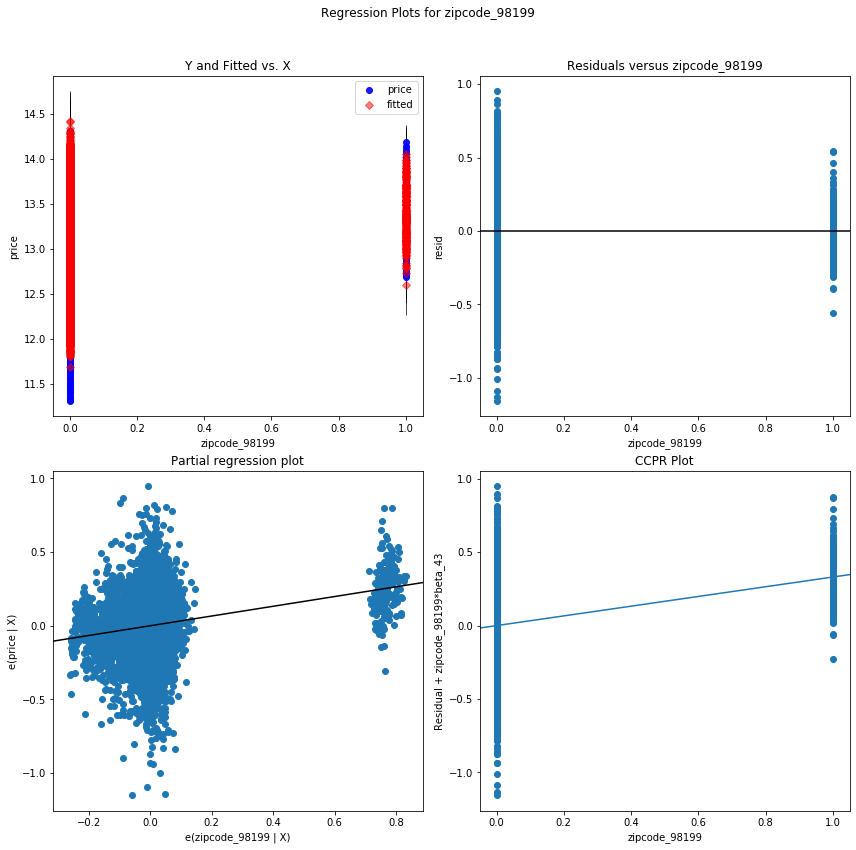

zipcode_98126 - Plotted


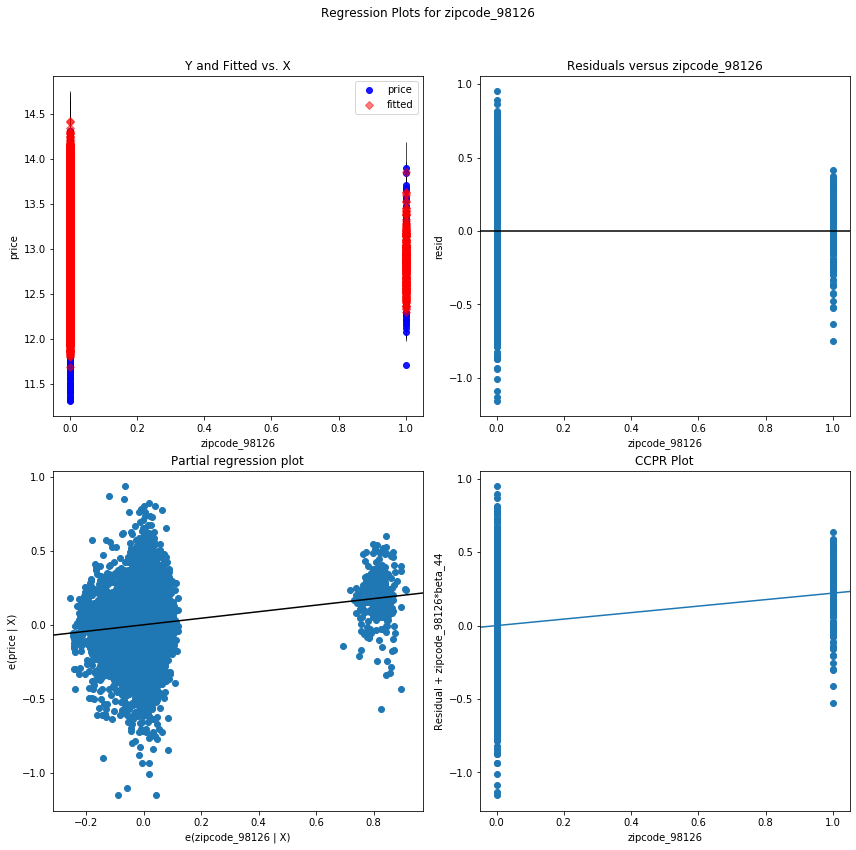

log-bathrooms - Plotted


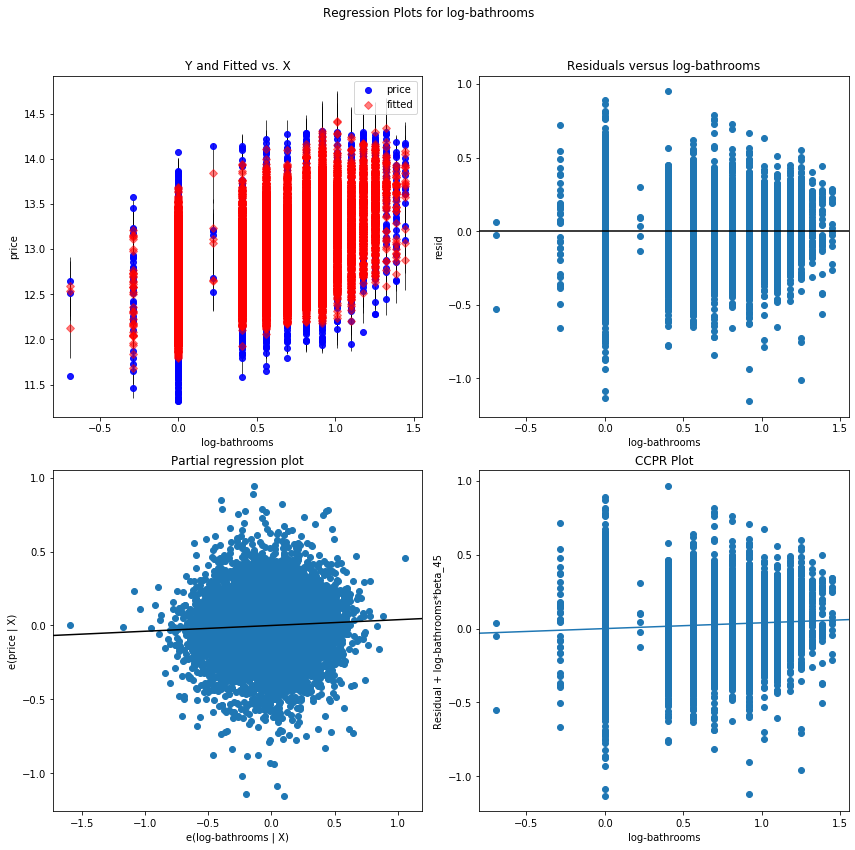

zipcode_98198 - Plotted


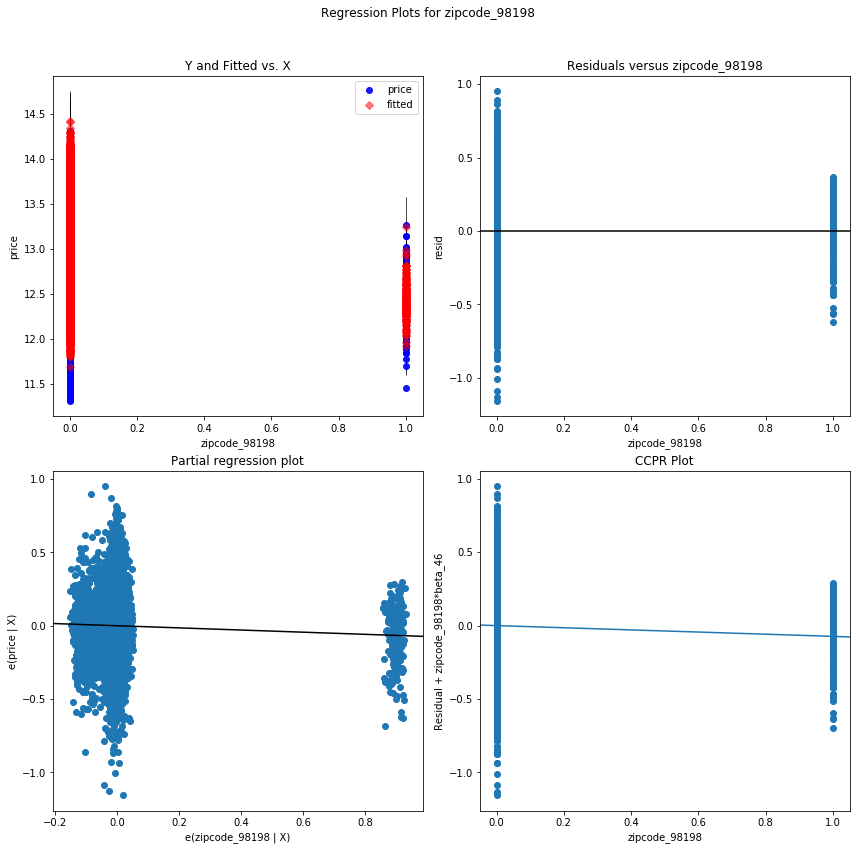

zipcode_98188 - Plotted


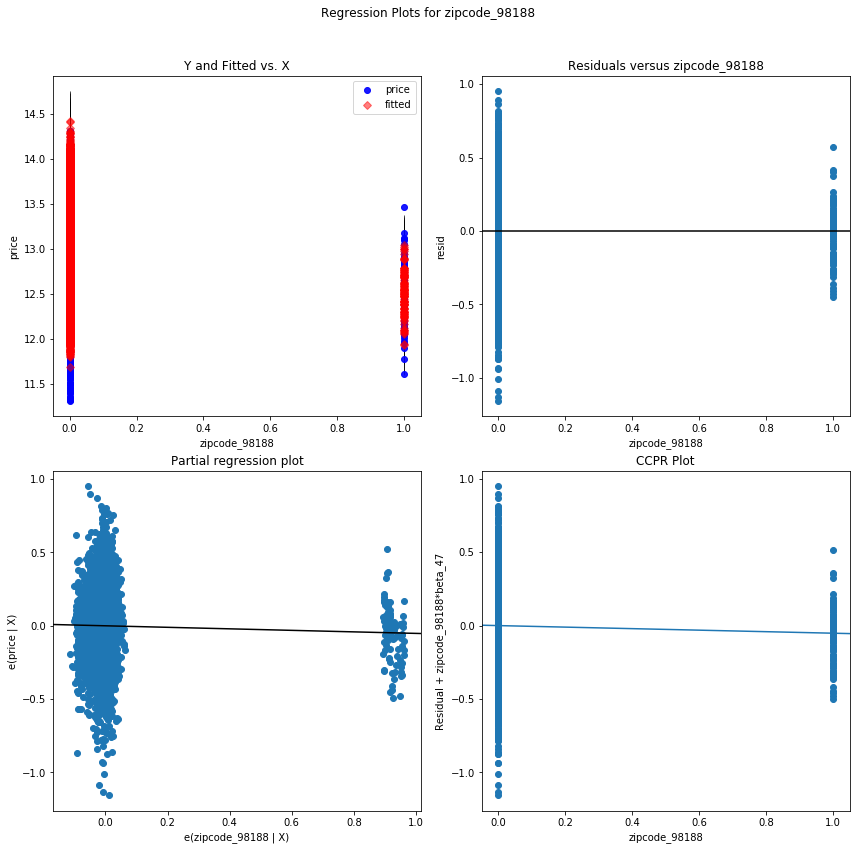

zipcode_98032 - Plotted


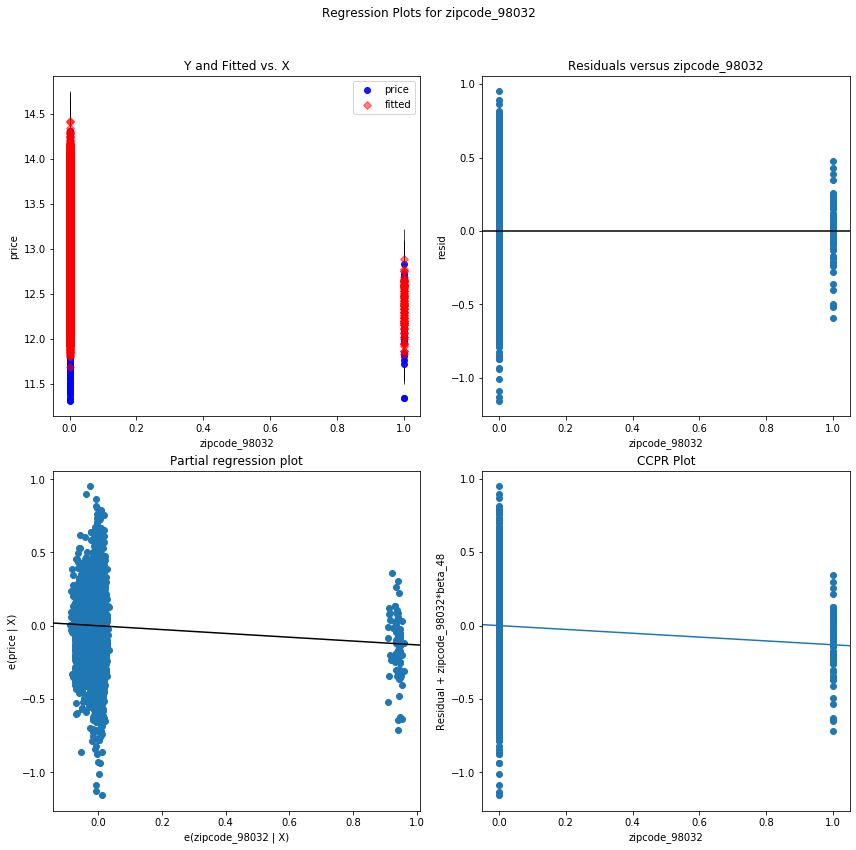

zipcode_98023 - Plotted


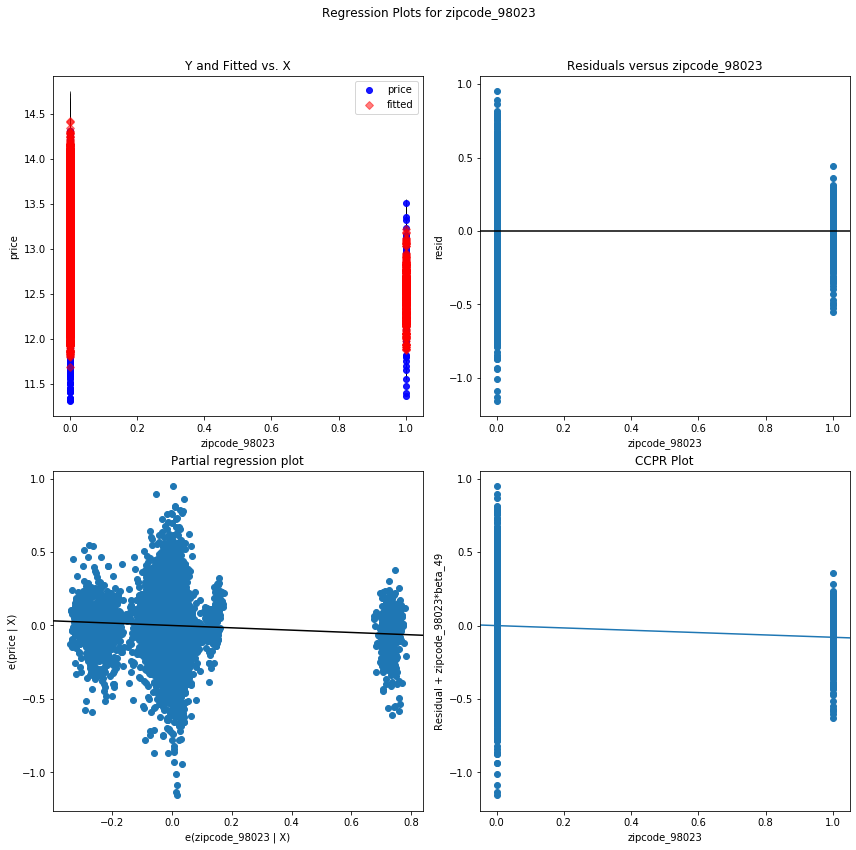

zipcode_98042 - Plotted


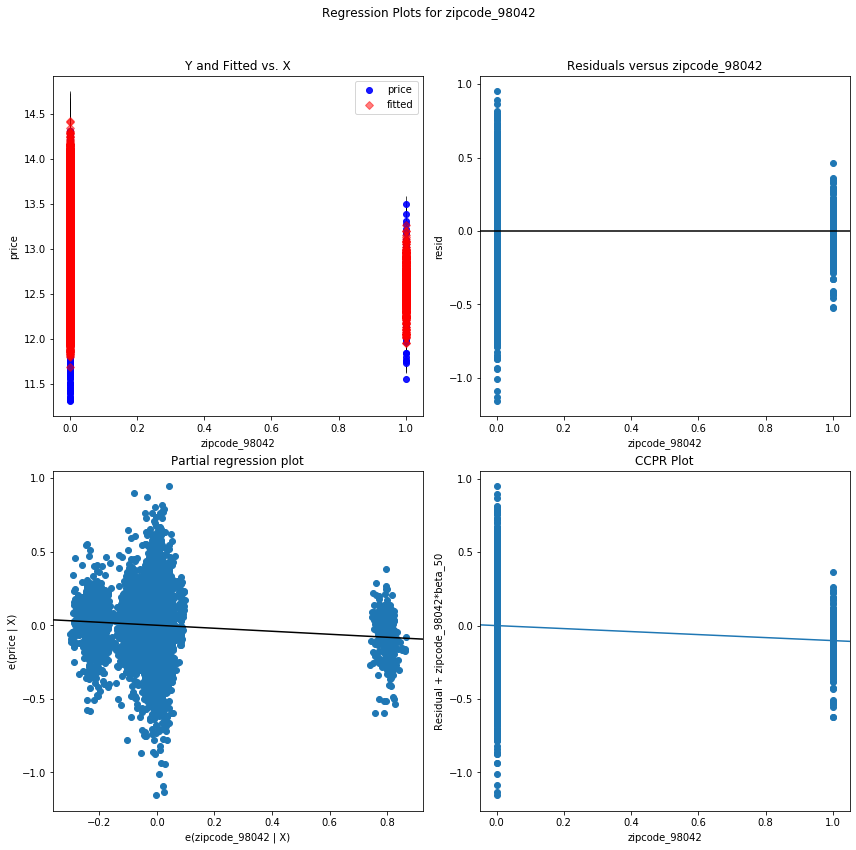

floors_3.0 - Plotted


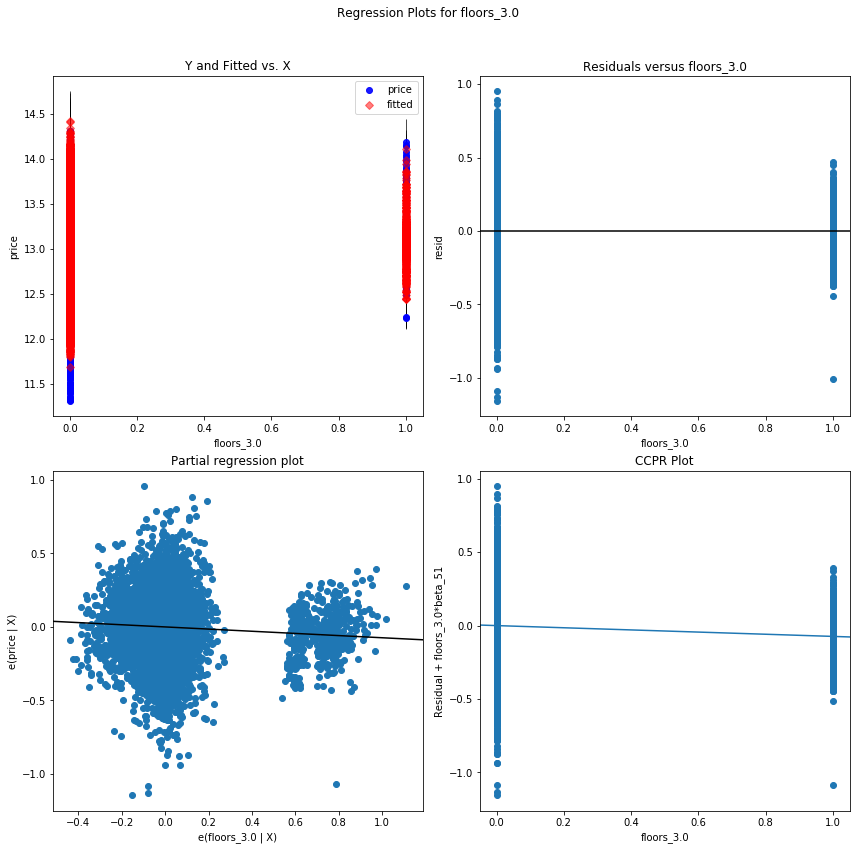

log-sqft_lot15 - Plotted


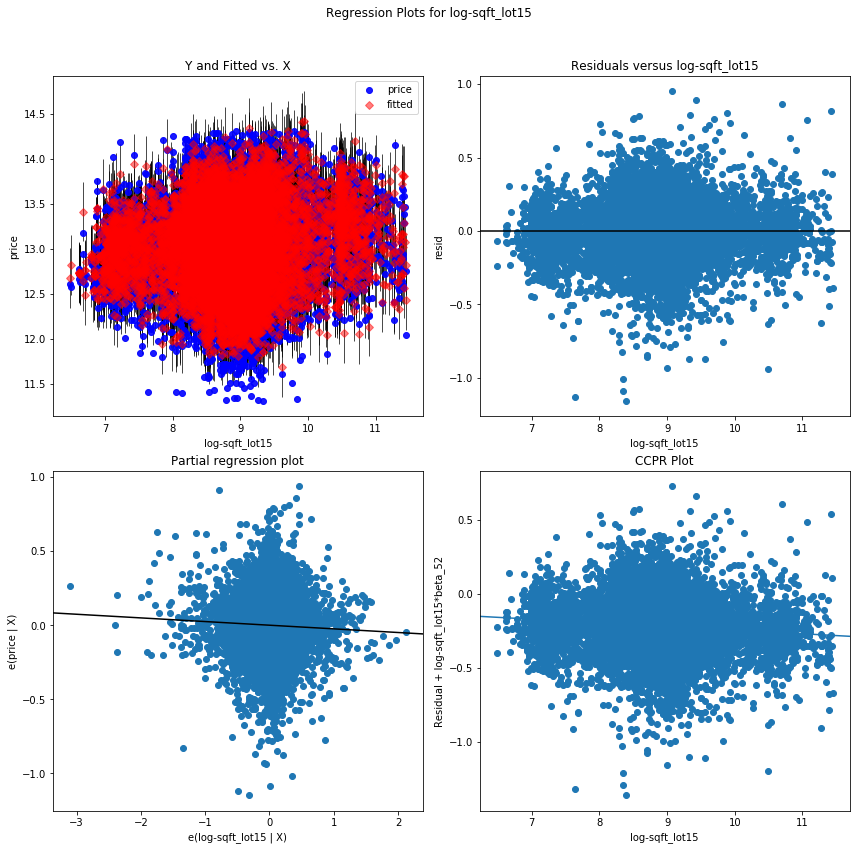

zipcode_98107 - Plotted


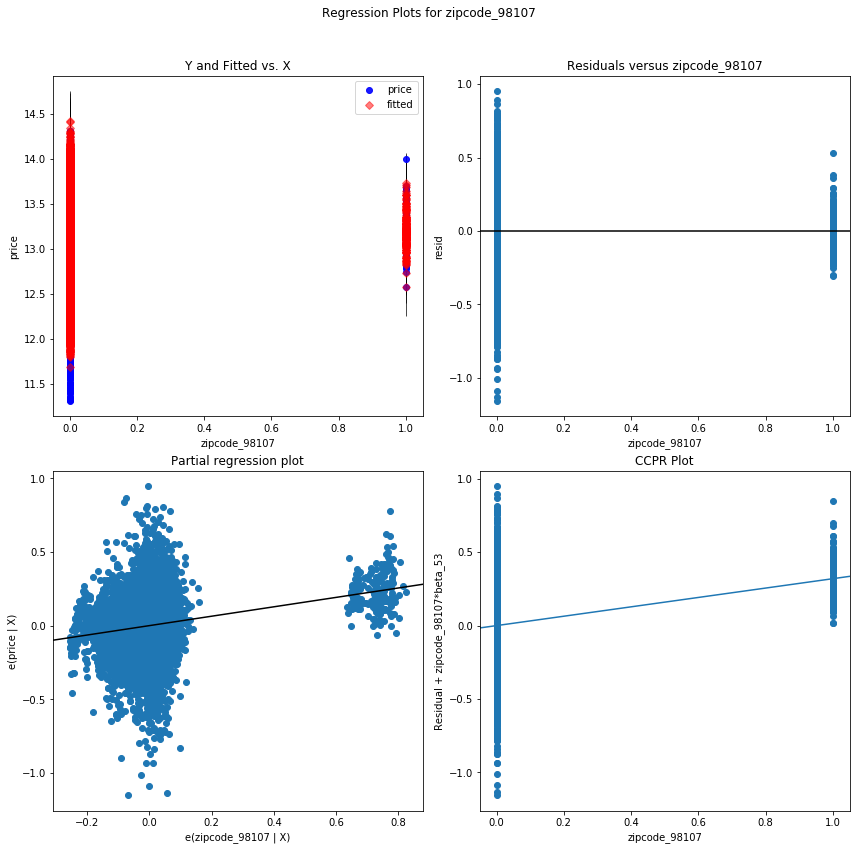

zipcode_98103 - Plotted


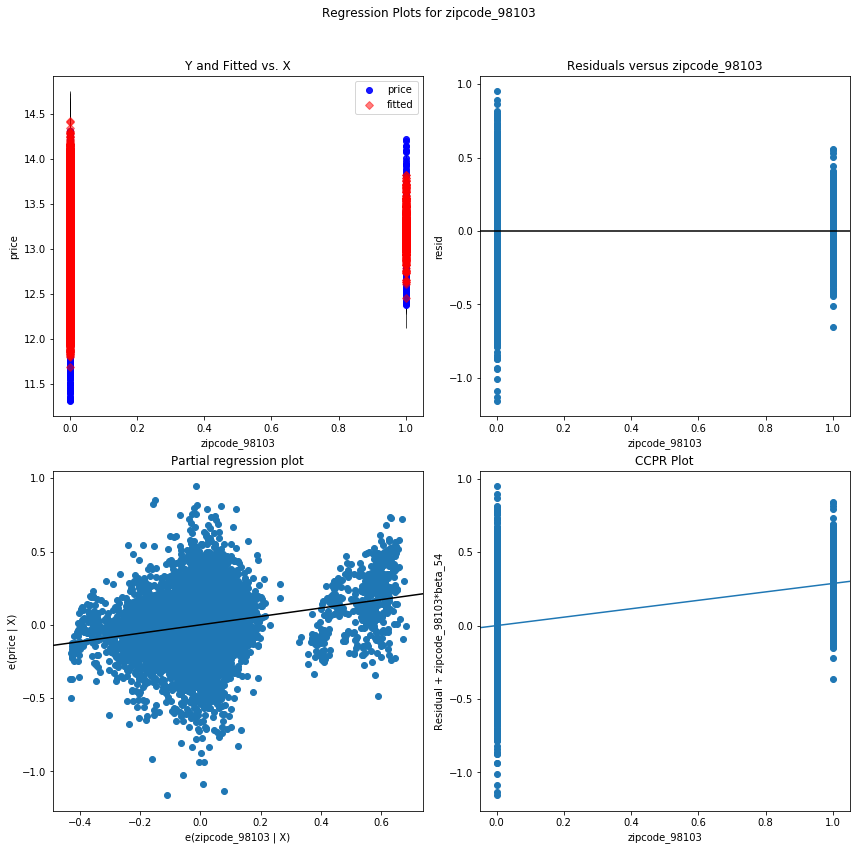

zipcode_98030 - Plotted


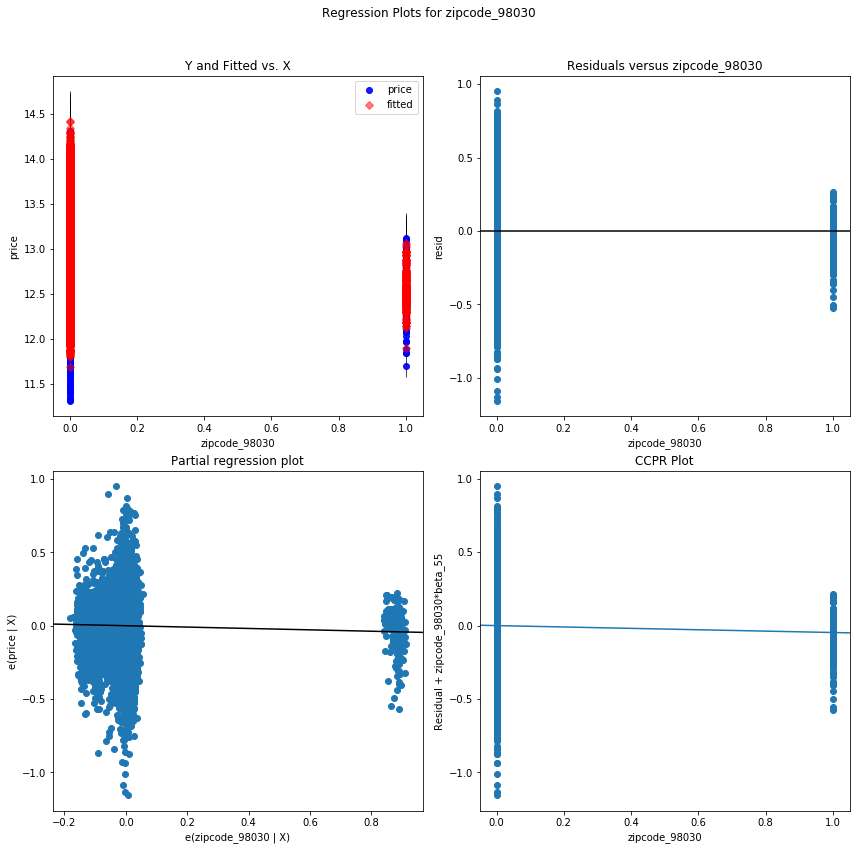

bedrooms_2.0 - Plotted


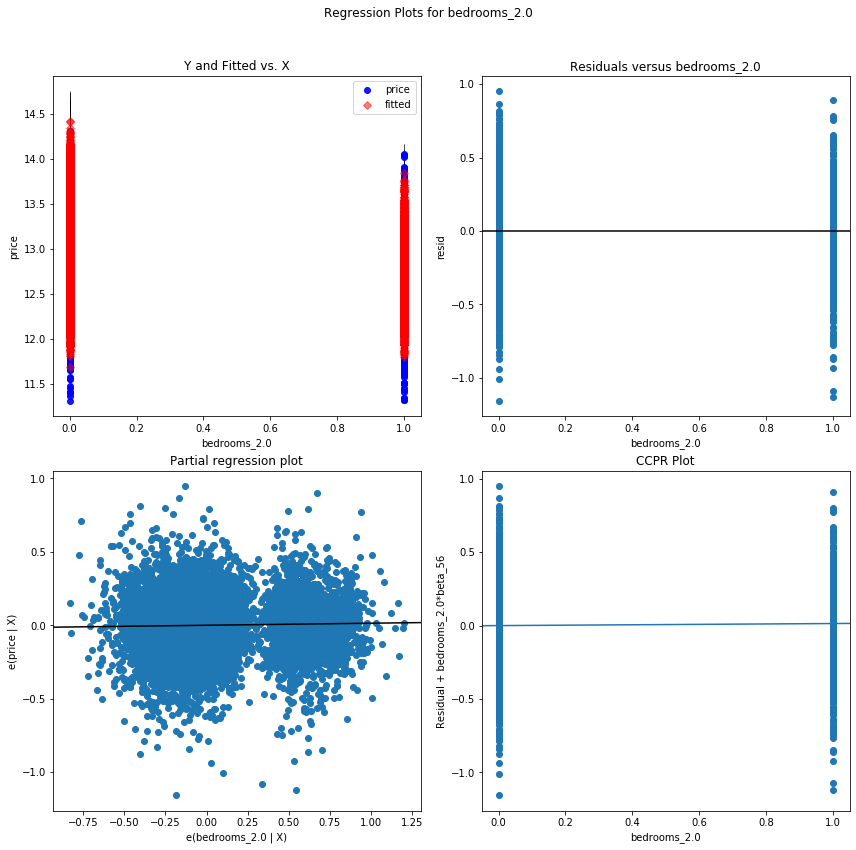

floors_1.5 - Plotted


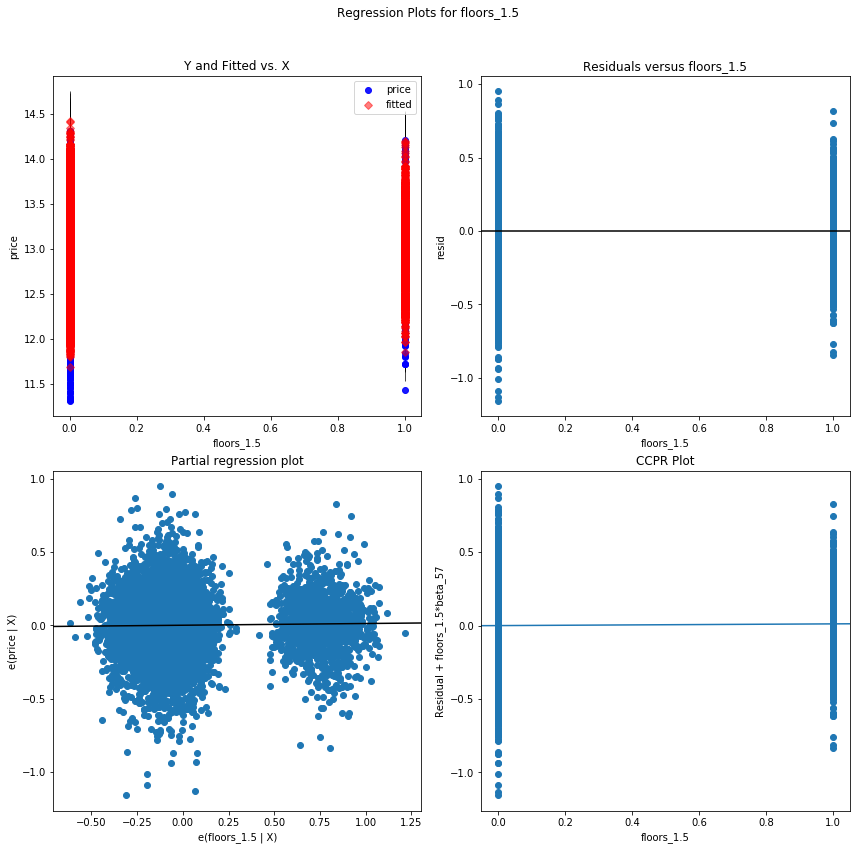

zipcode_98007 - Plotted


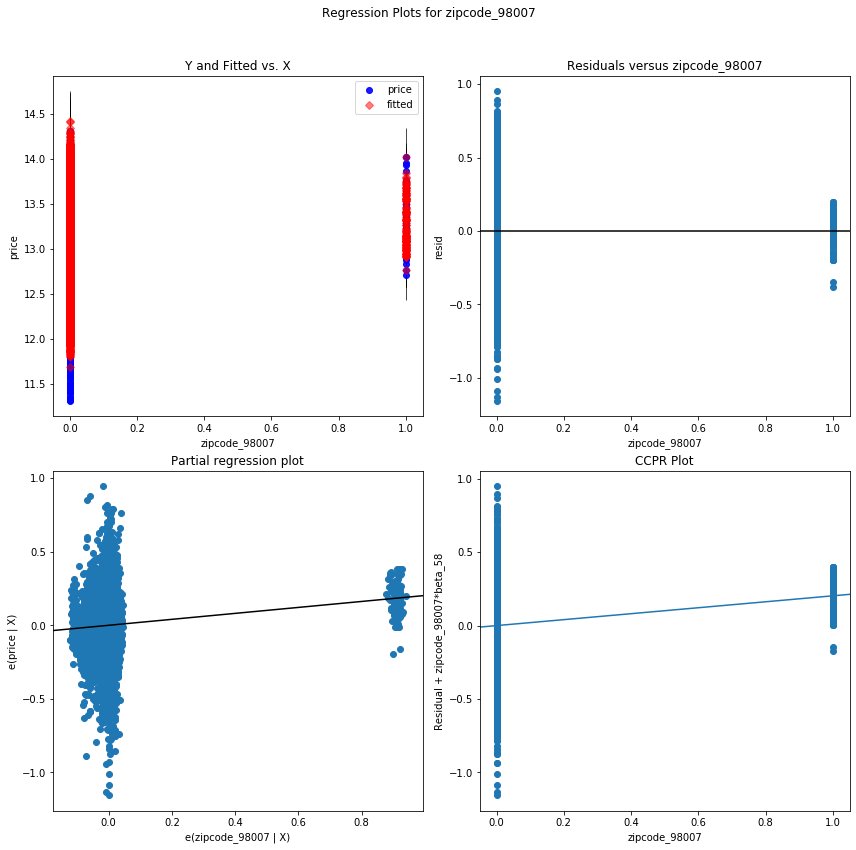

zipcode_98008 - Plotted


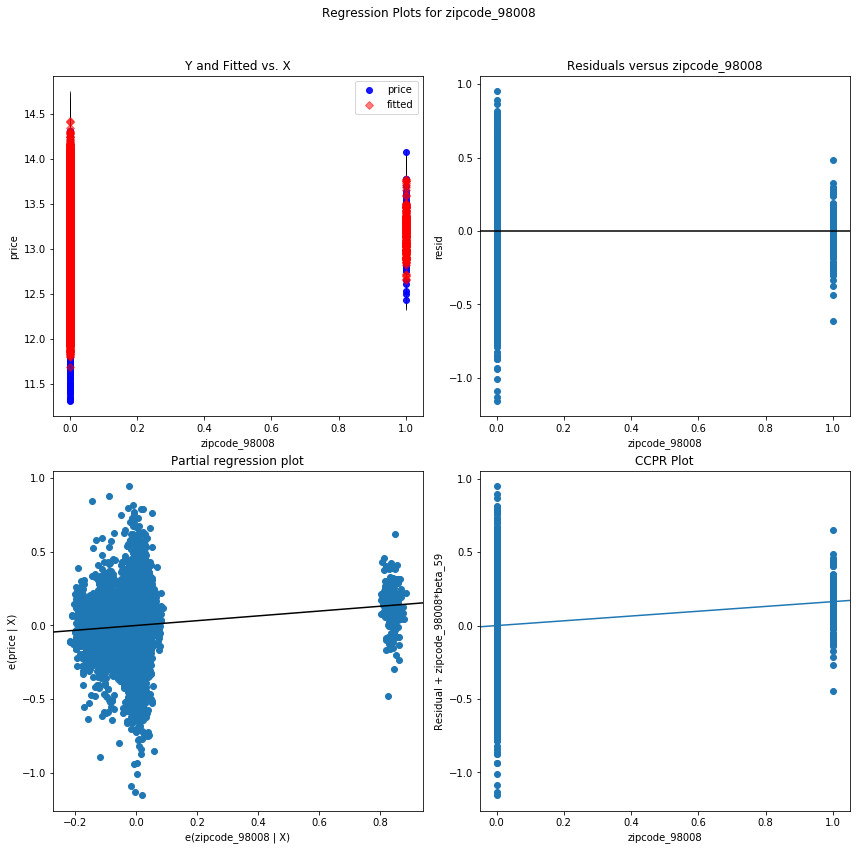

zipcode_98115 - Plotted


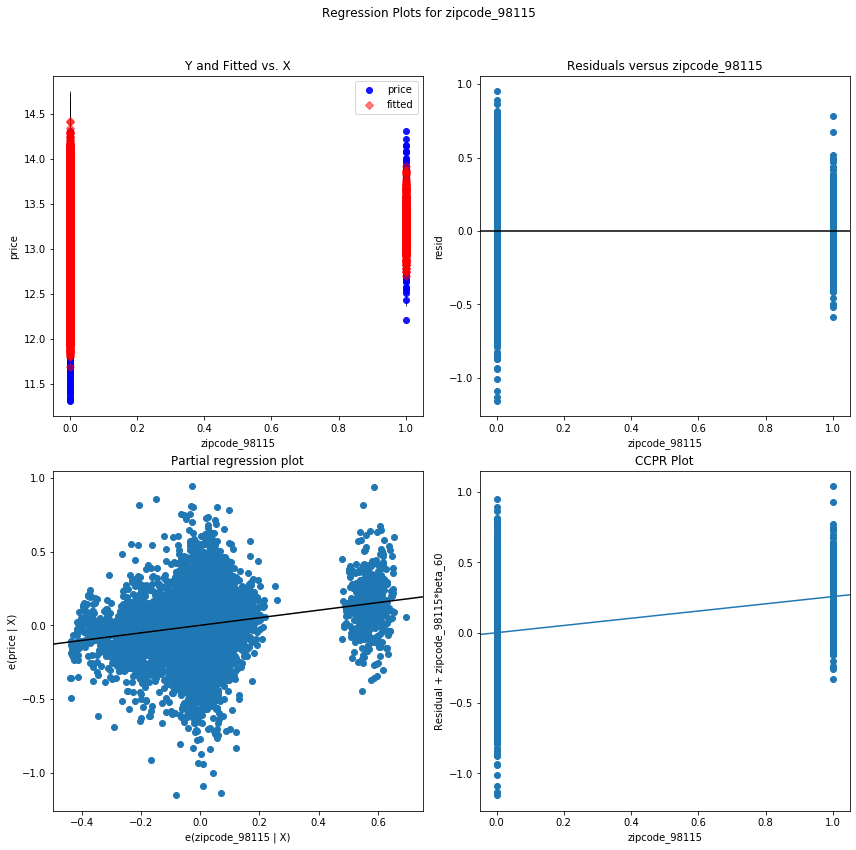

zipcode_98118 - Plotted


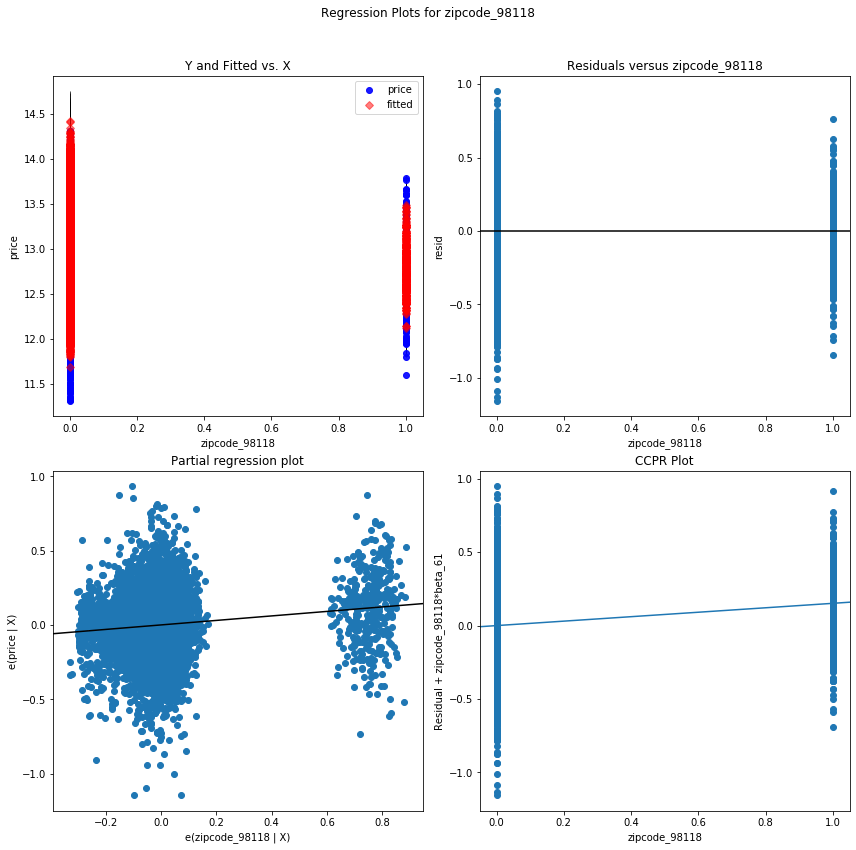

zipcode_98117 - Plotted


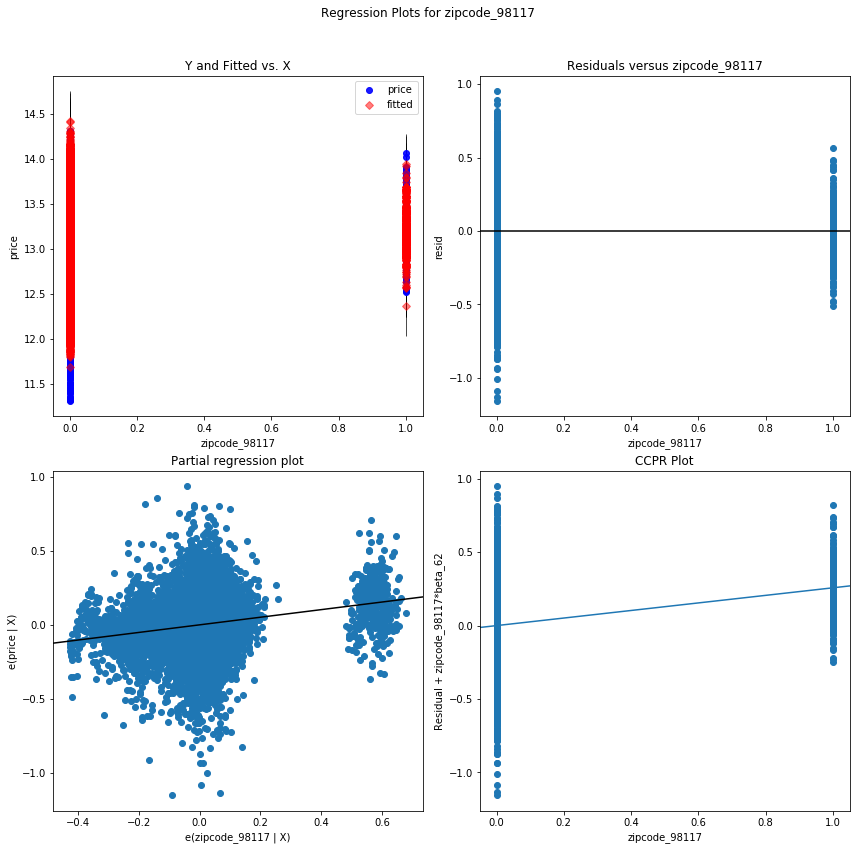

zipcode_98033 - Plotted


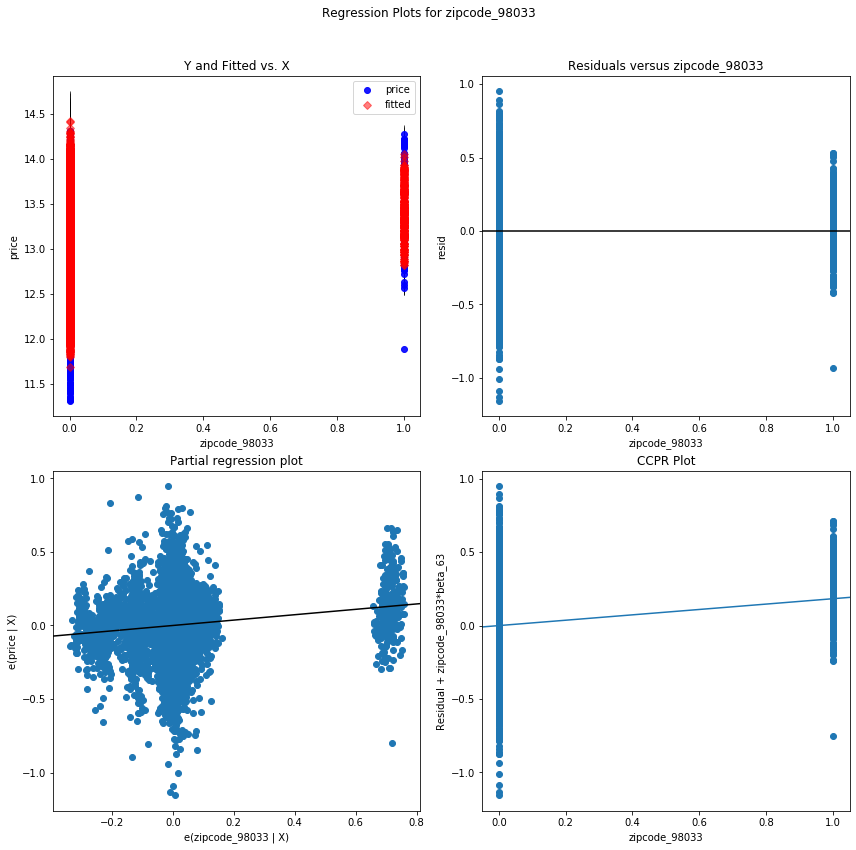

zipcode_98092 - Plotted


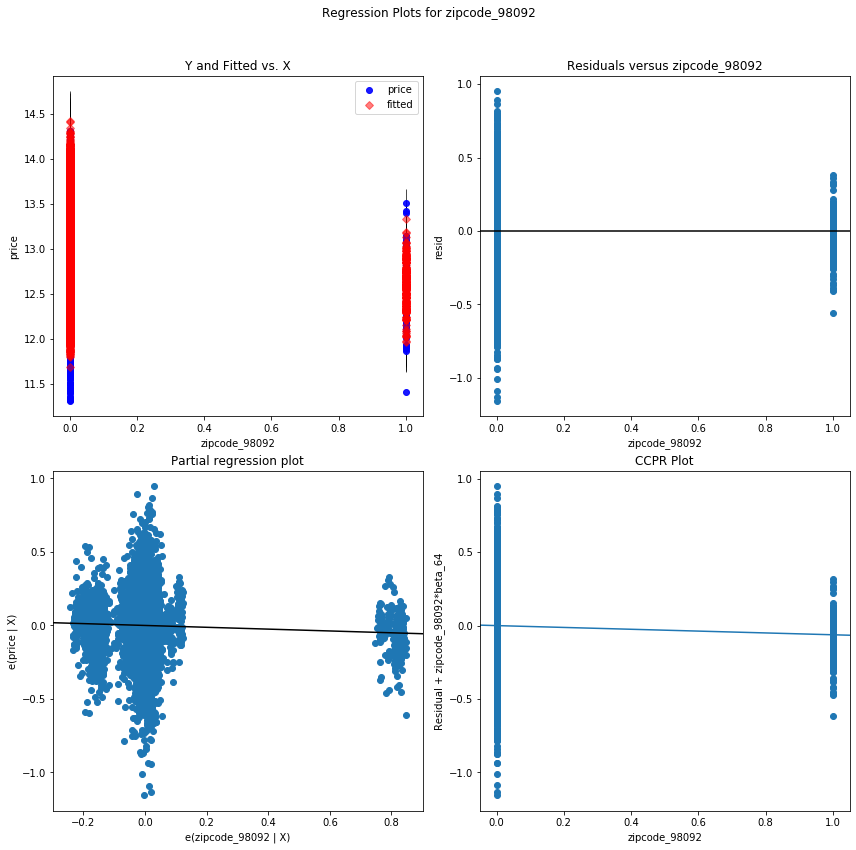

zipcode_98075 - Plotted


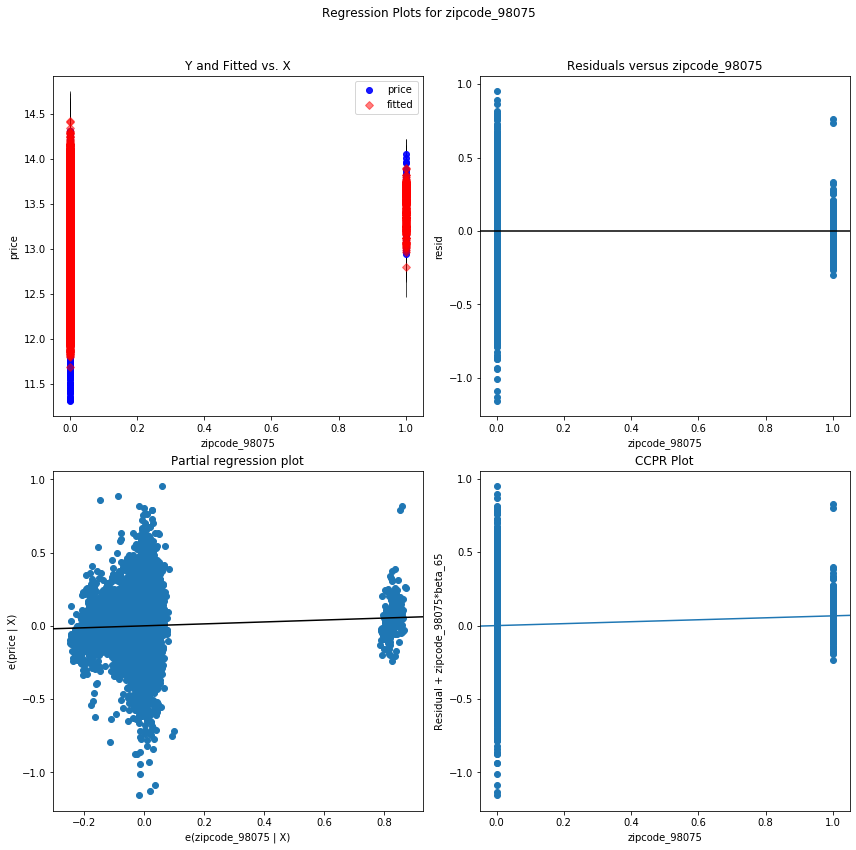

zipcode_98070 - Plotted


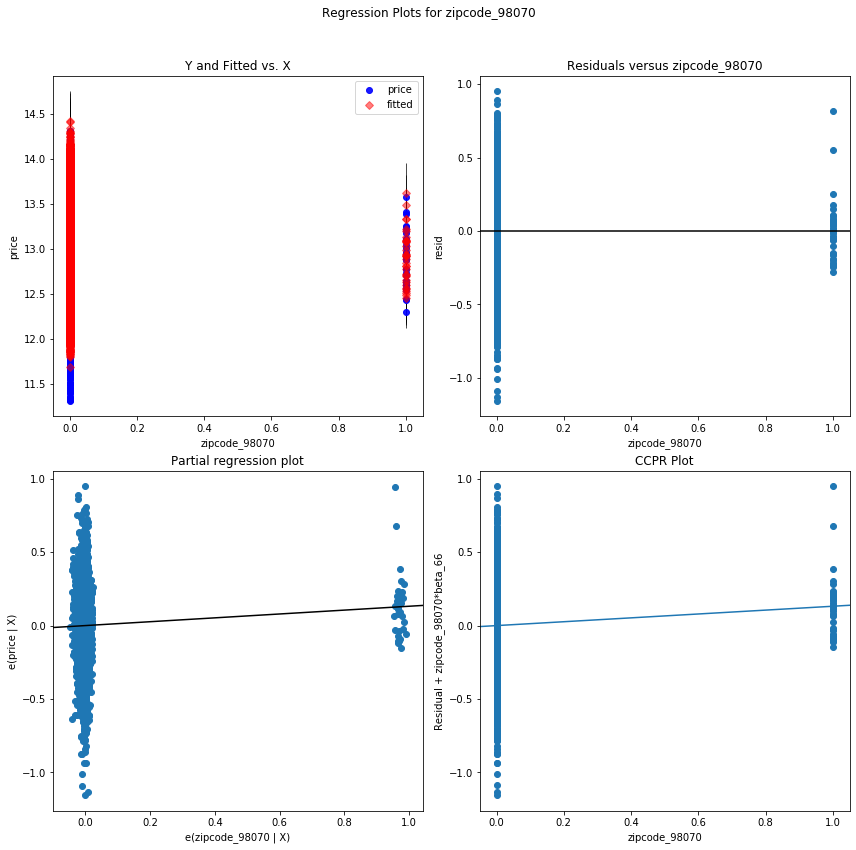

zipcode_98166 - Plotted


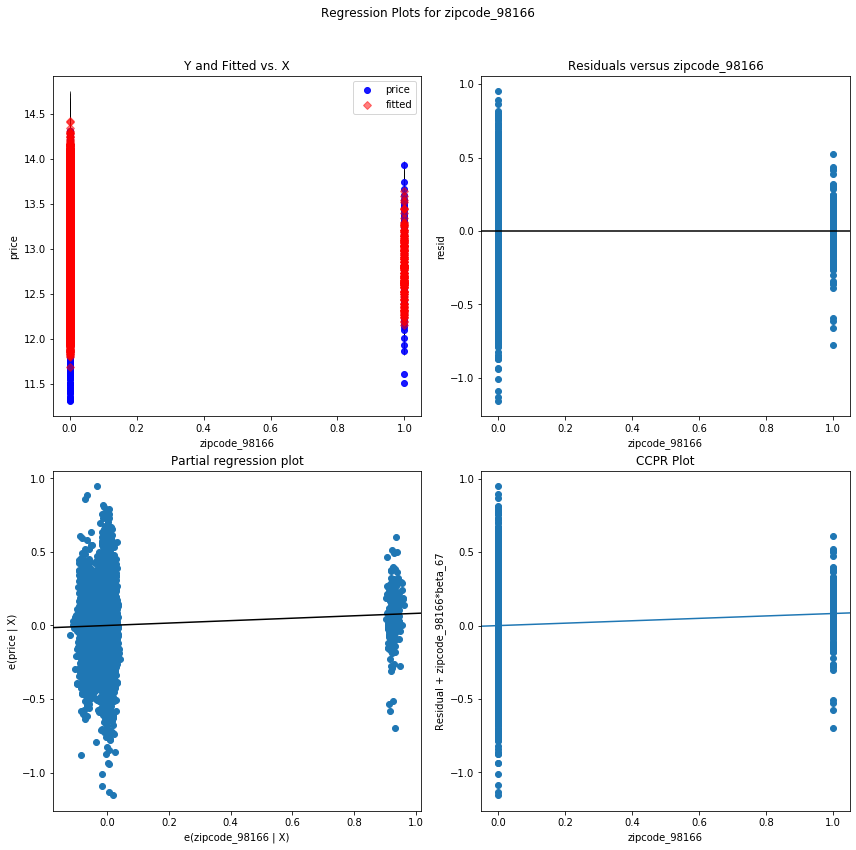

zipcode_98108 - Plotted


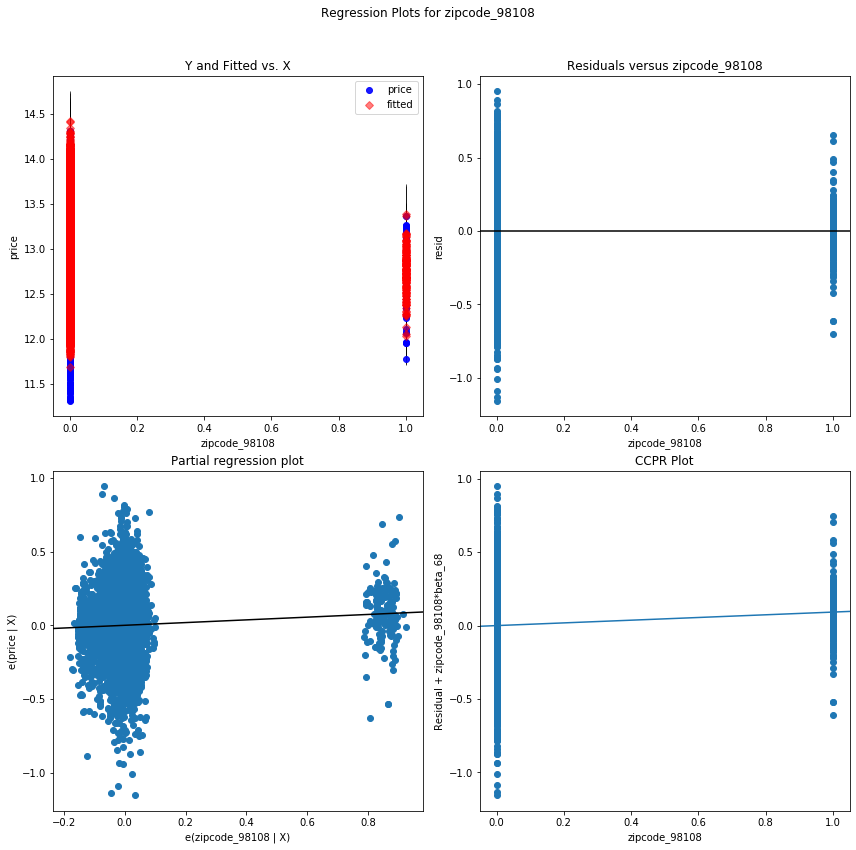

zipcode_98106 - Plotted


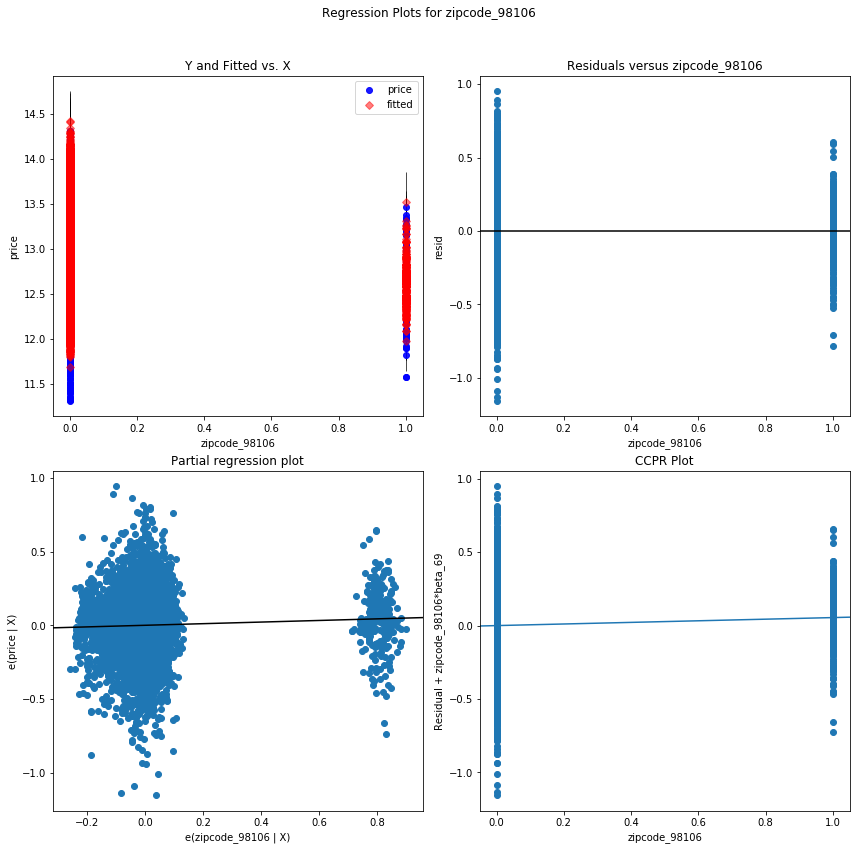

zipcode_98052 - Plotted


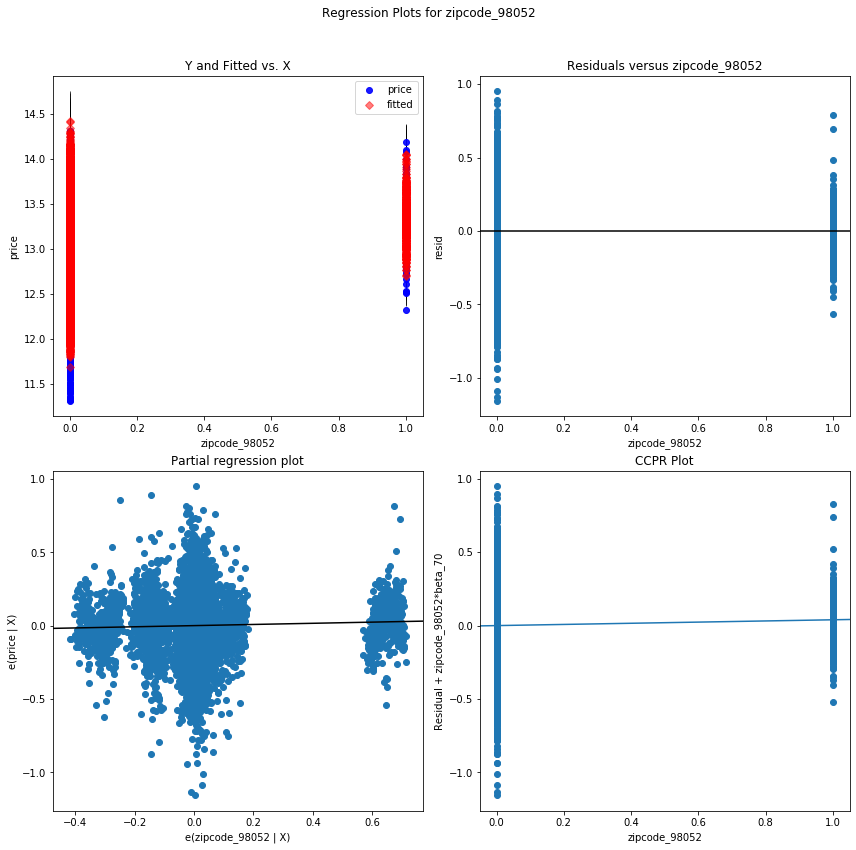

In [250]:
dfresult_logprice, df_coeff_logprice, summary_logprice, model_dict_logprice, X_train_model_logprice, X_test_model_logprice, y_train_model_logprice, y_test_model_logprice, column_model_logprice = run_model(b_pro_std_out_mul, np.log(target_pro_noout), 'multilinear_mul_noout-log-std-logprice', cv=10, feature_selection=True, plots=True )

In [300]:
summary_logprice

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.868
Model:                            OLS   Adj. R-squared:                  0.867
Method:                 Least Squares   F-statistic:                     1402.
Date:                Thu, 25 Jun 2020   Prob (F-statistic):               0.00
Time:                        17:12:05   Log-Likelihood:                 5539.0
No. Observations:               15034   AIC:                        -1.094e+04
Df Residuals:                   14963   BIC:                        -1.040e+04
Df Model:                          70                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
grade                 0.0934      0.002     41.294      0.000       0.089       0.098
lat                   0.1761      0.004     46.541      0.000       0.169       0.184
log-sqft_living       0.4004      0.008     52.611      0.000       0.385       0.415
log-MHI               0.1647      0.006     26.052      0.000       0.152       0.177
waterfront            6.5638      0.089     74.032      0.000       6.390       6.738
zipcode_98004         0.5418      0.014     39.058      0.000       0.515       0.569
zipcode_98019        -0.3745      0.017    -22.123      0.000      -0.408      -0.341
zipcode_98028        -0.2465      0.014    -17.613      0.000      -0.274      -0.219
zipcode_98155        -0.2017      0.013    -15.830      0.000      -0.227      -0.177
zipcode_98133        -0.1095      0.012     -8.992      0.000      -0.133      -0.086
condition             0.0316      0.001     21.181      0.000       0.029       0.034
zipcode_98040         0.4041      0.015     27.611      0.000       0.375       0.433
zipcode_98034        -0.0898      0.011     -8.021      0.000      -0.112      -0.068
zipcode_98072        -0.1972      0.015    -13.445      0.000      -0.226      -0.168
zipcode_98011        -0.1967      0.017    -11.914      0.000      -0.229      -0.164
zipcode_98077        -0.2559      0.017    -14.747      0.000      -0.290      -0.222
view_2.0              0.0980      0.007     13.292      0.000       0.084       0.112
zipcode_98177        -0.0521      0.015     -3.431      0.001      -0.082      -0.022
log-sqft_living15     0.1376      0.008     17.614      0.000       0.122       0.153
zipcode_98022         0.1380      0.017      8.288      0.000       0.105       0.171
zipcode_98125         0.0179      0.013      1.426      0.154      -0.007       0.042
zipcode_98178        -0.1236      0.013     -9.476      0.000      -0.149      -0.098
zipcode_98168        -0.1363      0.012    -10.968      0.000      -0.161      -0.112
zipcode_98014        -0.1932      0.024     -8.196      0.000      -0.239      -0.147
zipcode_98058        -0.0856      0.010     -8.942      0.000      -0.104      -0.067
zipcode_98112         0.4520      0.016     28.202      0.000       0.421       0.483
log-sqft_basement    -0.0069      0.001    -13.109      0.000      -0.008      -0.006
zipcode_98010         0.0973      0.023      4.222      0.000       0.052       0.142
zipcode_98055        -0.0652      0.012     -5.280      0.000      -0.089      -0.041
log-sqft_lot          0.0678      0.005     14.621      0.000       0.059       0.077
zipcode_98122         0.3704      0.013     28.094      0.000       0.345       0.396
zipcode_98102         0.4658      0.021     22.207      0.000       0.425       0.507
zipcode_98119         0.4435      0.017     26.577      0.000       0.411

Re-running, removing floors_1.5 and zipcode_98125 since not significant (p-value > 0.05):

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


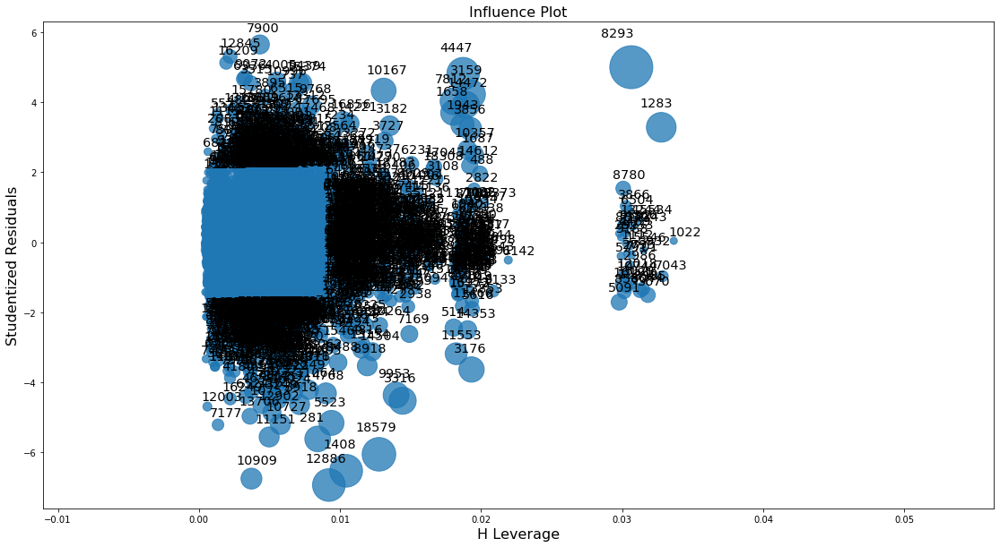

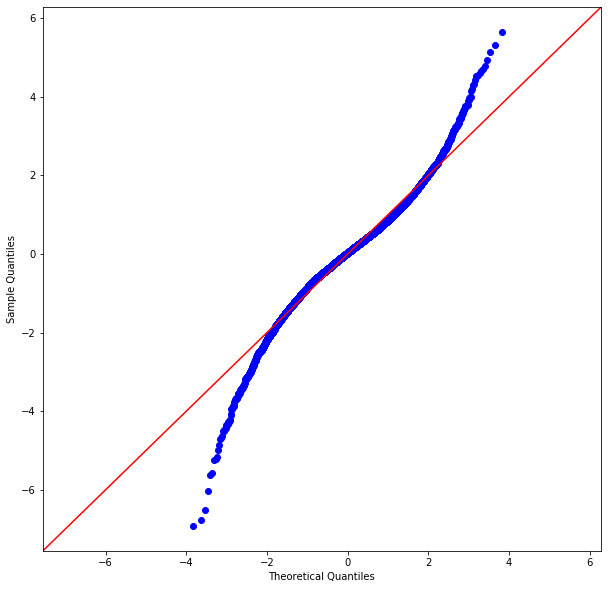

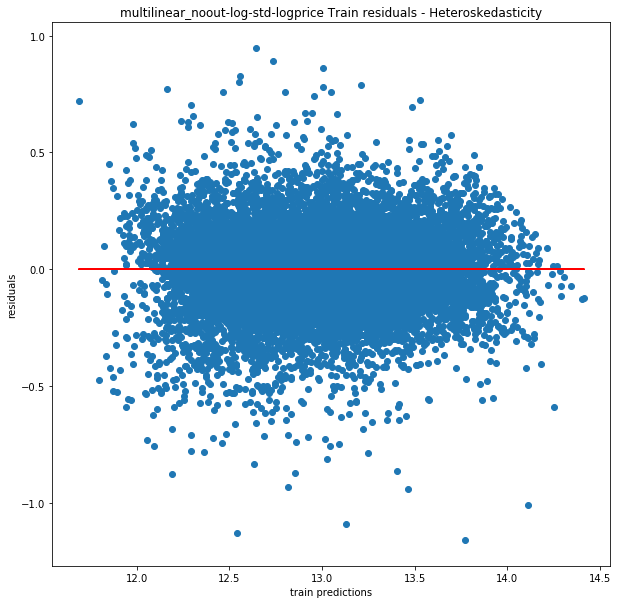

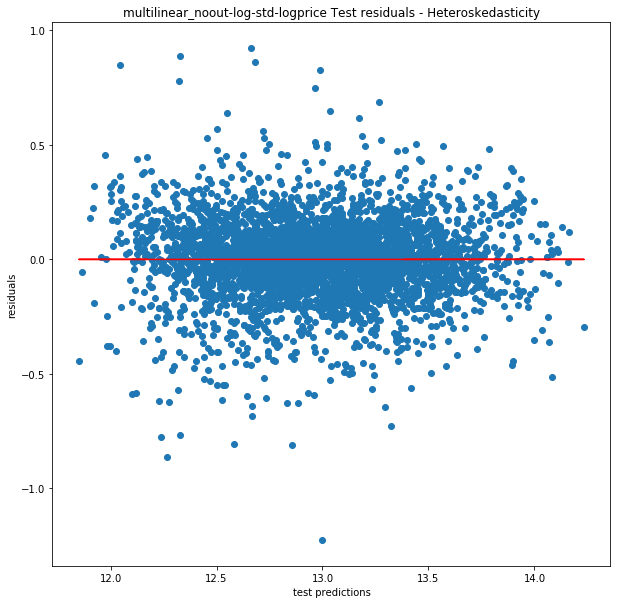

grade - Plotted


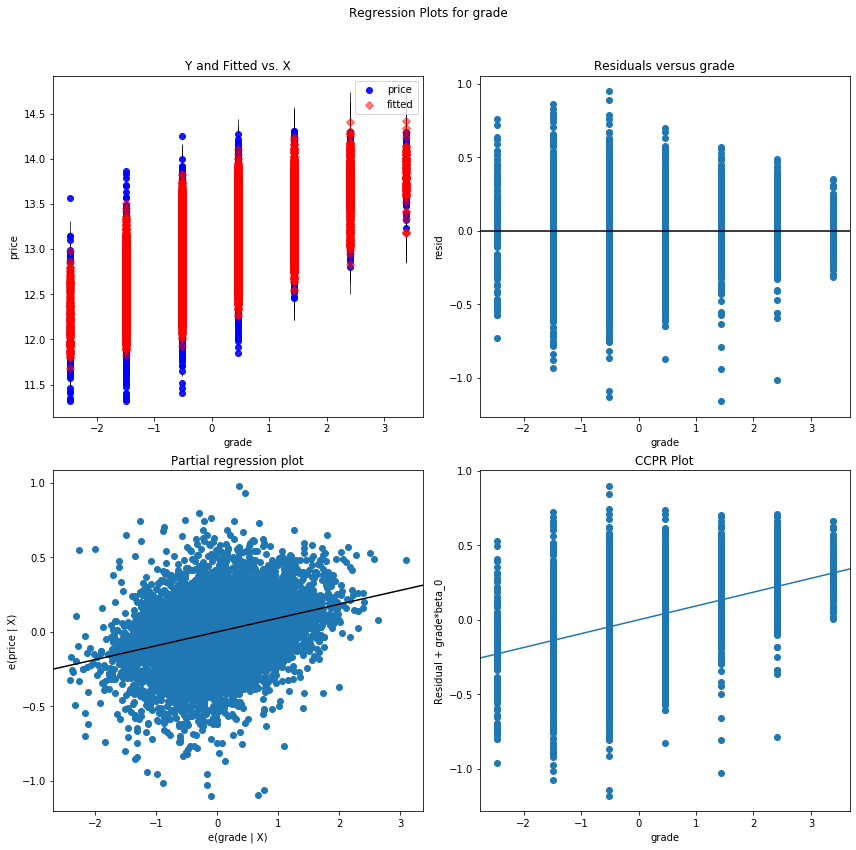

lat - Plotted


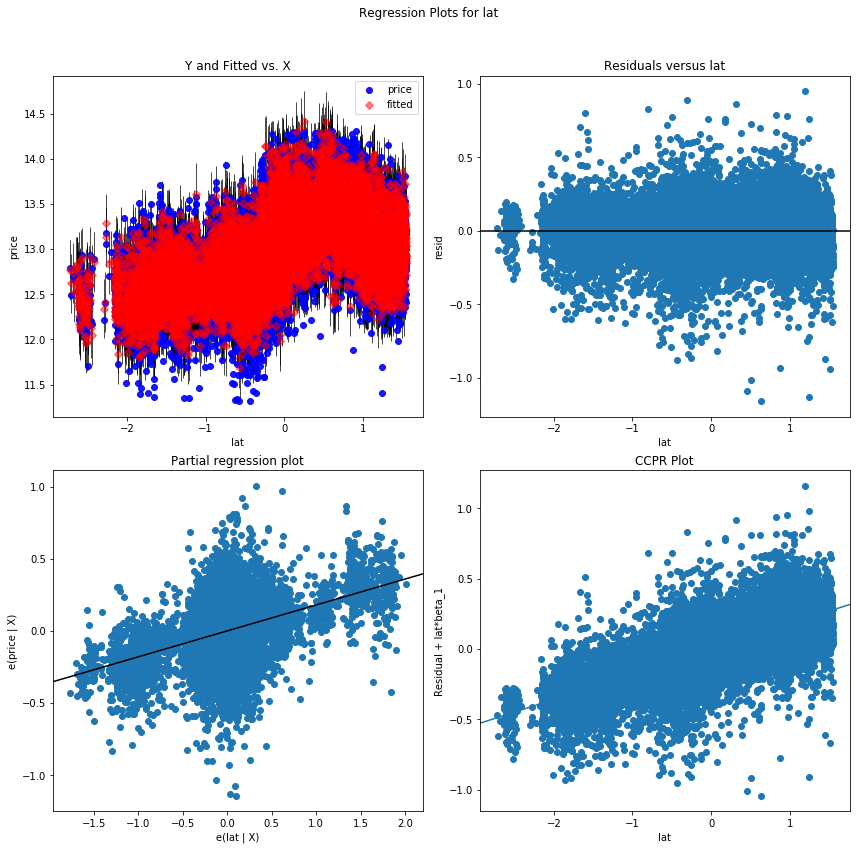

log-sqft_living - Plotted


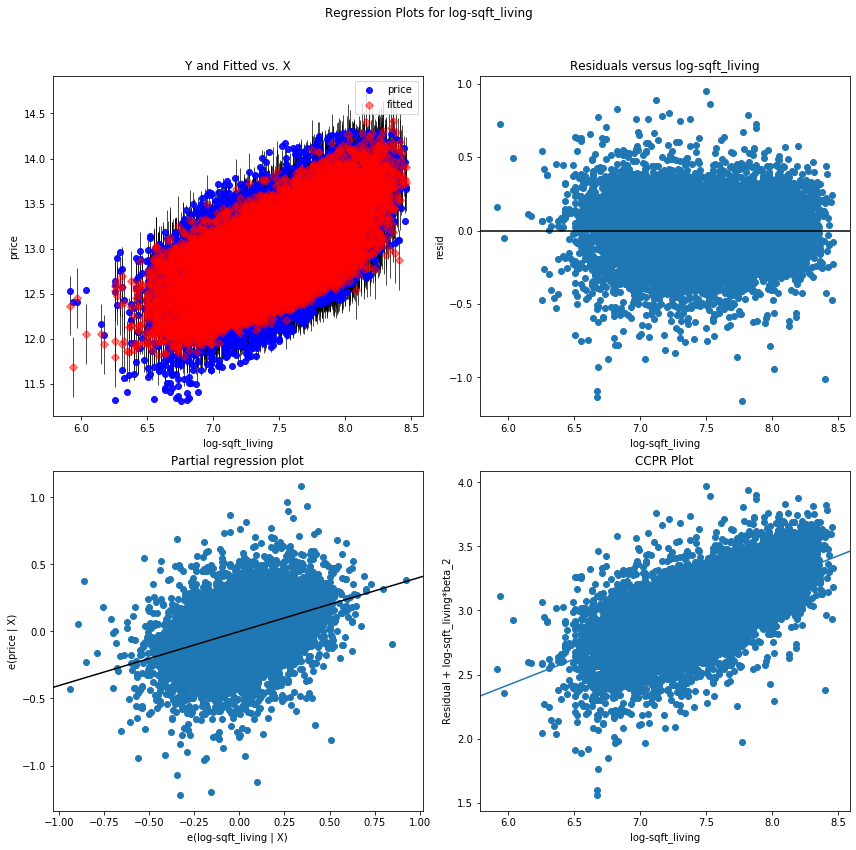

log-MHI - Plotted


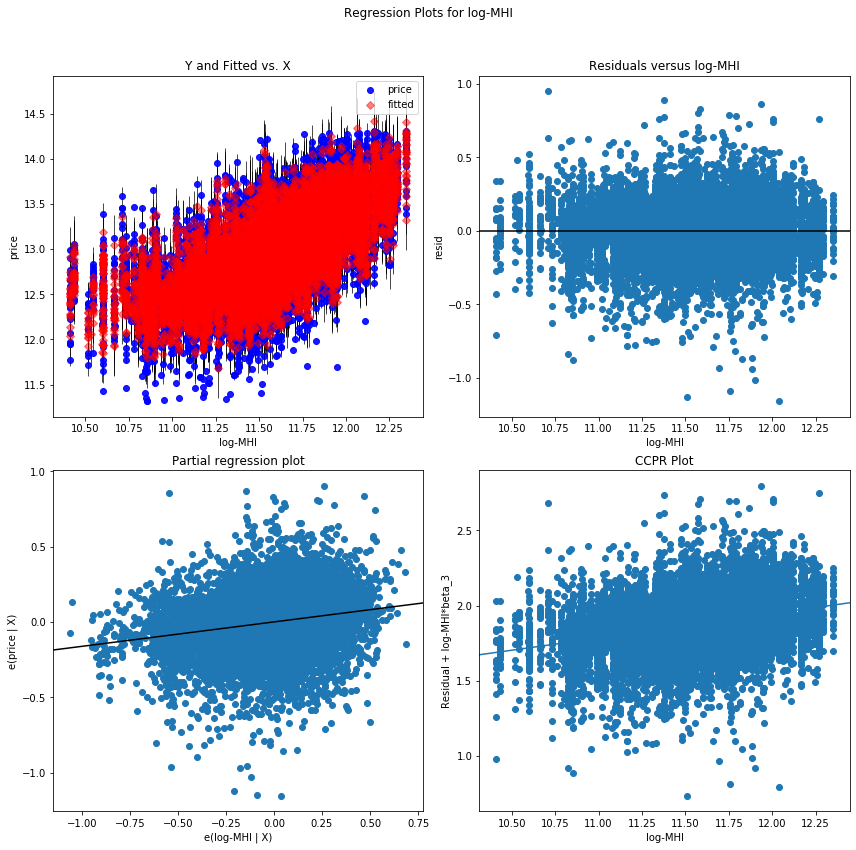

waterfront - Plotted


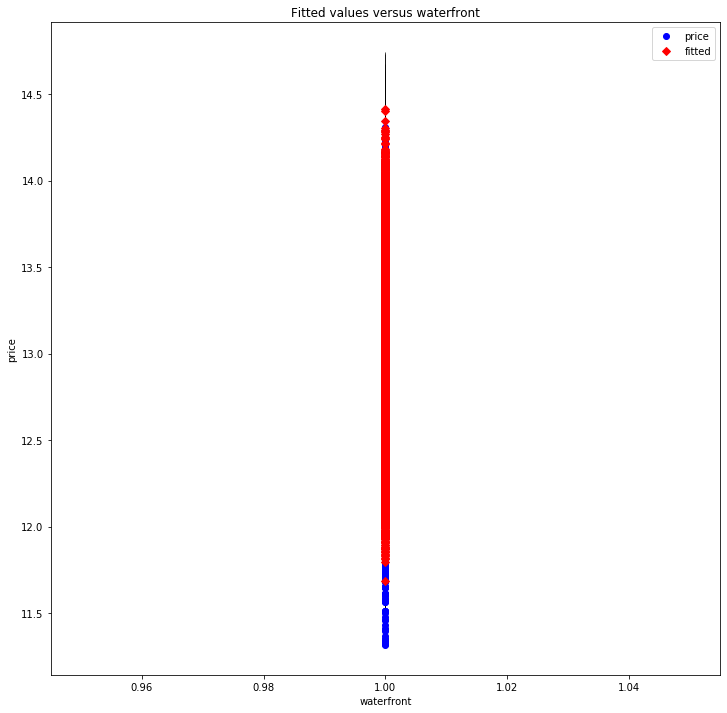

zipcode_98004 - Plotted


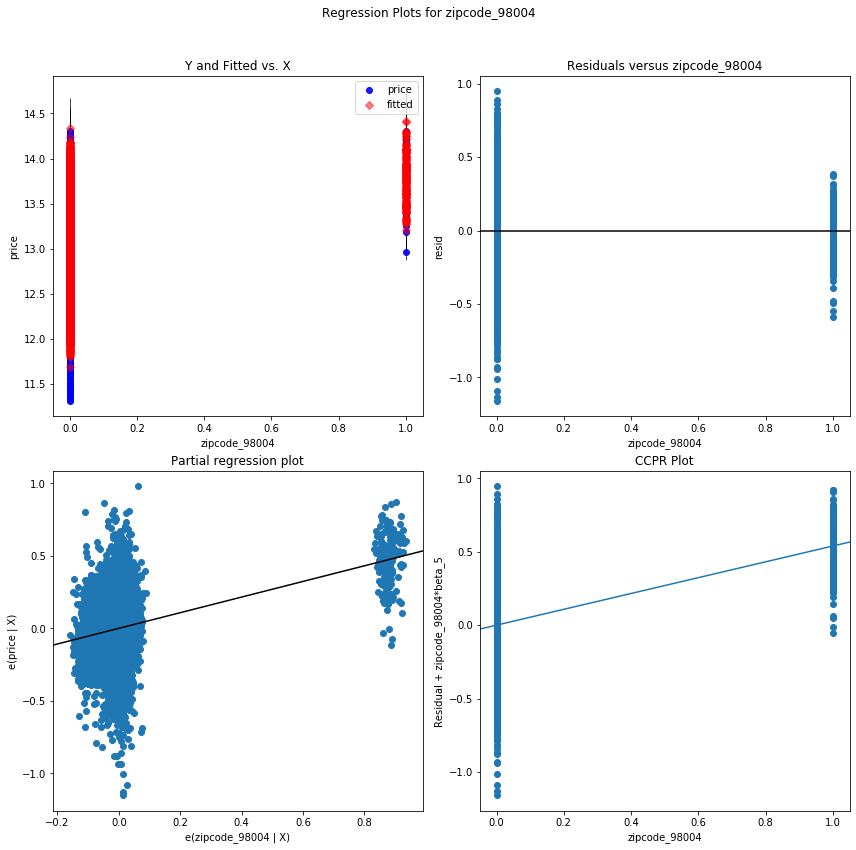

zipcode_98019 - Plotted


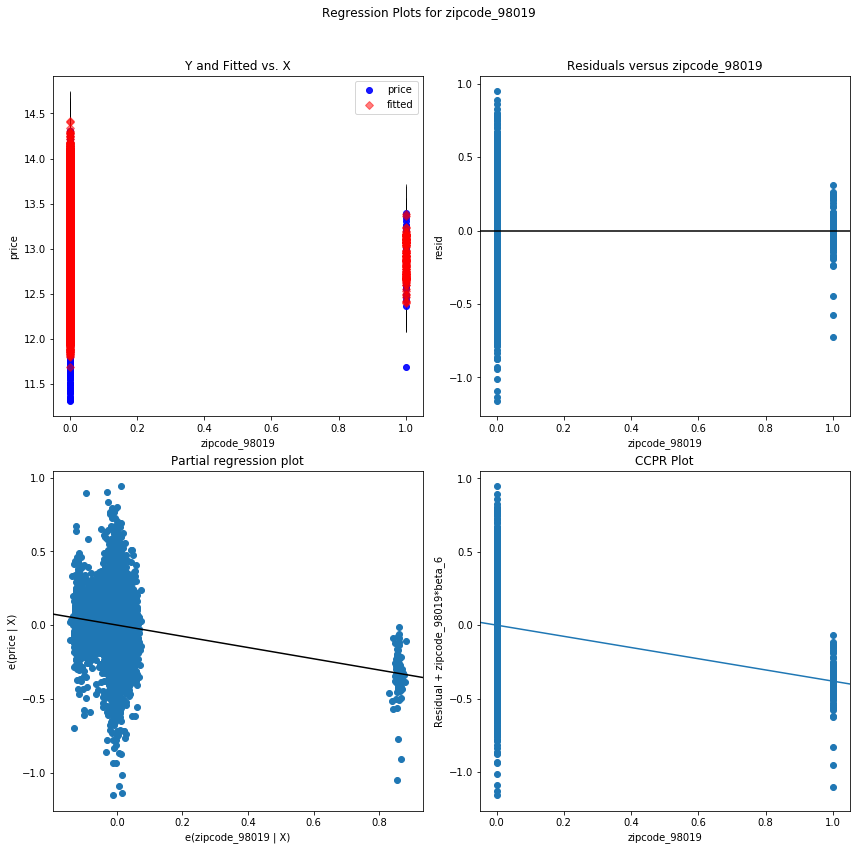

zipcode_98028 - Plotted


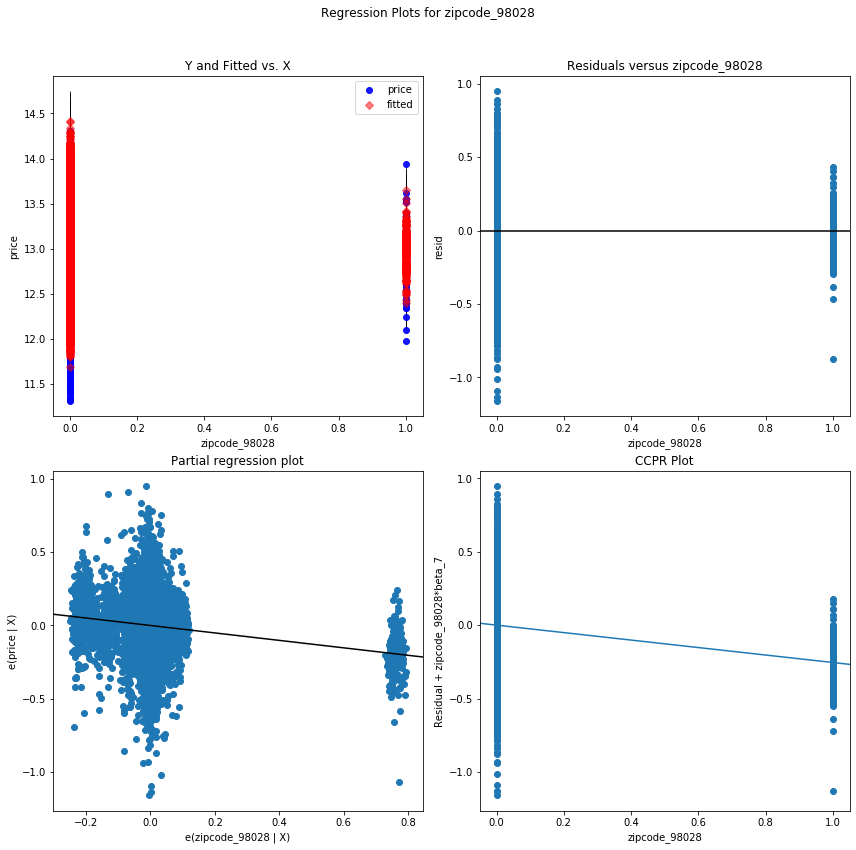

zipcode_98155 - Plotted


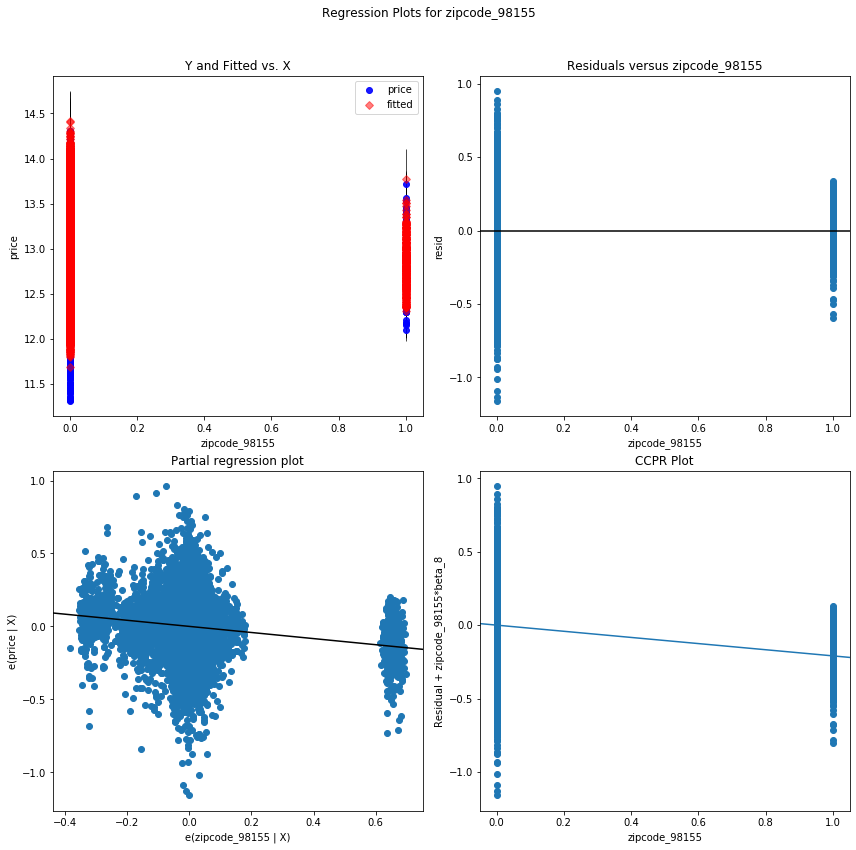

zipcode_98133 - Plotted


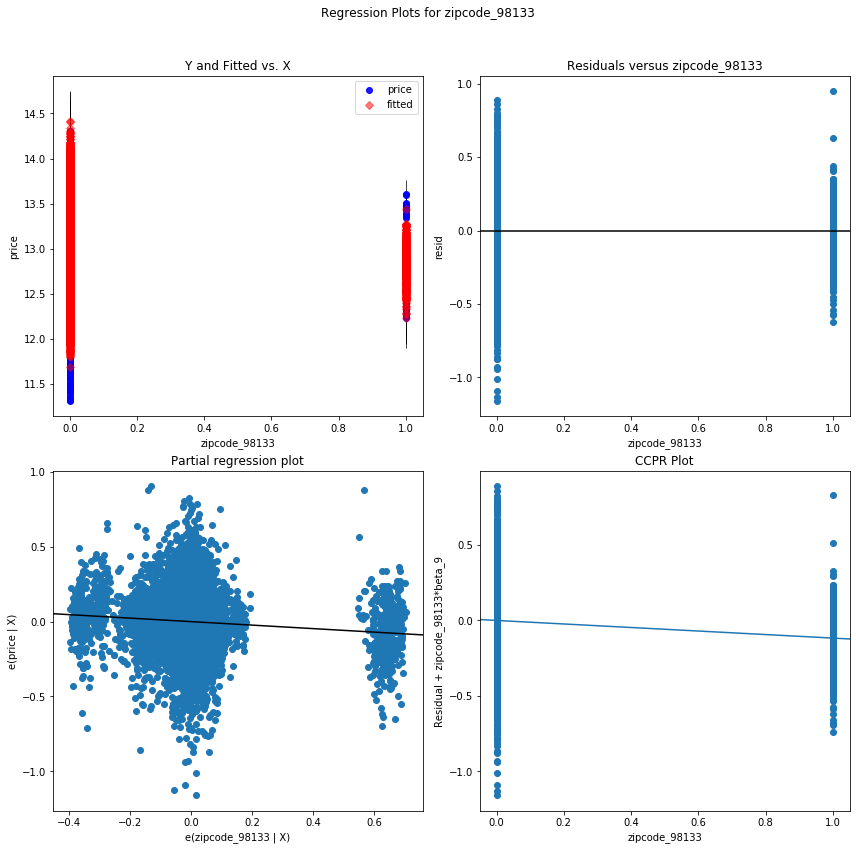

condition - Plotted


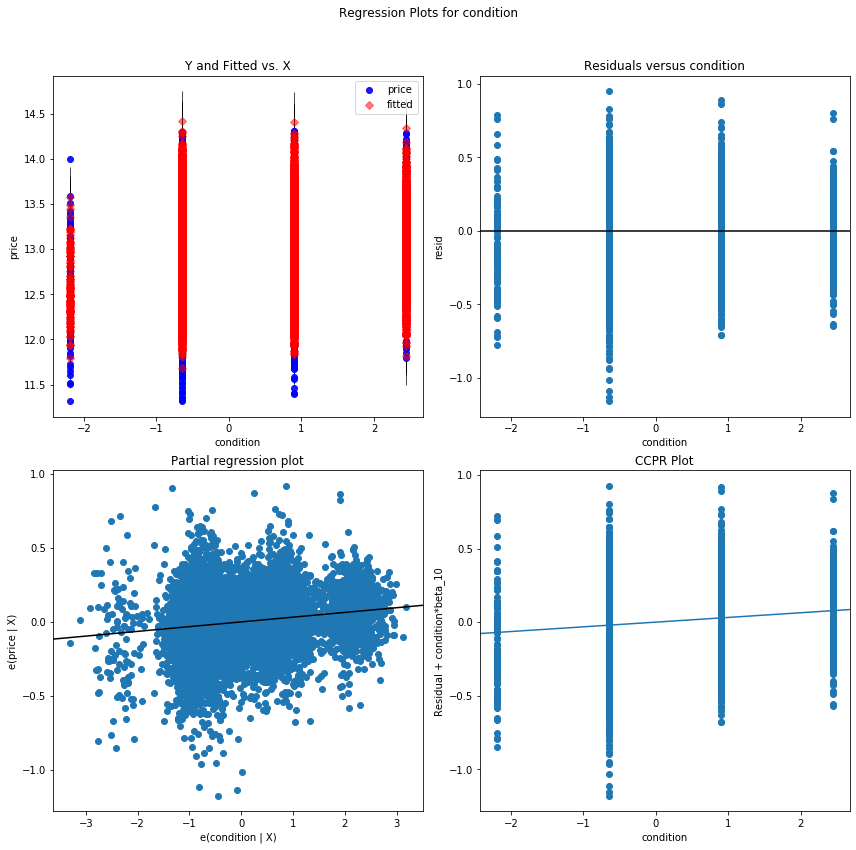

zipcode_98040 - Plotted


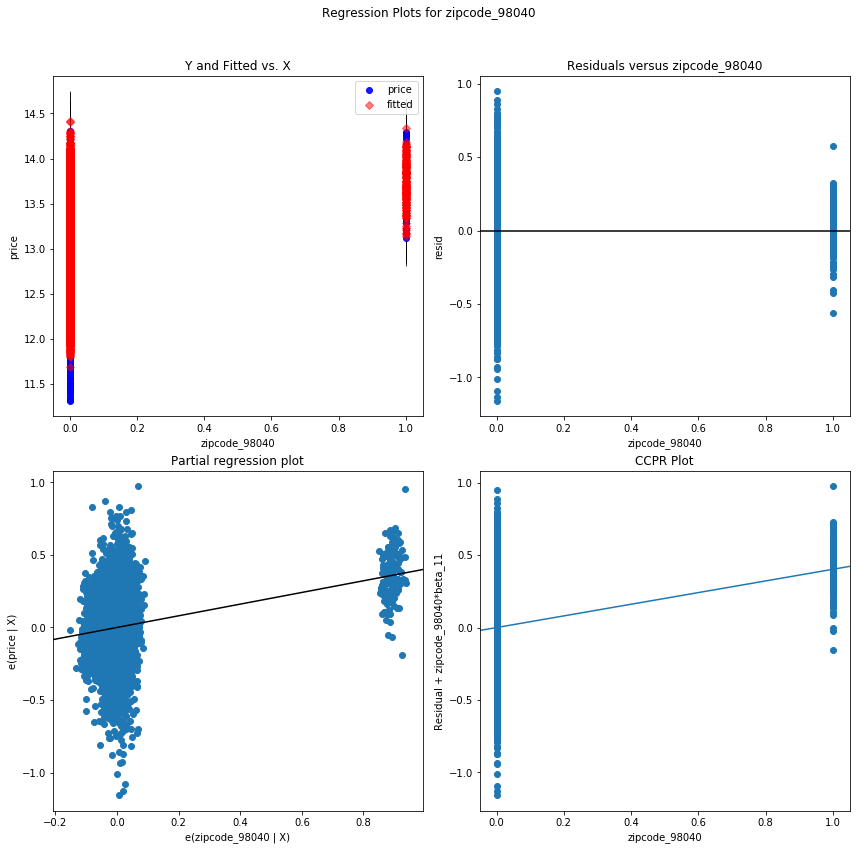

zipcode_98034 - Plotted


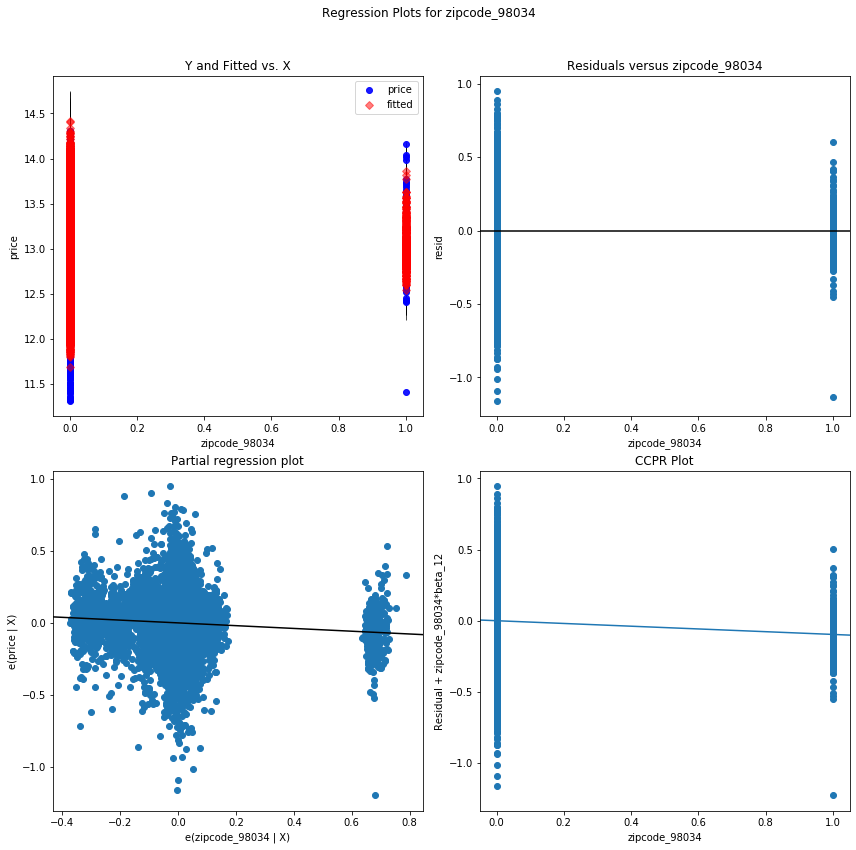

zipcode_98072 - Plotted


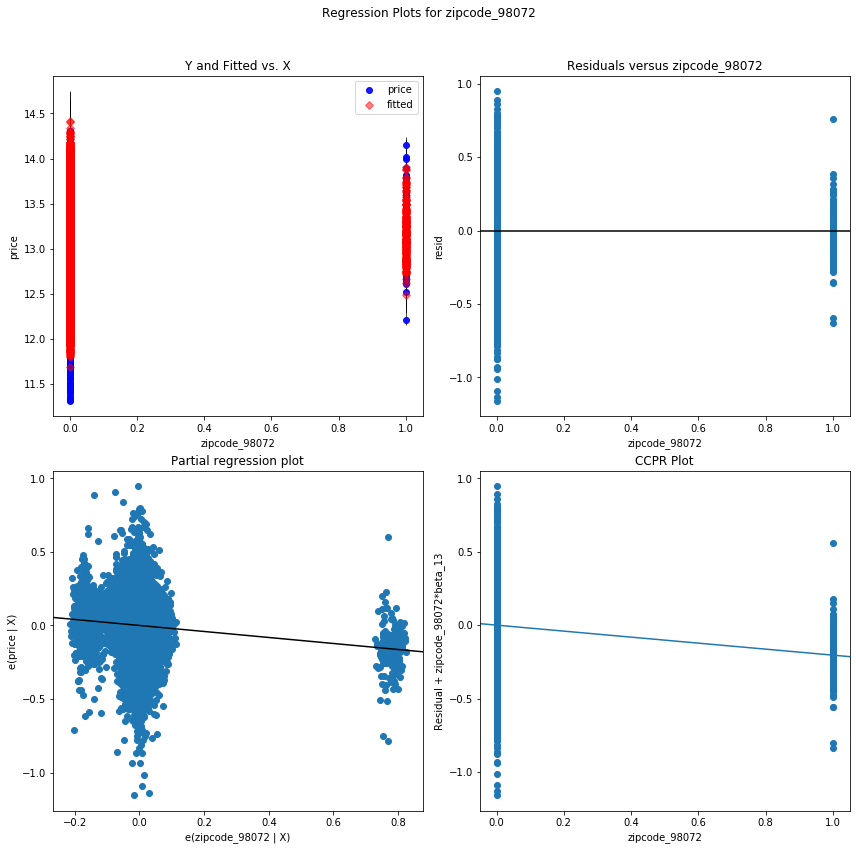

zipcode_98011 - Plotted


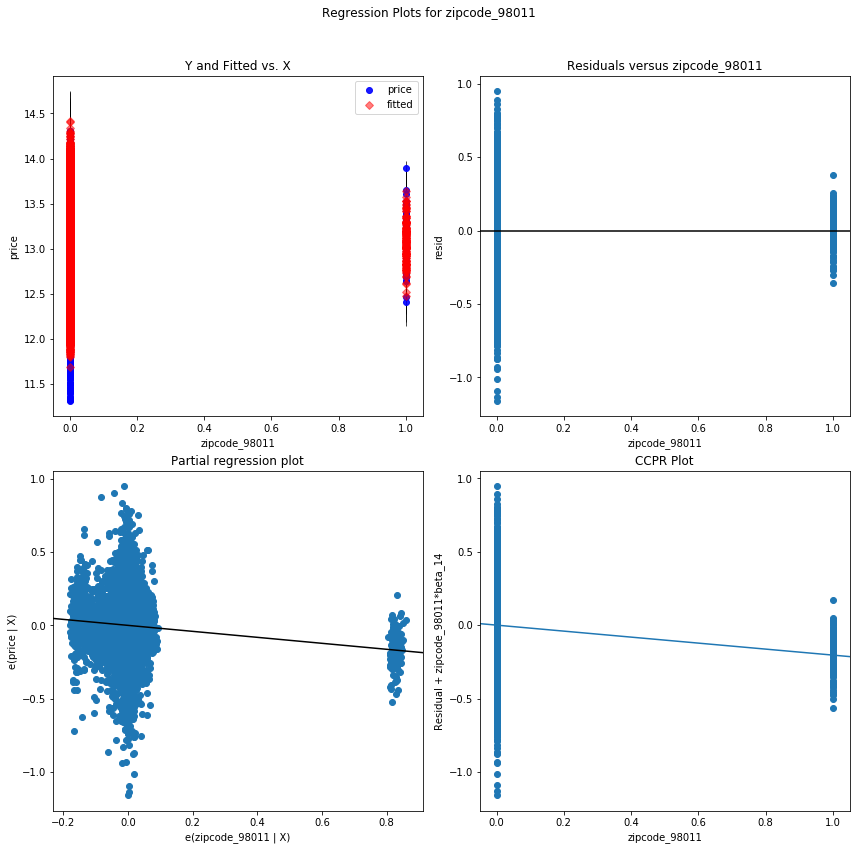

zipcode_98077 - Plotted


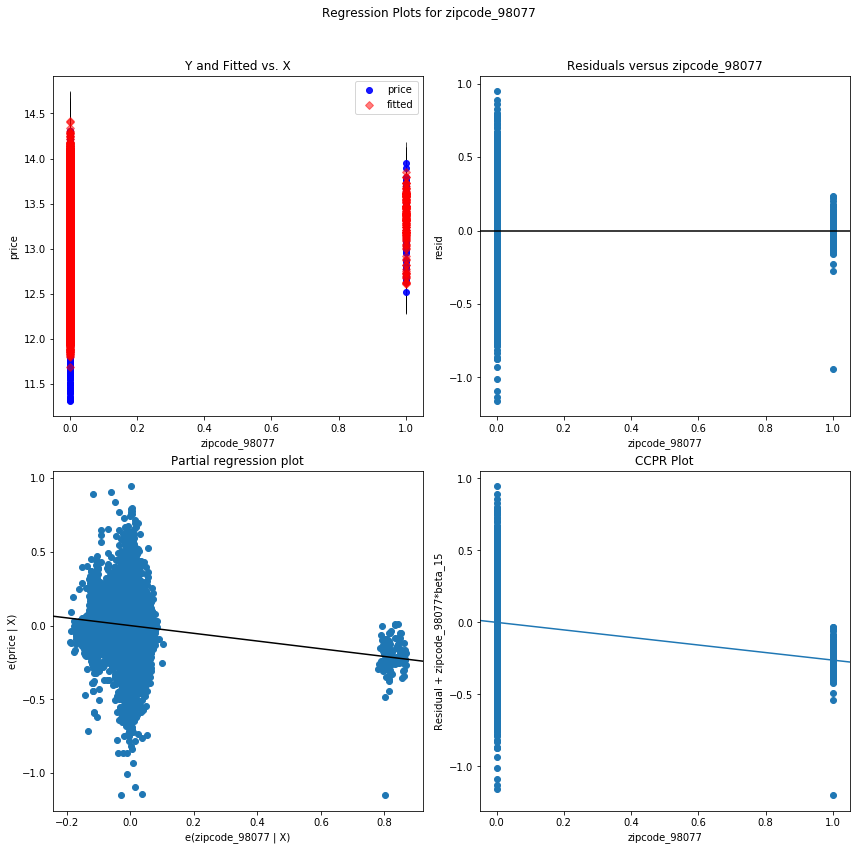

view_2.0 - Plotted


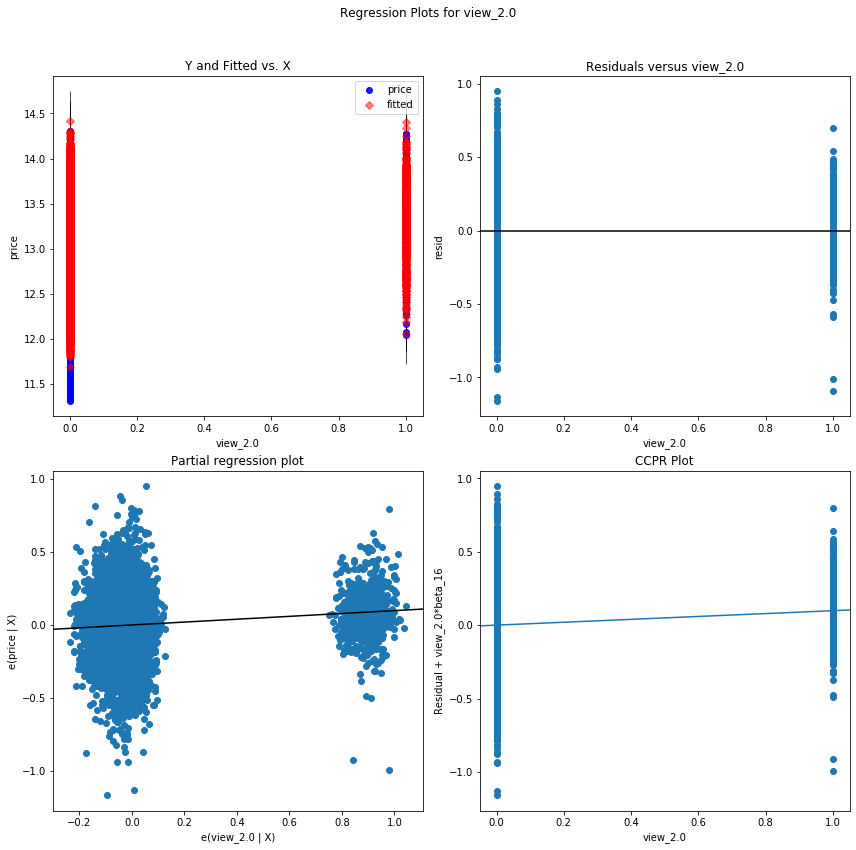

zipcode_98177 - Plotted


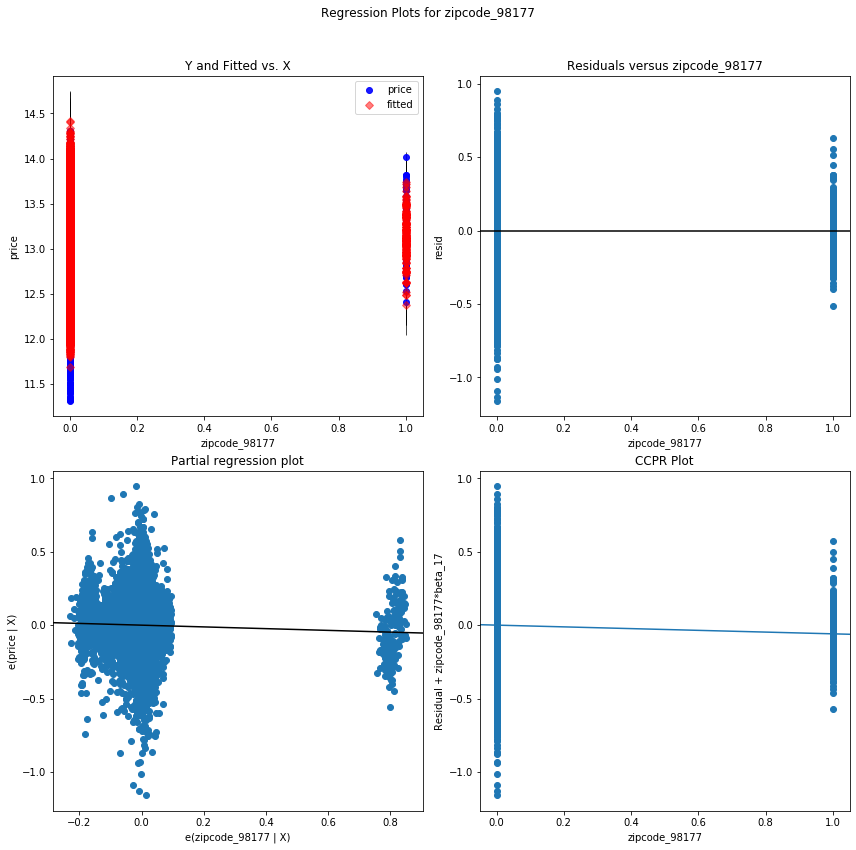

log-sqft_living15 - Plotted


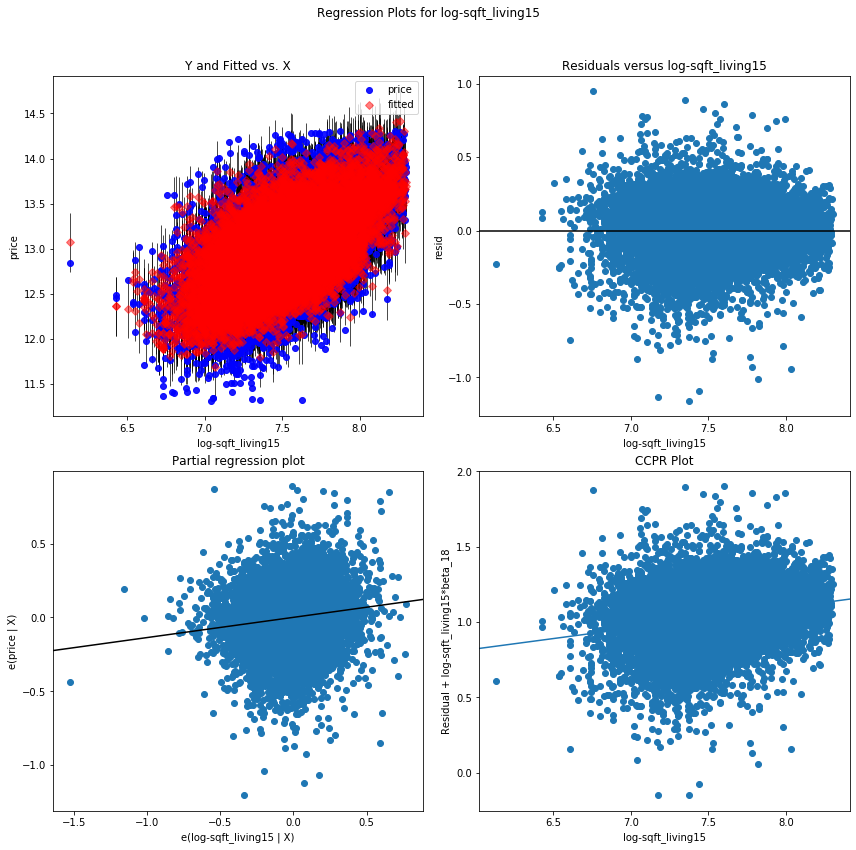

zipcode_98022 - Plotted


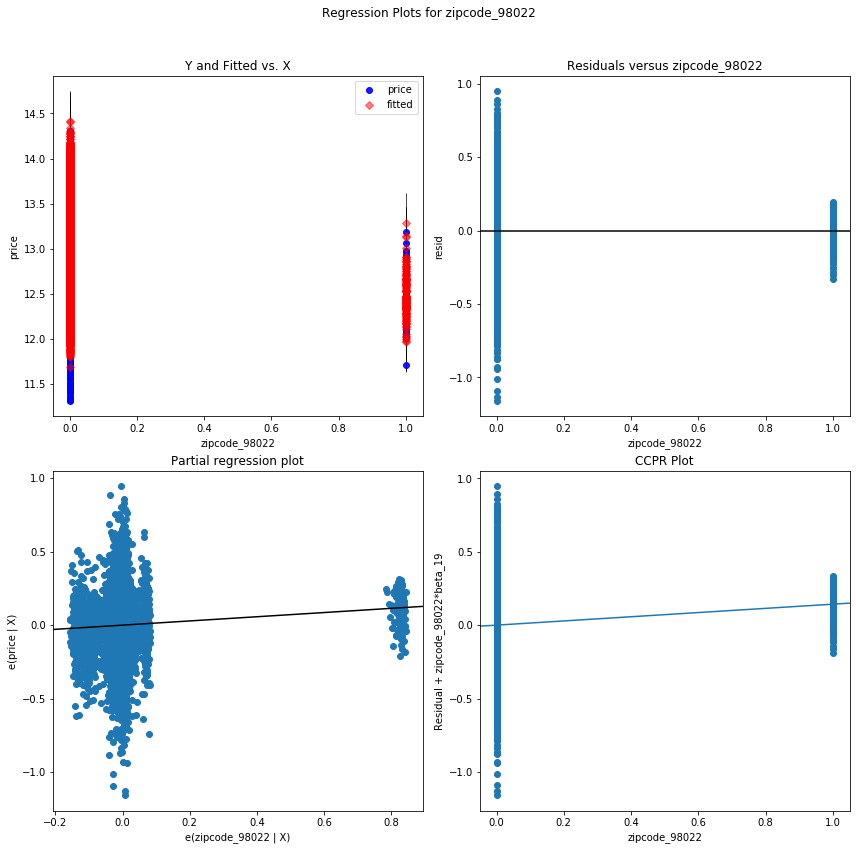

zipcode_98178 - Plotted


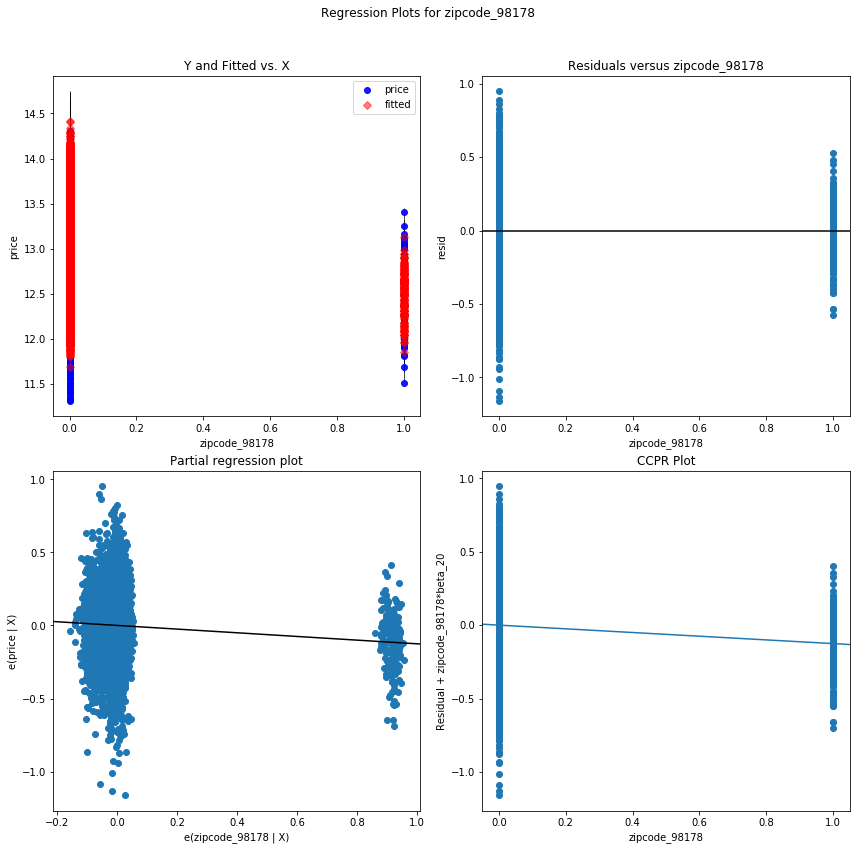

zipcode_98168 - Plotted


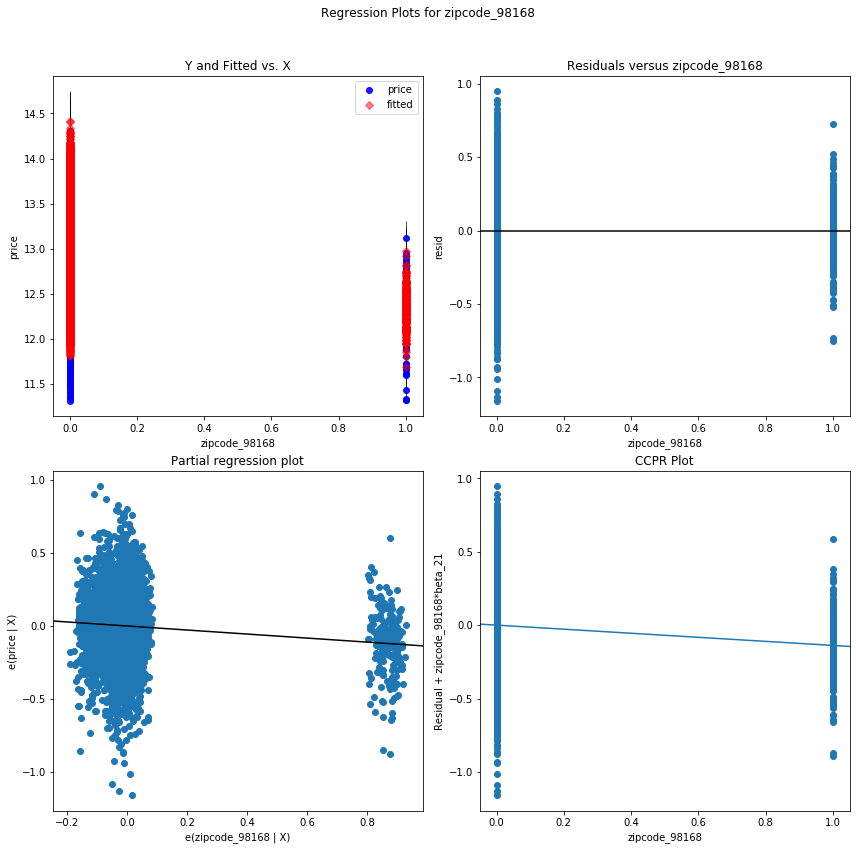

zipcode_98058 - Plotted


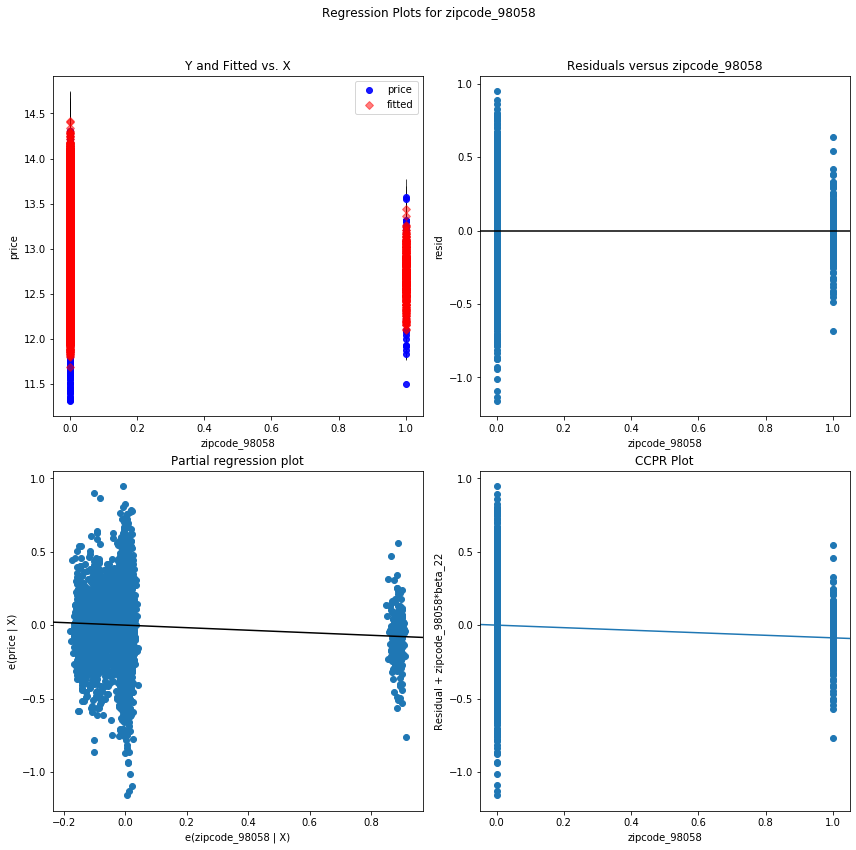

zipcode_98014 - Plotted


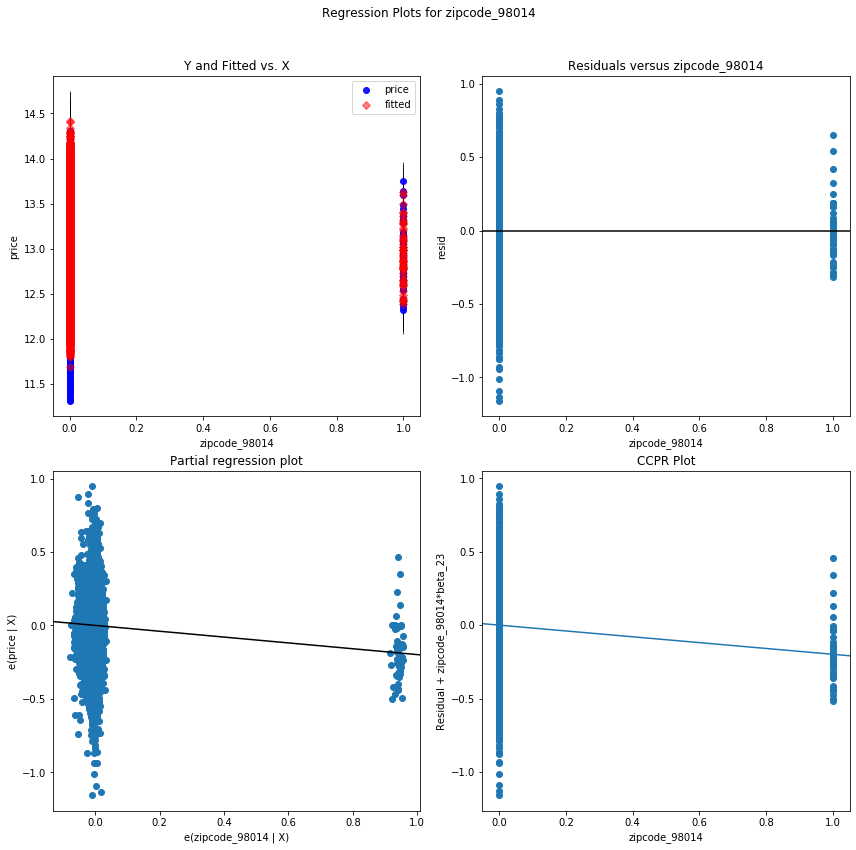

zipcode_98112 - Plotted


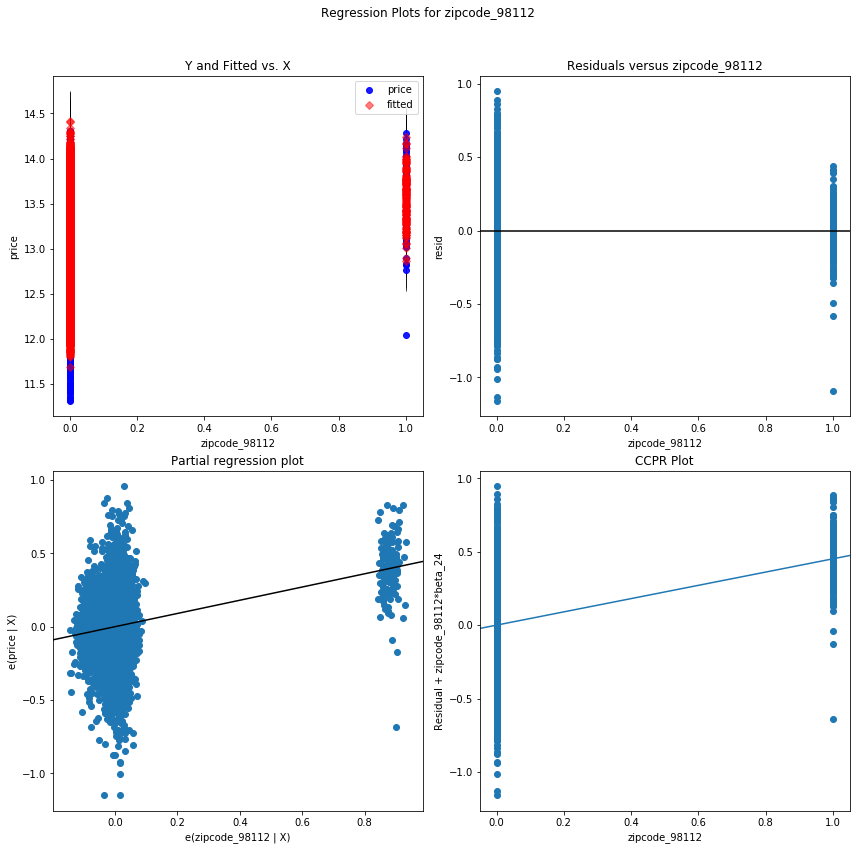

zipcode_98010 - Plotted


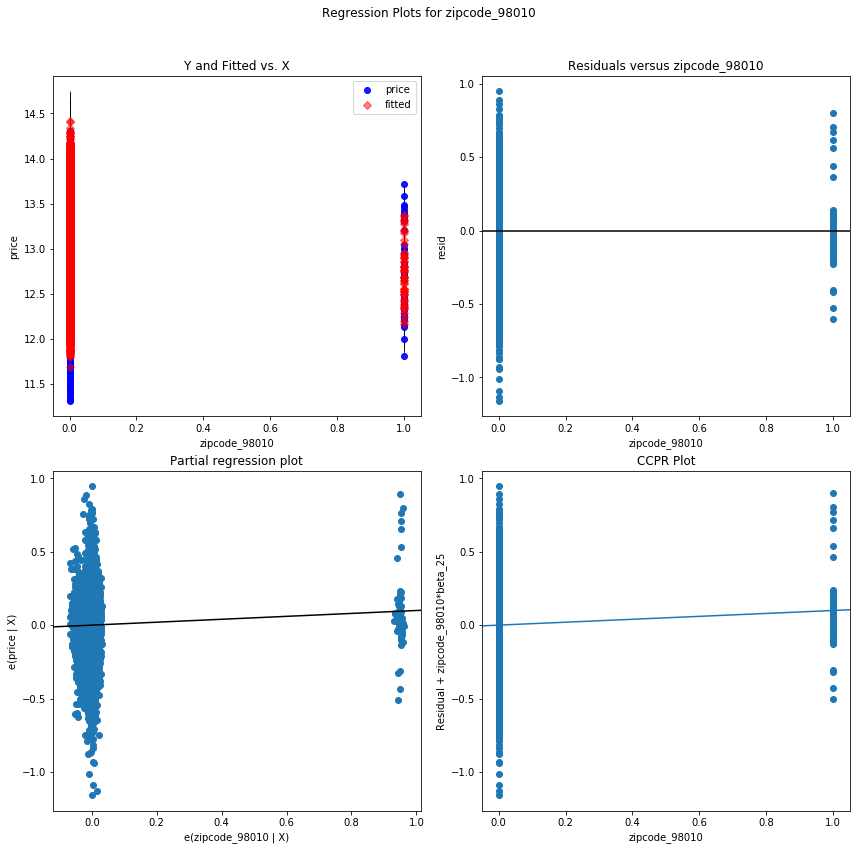

zipcode_98122 - Plotted


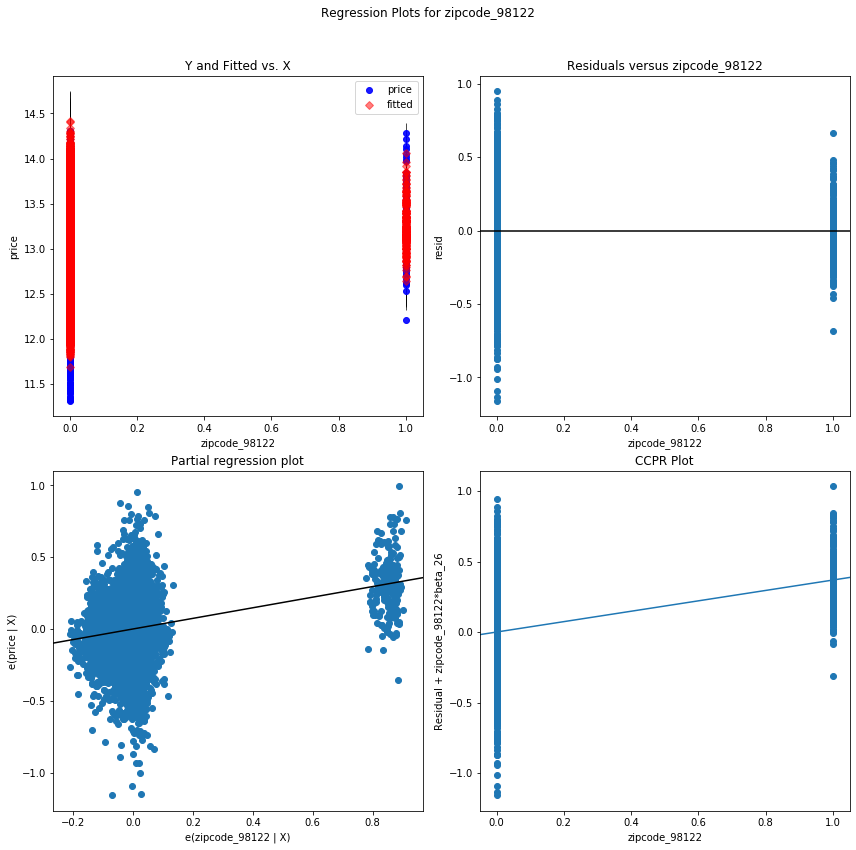

log-sqft_lot - Plotted


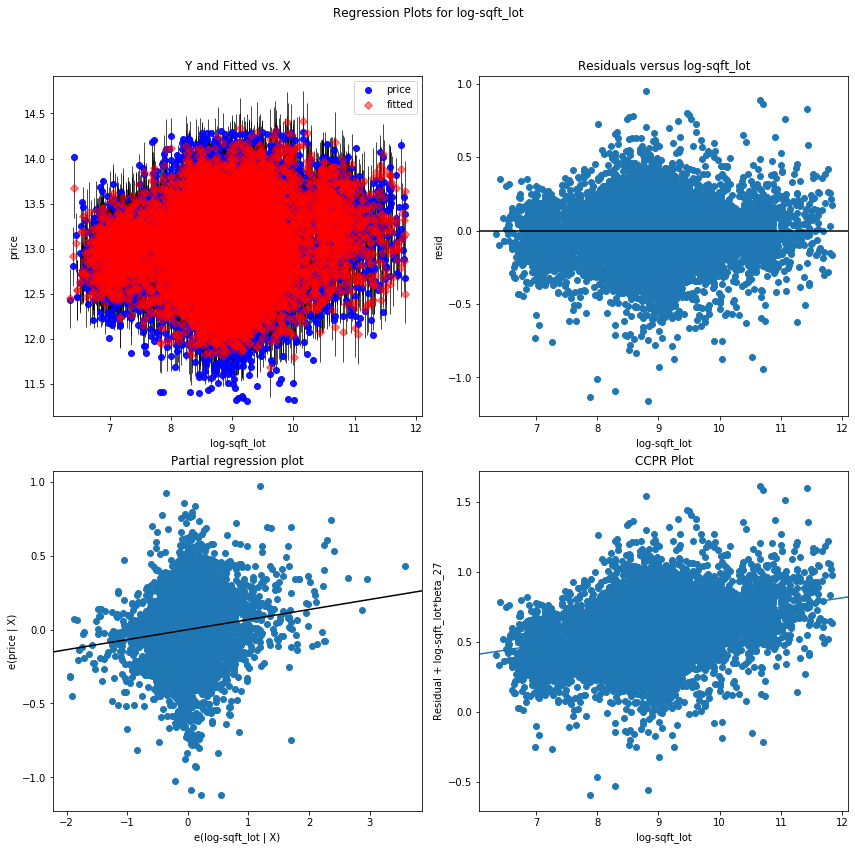

zipcode_98102 - Plotted


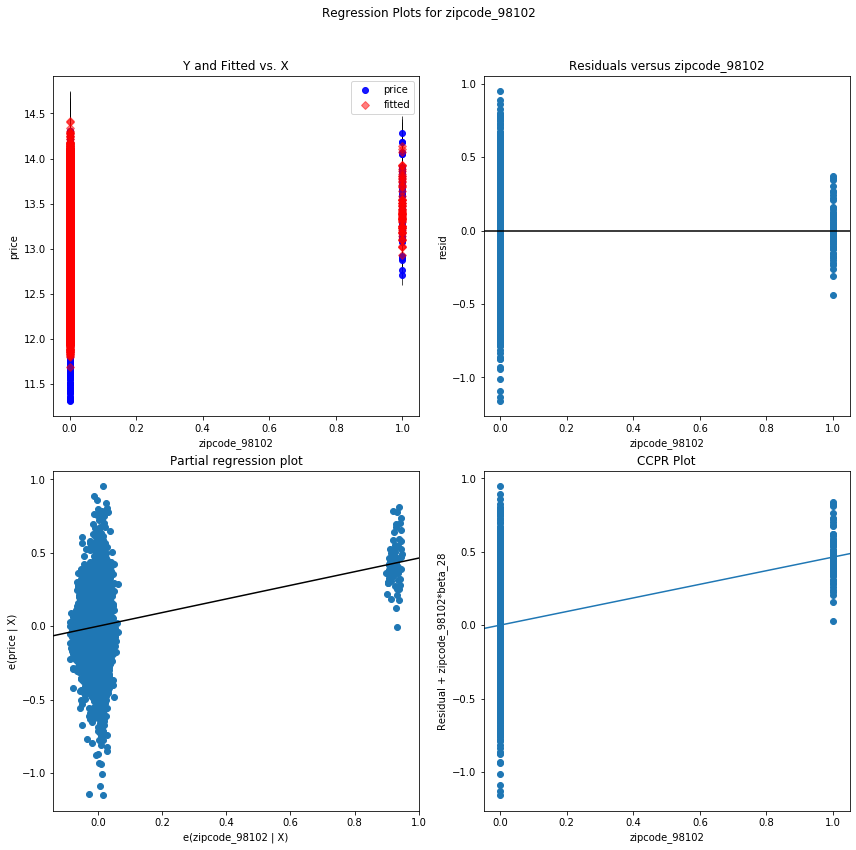

zipcode_98119 - Plotted


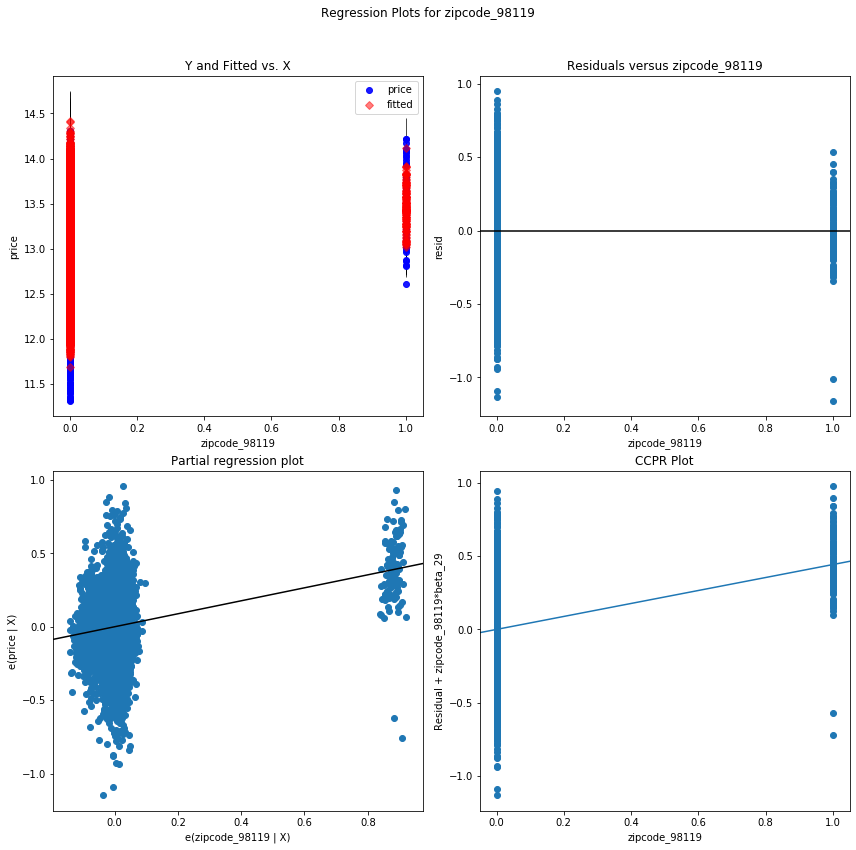

zipcode_98116 - Plotted


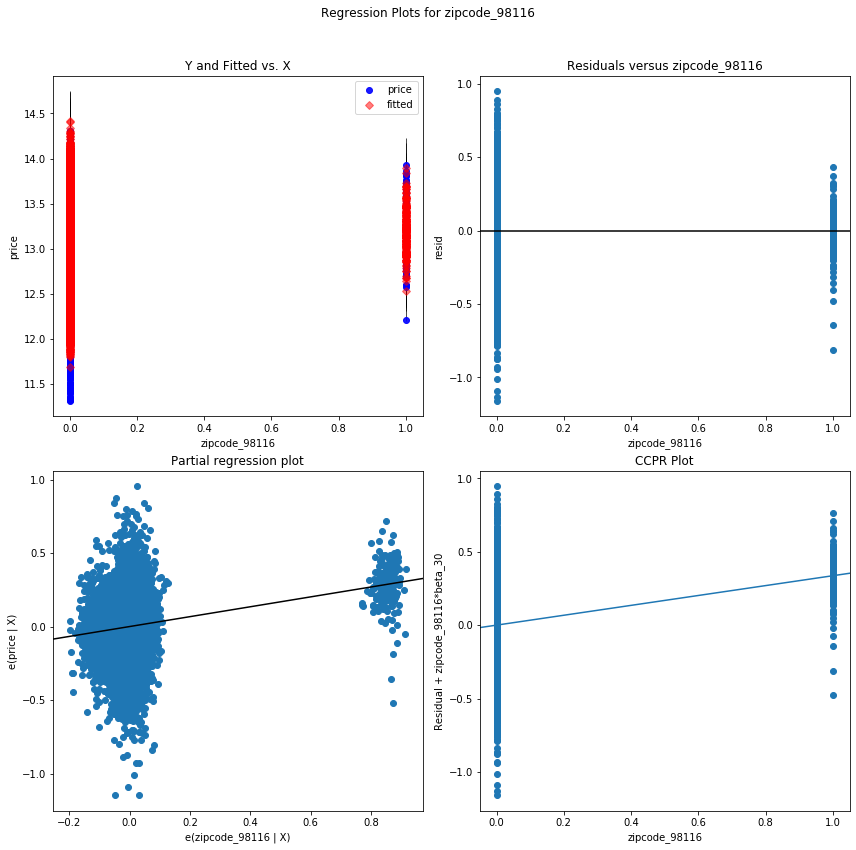

zipcode_98136 - Plotted


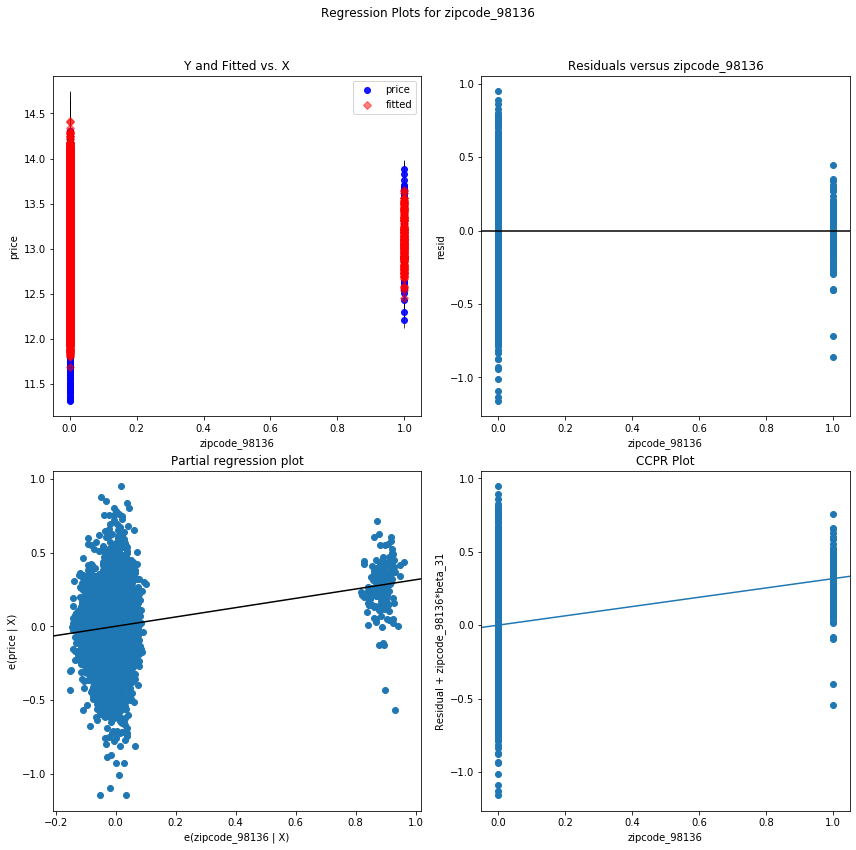

zipcode_98109 - Plotted


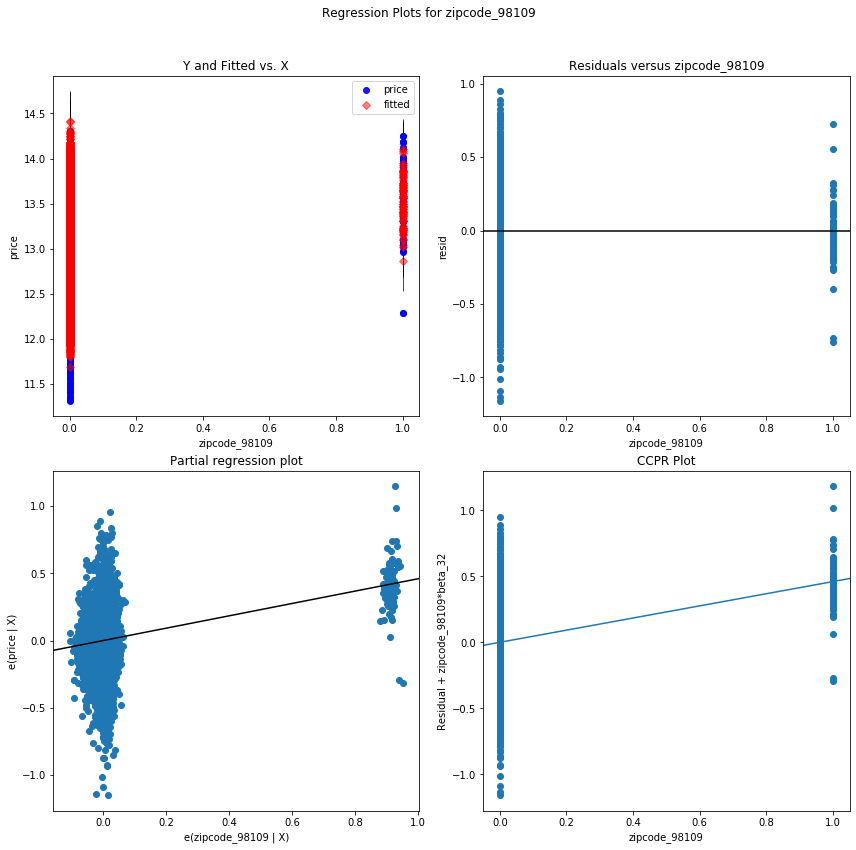

zipcode_98105 - Plotted


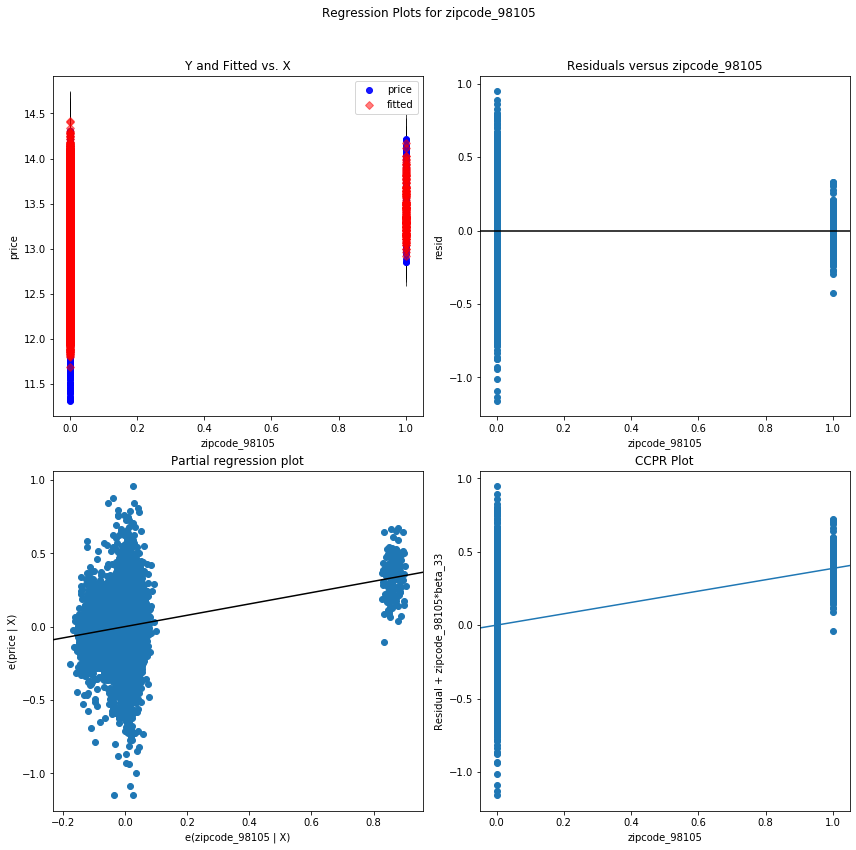

zipcode_98006 - Plotted


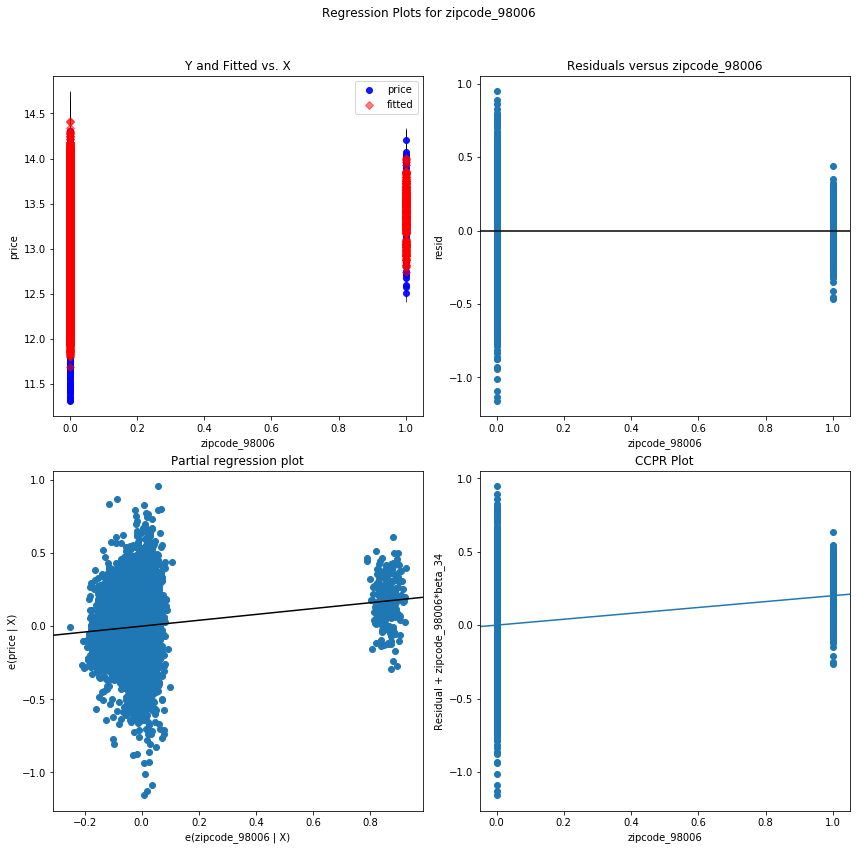

zipcode_98005 - Plotted


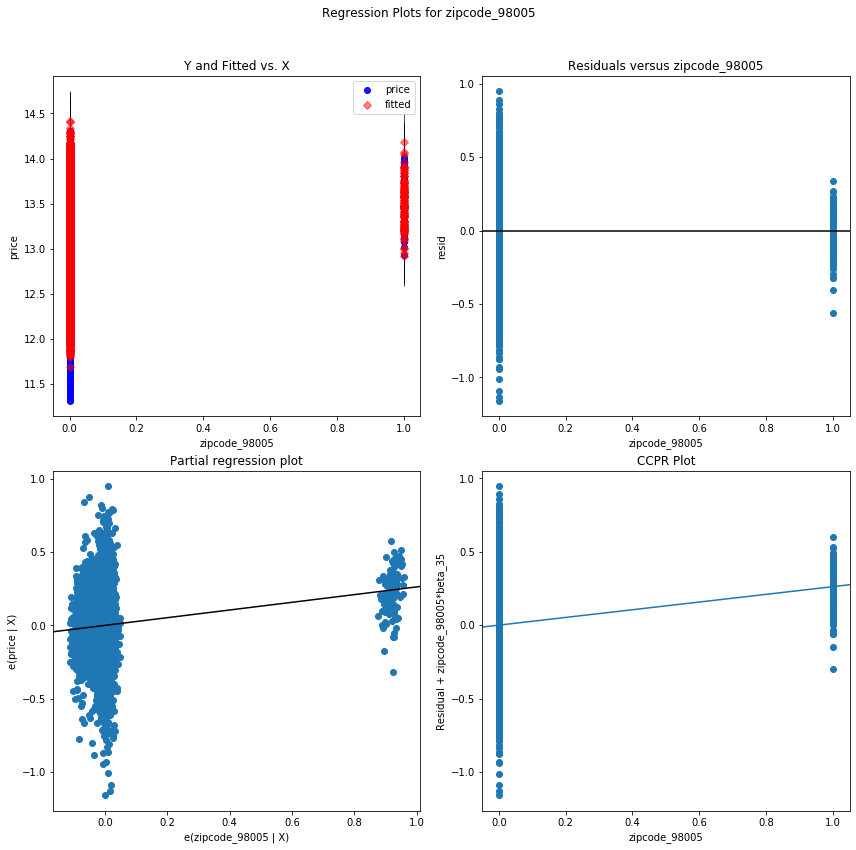

zipcode_98199 - Plotted


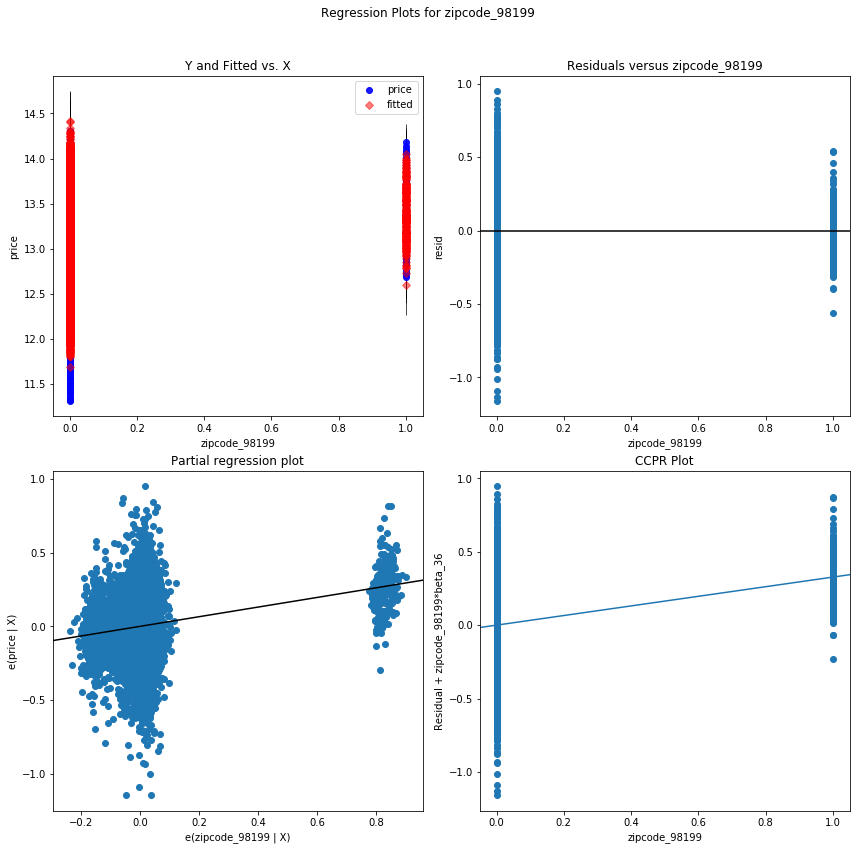

zipcode_98126 - Plotted


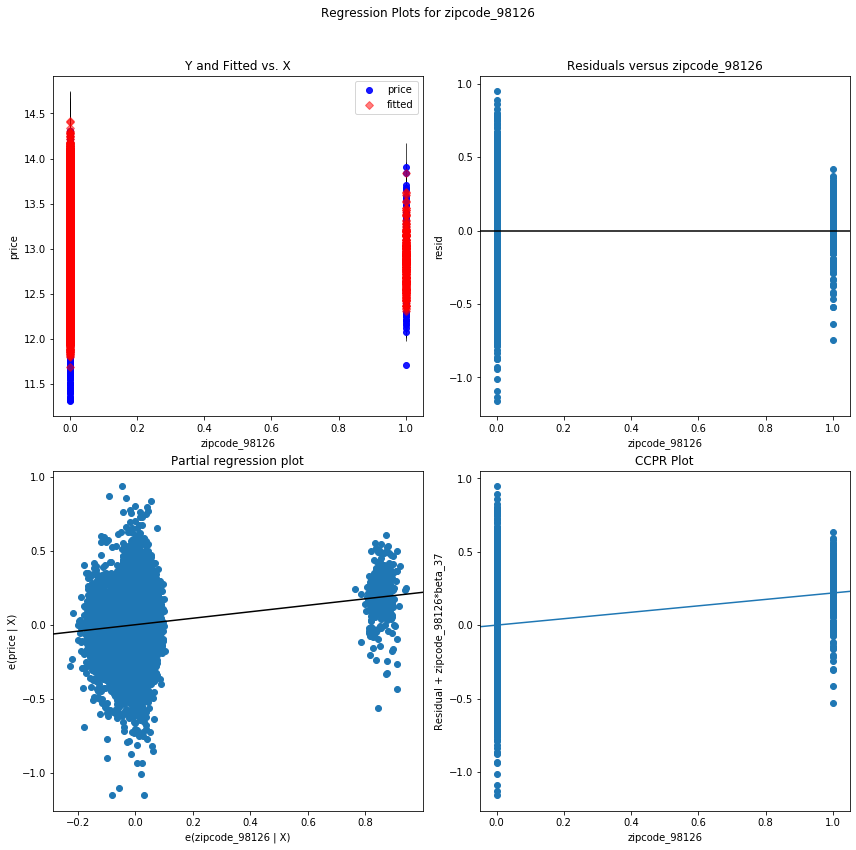

zipcode_98144 - Plotted


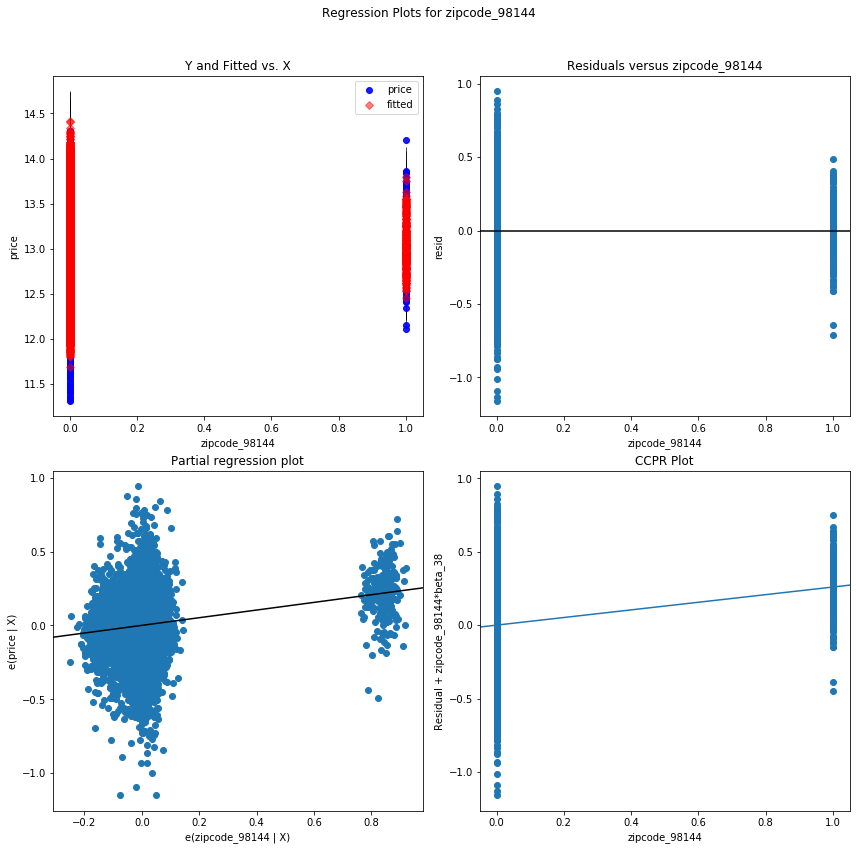

zipcode_98103 - Plotted


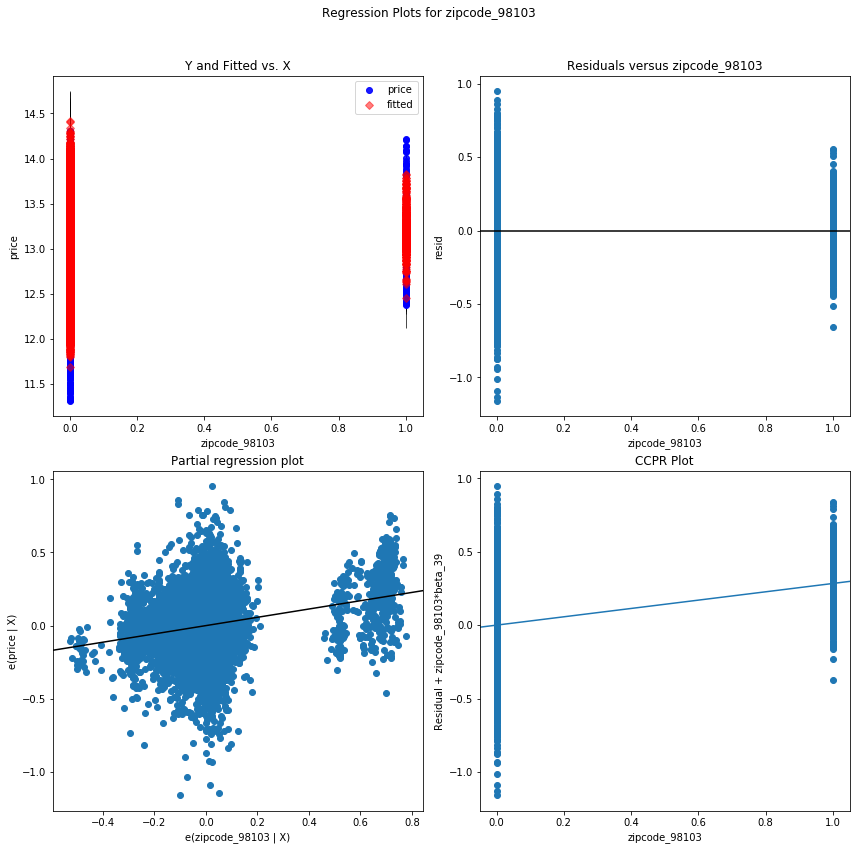

zipcode_98107 - Plotted


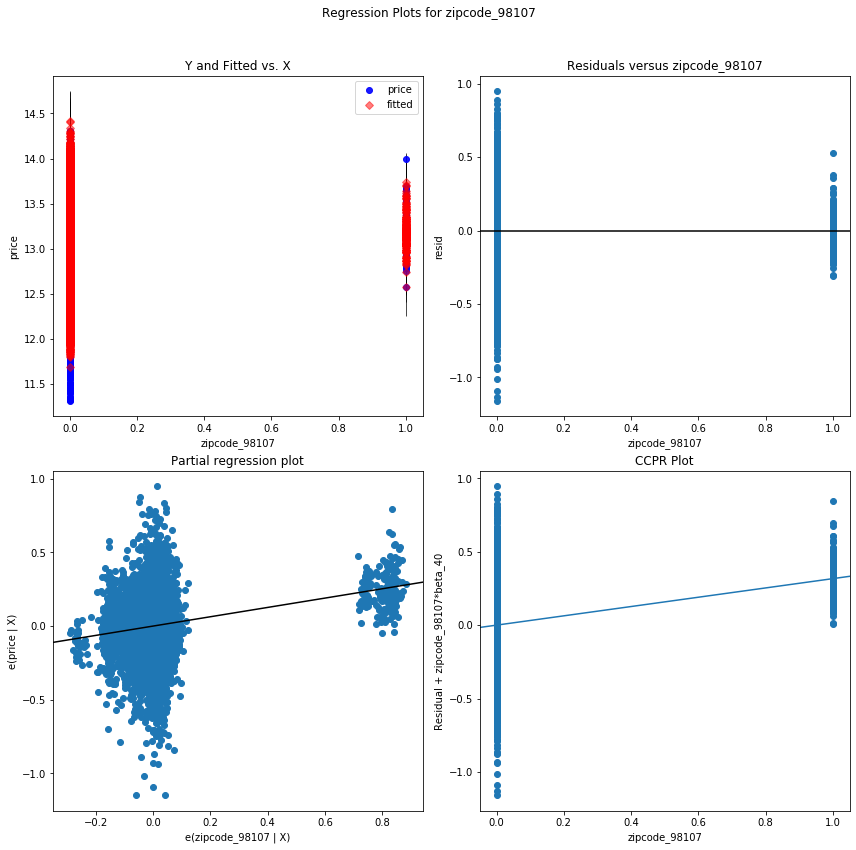

zipcode_98117 - Plotted


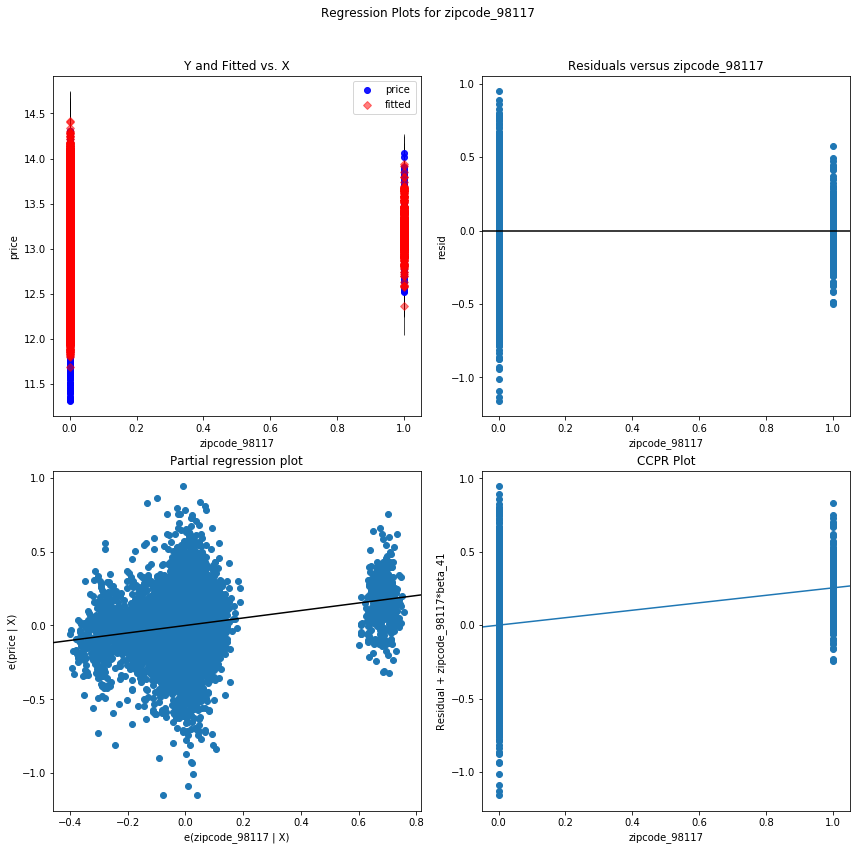

zipcode_98115 - Plotted


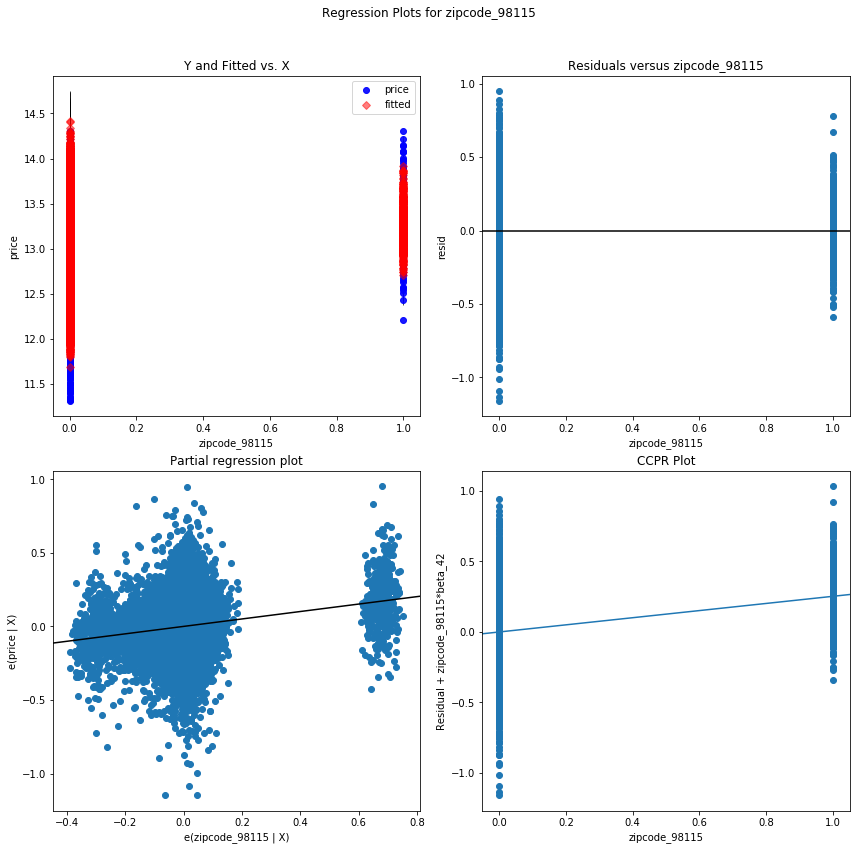

zipcode_98118 - Plotted


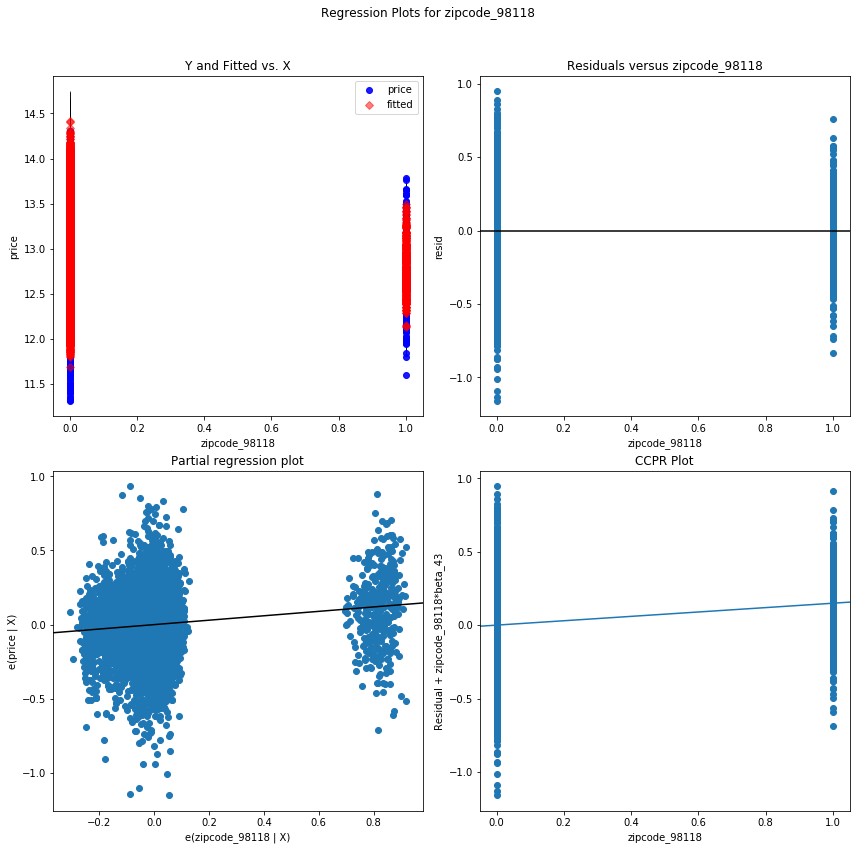

log-sqft_basement - Plotted


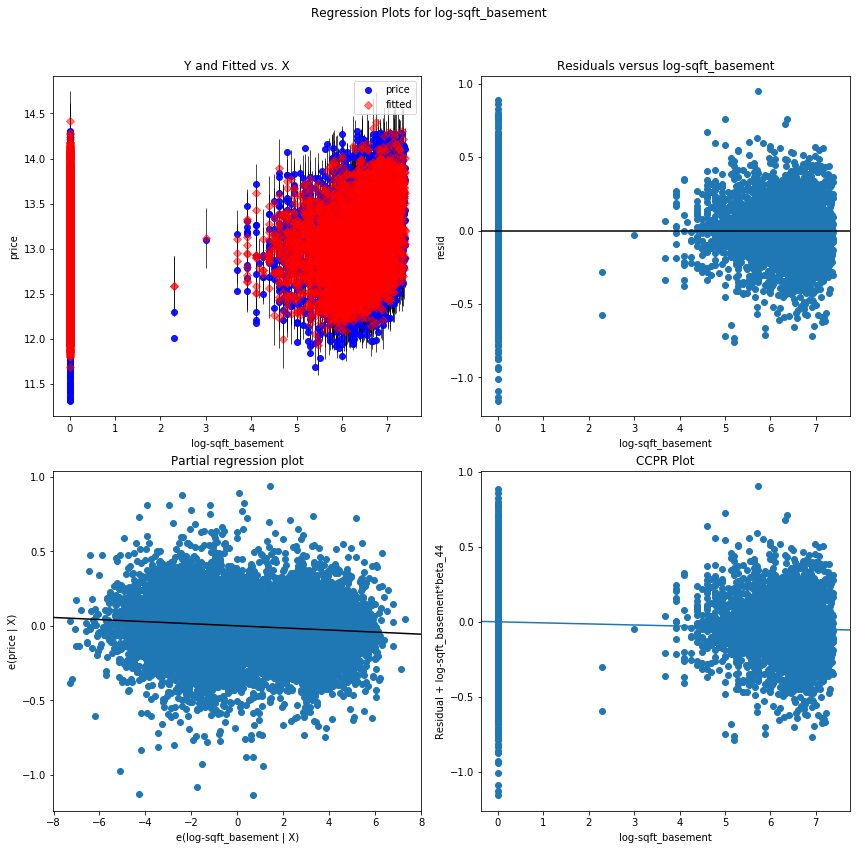

zipcode_98027 - Plotted


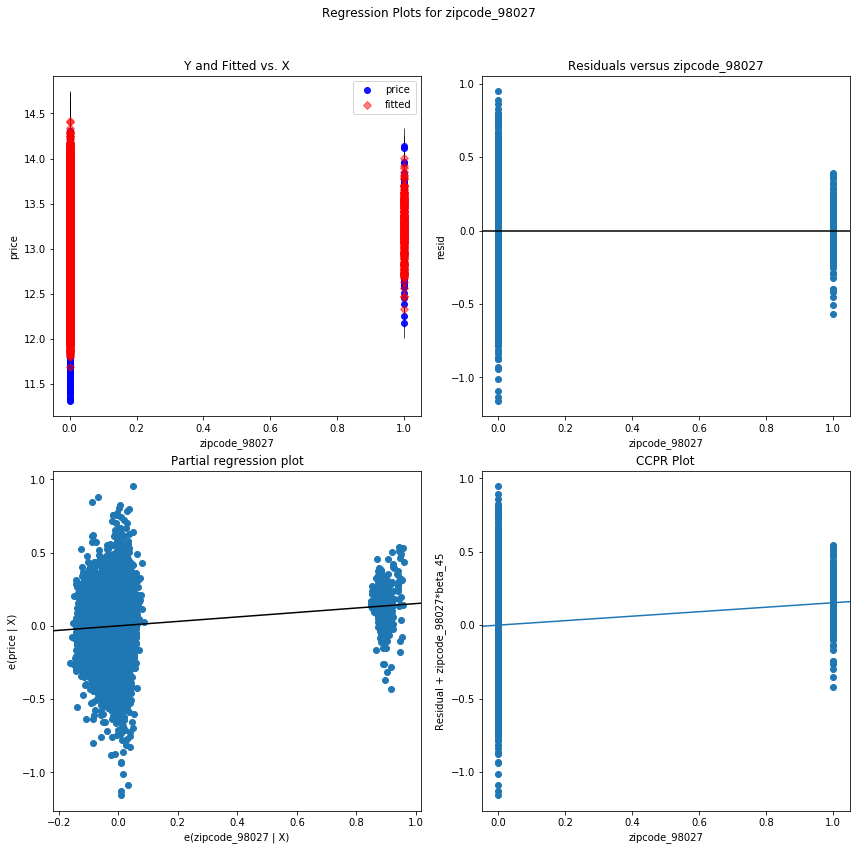

zipcode_98029 - Plotted


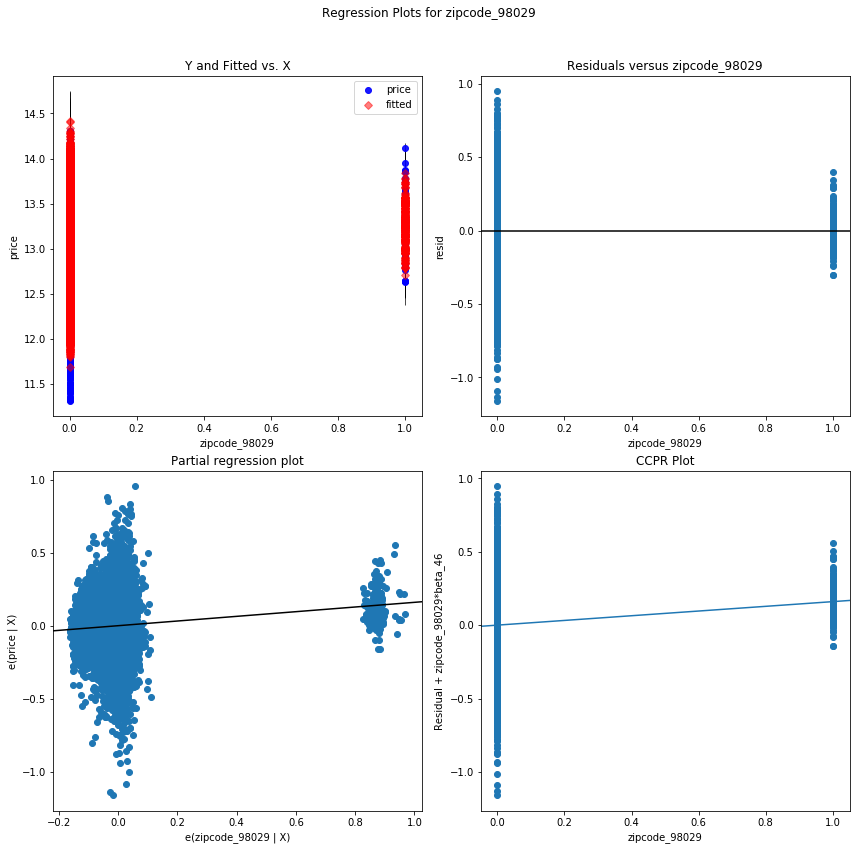

zipcode_98033 - Plotted


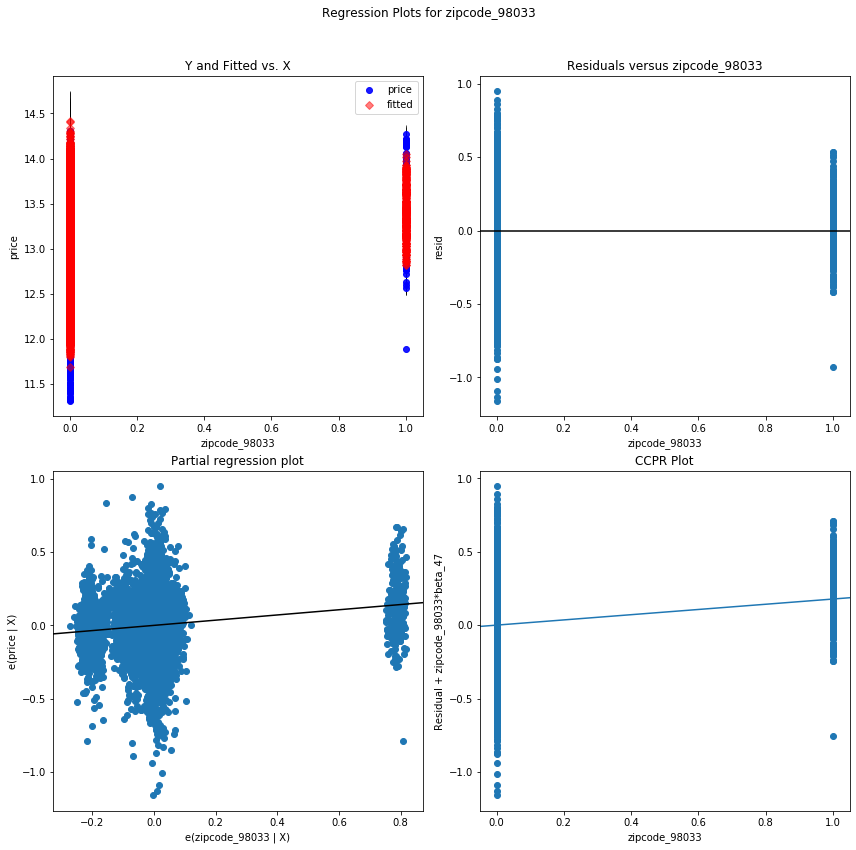

zipcode_98008 - Plotted


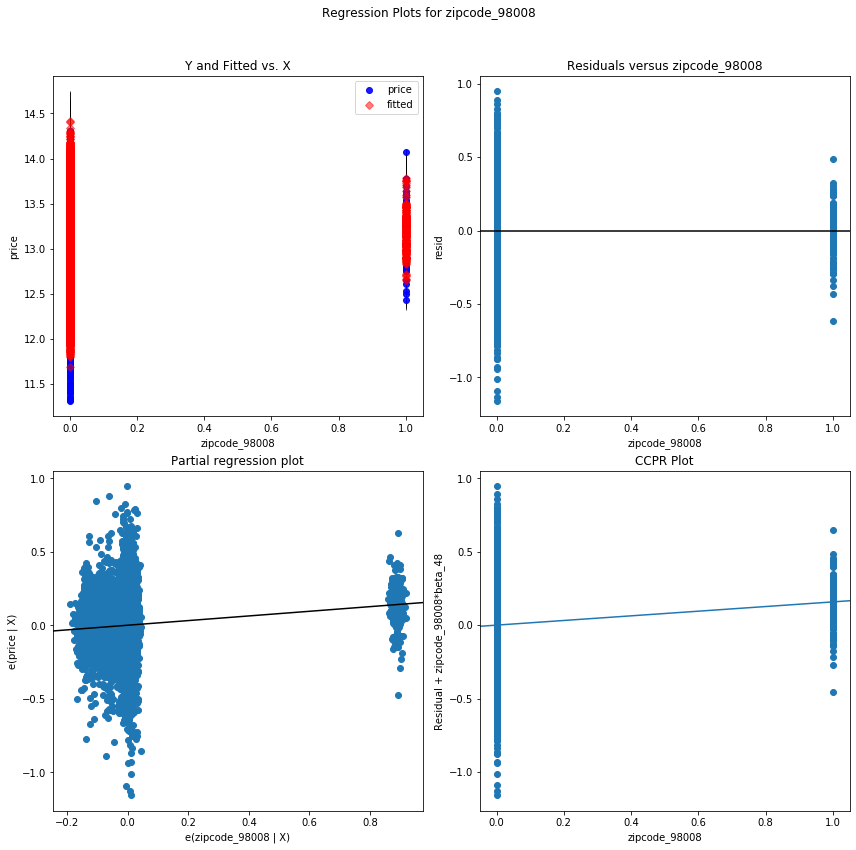

zipcode_98007 - Plotted


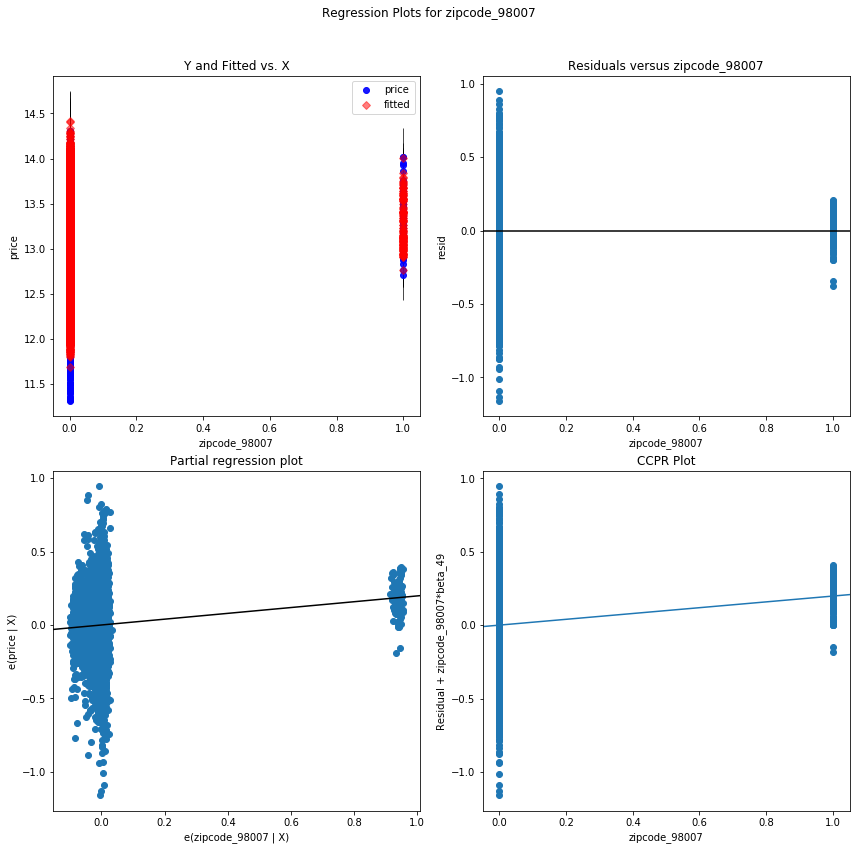

zipcode_98042 - Plotted


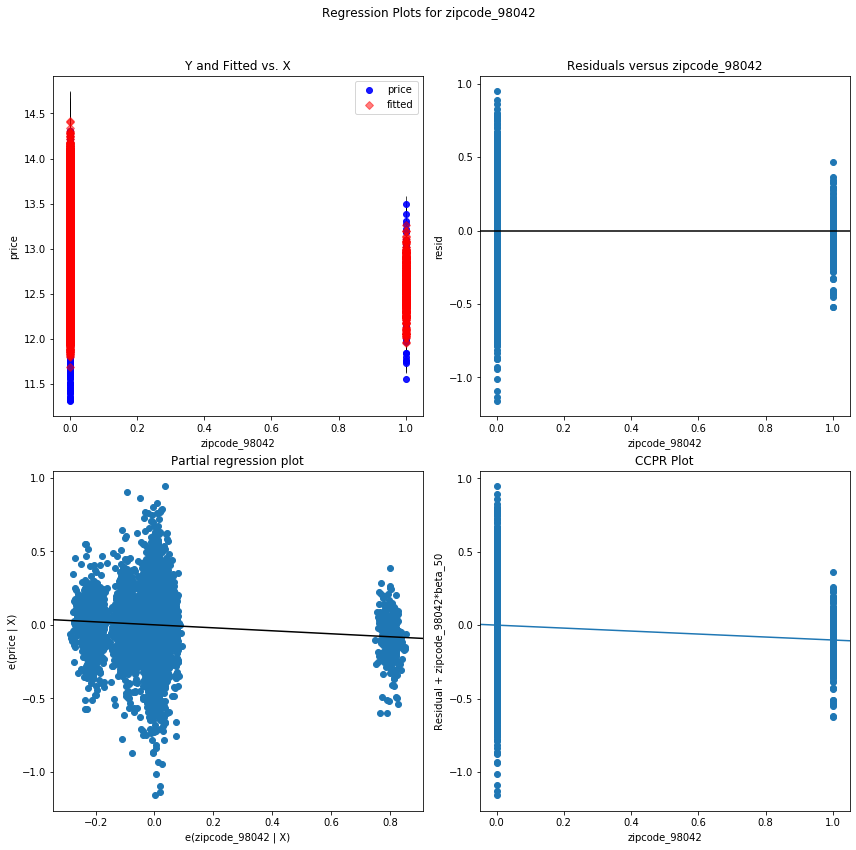

zipcode_98031 - Plotted


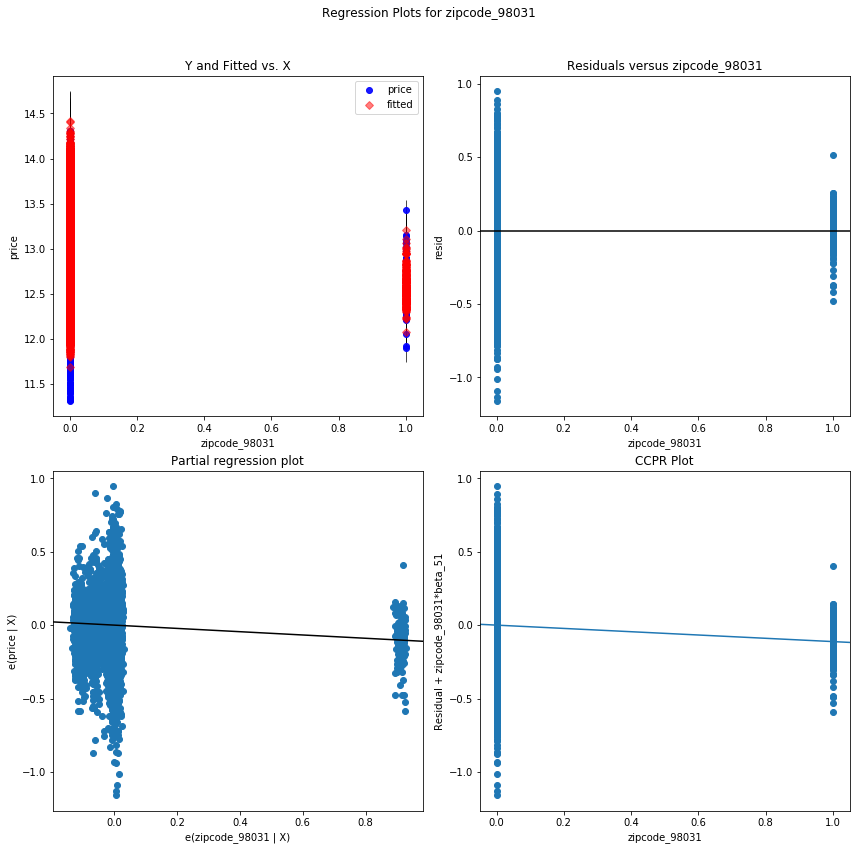

log-bathrooms - Plotted


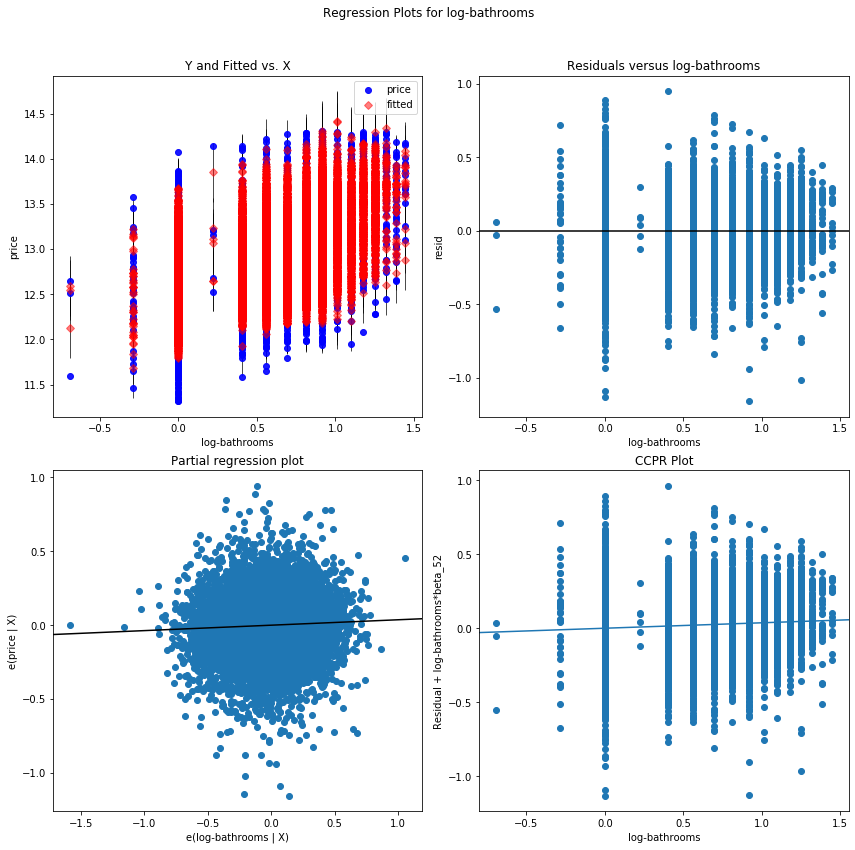

floors_3.0 - Plotted


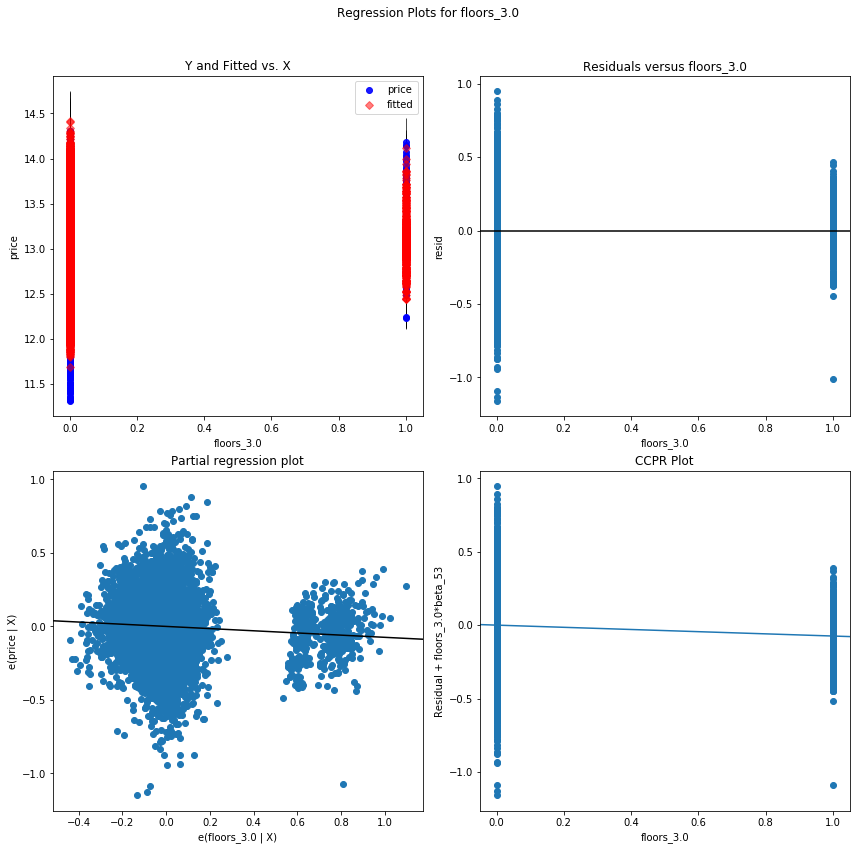

zipcode_98070 - Plotted


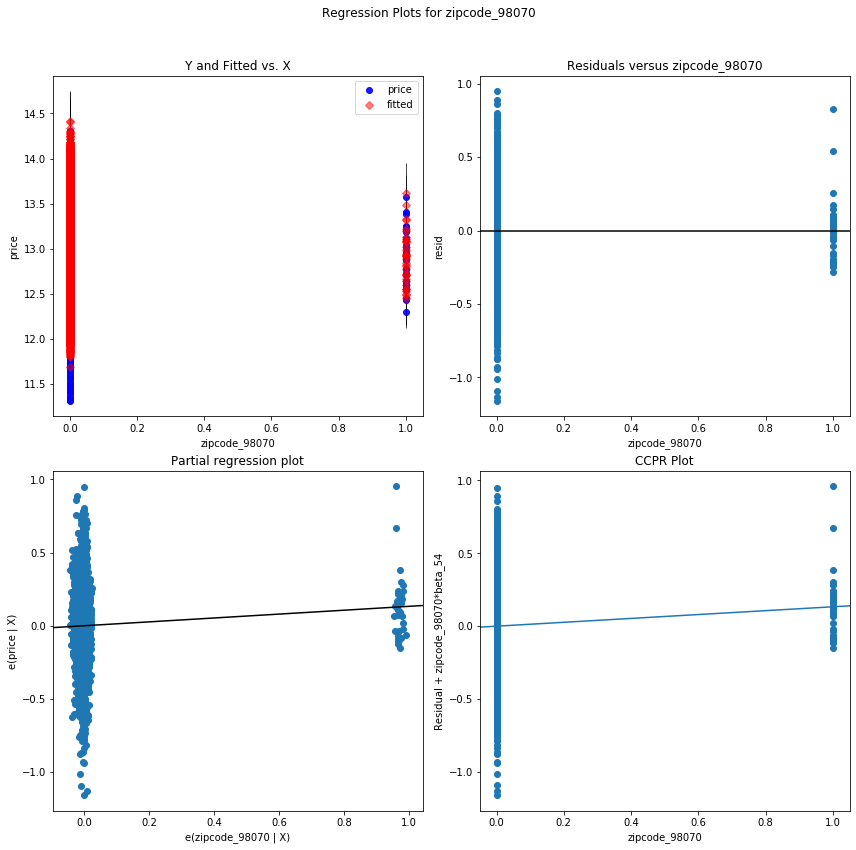

zipcode_98166 - Plotted


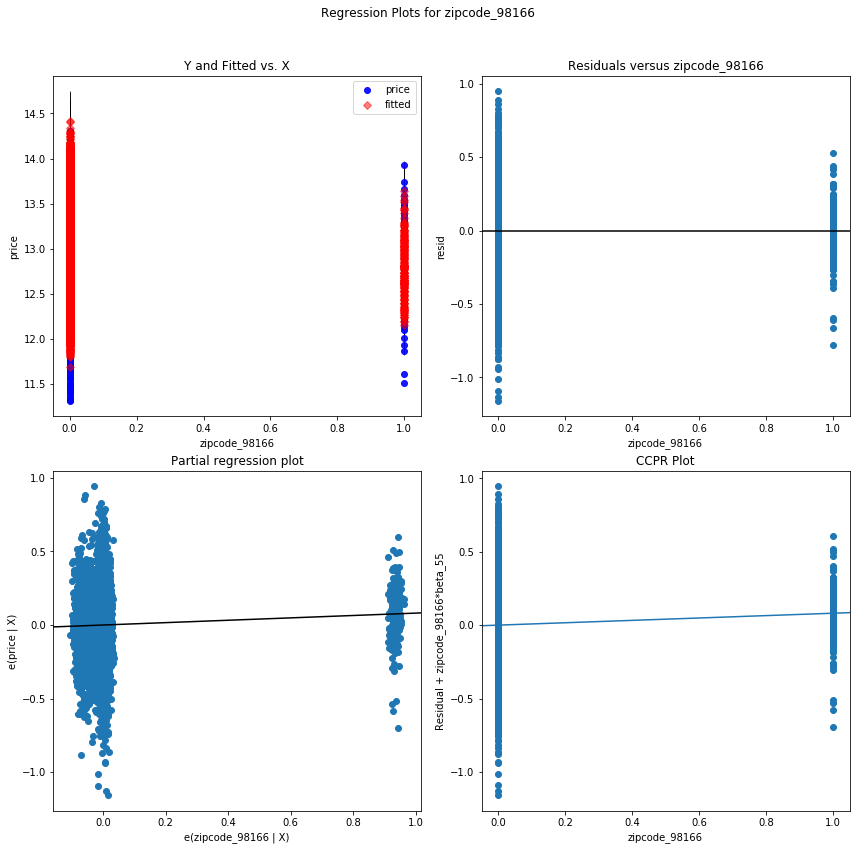

zipcode_98106 - Plotted


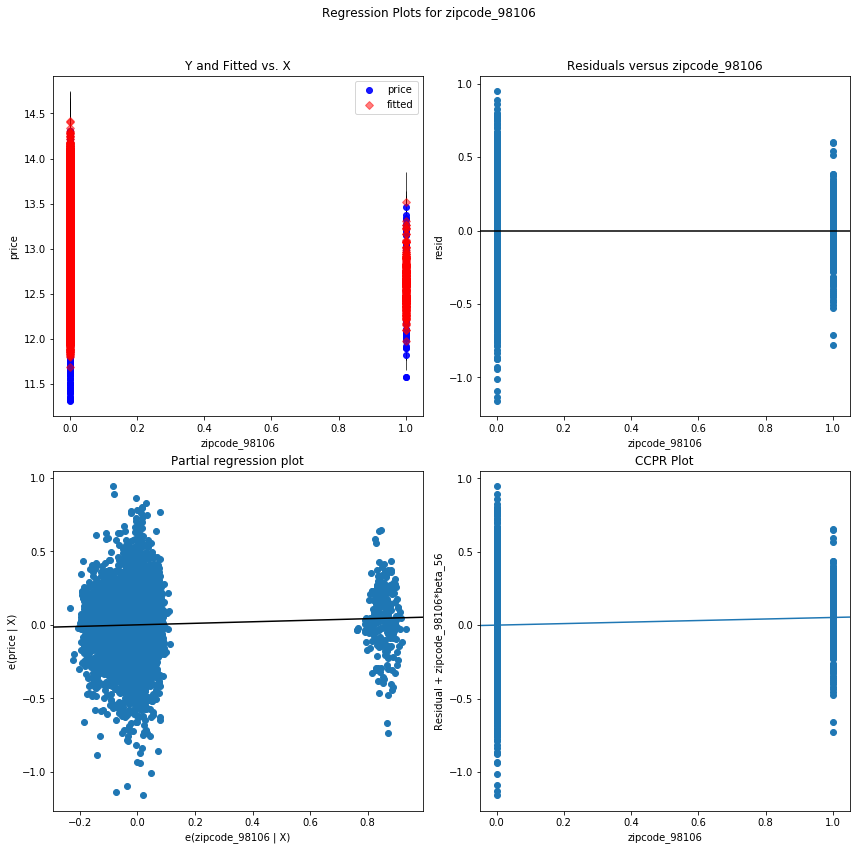

zipcode_98108 - Plotted


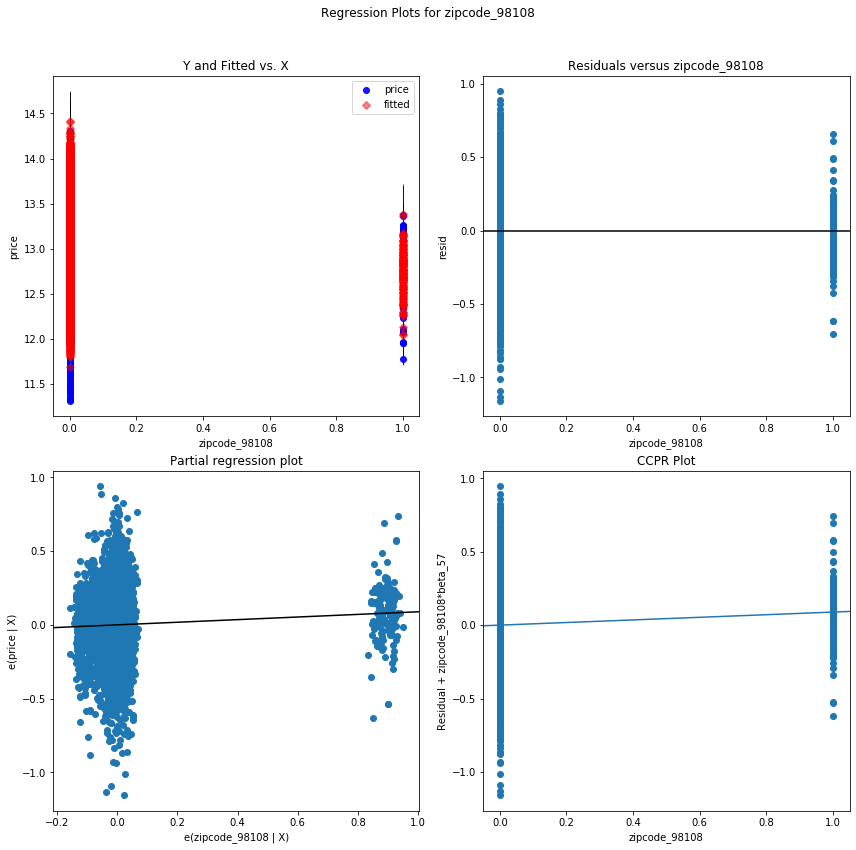

zipcode_98075 - Plotted


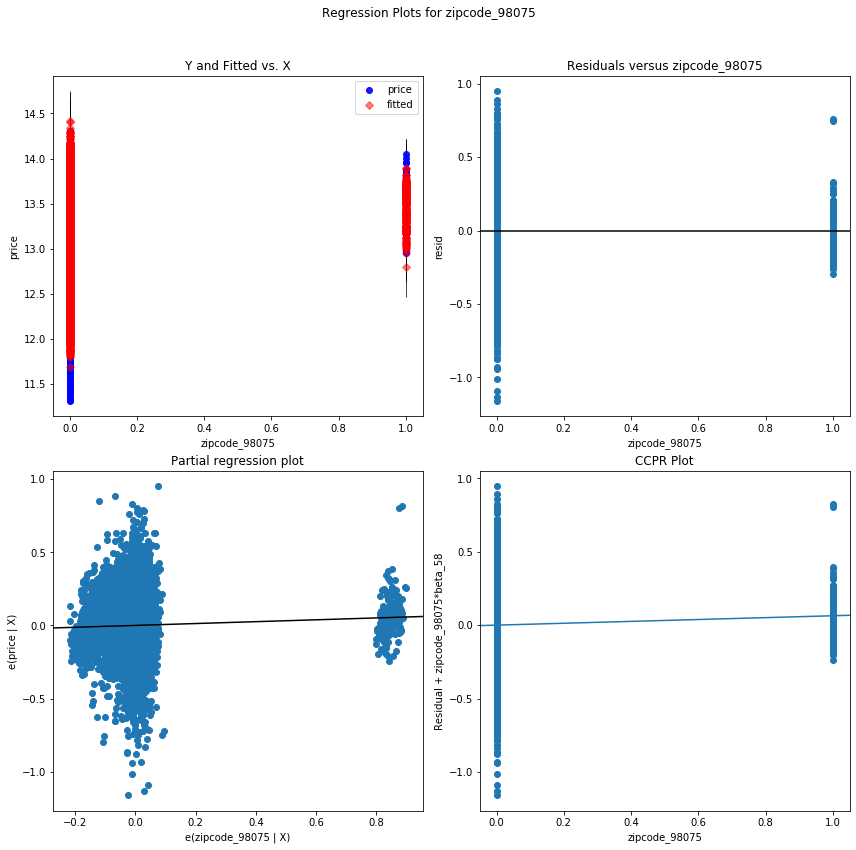

log-sqft_lot15 - Plotted


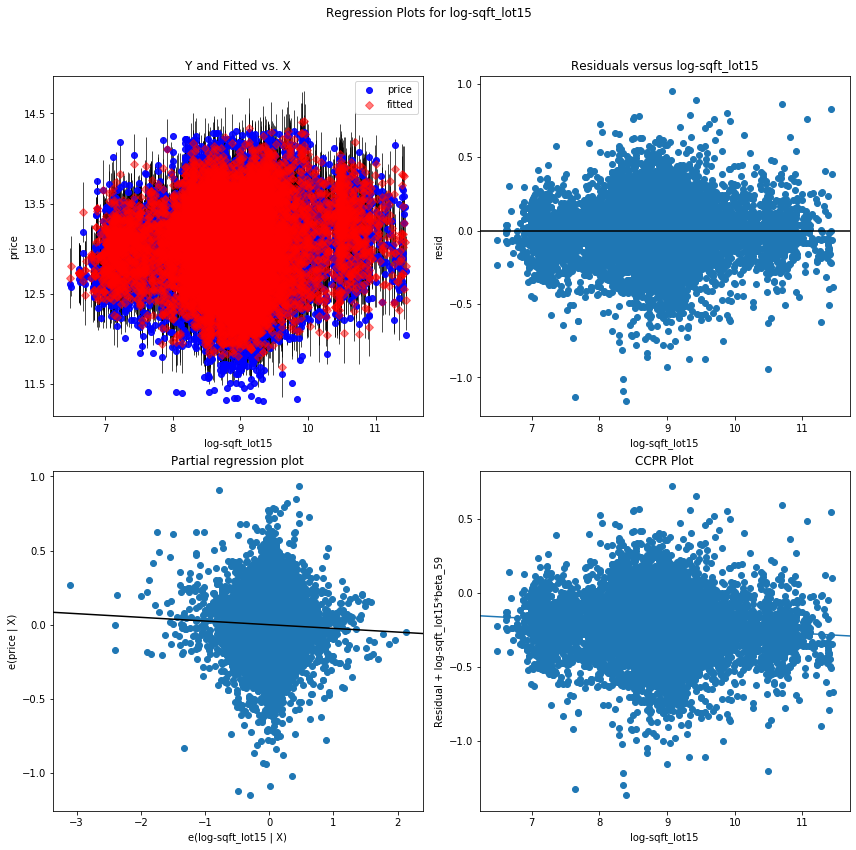

zipcode_98032 - Plotted


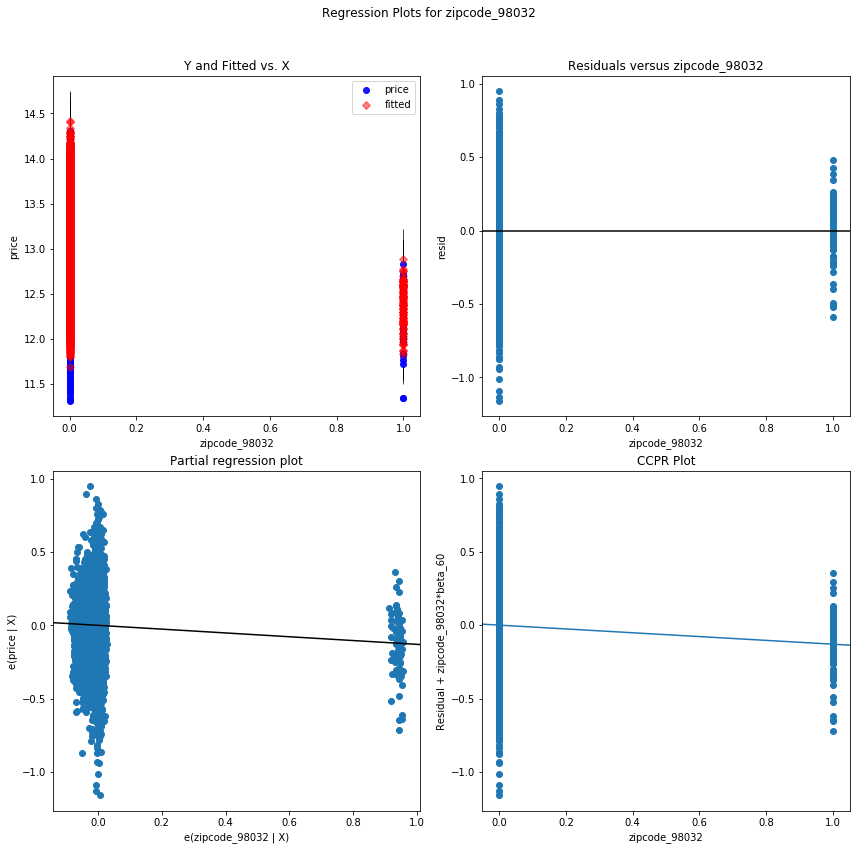

zipcode_98023 - Plotted


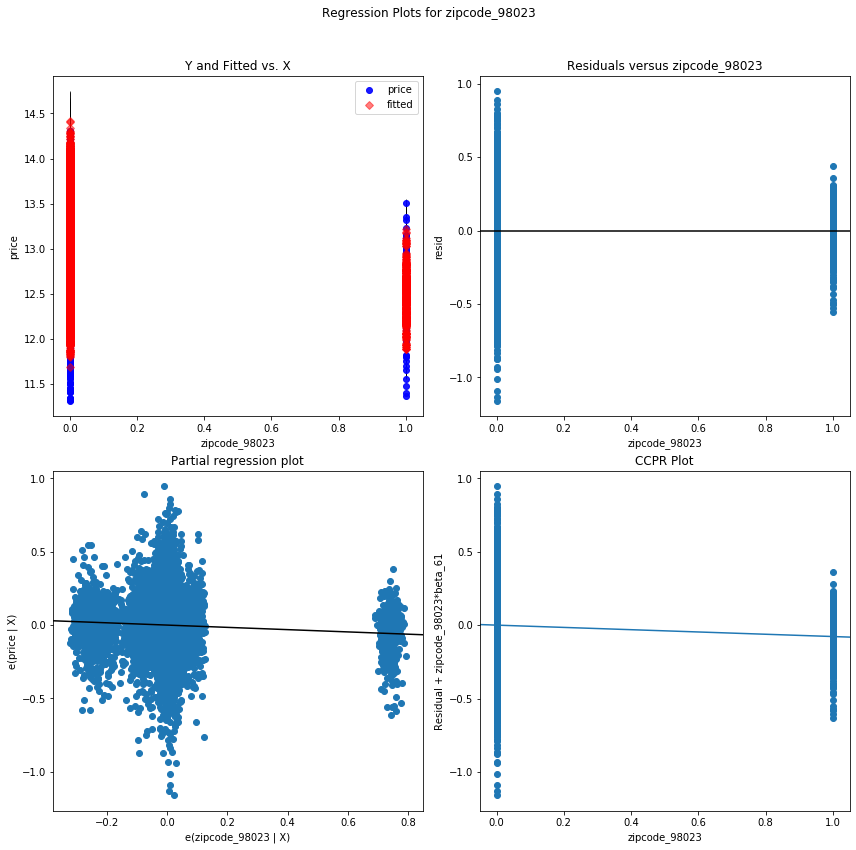

zipcode_98055 - Plotted


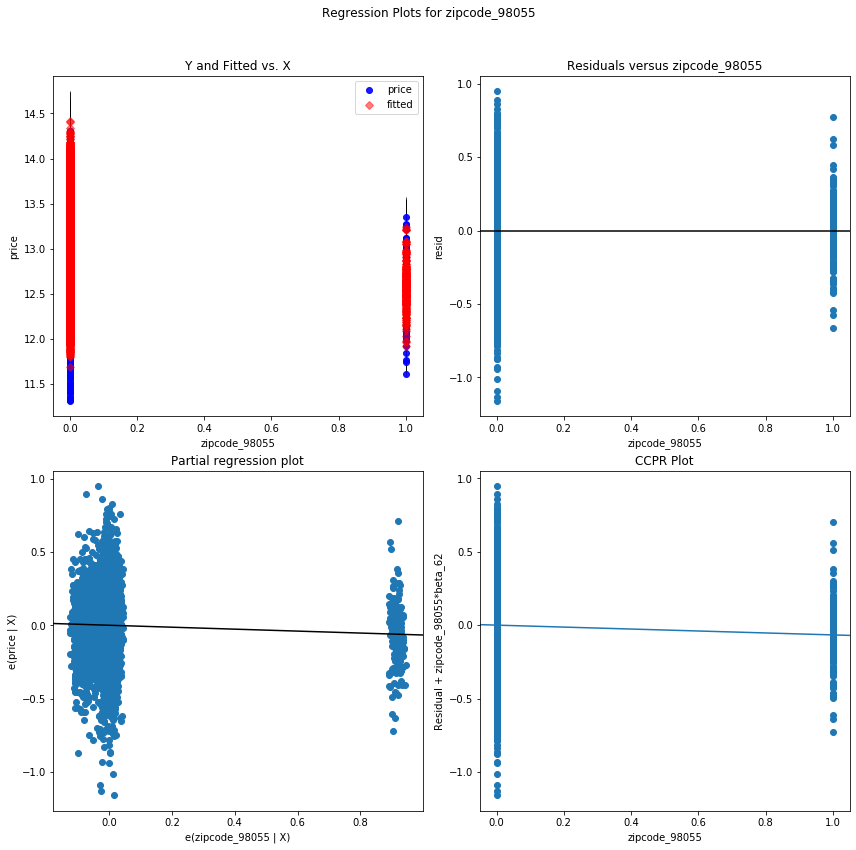

zipcode_98198 - Plotted


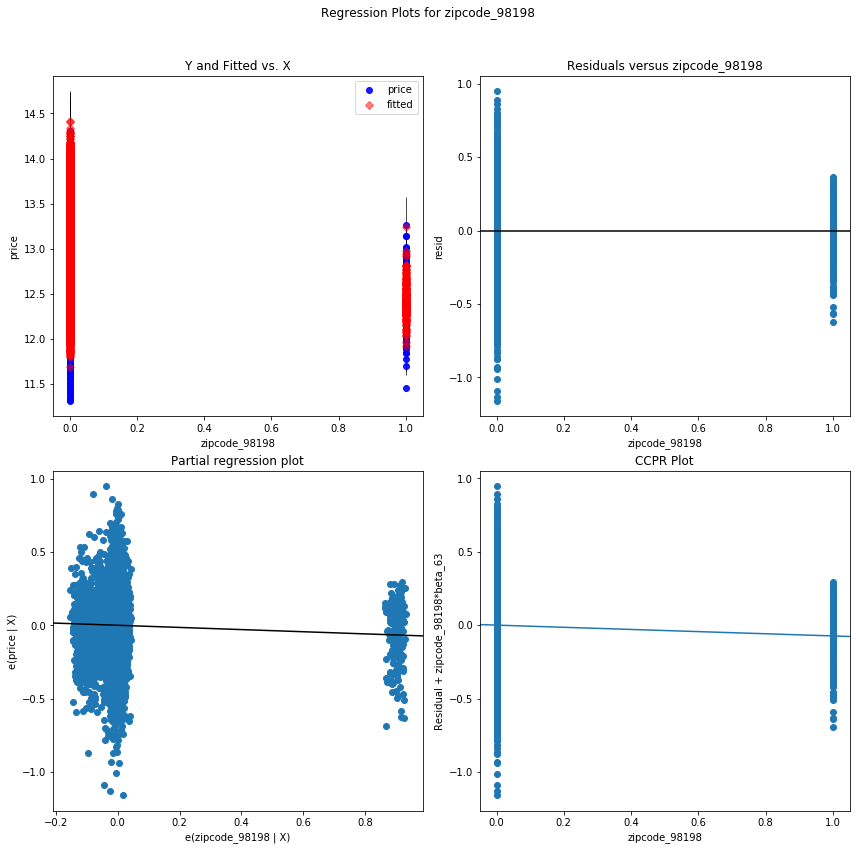

zipcode_98092 - Plotted


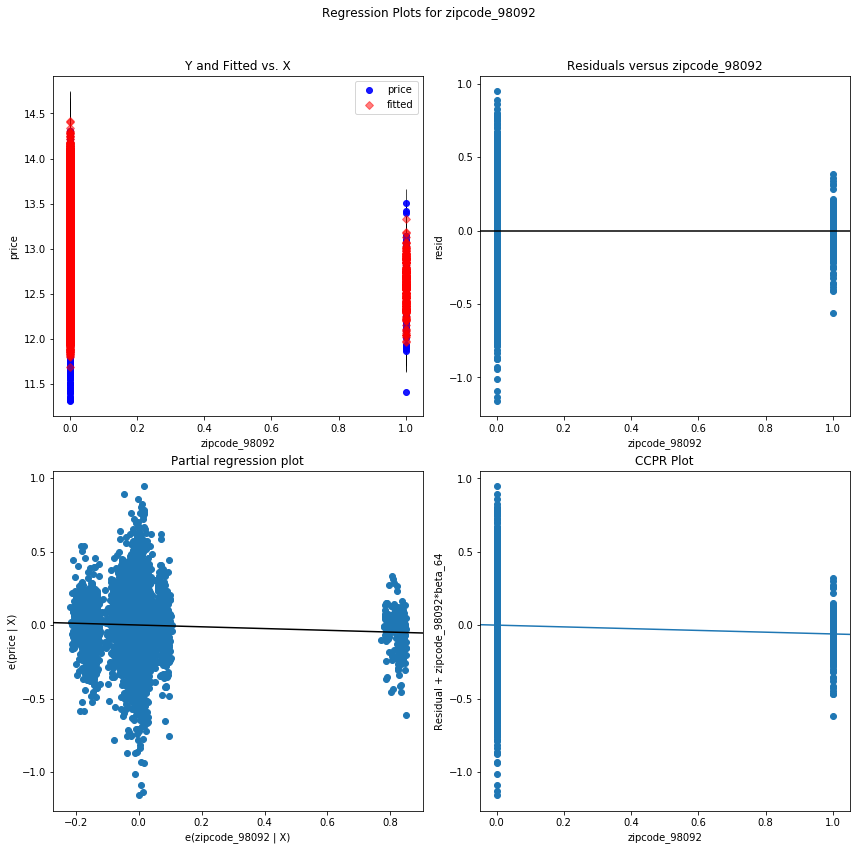

zipcode_98052 - Plotted


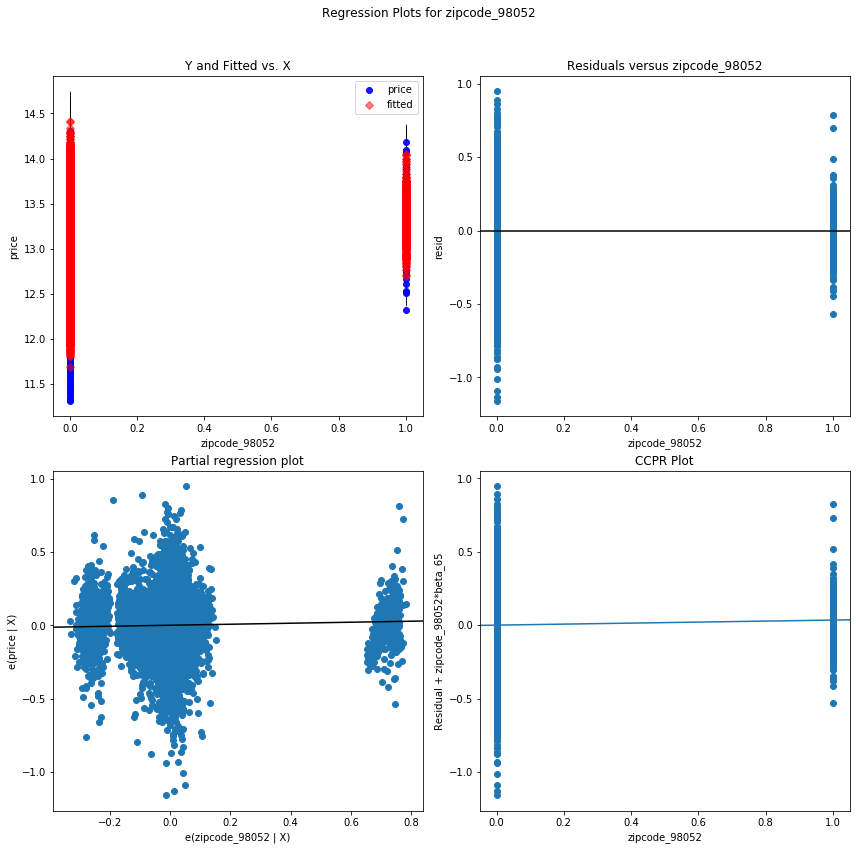

bedrooms_2.0 - Plotted


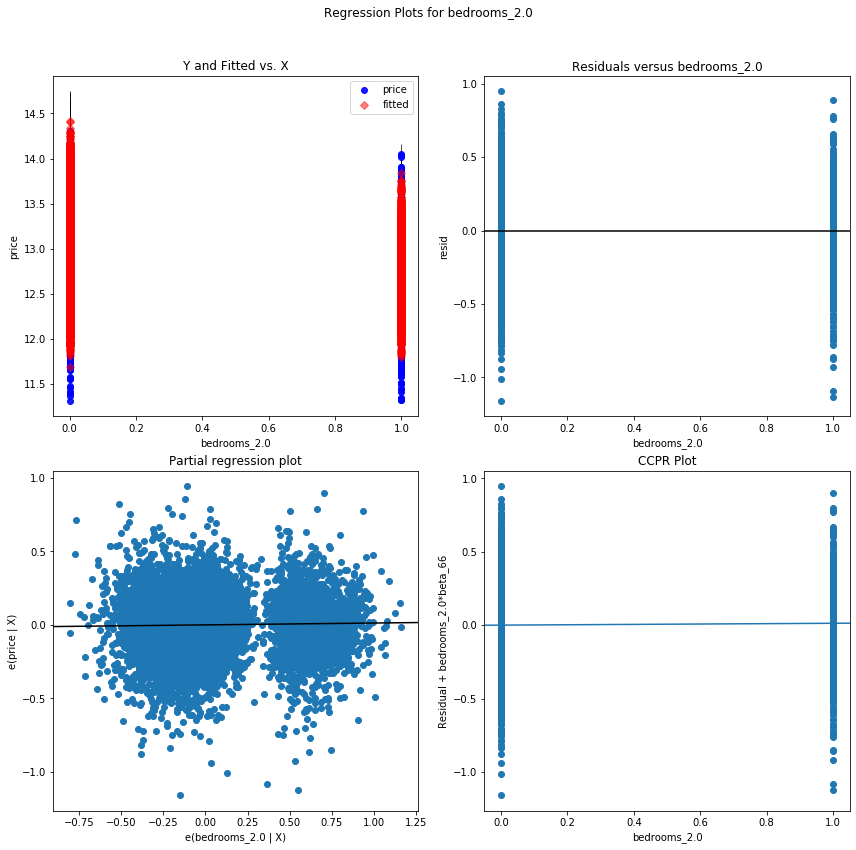

zipcode_98030 - Plotted


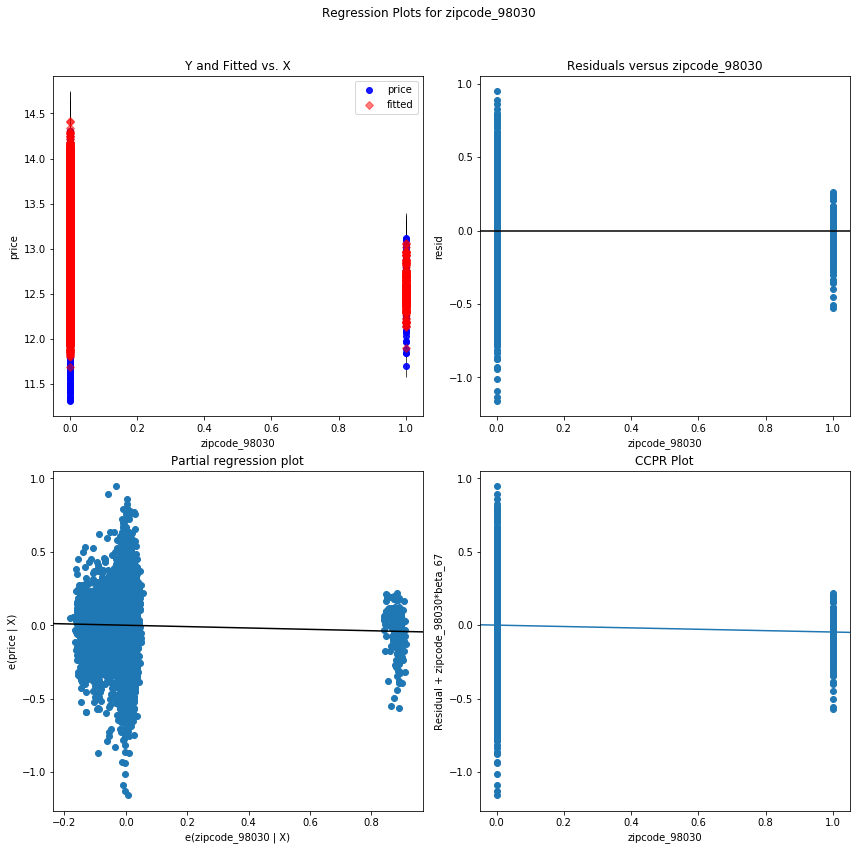

zipcode_98188 - Plotted


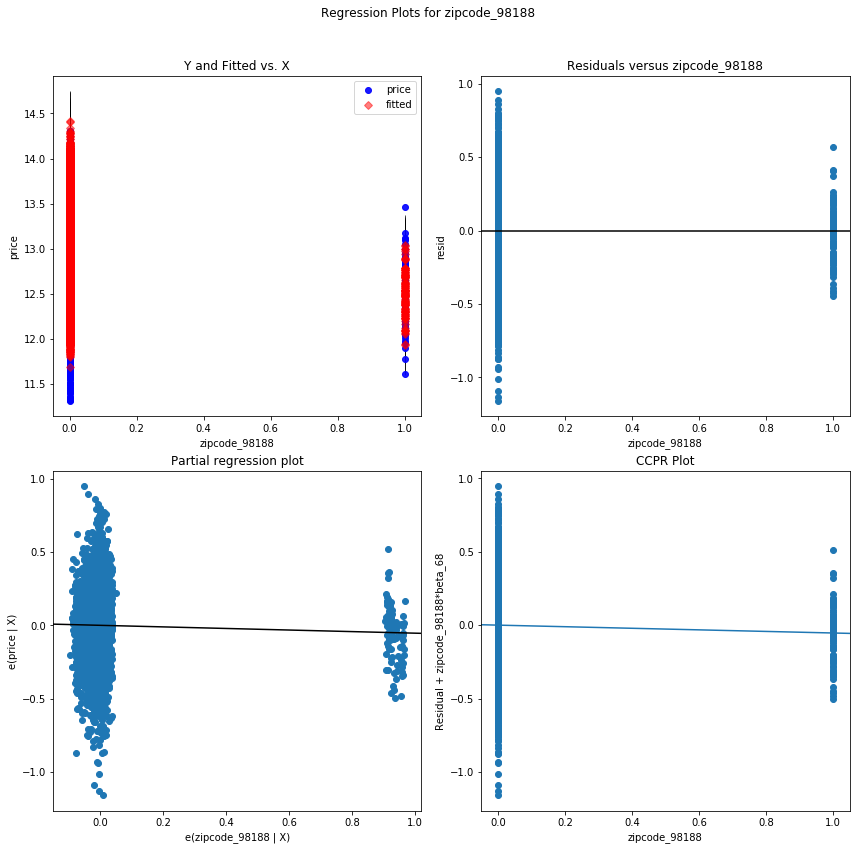

In [316]:
dfresult_logprice, df_coeff_logprice, summary_logprice, model_dict_logprice, X_train_model_logprice, X_test_model_logprice, y_train_model_logprice, y_test_model_logprice, column_model_logprice = run_model(b_pro_std_out_mul.drop(['zipcode_98125', 'floors_1.5'], axis=1), np.log(target_pro_noout), 'multilinear_noout-log-std-logprice', cv=10, feature_selection=True, plots=True )

In [317]:
summary_logprice

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.868
Model:                            OLS   Adj. R-squared:                  0.867
Method:                 Least Squares   F-statistic:                     1443.
Date:                Thu, 25 Jun 2020   Prob (F-statistic):               0.00
Time:                        19:50:50   Log-Likelihood:                 5535.4
No. Observations:               15034   AIC:                        -1.093e+04
Df Residuals:                   14965   BIC:                        -1.041e+04
Df Model:                          68                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
grade                 0.0928      0.002     41.280      0.000       0.088       0.097
lat                   0.1794      0.003     57.461      0.000       0.173       0.186
log-sqft_living       0.4031      0.007     53.762      0.000       0.388       0.418
log-MHI               0.1622      0.006     26.512      0.000       0.150       0.174
waterfront            6.5842      0.085     77.326      0.000       6.417       6.751
zipcode_98004         0.5386      0.014     39.340      0.000       0.512       0.565
zipcode_98019        -0.3812      0.016    -23.242      0.000      -0.413      -0.349
zipcode_98028        -0.2543      0.013    -19.460      0.000      -0.280      -0.229
zipcode_98155        -0.2093      0.011    -18.210      0.000      -0.232      -0.187
zipcode_98133        -0.1169      0.011    -10.725      0.000      -0.138      -0.096
condition             0.0320      0.001     21.544      0.000       0.029       0.035
zipcode_98040         0.4023      0.015     27.582      0.000       0.374       0.431
zipcode_98034        -0.0964      0.010     -9.442      0.000      -0.116      -0.076
zipcode_98072        -0.2043      0.014    -14.698      0.000      -0.232      -0.177
zipcode_98011        -0.2040      0.016    -12.990      0.000      -0.235      -0.173
zipcode_98077        -0.2622      0.017    -15.568      0.000      -0.295      -0.229
view_2.0              0.0983      0.007     13.344      0.000       0.084       0.113
zipcode_98177        -0.0593      0.014     -4.137      0.000      -0.087      -0.031
log-sqft_living15     0.1370      0.008     17.538      0.000       0.122       0.152
zipcode_98022         0.1427      0.016      8.663      0.000       0.110       0.175
zipcode_98178        -0.1256      0.013     -9.742      0.000      -0.151      -0.100
zipcode_98168        -0.1382      0.012    -11.313      0.000      -0.162      -0.114
zipcode_98058        -0.0865      0.010     -9.047      0.000      -0.105      -0.068
zipcode_98014        -0.1985      0.023     -8.514      0.000      -0.244      -0.153
zipcode_98112         0.4513      0.016     28.759      0.000       0.421       0.482
zipcode_98010         0.0996      0.023      4.326      0.000       0.054       0.145
zipcode_98122         0.3689      0.013     28.926      0.000       0.344       0.394
log-sqft_lot          0.0679      0.005     14.645      0.000       0.059       0.077
zipcode_98102         0.4632      0.021     22.372      0.000       0.423       0.504
zipcode_98119         0.4422      0.016     27.092      0.000       0.410       0.474
zipcode_98116         0.3363      0.012     27.260      0.000       0.312       0.361
zipcode_98136         0.3163      0.013     24.077      0.000       0.291       0.342
zipcode_98109         0.4597      0.020     23.403      0.000       0.421

Converting results from logprice to price and obtaining prediction intervals

In [318]:
predictions_logrpice = model_dict_logprice[0].predict(X_test_model_logprice)

In [319]:
lowers_logprice, uppers_logprice, residuals_logprice, rse_logprice = get_prediction_interval(y_test_model_logprice, predictions_logrpice, X_train_model_logprice)

In [320]:
rse_logprice

0.08712736324386476

In [321]:
residuals_logprice

,predicted-price,price,residuals,residuals2
0,12.169800,12.618182,0.448382,0.201047
1,12.114746,12.273498,0.158752,0.025202
2,13.213013,13.384728,0.171715,0.029486
3,13.610107,13.649456,0.039349,0.001548
4,13.062378,13.005830,-0.056548,0.003198
...,...,...,...,...
3754,13.576416,13.369223,-0.207193,0.042929
3755,12.352051,12.367341,0.015290,0.000234
3756,12.921753,12.899220,-0.022533,0.000508
3757,13.298828,13.437174,0.138346,0.019140


In [322]:
residuals_logprice_transformed = residuals_logprice.apply(lambda x: np.exp(x), axis=1)

In [323]:
residuals_logprice_transformed[['predicted-price','price']]

,predicted-price,price
0,192875.427223,302000.0
1,182543.922403,213950.0
2,547442.490686,650000.0
3,814318.968867,847000.0
4,470889.119254,445000.0
...,...,...
3754,787340.441847,640000.0
3755,231434.177413,235000.0
3756,409115.556638,400000.0
3757,596496.185084,685000.0


In [324]:
residuals_logprice_transformed['residuals'] = residuals_logprice_transformed['price'] - residuals_logprice_transformed['predicted-price']
residuals_logprice_transformed['residuals2'] = residuals_logprice_transformed['residuals'].apply(lambda x: x**2)
rse_logprice_transformed = np.sqrt(residuals_logprice_transformed['residuals2'].sum() / (len(X_train_model_logprice) - 2))

In [325]:
rse_logprice_transformed

44501.70018038062

Text(0.5, 1.0, 'Prediction intervals, predicted values, actual values - multilinear_noout-log-std-logprice')

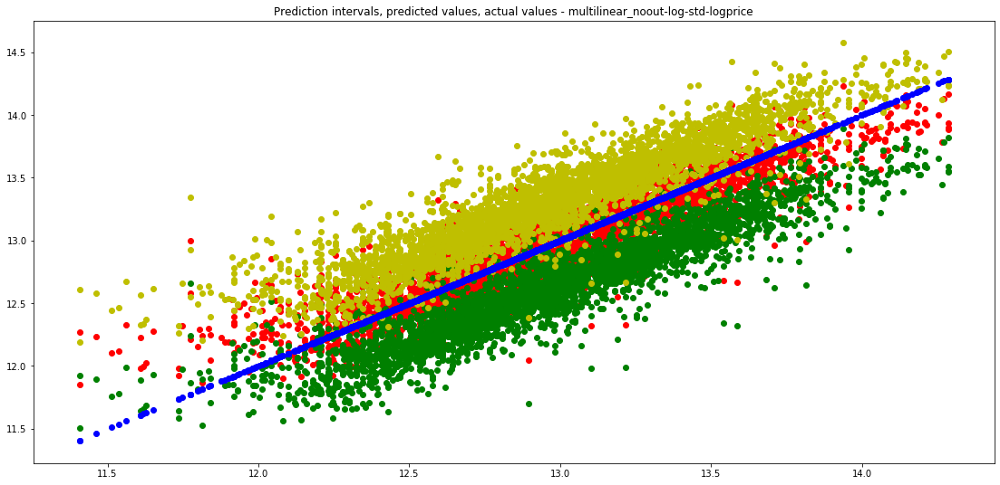

In [328]:
plt.figure(figsize=(19,9))
plt.scatter(y_test_model_logprice, predictions_logrpice, color='r')
plt.scatter(y_test_model_logprice, lowers_logprice, color='g')
plt.scatter(y_test_model_logprice, uppers_logprice, color='y')
plt.scatter(y_test_model_logprice, y_test_model_logprice, color='b')
plt.title('Prediction intervals, predicted values, actual values - multilinear_noout-log-std-logprice')

In [329]:
pi =0.95
sum_errs = residuals_logprice_transformed['residuals2'].sum()
stdev = np.sqrt(1 / (len(y_test) - 2) * sum_errs)
#get interval from standard deviation
one_minus_pi = 1 - pi
ppf_lookup = 1 - (one_minus_pi / 2)
z_score = stats.norm.ppf(ppf_lookup)
interval = z_score * stdev
#generate prediction interval lower and upper bound
lowers = []
uppers = []
for i in range(0,len(residuals_logprice_transformed['predicted-price'])):
    lower, upper = residuals_logprice_transformed.loc[i, 'predicted-price'] - interval, residuals_logprice_transformed.loc[i,'predicted-price'] + interval
    lowers.append(lower)
    uppers.append(upper)

Text(0.5, 1.0, 'Prediction intervals, predicted values, actual values [logprice converted to price] -  multilinear_noout-log-std-logprice')

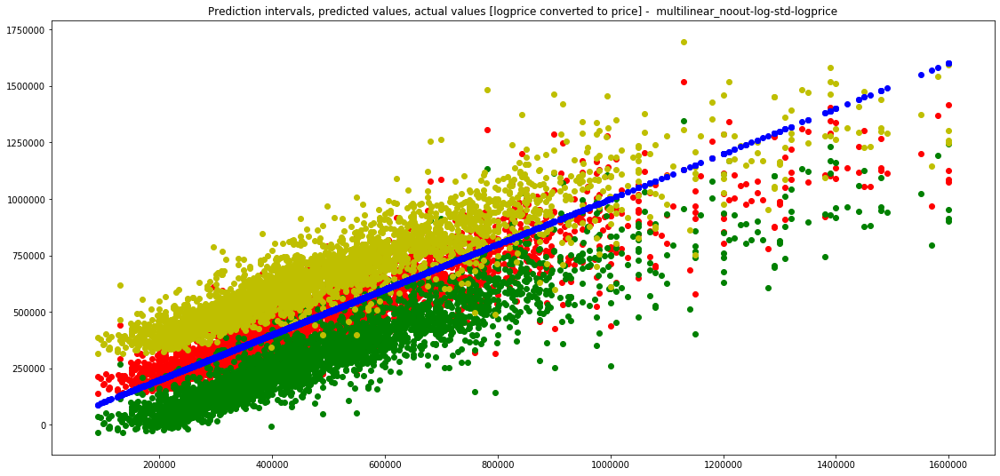

In [330]:
plt.figure(figsize=(19,9))
plt.scatter(residuals_logprice_transformed['price'], residuals_logprice_transformed['predicted-price'], color='r')
plt.scatter(residuals_logprice_transformed['price'], lowers, color='g')
plt.scatter(residuals_logprice_transformed['price'], uppers, color='y')
plt.scatter(residuals_logprice_transformed['price'], residuals_logprice_transformed['price'], color='b')
plt.title('Prediction intervals, predicted values, actual values [logprice converted to price] -  multilinear_noout-log-std-logprice')

## Multilinear regression of best model with feature selection and General Additive Models (GAM) - Splines

In [20]:
ls

CONTRIBUTING.md
KC_MHI_census.csv
KC_housing_processed
KC_housing_processed.csv
LICENSE.md
README.md
_acs_b19113_medianfamilyincome-shp/
_acs_b19113_medianfamilyincome-shp.zip
_acs_b19113_medianfamilyincome.csv
_acs_b19113_medianfamilyincome.kml
baseline
baseline-beforeoutliers.csv
baseline.csv
baseline6_processed
baseline6_processed.csv
baseline6_processed_multicol.csv
baseline6_processed_multicol_vif.csv
baseline6_processed_nooutliers.csv
baseline6_processed_nooutliers_multicol.csv
baseline6_processed_nooutliers_multicol_vif.csv
baseline_cleaned_noout_not_processed.csv
baseline_cleaned_not_processed.csv
baseline_cleaned_not_processed_cartoDB.csv
baseline_noout_raw.csv
baseline_processed
baseline_processed.csv
baseline_processed_multicol.csv
baseline_processed_multicol_vif.csv
baseline_processed_nooutliers.csv
baseline_processed_nooutliers_multicol.csv
baseline_processed_nooutliers_multicol_vif.csv
baseline_raw.csv
baselinebackup.csv
baselinebackup_nooutliers.csv
column_names.md
data_

In [17]:
#Let's recall the features selected with featureselection
columns_models_bm_fs = ['grade',
 'lat',
 'MHI',
 'sqft_living',
 'yr_built',
 'zipcode_98004',
 'long',
 'zipcode_98040',
 'zipcode_98033',
 'zipcode_98023',
 'zipcode_98028',
 'zipcode_98155',
 'zipcode_98133',
 'zipcode_98112',
 'condition',
 'zipcode_98019',
 'view_2.0',
 'zipcode_98005',
 'zipcode_98105',
 'sqft_above',
 'zipcode_98102',
 'zipcode_98006',
 'zipcode_98077',
 'zipcode_98034',
 'zipcode_98072',
 'zipcode_98011',
 'zipcode_98022',
 'zipcode_98177',
 'zipcode_98119',
 'zipcode_98109',
 'zipcode_98122',
 'view_1.0',
 'zipcode_98199',
 'zipcode_98027',
 'zipcode_98029',
 'zipcode_98010',
 'zipcode_98007',
 'zipcode_98178',
 'sqft_lot',
 'zipcode_98002',
 'bathrooms',
 'zipcode_98008',
 'zipcode_98168',
 'zipcode_98014',
 'zipcode_98058',
 'floors_3.0',
 'zipcode_98075',
 'floors_2.0',
 'zipcode_98144',
 'zipcode_98103',
 'zipcode_98115',
 'zipcode_98116',
 'zipcode_98136',
 'zipcode_98107',
 'zipcode_98118',
 'zipcode_98117',
 'zipcode_98126',
 'sqft_living15',
 'zipcode_98052',
 'zipcode_98031',
 'zipcode_98042',
 'zipcode_98092',
 'sqft_lot15',
 'zipcode_98053',
 'zipcode_98106',
 'zipcode_98108',
 'zipcode_98032',
 'zipcode_98055',
 'zipcode_98198']

In [30]:
#Let's check for which lambda we have lowest residual standard error
X = b_pro_out[columns_models_bm_fs]
y = target_pro_noout
X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=True, test_size=0.2, random_state=42)

AIC = {}
residuals_train_dict = {}
residuals_test_dict = {}
rse_train = []
rse_test = []

for lam_i in np.linspace(0,1,3):
    print(lam_i)
    gam = LinearGAM(s(0) +
                s(1) +
                s(2) +
                s(3) +
                s(4) +
                f(5) +
                s(6) +
                f(7) +
                f(8) +
                f(9) +
                f(10) +
                f(11) +
                f(12) +
                 f(13) +
                 s(14) +
                 f(15) +
                 f(16) +
                 f(17) +
                 f(18) +
                 s(19) +
                 f(20) +
                 f(21) +
                 f(22) +
                 f(23) +
                 f(24) +
                 f(25) +
                 f(26) +
                 f(27) +
                 f(28) +
                 f(29) +
                 f(30) +
                 f(31) +
                 f(32)+
                 f(33)+
                 f(34) +
                 f(35)+
                 f(36)+
                 f(37)+
                 s(38)+
                 f(39)+
                 s(40)+
                 f(41)+
                 f(42)+
                 f(43)+
                 f(44)+
                 f(45)+
                 f(46)+
                 f(47)+
                 f(48)+
                 f(49)+
                 f(50)+
                 f(51)+
                 f(52)+
                 f(53)+
                 f(54)+
                 f(55)+
                 f(56)+
                 s(57)+
                 f(58)+
                 f(59)+
                 f(60)+
                 f(61)+
                 s(62)+
                 f(63)+
                 f(64)+
                 f(65)+
                 f(66)+
                 f(67)+
                 f(68), lam = lam_i).fit(X_train, y_train)
    print('Gam done')
    AIC[lam_i] = gam.statistics_['AIC']
    print('AIC done')
    residual_train, rse_lam_i_train = gam_residual_standard_deviation(X_train, y_train, gam, X_train)
    print('residual train done')
    residual_test, rse_lam_i_test = gam_residual_standard_deviation(X_test, y_test, gam, X_train)
    print('residual test done')
    rse_train.append(rse_lam_i_train)
    rse_test.append(rse_lam_i_test)
    residuals_train_dict[lam_i] = residual_train
    residuals_test_dict[lam_i] = residual_test

0.0
Gam done
AIC done
residual train done
residual test done
0.5
Gam done
AIC done
residual train done
residual test done
1.0
Gam done
AIC done
residual train done
residual test done


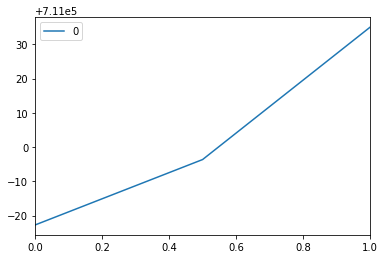

In [31]:
#Plot AIC vs lambda from 0 to 100
pd.DataFrame.from_dict(AIC, orient='index').plot()

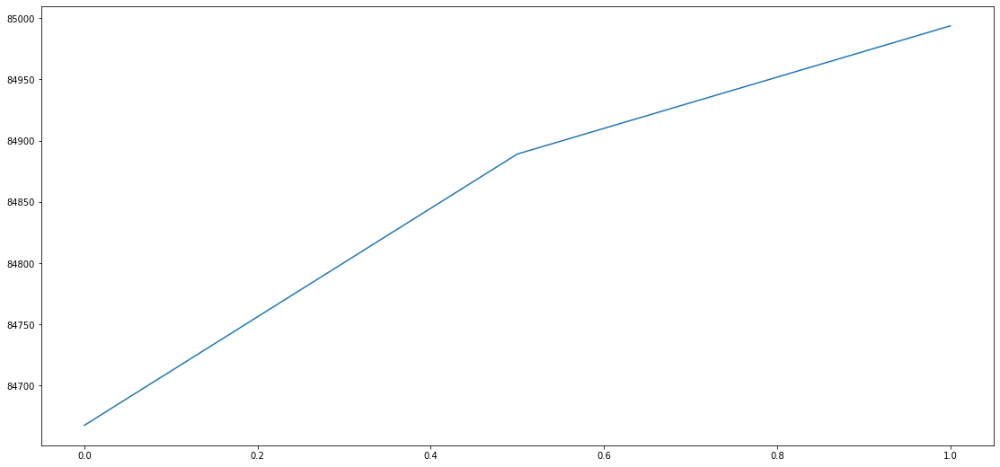

In [33]:
#plot residual standard error vs lambda
plt.figure(figsize=(19,9)), plt.plot(np.linspace(0,1,3), rse_train);

We don't see improvements using GAMs. The best model is still **'multilinear_noout-log-std-logprice'**.

# Obtaining parameters similar Zillow's Zestimate performance for benchmarking

## Median Absolute Error

### Training set

In [349]:
prediction_training = pd.DataFrame()
prediction_training['training-price'] =  y_train_model_logprice['price'].apply(lambda x: np.exp(x))
prediction_training['predicted-training-price'] = model_dict_logprice[0].predict(X_train_model_logprice)
prediction_training['predicted-training-price'] = prediction_training['predicted-training-price'].apply(lambda x: np.exp(x))

In [351]:
mae_train = median_absolute_error(prediction_training['training-price'], prediction_training['predicted-training-price'] )

In [352]:
mae_train

38933.36948044557

### Test set

In [333]:
mae = median_absolute_error(residuals_logprice_transformed['price'], residuals_logprice_transformed['predicted-price'])

In [335]:
mae

39823.58384571958

## Percentage Median Error

### Training set

In [353]:
median_kc_house_price_train = prediction_training['training-price'].median()
median_error_pcg_train = mae_train / median_kc_house_price_train

In [354]:
median_error_pcg_train

0.09022797098596894

In [358]:
prediction_training['pct-error'] = (prediction_training['training-price'] - prediction_training['predicted-training-price']) / prediction_training['training-price']

In [359]:
pcg_5_train = len(prediction_training[abs(prediction_training['pct-error']) <= 0.05]) / len(prediction_training['pct-error'])
pcg_10_train = len(prediction_training[abs(prediction_training['pct-error']) <= 0.10]) / len(prediction_training['pct-error'])
pcg_20_train = len(prediction_training[abs(prediction_training['pct-error']) <= 0.20]) / len(prediction_training['pct-error'])
pcg_5_train, pcg_10_train, pcg_20_train

(0.2881468671012372, 0.5365837435147001, 0.8128242649993348)

### Test set

In [345]:
median_kc_house_price = residuals_logprice_transformed['price'].median()
median_error_pcg = mae / median_kc_house_price 

In [346]:
median_error_pcg

0.09261298568771992

In [339]:
residuals_logprice_transformed['pct-error'] = (residuals_logprice_transformed['price'] - residuals_logprice_transformed['predicted-price']) / residuals_logprice_transformed['price']

In [344]:
pcg_5 = len(residuals_logprice_transformed[abs(residuals_logprice_transformed['pct-error']) <= 0.05]) / len(residuals_logprice_transformed['pct-error'])
pcg_10 = len(residuals_logprice_transformed[abs(residuals_logprice_transformed['pct-error']) <= 0.10]) / len(residuals_logprice_transformed['pct-error'])
pcg_20 = len(residuals_logprice_transformed[abs(residuals_logprice_transformed['pct-error']) <= 0.20]) / len(residuals_logprice_transformed['pct-error'])
pcg_5, pcg_10, pcg_20

(0.28039372173450383, 0.5198191008246874, 0.8063314711359404)

In [258]:
pickle_regression_results('multilinear-logprice-feature-selection',dfresults_logprice, dfs_coeff_logprice, summaries_logprice, models_dict_logprice, X_train_models_logprice, X_test_models_logprice, y_train_models_logprice, y_test_models_logprice, columns_models_logprice)

## Star plot for comparison with Zillow

In [9]:
median_error_pcg_train = 0.09022797098596894
median_error_pcg = 0.09261298568771992
pcg_5_train = 0.2881468671012372
pcg_10_train = 0.5365837435147001
pcg_20_train = 0.8128242649993348
pcg_5 = 0.28039372173450383
pcg_10 = 0.5198191008246874
pcg_20 = 0.8063314711359404

median_error_pcg_avg = (median_error_pcg + median_error_pcg) / 2
pcg_5_avg = (pcg_5 + pcg_5_train) / 2
pcg_10_avg = (pcg_10 + pcg_10_train) / 2
pcg_20_avg = (pcg_20 + pcg_20_train) / 2

zillow_median_error = 0.069
zillow_5 = 0.384
zillow_10 = 0.647
zillow_20 = 0.878

zillow = [zillow_median_error, zillow_5, zillow_10, zillow_20]
bestmodel = [median_error_pcg_avg, pcg_5_avg, pcg_10_avg, pcg_20_avg]
labels=['Median error','Within 5% of Sale Price','Within 10% of Sale Price','Within 20% of Sale Price']

In [10]:
fig = go.Figure()
fig.add_trace(go.Scatterpolar(
      r=zillow,
      theta=labels,
      fill='toself',
      name='Zillow performance'
))

fig.add_trace(go.Scatterpolar(
      r=bestmodel,
      theta=labels,
      fill='toself',
      name='Best model performance'
))


fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, 1]
    )),
  showlegend=True
)

fig.show()